# Benchmarking Field Transformation HMC

### DONE - FT-HMC implemented for 8x8 2D QED (using SiLU as activation function).

- [x] Try to minimize size of the force in training. No significant improvements.
- [x]  Some test on ergodicity
- [x] (calculate the probablity of generating the configs obtained via conventional HMC).

### TODO

- [ ] Plot the force size distribution 
- [ ] Is the large force from the original action or Field-Transformation the determinant?
- [ ] If from the determinant, then the fermion force won't cause problem for HMC
- [ ] Use the same Field-Transformation for larger system (say 16x16, 32x32, 64x64, etc)
- [ ] Study how the delta H depends on the system size ( perhaps delta H ~ sqrt(volume) )
- [ ] Study the auto-correlation for observables, topo, plaq, flowed plaq, etc.
- [ ] Improving the Field-Transformation to reduce force.

In [1]:
%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format ='retina'

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [2]:
import torch
import math
import sys
import os
from timeit import default_timer as timer
from functools import reduce

In [3]:
project_dir = os.path.abspath('../../')
if project_dir not in sys.path:
    sys.path.append(project_dir)
    
    
from utils.param import Param
import utils.io as io
logger = io.Logger(156)

In [4]:
logger = io.Logger()

In [5]:
torch.manual_seed(9)

#torch.set_num_threads(param.nth)
#torch.set_num_interop_threads(param.nth_interop)
#os.environ["OMP_NUM_THREADS"] = str(param.nth)
#os.environ["KMP_BLOCKTIME"] = "0"
#os.environ["KMP_SETTINGS"] = "1"
#os.environ["KMP_AFFINITY"]= "granularity=fine,verbose,compact,1,0"

#torch.set_default_tensor_type(torch.DoubleTensor)

# Define `Param` specifying lattice and MCMC params

In [6]:
param=Param(
    beta=2.0,
    L=8,
    #lat=(16, 16),
    tau=0.5, # 0.3
    nstep=10, # 3
    nrun=10,
    randinit=True,
    # ADJUST ME
    ntraj=256, # 2**16 # 2**10 # 2**15
    nprint=10,
    seed=1331,
)

logger.log(repr(param))

[17:58:57]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=8                                                                                                                                                                                                                                                 
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=10                                                                                                                                                                                                                                           
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[8, 8]                                                                                                                                                                                                                                          
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 8, 8]                                                                                                                      

In [7]:
from train import run as hmc_run


import datetime

NOW = io.get_timestamp('%Y-%m-%d')
OUTDIR = os.path.join(os.getcwd(), 'outputs', NOW)

param_dir = os.path.join(OUTDIR, param.uniquestr())
if not os.path.isdir(OUTDIR):
    os.makedirs(OUTDIR)

fields, metrics = hmc_run(param, logger=logger)

metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
metrics_file = os.path.join(metrics_dir, 'metrics.z')
io.savez(metrics, metrics_file)

Duplicate key in file PosixPath('/home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle'), line 92 ('figure.facecolor: 474747')
Duplicate key in file PosixPath('/home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle'), line 93 ('figure.edgecolor: 0.50')
In /home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle: 
The savefig.jpeg_quality rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.


TORCH DEVICE: cuda


[17:59:19]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=8                                                                                                                                                                                                                                                 
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=10                                                                                                                                                                                                                                           
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[8, 8]                                                                                                                                                                                                                                          
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 8, 8]                                                                                                                      

            plaq=-0.0114 charge=2

[17:59:20]  traj=25    accept=True  dH=0.04951 expdH=0.9517 plaq=0.7591 charge=-1

            traj=50    accept=True  dH=-0.07879 expdH=1.082 plaq=0.6615 charge=0

            traj=75    accept=True  dH=0.04549 expdH=0.9555 plaq=0.7985 charge=0

            traj=100   accept=True  dH=-0.03832 expdH=1.039 plaq=0.6903 charge=0

            traj=125   accept=True  dH=0.001167 expdH=0.9988 plaq=0.6832 charge=-2

            traj=150   accept=True  dH=-0.0005722 expdH=1.001 plaq=0.6817 charge=0

            traj=175   accept=True  dH=-0.03914 expdH=1.04  plaq=0.7236 charge=-1

[17:59:21]  traj=200   accept=True  dH=0.05721 expdH=0.9444 plaq=0.7283 charge=-1

            traj=225   accept=True  dH=-0.03278 expdH=1.033 plaq=0.6615 charge=1

            traj=250   accept=True  dH=-0.01498 expdH=1.015 plaq=0.7237 charge=-1

            traj=281   accept=True  dH=0.02029 expdH=0.9799 plaq=0.7201 charge=0

            traj=306   accept=True  dH=0.02369 expdH=0.9766 plaq=0.7343 charge=0

            traj=331   accept=True  dH=-0.003036 expdH=1.003 plaq=0.7462 charge=1

            traj=356   accept=True  dH=0.05914 expdH=0.9426 plaq=0.7768 charge=-1

[17:59:22]  traj=381   accept=True  dH=0.02647 expdH=0.9739 plaq=0.6768 charge=0

            traj=406   accept=True  dH=0.006287 expdH=0.9937 plaq=0.769 charge=1

            traj=431   accept=True  dH=0.05963 expdH=0.9421 plaq=0.7216 charge=0

            traj=456   accept=True  dH=0.01802 expdH=0.9821 plaq=0.7829 charge=0

            traj=481   accept=True  dH=-0.005932 expdH=1.006 plaq=0.7262 charge=1

            traj=506   accept=True  dH=-0.02955 expdH=1.03  plaq=0.6298 charge=0

[17:59:23]  traj=537   accept=True  dH=0.00528 expdH=0.9947 plaq=0.6896 charge=2

            traj=562   accept=True  dH=0.0111 expdH=0.989 plaq=0.703 charge=0

            traj=587   accept=True  dH=0.01835 expdH=0.9818 plaq=0.6771 charge=-1

            traj=612   accept=True  dH=0.05044 expdH=0.9508 plaq=0.7632 charge=0

            traj=637   accept=True  dH=-0.02444 expdH=1.025 plaq=0.697 charge=2

            traj=662   accept=True  dH=0.01684 expdH=0.9833 plaq=0.6877 charge=0

            traj=687   accept=True  dH=-0.007301 expdH=1.007 plaq=0.7397 charge=0

[17:59:24]  traj=712   accept=True  dH=-0.02868 expdH=1.029 plaq=0.6603 charge=0

            traj=737   accept=True  dH=0.03358 expdH=0.967 plaq=0.7592 charge=0

            traj=762   accept=True  dH=0.04175 expdH=0.9591 plaq=0.6629 charge=0

            traj=793   accept=True  dH=-0.02207 expdH=1.022 plaq=0.6809 charge=0

            traj=818   accept=True  dH=0.005318 expdH=0.9947 plaq=0.6687 charge=0

            traj=843   accept=True  dH=-0.001041 expdH=1.001 plaq=0.7367 charge=0

            traj=868   accept=True  dH=-0.01995 expdH=1.02  plaq=0.7225 charge=1

[17:59:25]  traj=893   accept=True  dH=-0.04877 expdH=1.05  plaq=0.6871 charge=0

            traj=918   accept=True  dH=-0.03359 expdH=1.034 plaq=0.6455 charge=0

            traj=943   accept=True  dH=-0.01045 expdH=1.011 plaq=0.5988 charge=1

            traj=968   accept=True  dH=0.004299 expdH=0.9957 plaq=0.6799 charge=-2

            traj=993   accept=True  dH=0.01972 expdH=0.9805 plaq=0.7164 charge=0

            traj=1018  accept=True  dH=0.01925 expdH=0.9809 plaq=0.7089 charge=2

[17:59:26]  traj=1049  accept=True  dH=0.03075 expdH=0.9697 plaq=0.7827 charge=0

            traj=1074  accept=True  dH=-0.0332 expdH=1.034 plaq=0.7622 charge=0

            traj=1099  accept=True  dH=0.01974 expdH=0.9805 plaq=0.7002 charge=0

            traj=1124  accept=True  dH=0.01951 expdH=0.9807 plaq=0.777 charge=0

            traj=1149  accept=True  dH=-0.02039 expdH=1.021 plaq=0.7056 charge=1

            traj=1174  accept=True  dH=0.002014 expdH=0.998 plaq=0.7413 charge=0

            traj=1199  accept=True  dH=0.01356 expdH=0.9865 plaq=0.6448 charge=3

[17:59:27]  traj=1224  accept=True  dH=0.02886 expdH=0.9716 plaq=0.816 charge=1

            traj=1249  accept=True  dH=0.01638 expdH=0.9837 plaq=0.7316 charge=0

            traj=1274  accept=True  dH=-0.03129 expdH=1.032 plaq=0.6012 charge=0

            traj=1305  accept=True  dH=0.02386 expdH=0.9764 plaq=0.6228 charge=1

            traj=1330  accept=True  dH=0.01346 expdH=0.9866 plaq=0.7156 charge=0

            traj=1355  accept=True  dH=-0.02406 expdH=1.024 plaq=0.7038 charge=1

            traj=1380  accept=True  dH=0.008476 expdH=0.9916 plaq=0.6707 charge=-1

[17:59:28]  traj=1405  accept=True  dH=-0.009071 expdH=1.009 plaq=0.7174 charge=0

            traj=1430  accept=True  dH=-0.009758 expdH=1.01  plaq=0.6779 charge=0

            traj=1455  accept=True  dH=-0.01884 expdH=1.019 plaq=0.7332 charge=0

            traj=1480  accept=True  dH=-0.002491 expdH=1.002 plaq=0.6855 charge=0

            traj=1505  accept=True  dH=0.004742 expdH=0.9953 plaq=0.7615 charge=1

            traj=1530  accept=True  dH=0.0175 expdH=0.9827 plaq=0.7968 charge=1

            traj=1561  accept=True  dH=-0.01437 expdH=1.014 plaq=0.724 charge=0

[17:59:29]  traj=1586  accept=True  dH=-0.001171 expdH=1.001 plaq=0.6369 charge=0

            traj=1611  accept=True  dH=-0.05331 expdH=1.055 plaq=0.6617 charge=0

            traj=1636  accept=True  dH=-0.008434 expdH=1.008 plaq=0.7853 charge=0

            traj=1661  accept=True  dH=0.01475 expdH=0.9854 plaq=0.7374 charge=1

            traj=1686  accept=True  dH=0.004238 expdH=0.9958 plaq=0.7659 charge=0

            traj=1711  accept=True  dH=0.02634 expdH=0.974 plaq=0.7271 charge=0

            traj=1736  accept=True  dH=0.04187 expdH=0.959 plaq=0.7619 charge=0

[17:59:30]  traj=1761  accept=True  dH=0.0249 expdH=0.9754 plaq=0.7122 charge=0

            traj=1786  accept=True  dH=0.005634 expdH=0.9944 plaq=0.6467 charge=0

            traj=1817  accept=True  dH=0.01464 expdH=0.9855 plaq=0.7319 charge=-2

            traj=1842  accept=True  dH=-0.04268 expdH=1.044 plaq=0.61  charge=0

            traj=1867  accept=True  dH=-0.02362 expdH=1.024 plaq=0.7303 charge=0

            traj=1892  accept=True  dH=0.0219 expdH=0.9783 plaq=0.7215 charge=-1

[17:59:31]  traj=1917  accept=True  dH=-0.02016 expdH=1.02  plaq=0.6203 charge=0

            traj=1942  accept=True  dH=0.06376 expdH=0.9382 plaq=0.8345 charge=0

            traj=1967  accept=True  dH=0.007027 expdH=0.993 plaq=0.7847 charge=1

            traj=1992  accept=True  dH=-0.0056 expdH=1.006 plaq=0.8004 charge=1

            traj=2017  accept=True  dH=0.01919 expdH=0.981 plaq=0.7454 charge=0

            traj=2042  accept=True  dH=0.02164 expdH=0.9786 plaq=0.7117 charge=0

            traj=2073  accept=True  dH=-0.02753 expdH=1.028 plaq=0.7011 charge=0

[17:59:32]  traj=2098  accept=True  dH=0.01879 expdH=0.9814 plaq=0.745 charge=1

            traj=2123  accept=True  dH=0.001045 expdH=0.999 plaq=0.6345 charge=1

            traj=2148  accept=True  dH=-0.007317 expdH=1.007 plaq=0.6496 charge=1

            traj=2173  accept=True  dH=-0.002533 expdH=1.003 plaq=0.7545 charge=-1

            traj=2198  accept=True  dH=-0.08759 expdH=1.092 plaq=0.6122 charge=0

            traj=2223  accept=True  dH=-0.02834 expdH=1.029 plaq=0.6249 charge=2

[17:59:33]  traj=2248  accept=True  dH=0.01683 expdH=0.9833 plaq=0.667 charge=0

            traj=2273  accept=True  dH=-0.001823 expdH=1.002 plaq=0.6903 charge=1

            traj=2298  accept=True  dH=0.006107 expdH=0.9939 plaq=0.6429 charge=0

            traj=2329  accept=True  dH=0.01398 expdH=0.9861 plaq=0.6843 charge=1

            traj=2354  accept=True  dH=0.03435 expdH=0.9662 plaq=0.7182 charge=0

            traj=2379  accept=True  dH=-0.00124 expdH=1.001 plaq=0.7024 charge=0

            traj=2404  accept=True  dH=0.001499 expdH=0.9985 plaq=0.7117 charge=0

[17:59:34]  traj=2429  accept=True  dH=0.02451 expdH=0.9758 plaq=0.7727 charge=-1

            traj=2454  accept=True  dH=0.03992 expdH=0.9609 plaq=0.6727 charge=1

            traj=2479  accept=True  dH=-0.02517 expdH=1.025 plaq=0.7149 charge=0

            traj=2504  accept=False dH=0.0116 expdH=0.9885 plaq=0.6546 charge=0

            traj=2529  accept=True  dH=-0.03695 expdH=1.038 plaq=0.7092 charge=0

            traj=2554  accept=True  dH=-0.00573 expdH=1.006 plaq=0.6876 charge=0

            Run times: [1.5062923431396484, 1.4906837940216064, 1.4988799095153809, 1.484433650970459, 1.4804489612579346, 1.4828379154205322, 1.4820353984832764, 1.4858379364013672, 1.5455567836761475, 1.5120446681976318]

            Per trajectory: [0.005883954465389252, 0.0058229835703969, 0.0058549996465444565, 0.005798568949103355, 0.005783003754913807, 0.005792335607111454, 0.005789200775325298, 0.005804054439067841, 0.006037331186234951, 0.005906424485146999]

[17:59:34]  Saving <class 'dict'> to /lus/grand/projects/DLHMC/nftqcd/fthmc/flow_test_sam/notebooks/outputs/2021-05-23/metrics/hmc/metrics.z.

## Helper functions for training model

In [15]:
def train_step(
        model,
        action,
        optimizer,
        #metrics,
        batch_size,
        with_force=False,
        pre_model=None,
        verbose=True,
        era=None,
        epoch=None,
        #gamma=None,  # annealing factor, should be in [0, 1]
):
    t0 = time.time()
    layers, prior = model['layers'], model['prior']
    optimizer.zero_grad()
    
    xi = None
    if pre_model != None:
        pre_layers, pre_prior = pre_model['layers'], pre_model['prior']
        pre_xi = pre_prior.sample_n(batch_size)
        x = qed.ft_flow(pre_layers, pre_xi)
        xi = qed.ft_flow_inv(layers, x)
        
    xi, x, logq = apply_flow_to_prior(prior, layers, batch_size=batch_size, xi=xi)#, gamma=gamma)
    logp = -action(x)
    
    force_size = torch.tensor(0.0)
    dkl = calc_dkl(logp, logq)
    loss_force = torch.tensor(0.0)
    loss_dkl = torch.tensor(0.0)
    if with_force:
        assert pre_model != None
        force = qed.ft_force(param, layers, xi, True)
        force_size = torch.sum(torch.square(force))
        loss_force = force_size
        loss_force.backward()
    else:
        loss_dkl = dkl
        loss_dkl.backward()
        
    #loss.backward()
    #
    # minimization target
    # loss mini
    # -> (logq - logp) mini
    # -> (action - logJ) mini
    #
    optimizer.step()
    ess = calc_ess(logp, logq)
    batch_metrics = {
        'dt': time.time() - t0,
        #'loss': grab(loss),
        'loss_force': grab(loss_force),
        'loss': grab(loss_dkl),
        'force': grab(force_size),
        'dkl': grab(dkl),
        'logp': grab(logp),
        'logq': grab(logq),
        'ess': grab(ess),
        'force_norm': grab(torch.linalg.norm(qed.ft_force(param, layers, xi))),
    }
    #if verbose:
    #    io.print_metrics(batch_metrics)
    #    #ioprint_metrics(batch_metrics, era=era, epoch=epoch)
        
    return batch_metrics
        
                
                
def update_history(history, metrics, extras=None):
    if extras is not None:
        for key, val in extras.items():
            try:
                history[key].append(val)
            except KeyError:
                history[key] = [val]
                
    for key, val in metrics.items():
        try:
            history[key].append(val)
        except KeyError:
            history[key] = [val]

    return history


from dataclasses import dataclass
        
            
def flow_train(
    param,
    n_era=10,
    n_epoch=100,
    n_layers=24,
    n_s_nets=2,
    hidden_sizes=[8, 8],
    kernel_size=3,
    base_lr=0.001,
    batch_size=64,
    print_freq=10,
    plot_freq=20,
    with_force=False,
    pre_model=None
):  # packaged from original ipynb by Xiao-Yong Jin
    # Theory
    lattice_shape = tuple(param.lat)
    link_shape = (2,*param.lat)
    beta = param.beta
    #u1_action = U1GaugeAction(beta)
    u1_action = qed.BatchAction(param.beta)
    # Model
    prior = MultivariateUniform(torch.zeros(link_shape), 2*np.pi*torch.ones(link_shape))
    
    layers = make_u1_equiv_layers(lattice_shape=lattice_shape,
                                  n_layers=n_layers,
                                  n_mixture_comps=n_s_nets,
                                  hidden_sizes=hidden_sizes,
                                  kernel_size=kernel_size)
    set_weights(layers)
    
    model = {'layers': layers, 'prior': prior}
    
    # Training
    optimizer = torch.optim.Adam(model['layers'].parameters(), lr=base_lr)
    optimizer_wf = torch.optim.Adam(model['layers'].parameters(), lr=base_lr / 100.0)
    #
    history = {
        'era': [], 'epoch': [],
        'dt': [], 'force' : [], 'force_norm': [], 'ess' : [],
        'dkl' : [], 'logp' : [], 'logq' : [],
        'loss': [], 'loss_force': [],
    }
                
    dt = 0.0
    history.update({'loss': []})
    plots = init_live_joint_plots(n_era, n_epoch, dpi=125, figsize=(4, 3), param=param)
    
    if with_force:
        y_label = ['ESS', 'loss_force']
        force_plots = init_live_joint_plots(n_era, n_epoch, dpi=125, figsize=(4, 3), param=param, y_label=y_label)
        force_optimizer = torch.optim.Adam(model['layers'].parameters(),
                                           lr=base_lr / 100.0, weight_decay=1e-5)
        history.update({
            'loss_force': [], 
        })
        
    for era in range(n_era):
        t0 = time.time()
        #console.rule(f'ERA: {era} (last took: {int(dt // 60)} min {dt % 60:.4g}s)', style='bright_yellow')
        logger.rule(f'ERA={era} (last took: {int(dt // 60)} min {dt % 60:.4g}s)', style='bright_yellow')
        for epoch in range(n_epoch):
            if with_force:
                batch_metrics = train_step(model, u1_action, optimizer_wf, #history,
                                           batch_size, with_force=with_force, pre_model=pre_model,
                                           verbose=(epoch%print_freq==0), era=era, epoch=epoch)
            else:
                batch_metrics = train_step(model, u1_action, optimizer, #history,
                                           batch_size, era=era, epoch=epoch,
                                           verbose=(epoch%print_freq==0))
                
            history = update_history(history, batch_metrics,
                                     extras={'era': era, 'epoch': epoch})
                
            if (epoch + 1) % param.nprint == 0:
                running_avgs = io.running_averages(history,
                                                   n_epochs=min(epoch, 5))
                io.print_metrics(running_avgs, logger=logger)
                
            if epoch % plot_freq == 0:
                if with_force:
                    update_joint_plots(history, alt_loss='loss_force', **force_plots)
                    
                update_joint_plots(history, **plots)
        
        dt = time.time() - t0
        
    outputs = {
        'model': model,
        'history': history,
        'action': u1_action,
    }
    
    return outputs


ActionFn = Callable[[float], torch.Tensor]


def generate_ensemble(
    model: nn.Module,
    u1_action: ActionFn = qed.BatchAction,
    ensemble_size: int = 1024,
    batch_size: int = 64,
    nboot: int = 100,
    binsize: int = 16,
):
    """Calculate the topological susceptibility.
    
    Packaged from original ipynb by Xiao-Yong Jin.
    """
    u1_ens = make_mcmc_ensemble(model, u1_action, batch_size, ensemble_size)
    charge = qed.grab(qed.topo_charge(torch.stack(u1_ens['x'], axis=0)))
    x_mean, x_err = bootstrap(charge**2, nboot=nboot, binsize=16)
    
    logger.log(f'Accept rate: {np.mean(u1_ens["accepted"])}')
    logger.log(f'Topological susceptibility = {x_mean:.5f} +/- {x_err:.5f}')
    #logger.log(f'... vs HMC estimate = 1.23 +/- 0.02')
    return {
        'u1_ens': u1_ens,
        'charge': charge,
        'suscept_mean': x_mean,
        'suscept_err': x_err,
    }
    return outputs

## Train model without force:

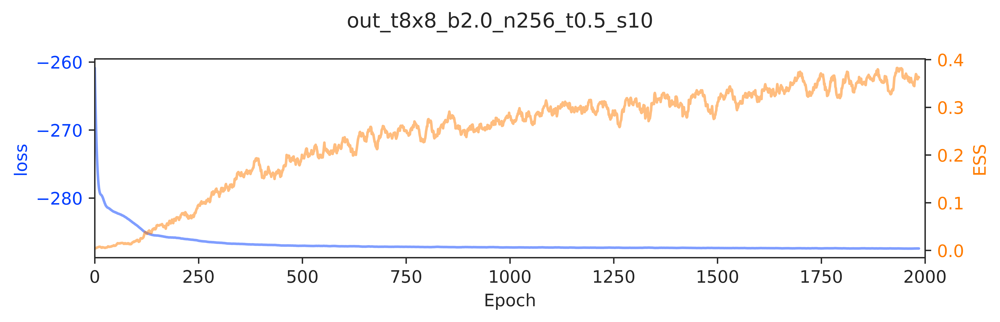

[18:02:49]  -------------------------------------------------------------------------------------------------------------- ERA=1, last took: 0 min 0 s                                                                                                          
            --------------------------------------------------------------------------------------------------------------

[18:03:22]  era=1     epoch=98    dt=0.3114 ess=0.0128583 loss=-283.517 loss_force=0     force=nan   force_norm=661.577 dkl=-283.517 logp=77.8227 logq=-205.694 force_size=437685

[18:03:23]  ------------------------------------------------------------------------------------------------------------ ERA=2, last took: 0 min 34.43 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:03:57]  era=2     epoch=98    dt=0.3148 ess=0.0534509 loss=-285.799 loss_force=0     force=nan   force_norm=595.678 dkl=-285.799 logp=83.7538 logq=-202.045 force_size=354855

[18:03:58]  ------------------------------------------------------------------------------------------------------------ ERA=3, last took: 0 min 34.58 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:04:31]  era=3     epoch=98    dt=0.3164 ess=0.140683 loss=-286.533 loss_force=0     force=nan   force_norm=623.144 dkl=-286.533 logp=84.9876 logq=-201.546 force_size=388450

[18:04:32]  ------------------------------------------------------------------------------------------------------------- ERA=4, last took: 0 min 34.4 s                                                                                                        
            -------------------------------------------------------------------------------------------------------------

[18:05:05]  era=4     epoch=98    dt=0.3131 ess=0.213746 loss=-286.867 loss_force=0     force=nan   force_norm=672.721 dkl=-286.867 logp=85.9638 logq=-200.903 force_size=452766

[18:05:06]  ------------------------------------------------------------------------------------------------------------- ERA=5, last took: 0 min 34.3 s                                                                                                        
            -------------------------------------------------------------------------------------------------------------

[18:05:40]  era=5     epoch=98    dt=0.3175 ess=0.181908 loss=-287.019 loss_force=0     force=nan   force_norm=810.961 dkl=-287.019 logp=86.453 logq=-200.565 force_size=662103

[18:05:41]  ------------------------------------------------------------------------------------------------------------ ERA=6, last took: 0 min 34.49 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:06:15]  era=6     epoch=98    dt=0.3113 ess=0.210355 loss=-287.091 loss_force=0     force=nan   force_norm=820.622 dkl=-287.091 logp=86.6192 logq=-200.472 force_size=674504

[18:06:16]  ------------------------------------------------------------------------------------------------------------ ERA=7, last took: 0 min 34.85 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:06:49]  era=7     epoch=98    dt=0.3114 ess=0.275174 loss=-287.18 loss_force=0     force=nan   force_norm=823.718 dkl=-287.18 logp=86.7155 logq=-200.464 force_size=679167

[18:06:50]  ------------------------------------------------------------------------------------------------------------- ERA=8, last took: 0 min 34.2 s                                                                                                        
            -------------------------------------------------------------------------------------------------------------

[18:07:23]  era=8     epoch=98    dt=0.3117 ess=0.194491 loss=-287.216 loss_force=0     force=nan   force_norm=789.346 dkl=-287.216 logp=86.721 logq=-200.495 force_size=624421

[18:07:24]  ------------------------------------------------------------------------------------------------------------ ERA=9, last took: 0 min 34.17 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:07:57]  era=9     epoch=98    dt=0.3126 ess=0.234095 loss=-287.212 loss_force=0     force=nan   force_norm=815.881 dkl=-287.212 logp=86.7915 logq=-200.42 force_size=666762

[18:07:58]  ------------------------------------------------------------------------------------------------------------ ERA=10, last took: 0 min 34.24 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:08:32]  era=10    epoch=98    dt=0.3322 ess=0.265658 loss=-287.241 loss_force=0     force=nan   force_norm=894.223 dkl=-287.241 logp=87.1448 logq=-200.096 force_size=801265

[18:08:33]  ------------------------------------------------------------------------------------------------------------ ERA=11, last took: 0 min 34.72 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:09:08]  era=11    epoch=98    dt=0.3241 ess=0.289255 loss=-287.285 loss_force=0     force=nan   force_norm=959.493 dkl=-287.285 logp=87.1646 logq=-200.12 force_size=933794

[18:09:09]  ------------------------------------------------------------------------------------------------------------ ERA=12, last took: 0 min 35.81 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:09:44]  era=12    epoch=98    dt=0.3221 ess=0.320332 loss=-287.312 loss_force=0     force=nan   force_norm=907.626 dkl=-287.312 logp=86.9934 logq=-200.318 force_size=834719

[18:09:45]  ------------------------------------------------------------------------------------------------------------- ERA=13, last took: 0 min 36 s                                                                                                         
            -------------------------------------------------------------------------------------------------------------

[18:10:19]  era=13    epoch=98    dt=0.3202 ess=0.31923 loss=-287.327 loss_force=0     force=nan   force_norm=925.622 dkl=-287.327 logp=87.0837 logq=-200.243 force_size=862708

[18:10:20]  ------------------------------------------------------------------------------------------------------------ ERA=14, last took: 0 min 35.43 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:10:54]  era=14    epoch=98    dt=0.3199 ess=0.264226 loss=-287.329 loss_force=0     force=nan   force_norm=1095.53 dkl=-287.329 logp=87.1424 logq=-200.187 force_size=1.2258e+06

[18:10:56]  ------------------------------------------------------------------------------------------------------------ ERA=15, last took: 0 min 35.29 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:11:30]  era=15    epoch=98    dt=0.3193 ess=0.269624 loss=-287.355 loss_force=0     force=nan   force_norm=955.202 dkl=-287.355 logp=87.1545 logq=-200.2 force_size=952209

[18:11:31]  ------------------------------------------------------------------------------------------------------------ ERA=16, last took: 0 min 35.34 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:12:05]  era=16    epoch=98    dt=0.3192 ess=0.329571 loss=-287.392 loss_force=0     force=nan   force_norm=940.459 dkl=-287.392 logp=87.309 logq=-200.082 force_size=889818

[18:12:06]  ------------------------------------------------------------------------------------------------------------ ERA=17, last took: 0 min 35.23 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:12:40]  era=17    epoch=98    dt=0.3191 ess=0.367588 loss=-287.386 loss_force=0     force=nan   force_norm=1023  dkl=-287.386 logp=87.4368 logq=-199.949 force_size=1.0725e+06

[18:12:41]  ------------------------------------------------------------------------------------------------------------ ERA=18, last took: 0 min 35.21 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:13:15]  era=18    epoch=98    dt=0.3187 ess=0.305932 loss=-287.376 loss_force=0     force=nan   force_norm=972.607 dkl=-287.376 logp=87.5276 logq=-199.848 force_size=960821

[18:13:16]  ------------------------------------------------------------------------------------------------------------ ERA=19, last took: 0 min 35.03 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:13:50]  era=19    epoch=98    dt=0.3173 ess=0.37256 loss=-287.406 loss_force=0     force=nan   force_norm=974.904 dkl=-287.406 logp=87.3975 logq=-200.009 force_size=958894

[18:13:51]  ------------------------------------------------------------------------------------------------------------ ERA=20, last took: 0 min 34.91 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:14:25]  era=20    epoch=98    dt=0.3177 ess=0.364029 loss=-287.429 loss_force=0     force=nan   force_norm=1050.85 dkl=-287.429 logp=87.3941 logq=-200.035 force_size=1.11671e+06

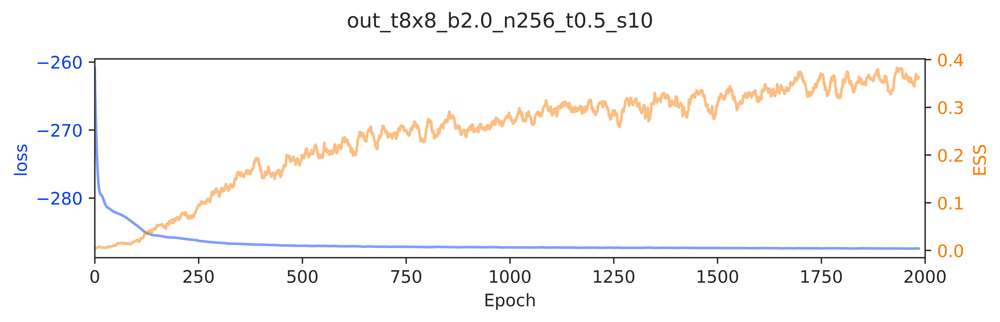

In [9]:
import time
import utils.qed_helpers as qed
from typing import Callable

import torch.nn as nn

from utils.layers import make_u1_equiv_layers, set_weights
from utils.distributions import MultivariateUniform, bootstrap, calc_dkl, calc_ess
from utils.samplers import make_mcmc_ensemble, apply_flow_to_prior

from utils.plot_helpers import (init_live_joint_plots, update_joint_plots,
                                init_live_plot, update_plot)

import matplotlib as mpl
from train import TrainConfig, train

grab = qed.grab

mpl.rcParams['text.usetex'] = False

param.nprint = 100

train_config = TrainConfig(**{
    'n_era': 20,
    'n_epoch': 100,
    'n_layers': 32,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 1024,
    # 'print_freq': 10,
    'plot_freq': 50,
})

outputs = train(param, train_config, pre_model=None,
                logger=logger, figsize=(8, 2.5), use_alt=False)

pre_flow_model = outputs['model']
pre_flow_history = outputs['history']
flow_act = outputs['action']

In [17]:
train_config.n_era

20

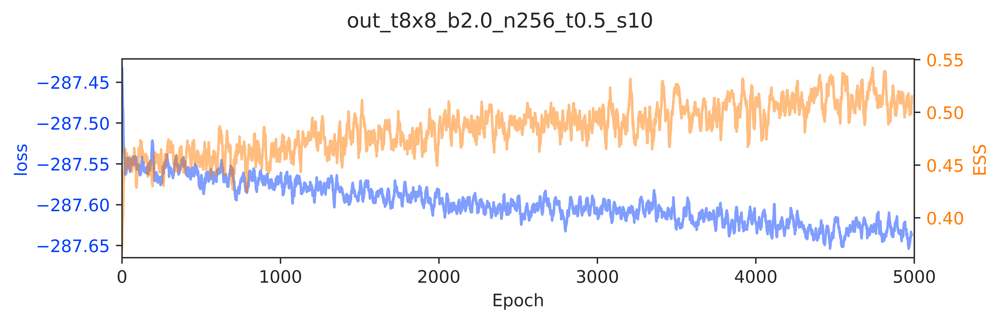

[22:23:25]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=1, last took: 0 min 0 s                                                                                                                                                                                                                         
            -------------------------------------------------------------------

/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


[22:23:29]  era=1     epoch=8     dt=0.34  ess=0.36202 loss=-287.425 loss_force=0     force=nan   force_norm=965.207 dkl=-287.425 logp=87.3559 logq=-200.069 force_size=977496

[22:23:32]  era=1     epoch=18    dt=0.337 ess=0.407939 loss=-287.51 loss_force=0     force=nan   force_norm=978.221 dkl=-287.51 logp=87.6447 logq=-199.866 force_size=995859

[22:23:36]  era=1     epoch=28    dt=0.3419 ess=0.462531 loss=-287.545 loss_force=0     force=nan   force_norm=900.405 dkl=-287.545 logp=88.0393 logq=-199.505 force_size=817851

[22:23:39]  era=1     epoch=38    dt=0.334 ess=0.437193 loss=-287.548 loss_force=0     force=nan   force_norm=1238.65 dkl=-287.548 logp=88.0366 logq=-199.511 force_size=1.92559e+06

[22:23:43]  era=1     epoch=48    dt=0.3333 ess=0.438004 loss=-287.541 loss_force=0     force=nan   force_norm=997.035 dkl=-287.541 logp=87.8723 logq=-199.669 force_size=996722

[22:23:47]  era=1     epoch=58    dt=0.3354 ess=0.472673 loss=-287.549 loss_force=0     force=nan   force_norm=975.796 dkl=-287.549 logp=87.877 logq=-199.672 force_size=985124

[22:23:51]  era=1     epoch=68    dt=0.3347 ess=0.443111 loss=-287.559 loss_force=0     force=nan   force_norm=984.986 dkl=-287.559 logp=88.1701 logq=-199.389 force_size=980192

[22:23:54]  era=1     epoch=78    dt=0.3377 ess=0.4325 loss=-287.553 loss_force=0     force=nan   force_norm=884.355 dkl=-287.553 logp=88.2159 logq=-199.337 force_size=786658

[22:23:57]  era=1     epoch=88    dt=0.3337 ess=0.458353 loss=-287.551 loss_force=0     force=nan   force_norm=950.831 dkl=-287.551 logp=88.2504 logq=-199.3 force_size=918282

[22:24:01]  era=1     epoch=98    dt=0.3325 ess=0.438344 loss=-287.555 loss_force=0     force=nan   force_norm=1046.15 dkl=-287.555 logp=87.8239 logq=-199.732 force_size=1.10938e+06

[22:24:02]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=2, last took: 0 min 36.81 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:24:05]  era=2     epoch=8     dt=0.3294 ess=0.479899 loss=-287.566 loss_force=0     force=nan   force_norm=1055.01 dkl=-287.566 logp=88.0086 logq=-199.557 force_size=1.20021e+06

[22:24:09]  era=2     epoch=18    dt=0.3314 ess=0.456933 loss=-287.565 loss_force=0     force=nan   force_norm=980.503 dkl=-287.565 logp=87.6986 logq=-199.866 force_size=968977

[22:24:12]  era=2     epoch=28    dt=0.3309 ess=0.474694 loss=-287.557 loss_force=0     force=nan   force_norm=897.174 dkl=-287.557 logp=87.8261 logq=-199.731 force_size=817278

[22:24:16]  era=2     epoch=38    dt=0.3307 ess=0.454896 loss=-287.531 loss_force=0     force=nan   force_norm=938.863 dkl=-287.531 logp=87.9218 logq=-199.609 force_size=887589

[22:24:19]  era=2     epoch=48    dt=0.3401 ess=0.463254 loss=-287.557 loss_force=0     force=nan   force_norm=883.879 dkl=-287.557 logp=87.7976 logq=-199.759 force_size=785198

[22:24:24]  era=2     epoch=58    dt=0.3342 ess=0.460843 loss=-287.563 loss_force=0     force=nan   force_norm=991.344 dkl=-287.563 logp=87.9522 logq=-199.611 force_size=992668

[22:24:27]  era=2     epoch=68    dt=0.3339 ess=0.451826 loss=-287.56 loss_force=0     force=nan   force_norm=1001.53 dkl=-287.56 logp=87.8939 logq=-199.666 force_size=1.04999e+06

[22:24:30]  era=2     epoch=78    dt=0.3348 ess=0.433223 loss=-287.576 loss_force=0     force=nan   force_norm=1144.24 dkl=-287.576 logp=87.9365 logq=-199.64 force_size=1.5211e+06

[22:24:34]  era=2     epoch=88    dt=0.3375 ess=0.437376 loss=-287.577 loss_force=0     force=nan   force_norm=1013.01 dkl=-287.577 logp=88.1845 logq=-199.393 force_size=1.10612e+06

[22:24:37]  era=2     epoch=98    dt=0.3348 ess=0.446437 loss=-287.53 loss_force=0     force=nan   force_norm=882.112 dkl=-287.53 logp=87.9301 logq=-199.599 force_size=786292

[22:24:39]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=3, last took: 0 min 36.6 s                                                                                                                                                                                                                      
            -------------------------------------------------------------------

[22:24:42]  era=3     epoch=8     dt=0.334 ess=0.462893 loss=-287.547 loss_force=0     force=nan   force_norm=863.157 dkl=-287.547 logp=87.9394 logq=-199.608 force_size=751368

[22:24:45]  era=3     epoch=18    dt=0.3363 ess=0.458425 loss=-287.568 loss_force=0     force=nan   force_norm=1014.1 dkl=-287.568 logp=88.177 logq=-199.391 force_size=1.0812e+06

[22:24:49]  era=3     epoch=28    dt=0.3403 ess=0.441855 loss=-287.577 loss_force=0     force=nan   force_norm=948.45 dkl=-287.577 logp=88.1604 logq=-199.416 force_size=913328

[22:24:52]  era=3     epoch=38    dt=0.3342 ess=0.464144 loss=-287.566 loss_force=0     force=nan   force_norm=901.165 dkl=-287.566 logp=87.8228 logq=-199.743 force_size=819184

[22:24:56]  era=3     epoch=48    dt=0.3351 ess=0.421649 loss=-287.564 loss_force=0     force=nan   force_norm=971.555 dkl=-287.564 logp=88.0147 logq=-199.55 force_size=953888

[22:25:00]  era=3     epoch=58    dt=0.3341 ess=0.48019 loss=-287.573 loss_force=0     force=nan   force_norm=973.696 dkl=-287.573 logp=87.9473 logq=-199.626 force_size=957924

[22:25:04]  era=3     epoch=68    dt=0.3354 ess=0.433892 loss=-287.557 loss_force=0     force=nan   force_norm=1029.27 dkl=-287.557 logp=87.8002 logq=-199.756 force_size=1.08552e+06

[22:25:07]  era=3     epoch=78    dt=0.3345 ess=0.459936 loss=-287.56 loss_force=0     force=nan   force_norm=966.793 dkl=-287.56 logp=87.9443 logq=-199.616 force_size=949674

[22:25:11]  era=3     epoch=88    dt=0.3344 ess=0.439656 loss=-287.548 loss_force=0     force=nan   force_norm=966.354 dkl=-287.548 logp=87.8659 logq=-199.682 force_size=956067

[22:25:14]  era=3     epoch=98    dt=0.347 ess=0.477678 loss=-287.553 loss_force=0     force=nan   force_norm=1042.73 dkl=-287.553 logp=88.042 logq=-199.511 force_size=1.12176e+06

[22:25:15]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=4, last took: 0 min 36.84 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:25:19]  era=4     epoch=8     dt=0.3393 ess=0.465396 loss=-287.565 loss_force=0     force=nan   force_norm=946.584 dkl=-287.565 logp=87.712 logq=-199.853 force_size=906398

[22:25:22]  era=4     epoch=18    dt=0.3411 ess=0.463985 loss=-287.546 loss_force=0     force=nan   force_norm=1000.97 dkl=-287.546 logp=87.9416 logq=-199.604 force_size=1.00598e+06

[22:25:26]  era=4     epoch=28    dt=0.3454 ess=0.442729 loss=-287.567 loss_force=0     force=nan   force_norm=970.276 dkl=-287.567 logp=87.7503 logq=-199.817 force_size=952517

[22:25:30]  era=4     epoch=38    dt=0.3378 ess=0.450515 loss=-287.564 loss_force=0     force=nan   force_norm=1505.77 dkl=-287.564 logp=87.6006 logq=-199.963 force_size=3.95168e+06

[22:25:33]  era=4     epoch=48    dt=0.3393 ess=0.446167 loss=-287.541 loss_force=0     force=nan   force_norm=913.745 dkl=-287.541 logp=87.5697 logq=-199.972 force_size=837324

[22:25:38]  era=4     epoch=58    dt=0.3425 ess=0.457638 loss=-287.559 loss_force=0     force=nan   force_norm=901.144 dkl=-287.559 logp=87.9191 logq=-199.64 force_size=813920

[22:25:41]  era=4     epoch=68    dt=0.3445 ess=0.487005 loss=-287.56 loss_force=0     force=nan   force_norm=937.259 dkl=-287.56 logp=87.7461 logq=-199.813 force_size=896520

[22:25:45]  era=4     epoch=78    dt=0.3455 ess=0.469963 loss=-287.551 loss_force=0     force=nan   force_norm=909.103 dkl=-287.551 logp=87.8628 logq=-199.688 force_size=829858

[22:25:49]  era=4     epoch=88    dt=0.3457 ess=0.47272 loss=-287.542 loss_force=0     force=nan   force_norm=918.856 dkl=-287.542 logp=87.9084 logq=-199.634 force_size=849282

[22:25:52]  era=4     epoch=98    dt=0.3468 ess=0.462613 loss=-287.548 loss_force=0     force=nan   force_norm=913.018 dkl=-287.548 logp=87.8381 logq=-199.71 force_size=843414

[22:25:53]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=5, last took: 0 min 37.99 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:25:57]  era=5     epoch=8     dt=0.3438 ess=0.432143 loss=-287.556 loss_force=0     force=nan   force_norm=987.258 dkl=-287.556 logp=88.1078 logq=-199.448 force_size=991672

[22:26:01]  era=5     epoch=18    dt=0.3422 ess=0.477829 loss=-287.575 loss_force=0     force=nan   force_norm=993.595 dkl=-287.575 logp=88.1215 logq=-199.454 force_size=991572

[22:26:04]  era=5     epoch=28    dt=0.3429 ess=0.468723 loss=-287.559 loss_force=0     force=nan   force_norm=878.122 dkl=-287.559 logp=87.8463 logq=-199.713 force_size=775233

[22:26:08]  era=5     epoch=38    dt=0.3466 ess=0.445888 loss=-287.567 loss_force=0     force=nan   force_norm=969.767 dkl=-287.567 logp=87.9508 logq=-199.616 force_size=962582

[22:26:11]  era=5     epoch=48    dt=0.3491 ess=0.447931 loss=-287.57 loss_force=0     force=nan   force_norm=1323.48 dkl=-287.57 logp=88.2943 logq=-199.275 force_size=2.08545e+06

[22:26:16]  era=5     epoch=58    dt=0.345 ess=0.49878 loss=-287.561 loss_force=0     force=nan   force_norm=993.823 dkl=-287.561 logp=87.9315 logq=-199.629 force_size=1.04323e+06

[22:26:20]  era=5     epoch=68    dt=0.3441 ess=0.467995 loss=-287.557 loss_force=0     force=nan   force_norm=902.466 dkl=-287.557 logp=88.1766 logq=-199.38 force_size=817848

[22:26:23]  era=5     epoch=78    dt=0.3429 ess=0.467869 loss=-287.563 loss_force=0     force=nan   force_norm=1019.73 dkl=-287.563 logp=87.9232 logq=-199.64 force_size=1.06116e+06

[22:26:27]  era=5     epoch=88    dt=0.345 ess=0.459324 loss=-287.563 loss_force=0     force=nan   force_norm=958.406 dkl=-287.563 logp=88.1895 logq=-199.374 force_size=929270

[22:26:30]  era=5     epoch=98    dt=0.3421 ess=0.435721 loss=-287.592 loss_force=0     force=nan   force_norm=966.558 dkl=-287.592 logp=87.7629 logq=-199.83 force_size=935035

[22:26:32]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=6, last took: 0 min 38.27 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:26:35]  era=6     epoch=8     dt=0.3425 ess=0.458865 loss=-287.565 loss_force=0     force=nan   force_norm=951.04 dkl=-287.565 logp=87.8437 logq=-199.722 force_size=904762

[22:26:39]  era=6     epoch=18    dt=0.3421 ess=0.436202 loss=-287.593 loss_force=0     force=nan   force_norm=989.114 dkl=-287.593 logp=88.2632 logq=-199.33 force_size=1.00356e+06

[22:26:42]  era=6     epoch=28    dt=0.3425 ess=0.467519 loss=-287.578 loss_force=0     force=nan   force_norm=1027.82 dkl=-287.578 logp=88.0675 logq=-199.51 force_size=1.06448e+06

[22:26:46]  era=6     epoch=38    dt=0.3421 ess=0.454227 loss=-287.556 loss_force=0     force=nan   force_norm=1041.16 dkl=-287.556 logp=88.1591 logq=-199.397 force_size=1.11489e+06

[22:26:49]  era=6     epoch=48    dt=0.3414 ess=0.457502 loss=-287.575 loss_force=0     force=nan   force_norm=1157.9 dkl=-287.575 logp=87.8241 logq=-199.751 force_size=1.49438e+06

[22:26:54]  era=6     epoch=58    dt=0.3514 ess=0.446555 loss=-287.553 loss_force=0     force=nan   force_norm=958.072 dkl=-287.553 logp=88.0603 logq=-199.492 force_size=922943

[22:26:58]  era=6     epoch=68    dt=0.3486 ess=0.410666 loss=-287.56 loss_force=0     force=nan   force_norm=899.021 dkl=-287.56 logp=88.0085 logq=-199.551 force_size=813516

[22:27:02]  era=6     epoch=78    dt=0.3476 ess=0.45396 loss=-287.57 loss_force=0     force=nan   force_norm=964.382 dkl=-287.57 logp=87.9745 logq=-199.596 force_size=941201

[22:27:05]  era=6     epoch=88    dt=0.3485 ess=0.457029 loss=-287.555 loss_force=0     force=nan   force_norm=969.145 dkl=-287.555 logp=87.7278 logq=-199.827 force_size=973262

[22:27:09]  era=6     epoch=98    dt=0.3496 ess=0.437399 loss=-287.605 loss_force=0     force=nan   force_norm=955.573 dkl=-287.605 logp=87.8333 logq=-199.771 force_size=923267

[22:27:10]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=7, last took: 0 min 38.41 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:27:14]  era=7     epoch=8     dt=0.3562 ess=0.451328 loss=-287.553 loss_force=0     force=nan   force_norm=1051.57 dkl=-287.553 logp=87.7452 logq=-199.808 force_size=1.23554e+06

[22:27:17]  era=7     epoch=18    dt=0.3469 ess=0.484227 loss=-287.564 loss_force=0     force=nan   force_norm=1044.81 dkl=-287.564 logp=88.006 logq=-199.558 force_size=1.10524e+06

[22:27:21]  era=7     epoch=28    dt=0.3466 ess=0.46811 loss=-287.562 loss_force=0     force=nan   force_norm=910.363 dkl=-287.562 logp=88.2546 logq=-199.308 force_size=835749

[22:27:25]  era=7     epoch=38    dt=0.3478 ess=0.492006 loss=-287.534 loss_force=0     force=nan   force_norm=1037.25 dkl=-287.534 logp=87.85 logq=-199.684 force_size=1.13429e+06

[22:27:28]  era=7     epoch=48    dt=0.3462 ess=0.443467 loss=-287.572 loss_force=0     force=nan   force_norm=893.114 dkl=-287.572 logp=87.9674 logq=-199.605 force_size=798653

[22:27:33]  era=7     epoch=58    dt=0.3478 ess=0.467499 loss=-287.569 loss_force=0     force=nan   force_norm=931.149 dkl=-287.569 logp=87.9819 logq=-199.587 force_size=870574

[22:27:37]  era=7     epoch=68    dt=0.3479 ess=0.486526 loss=-287.57 loss_force=0     force=nan   force_norm=1149.8 dkl=-287.57 logp=88.3403 logq=-199.23 force_size=1.52635e+06

[22:27:40]  era=7     epoch=78    dt=0.3465 ess=0.459835 loss=-287.577 loss_force=0     force=nan   force_norm=1088.75 dkl=-287.577 logp=87.7257 logq=-199.851 force_size=1.2149e+06

[22:27:44]  era=7     epoch=88    dt=0.3496 ess=0.47724 loss=-287.554 loss_force=0     force=nan   force_norm=968.739 dkl=-287.554 logp=87.9497 logq=-199.605 force_size=968697

[22:27:48]  era=7     epoch=98    dt=0.3469 ess=0.457868 loss=-287.549 loss_force=0     force=nan   force_norm=945.479 dkl=-287.549 logp=87.817 logq=-199.732 force_size=903645

[22:27:49]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=8, last took: 0 min 38.57 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:27:52]  era=8     epoch=8     dt=0.3454 ess=0.448523 loss=-287.557 loss_force=0     force=nan   force_norm=966.157 dkl=-287.557 logp=87.8563 logq=-199.7 force_size=967421

[22:27:56]  era=8     epoch=18    dt=0.3462 ess=0.456525 loss=-287.6 loss_force=0     force=nan   force_norm=1054.85 dkl=-287.6 logp=88.015 logq=-199.585 force_size=1.15372e+06

[22:27:59]  era=8     epoch=28    dt=0.3469 ess=0.488978 loss=-287.589 loss_force=0     force=nan   force_norm=877.501 dkl=-287.589 logp=88.1154 logq=-199.473 force_size=783884

[22:28:03]  era=8     epoch=38    dt=0.3464 ess=0.472043 loss=-287.567 loss_force=0     force=nan   force_norm=871.908 dkl=-287.567 logp=87.9395 logq=-199.628 force_size=768543

[22:28:07]  era=8     epoch=48    dt=0.347 ess=0.456266 loss=-287.586 loss_force=0     force=nan   force_norm=959.135 dkl=-287.586 logp=88.2205 logq=-199.366 force_size=931707

[22:28:11]  era=8     epoch=58    dt=0.346 ess=0.451395 loss=-287.553 loss_force=0     force=nan   force_norm=917.146 dkl=-287.553 logp=88.1742 logq=-199.379 force_size=844330

[22:28:15]  era=8     epoch=68    dt=0.3472 ess=0.454092 loss=-287.573 loss_force=0     force=nan   force_norm=1040.27 dkl=-287.573 logp=88.0047 logq=-199.569 force_size=1.16193e+06

[22:28:19]  era=8     epoch=78    dt=0.3478 ess=0.460506 loss=-287.559 loss_force=0     force=nan   force_norm=942.136 dkl=-287.559 logp=87.8363 logq=-199.722 force_size=892488

[22:28:22]  era=8     epoch=88    dt=0.347 ess=0.477975 loss=-287.572 loss_force=0     force=nan   force_norm=980.571 dkl=-287.572 logp=88.0339 logq=-199.538 force_size=971963

[22:28:26]  era=8     epoch=98    dt=0.3462 ess=0.43444 loss=-287.568 loss_force=0     force=nan   force_norm=868.52 dkl=-287.568 logp=87.8237 logq=-199.745 force_size=756753

[22:28:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=9, last took: 0 min 38.48 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:28:31]  era=9     epoch=8     dt=0.3457 ess=0.479138 loss=-287.575 loss_force=0     force=nan   force_norm=900.06 dkl=-287.575 logp=88.0143 logq=-199.561 force_size=814412

[22:28:34]  era=9     epoch=18    dt=0.3467 ess=0.443935 loss=-287.549 loss_force=0     force=nan   force_norm=979.796 dkl=-287.549 logp=88.0068 logq=-199.543 force_size=974083

[22:28:38]  era=9     epoch=28    dt=0.3457 ess=0.475176 loss=-287.588 loss_force=0     force=nan   force_norm=918.002 dkl=-287.588 logp=87.9519 logq=-199.636 force_size=846684

[22:28:42]  era=9     epoch=38    dt=0.3454 ess=0.492768 loss=-287.566 loss_force=0     force=nan   force_norm=1032.66 dkl=-287.566 logp=88.16 logq=-199.406 force_size=1.08769e+06

[22:28:45]  era=9     epoch=48    dt=0.3457 ess=0.466577 loss=-287.565 loss_force=0     force=nan   force_norm=972.636 dkl=-287.565 logp=87.9813 logq=-199.584 force_size=946524

[22:28:50]  era=9     epoch=58    dt=0.3735 ess=0.47137 loss=-287.575 loss_force=0     force=nan   force_norm=1100.6 dkl=-287.575 logp=88.0965 logq=-199.478 force_size=1.2403e+06

[22:28:54]  era=9     epoch=68    dt=0.3447 ess=0.47294 loss=-287.572 loss_force=0     force=nan   force_norm=909.672 dkl=-287.572 logp=87.9211 logq=-199.651 force_size=837196

[22:28:57]  era=9     epoch=78    dt=0.3454 ess=0.454139 loss=-287.57 loss_force=0     force=nan   force_norm=1036.13 dkl=-287.57 logp=87.7856 logq=-199.784 force_size=1.09021e+06

[22:29:01]  era=9     epoch=88    dt=0.3622 ess=0.46033 loss=-287.563 loss_force=0     force=nan   force_norm=1091.11 dkl=-287.563 logp=87.6206 logq=-199.942 force_size=1.21137e+06

[22:29:05]  era=9     epoch=98    dt=0.3497 ess=0.47058 loss=-287.568 loss_force=0     force=nan   force_norm=947.917 dkl=-287.568 logp=88.1643 logq=-199.404 force_size=913278

[22:29:06]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=10, last took: 0 min 38.8 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:29:10]  era=10    epoch=8     dt=0.3511 ess=0.49827 loss=-287.573 loss_force=0     force=nan   force_norm=877.234 dkl=-287.573 logp=87.733 logq=-199.84 force_size=772695

[22:29:13]  era=10    epoch=18    dt=0.3607 ess=0.472853 loss=-287.565 loss_force=0     force=nan   force_norm=1080.01 dkl=-287.565 logp=88.1352 logq=-199.43 force_size=1.18773e+06

[22:29:17]  era=10    epoch=28    dt=0.3497 ess=0.435465 loss=-287.564 loss_force=0     force=nan   force_norm=943.562 dkl=-287.564 logp=88.0847 logq=-199.479 force_size=905210

[22:29:21]  era=10    epoch=38    dt=0.3582 ess=0.447645 loss=-287.566 loss_force=0     force=nan   force_norm=972.047 dkl=-287.566 logp=88.2147 logq=-199.351 force_size=972404

[22:29:25]  era=10    epoch=48    dt=0.3515 ess=0.463168 loss=-287.573 loss_force=0     force=nan   force_norm=942.231 dkl=-287.573 logp=88.2106 logq=-199.362 force_size=889475

[22:29:29]  era=10    epoch=58    dt=0.3501 ess=0.474581 loss=-287.557 loss_force=0     force=nan   force_norm=1009.95 dkl=-287.557 logp=88.0704 logq=-199.486 force_size=1.02381e+06

[22:29:33]  era=10    epoch=68    dt=0.3492 ess=0.444205 loss=-287.569 loss_force=0     force=nan   force_norm=885.756 dkl=-287.569 logp=88.3747 logq=-199.195 force_size=788969

[22:29:37]  era=10    epoch=78    dt=0.3547 ess=0.458139 loss=-287.58 loss_force=0     force=nan   force_norm=932.644 dkl=-287.58 logp=88.5057 logq=-199.074 force_size=879571

[22:29:40]  era=10    epoch=88    dt=0.3465 ess=0.458499 loss=-287.584 loss_force=0     force=nan   force_norm=1057.84 dkl=-287.584 logp=88.0888 logq=-199.496 force_size=1.14111e+06

[22:29:44]  era=10    epoch=98    dt=0.3458 ess=0.454172 loss=-287.576 loss_force=0     force=nan   force_norm=946.158 dkl=-287.576 logp=88.4456 logq=-199.13 force_size=904113

[22:29:45]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=11, last took: 0 min 39.36 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:29:49]  era=11    epoch=8     dt=0.348 ess=0.458094 loss=-287.567 loss_force=0     force=nan   force_norm=1113.38 dkl=-287.567 logp=88.1898 logq=-199.377 force_size=1.2694e+06

[22:29:53]  era=11    epoch=18    dt=0.3631 ess=0.448207 loss=-287.572 loss_force=0     force=nan   force_norm=931.883 dkl=-287.572 logp=87.9323 logq=-199.639 force_size=869521

[22:29:56]  era=11    epoch=28    dt=0.3484 ess=0.479642 loss=-287.594 loss_force=0     force=nan   force_norm=1010.06 dkl=-287.594 logp=88.1673 logq=-199.427 force_size=1.02404e+06

[22:30:00]  era=11    epoch=38    dt=0.3474 ess=0.466562 loss=-287.57 loss_force=0     force=nan   force_norm=938.98 dkl=-287.57 logp=87.9263 logq=-199.643 force_size=888461

[22:30:04]  era=11    epoch=48    dt=0.351 ess=0.466123 loss=-287.586 loss_force=0     force=nan   force_norm=1030.15 dkl=-287.586 logp=88.193 logq=-199.393 force_size=1.12135e+06

[22:30:08]  era=11    epoch=58    dt=0.3535 ess=0.474192 loss=-287.572 loss_force=0     force=nan   force_norm=971.495 dkl=-287.572 logp=88.0969 logq=-199.475 force_size=959680

[22:30:12]  era=11    epoch=68    dt=0.3479 ess=0.478715 loss=-287.587 loss_force=0     force=nan   force_norm=1139.91 dkl=-287.587 logp=88.2064 logq=-199.38 force_size=1.34407e+06

[22:30:16]  era=11    epoch=78    dt=0.3469 ess=0.452736 loss=-287.602 loss_force=0     force=nan   force_norm=1040.54 dkl=-287.602 logp=87.8797 logq=-199.722 force_size=1.14562e+06

[22:30:19]  era=11    epoch=88    dt=0.3488 ess=0.475213 loss=-287.609 loss_force=0     force=nan   force_norm=1020.27 dkl=-287.609 logp=88.2576 logq=-199.351 force_size=1.04521e+06

[22:30:23]  era=11    epoch=98    dt=0.3471 ess=0.478615 loss=-287.585 loss_force=0     force=nan   force_norm=1168.93 dkl=-287.585 logp=88.0991 logq=-199.486 force_size=1.51597e+06

[22:30:24]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=12, last took: 0 min 38.9 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:30:28]  era=12    epoch=8     dt=0.3453 ess=0.440526 loss=-287.563 loss_force=0     force=nan   force_norm=1002.27 dkl=-287.563 logp=88.1961 logq=-199.367 force_size=1.01026e+06

[22:30:31]  era=12    epoch=18    dt=0.3437 ess=0.497636 loss=-287.563 loss_force=0     force=nan   force_norm=1038.2 dkl=-287.563 logp=87.8517 logq=-199.711 force_size=1.08367e+06

[22:30:35]  era=12    epoch=28    dt=0.3438 ess=0.464627 loss=-287.541 loss_force=0     force=nan   force_norm=871.1 dkl=-287.541 logp=87.7311 logq=-199.809 force_size=761822

[22:30:39]  era=12    epoch=38    dt=0.3437 ess=0.44036 loss=-287.592 loss_force=0     force=nan   force_norm=986.914 dkl=-287.592 logp=88.1553 logq=-199.437 force_size=983060

[22:30:42]  era=12    epoch=48    dt=0.3539 ess=0.497136 loss=-287.578 loss_force=0     force=nan   force_norm=851.43 dkl=-287.578 logp=87.923 logq=-199.655 force_size=737642

[22:30:47]  era=12    epoch=58    dt=0.3453 ess=0.464627 loss=-287.583 loss_force=0     force=nan   force_norm=885.007 dkl=-287.583 logp=87.876 logq=-199.707 force_size=791699

[22:30:51]  era=12    epoch=68    dt=0.3472 ess=0.462624 loss=-287.58 loss_force=0     force=nan   force_norm=983.698 dkl=-287.58 logp=87.7223 logq=-199.858 force_size=989592

[22:30:54]  era=12    epoch=78    dt=0.3446 ess=0.489949 loss=-287.58 loss_force=0     force=nan   force_norm=995.276 dkl=-287.58 logp=87.8502 logq=-199.73 force_size=1.01608e+06

[22:30:58]  era=12    epoch=88    dt=0.3542 ess=0.49607 loss=-287.586 loss_force=0     force=nan   force_norm=925.133 dkl=-287.586 logp=88.0061 logq=-199.58 force_size=860054

[22:31:02]  era=12    epoch=98    dt=0.3515 ess=0.457067 loss=-287.559 loss_force=0     force=nan   force_norm=1040.28 dkl=-287.559 logp=87.9753 logq=-199.584 force_size=1.1094e+06

[22:31:03]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=13, last took: 0 min 38.69 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:31:07]  era=13    epoch=8     dt=0.3514 ess=0.487777 loss=-287.595 loss_force=0     force=nan   force_norm=1036.94 dkl=-287.595 logp=87.9557 logq=-199.639 force_size=1.08798e+06

[22:31:10]  era=13    epoch=18    dt=0.3472 ess=0.463586 loss=-287.596 loss_force=0     force=nan   force_norm=985.332 dkl=-287.596 logp=87.8906 logq=-199.705 force_size=981421

[22:31:14]  era=13    epoch=28    dt=0.3538 ess=0.49709 loss=-287.6 loss_force=0     force=nan   force_norm=982.449 dkl=-287.6 logp=87.9618 logq=-199.638 force_size=974547

[22:31:18]  era=13    epoch=38    dt=0.3466 ess=0.43417 loss=-287.57 loss_force=0     force=nan   force_norm=904.478 dkl=-287.57 logp=87.6508 logq=-199.92 force_size=820282

[22:31:21]  era=13    epoch=48    dt=0.3441 ess=0.478863 loss=-287.585 loss_force=0     force=nan   force_norm=975.6 dkl=-287.585 logp=88.0622 logq=-199.523 force_size=964295

[22:31:26]  era=13    epoch=58    dt=0.346 ess=0.465113 loss=-287.564 loss_force=0     force=nan   force_norm=1033.39 dkl=-287.564 logp=87.9396 logq=-199.624 force_size=1.08343e+06

[22:31:30]  era=13    epoch=68    dt=0.3423 ess=0.495766 loss=-287.571 loss_force=0     force=nan   force_norm=1189.82 dkl=-287.571 logp=88.0739 logq=-199.497 force_size=1.48887e+06

[22:31:33]  era=13    epoch=78    dt=0.3423 ess=0.487385 loss=-287.565 loss_force=0     force=nan   force_norm=904.419 dkl=-287.565 logp=87.8986 logq=-199.667 force_size=819090

[22:31:37]  era=13    epoch=88    dt=0.3548 ess=0.462208 loss=-287.589 loss_force=0     force=nan   force_norm=1029.88 dkl=-287.589 logp=88.1212 logq=-199.468 force_size=1.06741e+06

[22:31:41]  era=13    epoch=98    dt=0.3474 ess=0.426402 loss=-287.591 loss_force=0     force=nan   force_norm=984.033 dkl=-287.591 logp=88.2608 logq=-199.33 force_size=976684

[22:31:42]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=14, last took: 0 min 38.83 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:31:45]  era=14    epoch=8     dt=0.3469 ess=0.459859 loss=-287.576 loss_force=0     force=nan   force_norm=1003.78 dkl=-287.576 logp=88.0789 logq=-199.497 force_size=1.03485e+06

[22:31:49]  era=14    epoch=18    dt=0.3526 ess=0.458526 loss=-287.584 loss_force=0     force=nan   force_norm=1040.04 dkl=-287.584 logp=87.9603 logq=-199.624 force_size=1.09136e+06

[22:31:53]  era=14    epoch=28    dt=0.3438 ess=0.475384 loss=-287.571 loss_force=0     force=nan   force_norm=1029.93 dkl=-287.571 logp=87.9783 logq=-199.593 force_size=1.07985e+06

[22:31:56]  era=14    epoch=38    dt=0.3436 ess=0.453019 loss=-287.559 loss_force=0     force=nan   force_norm=1009.64 dkl=-287.559 logp=87.8493 logq=-199.71 force_size=1.04329e+06

[22:32:00]  era=14    epoch=48    dt=0.3468 ess=0.447318 loss=-287.61 loss_force=0     force=nan   force_norm=960.358 dkl=-287.61 logp=88.2896 logq=-199.32 force_size=931973

[22:32:04]  era=14    epoch=58    dt=0.3437 ess=0.467383 loss=-287.549 loss_force=0     force=nan   force_norm=915.747 dkl=-287.549 logp=88.0386 logq=-199.51 force_size=842786

[22:32:08]  era=14    epoch=68    dt=0.3502 ess=0.46739 loss=-287.564 loss_force=0     force=nan   force_norm=1009.15 dkl=-287.564 logp=88.2184 logq=-199.346 force_size=1.02163e+06

[22:32:12]  era=14    epoch=78    dt=0.343 ess=0.486197 loss=-287.593 loss_force=0     force=nan   force_norm=924.584 dkl=-287.593 logp=88.2492 logq=-199.344 force_size=867383

[22:32:15]  era=14    epoch=88    dt=0.3434 ess=0.489819 loss=-287.582 loss_force=0     force=nan   force_norm=1053.69 dkl=-287.582 logp=88.0986 logq=-199.484 force_size=1.14047e+06

[22:32:19]  era=14    epoch=98    dt=0.3437 ess=0.422508 loss=-287.576 loss_force=0     force=nan   force_norm=927.424 dkl=-287.576 logp=87.8191 logq=-199.757 force_size=869874

[22:32:20]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=15, last took: 0 min 38.38 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:32:24]  era=15    epoch=8     dt=0.3444 ess=0.480375 loss=-287.602 loss_force=0     force=nan   force_norm=943.636 dkl=-287.602 logp=88.048 logq=-199.554 force_size=896884

[22:32:27]  era=15    epoch=18    dt=0.3439 ess=0.440969 loss=-287.59 loss_force=0     force=nan   force_norm=987.191 dkl=-287.59 logp=88.3433 logq=-199.247 force_size=981906

[22:32:31]  era=15    epoch=28    dt=0.3443 ess=0.459685 loss=-287.586 loss_force=0     force=nan   force_norm=904.74 dkl=-287.586 logp=88.1486 logq=-199.437 force_size=823322

[22:32:34]  era=15    epoch=38    dt=0.3429 ess=0.500416 loss=-287.587 loss_force=0     force=nan   force_norm=1084.86 dkl=-287.587 logp=88.4048 logq=-199.182 force_size=1.20314e+06

[22:32:38]  era=15    epoch=48    dt=0.3421 ess=0.452941 loss=-287.604 loss_force=0     force=nan   force_norm=982.594 dkl=-287.604 logp=88.2264 logq=-199.378 force_size=1.00103e+06

[22:32:43]  era=15    epoch=58    dt=0.3515 ess=0.481854 loss=-287.574 loss_force=0     force=nan   force_norm=972.749 dkl=-287.574 logp=88.1634 logq=-199.411 force_size=947918

[22:32:46]  era=15    epoch=68    dt=0.3528 ess=0.480356 loss=-287.576 loss_force=0     force=nan   force_norm=886.265 dkl=-287.576 logp=88.0236 logq=-199.553 force_size=789559

[22:32:50]  era=15    epoch=78    dt=0.3531 ess=0.490998 loss=-287.596 loss_force=0     force=nan   force_norm=974.363 dkl=-287.596 logp=88.058 logq=-199.538 force_size=957074

[22:32:54]  era=15    epoch=88    dt=0.3499 ess=0.516196 loss=-287.599 loss_force=0     force=nan   force_norm=1082.04 dkl=-287.599 logp=88.1227 logq=-199.476 force_size=1.18176e+06

[22:32:58]  era=15    epoch=98    dt=0.3601 ess=0.469955 loss=-287.585 loss_force=0     force=nan   force_norm=1026.68 dkl=-287.585 logp=87.6221 logq=-199.963 force_size=1.08997e+06

[22:32:59]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=16, last took: 0 min 38.71 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:33:03]  era=16    epoch=8     dt=0.4606 ess=0.45665 loss=-287.573 loss_force=0     force=nan   force_norm=1293.81 dkl=-287.573 logp=88.0631 logq=-199.51 force_size=1.93799e+06

[22:33:07]  era=16    epoch=18    dt=0.3506 ess=0.513139 loss=-287.565 loss_force=0     force=nan   force_norm=985.663 dkl=-287.565 logp=88.1534 logq=-199.411 force_size=977291

[22:33:11]  era=16    epoch=28    dt=0.3547 ess=0.520086 loss=-287.607 loss_force=0     force=nan   force_norm=921.947 dkl=-287.607 logp=88.3417 logq=-199.265 force_size=852539

[22:33:14]  era=16    epoch=38    dt=0.3512 ess=0.501452 loss=-287.58 loss_force=0     force=nan   force_norm=982.608 dkl=-287.58 logp=88.0657 logq=-199.514 force_size=967986

[22:33:18]  era=16    epoch=48    dt=0.35  ess=0.458199 loss=-287.572 loss_force=0     force=nan   force_norm=1011.93 dkl=-287.572 logp=88.3129 logq=-199.259 force_size=1.02906e+06

[22:33:23]  era=16    epoch=58    dt=0.3522 ess=0.484114 loss=-287.584 loss_force=0     force=nan   force_norm=1039.77 dkl=-287.584 logp=87.9319 logq=-199.652 force_size=1.10079e+06

[22:33:26]  era=16    epoch=68    dt=0.3518 ess=0.472868 loss=-287.585 loss_force=0     force=nan   force_norm=1282.57 dkl=-287.585 logp=88.0097 logq=-199.576 force_size=1.84152e+06

[22:33:30]  era=16    epoch=78    dt=0.3541 ess=0.477834 loss=-287.588 loss_force=0     force=nan   force_norm=1210.92 dkl=-287.588 logp=88.0069 logq=-199.582 force_size=1.66232e+06

[22:33:34]  era=16    epoch=88    dt=0.35  ess=0.457642 loss=-287.605 loss_force=0     force=nan   force_norm=996.404 dkl=-287.605 logp=88.0346 logq=-199.571 force_size=999143

[22:33:38]  era=16    epoch=98    dt=0.3494 ess=0.472709 loss=-287.591 loss_force=0     force=nan   force_norm=1011.21 dkl=-287.591 logp=88.1095 logq=-199.481 force_size=1.03245e+06

[22:33:39]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=17, last took: 0 min 39.93 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:33:42]  era=17    epoch=8     dt=0.3504 ess=0.468678 loss=-287.591 loss_force=0     force=nan   force_norm=947.466 dkl=-287.591 logp=87.9199 logq=-199.671 force_size=900353

[22:33:46]  era=17    epoch=18    dt=0.349 ess=0.453073 loss=-287.577 loss_force=0     force=nan   force_norm=897.648 dkl=-287.577 logp=87.8796 logq=-199.697 force_size=822195

[22:33:50]  era=17    epoch=28    dt=0.3492 ess=0.474392 loss=-287.594 loss_force=0     force=nan   force_norm=1020.48 dkl=-287.594 logp=87.8309 logq=-199.763 force_size=1.0803e+06

[22:33:53]  era=17    epoch=38    dt=0.3493 ess=0.476917 loss=-287.571 loss_force=0     force=nan   force_norm=935.964 dkl=-287.571 logp=87.9812 logq=-199.59 force_size=881038

[22:33:57]  era=17    epoch=48    dt=0.3518 ess=0.476764 loss=-287.588 loss_force=0     force=nan   force_norm=931.216 dkl=-287.588 logp=87.8415 logq=-199.746 force_size=874968

[22:34:02]  era=17    epoch=58    dt=0.3497 ess=0.477324 loss=-287.59 loss_force=0     force=nan   force_norm=1076.31 dkl=-287.59 logp=88.0331 logq=-199.557 force_size=1.16849e+06

[22:34:05]  era=17    epoch=68    dt=0.3483 ess=0.472864 loss=-287.593 loss_force=0     force=nan   force_norm=1111.12 dkl=-287.593 logp=87.944 logq=-199.649 force_size=1.3782e+06

[22:34:09]  era=17    epoch=78    dt=0.3489 ess=0.497443 loss=-287.589 loss_force=0     force=nan   force_norm=1094.71 dkl=-287.589 logp=88.0267 logq=-199.563 force_size=1.23431e+06

[22:34:13]  era=17    epoch=88    dt=0.3478 ess=0.479727 loss=-287.578 loss_force=0     force=nan   force_norm=859.681 dkl=-287.578 logp=87.8238 logq=-199.755 force_size=740038

[22:34:16]  era=17    epoch=98    dt=0.349 ess=0.491655 loss=-287.604 loss_force=0     force=nan   force_norm=933.048 dkl=-287.604 logp=88.0566 logq=-199.548 force_size=884840

[22:34:18]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=18, last took: 0 min 38.88 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:34:21]  era=18    epoch=8     dt=0.348 ess=0.471037 loss=-287.59 loss_force=0     force=nan   force_norm=990.757 dkl=-287.59 logp=87.9612 logq=-199.628 force_size=993204

[22:34:25]  era=18    epoch=18    dt=0.3488 ess=0.482683 loss=-287.611 loss_force=0     force=nan   force_norm=1070.47 dkl=-287.611 logp=87.8617 logq=-199.749 force_size=1.23067e+06

[22:34:28]  era=18    epoch=28    dt=0.3478 ess=0.473886 loss=-287.577 loss_force=0     force=nan   force_norm=947.743 dkl=-287.577 logp=87.9528 logq=-199.624 force_size=902074

[22:34:32]  era=18    epoch=38    dt=0.3477 ess=0.464622 loss=-287.56 loss_force=0     force=nan   force_norm=907.866 dkl=-287.56 logp=87.7313 logq=-199.828 force_size=836250

[22:34:36]  era=18    epoch=48    dt=0.3478 ess=0.485539 loss=-287.568 loss_force=0     force=nan   force_norm=893.179 dkl=-287.568 logp=87.789 logq=-199.778 force_size=800216

[22:34:41]  era=18    epoch=58    dt=0.3481 ess=0.483405 loss=-287.608 loss_force=0     force=nan   force_norm=1037.15 dkl=-287.608 logp=87.7104 logq=-199.898 force_size=1.09673e+06

[22:34:44]  era=18    epoch=68    dt=0.3561 ess=0.503101 loss=-287.579 loss_force=0     force=nan   force_norm=1021.11 dkl=-287.579 logp=87.9215 logq=-199.657 force_size=1.05126e+06

[22:34:48]  era=18    epoch=78    dt=0.3475 ess=0.48805 loss=-287.611 loss_force=0     force=nan   force_norm=1148.2 dkl=-287.611 logp=88.0449 logq=-199.566 force_size=1.57715e+06

[22:34:52]  era=18    epoch=88    dt=0.3465 ess=0.457107 loss=-287.567 loss_force=0     force=nan   force_norm=1198.24 dkl=-287.567 logp=88.0198 logq=-199.547 force_size=1.51672e+06

[22:34:55]  era=18    epoch=98    dt=0.351 ess=0.463722 loss=-287.565 loss_force=0     force=nan   force_norm=987.739 dkl=-287.565 logp=88.0379 logq=-199.527 force_size=986855

[22:34:56]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=19, last took: 0 min 38.8 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:35:00]  era=19    epoch=8     dt=0.347 ess=0.472477 loss=-287.6 loss_force=0     force=nan   force_norm=993.243 dkl=-287.6 logp=88.2187 logq=-199.381 force_size=1.00575e+06

[22:35:04]  era=19    epoch=18    dt=0.3458 ess=0.47392 loss=-287.605 loss_force=0     force=nan   force_norm=947.673 dkl=-287.605 logp=88.3077 logq=-199.298 force_size=915913

[22:35:07]  era=19    epoch=28    dt=0.3473 ess=0.482662 loss=-287.597 loss_force=0     force=nan   force_norm=939.19 dkl=-287.597 logp=87.9792 logq=-199.618 force_size=882666

[22:35:11]  era=19    epoch=38    dt=0.3448 ess=0.500751 loss=-287.575 loss_force=0     force=nan   force_norm=1006.49 dkl=-287.575 logp=87.8874 logq=-199.688 force_size=1.03437e+06

[22:35:14]  era=19    epoch=48    dt=0.3459 ess=0.470542 loss=-287.596 loss_force=0     force=nan   force_norm=1089.64 dkl=-287.596 logp=87.875 logq=-199.721 force_size=1.28123e+06

[22:35:19]  era=19    epoch=58    dt=0.3503 ess=0.443147 loss=-287.589 loss_force=0     force=nan   force_norm=902.437 dkl=-287.589 logp=87.9414 logq=-199.648 force_size=819027

[22:35:23]  era=19    epoch=68    dt=0.345 ess=0.471832 loss=-287.592 loss_force=0     force=nan   force_norm=899.182 dkl=-287.592 logp=87.8554 logq=-199.736 force_size=813429

[22:35:26]  era=19    epoch=78    dt=0.3463 ess=0.483514 loss=-287.575 loss_force=0     force=nan   force_norm=1113.39 dkl=-287.575 logp=87.9024 logq=-199.672 force_size=1.26123e+06

[22:35:30]  era=19    epoch=88    dt=0.3447 ess=0.4994 loss=-287.571 loss_force=0     force=nan   force_norm=962.189 dkl=-287.571 logp=87.9401 logq=-199.63 force_size=940614

[22:35:34]  era=19    epoch=98    dt=0.3455 ess=0.472824 loss=-287.596 loss_force=0     force=nan   force_norm=905.078 dkl=-287.596 logp=87.9995 logq=-199.596 force_size=822385

[22:35:35]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=20, last took: 0 min 38.45 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:35:38]  era=20    epoch=8     dt=0.3403 ess=0.422001 loss=-287.606 loss_force=0     force=nan   force_norm=942.713 dkl=-287.606 logp=87.9298 logq=-199.676 force_size=891719

[22:35:42]  era=20    epoch=18    dt=0.3397 ess=0.460991 loss=-287.597 loss_force=0     force=nan   force_norm=976.113 dkl=-287.597 logp=88.1192 logq=-199.478 force_size=958546

[22:35:45]  era=20    epoch=28    dt=0.3399 ess=0.499958 loss=-287.575 loss_force=0     force=nan   force_norm=1039.6 dkl=-287.575 logp=87.9097 logq=-199.665 force_size=1.0936e+06

[22:35:49]  era=20    epoch=38    dt=0.3396 ess=0.447906 loss=-287.597 loss_force=0     force=nan   force_norm=1074.34 dkl=-287.597 logp=88.1736 logq=-199.424 force_size=1.18456e+06

[22:35:52]  era=20    epoch=48    dt=0.3397 ess=0.500309 loss=-287.604 loss_force=0     force=nan   force_norm=1036.23 dkl=-287.604 logp=88.2471 logq=-199.357 force_size=1.1071e+06

[22:35:57]  era=20    epoch=58    dt=0.3392 ess=0.468583 loss=-287.608 loss_force=0     force=nan   force_norm=1082.1 dkl=-287.608 logp=88.2102 logq=-199.398 force_size=1.20467e+06

[22:36:01]  era=20    epoch=68    dt=0.341 ess=0.483617 loss=-287.599 loss_force=0     force=nan   force_norm=1084.68 dkl=-287.599 logp=88.0297 logq=-199.569 force_size=1.19706e+06

[22:36:04]  era=20    epoch=78    dt=0.3366 ess=0.477284 loss=-287.594 loss_force=0     force=nan   force_norm=896.797 dkl=-287.594 logp=87.9637 logq=-199.63 force_size=808191

[22:36:08]  era=20    epoch=88    dt=0.338 ess=0.481118 loss=-287.581 loss_force=0     force=nan   force_norm=913.064 dkl=-287.581 logp=87.7846 logq=-199.796 force_size=852954

[22:36:11]  era=20    epoch=98    dt=0.337 ess=0.455688 loss=-287.593 loss_force=0     force=nan   force_norm=1342.2 dkl=-287.593 logp=87.8269 logq=-199.766 force_size=2.10379e+06

[22:36:12]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=21, last took: 0 min 37.49 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:36:16]  era=21    epoch=8     dt=0.3369 ess=0.483653 loss=-287.593 loss_force=0     force=nan   force_norm=906.911 dkl=-287.593 logp=88.0026 logq=-199.591 force_size=826759

[22:36:19]  era=21    epoch=18    dt=0.3369 ess=0.49316 loss=-287.611 loss_force=0     force=nan   force_norm=998.61 dkl=-287.611 logp=88.0679 logq=-199.543 force_size=1.00126e+06

[22:36:23]  era=21    epoch=28    dt=0.3368 ess=0.485275 loss=-287.594 loss_force=0     force=nan   force_norm=1006.37 dkl=-287.594 logp=87.8136 logq=-199.78 force_size=1.05525e+06

[22:36:26]  era=21    epoch=38    dt=0.3373 ess=0.498232 loss=-287.601 loss_force=0     force=nan   force_norm=1235.76 dkl=-287.601 logp=88.3786 logq=-199.222 force_size=1.79632e+06

[22:36:30]  era=21    epoch=48    dt=0.3367 ess=0.480924 loss=-287.617 loss_force=0     force=nan   force_norm=927.66 dkl=-287.617 logp=88.2484 logq=-199.369 force_size=871406

[22:36:34]  era=21    epoch=58    dt=0.3368 ess=0.465561 loss=-287.575 loss_force=0     force=nan   force_norm=1115.59 dkl=-287.575 logp=88.1899 logq=-199.385 force_size=1.28213e+06

[22:36:38]  era=21    epoch=68    dt=0.3374 ess=0.513861 loss=-287.621 loss_force=0     force=nan   force_norm=972.625 dkl=-287.621 logp=88.1606 logq=-199.46 force_size=960994

[22:36:41]  era=21    epoch=78    dt=0.3367 ess=0.503877 loss=-287.606 loss_force=0     force=nan   force_norm=1180.27 dkl=-287.606 logp=87.944 logq=-199.662 force_size=1.47898e+06

[22:36:45]  era=21    epoch=88    dt=0.3389 ess=0.467871 loss=-287.587 loss_force=0     force=nan   force_norm=1094.5 dkl=-287.587 logp=88.0645 logq=-199.522 force_size=1.25833e+06

[22:36:48]  era=21    epoch=98    dt=0.337 ess=0.502622 loss=-287.584 loss_force=0     force=nan   force_norm=996.351 dkl=-287.584 logp=88.0639 logq=-199.52 force_size=1.00045e+06

[22:36:49]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=22, last took: 0 min 37.16 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:36:53]  era=22    epoch=8     dt=0.3377 ess=0.481414 loss=-287.604 loss_force=0     force=nan   force_norm=1055.12 dkl=-287.604 logp=88.1287 logq=-199.475 force_size=1.12609e+06

[22:36:56]  era=22    epoch=18    dt=0.3366 ess=0.472802 loss=-287.596 loss_force=0     force=nan   force_norm=936.625 dkl=-287.596 logp=88.1875 logq=-199.409 force_size=886708

[22:37:00]  era=22    epoch=28    dt=0.337 ess=0.5052 loss=-287.603 loss_force=0     force=nan   force_norm=983.163 dkl=-287.603 logp=88.1442 logq=-199.459 force_size=975805

[22:37:03]  era=22    epoch=38    dt=0.3371 ess=0.463129 loss=-287.61 loss_force=0     force=nan   force_norm=961.028 dkl=-287.61 logp=88.0807 logq=-199.529 force_size=951178

[22:37:07]  era=22    epoch=48    dt=0.3371 ess=0.479093 loss=-287.619 loss_force=0     force=nan   force_norm=885.165 dkl=-287.619 logp=88.1697 logq=-199.449 force_size=789976

[22:37:12]  era=22    epoch=58    dt=0.3368 ess=0.501454 loss=-287.615 loss_force=0     force=nan   force_norm=1269.91 dkl=-287.615 logp=88.1343 logq=-199.481 force_size=1.83872e+06

[22:37:15]  era=22    epoch=68    dt=0.3375 ess=0.481623 loss=-287.594 loss_force=0     force=nan   force_norm=980.191 dkl=-287.594 logp=88.0469 logq=-199.547 force_size=986889

[22:37:18]  era=22    epoch=78    dt=0.3371 ess=0.491795 loss=-287.599 loss_force=0     force=nan   force_norm=1004.19 dkl=-287.599 logp=88.0099 logq=-199.589 force_size=1.03079e+06

[22:37:22]  era=22    epoch=88    dt=0.3372 ess=0.483238 loss=-287.603 loss_force=0     force=nan   force_norm=1037.53 dkl=-287.603 logp=88.1937 logq=-199.409 force_size=1.08645e+06

[22:37:25]  era=22    epoch=98    dt=0.337 ess=0.490015 loss=-287.594 loss_force=0     force=nan   force_norm=872.376 dkl=-287.594 logp=88.0344 logq=-199.56 force_size=762566

[22:37:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=23, last took: 0 min 37.17 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:37:30]  era=23    epoch=8     dt=0.347 ess=0.499591 loss=-287.606 loss_force=0     force=nan   force_norm=1037.36 dkl=-287.606 logp=88.1343 logq=-199.472 force_size=1.13672e+06

[22:37:34]  era=23    epoch=18    dt=0.3402 ess=0.506859 loss=-287.587 loss_force=0     force=nan   force_norm=988.026 dkl=-287.587 logp=87.7202 logq=-199.867 force_size=983389

[22:37:37]  era=23    epoch=28    dt=0.3419 ess=0.491144 loss=-287.595 loss_force=0     force=nan   force_norm=917.96 dkl=-287.595 logp=87.7846 logq=-199.81 force_size=845318

[22:37:41]  era=23    epoch=38    dt=0.3405 ess=0.492056 loss=-287.597 loss_force=0     force=nan   force_norm=990.829 dkl=-287.597 logp=87.8492 logq=-199.748 force_size=995773

[22:37:44]  era=23    epoch=48    dt=0.3461 ess=0.50242 loss=-287.594 loss_force=0     force=nan   force_norm=1045.31 dkl=-287.594 logp=87.8851 logq=-199.709 force_size=1.15623e+06

[22:37:49]  era=23    epoch=58    dt=0.3409 ess=0.493294 loss=-287.609 loss_force=0     force=nan   force_norm=1033.74 dkl=-287.609 logp=88.0615 logq=-199.547 force_size=1.07498e+06

[22:37:53]  era=23    epoch=68    dt=0.3418 ess=0.455444 loss=-287.598 loss_force=0     force=nan   force_norm=1259.77 dkl=-287.598 logp=88.2817 logq=-199.316 force_size=1.6446e+06

[22:37:56]  era=23    epoch=78    dt=0.3406 ess=0.494162 loss=-287.61 loss_force=0     force=nan   force_norm=1075.62 dkl=-287.61 logp=88.1821 logq=-199.428 force_size=1.19125e+06

[22:38:00]  era=23    epoch=88    dt=0.3414 ess=0.457449 loss=-287.608 loss_force=0     force=nan   force_norm=1233.46 dkl=-287.608 logp=87.8809 logq=-199.727 force_size=1.69034e+06

[22:38:03]  era=23    epoch=98    dt=0.3406 ess=0.511654 loss=-287.611 loss_force=0     force=nan   force_norm=1004.13 dkl=-287.611 logp=88.3656 logq=-199.245 force_size=1.01856e+06

[22:38:04]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=24, last took: 0 min 37.68 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:38:08]  era=24    epoch=8     dt=0.3431 ess=0.501549 loss=-287.596 loss_force=0     force=nan   force_norm=996.58 dkl=-287.596 logp=88.1952 logq=-199.401 force_size=1.01972e+06

[22:38:11]  era=24    epoch=18    dt=0.3403 ess=0.489575 loss=-287.601 loss_force=0     force=nan   force_norm=920.387 dkl=-287.601 logp=88.0284 logq=-199.573 force_size=848683

[22:38:15]  era=24    epoch=28    dt=0.341 ess=0.494882 loss=-287.602 loss_force=0     force=nan   force_norm=1024.79 dkl=-287.602 logp=88.0961 logq=-199.506 force_size=1.0961e+06

[22:38:18]  era=24    epoch=38    dt=0.3411 ess=0.526077 loss=-287.612 loss_force=0     force=nan   force_norm=898.818 dkl=-287.612 logp=88.257 logq=-199.355 force_size=809793

[22:38:22]  era=24    epoch=48    dt=0.341 ess=0.461565 loss=-287.595 loss_force=0     force=nan   force_norm=964.34 dkl=-287.595 logp=87.9557 logq=-199.639 force_size=941897

[22:38:27]  era=24    epoch=58    dt=0.3415 ess=0.474444 loss=-287.6 loss_force=0     force=nan   force_norm=957.164 dkl=-287.6 logp=88.0461 logq=-199.554 force_size=940004

[22:38:30]  era=24    epoch=68    dt=0.3415 ess=0.479559 loss=-287.618 loss_force=0     force=nan   force_norm=960.044 dkl=-287.618 logp=88.1805 logq=-199.438 force_size=929016

[22:38:34]  era=24    epoch=78    dt=0.3437 ess=0.521384 loss=-287.611 loss_force=0     force=nan   force_norm=957.8 dkl=-287.611 logp=88.3573 logq=-199.254 force_size=923624

[22:38:37]  era=24    epoch=88    dt=0.3425 ess=0.504832 loss=-287.589 loss_force=0     force=nan   force_norm=949.417 dkl=-287.589 logp=88.463 logq=-199.126 force_size=906153

[22:38:41]  era=24    epoch=98    dt=0.3384 ess=0.497039 loss=-287.601 loss_force=0     force=nan   force_norm=1034.14 dkl=-287.601 logp=88.1162 logq=-199.485 force_size=1.14826e+06

[22:38:42]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=25, last took: 0 min 37.68 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:38:45]  era=25    epoch=8     dt=0.3389 ess=0.478243 loss=-287.64 loss_force=0     force=nan   force_norm=964.466 dkl=-287.64 logp=88.1359 logq=-199.504 force_size=936336

[22:38:49]  era=25    epoch=18    dt=0.3381 ess=0.464803 loss=-287.59 loss_force=0     force=nan   force_norm=911.05 dkl=-287.59 logp=88.1091 logq=-199.481 force_size=835984

[22:38:52]  era=25    epoch=28    dt=0.3384 ess=0.466909 loss=-287.596 loss_force=0     force=nan   force_norm=991.556 dkl=-287.596 logp=87.9565 logq=-199.64 force_size=1.0228e+06

[22:38:56]  era=25    epoch=38    dt=0.3379 ess=0.482673 loss=-287.593 loss_force=0     force=nan   force_norm=946.858 dkl=-287.593 logp=88.3641 logq=-199.229 force_size=899133

[22:38:59]  era=25    epoch=48    dt=0.3383 ess=0.49932 loss=-287.601 loss_force=0     force=nan   force_norm=1006.56 dkl=-287.601 logp=88.0255 logq=-199.575 force_size=1.02574e+06

[22:39:04]  era=25    epoch=58    dt=0.3385 ess=0.460884 loss=-287.588 loss_force=0     force=nan   force_norm=1032.39 dkl=-287.588 logp=88.1713 logq=-199.417 force_size=1.11084e+06

[22:39:08]  era=25    epoch=68    dt=0.3387 ess=0.494392 loss=-287.594 loss_force=0     force=nan   force_norm=879.968 dkl=-287.594 logp=87.6934 logq=-199.9 force_size=785343

[22:39:11]  era=25    epoch=78    dt=0.3381 ess=0.499789 loss=-287.599 loss_force=0     force=nan   force_norm=994.689 dkl=-287.599 logp=87.8442 logq=-199.755 force_size=1.00738e+06

[22:39:15]  era=25    epoch=88    dt=0.3384 ess=0.491967 loss=-287.591 loss_force=0     force=nan   force_norm=1042.99 dkl=-287.591 logp=88.1489 logq=-199.442 force_size=1.09035e+06

[22:39:18]  era=25    epoch=98    dt=0.338 ess=0.491414 loss=-287.615 loss_force=0     force=nan   force_norm=1006.95 dkl=-287.615 logp=88.0983 logq=-199.517 force_size=1.02352e+06

[22:39:19]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=26, last took: 0 min 37.31 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:39:23]  era=26    epoch=8     dt=0.3382 ess=0.487478 loss=-287.6 loss_force=0     force=nan   force_norm=1138.22 dkl=-287.6 logp=88.1553 logq=-199.445 force_size=1.33414e+06

[22:39:26]  era=26    epoch=18    dt=0.338 ess=0.476797 loss=-287.586 loss_force=0     force=nan   force_norm=878.361 dkl=-287.586 logp=88.2671 logq=-199.319 force_size=772439

[22:39:30]  era=26    epoch=28    dt=0.3385 ess=0.480074 loss=-287.623 loss_force=0     force=nan   force_norm=956.023 dkl=-287.623 logp=88.2803 logq=-199.343 force_size=927852

[22:39:33]  era=26    epoch=38    dt=0.3384 ess=0.475687 loss=-287.609 loss_force=0     force=nan   force_norm=1034.85 dkl=-287.609 logp=88.1999 logq=-199.409 force_size=1.09965e+06

[22:39:37]  era=26    epoch=48    dt=0.3382 ess=0.505739 loss=-287.626 loss_force=0     force=nan   force_norm=976.407 dkl=-287.626 logp=88.1884 logq=-199.437 force_size=964668

[22:39:42]  era=26    epoch=58    dt=0.3543 ess=0.47802 loss=-287.595 loss_force=0     force=nan   force_norm=991.498 dkl=-287.595 logp=88.3552 logq=-199.24 force_size=1.00288e+06

[22:39:45]  era=26    epoch=68    dt=0.3534 ess=0.511816 loss=-287.607 loss_force=0     force=nan   force_norm=1118.79 dkl=-287.607 logp=88.1578 logq=-199.449 force_size=1.31654e+06

[22:39:49]  era=26    epoch=78    dt=0.3583 ess=0.502243 loss=-287.614 loss_force=0     force=nan   force_norm=813.577 dkl=-287.614 logp=88.0423 logq=-199.572 force_size=664685

[22:39:53]  era=26    epoch=88    dt=0.3421 ess=0.508121 loss=-287.609 loss_force=0     force=nan   force_norm=980.19 dkl=-287.609 logp=88.0035 logq=-199.605 force_size=1.00133e+06

[22:39:56]  era=26    epoch=98    dt=0.3404 ess=0.485861 loss=-287.624 loss_force=0     force=nan   force_norm=933.667 dkl=-287.624 logp=87.865 logq=-199.759 force_size=886400

[22:39:57]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=27, last took: 0 min 38.12 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:40:01]  era=27    epoch=8     dt=0.3384 ess=0.465782 loss=-287.608 loss_force=0     force=nan   force_norm=951.044 dkl=-287.608 logp=88.0474 logq=-199.561 force_size=919721

[22:40:04]  era=27    epoch=18    dt=0.3382 ess=0.520298 loss=-287.605 loss_force=0     force=nan   force_norm=1023.97 dkl=-287.605 logp=87.8219 logq=-199.783 force_size=1.07126e+06

[22:40:08]  era=27    epoch=28    dt=0.3389 ess=0.48091 loss=-287.614 loss_force=0     force=nan   force_norm=945.494 dkl=-287.614 logp=87.8026 logq=-199.811 force_size=900238

[22:40:11]  era=27    epoch=38    dt=0.338 ess=0.480725 loss=-287.615 loss_force=0     force=nan   force_norm=1068.35 dkl=-287.615 logp=88.2824 logq=-199.333 force_size=1.17388e+06

[22:40:15]  era=27    epoch=48    dt=0.3398 ess=0.452583 loss=-287.587 loss_force=0     force=nan   force_norm=1024.32 dkl=-287.587 logp=88.3162 logq=-199.27 force_size=1.08012e+06

[22:40:20]  era=27    epoch=58    dt=0.3377 ess=0.507634 loss=-287.629 loss_force=0     force=nan   force_norm=1068.91 dkl=-287.629 logp=88.0595 logq=-199.569 force_size=1.18632e+06

[22:40:23]  era=27    epoch=68    dt=0.3377 ess=0.474891 loss=-287.589 loss_force=0     force=nan   force_norm=958.294 dkl=-287.589 logp=87.9758 logq=-199.613 force_size=927943

[22:40:27]  era=27    epoch=78    dt=0.3379 ess=0.486846 loss=-287.585 loss_force=0     force=nan   force_norm=894.606 dkl=-287.585 logp=88.0562 logq=-199.529 force_size=811766

[22:40:30]  era=27    epoch=88    dt=0.3374 ess=0.506013 loss=-287.596 loss_force=0     force=nan   force_norm=1056.48 dkl=-287.596 logp=87.926 logq=-199.67 force_size=1.19545e+06

[22:40:34]  era=27    epoch=98    dt=0.3386 ess=0.489046 loss=-287.604 loss_force=0     force=nan   force_norm=869.216 dkl=-287.604 logp=88.1237 logq=-199.48 force_size=758380

[22:40:35]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=28, last took: 0 min 37.33 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:40:39]  era=28    epoch=8     dt=0.4447 ess=0.504382 loss=-287.601 loss_force=0     force=nan   force_norm=1044.41 dkl=-287.601 logp=88.2348 logq=-199.366 force_size=1.1133e+06

[22:40:42]  era=28    epoch=18    dt=0.3385 ess=0.51095 loss=-287.627 loss_force=0     force=nan   force_norm=968.249 dkl=-287.627 logp=88.1256 logq=-199.501 force_size=946831

[22:40:46]  era=28    epoch=28    dt=0.3372 ess=0.502513 loss=-287.628 loss_force=0     force=nan   force_norm=953.279 dkl=-287.628 logp=88.1997 logq=-199.428 force_size=911452

[22:40:49]  era=28    epoch=38    dt=0.3377 ess=0.504182 loss=-287.592 loss_force=0     force=nan   force_norm=968.676 dkl=-287.592 logp=88.2463 logq=-199.346 force_size=952662

[22:40:53]  era=28    epoch=48    dt=0.3371 ess=0.491317 loss=-287.604 loss_force=0     force=nan   force_norm=938.322 dkl=-287.604 logp=88.2178 logq=-199.386 force_size=883948

[22:40:58]  era=28    epoch=58    dt=0.3386 ess=0.496033 loss=-287.603 loss_force=0     force=nan   force_norm=1293.92 dkl=-287.603 logp=88.3244 logq=-199.278 force_size=2.16767e+06

[22:41:01]  era=28    epoch=68    dt=0.3374 ess=0.481664 loss=-287.595 loss_force=0     force=nan   force_norm=939.567 dkl=-287.595 logp=88.2091 logq=-199.385 force_size=904093

[22:41:05]  era=28    epoch=78    dt=0.3377 ess=0.441166 loss=-287.628 loss_force=0     force=nan   force_norm=994.142 dkl=-287.628 logp=88.3093 logq=-199.318 force_size=991287

[22:41:08]  era=28    epoch=88    dt=0.3378 ess=0.507899 loss=-287.616 loss_force=0     force=nan   force_norm=999.449 dkl=-287.616 logp=88.3563 logq=-199.26 force_size=1.03592e+06

[22:41:12]  era=28    epoch=98    dt=0.3382 ess=0.479965 loss=-287.624 loss_force=0     force=nan   force_norm=882.268 dkl=-287.624 logp=88.1907 logq=-199.434 force_size=781737

[22:41:13]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=29, last took: 0 min 38.06 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:41:16]  era=29    epoch=8     dt=0.338 ess=0.483919 loss=-287.634 loss_force=0     force=nan   force_norm=967.578 dkl=-287.634 logp=88.1819 logq=-199.453 force_size=941401

[22:41:20]  era=29    epoch=18    dt=0.3381 ess=0.490755 loss=-287.597 loss_force=0     force=nan   force_norm=945.329 dkl=-287.597 logp=87.9923 logq=-199.605 force_size=905840

[22:41:23]  era=29    epoch=28    dt=0.3383 ess=0.509026 loss=-287.625 loss_force=0     force=nan   force_norm=1078.6 dkl=-287.625 logp=87.8975 logq=-199.727 force_size=1.27889e+06

[22:41:27]  era=29    epoch=38    dt=0.3385 ess=0.480273 loss=-287.585 loss_force=0     force=nan   force_norm=969.586 dkl=-287.585 logp=88.1679 logq=-199.417 force_size=959174

[22:41:30]  era=29    epoch=48    dt=0.3377 ess=0.47694 loss=-287.608 loss_force=0     force=nan   force_norm=975.889 dkl=-287.608 logp=88.2764 logq=-199.332 force_size=953844

[22:41:35]  era=29    epoch=58    dt=0.3379 ess=0.487363 loss=-287.608 loss_force=0     force=nan   force_norm=1090.13 dkl=-287.608 logp=88.0302 logq=-199.578 force_size=1.26682e+06

[22:41:39]  era=29    epoch=68    dt=0.354 ess=0.494531 loss=-287.591 loss_force=0     force=nan   force_norm=1075.95 dkl=-287.591 logp=88.2246 logq=-199.367 force_size=1.20264e+06

[22:41:42]  era=29    epoch=78    dt=0.3529 ess=0.492697 loss=-287.617 loss_force=0     force=nan   force_norm=1169.04 dkl=-287.617 logp=87.8551 logq=-199.762 force_size=1.39205e+06

[22:41:46]  era=29    epoch=88    dt=0.3564 ess=0.487647 loss=-287.628 loss_force=0     force=nan   force_norm=1258.09 dkl=-287.628 logp=88.2437 logq=-199.385 force_size=1.81601e+06

[22:41:50]  era=29    epoch=98    dt=0.3545 ess=0.476988 loss=-287.576 loss_force=0     force=nan   force_norm=1062.67 dkl=-287.576 logp=88.1163 logq=-199.459 force_size=1.14717e+06

[22:41:51]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=30, last took: 0 min 38.28 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:41:55]  era=30    epoch=8     dt=0.3427 ess=0.462194 loss=-287.597 loss_force=0     force=nan   force_norm=1030.67 dkl=-287.597 logp=88.3614 logq=-199.235 force_size=1.08205e+06

[22:41:58]  era=30    epoch=18    dt=0.3419 ess=0.480333 loss=-287.608 loss_force=0     force=nan   force_norm=961.602 dkl=-287.608 logp=88.1142 logq=-199.494 force_size=928844

[22:42:02]  era=30    epoch=28    dt=0.3596 ess=0.497389 loss=-287.61 loss_force=0     force=nan   force_norm=975.893 dkl=-287.61 logp=88.0346 logq=-199.575 force_size=978888

[22:42:06]  era=30    epoch=38    dt=0.363 ess=0.484735 loss=-287.604 loss_force=0     force=nan   force_norm=998.016 dkl=-287.604 logp=88.1594 logq=-199.444 force_size=1.0044e+06

[22:42:10]  era=30    epoch=48    dt=0.3708 ess=0.460476 loss=-287.598 loss_force=0     force=nan   force_norm=1061.35 dkl=-287.598 logp=88.1513 logq=-199.446 force_size=1.15013e+06

[22:42:15]  era=30    epoch=58    dt=0.3618 ess=0.464851 loss=-287.623 loss_force=0     force=nan   force_norm=1049.76 dkl=-287.623 logp=87.9302 logq=-199.692 force_size=1.10311e+06

[22:42:18]  era=30    epoch=68    dt=0.3587 ess=0.489291 loss=-287.598 loss_force=0     force=nan   force_norm=998.276 dkl=-287.598 logp=88.0129 logq=-199.585 force_size=1.02653e+06

[22:42:22]  era=30    epoch=78    dt=0.3547 ess=0.493976 loss=-287.605 loss_force=0     force=nan   force_norm=1066.41 dkl=-287.605 logp=87.9839 logq=-199.621 force_size=1.16918e+06

[22:42:26]  era=30    epoch=88    dt=0.3617 ess=0.505849 loss=-287.594 loss_force=0     force=nan   force_norm=935.602 dkl=-287.594 logp=88.073 logq=-199.521 force_size=877336

[22:42:30]  era=30    epoch=98    dt=0.3538 ess=0.497821 loss=-287.611 loss_force=0     force=nan   force_norm=1070.44 dkl=-287.611 logp=88.1794 logq=-199.432 force_size=1.16094e+06

[22:42:31]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=31, last took: 0 min 39.88 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:42:35]  era=31    epoch=8     dt=0.3593 ess=0.485999 loss=-287.608 loss_force=0     force=nan   force_norm=1083.08 dkl=-287.608 logp=88.0976 logq=-199.51 force_size=1.20123e+06

[22:42:39]  era=31    epoch=18    dt=0.3607 ess=0.501835 loss=-287.623 loss_force=0     force=nan   force_norm=1147.77 dkl=-287.623 logp=87.8535 logq=-199.77 force_size=1.34476e+06

[22:42:42]  era=31    epoch=28    dt=0.3564 ess=0.481561 loss=-287.588 loss_force=0     force=nan   force_norm=1060.9 dkl=-287.588 logp=87.761 logq=-199.827 force_size=1.1387e+06

[22:42:46]  era=31    epoch=38    dt=0.3557 ess=0.504904 loss=-287.613 loss_force=0     force=nan   force_norm=1123.35 dkl=-287.613 logp=88.2464 logq=-199.366 force_size=1.27381e+06

[22:42:50]  era=31    epoch=48    dt=0.3516 ess=0.517249 loss=-287.594 loss_force=0     force=nan   force_norm=1143.16 dkl=-287.594 logp=88.2977 logq=-199.297 force_size=1.32786e+06

[22:42:55]  era=31    epoch=58    dt=0.3506 ess=0.457977 loss=-287.602 loss_force=0     force=nan   force_norm=1076.14 dkl=-287.602 logp=88.1386 logq=-199.464 force_size=1.16105e+06

[22:42:58]  era=31    epoch=68    dt=0.3449 ess=0.458532 loss=-287.618 loss_force=0     force=nan   force_norm=1087.16 dkl=-287.618 logp=88.1262 logq=-199.492 force_size=1.18384e+06

[22:43:02]  era=31    epoch=78    dt=0.3445 ess=0.491968 loss=-287.599 loss_force=0     force=nan   force_norm=1084.5 dkl=-287.599 logp=88.0736 logq=-199.525 force_size=1.21187e+06

[22:43:06]  era=31    epoch=88    dt=0.3484 ess=0.530998 loss=-287.607 loss_force=0     force=nan   force_norm=1086.64 dkl=-287.607 logp=88.2021 logq=-199.404 force_size=1.19659e+06

[22:43:09]  era=31    epoch=98    dt=0.3441 ess=0.491861 loss=-287.614 loss_force=0     force=nan   force_norm=1054.98 dkl=-287.614 logp=88.0236 logq=-199.591 force_size=1.12327e+06

[22:43:10]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=32, last took: 0 min 39.36 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:43:14]  era=32    epoch=8     dt=0.3389 ess=0.497956 loss=-287.618 loss_force=0     force=nan   force_norm=1016.54 dkl=-287.618 logp=88.2422 logq=-199.376 force_size=1.04087e+06

[22:43:17]  era=32    epoch=18    dt=0.3453 ess=0.45889 loss=-287.591 loss_force=0     force=nan   force_norm=1169.42 dkl=-287.591 logp=88.1021 logq=-199.489 force_size=1.39954e+06

[22:43:21]  era=32    epoch=28    dt=0.3582 ess=0.507887 loss=-287.597 loss_force=0     force=nan   force_norm=1086.25 dkl=-287.597 logp=87.9247 logq=-199.672 force_size=1.25246e+06

[22:43:25]  era=32    epoch=38    dt=0.3646 ess=0.481102 loss=-287.61 loss_force=0     force=nan   force_norm=977.984 dkl=-287.61 logp=88.2983 logq=-199.312 force_size=963856

[22:43:29]  era=32    epoch=48    dt=0.3586 ess=0.473526 loss=-287.6 loss_force=0     force=nan   force_norm=1039.56 dkl=-287.6 logp=88.5827 logq=-199.017 force_size=1.09025e+06

[22:43:34]  era=32    epoch=58    dt=0.3607 ess=0.500189 loss=-287.609 loss_force=0     force=nan   force_norm=948.704 dkl=-287.609 logp=88.2591 logq=-199.35 force_size=902365

[22:43:38]  era=32    epoch=68    dt=0.3623 ess=0.498051 loss=-287.609 loss_force=0     force=nan   force_norm=1099.83 dkl=-287.609 logp=88.3791 logq=-199.23 force_size=1.22258e+06

[22:43:42]  era=32    epoch=78    dt=0.3559 ess=0.487204 loss=-287.623 loss_force=0     force=nan   force_norm=1008.72 dkl=-287.623 logp=88.4307 logq=-199.192 force_size=1.02096e+06

[22:43:45]  era=32    epoch=88    dt=0.3632 ess=0.50116 loss=-287.612 loss_force=0     force=nan   force_norm=1128.23 dkl=-287.612 logp=88.0941 logq=-199.518 force_size=1.29695e+06

[22:43:49]  era=32    epoch=98    dt=0.3564 ess=0.512149 loss=-287.612 loss_force=0     force=nan   force_norm=1353.78 dkl=-287.612 logp=88.2244 logq=-199.388 force_size=1.93943e+06

[22:43:50]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=33, last took: 0 min 40.08 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:43:54]  era=33    epoch=8     dt=0.3548 ess=0.496387 loss=-287.608 loss_force=0     force=nan   force_norm=1154.24 dkl=-287.608 logp=88.3298 logq=-199.278 force_size=1.36328e+06

[22:43:58]  era=33    epoch=18    dt=0.3614 ess=0.524243 loss=-287.609 loss_force=0     force=nan   force_norm=1086.83 dkl=-287.609 logp=88.2655 logq=-199.344 force_size=1.19448e+06

[22:44:02]  era=33    epoch=28    dt=0.3553 ess=0.493186 loss=-287.601 loss_force=0     force=nan   force_norm=1296.18 dkl=-287.601 logp=88.5312 logq=-199.07 force_size=1.78159e+06

[22:44:05]  era=33    epoch=38    dt=0.3547 ess=0.474353 loss=-287.614 loss_force=0     force=nan   force_norm=1231.61 dkl=-287.614 logp=88.2639 logq=-199.35 force_size=1.5266e+06

[22:44:09]  era=33    epoch=48    dt=0.3576 ess=0.478047 loss=-287.618 loss_force=0     force=nan   force_norm=1258.49 dkl=-287.618 logp=88.2334 logq=-199.385 force_size=1.59969e+06

[22:44:14]  era=33    epoch=58    dt=0.3597 ess=0.467235 loss=-287.619 loss_force=0     force=nan   force_norm=1254.84 dkl=-287.619 logp=88.2151 logq=-199.404 force_size=1.5854e+06

[22:44:18]  era=33    epoch=68    dt=0.3535 ess=0.497261 loss=-287.613 loss_force=0     force=nan   force_norm=1144.27 dkl=-287.613 logp=88.0133 logq=-199.6 force_size=1.31795e+06

[22:44:22]  era=33    epoch=78    dt=0.3527 ess=0.502982 loss=-287.599 loss_force=0     force=nan   force_norm=1306.76 dkl=-287.599 logp=88.4119 logq=-199.187 force_size=1.72839e+06

[22:44:25]  era=33    epoch=88    dt=0.348 ess=0.510989 loss=-287.595 loss_force=0     force=nan   force_norm=1274.06 dkl=-287.595 logp=88.2807 logq=-199.314 force_size=1.66224e+06

[22:44:29]  era=33    epoch=98    dt=0.346 ess=0.497144 loss=-287.595 loss_force=0     force=nan   force_norm=1261.74 dkl=-287.595 logp=88.0288 logq=-199.566 force_size=1.60506e+06

[22:44:30]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=34, last took: 0 min 39.69 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:44:34]  era=34    epoch=8     dt=0.3459 ess=0.509465 loss=-287.61 loss_force=0     force=nan   force_norm=1209.3 dkl=-287.61 logp=87.8107 logq=-199.799 force_size=1.46982e+06

[22:44:37]  era=34    epoch=18    dt=0.3458 ess=0.461145 loss=-287.604 loss_force=0     force=nan   force_norm=1184.84 dkl=-287.604 logp=88.1317 logq=-199.472 force_size=1.42167e+06

[22:44:41]  era=34    epoch=28    dt=0.3431 ess=0.454138 loss=-287.603 loss_force=0     force=nan   force_norm=1223.62 dkl=-287.603 logp=88.0258 logq=-199.577 force_size=1.5024e+06

[22:44:44]  era=34    epoch=38    dt=0.3469 ess=0.480707 loss=-287.603 loss_force=0     force=nan   force_norm=1226.96 dkl=-287.603 logp=87.833 logq=-199.77 force_size=1.51483e+06

[22:44:48]  era=34    epoch=48    dt=0.3433 ess=0.491935 loss=-287.579 loss_force=0     force=nan   force_norm=1434.51 dkl=-287.579 logp=88.4603 logq=-199.119 force_size=2.12929e+06

[22:44:53]  era=34    epoch=58    dt=0.3431 ess=0.456118 loss=-287.603 loss_force=0     force=nan   force_norm=1304.29 dkl=-287.603 logp=88.3976 logq=-199.205 force_size=1.80412e+06

[22:44:56]  era=34    epoch=68    dt=0.346 ess=0.481291 loss=-287.577 loss_force=0     force=nan   force_norm=1156.91 dkl=-287.577 logp=88.1567 logq=-199.421 force_size=1.34392e+06

[22:45:00]  era=34    epoch=78    dt=0.3504 ess=0.494091 loss=-287.599 loss_force=0     force=nan   force_norm=1220.62 dkl=-287.599 logp=88.1798 logq=-199.42 force_size=1.50217e+06

[22:45:04]  era=34    epoch=88    dt=0.3431 ess=0.50328 loss=-287.595 loss_force=0     force=nan   force_norm=1160.99 dkl=-287.595 logp=88.002 logq=-199.593 force_size=1.35662e+06

[22:45:07]  era=34    epoch=98    dt=0.3682 ess=0.49888 loss=-287.619 loss_force=0     force=nan   force_norm=1380.03 dkl=-287.619 logp=88.2782 logq=-199.34 force_size=1.99518e+06

[22:45:08]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=35, last took: 0 min 38.41 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:45:12]  era=35    epoch=8     dt=0.358 ess=0.476934 loss=-287.598 loss_force=0     force=nan   force_norm=1205.24 dkl=-287.598 logp=88.2019 logq=-199.396 force_size=1.47789e+06

[22:45:16]  era=35    epoch=18    dt=0.3638 ess=0.517841 loss=-287.597 loss_force=0     force=nan   force_norm=1170.39 dkl=-287.597 logp=88.3813 logq=-199.216 force_size=1.38563e+06

[22:45:20]  era=35    epoch=28    dt=0.3544 ess=0.523907 loss=-287.625 loss_force=0     force=nan   force_norm=1219.85 dkl=-287.625 logp=88.3392 logq=-199.286 force_size=1.51322e+06

[22:45:24]  era=35    epoch=38    dt=0.3589 ess=0.495177 loss=-287.61 loss_force=0     force=nan   force_norm=1152.39 dkl=-287.61 logp=88.3002 logq=-199.31 force_size=1.34129e+06

[22:45:27]  era=35    epoch=48    dt=0.3554 ess=0.518763 loss=-287.605 loss_force=0     force=nan   force_norm=1173.23 dkl=-287.605 logp=88.108 logq=-199.497 force_size=1.38908e+06

[22:45:32]  era=35    epoch=58    dt=0.3514 ess=0.468058 loss=-287.605 loss_force=0     force=nan   force_norm=1384.39 dkl=-287.605 logp=88.4239 logq=-199.181 force_size=2.16167e+06

[22:45:36]  era=35    epoch=68    dt=0.3561 ess=0.447621 loss=-287.611 loss_force=0     force=nan   force_norm=1190.12 dkl=-287.611 logp=88.3367 logq=-199.274 force_size=1.44047e+06

[22:45:40]  era=35    epoch=78    dt=0.3505 ess=0.489198 loss=-287.623 loss_force=0     force=nan   force_norm=1395.2 dkl=-287.623 logp=88.4832 logq=-199.14 force_size=1.97259e+06

[22:45:43]  era=35    epoch=88    dt=0.3498 ess=0.509581 loss=-287.596 loss_force=0     force=nan   force_norm=1122.29 dkl=-287.596 logp=88.181 logq=-199.415 force_size=1.26714e+06

[22:45:47]  era=35    epoch=98    dt=0.3518 ess=0.515538 loss=-287.632 loss_force=0     force=nan   force_norm=1087.19 dkl=-287.632 logp=88.0993 logq=-199.533 force_size=1.18461e+06

[22:45:48]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=36, last took: 0 min 39.69 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:45:52]  era=36    epoch=8     dt=0.3505 ess=0.537201 loss=-287.62 loss_force=0     force=nan   force_norm=1059.97 dkl=-287.62 logp=88.0817 logq=-199.538 force_size=1.12668e+06

[22:45:56]  era=36    epoch=18    dt=0.3554 ess=0.517936 loss=-287.615 loss_force=0     force=nan   force_norm=1103.21 dkl=-287.615 logp=87.8296 logq=-199.786 force_size=1.21978e+06

[22:45:59]  era=36    epoch=28    dt=0.3492 ess=0.529323 loss=-287.628 loss_force=0     force=nan   force_norm=1106.45 dkl=-287.628 logp=88.3018 logq=-199.327 force_size=1.23292e+06

[22:46:03]  era=36    epoch=38    dt=0.349 ess=0.485591 loss=-287.627 loss_force=0     force=nan   force_norm=1144.55 dkl=-287.627 logp=88.3094 logq=-199.317 force_size=1.33718e+06

[22:46:07]  era=36    epoch=48    dt=0.3499 ess=0.503526 loss=-287.624 loss_force=0     force=nan   force_norm=1121.88 dkl=-287.624 logp=88.1623 logq=-199.461 force_size=1.27238e+06

[22:46:11]  era=36    epoch=58    dt=0.3505 ess=0.496035 loss=-287.602 loss_force=0     force=nan   force_norm=1336.35 dkl=-287.602 logp=88.2554 logq=-199.346 force_size=1.84981e+06

[22:46:15]  era=36    epoch=68    dt=0.3486 ess=0.501533 loss=-287.612 loss_force=0     force=nan   force_norm=1180.99 dkl=-287.612 logp=88.3862 logq=-199.226 force_size=1.42366e+06

[22:46:19]  era=36    epoch=78    dt=0.3508 ess=0.510627 loss=-287.586 loss_force=0     force=nan   force_norm=1072.05 dkl=-287.586 logp=88.1381 logq=-199.448 force_size=1.17424e+06

[22:46:22]  era=36    epoch=88    dt=0.3518 ess=0.492187 loss=-287.629 loss_force=0     force=nan   force_norm=1138.26 dkl=-287.629 logp=88.3395 logq=-199.29 force_size=1.33295e+06

[22:46:26]  era=36    epoch=98    dt=0.3538 ess=0.46254 loss=-287.621 loss_force=0     force=nan   force_norm=1025.12 dkl=-287.621 logp=88.3595 logq=-199.261 force_size=1.05764e+06

[22:46:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=37, last took: 0 min 39.19 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:46:31]  era=37    epoch=8     dt=0.35  ess=0.521721 loss=-287.622 loss_force=0     force=nan   force_norm=1170.03 dkl=-287.622 logp=88.0264 logq=-199.596 force_size=1.40142e+06

[22:46:35]  era=37    epoch=18    dt=0.3495 ess=0.508485 loss=-287.626 loss_force=0     force=nan   force_norm=1075.38 dkl=-287.626 logp=88.482 logq=-199.144 force_size=1.15715e+06

[22:46:38]  era=37    epoch=28    dt=0.3481 ess=0.502111 loss=-287.624 loss_force=0     force=nan   force_norm=1174.45 dkl=-287.624 logp=88.3268 logq=-199.297 force_size=1.41301e+06

[22:46:42]  era=37    epoch=38    dt=0.3614 ess=0.50286 loss=-287.634 loss_force=0     force=nan   force_norm=1120.96 dkl=-287.634 logp=88.1796 logq=-199.455 force_size=1.29519e+06

[22:46:46]  era=37    epoch=48    dt=0.3601 ess=0.501812 loss=-287.619 loss_force=0     force=nan   force_norm=1164.02 dkl=-287.619 logp=88.045 logq=-199.574 force_size=1.42404e+06

[22:46:51]  era=37    epoch=58    dt=0.3646 ess=0.463022 loss=-287.625 loss_force=0     force=nan   force_norm=1217.03 dkl=-287.625 logp=88.0033 logq=-199.622 force_size=1.48785e+06

[22:46:55]  era=37    epoch=68    dt=0.3652 ess=0.50356 loss=-287.599 loss_force=0     force=nan   force_norm=1231.23 dkl=-287.599 logp=88.1099 logq=-199.489 force_size=1.54623e+06

[22:46:59]  era=37    epoch=78    dt=0.3612 ess=0.503743 loss=-287.612 loss_force=0     force=nan   force_norm=1176.68 dkl=-287.612 logp=87.898 logq=-199.714 force_size=1.39563e+06

[22:47:03]  era=37    epoch=88    dt=0.3708 ess=0.510261 loss=-287.614 loss_force=0     force=nan   force_norm=1128.88 dkl=-287.614 logp=88.0392 logq=-199.574 force_size=1.278e+06

[22:47:06]  era=37    epoch=98    dt=0.3597 ess=0.51001 loss=-287.609 loss_force=0     force=nan   force_norm=1226.25 dkl=-287.609 logp=88.1573 logq=-199.452 force_size=1.52675e+06

[22:47:08]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=38, last took: 0 min 40.23 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:47:11]  era=38    epoch=8     dt=0.3637 ess=0.512648 loss=-287.611 loss_force=0     force=nan   force_norm=1177.09 dkl=-287.611 logp=87.8367 logq=-199.774 force_size=1.49462e+06

[22:47:15]  era=38    epoch=18    dt=0.3564 ess=0.48394 loss=-287.617 loss_force=0     force=nan   force_norm=1147.79 dkl=-287.617 logp=87.9479 logq=-199.669 force_size=1.33267e+06

[22:47:19]  era=38    epoch=28    dt=0.3546 ess=0.496339 loss=-287.616 loss_force=0     force=nan   force_norm=1111.68 dkl=-287.616 logp=87.8799 logq=-199.736 force_size=1.24673e+06

[22:47:23]  era=38    epoch=38    dt=0.3561 ess=0.487214 loss=-287.602 loss_force=0     force=nan   force_norm=1168.19 dkl=-287.602 logp=88.1191 logq=-199.483 force_size=1.37567e+06

[22:47:26]  era=38    epoch=48    dt=0.3586 ess=0.513304 loss=-287.615 loss_force=0     force=nan   force_norm=1176.91 dkl=-287.615 logp=88.1394 logq=-199.476 force_size=1.38703e+06

[22:47:31]  era=38    epoch=58    dt=0.3549 ess=0.484721 loss=-287.628 loss_force=0     force=nan   force_norm=1383.57 dkl=-287.628 logp=88.4729 logq=-199.155 force_size=1.98842e+06

[22:47:35]  era=38    epoch=68    dt=0.3573 ess=0.491806 loss=-287.598 loss_force=0     force=nan   force_norm=1274.48 dkl=-287.598 logp=88.1304 logq=-199.468 force_size=1.62763e+06

[22:47:39]  era=38    epoch=78    dt=0.3543 ess=0.504765 loss=-287.6 loss_force=0     force=nan   force_norm=1147.57 dkl=-287.6 logp=88.2519 logq=-199.348 force_size=1.32587e+06

[22:47:43]  era=38    epoch=88    dt=0.3526 ess=0.458402 loss=-287.594 loss_force=0     force=nan   force_norm=1260.75 dkl=-287.594 logp=87.9669 logq=-199.627 force_size=1.6601e+06

[22:47:46]  era=38    epoch=98    dt=0.3528 ess=0.528834 loss=-287.613 loss_force=0     force=nan   force_norm=1129.44 dkl=-287.613 logp=88.3262 logq=-199.287 force_size=1.27854e+06

[22:47:48]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=39, last took: 0 min 39.97 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:47:51]  era=39    epoch=8     dt=0.3524 ess=0.499941 loss=-287.609 loss_force=0     force=nan   force_norm=1072.98 dkl=-287.609 logp=88.1023 logq=-199.507 force_size=1.1692e+06

[22:47:55]  era=39    epoch=18    dt=0.3527 ess=0.497057 loss=-287.621 loss_force=0     force=nan   force_norm=1110.8 dkl=-287.621 logp=88.2707 logq=-199.35 force_size=1.24801e+06

[22:47:59]  era=39    epoch=28    dt=0.3577 ess=0.496767 loss=-287.588 loss_force=0     force=nan   force_norm=1075.71 dkl=-287.588 logp=88.0611 logq=-199.526 force_size=1.15844e+06

[22:48:03]  era=39    epoch=38    dt=0.3586 ess=0.513835 loss=-287.646 loss_force=0     force=nan   force_norm=1020.12 dkl=-287.646 logp=87.8826 logq=-199.764 force_size=1.0419e+06

[22:48:06]  era=39    epoch=48    dt=0.3574 ess=0.514724 loss=-287.622 loss_force=0     force=nan   force_norm=1066.32 dkl=-287.622 logp=88.1465 logq=-199.475 force_size=1.15283e+06

[22:48:11]  era=39    epoch=58    dt=0.3641 ess=0.521176 loss=-287.61 loss_force=0     force=nan   force_norm=1418.44 dkl=-287.61 logp=88.1373 logq=-199.473 force_size=2.09628e+06

[22:48:15]  era=39    epoch=68    dt=0.3556 ess=0.510545 loss=-287.637 loss_force=0     force=nan   force_norm=1139.06 dkl=-287.637 logp=88.1174 logq=-199.519 force_size=1.31452e+06

[22:48:19]  era=39    epoch=78    dt=0.3554 ess=0.499903 loss=-287.622 loss_force=0     force=nan   force_norm=1221.6 dkl=-287.622 logp=88.2707 logq=-199.351 force_size=1.60443e+06

[22:48:23]  era=39    epoch=88    dt=0.3586 ess=0.482593 loss=-287.607 loss_force=0     force=nan   force_norm=1051.04 dkl=-287.607 logp=87.9574 logq=-199.649 force_size=1.13285e+06

[22:48:27]  era=39    epoch=98    dt=0.3531 ess=0.510646 loss=-287.635 loss_force=0     force=nan   force_norm=1046.06 dkl=-287.635 logp=88.499 logq=-199.136 force_size=1.098e+06

[22:48:28]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=40, last took: 0 min 40.2 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:48:31]  era=40    epoch=8     dt=0.3448 ess=0.497761 loss=-287.645 loss_force=0     force=nan   force_norm=1063.62 dkl=-287.645 logp=88.2402 logq=-199.405 force_size=1.13446e+06

[22:48:35]  era=40    epoch=18    dt=0.3445 ess=0.522005 loss=-287.612 loss_force=0     force=nan   force_norm=1141.93 dkl=-287.612 logp=87.996 logq=-199.616 force_size=1.33296e+06

[22:48:39]  era=40    epoch=28    dt=0.3586 ess=0.530801 loss=-287.64 loss_force=0     force=nan   force_norm=1151.99 dkl=-287.64 logp=88.24 logq=-199.4 force_size=1.40291e+06

[22:48:42]  era=40    epoch=38    dt=0.3469 ess=0.509008 loss=-287.623 loss_force=0     force=nan   force_norm=1135.88 dkl=-287.623 logp=87.7657 logq=-199.857 force_size=1.31115e+06

[22:48:46]  era=40    epoch=48    dt=0.3456 ess=0.514803 loss=-287.649 loss_force=0     force=nan   force_norm=1176.97 dkl=-287.649 logp=88.1524 logq=-199.496 force_size=1.50925e+06

[22:48:51]  era=40    epoch=58    dt=0.3476 ess=0.504368 loss=-287.621 loss_force=0     force=nan   force_norm=1316.86 dkl=-287.621 logp=88.0383 logq=-199.583 force_size=1.8612e+06

[22:48:55]  era=40    epoch=68    dt=0.3537 ess=0.509127 loss=-287.596 loss_force=0     force=nan   force_norm=1081.76 dkl=-287.596 logp=88.2156 logq=-199.38 force_size=1.20976e+06

[22:48:58]  era=40    epoch=78    dt=0.3554 ess=0.529167 loss=-287.621 loss_force=0     force=nan   force_norm=1263.26 dkl=-287.621 logp=87.9941 logq=-199.627 force_size=1.72374e+06

[22:49:02]  era=40    epoch=88    dt=0.355 ess=0.521038 loss=-287.637 loss_force=0     force=nan   force_norm=1089.47 dkl=-287.637 logp=88.0504 logq=-199.587 force_size=1.1984e+06

[22:49:06]  era=40    epoch=98    dt=0.3624 ess=0.459112 loss=-287.618 loss_force=0     force=nan   force_norm=1092.42 dkl=-287.618 logp=88.3263 logq=-199.292 force_size=1.19649e+06

[22:49:07]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=41, last took: 0 min 39.26 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:49:11]  era=41    epoch=8     dt=0.3511 ess=0.526763 loss=-287.626 loss_force=0     force=nan   force_norm=1076.1 dkl=-287.626 logp=88.1716 logq=-199.454 force_size=1.16468e+06

[22:49:14]  era=41    epoch=18    dt=0.352 ess=0.489196 loss=-287.629 loss_force=0     force=nan   force_norm=1031.56 dkl=-287.629 logp=88.5145 logq=-199.114 force_size=1.06909e+06

[22:49:18]  era=41    epoch=28    dt=0.355 ess=0.515467 loss=-287.613 loss_force=0     force=nan   force_norm=1115.68 dkl=-287.613 logp=88.2695 logq=-199.343 force_size=1.24648e+06

[22:49:22]  era=41    epoch=38    dt=0.3477 ess=0.500886 loss=-287.633 loss_force=0     force=nan   force_norm=1149.99 dkl=-287.633 logp=88.5208 logq=-199.113 force_size=1.33464e+06

[22:49:25]  era=41    epoch=48    dt=0.3483 ess=0.462449 loss=-287.611 loss_force=0     force=nan   force_norm=1324.06 dkl=-287.611 logp=88.2331 logq=-199.378 force_size=1.76723e+06

[22:49:30]  era=41    epoch=58    dt=0.3514 ess=0.476615 loss=-287.618 loss_force=0     force=nan   force_norm=1283.38 dkl=-287.618 logp=88.1907 logq=-199.428 force_size=1.70271e+06

[22:49:34]  era=41    epoch=68    dt=0.3486 ess=0.478348 loss=-287.589 loss_force=0     force=nan   force_norm=1240.85 dkl=-287.589 logp=88.121 logq=-199.467 force_size=1.58594e+06

[22:49:38]  era=41    epoch=78    dt=0.3472 ess=0.505483 loss=-287.643 loss_force=0     force=nan   force_norm=1185.94 dkl=-287.643 logp=88.2721 logq=-199.371 force_size=1.41937e+06

[22:49:41]  era=41    epoch=88    dt=0.3469 ess=0.499242 loss=-287.65 loss_force=0     force=nan   force_norm=1112.28 dkl=-287.65 logp=88.4714 logq=-199.179 force_size=1.23872e+06

[22:49:45]  era=41    epoch=98    dt=0.3569 ess=0.507285 loss=-287.642 loss_force=0     force=nan   force_norm=1277.45 dkl=-287.642 logp=88.4576 logq=-199.185 force_size=1.68566e+06

[22:49:46]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=42, last took: 0 min 39.1 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[22:49:50]  era=42    epoch=8     dt=0.3662 ess=0.509506 loss=-287.651 loss_force=0     force=nan   force_norm=1141.42 dkl=-287.651 logp=88.1677 logq=-199.484 force_size=1.32195e+06

[22:49:54]  era=42    epoch=18    dt=0.358 ess=0.498866 loss=-287.614 loss_force=0     force=nan   force_norm=1074.23 dkl=-287.614 logp=88.1311 logq=-199.483 force_size=1.15493e+06

[22:49:58]  era=42    epoch=28    dt=0.3611 ess=0.493456 loss=-287.606 loss_force=0     force=nan   force_norm=1098.38 dkl=-287.606 logp=87.8461 logq=-199.76 force_size=1.21215e+06

[22:50:01]  era=42    epoch=38    dt=0.3746 ess=0.533364 loss=-287.647 loss_force=0     force=nan   force_norm=1116.19 dkl=-287.647 logp=88.1181 logq=-199.529 force_size=1.25394e+06

[22:50:05]  era=42    epoch=48    dt=0.3598 ess=0.513604 loss=-287.624 loss_force=0     force=nan   force_norm=1152.23 dkl=-287.624 logp=88.2408 logq=-199.384 force_size=1.34146e+06

[22:50:10]  era=42    epoch=58    dt=0.3604 ess=0.484866 loss=-287.638 loss_force=0     force=nan   force_norm=1184.28 dkl=-287.638 logp=87.9319 logq=-199.706 force_size=1.44209e+06

[22:50:14]  era=42    epoch=68    dt=0.3604 ess=0.538135 loss=-287.617 loss_force=0     force=nan   force_norm=1064.07 dkl=-287.617 logp=88.1464 logq=-199.47 force_size=1.13643e+06

[22:50:18]  era=42    epoch=78    dt=0.3593 ess=0.506008 loss=-287.615 loss_force=0     force=nan   force_norm=1101.85 dkl=-287.615 logp=87.9329 logq=-199.682 force_size=1.21718e+06

[22:50:22]  era=42    epoch=88    dt=0.3563 ess=0.504029 loss=-287.636 loss_force=0     force=nan   force_norm=1065.71 dkl=-287.636 logp=88.14 logq=-199.496 force_size=1.13889e+06

[22:50:25]  era=42    epoch=98    dt=0.3547 ess=0.493478 loss=-287.614 loss_force=0     force=nan   force_norm=1052.64 dkl=-287.614 logp=88.0818 logq=-199.533 force_size=1.11518e+06

[22:50:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=43, last took: 0 min 40.56 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:50:30]  era=43    epoch=8     dt=0.3653 ess=0.511989 loss=-287.627 loss_force=0     force=nan   force_norm=1011.04 dkl=-287.627 logp=88.2258 logq=-199.401 force_size=1.02458e+06

[22:50:34]  era=43    epoch=18    dt=0.3554 ess=0.504092 loss=-287.637 loss_force=0     force=nan   force_norm=1069.1 dkl=-287.637 logp=88.1969 logq=-199.44 force_size=1.14537e+06

[22:50:38]  era=43    epoch=28    dt=0.3545 ess=0.497795 loss=-287.607 loss_force=0     force=nan   force_norm=1160.8 dkl=-287.607 logp=88.1423 logq=-199.465 force_size=1.38788e+06

[22:50:42]  era=43    epoch=38    dt=0.3631 ess=0.50247 loss=-287.6 loss_force=0     force=nan   force_norm=1110.1 dkl=-287.6 logp=88.2182 logq=-199.382 force_size=1.24242e+06

[22:50:46]  era=43    epoch=48    dt=0.3641 ess=0.491673 loss=-287.624 loss_force=0     force=nan   force_norm=1132.54 dkl=-287.624 logp=88.3166 logq=-199.307 force_size=1.30866e+06

[22:50:51]  era=43    epoch=58    dt=0.36  ess=0.51409 loss=-287.636 loss_force=0     force=nan   force_norm=1063.68 dkl=-287.636 logp=88.1685 logq=-199.467 force_size=1.13626e+06

[22:50:55]  era=43    epoch=68    dt=0.3638 ess=0.529447 loss=-287.618 loss_force=0     force=nan   force_norm=1034.14 dkl=-287.618 logp=87.7515 logq=-199.866 force_size=1.08143e+06

[22:50:58]  era=43    epoch=78    dt=0.3628 ess=0.534281 loss=-287.62 loss_force=0     force=nan   force_norm=1002.28 dkl=-287.62 logp=88.123 logq=-199.497 force_size=1.0098e+06

[22:51:02]  era=43    epoch=88    dt=0.3588 ess=0.48942 loss=-287.614 loss_force=0     force=nan   force_norm=1082.8 dkl=-287.614 logp=88.3985 logq=-199.216 force_size=1.19739e+06

[22:51:06]  era=43    epoch=98    dt=0.358 ess=0.497045 loss=-287.637 loss_force=0     force=nan   force_norm=1115.3 dkl=-287.637 logp=88.2533 logq=-199.383 force_size=1.27103e+06

[22:51:07]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=44, last took: 0 min 40.64 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:51:11]  era=44    epoch=8     dt=0.3643 ess=0.525506 loss=-287.633 loss_force=0     force=nan   force_norm=1064.15 dkl=-287.633 logp=88.5084 logq=-199.125 force_size=1.13667e+06

[22:51:15]  era=44    epoch=18    dt=0.3573 ess=0.506828 loss=-287.626 loss_force=0     force=nan   force_norm=1099.25 dkl=-287.626 logp=88.4606 logq=-199.165 force_size=1.2431e+06

[22:51:19]  era=44    epoch=28    dt=0.357 ess=0.514588 loss=-287.657 loss_force=0     force=nan   force_norm=1037.93 dkl=-287.657 logp=88.2148 logq=-199.442 force_size=1.08843e+06

[22:51:22]  era=44    epoch=38    dt=0.3539 ess=0.486715 loss=-287.644 loss_force=0     force=nan   force_norm=1242.75 dkl=-287.644 logp=88.1688 logq=-199.475 force_size=1.62532e+06

[22:51:26]  era=44    epoch=48    dt=0.3534 ess=0.50898 loss=-287.614 loss_force=0     force=nan   force_norm=1102.42 dkl=-287.614 logp=87.9837 logq=-199.63 force_size=1.23024e+06

[22:51:31]  era=44    epoch=58    dt=0.3502 ess=0.514219 loss=-287.624 loss_force=0     force=nan   force_norm=1017.53 dkl=-287.624 logp=87.9574 logq=-199.667 force_size=1.04829e+06

[22:51:35]  era=44    epoch=68    dt=0.3495 ess=0.496607 loss=-287.629 loss_force=0     force=nan   force_norm=1010.81 dkl=-287.629 logp=88.1542 logq=-199.475 force_size=1.02673e+06

[22:51:38]  era=44    epoch=78    dt=0.3503 ess=0.512346 loss=-287.648 loss_force=0     force=nan   force_norm=1123.7 dkl=-287.648 logp=88.2887 logq=-199.359 force_size=1.28094e+06

[22:51:42]  era=44    epoch=88    dt=0.3496 ess=0.53623 loss=-287.624 loss_force=0     force=nan   force_norm=1406.05 dkl=-287.624 logp=88.0741 logq=-199.55 force_size=2.26828e+06

[22:51:46]  era=44    epoch=98    dt=0.3506 ess=0.514932 loss=-287.657 loss_force=0     force=nan   force_norm=978.06 dkl=-287.657 logp=88.2473 logq=-199.409 force_size=958577

[22:51:47]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=45, last took: 0 min 39.72 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:51:51]  era=45    epoch=8     dt=0.3545 ess=0.516253 loss=-287.619 loss_force=0     force=nan   force_norm=1231.14 dkl=-287.619 logp=88.2882 logq=-199.331 force_size=1.55964e+06

[22:51:54]  era=45    epoch=18    dt=0.352 ess=0.534551 loss=-287.633 loss_force=0     force=nan   force_norm=1014.71 dkl=-287.633 logp=88.2286 logq=-199.404 force_size=1.03336e+06

[22:51:58]  era=45    epoch=28    dt=0.3504 ess=0.518644 loss=-287.621 loss_force=0     force=nan   force_norm=1031.58 dkl=-287.621 logp=88.3107 logq=-199.31 force_size=1.07214e+06

[22:52:02]  era=45    epoch=38    dt=0.353 ess=0.493907 loss=-287.648 loss_force=0     force=nan   force_norm=1030.09 dkl=-287.648 logp=88.5821 logq=-199.066 force_size=1.0702e+06

[22:52:06]  era=45    epoch=48    dt=0.3563 ess=0.47174 loss=-287.645 loss_force=0     force=nan   force_norm=1264.66 dkl=-287.645 logp=88.231 logq=-199.414 force_size=1.66848e+06

[22:52:10]  era=45    epoch=58    dt=0.3505 ess=0.522921 loss=-287.634 loss_force=0     force=nan   force_norm=1148.85 dkl=-287.634 logp=88.1814 logq=-199.452 force_size=1.33992e+06

[22:52:14]  era=45    epoch=68    dt=0.3496 ess=0.523928 loss=-287.626 loss_force=0     force=nan   force_norm=1082.65 dkl=-287.626 logp=88.3192 logq=-199.306 force_size=1.19867e+06

[22:52:18]  era=45    epoch=78    dt=0.3532 ess=0.543298 loss=-287.663 loss_force=0     force=nan   force_norm=1074.7 dkl=-287.663 logp=88.2782 logq=-199.385 force_size=1.18727e+06

[22:52:22]  era=45    epoch=88    dt=0.3679 ess=0.540518 loss=-287.615 loss_force=0     force=nan   force_norm=1043.35 dkl=-287.615 logp=88.179 logq=-199.436 force_size=1.09303e+06

[22:52:25]  era=45    epoch=98    dt=0.3559 ess=0.529757 loss=-287.642 loss_force=0     force=nan   force_norm=1085.93 dkl=-287.642 logp=88.2847 logq=-199.357 force_size=1.18554e+06

[22:52:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=46, last took: 0 min 39.61 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:52:30]  era=46    epoch=8     dt=0.3571 ess=0.490808 loss=-287.603 loss_force=0     force=nan   force_norm=1070.16 dkl=-287.603 logp=88.4806 logq=-199.123 force_size=1.15088e+06

[22:52:34]  era=46    epoch=18    dt=0.3575 ess=0.51254 loss=-287.622 loss_force=0     force=nan   force_norm=1079.98 dkl=-287.622 logp=88.492 logq=-199.13 force_size=1.16764e+06

[22:52:38]  era=46    epoch=28    dt=0.3616 ess=0.506015 loss=-287.621 loss_force=0     force=nan   force_norm=1305.4 dkl=-287.621 logp=88.4678 logq=-199.154 force_size=1.75636e+06

[22:52:42]  era=46    epoch=38    dt=0.3618 ess=0.51686 loss=-287.632 loss_force=0     force=nan   force_norm=1079.35 dkl=-287.632 logp=88.1488 logq=-199.483 force_size=1.17949e+06

[22:52:46]  era=46    epoch=48    dt=0.3651 ess=0.506276 loss=-287.655 loss_force=0     force=nan   force_norm=1188.03 dkl=-287.655 logp=88.551 logq=-199.104 force_size=1.42602e+06

[22:52:51]  era=46    epoch=58    dt=0.3614 ess=0.53261 loss=-287.649 loss_force=0     force=nan   force_norm=1115.74 dkl=-287.649 logp=88.4268 logq=-199.222 force_size=1.29136e+06

[22:52:55]  era=46    epoch=68    dt=0.3597 ess=0.534346 loss=-287.643 loss_force=0     force=nan   force_norm=1241.86 dkl=-287.643 logp=88.1685 logq=-199.474 force_size=1.6032e+06

[22:52:58]  era=46    epoch=78    dt=0.3569 ess=0.546044 loss=-287.643 loss_force=0     force=nan   force_norm=1101.79 dkl=-287.643 logp=88.2766 logq=-199.366 force_size=1.22476e+06

[22:53:02]  era=46    epoch=88    dt=0.3547 ess=0.530222 loss=-287.631 loss_force=0     force=nan   force_norm=1095.38 dkl=-287.631 logp=87.9446 logq=-199.686 force_size=1.20298e+06

[22:53:06]  era=46    epoch=98    dt=0.3668 ess=0.484699 loss=-287.642 loss_force=0     force=nan   force_norm=1246.29 dkl=-287.642 logp=88.4257 logq=-199.216 force_size=1.61677e+06

[22:53:07]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=47, last took: 0 min 40.49 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:53:11]  era=47    epoch=8     dt=0.3604 ess=0.506419 loss=-287.625 loss_force=0     force=nan   force_norm=1125.1 dkl=-287.625 logp=88.2699 logq=-199.355 force_size=1.31132e+06

[22:53:15]  era=47    epoch=18    dt=0.3574 ess=0.521583 loss=-287.609 loss_force=0     force=nan   force_norm=1165.62 dkl=-287.609 logp=88.1759 logq=-199.433 force_size=1.38109e+06

[22:53:19]  era=47    epoch=28    dt=0.3547 ess=0.48639 loss=-287.636 loss_force=0     force=nan   force_norm=1230.62 dkl=-287.636 logp=88.2858 logq=-199.351 force_size=1.53268e+06

[22:53:22]  era=47    epoch=38    dt=0.3667 ess=0.513134 loss=-287.625 loss_force=0     force=nan   force_norm=1235.5 dkl=-287.625 logp=88.2977 logq=-199.327 force_size=1.53827e+06

[22:53:26]  era=47    epoch=48    dt=0.3676 ess=0.541256 loss=-287.63 loss_force=0     force=nan   force_norm=1087.31 dkl=-287.63 logp=88.246 logq=-199.384 force_size=1.19246e+06

[22:53:31]  era=47    epoch=58    dt=0.3608 ess=0.506222 loss=-287.619 loss_force=0     force=nan   force_norm=1122.85 dkl=-287.619 logp=88.1449 logq=-199.474 force_size=1.26892e+06

[22:53:35]  era=47    epoch=68    dt=0.3602 ess=0.516104 loss=-287.631 loss_force=0     force=nan   force_norm=1123.11 dkl=-287.631 logp=88.2361 logq=-199.394 force_size=1.27842e+06

[22:53:39]  era=47    epoch=78    dt=0.3621 ess=0.541387 loss=-287.635 loss_force=0     force=nan   force_norm=1157.7 dkl=-287.635 logp=87.9755 logq=-199.66 force_size=1.36414e+06

[22:53:43]  era=47    epoch=88    dt=0.3611 ess=0.515887 loss=-287.603 loss_force=0     force=nan   force_norm=1144.59 dkl=-287.603 logp=88.2065 logq=-199.397 force_size=1.38192e+06

[22:53:47]  era=47    epoch=98    dt=0.3613 ess=0.513454 loss=-287.627 loss_force=0     force=nan   force_norm=1040.33 dkl=-287.627 logp=88.2733 logq=-199.353 force_size=1.08961e+06

[22:53:48]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=48, last took: 0 min 40.72 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:53:52]  era=48    epoch=8     dt=0.3571 ess=0.51518 loss=-287.639 loss_force=0     force=nan   force_norm=1054.19 dkl=-287.639 logp=88.106 logq=-199.533 force_size=1.11777e+06

[22:53:55]  era=48    epoch=18    dt=0.356 ess=0.516554 loss=-287.633 loss_force=0     force=nan   force_norm=1068.97 dkl=-287.633 logp=88.0963 logq=-199.536 force_size=1.15056e+06

[22:53:59]  era=48    epoch=28    dt=0.3567 ess=0.539211 loss=-287.639 loss_force=0     force=nan   force_norm=1050.99 dkl=-287.639 logp=88.1818 logq=-199.457 force_size=1.12065e+06

[22:54:03]  era=48    epoch=38    dt=0.3574 ess=0.526585 loss=-287.609 loss_force=0     force=nan   force_norm=1141.69 dkl=-287.609 logp=88.1089 logq=-199.5 force_size=1.33115e+06

[22:54:07]  era=48    epoch=48    dt=0.3553 ess=0.532848 loss=-287.64 loss_force=0     force=nan   force_norm=1187.81 dkl=-287.64 logp=88.086 logq=-199.554 force_size=1.43618e+06

[22:54:12]  era=48    epoch=58    dt=0.3665 ess=0.492261 loss=-287.626 loss_force=0     force=nan   force_norm=1046.14 dkl=-287.626 logp=88.2637 logq=-199.362 force_size=1.1028e+06

[22:54:16]  era=48    epoch=68    dt=0.3611 ess=0.537396 loss=-287.626 loss_force=0     force=nan   force_norm=1202.2 dkl=-287.626 logp=87.978 logq=-199.648 force_size=1.48205e+06

[22:54:19]  era=48    epoch=78    dt=0.3607 ess=0.505859 loss=-287.591 loss_force=0     force=nan   force_norm=1227.54 dkl=-287.591 logp=88.3475 logq=-199.244 force_size=1.56546e+06

[22:54:23]  era=48    epoch=88    dt=0.3683 ess=0.526586 loss=-287.625 loss_force=0     force=nan   force_norm=1185.41 dkl=-287.625 logp=88.3435 logq=-199.281 force_size=1.43314e+06

[22:54:27]  era=48    epoch=98    dt=0.36  ess=0.534465 loss=-287.618 loss_force=0     force=nan   force_norm=1150.35 dkl=-287.618 logp=88.5185 logq=-199.1 force_size=1.33127e+06

[22:54:28]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=49, last took: 0 min 40.56 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:54:32]  era=49    epoch=8     dt=0.3612 ess=0.497933 loss=-287.646 loss_force=0     force=nan   force_norm=1241.91 dkl=-287.646 logp=88.4092 logq=-199.237 force_size=1.62915e+06

[22:54:36]  era=49    epoch=18    dt=0.3718 ess=0.548978 loss=-287.637 loss_force=0     force=nan   force_norm=1175.35 dkl=-287.637 logp=88.4399 logq=-199.197 force_size=1.4072e+06

[22:54:40]  era=49    epoch=28    dt=0.3592 ess=0.529964 loss=-287.625 loss_force=0     force=nan   force_norm=1431.6 dkl=-287.625 logp=88.3597 logq=-199.265 force_size=2.18862e+06

[22:54:44]  era=49    epoch=38    dt=0.352 ess=0.49352 loss=-287.642 loss_force=0     force=nan   force_norm=1159.33 dkl=-287.642 logp=88.3257 logq=-199.317 force_size=1.36417e+06

[22:54:47]  era=49    epoch=48    dt=0.3511 ess=0.505515 loss=-287.596 loss_force=0     force=nan   force_norm=1190.62 dkl=-287.596 logp=87.8184 logq=-199.778 force_size=1.4184e+06

[22:54:52]  era=49    epoch=58    dt=0.3461 ess=0.5225 loss=-287.635 loss_force=0     force=nan   force_norm=1211.11 dkl=-287.635 logp=88.0999 logq=-199.535 force_size=1.47318e+06

[22:54:56]  era=49    epoch=68    dt=0.3459 ess=0.529225 loss=-287.639 loss_force=0     force=nan   force_norm=1138.38 dkl=-287.639 logp=88.0653 logq=-199.574 force_size=1.31049e+06

[22:55:00]  era=49    epoch=78    dt=0.3488 ess=0.524537 loss=-287.632 loss_force=0     force=nan   force_norm=1132.45 dkl=-287.632 logp=87.9412 logq=-199.691 force_size=1.30341e+06

[22:55:03]  era=49    epoch=88    dt=0.3543 ess=0.491458 loss=-287.642 loss_force=0     force=nan   force_norm=1215.8 dkl=-287.642 logp=88.1535 logq=-199.488 force_size=1.50399e+06

[22:55:07]  era=49    epoch=98    dt=0.3518 ess=0.504681 loss=-287.619 loss_force=0     force=nan   force_norm=1202.36 dkl=-287.619 logp=88.0699 logq=-199.549 force_size=1.44940e+06

[22:55:08]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=50, last took: 0 min 39.84 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[22:55:12]  era=50    epoch=8     dt=0.3482 ess=0.521971 loss=-287.643 loss_force=0     force=nan   force_norm=1365.62 dkl=-287.643 logp=88.2895 logq=-199.354 force_size=1.87429e+06

[22:55:16]  era=50    epoch=18    dt=0.3521 ess=0.514021 loss=-287.621 loss_force=0     force=nan   force_norm=1137.24 dkl=-287.621 logp=88.4916 logq=-199.13 force_size=1.29662e+06

[22:55:19]  era=50    epoch=28    dt=0.3516 ess=0.508572 loss=-287.622 loss_force=0     force=nan   force_norm=1205.46 dkl=-287.622 logp=88.1121 logq=-199.51 force_size=1.4593e+06

[22:55:23]  era=50    epoch=38    dt=0.3469 ess=0.525242 loss=-287.633 loss_force=0     force=nan   force_norm=1314.55 dkl=-287.633 logp=88.357 logq=-199.276 force_size=1.84379e+06

[22:55:27]  era=50    epoch=48    dt=0.3487 ess=0.493423 loss=-287.622 loss_force=0     force=nan   force_norm=1247.51 dkl=-287.622 logp=88.4137 logq=-199.208 force_size=1.5833e+06

[22:55:31]  era=50    epoch=58    dt=0.3494 ess=0.520663 loss=-287.648 loss_force=0     force=nan   force_norm=1272.03 dkl=-287.648 logp=88.3075 logq=-199.34 force_size=1.64766e+06

[22:55:35]  era=50    epoch=68    dt=0.3463 ess=0.497393 loss=-287.637 loss_force=0     force=nan   force_norm=1293.88 dkl=-287.637 logp=88.0716 logq=-199.566 force_size=1.71749e+06

[22:55:39]  era=50    epoch=78    dt=0.3579 ess=0.52404 loss=-287.661 loss_force=0     force=nan   force_norm=1265.04 dkl=-287.661 logp=87.9783 logq=-199.683 force_size=1.61434e+06

[22:55:43]  era=50    epoch=88    dt=0.359 ess=0.52285 loss=-287.641 loss_force=0     force=nan   force_norm=1172.68 dkl=-287.641 logp=88.2104 logq=-199.431 force_size=1.38052e+06

[22:55:46]  era=50    epoch=98    dt=0.3617 ess=0.506985 loss=-287.638 loss_force=0     force=nan   force_norm=1209.7 dkl=-287.638 logp=88.3039 logq=-199.334 force_size=1.4717e+06

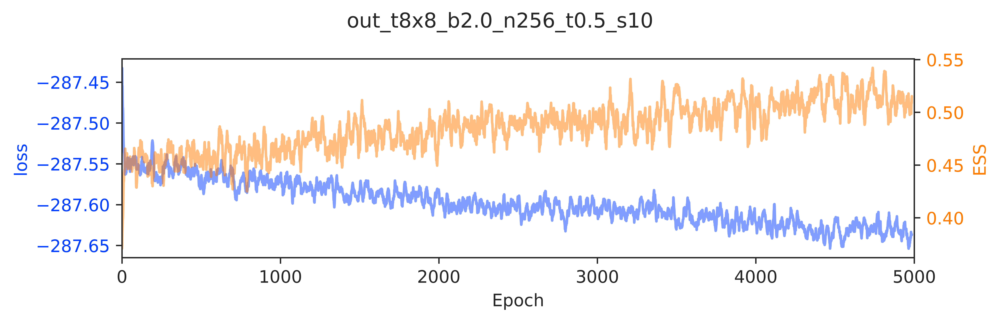

In [18]:
train_config.n_era = 50

outputs = train(param, train_config, model=pre_flow_model,
                logger=logger, figsize=(8, 2.5), use_alt=False)

pre_flow_model = outputs['model']
pre_flow_history = outputs['history']
flow_act = outputs['action']

### Evaluate trained model and calculate topological susceptibility $\chi_{\mathcal{Q}}$

In [10]:
from train import generate_ensemble

outputs = generate_ensemble(pre_flow_model, flow_act, logger=logger)
u1_ens = outputs['ensemble']

pre_flow = pre_flow_model['layers']

[18:24:44]  accept_rate=0.484375

            top_susceptibility=1.11081 +/- 0.07469

### Save `model.state_dict()` to `./pre_flow_model/pre_flow_model_layers.pt`:

In [11]:
#model_dir = os.path.join(os.getcwd(), 'pre_flow_model') 
model_dir = os.path.join(param_dir, 'pre_flow_model')
if not os.path.isdir(model_dir):
    os.makedirs(model_dir)

layers_file = os.path.join(model_dir, 'pre_flow_model_layers.pt')
logger.log(f'saving `pre_flow_model` to: {layers_file}.')
torch.save(pre_flow_model['layers'].state_dict(), layers_file)

[18:26:57]  saving `pre_flow_model` to: /lus/grand/projects/DLHMC/nftqcd/fthmc/flow_test_sam/notebooks/outputs/2021-05-23/out_t8x8_b2.0_n256_t0.5_s10/pre_flow_model/pre_flow_model_layers.pt.

In [12]:
train_force = False
flow_model = None

if train_force:
    flow_model, flow_act = flow_train(param, with_force=True, pre_model=pre_flow_model)
else:
    flow_model = pre_flow_model
    
u1_ens = generate_ensemble(flow_model, flow_act, logger=logger)
flow = flow_model['layers']
# flow.eval()

[18:28:25]  accept_rate=0.5146484375

            top_susceptibility=1.37350 +/- 0.08801

TrainConfig(n_era=20, n_epoch=100, n_layers=32, n_s_nets=2, hidden_sizes=[8, 8], kernel_size=3, base_lr=0.001, batch_size=1024, print_freq=10, plot_freq=50, with_force=True)

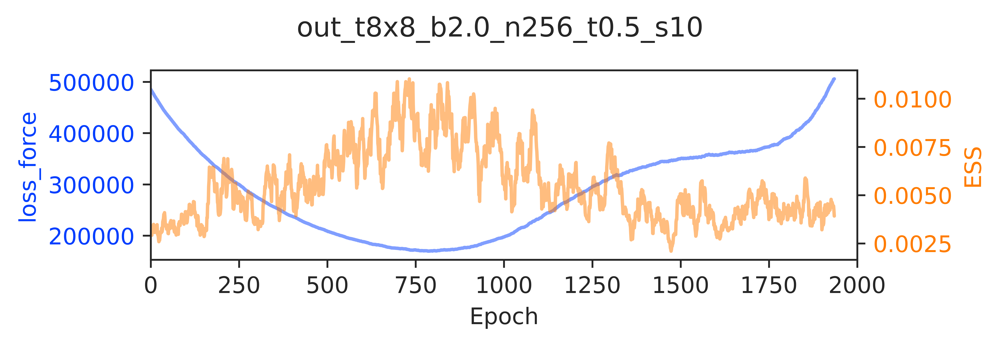

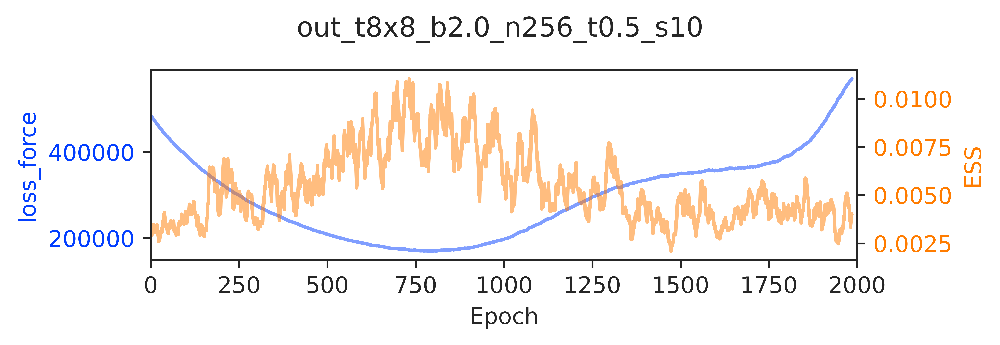

[18:29:04]  -------------------------------------------------------------------------------------------------------------- ERA=1, last took: 0 min 0 s                                                                                                          
            --------------------------------------------------------------------------------------------------------------

[18:30:36]  era=1     epoch=98    dt=0.8956 ess=0.00335943 loss=401213 loss_force=401213 force=nan   force_norm=633.411 dkl=-324.577 logp=87.7631 logq=-236.814 force_size=401213

[18:30:37]  ------------------------------------------------------------------------------------------------------------ ERA=2, last took: 1 min 33.22 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:32:09]  era=2     epoch=98    dt=0.8959 ess=0.00349534 loss=333020 loss_force=333020 force=nan   force_norm=577.079 dkl=-320.829 logp=87.6782 logq=-233.151 force_size=333020

[18:32:11]  ------------------------------------------------------------------------------------------------------------ ERA=3, last took: 1 min 33.31 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:33:42]  era=3     epoch=98    dt=0.8938 ess=0.0032088 loss=280004 loss_force=280004 force=nan   force_norm=529.152 dkl=-317.578 logp=87.8007 logq=-229.777 force_size=280004

[18:33:44]  ------------------------------------------------------------------------------------------------------------ ERA=4, last took: 1 min 33.22 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:35:16]  era=4     epoch=98    dt=0.8972 ess=0.00745215 loss=240241 loss_force=240241 force=nan   force_norm=490.142 dkl=-314.432 logp=87.7513 logq=-226.681 force_size=240241

[18:35:18]  ------------------------------------------------------------------------------------------------------------ ERA=5, last took: 1 min 33.62 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:36:50]  era=5     epoch=98    dt=0.8992 ess=0.0056107 loss=210871 loss_force=210871 force=nan   force_norm=459.201 dkl=-311.62 logp=87.8525 logq=-223.768 force_size=210871

[18:36:52]  ------------------------------------------------------------------------------------------------------------ ERA=6, last took: 1 min 34.22 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:38:24]  era=6     epoch=98    dt=0.8964 ess=0.00326829 loss=190452 loss_force=190452 force=nan   force_norm=436.407 dkl=-308.921 logp=87.7695 logq=-221.151 force_size=190452

[18:38:26]  ------------------------------------------------------------------------------------------------------------ ERA=7, last took: 1 min 33.92 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:39:58]  era=7     epoch=98    dt=0.8964 ess=0.00888684 loss=175822 loss_force=175822 force=nan   force_norm=419.31 dkl=-306.618 logp=87.814 logq=-218.804 force_size=175822

[18:39:59]  ------------------------------------------------------------------------------------------------------------ ERA=8, last took: 1 min 33.66 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:41:32]  era=8     epoch=98    dt=0.9176 ess=0.00847004 loss=168355 loss_force=168355 force=nan   force_norm=410.3 dkl=-304.989 logp=88.1841 logq=-216.805 force_size=168355

[18:41:34]  ------------------------------------------------------------------------------------------------------------ ERA=9, last took: 1 min 34.21 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:43:09]  era=9     epoch=98    dt=0.9169 ess=0.00808261 loss=176466 loss_force=176466 force=nan   force_norm=420.071 dkl=-303.431 logp=87.7297 logq=-215.702 force_size=176466

[18:43:10]  ------------------------------------------------------------------------------------------------------------ ERA=10, last took: 1 min 36.7 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:44:45]  era=10    epoch=98    dt=0.9144 ess=0.0073807 loss=195029 loss_force=195029 force=nan   force_norm=441.615 dkl=-303.182 logp=87.7764 logq=-215.405 force_size=195029

[18:44:47]  ------------------------------------------------------------------------------------------------------------ ERA=11, last took: 1 min 36.36 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:46:20]  era=11    epoch=98    dt=0.9075 ess=0.00711549 loss=229447 loss_force=229447 force=nan   force_norm=478.996 dkl=-303.926 logp=87.9128 logq=-216.014 force_size=229447

[18:46:22]  ------------------------------------------------------------------------------------------------------------ ERA=12, last took: 1 min 35.39 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:47:56]  era=12    epoch=98    dt=0.9106 ess=0.00739222 loss=273087 loss_force=273087 force=nan   force_norm=522.574 dkl=-305.364 logp=87.8563 logq=-217.507 force_size=273087

[18:47:58]  ------------------------------------------------------------------------------------------------------------ ERA=13, last took: 1 min 35.73 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:49:33]  era=13    epoch=98    dt=0.919 ess=0.00423268 loss=305763 loss_force=305763 force=nan   force_norm=552.943 dkl=-306.897 logp=87.9861 logq=-218.911 force_size=305763

[18:49:35]  ------------------------------------------------------------------------------------------------------------ ERA=14, last took: 1 min 36.81 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:51:09]  era=14    epoch=98    dt=0.9227 ess=0.00552192 loss=333661 loss_force=333661 force=nan   force_norm=577.63 dkl=-308.039 logp=87.8127 logq=-220.226 force_size=333661

[18:51:11]  ------------------------------------------------------------------------------------------------------------ ERA=15, last took: 1 min 36.46 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:52:46]  era=15    epoch=98    dt=0.9177 ess=0.00232659 loss=348662 loss_force=348662 force=nan   force_norm=590.474 dkl=-308.928 logp=87.8436 logq=-221.084 force_size=348662

[18:52:48]  ------------------------------------------------------------------------------------------------------------ ERA=16, last took: 1 min 36.73 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:54:22]  era=16    epoch=98    dt=0.9168 ess=0.00452757 loss=355097 loss_force=355097 force=nan   force_norm=595.886 dkl=-309.311 logp=87.8591 logq=-221.452 force_size=355097

[18:54:24]  ------------------------------------------------------------------------------------------------------------ ERA=17, last took: 1 min 36.26 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:55:59]  era=17    epoch=98    dt=0.9226 ess=0.00509416 loss=366145 loss_force=366145 force=nan   force_norm=605.085 dkl=-309.514 logp=87.7926 logq=-221.722 force_size=366145

[18:56:01]  ------------------------------------------------------------------------------------------------------------ ERA=18, last took: 1 min 36.94 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:57:37]  era=18    epoch=98    dt=0.9199 ess=0.00323707 loss=387057 loss_force=387057 force=nan   force_norm=622.135 dkl=-309.738 logp=87.7596 logq=-221.978 force_size=387057

[18:57:38]  ------------------------------------------------------------------------------------------------------------ ERA=19, last took: 1 min 37.32 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[18:59:14]  era=19    epoch=98    dt=0.9253 ess=0.00619538 loss=448649 loss_force=448649 force=nan   force_norm=669.805 dkl=-310.526 logp=87.9979 logq=-222.528 force_size=448649

[18:59:15]  ------------------------------------------------------------------------------------------------------------ ERA=20, last took: 1 min 36.99 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[19:00:50]  era=20    epoch=98    dt=0.9163 ess=0.00437774 loss=570865 loss_force=570865 force=nan   force_norm=755.553 dkl=-311.796 logp=87.8643 logq=-223.931 force_size=570865

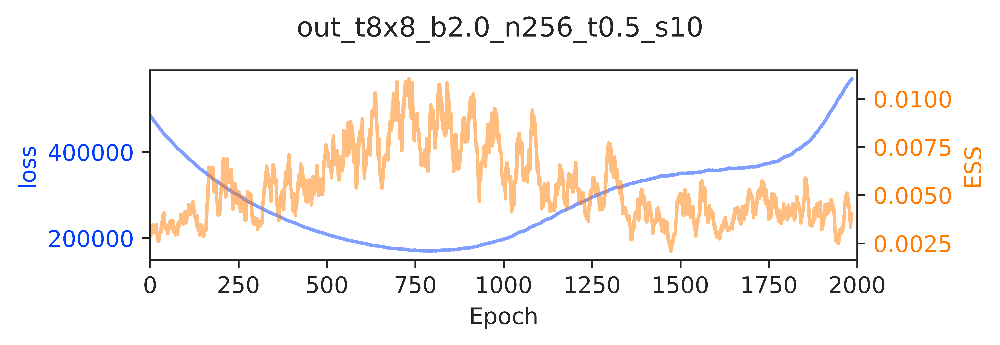

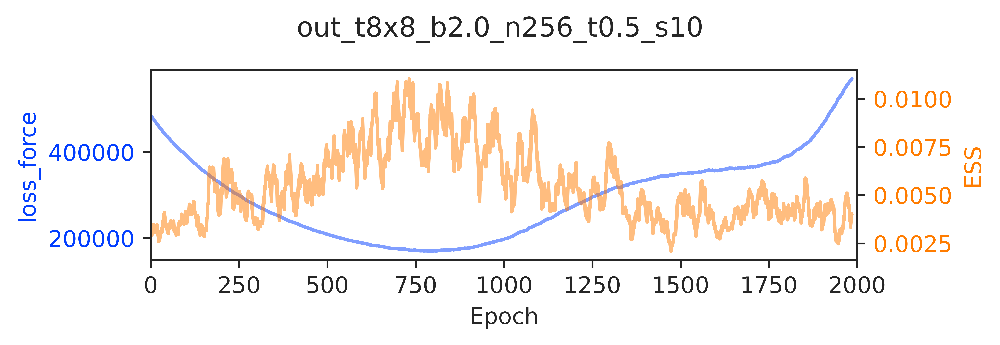

In [13]:
from dataclasses import asdict
from copy import deepcopy
from utils.distributions import MultivariateUniform
from utils.layers import make_u1_equiv_layers, set_weights
from math import pi as PI
import utils.qed_helpers as qed

TWO_PI = 2 * PI
# from train import train

train_cfg_force = asdict(train_config)
train_cfg_force['with_force'] = True

tconfig_force = TrainConfig(**train_cfg_force)

link_shape = (2, *param.lat)
lattice_shape = tuple(param.lat)
u1_action = qed.BatchAction(param.beta)

prior = MultivariateUniform(torch.zeros(link_shape),
                            TWO_PI * torch.ones(link_shape))

tconfig_force
layers = make_u1_equiv_layers(lattice_shape=lattice_shape,
                              n_layers=tconfig_force.n_layers,
                              n_mixture_comps=tconfig_force.n_s_nets,
                              hidden_sizes=tconfig_force.hidden_sizes,
                              kernel_size=tconfig_force.kernel_size)

set_weights(layers)

model_force = {
    'prior': prior,
    'layers': layers,
}
                              

outputs = train(param, tconfig_force,
                model=model_force,
                pre_model=pre_flow_model,
                figsize=(6, 2),
                use_alt=False,
                force_factor=0.001,
                dkl_factor=1.)#, logger=logger)

In [16]:

flow_action_force = outputs['action']

### Save the model trained with force:

In [18]:
model_dir = os.path.join(param_dir, 'flow_model_with_force')
if not os.path.isdir(model_dir):
    os.makedirs(model_dir)
    
layers_file = os.path.join(model_dir, 'flow_model_with_force.pt')

logger.log(f'Saving `flow_model_force` to {layers_file}.')
torch.save(flow_model_force['layers'].state_dict(), layers_file)

[00:22:22]  Saving `flow_model_force` to /lus/grand/projects/DLHMC/nftqcd/fthmc/flow_test_sam/notebooks/outputs/2021-05-20/out_t8x8_b2.0_n256_t0.5_s10/flow_model_with_force/flow_model_with_force.pt.

In [14]:
def test_force(
    param: Param,
    model: dict,
    x: torch.Tensor = None,
    pre_model: dict = None
):
    """Test the force.
    
    If `x` is None:
      - Draw samples `xi (~ pre_prior)` from prior and pass through `pre_model` to get `x (~ pre_posterior)`.
     
    Pass `x` backwards through the `model` to get `xi (~ prior)`.
    
    Calculate `force(xi)` and `norm(force(xi))`.
    """
    if x is None:
        if pre_model is None:
            raise ValueError(f'Either `x` or `pre_model` must be specified.')
            
        # Draw samples `xi` from prior
        pre_xi = pre_model['prior'].sample_n(1)
        
        # Pass `xi` through layers in `pre_model`
        x = qed.ft_flow(pre_model['layers'], pre_xi)
        
    # Pass `x` backwards through layers in `model`
    xi = qed.ft_flow_inv(model['layers'], x)
    # Calculate force
    force = qed.ft_force(param, model['layers'], xi)
    force_norm = torch.linalg.norm(force)
    return force_norm

In [ ]:
from train import run as hmc_run
fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

#metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
#metrics_file = os.path.join(metrics_dir, 'metrics.z')
#io.savez(metrics, metrics_file)

In [20]:
#field_arr = torch.stack(tuple(fields.values()), dim=0)
len(fields)
#
field_arr = np.array([qed.grab(torch.stack(i)) for i in fields])
field_arr.shape
#logger.log(field_arr.shape)

[00:27:12]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=8                                                                                                                                                                                                                                                 
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=10                                                                                                                                                                                                                                           
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[8, 8]                                                                                                                                                                                                                                          
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 8, 8]                                                                                                                      

            plaq=0.02577 charge=-6

[00:27:13]  traj=25    accept=True  dH=0.02238 expdH=0.9779 plaq=0.712 charge=0

            traj=50    accept=True  dH=-0.006142 expdH=1.006 plaq=0.7302 charge=0

            traj=75    accept=True  dH=-0.02999 expdH=1.03  plaq=0.7008 charge=1

            traj=100   accept=True  dH=0.02143 expdH=0.9788 plaq=0.7999 charge=1

            traj=125   accept=True  dH=0.002144 expdH=0.9979 plaq=0.6402 charge=0

            traj=150   accept=True  dH=-0.003754 expdH=1.004 plaq=0.7004 charge=2

            traj=175   accept=True  dH=0.02311 expdH=0.9772 plaq=0.806 charge=0

[00:27:14]  traj=200   accept=True  dH=-0.006874 expdH=1.007 plaq=0.737 charge=0

            traj=225   accept=True  dH=0.01544 expdH=0.9847 plaq=0.7077 charge=0

            traj=250   accept=True  dH=-0.002724 expdH=1.003 plaq=0.6758 charge=2

            traj=281   accept=True  dH=0.0301 expdH=0.9704 plaq=0.7201 charge=0

            traj=306   accept=True  dH=0.06285 expdH=0.9391 plaq=0.7722 charge=-1

            traj=331   accept=True  dH=-0.005051 expdH=1.005 plaq=0.698 charge=-1

            traj=356   accept=True  dH=-0.02401 expdH=1.024 plaq=0.7471 charge=0

[00:27:15]  traj=381   accept=True  dH=0.001808 expdH=0.9982 plaq=0.6633 charge=1

            traj=406   accept=True  dH=-0.04878 expdH=1.05  plaq=0.6028 charge=0

            traj=431   accept=True  dH=0.0112 expdH=0.9889 plaq=0.6822 charge=0

            traj=456   accept=True  dH=-0.01613 expdH=1.016 plaq=0.7525 charge=0

            traj=481   accept=True  dH=0.01603 expdH=0.9841 plaq=0.6838 charge=2

            traj=506   accept=True  dH=0.02086 expdH=0.9794 plaq=0.7071 charge=0

[00:27:16]  traj=537   accept=True  dH=-0.04444 expdH=1.045 plaq=0.6912 charge=0

            traj=562   accept=True  dH=0.01119 expdH=0.9889 plaq=0.6634 charge=-1

            traj=587   accept=True  dH=0.02903 expdH=0.9714 plaq=0.6968 charge=1

            traj=612   accept=True  dH=0.01975 expdH=0.9804 plaq=0.6808 charge=0

            traj=637   accept=True  dH=-0.04513 expdH=1.046 plaq=0.6538 charge=0

            traj=662   accept=True  dH=-0.0161 expdH=1.016 plaq=0.7024 charge=-1

            traj=687   accept=True  dH=0.02775 expdH=0.9726 plaq=0.7526 charge=0

[00:27:17]  traj=712   accept=True  dH=0.07269 expdH=0.9299 plaq=0.7597 charge=0

            traj=737   accept=True  dH=0.009731 expdH=0.9903 plaq=0.7572 charge=-1

            traj=762   accept=True  dH=-0.01193 expdH=1.012 plaq=0.7292 charge=0

            traj=793   accept=True  dH=-0.04589 expdH=1.047 plaq=0.5778 charge=1

            traj=818   accept=True  dH=0.01471 expdH=0.9854 plaq=0.7822 charge=0

            traj=843   accept=True  dH=-0.009083 expdH=1.009 plaq=0.7001 charge=0

            traj=868   accept=True  dH=0.04618 expdH=0.9549 plaq=0.7636 charge=0

[00:27:18]  traj=893   accept=True  dH=0.01839 expdH=0.9818 plaq=0.6878 charge=0

            traj=918   accept=True  dH=0.04348 expdH=0.9575 plaq=0.7707 charge=0

            traj=943   accept=True  dH=-0.01596 expdH=1.016 plaq=0.7119 charge=0

            traj=968   accept=True  dH=-0.01483 expdH=1.015 plaq=0.7262 charge=-1

            traj=993   accept=True  dH=0.005138 expdH=0.9949 plaq=0.6555 charge=0

            traj=1018  accept=True  dH=0.01369 expdH=0.9864 plaq=0.6807 charge=-1

[00:27:19]  traj=1049  accept=True  dH=-0.01655 expdH=1.017 plaq=0.6933 charge=0

            traj=1074  accept=True  dH=0.02234 expdH=0.9779 plaq=0.7359 charge=2

            traj=1099  accept=True  dH=0.03968 expdH=0.9611 plaq=0.7626 charge=0

            traj=1124  accept=True  dH=-0.002575 expdH=1.003 plaq=0.6568 charge=1

            traj=1149  accept=True  dH=0.01077 expdH=0.9893 plaq=0.7347 charge=0

            traj=1174  accept=True  dH=-0.01872 expdH=1.019 plaq=0.7041 charge=0

            traj=1199  accept=True  dH=-0.005692 expdH=1.006 plaq=0.7235 charge=2

[00:27:20]  traj=1224  accept=True  dH=0.02734 expdH=0.973 plaq=0.7731 charge=0

            traj=1249  accept=True  dH=-0.04397 expdH=1.045 plaq=0.6193 charge=1

            traj=1274  accept=True  dH=0.001709 expdH=0.9983 plaq=0.6003 charge=4

            traj=1305  accept=True  dH=-0.001263 expdH=1.001 plaq=0.6892 charge=-1

            traj=1330  accept=True  dH=-0.01256 expdH=1.013 plaq=0.7316 charge=1

            traj=1355  accept=True  dH=0.01521 expdH=0.9849 plaq=0.7727 charge=1

            traj=1380  accept=True  dH=-0.02228 expdH=1.023 plaq=0.7139 charge=0

[00:27:21]  traj=1405  accept=False dH=0.03384 expdH=0.9667 plaq=0.57  charge=0

            traj=1430  accept=True  dH=-0.04456 expdH=1.046 plaq=0.6903 charge=0

            traj=1455  accept=True  dH=-0.03785 expdH=1.039 plaq=0.6555 charge=-2

            traj=1480  accept=True  dH=-0.006409 expdH=1.006 plaq=0.7028 charge=0

            traj=1505  accept=True  dH=0.01485 expdH=0.9853 plaq=0.6967 charge=1

            traj=1530  accept=True  dH=-0.06261 expdH=1.065 plaq=0.645 charge=0

            traj=1561  accept=True  dH=-0.02994 expdH=1.03  plaq=0.6236 charge=-1

[00:27:22]  traj=1586  accept=True  dH=-0.01577 expdH=1.016 plaq=0.6665 charge=0

            traj=1611  accept=True  dH=0.01127 expdH=0.9888 plaq=0.8285 charge=0

            traj=1636  accept=True  dH=-0.01576 expdH=1.016 plaq=0.6295 charge=0

            traj=1661  accept=True  dH=0.01592 expdH=0.9842 plaq=0.719 charge=0

            traj=1686  accept=True  dH=-0.04325 expdH=1.044 plaq=0.6568 charge=0

            traj=1711  accept=True  dH=-0.0149 expdH=1.015 plaq=0.7125 charge=0

[00:27:23]  traj=1736  accept=True  dH=-0.0237 expdH=1.024 plaq=0.626 charge=0

            traj=1761  accept=True  dH=0.02467 expdH=0.9756 plaq=0.7116 charge=0

            traj=1786  accept=True  dH=0.008293 expdH=0.9917 plaq=0.6835 charge=0

            traj=1817  accept=True  dH=0.02418 expdH=0.9761 plaq=0.7714 charge=0

            traj=1842  accept=True  dH=0.04556 expdH=0.9555 plaq=0.6534 charge=2

            traj=1867  accept=True  dH=0.0007095 expdH=0.9993 plaq=0.715 charge=0

            traj=1892  accept=True  dH=0.01425 expdH=0.9858 plaq=0.7847 charge=0

[00:27:24]  traj=1917  accept=True  dH=-0.01152 expdH=1.012 plaq=0.6815 charge=1

            traj=1942  accept=True  dH=-0.008354 expdH=1.008 plaq=0.6108 charge=0

            traj=1967  accept=True  dH=0.008789 expdH=0.9912 plaq=0.806 charge=1

            traj=1992  accept=True  dH=-0.01553 expdH=1.016 plaq=0.6196 charge=0

            traj=2017  accept=True  dH=-0.0007858 expdH=1.001 plaq=0.6725 charge=-1

            traj=2042  accept=True  dH=0.038 expdH=0.9627 plaq=0.6907 charge=0

            traj=2073  accept=True  dH=0.0108 expdH=0.9893 plaq=0.6921 charge=-1

[00:27:25]  traj=2098  accept=True  dH=-0.0003662 expdH=1     plaq=0.6588 charge=-1

            traj=2123  accept=True  dH=0.01355 expdH=0.9865 plaq=0.7042 charge=0

            traj=2148  accept=True  dH=-0.01855 expdH=1.019 plaq=0.7427 charge=1

            traj=2173  accept=True  dH=-0.02613 expdH=1.026 plaq=0.645 charge=1

            traj=2198  accept=True  dH=-0.002518 expdH=1.003 plaq=0.6663 charge=-1

            traj=2223  accept=True  dH=-0.08554 expdH=1.089 plaq=0.6467 charge=0

            traj=2248  accept=True  dH=0.004189 expdH=0.9958 plaq=0.767 charge=0

[00:27:26]  traj=2273  accept=True  dH=0.03452 expdH=0.9661 plaq=0.7053 charge=-2

            traj=2298  accept=True  dH=-0.04983 expdH=1.051 plaq=0.6789 charge=0

            traj=2329  accept=True  dH=0.01799 expdH=0.9822 plaq=0.7151 charge=0

            traj=2354  accept=True  dH=-0.02979 expdH=1.03  plaq=0.6646 charge=0

            traj=2379  accept=True  dH=-0.009224 expdH=1.009 plaq=0.5919 charge=0

            traj=2404  accept=True  dH=-0.01597 expdH=1.016 plaq=0.6538 charge=1

[00:27:27]  traj=2429  accept=True  dH=0.02452 expdH=0.9758 plaq=0.6239 charge=0

            traj=2454  accept=True  dH=-0.03043 expdH=1.031 plaq=0.666 charge=0

            traj=2479  accept=True  dH=0.01868 expdH=0.9815 plaq=0.733 charge=0

            traj=2504  accept=True  dH=0.02826 expdH=0.9721 plaq=0.7303 charge=0

            traj=2529  accept=True  dH=0.05861 expdH=0.9431 plaq=0.7218 charge=-1

            traj=2554  accept=True  dH=0.0006104 expdH=0.9994 plaq=0.7098 charge=0

            Run times: [1.501720905303955, 1.491001844406128, 1.4876937866210938, 1.4856877326965332, 1.4809556007385254, 1.4851329326629639, 1.4952983856201172, 1.4888420104980469, 1.4872183799743652, 1.4858126640319824]

            Per trajectory: [0.0058660972863435745, 0.005824225954711437, 0.0058113038539886475, 0.005803467705845833, 0.005784982815384865, 0.005801300518214703, 0.005841009318828583, 0.005815789103507996, 0.005809446796774864, 0.005803955718874931]

In [26]:
#test_force(n=1)

for field in field_arr:
    force_tf = test_force(param, flow_model_force, pre_model=pre_flow_model)
    logger.log(f'ft_flow(players, pxi), (pxi ~ pre_prior): {force_tf:.5g}') 
    
    x = torch.from_numpy(field[-1]).squeeze()[None, :]
    if torch.cuda.is_available():
        x = x.cuda()
    
    #x_ = field_arr.squeeze()[None, :]
    force_ = test_force(param, flow_model_force, x=x, pre_model=pre_flow_model)
    logger.log(f'ft_flow(layers, field_arr), (pxi ~ pre_prior): {force_:.5g}')

[00:48:23]  ft_flow(players, pxi), (pxi ~ pre_prior): 20.568

[00:48:24]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 17.727

            ft_flow(players, pxi), (pxi ~ pre_prior): 14.369

[00:48:25]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 24.091

            ft_flow(players, pxi), (pxi ~ pre_prior): 15.946

[00:48:26]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 20.066

            ft_flow(players, pxi), (pxi ~ pre_prior): 15.788

[00:48:27]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 15.237

            ft_flow(players, pxi), (pxi ~ pre_prior): 17.965

[00:48:28]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 19.665

            ft_flow(players, pxi), (pxi ~ pre_prior): 22.738

[00:48:29]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 16.076

[00:48:30]  ft_flow(players, pxi), (pxi ~ pre_prior): 14.943

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 17.436

[00:48:31]  ft_flow(players, pxi), (pxi ~ pre_prior): 22.914

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 14.421

[00:48:32]  ft_flow(players, pxi), (pxi ~ pre_prior): 17.445

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 16.944

[00:48:33]  ft_flow(players, pxi), (pxi ~ pre_prior): 20.767

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 13.648

In [30]:
for idx, fields in enumerate(field_arr):
    x = torch.from_numpy(fields)
    if torch.cuda.is_available():
        x = x.cuda()
        
    force1 = test_force(param, flow_model_force, x=x)
    force2 = test_force(param, flow_model_force, pre_model=pre_flow_model)
    
    logger.log(f'run={idx}, force1={force1:.5g}, force2={force2:.5g}')

[00:52:22]  run=0, force1=296.02, force2=22.105

[00:52:23]  run=1, force1=286.49, force2=17.375

[00:52:24]  run=2, force1=288.85, force2=16.247

[00:52:25]  run=3, force1=296.97, force2=19.785

[00:52:27]  run=4, force1=289.02, force2=18.44

[00:52:28]  run=5, force1=285.54, force2=18.816

[00:52:29]  run=6, force1=290.41, force2=18.414

[00:52:30]  run=7, force1=303.58, force2=17.69

[00:52:31]  run=8, force1=293.65, force2=14.929

[00:52:32]  run=9, force1=296.93, force2=20.921

In [31]:
# shape = (run, ntraj, d, L, L)
field_arr.shape

(10, 256, 2, 8, 8)

In [33]:
#field_run = torch.stack(tuple(fields.values()), dim=0)
##flows = flow

#x0 = field_arr[0][None, :]
#x = field_arr[0][None, :]

# select last trajectory from last run
x = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()
x0 = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()

if torch.cuda.is_available():
    x = x.cuda()

plaq0 = qed.action(param, x) / (-param.beta * param.volume)
logger.log(f'plaq(field_arr[0])={plaq0:.8g}')

#logger\.log(f'plaq(field_run[0]) {qed.action(param, x) / (-param.beta*param.volume)}')
# field.requires_grad_(True)
#x = field_run[0][None, :]
logJ = 0.0
for layer in reversed(flow_model_force['layers']):
    x, lJ = layer.reverse(x)
    logJ += lJ

# x is the prior distribution now
    
x.requires_grad_(True)
    
y = x
logJy = 0.0
for layer in flow_model_force['layers']:
    y, lJ = layer.forward(y)
    logJy += lJ
    
s = qed.action(param, y[0][None, :]) - logJy

logger.log(f'sum(logJ): {qed.grab(logJ.sum())}')
logger.log(f'sum(logJy): {qed.grab(logJy.sum())}')
#print(logJ,logJy)


# print("eff_action", s + 136.3786)

logger.log(f'original_action: {qed.action(param, y[0][None, :]) + 91}')
#print("original_action", qed.action(param, y[0][None, :]) + 91)

logger.log(f'eff_action: {s + 56}')
#print("eff_action", {s + 56)

s.backward()

f = x.grad

x.requires_grad_(False)

logger.log(f'plaq(x) {qed.action(param, x[0][None, :]) / (-param.beta*param.volume)}  logJ {qed.grab(logJ)}  force.norm {torch.linalg.norm(f)}')
logger.log(f'plaq(y) {qed.action(param, y[0][None, :]) / (-param.beta*param.volume)}')
logger.log(f'plaq(x) {qed.action(param, x0) / (-param.beta*param.volume)}  force.norm {torch.linalg.norm(qed.force(param, x0))}')

[01:05:45]  plaq(field_arr[0])=0.73565966

tensor([[[[5.9803, 5.2700, 2.7586, 3.7062, 0.1874, 2.7719, 0.2222, 4.7606],
          [3.3360, 1.8504, 4.1443, 5.0181, 6.0518, 5.0757, 2.9505, 3.6513],
          [5.4694, 2.4797, 5.4659, 4.5167, 6.0812, 1.1587, 5.6991, 4.1748],
          [3.1747, 4.2500, 3.2662, 5.4497, 5.3151, 3.6379, 3.7296, 3.6192],
          [4.9977, 4.2010, 4.4440, 3.0088, 1.0392, 0.3640, 5.8715, 5.0182],
          [4.6357, 5.6912, 2.8706, 3.2895, 2.8231, 1.7462, 5.2491, 3.4832],
          [4.4074, 1.2051, 5.5403, 5.0150, 0.6768, 6.2666, 5.7877, 6.0864],
          [0.0522, 0.4349, 1.4810, 6.1341, 2.7839, 5.9052, 0.7234, 4.2556]],

         [[2.1357, 4.4225, 2.3640, 5.7523, 3.8200, 5.5798, 0.0968, 1.4850],
          [1.9809, 3.1584, 4.5811, 3.7011, 5.7174, 6.1599, 5.5838, 6.1813],
          [3.6105, 2.4116, 3.0163, 1.8930, 0.2716, 2.8538, 2.5645, 5.2939],
          [1.9258, 1.8789, 3.1401, 5.6173, 3.6310, 2.0999, 2.5761, 4.0910],
          [1.6526, 1.3461, 5.5857, 3.3637, 0.1340, 0.5871, 0.2537, 4.6859],
          

[01:05:46]  sum(logJ): 10.329693794250488

            sum(logJy): -10.329699516296387

            original_action: -3.1644668579101562

            eff_action: tensor([-27.8348], grad_fn=<AddBackward0>)

tensor([[[[5.9803, 5.2700, 2.7586, 3.7062, 0.1874, 2.7719, 0.2222, 4.7606],
          [3.3360, 1.8504, 4.1443, 5.0181, 6.0518, 5.0757, 2.9505, 3.6513],
          [5.4694, 2.4797, 5.4659, 4.5167, 6.0812, 1.1587, 5.6991, 4.1748],
          [3.1747, 4.2500, 3.2662, 5.4497, 5.3151, 3.6379, 3.7296, 3.6192],
          [4.9977, 4.2010, 4.4440, 3.0088, 1.0392, 0.3640, 5.8715, 5.0182],
          [4.6357, 5.6912, 2.8706, 3.2895, 2.8231, 1.7462, 5.2491, 3.4832],
          [4.4074, 1.2051, 5.5403, 5.0150, 0.6768, 6.2666, 5.7877, 6.0864],
          [0.0522, 0.4349, 1.4810, 6.1341, 2.7839, 5.9052, 0.7234, 4.2556]],

         [[2.1357, 4.4225, 2.3640, 5.7523, 3.8200, 5.5798, 0.0968, 1.4850],
          [1.9809, 3.1584, 4.5811, 3.7011, 5.7174, 6.1599, 5.5838, 6.1813],
          [3.6105, 2.4116, 3.0163, 1.8930, 0.2716, 2.8538, 2.5645, 5.2939],
          [1.9258, 1.8789, 3.1401, 5.6173, 3.6310, 2.0999, 2.5761, 4.0910],
          [1.6526, 1.3461, 5.5857, 3.3637, 0.1340, 0.5871, 0.2537, 4.6859],
          

            plaq(x) -0.3064742088317871  logJ [10.329694]  force.norm 13.64773178100586

            plaq(y) 0.7356598973274231

            plaq(x) 0.735659658908844  force.norm 17.191539764404297

In [34]:
logger.log(x.shape)

field_tensor = torch.from_numpy(field_arr).cuda()

x = qed.ft_flow_inv(flow, field_tensor[-1])
# x = field_run
#for layer in reversed(flows):
#    x, lJ = layer.reverse(x)
ff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(ff))
fff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(fff))

[01:05:52]  torch.Size([1, 2, 8, 8])

[01:05:53]  tensor(458.8434)

            tensor(458.8434)

In [35]:
x = qed.ft_flow_inv(flow, field_tensor[-1])
logger.log(qed.grab(qed.ft_action(param, flow, x)))

[01:06:00]  [-52.34132  -54.984406 -52.69398  -55.85245  -53.324394 -51.698933                                                                                                                                                                                  
             -52.9431   -53.564766 -51.225555 -51.717754 -54.336918 -51.692036                                                                                                                                                                                  
             -52.921745 -53.177845 -53.068645 -53.881165 -53.305065 -52.889664                                                                                                                                                                                  
             -54.119648 -54.306328 -52.49801  -53.289936 -52.017433 -53.252487                                                                                                                                                                                  
             -51.583187 -50.890724 -53.81036  -51.380806 -51.53077  -52.459133                                                                                                                                                                                  
             -52.94866  -55.43657  -53.323483 -54.64234  -52.20516  -52.244797                                                                                                                                                                                  
             -52.38782  -56.000237 -56.257492 -54.48066  -55.071095 -52.882267                                                                                                                                                                                  
             -52.057796 -51.925335 -53.61525  -53.788853 -53.684235 -53.116394                                                                                                                                                                                  
             -53.339306 -52.478348 -54.82332  -53.38263  -53.68531  -52.518494                                                                                                                                                                                  
             -53.356026 -53.41789  -53.233078 -52.100388 -52.409615 -52.5497                                                                                                                                                                                    
             -55.151527 -53.319096 -53.334908 -51.83166  -51.55291  -52.3438                                                                                                                                                                                    
             -53.160275 -52.1521   -51.795506 -52.784935 -55.30269  -54.758957                                                                                                                                                                                  
             -53.594208 -54.544434 -55.502914 -52.84363  -53.379135 -51.47196                                                                                                                                                                                   
             -53.00528  -52.955776 -53.64435  -52.235146 -51.92722  -50.92581                                                                                                                                                                                   
             -52.502953 -54.02014  -53.385994 -52.16308  -52.16308  -53.279526                                                                                                                                                                                  
             -53.279526 -52.45228  -52.677425 -52.13311  -52.603817 -52.906654                                                                   

In [36]:
def flattern(l):
    return [x for y in l for x in y]

def average(l):
    return sum(l) / len(l)

def sub_avg(l):
    avg = average(l)
    return np.array([x - avg for x in l])

In [37]:
#ft_hmc_info_list = []
ft_hmc_info = {
    'force_norm_rms': [],
    'ft_action_init': [],
    'ft_action_end': [],
    'momentum_norm_end': [],
}

def ft_leapfrog(param, flow, x, p):
    mom_norm = torch.sum(p*p)
    info_list = []
    dt = param.dt
    x_ = x + 0.5*dt*p
    f = qed.ft_force(param, flow, x_)
    p_ = p + (-dt)*f
    info = {
        'force_norm': [torch.linalg.norm(f).cpu().detach().numpy()],
        'ft_action': [qed.ft_action(param, flow, x_).cpu().detach().numpy()],
        'momentum_norm': [(torch.sum(p * p_) / torch.sqrt(mom_norm * torch.sum(p_ * p_))).cpu().detach().numpy()],
    }
    
    #info_list.append(info)
    for i in range(param.nstep-1):
        x_ = x_ + dt*p_
        f = qed.ft_force(param, flow, x_)
        info_ = {
            'force_norm': torch.linalg.norm(f).cpu().detach().numpy(),
            'ft_action': qed.ft_action(param, flow, x_).cpu().detach().numpy(),
            'momentum_norm': (torch.sum(p * p_) / torch.sqrt(mom_norm * torch.sum(p_ * p_))).cpu().detach().numpy(),
        }
        for key, val in info_.items():
            info[key].append(val)
            
        #info = np.array([torch.linalg.norm(f),
        #     qed.ft_action(param, flow, x_),
        #     torch.sum(p * p_) / torch.sqrt(mom_norm * torch.sum(p_ * p_))])
        
        p_ = p_ + (-dt)*f
    x_ = x_ + 0.5*dt*p_
    
    force_norm_arr = np.array(info['force_norm'])
    
    info_ = {
        'force_norm_rms': np.sqrt(average(force_norm_arr ** 2)),
        'ft_action_init': info['ft_action'][0],
        'ft_action_end': info['ft_action'][-1],
        'momentum_norm_end': info['momentum_norm'][-1],
    }
    
    logger.print_metrics(info_)
    for key, val in info_.items():
        ft_hmc_info[key].append(val)
        
    #info_ = [
    #    np.sqrt(average(info['force_norm'] ** 2)),
    #    (info['ft_action'][0], info['ft_action'][-1]),
    #    info['momentum_norm'][-1],
    #]
    #info_ = [
    #    np.sqrt(average([l[0] ** 2 for l in info_list])),
    #    (info_list[0][1], info_list[-1][1]),
    #    info_list[-1][2]
    #]
    #put(', '.join([f'{i}' for i in info_]))
        
    #ft_hmc_info_list.append(info_list)
    return (x_, p_)

def ft_hmc(param, flow, field):
    x = qed.ft_flow_inv(flow, field)
    p = torch.randn_like(x)
    act0 = qed.ft_action(param, flow, x).cpu() + 0.5*torch.sum(p*p).cpu()
    x_, p_ = ft_leapfrog(param, flow, x, p)
    xr = qed.regularize(x_)
    act = qed.ft_action(param, flow, xr).cpu() + 0.5*torch.sum(p_*p_).cpu()
    prob = torch.rand([], dtype=torch.float64).cpu()
    dH = act - act0
    exp_mdH = torch.exp(-dH)
    acc = prob < exp_mdH
    # ADJUST ME
    newx = xr if acc else x
    # newx = xr
    newfield = qed.ft_flow(flow, newx)
    return (float(dH), float(exp_mdH), acc, newfield)

In [40]:
def ft_run(param, flow, field = None):
    if field is None:
        field = param.initializer()
        
    ft_hmc_info_list = []
    with open(param.uniquestr(), "w") as f:
        #params = param.summary()
        f.write(repr(param))
        logger.log(repr(param))
        #put(params)
        plaq = qed.action(param, torch.squeeze(field)) / (-param.beta*param.volume)
        topo = qed.topo_charge(torch.squeeze(field)[None, :])
        #plaq, topo = (qed.action(param, field[None, :]) / (-param.beta*param.volume), qed.topo_charge(field[None, :]))
        status = f"Initial configuration:  plaq: {plaq}  topo: {topo}\n"
        f.write(status)
        logger.log(status)
        ts = []
        for n in range(param.nrun):
            t = -timer()
            for i in range(param.ntraj):
                #field_run = torch.reshape(field,(1,)+field.shape)
#                 
                dH, exp_mdH, acc, field = ft_hmc(param, flow, torch.squeeze(field)[None, :])
                plaq = qed.action(param, field) / (-param.beta*param.volume)
                topo = qed.topo_charge(torch.squeeze(field)[None, :])
                ifacc = "ACCEPT" if acc else "REJECT"
                metrics = {
                    'traj': n * param.ntraj + i + 1 + 4,
                    'accept': acc,
                    'dH': dH,
                    'expdH': exp_mdH,
                    'plaq': plaq,
                    'topo': topo,
                }
                #status = {
                #    'traj': f'{n * param.ntraj+i+1:4}',
                #    'accept': f'{qed.grab(acc)[0]}',
                #    'dH': f'{dH:< 12.8}',
                #    'expdH': f'{exp_mdH:< 12.8}',
                #    'plaq': f'{plaq:< 12.8}',
                #    'topo': f'{qed.grab(topo)[0]:< 3.3}',
                #}
                #status = io.print_metrics(status)
                #outstr = ', '.join(
                #    '='.join((k, v)) for k, v in status.items()
                #)
                #f.write(status + '\n')
                
                if (i + 1) % (param.ntraj // param.nprint) == 0:
                    outstr = io.print_metrics(metrics)
                    f.write(outstr + '\n')
                    
            t += timer()
            ts.append(t)
        print("Run times: ", ts)
        print("Per trajectory: ", [t/param.ntraj for t in ts])
    return field

## Run field transformation (with force) using `pre_flow_model`


In [47]:
param.nprint = 256

field_ = ft_run(param, pre_flow_model['layers'], field=field_tensor[-1][-1])#, torch.stack(tuple(field.values()), dim=0).squeeze())

[01:08:07]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=8                                                                                                                                                                                                                                                 
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=256                                                                                                                                                                                                                                          
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[8, 8]                                                                                                                                                                                                                                          
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 8, 8]                                                                                                                      

            Initial configuration:  plaq: 0.735659658908844  topo: tensor([1.0000])

[01:08:09]  force_norm_rms=13.94 ft_action_init=-53.77 ft_action_end=-50.67 momentum_norm_end=0.9796

[01:08:10]  traj=5     accept=0     dH=0.75  expdH=0.4724 plaq=0.7357 topo=1

[01:08:12]  force_norm_rms=20.52 ft_action_init=-53.99 ft_action_end=-53.06 momentum_norm_end=0.9416

[01:08:13]  traj=6     accept=0     dH=1.664 expdH=0.1894 plaq=0.7357 topo=1

[01:08:15]  force_norm_rms=14.19 ft_action_init=-54   ft_action_end=-53.99 momentum_norm_end=0.9703

[01:08:15]  traj=7     accept=1     dH=0.2994 expdH=0.7413 plaq=0.7627 topo=-1

[01:08:17]  force_norm_rms=15.18 ft_action_init=-53.73 ft_action_end=-52.9 momentum_norm_end=0.9616

[01:08:18]  traj=8     accept=1     dH=-0.6866 expdH=1.987 plaq=0.7384 topo=1

[01:08:20]  force_norm_rms=16.03 ft_action_init=-53.12 ft_action_end=-52.88 momentum_norm_end=0.9813

[01:08:20]  traj=9     accept=1     dH=-0.815 expdH=2.259 plaq=0.741 topo=-1

[01:08:23]  force_norm_rms=29.8  ft_action_init=-52.91 ft_action_end=-54.23 momentum_norm_end=0.9184

[01:08:23]  traj=10    accept=0     dH=2.637 expdH=0.0716 plaq=0.741 topo=-1

[01:08:25]  force_norm_rms=15.08 ft_action_init=-52.82 ft_action_end=-54.46 momentum_norm_end=0.9591

[01:08:25]  traj=11    accept=1     dH=-0.08551 expdH=1.089 plaq=0.7025 topo=-2.277e-07

[01:08:28]  force_norm_rms=17.88 ft_action_init=-54.11 ft_action_end=-51.46 momentum_norm_end=0.9771

[01:08:28]  traj=12    accept=0     dH=7.082 expdH=0.00084 plaq=0.7025 topo=7.589e-08

[01:08:30]  force_norm_rms=20.04 ft_action_init=-54.28 ft_action_end=-53.13 momentum_norm_end=0.964

[01:08:30]  traj=13    accept=0     dH=3.538 expdH=0.02908 plaq=0.7025 topo=-1.518e-07

[01:08:33]  force_norm_rms=16.96 ft_action_init=-54.31 ft_action_end=-54.84 momentum_norm_end=0.9803

[01:08:33]  traj=14    accept=0     dH=0.457 expdH=0.6332 plaq=0.7025 topo=2.277e-07

[01:08:35]  force_norm_rms=61.62 ft_action_init=-54.01 ft_action_end=-53.5 momentum_norm_end=0.7172

[01:08:35]  traj=15    accept=0     dH=50.39 expdH=1.302e-22 plaq=0.7025 topo=-7.589e-07

[01:08:38]  force_norm_rms=14.56 ft_action_init=-53.91 ft_action_end=-54.47 momentum_norm_end=0.961

[01:08:38]  traj=16    accept=1     dH=-0.4869 expdH=1.627 plaq=0.6806 topo=2

[01:08:40]  force_norm_rms=51.77 ft_action_init=-53.62 ft_action_end=-50.88 momentum_norm_end=0.7611

[01:08:41]  traj=17    accept=0     dH=25.24 expdH=1.097e-11 plaq=0.6806 topo=2

[01:08:43]  force_norm_rms=22.12 ft_action_init=-54.88 ft_action_end=-51.19 momentum_norm_end=0.9377

[01:08:43]  traj=18    accept=0     dH=9.9   expdH=5.016e-05 plaq=0.6806 topo=2

[01:08:46]  force_norm_rms=11.29 ft_action_init=-53.9 ft_action_end=-54.46 momentum_norm_end=0.9882

[01:08:46]  traj=19    accept=0     dH=1.937 expdH=0.1441 plaq=0.6806 topo=2

[01:08:48]  force_norm_rms=31.63 ft_action_init=-52.76 ft_action_end=-53.91 momentum_norm_end=0.8995

[01:08:48]  traj=20    accept=0     dH=8.55  expdH=0.0001935 plaq=0.6806 topo=2

[01:08:51]  force_norm_rms=36.31 ft_action_init=-54.39 ft_action_end=-54.24 momentum_norm_end=0.8536

[01:08:51]  traj=21    accept=0     dH=10.92 expdH=1.802e-05 plaq=0.6806 topo=2

[01:08:53]  force_norm_rms=12.24 ft_action_init=-54.16 ft_action_end=-53.55 momentum_norm_end=0.9835

[01:08:53]  traj=22    accept=0     dH=1.899 expdH=0.1497 plaq=0.6806 topo=2

[01:08:56]  force_norm_rms=38.22 ft_action_init=-54.95 ft_action_end=-52.13 momentum_norm_end=0.8334

[01:08:56]  traj=23    accept=0     dH=11.93 expdH=6.581e-06 plaq=0.6806 topo=2

[01:08:58]  force_norm_rms=25.18 ft_action_init=-53.88 ft_action_end=-55.04 momentum_norm_end=0.937

[01:08:58]  traj=24    accept=0     dH=2.551 expdH=0.078 plaq=0.6806 topo=2

[01:09:01]  force_norm_rms=30.44 ft_action_init=-53.94 ft_action_end=-52.74 momentum_norm_end=0.935

[01:09:01]  traj=25    accept=0     dH=5.648 expdH=0.003524 plaq=0.6806 topo=2

[01:09:03]  force_norm_rms=16.28 ft_action_init=-52.97 ft_action_end=-50.97 momentum_norm_end=0.9672

[01:09:03]  traj=26    accept=0     dH=5.142 expdH=0.005847 plaq=0.6805 topo=2

[01:09:06]  force_norm_rms=25.91 ft_action_init=-53.41 ft_action_end=-54.53 momentum_norm_end=0.9628

[01:09:06]  traj=27    accept=0     dH=5.987 expdH=0.002512 plaq=0.6805 topo=2

[01:09:08]  force_norm_rms=20.81 ft_action_init=-55.2 ft_action_end=-52.14 momentum_norm_end=0.9834

[01:09:09]  traj=28    accept=0     dH=9.889 expdH=5.071e-05 plaq=0.6805 topo=2

[01:09:11]  force_norm_rms=22.32 ft_action_init=-53.95 ft_action_end=-52.29 momentum_norm_end=0.9646

[01:09:11]  traj=29    accept=0     dH=3.81  expdH=0.02215 plaq=0.6805 topo=2

[01:09:14]  force_norm_rms=38.91 ft_action_init=-53.74 ft_action_end=-54.61 momentum_norm_end=0.8839

[01:09:14]  traj=30    accept=0     dH=8.048 expdH=0.0003198 plaq=0.6805 topo=2

[01:09:16]  force_norm_rms=23.43 ft_action_init=-53.8 ft_action_end=-53.95 momentum_norm_end=0.9331

[01:09:16]  traj=31    accept=0     dH=5.205 expdH=0.005489 plaq=0.6805 topo=2

[01:09:19]  force_norm_rms=15.6  ft_action_init=-54.63 ft_action_end=-53.58 momentum_norm_end=0.9752

[01:09:19]  traj=32    accept=0     dH=2.429 expdH=0.08808 plaq=0.6805 topo=2

[01:09:21]  force_norm_rms=16.37 ft_action_init=-54.91 ft_action_end=-53.86 momentum_norm_end=0.9785

[01:09:21]  traj=33    accept=1     dH=1.45  expdH=0.2346 plaq=0.7712 topo=-1

[01:09:24]  force_norm_rms=10.3  ft_action_init=-53.95 ft_action_end=-54.03 momentum_norm_end=0.9733

[01:09:24]  traj=34    accept=1     dH=-0.007523 expdH=1.008 plaq=0.8224 topo=-4.174e-07

[01:09:26]  force_norm_rms=13.77 ft_action_init=-53.96 ft_action_end=-53.3 momentum_norm_end=0.9838

[01:09:26]  traj=35    accept=0     dH=3.343 expdH=0.03533 plaq=0.8224 topo=4.553e-07

[01:09:29]  force_norm_rms=10.29 ft_action_init=-54   ft_action_end=-53.84 momentum_norm_end=0.9835

[01:09:29]  traj=36    accept=0     dH=1.748 expdH=0.1741 plaq=0.8224 topo=-7.589e-08

[01:09:31]  force_norm_rms=11.97 ft_action_init=-53.9 ft_action_end=-53.76 momentum_norm_end=0.9808

[01:09:32]  traj=37    accept=0     dH=2.546 expdH=0.07838 plaq=0.8224 topo=0

[01:09:34]  force_norm_rms=8.886 ft_action_init=-53.99 ft_action_end=-52.49 momentum_norm_end=0.9918

[01:09:34]  traj=38    accept=1     dH=-0.3257 expdH=1.385 plaq=0.723 topo=-1

[01:09:36]  force_norm_rms=11.8  ft_action_init=-52.46 ft_action_end=-53.28 momentum_norm_end=0.9731

[01:09:37]  traj=39    accept=0     dH=2.815 expdH=0.05991 plaq=0.723 topo=-1

[01:09:39]  force_norm_rms=17.99 ft_action_init=-51.92 ft_action_end=-54.18 momentum_norm_end=0.9415

[01:09:39]  traj=40    accept=0     dH=4.168 expdH=0.01548 plaq=0.723 topo=-1

[01:09:42]  force_norm_rms=26.98 ft_action_init=-53.03 ft_action_end=-48.9 momentum_norm_end=0.9603

[01:09:42]  traj=41    accept=0     dH=14.66 expdH=4.314e-07 plaq=0.723 topo=-1

[01:09:44]  force_norm_rms=7.865 ft_action_init=-52.75 ft_action_end=-53.56 momentum_norm_end=0.9906

[01:09:44]  traj=42    accept=0     dH=1.776 expdH=0.1694 plaq=0.723 topo=-1

[01:09:47]  force_norm_rms=7.478 ft_action_init=-52.54 ft_action_end=-54.04 momentum_norm_end=0.995

[01:09:47]  traj=43    accept=1     dH=-2.124 expdH=8.365 plaq=0.7873 topo=-2

[01:09:49]  force_norm_rms=9.371 ft_action_init=-53.65 ft_action_end=-52.33 momentum_norm_end=0.9877

[01:09:49]  traj=44    accept=1     dH=-0.3522 expdH=1.422 plaq=0.699 topo=0

[01:09:52]  force_norm_rms=33.93 ft_action_init=-52.45 ft_action_end=-52.79 momentum_norm_end=0.9433

[01:09:52]  traj=45    accept=0     dH=9.508 expdH=7.422e-05 plaq=0.699 topo=1.138e-07

[01:09:54]  force_norm_rms=14.42 ft_action_init=-52.15 ft_action_end=-52.87 momentum_norm_end=0.9587

[01:09:54]  traj=46    accept=1     dH=-0.8218 expdH=2.275 plaq=0.6857 topo=-1

[01:09:57]  force_norm_rms=28.62 ft_action_init=-52.61 ft_action_end=-52.29 momentum_norm_end=0.8934

[01:09:57]  traj=47    accept=0     dH=6.317 expdH=0.001806 plaq=0.6857 topo=-1

[01:09:59]  force_norm_rms=26.36 ft_action_init=-52.37 ft_action_end=-52.73 momentum_norm_end=0.9216

[01:10:00]  traj=48    accept=0     dH=4.669 expdH=0.009381 plaq=0.6857 topo=-1

[01:10:02]  force_norm_rms=8.423 ft_action_init=-52.8 ft_action_end=-53.03 momentum_norm_end=0.9953

[01:10:02]  traj=49    accept=1     dH=-0.2074 expdH=1.23  plaq=0.7404 topo=-1

[01:10:04]  force_norm_rms=16.96 ft_action_init=-52.96 ft_action_end=-53.86 momentum_norm_end=0.9688

[01:10:05]  traj=50    accept=0     dH=9.154 expdH=0.0001058 plaq=0.7404 topo=-1

[01:10:07]  force_norm_rms=19.63 ft_action_init=-52.8 ft_action_end=-53.99 momentum_norm_end=0.9501

[01:10:07]  traj=51    accept=1     dH=-0.2484 expdH=1.282 plaq=0.6873 topo=1

[01:10:10]  force_norm_rms=16.19 ft_action_init=-53.67 ft_action_end=-53.39 momentum_norm_end=0.9591

[01:10:10]  traj=52    accept=0     dH=5.142 expdH=0.005845 plaq=0.6873 topo=1

[01:10:12]  force_norm_rms=35.17 ft_action_init=-53.69 ft_action_end=-53.4 momentum_norm_end=0.9138

[01:10:12]  traj=53    accept=0     dH=10.75 expdH=2.141e-05 plaq=0.6873 topo=1

[01:10:15]  force_norm_rms=26.45 ft_action_init=-54.55 ft_action_end=-52.94 momentum_norm_end=0.9238

[01:10:15]  traj=54    accept=0     dH=3.74  expdH=0.02375 plaq=0.6873 topo=1

[01:10:17]  force_norm_rms=18.15 ft_action_init=-53.83 ft_action_end=-51.83 momentum_norm_end=0.9809

[01:10:17]  traj=55    accept=0     dH=3.989 expdH=0.01851 plaq=0.6873 topo=1

[01:10:20]  force_norm_rms=14.84 ft_action_init=-53.84 ft_action_end=-54.23 momentum_norm_end=0.9652

[01:10:20]  traj=56    accept=1     dH=-0.4382 expdH=1.55  plaq=0.6629 topo=-3.415e-07

[01:10:22]  force_norm_rms=20.9  ft_action_init=-54.83 ft_action_end=-54.95 momentum_norm_end=0.9689

[01:10:22]  traj=57    accept=0     dH=2.493 expdH=0.08265 plaq=0.6629 topo=-3.795e-08

[01:10:25]  force_norm_rms=20.7  ft_action_init=-54.65 ft_action_end=-53.62 momentum_norm_end=0.9577

[01:10:25]  traj=58    accept=1     dH=-0.6834 expdH=1.981 plaq=0.675 topo=1

[01:10:27]  force_norm_rms=26.47 ft_action_init=-53.76 ft_action_end=-53.12 momentum_norm_end=0.9011

[01:10:27]  traj=59    accept=0     dH=3.756 expdH=0.02339 plaq=0.675 topo=1

[01:10:30]  force_norm_rms=21.91 ft_action_init=-53.93 ft_action_end=-51.65 momentum_norm_end=0.9508

[01:10:30]  traj=60    accept=0     dH=2.613 expdH=0.07332 plaq=0.675 topo=1

[01:10:32]  force_norm_rms=13.18 ft_action_init=-53.33 ft_action_end=-52.77 momentum_norm_end=0.9755

[01:10:33]  traj=61    accept=0     dH=0.1995 expdH=0.8191 plaq=0.675 topo=1

[01:10:35]  force_norm_rms=21.77 ft_action_init=-53.82 ft_action_end=-54.13 momentum_norm_end=0.9497

[01:10:35]  traj=62    accept=0     dH=1.404 expdH=0.2456 plaq=0.675 topo=1

[01:10:38]  force_norm_rms=34.46 ft_action_init=-53.81 ft_action_end=-52.06 momentum_norm_end=0.8686

[01:10:38]  traj=63    accept=1     dH=-0.3146 expdH=1.37  plaq=0.638 topo=-6.071e-07

[01:10:40]  force_norm_rms=13.5  ft_action_init=-51.61 ft_action_end=-51.33 momentum_norm_end=0.9796

[01:10:40]  traj=64    accept=0     dH=2.195 expdH=0.1113 plaq=0.638 topo=5.312e-07

[01:10:43]  force_norm_rms=37.92 ft_action_init=-51.98 ft_action_end=-49.79 momentum_norm_end=0.8247

[01:10:43]  traj=65    accept=0     dH=18.08 expdH=1.406e-08 plaq=0.638 topo=-3.036e-07

[01:10:45]  force_norm_rms=11.92 ft_action_init=-51.88 ft_action_end=-52.09 momentum_norm_end=0.9827

[01:10:45]  traj=66    accept=0     dH=0.9277 expdH=0.3955 plaq=0.638 topo=1.518e-07

[01:10:48]  force_norm_rms=14.71 ft_action_init=-51.96 ft_action_end=-51.62 momentum_norm_end=0.9828

[01:10:48]  traj=67    accept=0     dH=3.056 expdH=0.04707 plaq=0.638 topo=7.589e-08

[01:10:50]  force_norm_rms=12.12 ft_action_init=-52   ft_action_end=-52.07 momentum_norm_end=0.9767

[01:10:50]  traj=68    accept=0     dH=1.518 expdH=0.2191 plaq=0.638 topo=-2.277e-07

[01:10:53]  force_norm_rms=57.1  ft_action_init=-51.53 ft_action_end=-52.62 momentum_norm_end=0.8354

[01:10:53]  traj=69    accept=0     dH=25.71 expdH=6.841e-12 plaq=0.638 topo=-9.866e-07

[01:10:55]  force_norm_rms=18.05 ft_action_init=-52.31 ft_action_end=-53.98 momentum_norm_end=0.9829

[01:10:55]  traj=70    accept=1     dH=1.316 expdH=0.2681 plaq=0.6716 topo=-1.138e-07

[01:10:58]  force_norm_rms=16.15 ft_action_init=-52.99 ft_action_end=-53.44 momentum_norm_end=0.9819

[01:10:58]  traj=71    accept=1     dH=-1.253 expdH=3.501 plaq=0.7401 topo=1

[01:11:00]  force_norm_rms=22.11 ft_action_init=-52.77 ft_action_end=-54.66 momentum_norm_end=0.9558

[01:11:00]  traj=72    accept=0     dH=5.531 expdH=0.003964 plaq=0.7401 topo=1

[01:11:03]  force_norm_rms=16.23 ft_action_init=-53.52 ft_action_end=-53.93 momentum_norm_end=0.9674

[01:11:03]  traj=73    accept=0     dH=2.288 expdH=0.1015 plaq=0.7401 topo=1

[01:11:05]  force_norm_rms=34.16 ft_action_init=-52.47 ft_action_end=-53.6 momentum_norm_end=0.8642

[01:11:06]  traj=74    accept=0     dH=10.89 expdH=1.865e-05 plaq=0.7401 topo=1

[01:11:08]  force_norm_rms=10.99 ft_action_init=-53.17 ft_action_end=-53.45 momentum_norm_end=0.9821

[01:11:08]  traj=75    accept=0     dH=3.542 expdH=0.02895 plaq=0.7401 topo=1

[01:11:10]  force_norm_rms=35.24 ft_action_init=-53.18 ft_action_end=-54.16 momentum_norm_end=0.8805

[01:11:11]  traj=76    accept=0     dH=6.563 expdH=0.001411 plaq=0.7401 topo=1

[01:11:13]  force_norm_rms=10.87 ft_action_init=-53.23 ft_action_end=-52.54 momentum_norm_end=0.9755

[01:11:13]  traj=77    accept=0     dH=3.22  expdH=0.03994 plaq=0.7401 topo=1

[01:11:16]  force_norm_rms=17.6  ft_action_init=-52.91 ft_action_end=-52.85 momentum_norm_end=0.9808

[01:11:16]  traj=78    accept=0     dH=7.843 expdH=0.0003926 plaq=0.7401 topo=1

[01:11:18]  force_norm_rms=41.42 ft_action_init=-52.83 ft_action_end=-51.93 momentum_norm_end=0.8272

[01:11:18]  traj=79    accept=0     dH=20.09 expdH=1.892e-09 plaq=0.7401 topo=1

[01:11:21]  force_norm_rms=16.5  ft_action_init=-53.41 ft_action_end=-53.2 momentum_norm_end=0.9705

[01:11:21]  traj=80    accept=1     dH=-0.2274 expdH=1.255 plaq=0.7126 topo=-1

[01:11:23]  force_norm_rms=19.94 ft_action_init=-53.65 ft_action_end=-52.38 momentum_norm_end=0.9607

[01:11:23]  traj=81    accept=0     dH=12.2  expdH=5.02e-06 plaq=0.7126 topo=-1

[01:11:26]  force_norm_rms=17.1  ft_action_init=-53.62 ft_action_end=-53.51 momentum_norm_end=0.9848

[01:11:26]  traj=82    accept=0     dH=4.881 expdH=0.00759 plaq=0.7126 topo=-1

[01:11:28]  force_norm_rms=26.47 ft_action_init=-53.64 ft_action_end=-52.93 momentum_norm_end=0.9149

[01:11:28]  traj=83    accept=0     dH=4.24  expdH=0.01441 plaq=0.7126 topo=-1

[01:11:31]  force_norm_rms=13.98 ft_action_init=-53.53 ft_action_end=-51.01 momentum_norm_end=0.9837

[01:11:31]  traj=84    accept=0     dH=1.917 expdH=0.1471 plaq=0.7126 topo=-1

[01:11:33]  force_norm_rms=13.36 ft_action_init=-53.43 ft_action_end=-52.95 momentum_norm_end=0.9738

[01:11:33]  traj=85    accept=0     dH=3.463 expdH=0.03135 plaq=0.7126 topo=-1

[01:11:36]  force_norm_rms=25.3  ft_action_init=-53.94 ft_action_end=-53.37 momentum_norm_end=0.9549

[01:11:36]  traj=86    accept=0     dH=3.509 expdH=0.02994 plaq=0.7126 topo=-1

[01:11:38]  force_norm_rms=46.7  ft_action_init=-54.26 ft_action_end=-52.23 momentum_norm_end=0.842

[01:11:39]  traj=87    accept=0     dH=20.86 expdH=8.697e-10 plaq=0.7126 topo=-1

[01:11:41]  force_norm_rms=21.82 ft_action_init=-53.3 ft_action_end=-51.45 momentum_norm_end=0.9543

[01:11:41]  traj=88    accept=1     dH=1.22  expdH=0.2952 plaq=0.6707 topo=1

[01:11:44]  force_norm_rms=24.17 ft_action_init=-52.14 ft_action_end=-51.94 momentum_norm_end=0.9486

[01:11:44]  traj=89    accept=0     dH=2.352 expdH=0.09515 plaq=0.6707 topo=1

[01:11:46]  force_norm_rms=33.95 ft_action_init=-51.82 ft_action_end=-53.73 momentum_norm_end=0.8373

[01:11:46]  traj=90    accept=0     dH=14.69 expdH=4.178e-07 plaq=0.6707 topo=1

[01:11:49]  force_norm_rms=9.775 ft_action_init=-52.47 ft_action_end=-52.32 momentum_norm_end=0.9848

[01:11:49]  traj=91    accept=0     dH=3.016 expdH=0.04902 plaq=0.6707 topo=1

[01:11:51]  force_norm_rms=21.91 ft_action_init=-51.91 ft_action_end=-52.55 momentum_norm_end=0.9292

[01:11:51]  traj=92    accept=1     dH=0.5481 expdH=0.578 plaq=0.7159 topo=-2

[01:11:54]  force_norm_rms=29.45 ft_action_init=-52.54 ft_action_end=-54.01 momentum_norm_end=0.9353

[01:11:54]  traj=93    accept=0     dH=13.94 expdH=8.822e-07 plaq=0.7159 topo=-2

[01:11:56]  force_norm_rms=19.41 ft_action_init=-52.66 ft_action_end=-52.77 momentum_norm_end=0.9794

[01:11:56]  traj=94    accept=0     dH=1.497 expdH=0.2237 plaq=0.7159 topo=-2

[01:11:59]  force_norm_rms=16.11 ft_action_init=-52.52 ft_action_end=-51.08 momentum_norm_end=0.9449

[01:11:59]  traj=95    accept=1     dH=-1.3  expdH=3.668 plaq=0.6517 topo=-2

[01:12:01]  force_norm_rms=21.98 ft_action_init=-51.25 ft_action_end=-53.32 momentum_norm_end=0.9466

[01:12:02]  traj=96    accept=0     dH=6.634 expdH=0.001315 plaq=0.6517 topo=-2

[01:12:04]  force_norm_rms=31.91 ft_action_init=-51.43 ft_action_end=-53.56 momentum_norm_end=0.8751

[01:12:04]  traj=97    accept=0     dH=12.79 expdH=2.788e-06 plaq=0.6517 topo=-2

[01:12:07]  force_norm_rms=9.168 ft_action_init=-51.47 ft_action_end=-53.22 momentum_norm_end=0.9923

[01:12:07]  traj=98    accept=0     dH=0.07518 expdH=0.9276 plaq=0.6517 topo=-2

[01:12:09]  force_norm_rms=14.73 ft_action_init=-51.78 ft_action_end=-54.28 momentum_norm_end=0.9786

[01:12:09]  traj=99    accept=0     dH=0.9231 expdH=0.3973 plaq=0.6517 topo=-2

[01:12:12]  force_norm_rms=24.47 ft_action_init=-51.18 ft_action_end=-52.57 momentum_norm_end=0.9507

[01:12:12]  traj=100   accept=0     dH=9.238 expdH=9.725e-05 plaq=0.6517 topo=-2

[01:12:14]  force_norm_rms=38.36 ft_action_init=-50.99 ft_action_end=-53.34 momentum_norm_end=0.8713

[01:12:14]  traj=101   accept=0     dH=18.29 expdH=1.145e-08 plaq=0.6517 topo=-2

[01:12:17]  force_norm_rms=29.34 ft_action_init=-51   ft_action_end=-51.83 momentum_norm_end=0.9476

[01:12:17]  traj=102   accept=0     dH=18.21 expdH=1.228e-08 plaq=0.6517 topo=-2

[01:12:20]  force_norm_rms=11.53 ft_action_init=-50.62 ft_action_end=-52.25 momentum_norm_end=0.9878

[01:12:20]  traj=103   accept=1     dH=-0.7983 expdH=2.222 plaq=0.7333 topo=2.656e-07

[01:12:22]  force_norm_rms=10.62 ft_action_init=-52.02 ft_action_end=-52.84 momentum_norm_end=0.9871

[01:12:22]  traj=104   accept=1     dH=-0.293 expdH=1.34  plaq=0.7415 topo=1.897e-07

[01:12:25]  force_norm_rms=26.44 ft_action_init=-52.65 ft_action_end=-51.56 momentum_norm_end=0.9286

[01:12:25]  traj=105   accept=0     dH=4.46  expdH=0.01157 plaq=0.7415 topo=2.656e-07

[01:12:27]  force_norm_rms=10.36 ft_action_init=-52.58 ft_action_end=-54.17 momentum_norm_end=0.9826

[01:12:27]  traj=106   accept=1     dH=-0.1245 expdH=1.133 plaq=0.7069 topo=4.174e-07

[01:12:30]  force_norm_rms=48.6  ft_action_init=-54   ft_action_end=-52.73 momentum_norm_end=0.9723

[01:12:30]  traj=107   accept=0     dH=10.31 expdH=3.322e-05 plaq=0.7069 topo=4.174e-07

[01:12:32]  force_norm_rms=13.35 ft_action_init=-54.28 ft_action_end=-53   momentum_norm_end=0.9771

[01:12:32]  traj=108   accept=1     dH=-0.2999 expdH=1.35  plaq=0.6576 topo=1

[01:12:35]  force_norm_rms=29.06 ft_action_init=-52.88 ft_action_end=-51.19 momentum_norm_end=0.9198

[01:12:35]  traj=109   accept=0     dH=8.41  expdH=0.0002227 plaq=0.6576 topo=1

[01:12:37]  force_norm_rms=24.71 ft_action_init=-53.05 ft_action_end=-52.69 momentum_norm_end=0.9678

[01:12:37]  traj=110   accept=0     dH=1.62  expdH=0.1979 plaq=0.6576 topo=1

[01:12:40]  force_norm_rms=27.46 ft_action_init=-52.53 ft_action_end=-52.99 momentum_norm_end=0.942

[01:12:40]  traj=111   accept=0     dH=10.15 expdH=3.899e-05 plaq=0.6576 topo=1

[01:12:42]  force_norm_rms=33.58 ft_action_init=-53.23 ft_action_end=-52.9 momentum_norm_end=0.9068

[01:12:43]  traj=112   accept=0     dH=12.57 expdH=3.469e-06 plaq=0.6576 topo=1

[01:12:45]  force_norm_rms=18.19 ft_action_init=-52.71 ft_action_end=-52.64 momentum_norm_end=0.9472

[01:12:45]  traj=113   accept=0     dH=6.411 expdH=0.001644 plaq=0.6576 topo=1

[01:12:47]  force_norm_rms=16.57 ft_action_init=-52.61 ft_action_end=-51.93 momentum_norm_end=0.9828

[01:12:48]  traj=114   accept=0     dH=0.8054 expdH=0.4469 plaq=0.6576 topo=1

[01:12:50]  force_norm_rms=28.59 ft_action_init=-52.19 ft_action_end=-51.25 momentum_norm_end=0.921

[01:12:50]  traj=115   accept=0     dH=11    expdH=1.674e-05 plaq=0.6576 topo=1

[01:12:53]  force_norm_rms=31.74 ft_action_init=-53.47 ft_action_end=-52.73 momentum_norm_end=0.9164

[01:12:53]  traj=116   accept=0     dH=4.909 expdH=0.007379 plaq=0.6576 topo=1

[01:12:55]  force_norm_rms=13.52 ft_action_init=-53.08 ft_action_end=-50.93 momentum_norm_end=0.9755

[01:12:55]  traj=117   accept=1     dH=4.12  expdH=0.01625 plaq=0.6841 topo=-1

[01:12:58]  force_norm_rms=20.14 ft_action_init=-51.45 ft_action_end=-54.38 momentum_norm_end=0.9682

[01:12:58]  traj=118   accept=1     dH=-1.326 expdH=3.768 plaq=0.7014 topo=-1

[01:13:00]  force_norm_rms=21.67 ft_action_init=-53.93 ft_action_end=-53.89 momentum_norm_end=0.967

[01:13:00]  traj=119   accept=0     dH=5.066 expdH=0.00631 plaq=0.7014 topo=-1

[01:13:03]  force_norm_rms=12.22 ft_action_init=-53.58 ft_action_end=-52.77 momentum_norm_end=0.9905

[01:13:03]  traj=120   accept=1     dH=-1.736 expdH=5.674 plaq=0.7735 topo=1

[01:13:05]  force_norm_rms=10.8  ft_action_init=-52.64 ft_action_end=-53.57 momentum_norm_end=0.9849

[01:13:05]  traj=121   accept=1     dH=-0.1713 expdH=1.187 plaq=0.6861 topo=1

[01:13:08]  force_norm_rms=9.026 ft_action_init=-53.67 ft_action_end=-52.29 momentum_norm_end=0.9868

[01:13:08]  traj=122   accept=0     dH=1.822 expdH=0.1617 plaq=0.6861 topo=1

[01:13:10]  force_norm_rms=12.69 ft_action_init=-53.7 ft_action_end=-52.94 momentum_norm_end=0.9806

[01:13:11]  traj=123   accept=0     dH=3.376 expdH=0.03419 plaq=0.6861 topo=1

[01:13:13]  force_norm_rms=14.72 ft_action_init=-53.16 ft_action_end=-53.45 momentum_norm_end=0.9738

[01:13:13]  traj=124   accept=1     dH=0.7094 expdH=0.492 plaq=0.7228 topo=-1

[01:13:16]  force_norm_rms=27.99 ft_action_init=-54.26 ft_action_end=-52.99 momentum_norm_end=0.9737

[01:13:16]  traj=125   accept=0     dH=5.436 expdH=0.004358 plaq=0.7228 topo=-1

[01:13:18]  force_norm_rms=12.73 ft_action_init=-54.2 ft_action_end=-52.29 momentum_norm_end=0.986

[01:13:18]  traj=126   accept=1     dH=0.6377 expdH=0.5285 plaq=0.666 topo=-1

[01:13:21]  force_norm_rms=15.36 ft_action_init=-52.45 ft_action_end=-52.24 momentum_norm_end=0.9652

[01:13:21]  traj=127   accept=0     dH=4.258 expdH=0.01414 plaq=0.666 topo=-1

[01:13:23]  force_norm_rms=12.14 ft_action_init=-52.69 ft_action_end=-52.72 momentum_norm_end=0.9816

[01:13:23]  traj=128   accept=0     dH=1.253 expdH=0.2855 plaq=0.666 topo=-1

[01:13:26]  force_norm_rms=18.3  ft_action_init=-51.91 ft_action_end=-52.69 momentum_norm_end=0.9637

[01:13:26]  traj=129   accept=0     dH=3.695 expdH=0.02485 plaq=0.666 topo=-1

[01:13:28]  force_norm_rms=20.81 ft_action_init=-51.65 ft_action_end=-51.51 momentum_norm_end=0.9715

[01:13:28]  traj=130   accept=0     dH=3.855 expdH=0.02118 plaq=0.666 topo=-1

[01:13:31]  force_norm_rms=24.18 ft_action_init=-52.08 ft_action_end=-53.36 momentum_norm_end=0.9562

[01:13:31]  traj=131   accept=0     dH=2.813 expdH=0.06003 plaq=0.666 topo=-1

[01:13:33]  force_norm_rms=27.57 ft_action_init=-52.23 ft_action_end=-52.9 momentum_norm_end=0.9311

[01:13:34]  traj=132   accept=0     dH=2.939 expdH=0.05291 plaq=0.666 topo=-1

[01:13:36]  force_norm_rms=14    ft_action_init=-52.7 ft_action_end=-53.05 momentum_norm_end=0.9702

[01:13:36]  traj=133   accept=0     dH=3.387 expdH=0.03382 plaq=0.666 topo=-1

[01:13:38]  force_norm_rms=19.16 ft_action_init=-52.14 ft_action_end=-52.39 momentum_norm_end=0.9476

[01:13:39]  traj=134   accept=0     dH=1.642 expdH=0.1937 plaq=0.666 topo=-1

[01:13:41]  force_norm_rms=17.37 ft_action_init=-52.82 ft_action_end=-52.71 momentum_norm_end=0.9536

[01:13:41]  traj=135   accept=0     dH=4.599 expdH=0.01006 plaq=0.666 topo=-1

[01:13:44]  force_norm_rms=24.27 ft_action_init=-52.36 ft_action_end=-52.88 momentum_norm_end=0.9305

[01:13:44]  traj=136   accept=0     dH=2.771 expdH=0.06257 plaq=0.666 topo=-1

[01:13:46]  force_norm_rms=21.09 ft_action_init=-51.86 ft_action_end=-52.94 momentum_norm_end=0.9627

[01:13:46]  traj=137   accept=1     dH=-0.2478 expdH=1.281 plaq=0.7296 topo=1

[01:13:49]  force_norm_rms=19.33 ft_action_init=-53.11 ft_action_end=-54.48 momentum_norm_end=0.963

[01:13:49]  traj=138   accept=1     dH=-0.0622 expdH=1.064 plaq=0.6871 topo=-1

[01:13:51]  force_norm_rms=24.36 ft_action_init=-53.28 ft_action_end=-52.49 momentum_norm_end=0.9301

[01:13:51]  traj=139   accept=1     dH=1.016 expdH=0.3619 plaq=0.747 topo=-2

[01:13:54]  force_norm_rms=27.75 ft_action_init=-52.44 ft_action_end=-54.09 momentum_norm_end=0.9485

[01:13:54]  traj=140   accept=0     dH=2.527 expdH=0.07994 plaq=0.747 topo=-2

[01:13:56]  force_norm_rms=28.56 ft_action_init=-52.16 ft_action_end=-53.25 momentum_norm_end=0.9068

[01:13:56]  traj=141   accept=0     dH=1.758 expdH=0.1724 plaq=0.747 topo=-2

[01:13:59]  force_norm_rms=20.54 ft_action_init=-53.16 ft_action_end=-51.99 momentum_norm_end=0.9635

[01:13:59]  traj=142   accept=0     dH=10.41 expdH=3.006e-05 plaq=0.747 topo=-2

[01:14:01]  force_norm_rms=7.725 ft_action_init=-52.7 ft_action_end=-52.81 momentum_norm_end=0.9868

[01:14:01]  traj=143   accept=1     dH=-0.0056 expdH=1.006 plaq=0.7713 topo=1

[01:14:04]  force_norm_rms=14.83 ft_action_init=-52.96 ft_action_end=-53.63 momentum_norm_end=0.9675

[01:14:04]  traj=144   accept=0     dH=8.2   expdH=0.0002747 plaq=0.7713 topo=1

[01:14:06]  force_norm_rms=12.17 ft_action_init=-52.57 ft_action_end=-52.31 momentum_norm_end=0.9859

[01:14:07]  traj=145   accept=1     dH=-1.877 expdH=6.536 plaq=0.7095 topo=-1.708e-07

[01:14:09]  force_norm_rms=14.26 ft_action_init=-52.23 ft_action_end=-51.95 momentum_norm_end=0.9822

[01:14:09]  traj=146   accept=0     dH=0.6208 expdH=0.5375 plaq=0.7095 topo=2.656e-07

[01:14:11]  force_norm_rms=12.26 ft_action_init=-51.83 ft_action_end=-53.54 momentum_norm_end=0.9853

[01:14:12]  traj=147   accept=0     dH=2.813 expdH=0.06003 plaq=0.7095 topo=-1.138e-07

[01:14:14]  force_norm_rms=11.67 ft_action_init=-52.55 ft_action_end=-53.45 momentum_norm_end=0.9914

[01:14:14]  traj=148   accept=1     dH=1.422 expdH=0.2411 plaq=0.7597 topo=-1

[01:14:17]  force_norm_rms=28.13 ft_action_init=-53.43 ft_action_end=-53.28 momentum_norm_end=0.9462

[01:14:17]  traj=149   accept=0     dH=6.499 expdH=0.001505 plaq=0.7597 topo=-1

[01:14:19]  force_norm_rms=14.81 ft_action_init=-53.24 ft_action_end=-52.85 momentum_norm_end=0.9947

[01:14:19]  traj=150   accept=0     dH=0.1475 expdH=0.8628 plaq=0.7597 topo=-1

[01:14:22]  force_norm_rms=14.56 ft_action_init=-53.01 ft_action_end=-54.24 momentum_norm_end=0.9782

[01:14:22]  traj=151   accept=1     dH=-0.9405 expdH=2.561 plaq=0.7297 topo=1.518e-07

[01:14:24]  force_norm_rms=13.71 ft_action_init=-54.44 ft_action_end=-51.49 momentum_norm_end=0.9902

[01:14:24]  traj=152   accept=1     dH=1.582 expdH=0.2055 plaq=0.6443 topo=-1

[01:14:27]  force_norm_rms=12.16 ft_action_init=-54.14 ft_action_end=-53.73 momentum_norm_end=0.9838

[01:14:27]  traj=153   accept=1     dH=0.006607 expdH=0.9934 plaq=0.6282 topo=2.277e-07

[01:14:29]  force_norm_rms=18.45 ft_action_init=-53.57 ft_action_end=-51.65 momentum_norm_end=0.933

[01:14:29]  traj=154   accept=0     dH=2.826 expdH=0.05923 plaq=0.6282 topo=0

[01:14:32]  force_norm_rms=19.85 ft_action_init=-54.12 ft_action_end=-53.31 momentum_norm_end=0.9589

[01:14:32]  traj=155   accept=0     dH=2.297 expdH=0.1006 plaq=0.6282 topo=0

[01:14:34]  force_norm_rms=16.3  ft_action_init=-53.71 ft_action_end=-54.68 momentum_norm_end=0.961

[01:14:35]  traj=156   accept=1     dH=0.3248 expdH=0.7227 plaq=0.6965 topo=2

[01:14:37]  force_norm_rms=16.49 ft_action_init=-54.45 ft_action_end=-52.28 momentum_norm_end=0.9673

[01:14:37]  traj=157   accept=0     dH=1.376 expdH=0.2525 plaq=0.6965 topo=2

[01:14:40]  force_norm_rms=28.8  ft_action_init=-54.33 ft_action_end=-53.9 momentum_norm_end=0.9016

[01:14:40]  traj=158   accept=0     dH=5.235 expdH=0.005325 plaq=0.6965 topo=2

[01:14:42]  force_norm_rms=17    ft_action_init=-54.03 ft_action_end=-53.22 momentum_norm_end=0.9327

[01:14:42]  traj=159   accept=1     dH=0.8296 expdH=0.4362 plaq=0.725 topo=1

[01:14:45]  force_norm_rms=15.94 ft_action_init=-52.56 ft_action_end=-51.41 momentum_norm_end=0.9702

[01:14:45]  traj=160   accept=0     dH=0.6115 expdH=0.5426 plaq=0.725 topo=1

[01:14:47]  force_norm_rms=22.6  ft_action_init=-53.14 ft_action_end=-53.33 momentum_norm_end=0.9251

[01:14:47]  traj=161   accept=0     dH=5.087 expdH=0.006177 plaq=0.725 topo=1

[01:14:50]  force_norm_rms=16.53 ft_action_init=-52.59 ft_action_end=-53.8 momentum_norm_end=0.9655

[01:14:50]  traj=162   accept=0     dH=2.787 expdH=0.06161 plaq=0.725 topo=1

[01:14:52]  force_norm_rms=15.24 ft_action_init=-53.23 ft_action_end=-52.05 momentum_norm_end=0.9647

[01:14:52]  traj=163   accept=0     dH=0.2461 expdH=0.7819 plaq=0.725 topo=1

[01:14:55]  force_norm_rms=65.79 ft_action_init=-53.01 ft_action_end=-49.37 momentum_norm_end=0.97

[01:14:55]  traj=164   accept=0     dH=45.46 expdH=1.812e-20 plaq=0.725 topo=1

[01:14:57]  force_norm_rms=34.36 ft_action_init=-53.56 ft_action_end=-52.93 momentum_norm_end=0.9009

[01:14:57]  traj=165   accept=0     dH=21.91 expdH=3.062e-10 plaq=0.725 topo=1

[01:15:00]  force_norm_rms=7.752 ft_action_init=-53.49 ft_action_end=-54.11 momentum_norm_end=0.9888

[01:15:00]  traj=166   accept=0     dH=0.1832 expdH=0.8326 plaq=0.725 topo=1

[01:15:02]  force_norm_rms=9.718 ft_action_init=-53.21 ft_action_end=-53.53 momentum_norm_end=0.9916

[01:15:03]  traj=167   accept=0     dH=1.89  expdH=0.1511 plaq=0.725 topo=1

[01:15:05]  force_norm_rms=37.93 ft_action_init=-52.98 ft_action_end=-52.53 momentum_norm_end=0.8901

[01:15:05]  traj=168   accept=0     dH=16.77 expdH=5.21e-08 plaq=0.725 topo=1

[01:15:08]  force_norm_rms=20.98 ft_action_init=-53.44 ft_action_end=-52.81 momentum_norm_end=0.9621

[01:15:08]  traj=169   accept=1     dH=-1.566 expdH=4.786 plaq=0.7749 topo=-1

[01:15:10]  force_norm_rms=15.36 ft_action_init=-52.82 ft_action_end=-53.3 momentum_norm_end=0.9463

[01:15:10]  traj=170   accept=0     dH=0.9794 expdH=0.3755 plaq=0.7749 topo=-1

[01:15:13]  force_norm_rms=36.91 ft_action_init=-52.96 ft_action_end=-53.67 momentum_norm_end=0.9016

[01:15:13]  traj=171   accept=0     dH=7.486 expdH=0.0005612 plaq=0.7749 topo=-1

[01:15:15]  force_norm_rms=26.48 ft_action_init=-52.84 ft_action_end=-54.31 momentum_norm_end=0.9165

[01:15:15]  traj=172   accept=1     dH=-1.492 expdH=4.445 plaq=0.7871 topo=-3.795e-08

[01:15:18]  force_norm_rms=21.8  ft_action_init=-54.24 ft_action_end=-52.02 momentum_norm_end=0.966

[01:15:18]  traj=173   accept=0     dH=5.376 expdH=0.004626 plaq=0.7871 topo=2.277e-07

[01:15:20]  force_norm_rms=14.43 ft_action_init=-54.22 ft_action_end=-53.04 momentum_norm_end=0.9739

[01:15:20]  traj=174   accept=1     dH=3.274 expdH=0.03786 plaq=0.7775 topo=1.518e-07

[01:15:23]  force_norm_rms=10.7  ft_action_init=-52.71 ft_action_end=-54.07 momentum_norm_end=0.9883

[01:15:23]  traj=175   accept=0     dH=2.07  expdH=0.1262 plaq=0.7775 topo=0

[01:15:25]  force_norm_rms=9.798 ft_action_init=-52.93 ft_action_end=-51.72 momentum_norm_end=0.9872

[01:15:26]  traj=176   accept=0     dH=2.042 expdH=0.1298 plaq=0.7775 topo=-1.138e-07

[01:15:28]  force_norm_rms=23.58 ft_action_init=-52.64 ft_action_end=-52.84 momentum_norm_end=0.9467

[01:15:28]  traj=177   accept=0     dH=4.202 expdH=0.01496 plaq=0.7775 topo=-5.312e-07

[01:15:31]  force_norm_rms=15.43 ft_action_init=-52.68 ft_action_end=-52.03 momentum_norm_end=0.9562

[01:15:31]  traj=178   accept=0     dH=1.893 expdH=0.1507 plaq=0.7775 topo=-1.518e-07

[01:15:33]  force_norm_rms=28.59 ft_action_init=-52.89 ft_action_end=-54   momentum_norm_end=0.9393

[01:15:33]  traj=179   accept=0     dH=6.077 expdH=0.002295 plaq=0.7775 topo=1.518e-07

[01:15:36]  force_norm_rms=13.77 ft_action_init=-52.92 ft_action_end=-52.36 momentum_norm_end=0.9677

[01:15:36]  traj=180   accept=0     dH=0.3605 expdH=0.6974 plaq=0.7775 topo=1.138e-07

[01:15:38]  force_norm_rms=10.35 ft_action_init=-52.81 ft_action_end=-54.12 momentum_norm_end=0.9823

[01:15:38]  traj=181   accept=1     dH=-1.407 expdH=4.085 plaq=0.7928 topo=-2.277e-07

[01:15:41]  force_norm_rms=8.238 ft_action_init=-54.01 ft_action_end=-52.6 momentum_norm_end=0.9909

[01:15:41]  traj=182   accept=1     dH=0.02676 expdH=0.9736 plaq=0.634 topo=3.036e-07

[01:15:43]  force_norm_rms=25.94 ft_action_init=-52.41 ft_action_end=-51.57 momentum_norm_end=0.9444

[01:15:43]  traj=183   accept=0     dH=4.126 expdH=0.01614 plaq=0.634 topo=4.553e-07

[01:15:46]  force_norm_rms=30.57 ft_action_init=-52.03 ft_action_end=-52.52 momentum_norm_end=0.9263

[01:15:46]  traj=184   accept=0     dH=9.696 expdH=6.153e-05 plaq=0.634 topo=3.036e-07

[01:15:48]  force_norm_rms=23.67 ft_action_init=-53.03 ft_action_end=-52.72 momentum_norm_end=0.9441

[01:15:48]  traj=185   accept=0     dH=2.834 expdH=0.05876 plaq=0.634 topo=3.036e-07

[01:15:51]  force_norm_rms=16.21 ft_action_init=-52.74 ft_action_end=-53.56 momentum_norm_end=0.9535

[01:15:51]  traj=186   accept=1     dH=-0.1836 expdH=1.202 plaq=0.7545 topo=1

[01:15:53]  force_norm_rms=41.89 ft_action_init=-52.69 ft_action_end=-53.11 momentum_norm_end=0.7738

[01:15:54]  traj=187   accept=0     dH=38.52 expdH=1.875e-17 plaq=0.7545 topo=1

[01:15:56]  force_norm_rms=18.02 ft_action_init=-53.69 ft_action_end=-53.78 momentum_norm_end=0.9622

[01:15:56]  traj=188   accept=0     dH=8.442 expdH=0.0002156 plaq=0.7545 topo=1

[01:15:59]  force_norm_rms=16.14 ft_action_init=-53.63 ft_action_end=-52.27 momentum_norm_end=0.9684

[01:15:59]  traj=189   accept=0     dH=0.5249 expdH=0.5916 plaq=0.7545 topo=1

[01:16:01]  force_norm_rms=17.61 ft_action_init=-53.29 ft_action_end=-52.98 momentum_norm_end=0.9731

[01:16:01]  traj=190   accept=0     dH=3.775 expdH=0.02294 plaq=0.7545 topo=1

[01:16:04]  force_norm_rms=19.98 ft_action_init=-53.1 ft_action_end=-52.56 momentum_norm_end=0.9332

[01:16:04]  traj=191   accept=0     dH=5.217 expdH=0.005425 plaq=0.7545 topo=1

[01:16:06]  force_norm_rms=26.75 ft_action_init=-53.08 ft_action_end=-53.83 momentum_norm_end=0.8678

[01:16:06]  traj=192   accept=0     dH=7.822 expdH=0.0004008 plaq=0.7545 topo=1

[01:16:09]  force_norm_rms=29.09 ft_action_init=-53.37 ft_action_end=-52.45 momentum_norm_end=0.8957

[01:16:09]  traj=193   accept=0     dH=2.285 expdH=0.1018 plaq=0.7545 topo=1

[01:16:11]  force_norm_rms=20.42 ft_action_init=-53.17 ft_action_end=-53.2 momentum_norm_end=0.9695

[01:16:11]  traj=194   accept=0     dH=4.028 expdH=0.0178 plaq=0.7545 topo=1

[01:16:14]  force_norm_rms=30.55 ft_action_init=-52.5 ft_action_end=-52.17 momentum_norm_end=0.8824

[01:16:14]  traj=195   accept=1     dH=1.33  expdH=0.2644 plaq=0.6544 topo=-3.415e-07

[01:16:16]  force_norm_rms=14.7  ft_action_init=-52.03 ft_action_end=-55.09 momentum_norm_end=0.9623

[01:16:16]  traj=196   accept=0     dH=3.068 expdH=0.04652 plaq=0.6544 topo=3.795e-08

[01:16:19]  force_norm_rms=12.5  ft_action_init=-52.51 ft_action_end=-53.72 momentum_norm_end=0.9836

[01:16:19]  traj=197   accept=1     dH=-1.687 expdH=5.406 plaq=0.7412 topo=1

[01:16:22]  force_norm_rms=10.92 ft_action_init=-53.88 ft_action_end=-54.51 momentum_norm_end=0.9833

[01:16:22]  traj=198   accept=1     dH=0.2286 expdH=0.7956 plaq=0.7619 topo=1

[01:16:24]  force_norm_rms=5.592 ft_action_init=-53.95 ft_action_end=-53.52 momentum_norm_end=0.9947

[01:16:24]  traj=199   accept=1     dH=-0.00869 expdH=1.009 plaq=0.774 topo=1

[01:16:27]  force_norm_rms=45.22 ft_action_init=-53.61 ft_action_end=-54.52 momentum_norm_end=0.8738

[01:16:27]  traj=200   accept=0     dH=18.35 expdH=1.073e-08 plaq=0.774 topo=1

[01:16:29]  force_norm_rms=22.73 ft_action_init=-53.53 ft_action_end=-53.26 momentum_norm_end=0.9526

[01:16:29]  traj=201   accept=0     dH=3.22  expdH=0.03995 plaq=0.774 topo=1

[01:16:32]  force_norm_rms=8.6   ft_action_init=-53.28 ft_action_end=-52.42 momentum_norm_end=0.9745

[01:16:32]  traj=202   accept=0     dH=1.348 expdH=0.2598 plaq=0.774 topo=1

[01:16:34]  force_norm_rms=15.1  ft_action_init=-53.52 ft_action_end=-51.12 momentum_norm_end=0.9755

[01:16:34]  traj=203   accept=0     dH=3.445 expdH=0.03189 plaq=0.774 topo=1

[01:16:37]  force_norm_rms=19.88 ft_action_init=-53.45 ft_action_end=-53.31 momentum_norm_end=0.9632

[01:16:37]  traj=204   accept=0     dH=10.27 expdH=3.463e-05 plaq=0.774 topo=1

[01:16:39]  force_norm_rms=12.6  ft_action_init=-53.11 ft_action_end=-53.49 momentum_norm_end=0.9784

[01:16:39]  traj=205   accept=1     dH=-2.682 expdH=14.61 plaq=0.6856 topo=1

[01:16:42]  force_norm_rms=15.69 ft_action_init=-54.13 ft_action_end=-51.16 momentum_norm_end=0.9829

[01:16:42]  traj=206   accept=1     dH=1.73  expdH=0.1773 plaq=0.5621 topo=-2.277e-07

[01:16:44]  force_norm_rms=18.87 ft_action_init=-51.72 ft_action_end=-51.85 momentum_norm_end=0.9709

[01:16:45]  traj=207   accept=0     dH=1.192 expdH=0.3037 plaq=0.5621 topo=-2.277e-07

[01:16:47]  force_norm_rms=67.2  ft_action_init=-50.97 ft_action_end=-53.81 momentum_norm_end=0.7337

[01:16:47]  traj=208   accept=0     dH=60.57 expdH=4.945e-27 plaq=0.5621 topo=-3.036e-07

[01:16:50]  force_norm_rms=21.61 ft_action_init=-51.17 ft_action_end=-53.78 momentum_norm_end=0.9519

[01:16:50]  traj=209   accept=1     dH=0.05827 expdH=0.9434 plaq=0.6648 topo=1

[01:16:52]  force_norm_rms=23.35 ft_action_init=-53.64 ft_action_end=-54.33 momentum_norm_end=0.9574

[01:16:52]  traj=210   accept=0     dH=6.447 expdH=0.001585 plaq=0.6648 topo=1

[01:16:55]  force_norm_rms=33.52 ft_action_init=-53.81 ft_action_end=-53.12 momentum_norm_end=0.8809

[01:16:55]  traj=211   accept=0     dH=29.16 expdH=2.158e-13 plaq=0.6648 topo=1

[01:16:57]  force_norm_rms=44.88 ft_action_init=-53.89 ft_action_end=-52.93 momentum_norm_end=0.8564

[01:16:57]  traj=212   accept=0     dH=20.15 expdH=1.767e-09 plaq=0.6648 topo=1

[01:17:00]  force_norm_rms=30.68 ft_action_init=-54.16 ft_action_end=-52.46 momentum_norm_end=0.9253

[01:17:00]  traj=213   accept=0     dH=13.83 expdH=9.86e-07 plaq=0.6648 topo=1

[01:17:02]  force_norm_rms=33.49 ft_action_init=-54   ft_action_end=-52.35 momentum_norm_end=0.9154

[01:17:02]  traj=214   accept=0     dH=5.674 expdH=0.003435 plaq=0.6648 topo=1

[01:17:05]  force_norm_rms=18.85 ft_action_init=-53.77 ft_action_end=-50.8 momentum_norm_end=0.9617

[01:17:05]  traj=215   accept=1     dH=0.7426 expdH=0.4759 plaq=0.6257 topo=2

[01:17:07]  force_norm_rms=18.19 ft_action_init=-51.13 ft_action_end=-53.53 momentum_norm_end=0.9824

[01:17:08]  traj=216   accept=1     dH=-1.847 expdH=6.342 plaq=0.701 topo=-2

[01:17:10]  force_norm_rms=24.72 ft_action_init=-53.12 ft_action_end=-53.84 momentum_norm_end=0.9545

[01:17:10]  traj=217   accept=0     dH=10.56 expdH=2.587e-05 plaq=0.701 topo=-2

[01:17:13]  force_norm_rms=7.361 ft_action_init=-53.9 ft_action_end=-53.43 momentum_norm_end=0.986

[01:17:13]  traj=218   accept=1     dH=-0.03485 expdH=1.035 plaq=0.705 topo=-1

[01:17:15]  force_norm_rms=10.25 ft_action_init=-53.28 ft_action_end=-52.94 momentum_norm_end=0.9948

[01:17:15]  traj=219   accept=0     dH=4.309 expdH=0.01344 plaq=0.705 topo=-1

[01:17:18]  force_norm_rms=18.45 ft_action_init=-53.36 ft_action_end=-54.44 momentum_norm_end=0.9502

[01:17:18]  traj=220   accept=0     dH=0.9304 expdH=0.3944 plaq=0.705 topo=-1

[01:17:20]  force_norm_rms=12    ft_action_init=-53.36 ft_action_end=-53.64 momentum_norm_end=0.9949

[01:17:20]  traj=221   accept=1     dH=-0.2262 expdH=1.254 plaq=0.7304 topo=1

[01:17:23]  force_norm_rms=14.15 ft_action_init=-53.97 ft_action_end=-54.29 momentum_norm_end=0.9659

[01:17:23]  traj=222   accept=0     dH=1.186 expdH=0.3054 plaq=0.7304 topo=1

[01:17:25]  force_norm_rms=13.64 ft_action_init=-54.38 ft_action_end=-53.83 momentum_norm_end=0.9564

[01:17:25]  traj=223   accept=1     dH=0.2746 expdH=0.7599 plaq=0.7507 topo=0

[01:17:28]  force_norm_rms=14.51 ft_action_init=-53.56 ft_action_end=-53.32 momentum_norm_end=0.9748

[01:17:28]  traj=224   accept=0     dH=1.22  expdH=0.2951 plaq=0.7507 topo=-5.692e-07

[01:17:30]  force_norm_rms=11.47 ft_action_init=-53.13 ft_action_end=-52.81 momentum_norm_end=0.9883

[01:17:30]  traj=225   accept=1     dH=0.04798 expdH=0.9532 plaq=0.7046 topo=-1

[01:17:33]  force_norm_rms=42.85 ft_action_init=-53.2 ft_action_end=-52.82 momentum_norm_end=0.7664

[01:17:33]  traj=226   accept=0     dH=25.85 expdH=5.921e-12 plaq=0.7046 topo=-1

[01:17:35]  force_norm_rms=20.36 ft_action_init=-53.03 ft_action_end=-53.27 momentum_norm_end=0.9442

[01:17:36]  traj=227   accept=0     dH=8.415 expdH=0.0002215 plaq=0.7046 topo=-1

[01:17:38]  force_norm_rms=29.46 ft_action_init=-52.53 ft_action_end=-51.9 momentum_norm_end=0.9158

[01:17:38]  traj=228   accept=0     dH=9.1   expdH=0.0001117 plaq=0.7046 topo=-1

[01:17:40]  force_norm_rms=15.56 ft_action_init=-53.03 ft_action_end=-55.09 momentum_norm_end=0.963

[01:17:41]  traj=229   accept=0     dH=1.893 expdH=0.1506 plaq=0.7046 topo=-1

[01:17:43]  force_norm_rms=17.87 ft_action_init=-52.97 ft_action_end=-53.09 momentum_norm_end=0.954

[01:17:43]  traj=230   accept=0     dH=2.251 expdH=0.1053 plaq=0.7046 topo=-1

[01:17:46]  force_norm_rms=15.71 ft_action_init=-53   ft_action_end=-52.97 momentum_norm_end=0.9481

[01:17:46]  traj=231   accept=1     dH=0.5409 expdH=0.5822 plaq=0.7433 topo=1

[01:17:48]  force_norm_rms=39.35 ft_action_init=-52.62 ft_action_end=-53.08 momentum_norm_end=0.781

[01:17:48]  traj=232   accept=0     dH=22.87 expdH=1.167e-10 plaq=0.7433 topo=1

[01:17:51]  force_norm_rms=21.54 ft_action_init=-53   ft_action_end=-52.77 momentum_norm_end=0.945

[01:17:51]  traj=233   accept=0     dH=5.557 expdH=0.00386 plaq=0.7433 topo=1

[01:17:53]  force_norm_rms=39.47 ft_action_init=-53.03 ft_action_end=-51.62 momentum_norm_end=0.8886

[01:17:53]  traj=234   accept=0     dH=12.14 expdH=5.322e-06 plaq=0.7433 topo=1

[01:17:56]  force_norm_rms=30.32 ft_action_init=-52.98 ft_action_end=-51.21 momentum_norm_end=0.905

[01:17:56]  traj=235   accept=0     dH=11.35 expdH=1.182e-05 plaq=0.7433 topo=1

[01:17:58]  force_norm_rms=31.66 ft_action_init=-53.01 ft_action_end=-52.9 momentum_norm_end=0.9004

[01:17:58]  traj=236   accept=0     dH=16.55 expdH=6.48e-08 plaq=0.7433 topo=1

[01:18:01]  force_norm_rms=36.17 ft_action_init=-52.82 ft_action_end=-52.22 momentum_norm_end=0.9391

[01:18:01]  traj=237   accept=0     dH=8.871 expdH=0.0001404 plaq=0.7433 topo=1

[01:18:03]  force_norm_rms=26.42 ft_action_init=-53.02 ft_action_end=-52.86 momentum_norm_end=0.9208

[01:18:03]  traj=238   accept=0     dH=2.791 expdH=0.06139 plaq=0.7433 topo=1

[01:18:06]  force_norm_rms=131.6 ft_action_init=-53.04 ft_action_end=-53.39 momentum_norm_end=0.4344

[01:18:06]  traj=239   accept=0     dH=218.8 expdH=0     plaq=0.7433 topo=1

[01:18:08]  force_norm_rms=28.42 ft_action_init=-52.95 ft_action_end=-52.74 momentum_norm_end=0.9134

[01:18:09]  traj=240   accept=0     dH=12.26 expdH=4.716e-06 plaq=0.7433 topo=1

[01:18:11]  force_norm_rms=21.97 ft_action_init=-52.58 ft_action_end=-53.4 momentum_norm_end=0.9415

[01:18:11]  traj=241   accept=1     dH=1.225 expdH=0.2937 plaq=0.7625 topo=-5.692e-07

[01:18:13]  force_norm_rms=13    ft_action_init=-53.36 ft_action_end=-54.01 momentum_norm_end=0.9851

[01:18:14]  traj=242   accept=0     dH=3.13  expdH=0.04372 plaq=0.7625 topo=1.138e-07

[01:18:16]  force_norm_rms=27.1  ft_action_init=-53.39 ft_action_end=-54.5 momentum_norm_end=0.9291

[01:18:16]  traj=243   accept=1     dH=-1.642 expdH=5.166 plaq=0.7693 topo=1.138e-07

[01:18:19]  force_norm_rms=15.89 ft_action_init=-54.53 ft_action_end=-52.91 momentum_norm_end=0.9753

[01:18:19]  traj=244   accept=0     dH=0.7407 expdH=0.4768 plaq=0.7693 topo=-1.518e-07

[01:18:21]  force_norm_rms=20.57 ft_action_init=-54.69 ft_action_end=-52.2 momentum_norm_end=0.9677

[01:18:21]  traj=245   accept=0     dH=3.119 expdH=0.04419 plaq=0.7693 topo=1.518e-07

[01:18:24]  force_norm_rms=11.37 ft_action_init=-54.13 ft_action_end=-53.1 momentum_norm_end=0.969

[01:18:24]  traj=246   accept=1     dH=-1.059 expdH=2.884 plaq=0.6965 topo=2

[01:18:26]  force_norm_rms=21.44 ft_action_init=-54.36 ft_action_end=-52.71 momentum_norm_end=0.9684

[01:18:26]  traj=247   accept=0     dH=5.215 expdH=0.005434 plaq=0.6965 topo=2

[01:18:29]  force_norm_rms=18.63 ft_action_init=-53   ft_action_end=-53.99 momentum_norm_end=0.9709

[01:18:29]  traj=248   accept=1     dH=-0.8631 expdH=2.37  plaq=0.6746 topo=1

[01:18:31]  force_norm_rms=24.23 ft_action_init=-55.17 ft_action_end=-52.74 momentum_norm_end=0.9577

[01:18:31]  traj=249   accept=0     dH=8.03  expdH=0.0003255 plaq=0.6746 topo=1

[01:18:34]  force_norm_rms=11.49 ft_action_init=-54.49 ft_action_end=-53.64 momentum_norm_end=0.9805

[01:18:34]  traj=250   accept=0     dH=3.037 expdH=0.04797 plaq=0.6746 topo=1

[01:18:36]  force_norm_rms=21.35 ft_action_init=-54.72 ft_action_end=-51.53 momentum_norm_end=0.9375

[01:18:37]  traj=251   accept=1     dH=-0.7651 expdH=2.149 plaq=0.5479 topo=1.518e-07

[01:18:39]  force_norm_rms=28.2  ft_action_init=-51.33 ft_action_end=-53   momentum_norm_end=0.9197

[01:18:39]  traj=252   accept=0     dH=5.452 expdH=0.004289 plaq=0.5479 topo=-7.969e-07

[01:18:42]  force_norm_rms=24.76 ft_action_init=-51.13 ft_action_end=-53.68 momentum_norm_end=0.9315

[01:18:42]  traj=253   accept=0     dH=8.573 expdH=0.0001891 plaq=0.5479 topo=-7.589e-08

[01:18:44]  force_norm_rms=23.44 ft_action_init=-52.85 ft_action_end=-52.59 momentum_norm_end=0.9397

[01:18:44]  traj=254   accept=0     dH=4.639 expdH=0.00967 plaq=0.5479 topo=1.138e-07

[01:18:47]  force_norm_rms=20.27 ft_action_init=-52.05 ft_action_end=-54.27 momentum_norm_end=0.9631

[01:18:47]  traj=255   accept=0     dH=4.945 expdH=0.007122 plaq=0.5479 topo=-1.138e-07

[01:18:49]  force_norm_rms=36.59 ft_action_init=-51.76 ft_action_end=-53.28 momentum_norm_end=0.923

[01:18:49]  traj=256   accept=0     dH=16.74 expdH=5.345e-08 plaq=0.5479 topo=1.897e-07

[01:18:52]  force_norm_rms=27.45 ft_action_init=-51.67 ft_action_end=-53.13 momentum_norm_end=0.9505

[01:18:52]  traj=257   accept=0     dH=8.487 expdH=0.0002061 plaq=0.5479 topo=-1.518e-07

[01:18:54]  force_norm_rms=19.29 ft_action_init=-51.55 ft_action_end=-52.49 momentum_norm_end=0.9347

[01:18:55]  traj=258   accept=0     dH=6.322 expdH=0.001796 plaq=0.5479 topo=0

[01:18:57]  force_norm_rms=24.04 ft_action_init=-51.51 ft_action_end=-53.82 momentum_norm_end=0.9113

[01:18:57]  traj=259   accept=1     dH=0.2692 expdH=0.764 plaq=0.6857 topo=2.656e-07

[01:19:00]  force_norm_rms=30.72 ft_action_init=-53.87 ft_action_end=-52.63 momentum_norm_end=0.9059

[01:19:00]  traj=260   accept=0     dH=14.87 expdH=3.475e-07 plaq=0.6857 topo=-3.795e-07

[01:19:02]  force_norm_rms=13.61 ft_action_init=-53.72 ft_action_end=-53.76 momentum_norm_end=0.9685

[01:19:02]  traj=261   accept=0     dH=2.466 expdH=0.08494 plaq=0.6857 topo=2.656e-07

[01:19:05]  force_norm_rms=19.71 ft_action_init=-53.6 ft_action_end=-51.3 momentum_norm_end=0.9687

[01:19:05]  traj=262   accept=0     dH=10.87 expdH=1.894e-05 plaq=0.6857 topo=-6.451e-07

[01:19:07]  force_norm_rms=26.95 ft_action_init=-53   ft_action_end=-53.29 momentum_norm_end=0.9293

[01:19:07]  traj=263   accept=0     dH=6.547 expdH=0.001435 plaq=0.6857 topo=-4.933e-07

[01:19:10]  force_norm_rms=24.42 ft_action_init=-53.71 ft_action_end=-53.16 momentum_norm_end=0.9522

[01:19:10]  traj=264   accept=0     dH=9.939 expdH=4.824e-05 plaq=0.6857 topo=1.138e-07

[01:19:12]  force_norm_rms=26.04 ft_action_init=-53.12 ft_action_end=-52.42 momentum_norm_end=0.9291

[01:19:13]  traj=265   accept=0     dH=3.777 expdH=0.02288 plaq=0.6857 topo=-5.312e-07

[01:19:15]  force_norm_rms=20.82 ft_action_init=-53.47 ft_action_end=-54   momentum_norm_end=0.9315

[01:19:15]  traj=266   accept=0     dH=3.015 expdH=0.04904 plaq=0.6857 topo=4.553e-07

[01:19:18]  force_norm_rms=42.23 ft_action_init=-53.42 ft_action_end=-54.37 momentum_norm_end=0.7849

[01:19:18]  traj=267   accept=0     dH=17.5  expdH=2.514e-08 plaq=0.6857 topo=-3.036e-07

[01:19:20]  force_norm_rms=23.09 ft_action_init=-53.44 ft_action_end=-52.87 momentum_norm_end=0.9312

[01:19:20]  traj=268   accept=0     dH=1.447 expdH=0.2352 plaq=0.6857 topo=-6.83e-07

[01:19:23]  force_norm_rms=19.67 ft_action_init=-53.69 ft_action_end=-52.56 momentum_norm_end=0.9667

[01:19:23]  traj=269   accept=1     dH=-1.641 expdH=5.159 plaq=0.6497 topo=3.795e-08

[01:19:25]  force_norm_rms=15.36 ft_action_init=-52.97 ft_action_end=-50.76 momentum_norm_end=0.9779

[01:19:25]  traj=270   accept=0     dH=0.3656 expdH=0.6938 plaq=0.6497 topo=2.656e-07

[01:19:28]  force_norm_rms=12.81 ft_action_init=-53.3 ft_action_end=-50.9 momentum_norm_end=0.9794

[01:19:28]  traj=271   accept=1     dH=-0.9578 expdH=2.606 plaq=0.7132 topo=1

[01:19:30]  force_norm_rms=22.96 ft_action_init=-51.39 ft_action_end=-51.36 momentum_norm_end=0.9412

[01:19:30]  traj=272   accept=0     dH=9.66  expdH=6.375e-05 plaq=0.7132 topo=1

[01:19:33]  force_norm_rms=11.18 ft_action_init=-52.05 ft_action_end=-52.54 momentum_norm_end=0.9772

[01:19:33]  traj=273   accept=1     dH=1.917 expdH=0.1471 plaq=0.7117 topo=1

[01:19:35]  force_norm_rms=8.26  ft_action_init=-52.4 ft_action_end=-53.21 momentum_norm_end=0.9867

[01:19:35]  traj=274   accept=1     dH=-0.4637 expdH=1.59  plaq=0.7745 topo=1

[01:19:38]  force_norm_rms=30.9  ft_action_init=-53.26 ft_action_end=-51.85 momentum_norm_end=0.8477

[01:19:38]  traj=275   accept=0     dH=8.625 expdH=0.0001795 plaq=0.7745 topo=1

[01:19:40]  force_norm_rms=20.73 ft_action_init=-53.48 ft_action_end=-52.61 momentum_norm_end=0.9157

[01:19:41]  traj=276   accept=0     dH=5.503 expdH=0.004075 plaq=0.7745 topo=1

[01:19:43]  force_norm_rms=9.038 ft_action_init=-53.43 ft_action_end=-54.25 momentum_norm_end=0.9851

[01:19:43]  traj=277   accept=0     dH=0.7331 expdH=0.4804 plaq=0.7745 topo=1

[01:19:46]  force_norm_rms=10.04 ft_action_init=-53.29 ft_action_end=-54.45 momentum_norm_end=0.9797

[01:19:46]  traj=278   accept=1     dH=1.759 expdH=0.1722 plaq=0.6691 topo=-1

[01:19:48]  force_norm_rms=36.37 ft_action_init=-54.14 ft_action_end=-53.83 momentum_norm_end=0.9281

[01:19:48]  traj=279   accept=0     dH=19.33 expdH=4.041e-09 plaq=0.6691 topo=-1

[01:19:51]  force_norm_rms=25.07 ft_action_init=-53.83 ft_action_end=-54.49 momentum_norm_end=0.9134

[01:19:51]  traj=280   accept=1     dH=2.374 expdH=0.09314 plaq=0.6683 topo=-1.138e-07

[01:19:53]  force_norm_rms=20.55 ft_action_init=-55.09 ft_action_end=-55.53 momentum_norm_end=0.9489

[01:19:53]  traj=281   accept=1     dH=-0.2589 expdH=1.296 plaq=0.7406 topo=-1.138e-07

[01:19:56]  force_norm_rms=43    ft_action_init=-55.61 ft_action_end=-54.13 momentum_norm_end=0.8552

[01:19:56]  traj=282   accept=0     dH=17.54 expdH=2.408e-08 plaq=0.7406 topo=-3.795e-07

[01:19:58]  force_norm_rms=58.66 ft_action_init=-54.84 ft_action_end=-53.16 momentum_norm_end=0.6962

[01:19:58]  traj=283   accept=0     dH=30.39 expdH=6.361e-14 plaq=0.7406 topo=-1.138e-07

[01:20:01]  force_norm_rms=16.11 ft_action_init=-53.62 ft_action_end=-54.97 momentum_norm_end=0.9477

[01:20:01]  traj=284   accept=0     dH=0.9146 expdH=0.4007 plaq=0.7406 topo=-2.277e-07

[01:20:03]  force_norm_rms=14.33 ft_action_init=-55.28 ft_action_end=-53.79 momentum_norm_end=0.973

[01:20:03]  traj=285   accept=0     dH=2.54  expdH=0.07884 plaq=0.7406 topo=3.795e-07

[01:20:06]  force_norm_rms=25.23 ft_action_init=-54.65 ft_action_end=-54.32 momentum_norm_end=0.9455

[01:20:06]  traj=286   accept=0     dH=11.28 expdH=1.265e-05 plaq=0.7406 topo=-2.656e-07

[01:20:08]  force_norm_rms=33.93 ft_action_init=-53.69 ft_action_end=-52.18 momentum_norm_end=0.9195

[01:20:09]  traj=287   accept=0     dH=17.97 expdH=1.571e-08 plaq=0.7406 topo=-1.518e-07

[01:20:11]  force_norm_rms=19.3  ft_action_init=-55.13 ft_action_end=-53.6 momentum_norm_end=0.9839

[01:20:11]  traj=288   accept=0     dH=1.452 expdH=0.234 plaq=0.7406 topo=-3.415e-07

[01:20:13]  force_norm_rms=15.47 ft_action_init=-54.92 ft_action_end=-53.72 momentum_norm_end=0.9921

[01:20:14]  traj=289   accept=0     dH=2.982 expdH=0.05068 plaq=0.7406 topo=1.518e-07

[01:20:16]  force_norm_rms=11.83 ft_action_init=-55.18 ft_action_end=-51.66 momentum_norm_end=0.9912

[01:20:16]  traj=290   accept=1     dH=0.4305 expdH=0.6502 plaq=0.6773 topo=1

[01:20:19]  force_norm_rms=27.41 ft_action_init=-52.15 ft_action_end=-53.62 momentum_norm_end=0.9483

[01:20:19]  traj=291   accept=1     dH=-0.9897 expdH=2.691 plaq=0.7349 topo=-1

[01:20:21]  force_norm_rms=41.68 ft_action_init=-53.64 ft_action_end=-53.17 momentum_norm_end=0.9539

[01:20:21]  traj=292   accept=0     dH=29.04 expdH=2.448e-13 plaq=0.7349 topo=-1

[01:20:24]  force_norm_rms=25.89 ft_action_init=-53.34 ft_action_end=-53.9 momentum_norm_end=0.9511

[01:20:24]  traj=293   accept=0     dH=14.28 expdH=6.291e-07 plaq=0.7349 topo=-1

[01:20:26]  force_norm_rms=25.95 ft_action_init=-53.68 ft_action_end=-54.73 momentum_norm_end=0.9372

[01:20:26]  traj=294   accept=0     dH=15.36 expdH=2.125e-07 plaq=0.7349 topo=-1

[01:20:29]  force_norm_rms=18.4  ft_action_init=-53.64 ft_action_end=-54.22 momentum_norm_end=0.9701

[01:20:29]  traj=295   accept=1     dH=1.21  expdH=0.2982 plaq=0.7845 topo=2.277e-07

[01:20:31]  force_norm_rms=19.6  ft_action_init=-54.32 ft_action_end=-54.26 momentum_norm_end=0.9385

[01:20:31]  traj=296   accept=0     dH=0.7825 expdH=0.4573 plaq=0.7845 topo=2.656e-07

[01:20:34]  force_norm_rms=11.28 ft_action_init=-54.36 ft_action_end=-52.7 momentum_norm_end=0.9767

[01:20:34]  traj=297   accept=1     dH=-1.74 expdH=5.695 plaq=0.7699 topo=1

[01:20:36]  force_norm_rms=15.27 ft_action_init=-52.56 ft_action_end=-52.05 momentum_norm_end=0.9756

[01:20:36]  traj=298   accept=0     dH=5.321 expdH=0.004888 plaq=0.7699 topo=1

[01:20:39]  force_norm_rms=39.28 ft_action_init=-52.69 ft_action_end=-52.61 momentum_norm_end=0.8695

[01:20:39]  traj=299   accept=0     dH=12.58 expdH=3.456e-06 plaq=0.7699 topo=1

[01:20:41]  force_norm_rms=10.79 ft_action_init=-52.66 ft_action_end=-51.96 momentum_norm_end=0.9901

[01:20:42]  traj=300   accept=0     dH=1.396 expdH=0.2477 plaq=0.7699 topo=1

[01:20:44]  force_norm_rms=15.66 ft_action_init=-52.63 ft_action_end=-54.34 momentum_norm_end=0.9799

[01:20:44]  traj=301   accept=1     dH=-1.9  expdH=6.685 plaq=0.7585 topo=-1

[01:20:46]  force_norm_rms=35.06 ft_action_init=-54.06 ft_action_end=-53.9 momentum_norm_end=0.8262

[01:20:47]  traj=302   accept=0     dH=14.28 expdH=6.28e-07 plaq=0.7585 topo=-1

[01:20:49]  force_norm_rms=14.44 ft_action_init=-54.84 ft_action_end=-52.94 momentum_norm_end=0.9893

[01:20:49]  traj=303   accept=1     dH=-0.3851 expdH=1.47  plaq=0.6978 topo=1

[01:20:52]  force_norm_rms=16.55 ft_action_init=-52.64 ft_action_end=-53.52 momentum_norm_end=0.9648

[01:20:52]  traj=304   accept=0     dH=4.56  expdH=0.01046 plaq=0.6978 topo=1

[01:20:54]  force_norm_rms=7.136 ft_action_init=-53.37 ft_action_end=-53.53 momentum_norm_end=0.9919

[01:20:54]  traj=305   accept=1     dH=-0.2293 expdH=1.258 plaq=0.781 topo=4.174e-07

[01:20:57]  force_norm_rms=11.9  ft_action_init=-53.56 ft_action_end=-53.2 momentum_norm_end=0.971

[01:20:57]  traj=306   accept=0     dH=3.799 expdH=0.0224 plaq=0.781 topo=1.138e-07

[01:20:59]  force_norm_rms=10.74 ft_action_init=-53.63 ft_action_end=-53.13 momentum_norm_end=0.9875

[01:20:59]  traj=307   accept=1     dH=0.7076 expdH=0.4928 plaq=0.7324 topo=-1

[01:21:02]  force_norm_rms=30.04 ft_action_init=-53.61 ft_action_end=-55   momentum_norm_end=0.9015

[01:21:02]  traj=308   accept=0     dH=8.67  expdH=0.0001717 plaq=0.7324 topo=-1

[01:21:04]  force_norm_rms=31.5  ft_action_init=-52.67 ft_action_end=-52.97 momentum_norm_end=0.9508

[01:21:04]  traj=309   accept=0     dH=14.11 expdH=7.459e-07 plaq=0.7324 topo=-1

[01:21:07]  force_norm_rms=15.9  ft_action_init=-53.14 ft_action_end=-53.34 momentum_norm_end=0.9589

[01:21:07]  traj=310   accept=0     dH=3.647 expdH=0.02607 plaq=0.7324 topo=-1

[01:21:09]  force_norm_rms=20.51 ft_action_init=-53.52 ft_action_end=-52.26 momentum_norm_end=0.9721

[01:21:10]  traj=311   accept=0     dH=2.39  expdH=0.09163 plaq=0.7324 topo=-1

[01:21:12]  force_norm_rms=124.7 ft_action_init=-53.57 ft_action_end=-51.87 momentum_norm_end=0.5197

[01:21:12]  traj=312   accept=0     dH=224.1 expdH=0     plaq=0.7324 topo=-1

[01:21:14]  force_norm_rms=12.82 ft_action_init=-52.64 ft_action_end=-53.88 momentum_norm_end=0.9788

[01:21:15]  traj=313   accept=0     dH=2.112 expdH=0.121 plaq=0.7324 topo=-1

[01:21:17]  force_norm_rms=41.68 ft_action_init=-53.04 ft_action_end=-53.43 momentum_norm_end=0.8816

[01:21:17]  traj=314   accept=0     dH=22.2  expdH=2.285e-10 plaq=0.7324 topo=-1

[01:21:20]  force_norm_rms=15.05 ft_action_init=-53.4 ft_action_end=-54   momentum_norm_end=0.9792

[01:21:20]  traj=315   accept=0     dH=2.254 expdH=0.105 plaq=0.7324 topo=-1

[01:21:22]  force_norm_rms=15.77 ft_action_init=-53.28 ft_action_end=-53.48 momentum_norm_end=0.9437

[01:21:22]  traj=316   accept=0     dH=3.339 expdH=0.03548 plaq=0.7324 topo=-1

[01:21:25]  force_norm_rms=27.1  ft_action_init=-53.58 ft_action_end=-54.6 momentum_norm_end=0.919

[01:21:25]  traj=317   accept=0     dH=11.39 expdH=1.135e-05 plaq=0.7324 topo=-1

[01:21:27]  force_norm_rms=52.63 ft_action_init=-53.01 ft_action_end=-52.66 momentum_norm_end=0.8182

[01:21:27]  traj=318   accept=0     dH=36.03 expdH=2.251e-16 plaq=0.7324 topo=-1

[01:21:30]  force_norm_rms=20.1  ft_action_init=-53.52 ft_action_end=-51.98 momentum_norm_end=0.9502

[01:21:30]  traj=319   accept=0     dH=5.822 expdH=0.002961 plaq=0.7324 topo=-1

[01:21:32]  force_norm_rms=13.73 ft_action_init=-53.2 ft_action_end=-52.99 momentum_norm_end=0.9769

[01:21:32]  traj=320   accept=1     dH=0.7097 expdH=0.4918 plaq=0.7047 topo=3

[01:21:35]  force_norm_rms=27.12 ft_action_init=-52.78 ft_action_end=-53.53 momentum_norm_end=0.9875

[01:21:35]  traj=321   accept=0     dH=13.48 expdH=1.398e-06 plaq=0.7047 topo=3

[01:21:37]  force_norm_rms=16.55 ft_action_init=-53.08 ft_action_end=-55.14 momentum_norm_end=0.9832

[01:21:37]  traj=322   accept=1     dH=3.543 expdH=0.02892 plaq=0.7837 topo=8.348e-07

[01:21:40]  force_norm_rms=30.84 ft_action_init=-55.06 ft_action_end=-51.33 momentum_norm_end=0.8921

[01:21:40]  traj=323   accept=0     dH=8.003 expdH=0.0003345 plaq=0.7837 topo=-3.795e-08

[01:21:42]  force_norm_rms=22.15 ft_action_init=-55.43 ft_action_end=-51.33 momentum_norm_end=0.9353

[01:21:43]  traj=324   accept=0     dH=4.513 expdH=0.01097 plaq=0.7836 topo=-7.589e-08

[01:21:45]  force_norm_rms=16.87 ft_action_init=-54.8 ft_action_end=-53.42 momentum_norm_end=0.9633

[01:21:45]  traj=325   accept=0     dH=5.002 expdH=0.006723 plaq=0.7836 topo=-1.138e-07

[01:21:47]  force_norm_rms=31.41 ft_action_init=-55.43 ft_action_end=-53.63 momentum_norm_end=0.8773

[01:21:48]  traj=326   accept=0     dH=8.319 expdH=0.0002438 plaq=0.7836 topo=-4.933e-07

[01:21:50]  force_norm_rms=15.9  ft_action_init=-54.69 ft_action_end=-53.05 momentum_norm_end=0.9741

[01:21:50]  traj=327   accept=1     dH=-0.4189 expdH=1.52  plaq=0.7494 topo=-1

[01:21:53]  force_norm_rms=10.56 ft_action_init=-53.05 ft_action_end=-54.2 momentum_norm_end=0.9913

[01:21:53]  traj=328   accept=1     dH=-0.153 expdH=1.165 plaq=0.7118 topo=-1

[01:21:55]  force_norm_rms=18.27 ft_action_init=-54.39 ft_action_end=-53.17 momentum_norm_end=0.9211

[01:21:55]  traj=329   accept=0     dH=3.128 expdH=0.0438 plaq=0.7118 topo=-1

[01:21:58]  force_norm_rms=10.53 ft_action_init=-54.23 ft_action_end=-53.46 momentum_norm_end=0.9892

[01:21:58]  traj=330   accept=1     dH=-0.04645 expdH=1.048 plaq=0.7375 topo=-3.795e-07

[01:22:00]  force_norm_rms=14.28 ft_action_init=-53.13 ft_action_end=-52.47 momentum_norm_end=0.9825

[01:22:00]  traj=331   accept=0     dH=6.377 expdH=0.0017 plaq=0.7375 topo=-7.589e-08

[01:22:03]  force_norm_rms=8.927 ft_action_init=-53.76 ft_action_end=-52.12 momentum_norm_end=0.9908

[01:22:03]  traj=332   accept=0     dH=0.8637 expdH=0.4216 plaq=0.7375 topo=7.589e-08

[01:22:05]  force_norm_rms=15.47 ft_action_init=-53.43 ft_action_end=-53.36 momentum_norm_end=0.9649

[01:22:06]  traj=333   accept=0     dH=2.898 expdH=0.05513 plaq=0.7375 topo=2.277e-07

[01:22:08]  force_norm_rms=12.24 ft_action_init=-53.49 ft_action_end=-53   momentum_norm_end=0.9805

[01:22:08]  traj=334   accept=0     dH=2.226 expdH=0.1079 plaq=0.7375 topo=7.589e-08

[01:22:11]  force_norm_rms=9.958 ft_action_init=-53.51 ft_action_end=-51.5 momentum_norm_end=0.9845

[01:22:11]  traj=335   accept=1     dH=0.5706 expdH=0.5652 plaq=0.6387 topo=-2

[01:22:13]  force_norm_rms=15.28 ft_action_init=-50.96 ft_action_end=-54.17 momentum_norm_end=0.9722

[01:22:13]  traj=336   accept=0     dH=4.23  expdH=0.01455 plaq=0.6387 topo=-2

[01:22:16]  force_norm_rms=26.5  ft_action_init=-51.32 ft_action_end=-53.15 momentum_norm_end=0.931

[01:22:16]  traj=337   accept=0     dH=7.535 expdH=0.0005339 plaq=0.6387 topo=-2

[01:22:18]  force_norm_rms=20.17 ft_action_init=-51.89 ft_action_end=-53.19 momentum_norm_end=0.9105

[01:22:18]  traj=338   accept=0     dH=7.994 expdH=0.0003376 plaq=0.6387 topo=-2

[01:22:21]  force_norm_rms=18.22 ft_action_init=-50.5 ft_action_end=-52.29 momentum_norm_end=0.976

[01:22:21]  traj=339   accept=1     dH=-2.507 expdH=12.27 plaq=0.7821 topo=3.036e-07

[01:22:23]  force_norm_rms=15.07 ft_action_init=-51.92 ft_action_end=-51.41 momentum_norm_end=0.9588

[01:22:23]  traj=340   accept=1     dH=-0.08339 expdH=1.087 plaq=0.7188 topo=-3.795e-07

[01:22:26]  force_norm_rms=12.31 ft_action_init=-52.02 ft_action_end=-53.45 momentum_norm_end=0.9822

[01:22:26]  traj=341   accept=1     dH=-1.858 expdH=6.412 plaq=0.7415 topo=-3.036e-07

[01:22:28]  force_norm_rms=26.33 ft_action_init=-53.56 ft_action_end=-53.34 momentum_norm_end=0.9431

[01:22:29]  traj=342   accept=0     dH=13.07 expdH=2.102e-06 plaq=0.7415 topo=-1.518e-07

[01:22:31]  force_norm_rms=28.61 ft_action_init=-53.69 ft_action_end=-52.4 momentum_norm_end=0.925

[01:22:31]  traj=343   accept=0     dH=8.357 expdH=0.0002348 plaq=0.7415 topo=-4.553e-07

[01:22:33]  force_norm_rms=18.42 ft_action_init=-53.55 ft_action_end=-53   momentum_norm_end=0.9701

[01:22:34]  traj=344   accept=0     dH=4.769 expdH=0.008489 plaq=0.7415 topo=0

[01:22:36]  force_norm_rms=12.65 ft_action_init=-53.85 ft_action_end=-53.77 momentum_norm_end=0.9862

[01:22:36]  traj=345   accept=1     dH=0.2485 expdH=0.78  plaq=0.7232 topo=1

[01:22:39]  force_norm_rms=19.48 ft_action_init=-53.72 ft_action_end=-53.04 momentum_norm_end=0.9629

[01:22:39]  traj=346   accept=0     dH=6.814 expdH=0.001098 plaq=0.7232 topo=1

[01:22:41]  force_norm_rms=12.27 ft_action_init=-53.45 ft_action_end=-54.55 momentum_norm_end=0.9734

[01:22:41]  traj=347   accept=1     dH=0.4328 expdH=0.6487 plaq=0.7405 topo=-1

[01:22:44]  force_norm_rms=25.73 ft_action_init=-54.79 ft_action_end=-53.9 momentum_norm_end=0.9183

[01:22:44]  traj=348   accept=1     dH=0.04865 expdH=0.9525 plaq=0.6927 topo=-3

[01:22:46]  force_norm_rms=12.06 ft_action_init=-54.64 ft_action_end=-54.06 momentum_norm_end=0.9784

[01:22:46]  traj=349   accept=1     dH=-0.6445 expdH=1.905 plaq=0.74  topo=-1

[01:22:49]  force_norm_rms=14.56 ft_action_init=-53.91 ft_action_end=-53.21 momentum_norm_end=0.9699

[01:22:49]  traj=350   accept=1     dH=0.1724 expdH=0.8416 plaq=0.6836 topo=4.553e-07

[01:22:51]  force_norm_rms=19.83 ft_action_init=-53.28 ft_action_end=-54.05 momentum_norm_end=0.9379

[01:22:51]  traj=351   accept=0     dH=1.058 expdH=0.347 plaq=0.6836 topo=6.071e-07

[01:22:54]  force_norm_rms=27.06 ft_action_init=-53.52 ft_action_end=-53.52 momentum_norm_end=0.9477

[01:22:54]  traj=352   accept=1     dH=-1.427 expdH=4.166 plaq=0.577 topo=1.518e-07

[01:22:56]  force_norm_rms=21.98 ft_action_init=-52.16 ft_action_end=-53.17 momentum_norm_end=0.9547

[01:22:57]  traj=353   accept=0     dH=8.956 expdH=0.0001289 plaq=0.577 topo=1.518e-07

[01:22:59]  force_norm_rms=22.64 ft_action_init=-54.31 ft_action_end=-52.57 momentum_norm_end=0.9502

[01:22:59]  traj=354   accept=0     dH=5.042 expdH=0.006463 plaq=0.577 topo=3.036e-07

[01:23:02]  force_norm_rms=21.22 ft_action_init=-54.3 ft_action_end=-51.87 momentum_norm_end=0.9459

[01:23:02]  traj=355   accept=0     dH=5.397 expdH=0.004529 plaq=0.577 topo=0

[01:23:04]  force_norm_rms=43.64 ft_action_init=-54.72 ft_action_end=-53.97 momentum_norm_end=0.8318

[01:23:04]  traj=356   accept=0     dH=27.74 expdH=8.999e-13 plaq=0.577 topo=0

[01:23:07]  force_norm_rms=33.71 ft_action_init=-54.46 ft_action_end=-51.95 momentum_norm_end=0.8784

[01:23:07]  traj=357   accept=0     dH=20.96 expdH=7.913e-10 plaq=0.577 topo=4.553e-07

[01:23:09]  force_norm_rms=21.57 ft_action_init=-55.01 ft_action_end=-53.52 momentum_norm_end=0.9323

[01:23:09]  traj=358   accept=0     dH=2.976 expdH=0.051 plaq=0.577 topo=0

[01:23:12]  force_norm_rms=23.68 ft_action_init=-54.42 ft_action_end=-52.41 momentum_norm_end=0.9751

[01:23:12]  traj=359   accept=0     dH=1.834 expdH=0.1597 plaq=0.577 topo=-3.036e-07

[01:23:15]  force_norm_rms=12.56 ft_action_init=-54.44 ft_action_end=-54.44 momentum_norm_end=0.9806

[01:23:15]  traj=360   accept=1     dH=-1.25 expdH=3.491 plaq=0.6322 topo=1

[01:23:17]  force_norm_rms=58.71 ft_action_init=-54.56 ft_action_end=-52.51 momentum_norm_end=0.667

[01:23:17]  traj=361   accept=0     dH=38.86 expdH=1.331e-17 plaq=0.6322 topo=1

[01:23:20]  force_norm_rms=20.31 ft_action_init=-53.81 ft_action_end=-51.97 momentum_norm_end=0.9748

[01:23:20]  traj=362   accept=0     dH=3.663 expdH=0.02567 plaq=0.6322 topo=1

[01:23:22]  force_norm_rms=41.44 ft_action_init=-54.35 ft_action_end=-52.72 momentum_norm_end=0.9135

[01:23:22]  traj=363   accept=0     dH=9.839 expdH=5.331e-05 plaq=0.6322 topo=1

[01:23:25]  force_norm_rms=31.68 ft_action_init=-53.39 ft_action_end=-52.54 momentum_norm_end=0.9365

[01:23:25]  traj=364   accept=0     dH=12.31 expdH=4.488e-06 plaq=0.6322 topo=1

[01:23:27]  force_norm_rms=16.55 ft_action_init=-54.58 ft_action_end=-53.38 momentum_norm_end=0.9728

[01:23:27]  traj=365   accept=0     dH=1.815 expdH=0.1629 plaq=0.6322 topo=1

[01:23:30]  force_norm_rms=31.18 ft_action_init=-54.38 ft_action_end=-52.37 momentum_norm_end=0.9293

[01:23:30]  traj=366   accept=0     dH=15.8  expdH=1.371e-07 plaq=0.6322 topo=1

[01:23:32]  force_norm_rms=44.99 ft_action_init=-53.5 ft_action_end=-53.21 momentum_norm_end=0.7009

[01:23:32]  traj=367   accept=0     dH=12.2  expdH=5.011e-06 plaq=0.6322 topo=1

[01:23:35]  force_norm_rms=19.12 ft_action_init=-54.39 ft_action_end=-52.37 momentum_norm_end=0.9679

[01:23:35]  traj=368   accept=0     dH=6.867 expdH=0.001041 plaq=0.6322 topo=1

[01:23:37]  force_norm_rms=31.06 ft_action_init=-54.09 ft_action_end=-53.56 momentum_norm_end=0.9353

[01:23:38]  traj=369   accept=0     dH=14.13 expdH=7.307e-07 plaq=0.6322 topo=1

[01:23:40]  force_norm_rms=25.25 ft_action_init=-54.39 ft_action_end=-53.65 momentum_norm_end=0.9389

[01:23:40]  traj=370   accept=0     dH=9.964 expdH=4.705e-05 plaq=0.6322 topo=1

[01:23:43]  force_norm_rms=26.04 ft_action_init=-53.6 ft_action_end=-52.38 momentum_norm_end=0.9421

[01:23:43]  traj=371   accept=0     dH=11.53 expdH=9.796e-06 plaq=0.6322 topo=1

[01:23:45]  force_norm_rms=26.63 ft_action_init=-54.75 ft_action_end=-52.92 momentum_norm_end=0.9356

[01:23:45]  traj=372   accept=0     dH=15.88 expdH=1.268e-07 plaq=0.6322 topo=1

[01:23:48]  force_norm_rms=18.85 ft_action_init=-54.47 ft_action_end=-51.38 momentum_norm_end=0.9785

[01:23:48]  traj=373   accept=0     dH=4.871 expdH=0.007669 plaq=0.6322 topo=1

[01:23:50]  force_norm_rms=15.23 ft_action_init=-54.76 ft_action_end=-54.25 momentum_norm_end=0.9749

[01:23:50]  traj=374   accept=1     dH=0.986 expdH=0.3731 plaq=0.7533 topo=-7.589e-08

[01:23:53]  force_norm_rms=24.86 ft_action_init=-54.51 ft_action_end=-53.31 momentum_norm_end=0.9422

[01:23:53]  traj=375   accept=0     dH=1.31  expdH=0.2698 plaq=0.7533 topo=-3.795e-08

[01:23:55]  force_norm_rms=14.82 ft_action_init=-54.53 ft_action_end=-53.58 momentum_norm_end=0.9872

[01:23:55]  traj=376   accept=0     dH=1.108 expdH=0.3301 plaq=0.7533 topo=1.518e-07

[01:23:58]  force_norm_rms=34.41 ft_action_init=-54.4 ft_action_end=-52.51 momentum_norm_end=0.9077

[01:23:58]  traj=377   accept=0     dH=23.92 expdH=4.078e-11 plaq=0.7533 topo=3.795e-08

[01:24:00]  force_norm_rms=10.93 ft_action_init=-54.34 ft_action_end=-53.41 momentum_norm_end=0.9855

[01:24:00]  traj=378   accept=1     dH=-0.5492 expdH=1.732 plaq=0.7121 topo=2

[01:24:03]  force_norm_rms=40.25 ft_action_init=-53.15 ft_action_end=-51.74 momentum_norm_end=0.898

[01:24:03]  traj=379   accept=0     dH=15.14 expdH=2.653e-07 plaq=0.7121 topo=2

[01:24:05]  force_norm_rms=17.82 ft_action_init=-53.99 ft_action_end=-53.2 momentum_norm_end=0.97

[01:24:06]  traj=380   accept=0     dH=7.282 expdH=0.0006875 plaq=0.7121 topo=2

[01:24:08]  force_norm_rms=18.43 ft_action_init=-53.46 ft_action_end=-53.3 momentum_norm_end=0.9873

[01:24:08]  traj=381   accept=0     dH=8.044 expdH=0.0003209 plaq=0.7121 topo=2

[01:24:11]  force_norm_rms=8.023 ft_action_init=-53.92 ft_action_end=-53.3 momentum_norm_end=0.9901

[01:24:11]  traj=382   accept=0     dH=2.771 expdH=0.06259 plaq=0.7121 topo=2

[01:24:13]  force_norm_rms=22.25 ft_action_init=-53.42 ft_action_end=-53.76 momentum_norm_end=0.9215

[01:24:13]  traj=383   accept=0     dH=2.244 expdH=0.106 plaq=0.7121 topo=2

[01:24:16]  force_norm_rms=19.63 ft_action_init=-53.71 ft_action_end=-54.66 momentum_norm_end=0.9693

[01:24:16]  traj=384   accept=0     dH=3.759 expdH=0.0233 plaq=0.7121 topo=2

[01:24:18]  force_norm_rms=16.81 ft_action_init=-53.96 ft_action_end=-53.91 momentum_norm_end=0.9911

[01:24:18]  traj=385   accept=0     dH=3.054 expdH=0.04718 plaq=0.7121 topo=2

[01:24:21]  force_norm_rms=33.14 ft_action_init=-53.52 ft_action_end=-54.38 momentum_norm_end=0.926

[01:24:21]  traj=386   accept=0     dH=13    expdH=2.263e-06 plaq=0.7121 topo=2

[01:24:23]  force_norm_rms=12.9  ft_action_init=-53.5 ft_action_end=-52.6 momentum_norm_end=0.9665

[01:24:24]  traj=387   accept=1     dH=1.745 expdH=0.1747 plaq=0.7519 topo=1

[01:24:26]  force_norm_rms=11.22 ft_action_init=-52.47 ft_action_end=-52.82 momentum_norm_end=0.9612

[01:24:26]  traj=388   accept=1     dH=-1.007 expdH=2.737 plaq=0.6938 topo=7.589e-07

[01:24:29]  force_norm_rms=14.65 ft_action_init=-52.79 ft_action_end=-53.15 momentum_norm_end=0.9602

[01:24:29]  traj=389   accept=1     dH=0.2291 expdH=0.7953 plaq=0.7194 topo=-1

[01:24:31]  force_norm_rms=11.22 ft_action_init=-53.28 ft_action_end=-53.86 momentum_norm_end=0.9874

[01:24:31]  traj=390   accept=0     dH=1.011 expdH=0.3638 plaq=0.7194 topo=-1

[01:24:34]  force_norm_rms=21.83 ft_action_init=-52.99 ft_action_end=-53.09 momentum_norm_end=0.9708

[01:24:34]  traj=391   accept=0     dH=5.477 expdH=0.004182 plaq=0.7194 topo=-1

[01:24:36]  force_norm_rms=26.85 ft_action_init=-52.97 ft_action_end=-53.77 momentum_norm_end=0.9275

[01:24:36]  traj=392   accept=0     dH=3.28  expdH=0.03763 plaq=0.7194 topo=-1

[01:24:39]  force_norm_rms=27.01 ft_action_init=-53.15 ft_action_end=-53.03 momentum_norm_end=0.9376

[01:24:39]  traj=393   accept=0     dH=2.761 expdH=0.06321 plaq=0.7194 topo=-1

[01:24:41]  force_norm_rms=20.23 ft_action_init=-52.18 ft_action_end=-53.35 momentum_norm_end=0.9667

[01:24:41]  traj=394   accept=0     dH=4.904 expdH=0.007418 plaq=0.7194 topo=-1

[01:24:44]  force_norm_rms=40.15 ft_action_init=-53.35 ft_action_end=-53.1 momentum_norm_end=0.8835

[01:24:44]  traj=395   accept=0     dH=20.91 expdH=8.33e-10 plaq=0.7194 topo=-1

[01:24:46]  force_norm_rms=38.6  ft_action_init=-53.31 ft_action_end=-55.14 momentum_norm_end=0.8834

[01:24:47]  traj=396   accept=0     dH=15.72 expdH=1.484e-07 plaq=0.7194 topo=-1

[01:24:49]  force_norm_rms=12.09 ft_action_init=-53.66 ft_action_end=-52.29 momentum_norm_end=0.9759

[01:24:49]  traj=397   accept=0     dH=0.8149 expdH=0.4427 plaq=0.7194 topo=-1

[01:24:52]  force_norm_rms=14.7  ft_action_init=-52.59 ft_action_end=-52.95 momentum_norm_end=0.9749

[01:24:52]  traj=398   accept=1     dH=-0.4565 expdH=1.578 plaq=0.6487 topo=2

[01:24:54]  force_norm_rms=14.94 ft_action_init=-52.51 ft_action_end=-50.65 momentum_norm_end=0.9756

[01:24:54]  traj=399   accept=0     dH=2.841 expdH=0.05836 plaq=0.6487 topo=2

[01:24:57]  force_norm_rms=31.98 ft_action_init=-52.94 ft_action_end=-54.04 momentum_norm_end=0.8941

[01:24:57]  traj=400   accept=0     dH=17.53 expdH=2.429e-08 plaq=0.6487 topo=2

[01:24:59]  force_norm_rms=40.57 ft_action_init=-52.77 ft_action_end=-52.11 momentum_norm_end=0.9206

[01:24:59]  traj=401   accept=0     dH=24.79 expdH=1.707e-11 plaq=0.6487 topo=2

[01:25:02]  force_norm_rms=11.84 ft_action_init=-52.77 ft_action_end=-52.1 momentum_norm_end=0.989

[01:25:02]  traj=402   accept=1     dH=1.14  expdH=0.3199 plaq=0.6956 topo=-1

[01:25:04]  force_norm_rms=12.67 ft_action_init=-52.41 ft_action_end=-52.63 momentum_norm_end=0.9742

[01:25:05]  traj=403   accept=1     dH=2.682 expdH=0.06846 plaq=0.6526 topo=-1

[01:25:07]  force_norm_rms=21.61 ft_action_init=-52.07 ft_action_end=-55.17 momentum_norm_end=0.9449

[01:25:07]  traj=404   accept=0     dH=5.467 expdH=0.004225 plaq=0.6526 topo=-1

[01:25:09]  force_norm_rms=26.93 ft_action_init=-53.49 ft_action_end=-53.54 momentum_norm_end=0.9471

[01:25:10]  traj=405   accept=0     dH=9.703 expdH=6.109e-05 plaq=0.6526 topo=-1

[01:25:12]  force_norm_rms=37.3  ft_action_init=-52.26 ft_action_end=-51.67 momentum_norm_end=0.8763

[01:25:12]  traj=406   accept=0     dH=18.85 expdH=6.48e-09 plaq=0.6526 topo=-1

[01:25:15]  force_norm_rms=50.56 ft_action_init=-53.04 ft_action_end=-53.52 momentum_norm_end=0.8362

[01:25:15]  traj=407   accept=0     dH=39.71 expdH=5.667e-18 plaq=0.6526 topo=-1

[01:25:17]  force_norm_rms=34.49 ft_action_init=-52.59 ft_action_end=-52.97 momentum_norm_end=0.8962

[01:25:17]  traj=408   accept=0     dH=19.9  expdH=2.271e-09 plaq=0.6526 topo=-1

[01:25:20]  force_norm_rms=11.6  ft_action_init=-51.83 ft_action_end=-53.68 momentum_norm_end=0.9921

[01:25:20]  traj=409   accept=1     dH=-0.2845 expdH=1.329 plaq=0.7023 topo=-7.589e-08

[01:25:22]  force_norm_rms=11.37 ft_action_init=-53.48 ft_action_end=-51.96 momentum_norm_end=0.9858

[01:25:22]  traj=410   accept=0     dH=3.797 expdH=0.02244 plaq=0.7023 topo=-1.138e-07

[01:25:25]  force_norm_rms=22.27 ft_action_init=-53.35 ft_action_end=-54.16 momentum_norm_end=0.9369

[01:25:25]  traj=411   accept=0     dH=5.113 expdH=0.006021 plaq=0.7023 topo=1.138e-07

[01:25:27]  force_norm_rms=48.3  ft_action_init=-52.94 ft_action_end=-53.21 momentum_norm_end=0.7826

[01:25:27]  traj=412   accept=0     dH=16.85 expdH=4.794e-08 plaq=0.7023 topo=-4.553e-07

[01:25:30]  force_norm_rms=16.86 ft_action_init=-53.68 ft_action_end=-53.18 momentum_norm_end=0.9648

[01:25:30]  traj=413   accept=0     dH=2.102 expdH=0.1223 plaq=0.7023 topo=-3.795e-08

[01:25:32]  force_norm_rms=36.75 ft_action_init=-53.41 ft_action_end=-52.47 momentum_norm_end=0.905

[01:25:33]  traj=414   accept=0     dH=14.38 expdH=5.689e-07 plaq=0.7023 topo=3.036e-07

[01:25:35]  force_norm_rms=11.59 ft_action_init=-53.6 ft_action_end=-53.41 momentum_norm_end=0.9833

[01:25:35]  traj=415   accept=1     dH=2.401 expdH=0.09062 plaq=0.7341 topo=-1

[01:25:38]  force_norm_rms=17.4  ft_action_init=-53.35 ft_action_end=-52.61 momentum_norm_end=0.9584

[01:25:38]  traj=416   accept=1     dH=0.3487 expdH=0.7056 plaq=0.7035 topo=1

[01:25:40]  force_norm_rms=31.15 ft_action_init=-52.2 ft_action_end=-52.08 momentum_norm_end=0.7887

[01:25:40]  traj=417   accept=0     dH=7.595 expdH=0.0005029 plaq=0.7035 topo=1

[01:25:43]  force_norm_rms=14.57 ft_action_init=-52.63 ft_action_end=-54.54 momentum_norm_end=0.9758

[01:25:43]  traj=418   accept=1     dH=-0.7401 expdH=2.096 plaq=0.7012 topo=-1

[01:25:45]  force_norm_rms=20.01 ft_action_init=-54.19 ft_action_end=-53.05 momentum_norm_end=0.9737

[01:25:45]  traj=419   accept=1     dH=-2.44 expdH=11.47 plaq=0.6061 topo=-2

[01:25:48]  force_norm_rms=13.3  ft_action_init=-52.74 ft_action_end=-53.72 momentum_norm_end=0.968

[01:25:48]  traj=420   accept=1     dH=0.7092 expdH=0.492 plaq=0.729 topo=1.138e-07

[01:25:50]  force_norm_rms=22.21 ft_action_init=-53.96 ft_action_end=-54.21 momentum_norm_end=0.9764

[01:25:50]  traj=421   accept=0     dH=4.327 expdH=0.01321 plaq=0.729 topo=-4.553e-07

[01:25:53]  force_norm_rms=19.88 ft_action_init=-53.84 ft_action_end=-52.91 momentum_norm_end=0.929

[01:25:53]  traj=422   accept=1     dH=0.01098 expdH=0.9891 plaq=0.6374 topo=1

[01:25:55]  force_norm_rms=22.14 ft_action_init=-53.07 ft_action_end=-51.78 momentum_norm_end=0.9499

[01:25:56]  traj=423   accept=0     dH=4.61  expdH=0.009952 plaq=0.6374 topo=1

[01:25:58]  force_norm_rms=41.47 ft_action_init=-53.46 ft_action_end=-53.71 momentum_norm_end=0.8731

[01:25:58]  traj=424   accept=0     dH=19.77 expdH=2.587e-09 plaq=0.6374 topo=1

[01:26:01]  force_norm_rms=20.34 ft_action_init=-53.21 ft_action_end=-53.47 momentum_norm_end=0.9795

[01:26:01]  traj=425   accept=1     dH=1.043 expdH=0.3523 plaq=0.6552 topo=2

[01:26:03]  force_norm_rms=25.07 ft_action_init=-54.09 ft_action_end=-53.22 momentum_norm_end=0.9722

[01:26:03]  traj=426   accept=0     dH=3.825 expdH=0.02182 plaq=0.6552 topo=2

[01:26:06]  force_norm_rms=46.78 ft_action_init=-54.64 ft_action_end=-53.65 momentum_norm_end=0.8113

[01:26:06]  traj=427   accept=0     dH=24.77 expdH=1.74e-11 plaq=0.6552 topo=2

[01:26:08]  force_norm_rms=47.98 ft_action_init=-53.32 ft_action_end=-52.06 momentum_norm_end=0.8305

[01:26:08]  traj=428   accept=0     dH=11.68 expdH=8.501e-06 plaq=0.6552 topo=2

[01:26:11]  force_norm_rms=13.49 ft_action_init=-54.39 ft_action_end=-54.29 momentum_norm_end=0.9799

[01:26:11]  traj=429   accept=0     dH=4.415 expdH=0.01209 plaq=0.6552 topo=2

[01:26:13]  force_norm_rms=27.88 ft_action_init=-53.6 ft_action_end=-53.52 momentum_norm_end=0.9158

[01:26:13]  traj=430   accept=0     dH=5.474 expdH=0.004193 plaq=0.6552 topo=2

[01:26:16]  force_norm_rms=29.71 ft_action_init=-53.9 ft_action_end=-53.02 momentum_norm_end=0.916

[01:26:16]  traj=431   accept=0     dH=3.396 expdH=0.03352 plaq=0.6552 topo=2

[01:26:18]  force_norm_rms=11.34 ft_action_init=-54.41 ft_action_end=-53.35 momentum_norm_end=0.9817

[01:26:19]  traj=432   accept=0     dH=2.874 expdH=0.0565 plaq=0.6552 topo=2

[01:26:21]  force_norm_rms=31.74 ft_action_init=-53.5 ft_action_end=-54.46 momentum_norm_end=0.8898

[01:26:21]  traj=433   accept=0     dH=10.85 expdH=1.931e-05 plaq=0.6552 topo=2

[01:26:24]  force_norm_rms=22.25 ft_action_init=-52.55 ft_action_end=-53.21 momentum_norm_end=0.9733

[01:26:24]  traj=434   accept=0     dH=11.06 expdH=1.573e-05 plaq=0.6552 topo=2

[01:26:26]  force_norm_rms=19.3  ft_action_init=-54.05 ft_action_end=-54.13 momentum_norm_end=0.9696

[01:26:26]  traj=435   accept=0     dH=5.179 expdH=0.005632 plaq=0.6552 topo=2

[01:26:29]  force_norm_rms=14.93 ft_action_init=-54.12 ft_action_end=-51.32 momentum_norm_end=0.9751

[01:26:29]  traj=436   accept=0     dH=0.8933 expdH=0.4093 plaq=0.6552 topo=2

[01:26:31]  force_norm_rms=25.65 ft_action_init=-54.13 ft_action_end=-54.8 momentum_norm_end=0.9503

[01:26:31]  traj=437   accept=0     dH=1.389 expdH=0.2493 plaq=0.6552 topo=2

[01:26:34]  force_norm_rms=11.74 ft_action_init=-54.08 ft_action_end=-52.77 momentum_norm_end=0.9721

[01:26:34]  traj=438   accept=0     dH=0.9675 expdH=0.38  plaq=0.6552 topo=2

[01:26:36]  force_norm_rms=26.41 ft_action_init=-53.07 ft_action_end=-53.69 momentum_norm_end=0.9264

[01:26:37]  traj=439   accept=0     dH=15.28 expdH=2.32e-07 plaq=0.6552 topo=2

[01:26:39]  force_norm_rms=52.43 ft_action_init=-53.84 ft_action_end=-54.4 momentum_norm_end=0.8467

[01:26:39]  traj=440   accept=0     dH=25.45 expdH=8.861e-12 plaq=0.6552 topo=2

[01:26:42]  force_norm_rms=24.62 ft_action_init=-54.14 ft_action_end=-53.88 momentum_norm_end=0.8927

[01:26:42]  traj=441   accept=0     dH=2.748 expdH=0.06407 plaq=0.6552 topo=2

[01:26:44]  force_norm_rms=29.86 ft_action_init=-53.47 ft_action_end=-54.05 momentum_norm_end=0.9093

[01:26:44]  traj=442   accept=0     dH=6.797 expdH=0.001117 plaq=0.6552 topo=2

[01:26:47]  force_norm_rms=23.77 ft_action_init=-54.07 ft_action_end=-53.88 momentum_norm_end=0.9459

[01:26:47]  traj=443   accept=0     dH=6.887 expdH=0.001021 plaq=0.6552 topo=2

[01:26:49]  force_norm_rms=22.1  ft_action_init=-53.36 ft_action_end=-54.81 momentum_norm_end=0.9215

[01:26:49]  traj=444   accept=0     dH=2.553 expdH=0.07781 plaq=0.6552 topo=2

[01:26:52]  force_norm_rms=18.09 ft_action_init=-54.43 ft_action_end=-53.31 momentum_norm_end=0.9763

[01:26:52]  traj=445   accept=0     dH=2.382 expdH=0.09236 plaq=0.6552 topo=2

[01:26:54]  force_norm_rms=26.77 ft_action_init=-53.94 ft_action_end=-53.19 momentum_norm_end=0.9152

[01:26:54]  traj=446   accept=0     dH=9.684 expdH=6.226e-05 plaq=0.6552 topo=2

[01:26:57]  force_norm_rms=26.41 ft_action_init=-54.19 ft_action_end=-52.31 momentum_norm_end=0.9154

[01:26:57]  traj=447   accept=0     dH=4.736 expdH=0.008771 plaq=0.6552 topo=2

[01:27:00]  force_norm_rms=27.58 ft_action_init=-54.06 ft_action_end=-54.46 momentum_norm_end=0.921

[01:27:00]  traj=448   accept=0     dH=2.918 expdH=0.05402 plaq=0.6552 topo=2

[01:27:02]  force_norm_rms=18.6  ft_action_init=-53.27 ft_action_end=-54.89 momentum_norm_end=0.9605

[01:27:02]  traj=449   accept=0     dH=1.28  expdH=0.2779 plaq=0.6552 topo=2

[01:27:05]  force_norm_rms=26.12 ft_action_init=-54.26 ft_action_end=-54.32 momentum_norm_end=0.9453

[01:27:05]  traj=450   accept=0     dH=6.365 expdH=0.001721 plaq=0.6552 topo=2

[01:27:07]  force_norm_rms=27.79 ft_action_init=-54.33 ft_action_end=-53.28 momentum_norm_end=0.9027

[01:27:07]  traj=451   accept=0     dH=3.948 expdH=0.01929 plaq=0.6552 topo=2

[01:27:10]  force_norm_rms=34.09 ft_action_init=-54.17 ft_action_end=-55.73 momentum_norm_end=0.941

[01:27:10]  traj=452   accept=0     dH=3.011 expdH=0.04924 plaq=0.6552 topo=2

[01:27:12]  force_norm_rms=14.72 ft_action_init=-53.91 ft_action_end=-53   momentum_norm_end=0.9773

[01:27:12]  traj=453   accept=0     dH=2.448 expdH=0.0865 plaq=0.6552 topo=2

[01:27:15]  force_norm_rms=23.22 ft_action_init=-53.93 ft_action_end=-53.3 momentum_norm_end=0.954

[01:27:15]  traj=454   accept=0     dH=6.23  expdH=0.00197 plaq=0.6552 topo=2

[01:27:17]  force_norm_rms=26.13 ft_action_init=-53.26 ft_action_end=-54.47 momentum_norm_end=0.9259

[01:27:18]  traj=455   accept=0     dH=11.74 expdH=7.971e-06 plaq=0.6552 topo=2

[01:27:20]  force_norm_rms=21.21 ft_action_init=-53.18 ft_action_end=-53.38 momentum_norm_end=0.9865

[01:27:20]  traj=456   accept=1     dH=-0.3475 expdH=1.416 plaq=0.6796 topo=1

[01:27:23]  force_norm_rms=19.17 ft_action_init=-54.07 ft_action_end=-54.12 momentum_norm_end=0.9775

[01:27:23]  traj=457   accept=1     dH=-2.908 expdH=18.32 plaq=0.7233 topo=-1

[01:27:25]  force_norm_rms=16.83 ft_action_init=-53.98 ft_action_end=-53.75 momentum_norm_end=0.9638

[01:27:25]  traj=458   accept=1     dH=0.319 expdH=0.7269 plaq=0.7568 topo=3.415e-07

[01:27:28]  force_norm_rms=13.32 ft_action_init=-53.31 ft_action_end=-54.84 momentum_norm_end=0.9746

[01:27:28]  traj=459   accept=1     dH=-0.7525 expdH=2.122 plaq=0.8176 topo=7.589e-07

[01:27:30]  force_norm_rms=23.79 ft_action_init=-54.95 ft_action_end=-53.06 momentum_norm_end=0.9714

[01:27:30]  traj=460   accept=1     dH=1.659 expdH=0.1903 plaq=0.7168 topo=-2.656e-07

[01:27:33]  force_norm_rms=34.2  ft_action_init=-53.28 ft_action_end=-53.36 momentum_norm_end=0.8846

[01:27:33]  traj=461   accept=0     dH=9.611 expdH=6.699e-05 plaq=0.7168 topo=-1.518e-07

[01:27:35]  force_norm_rms=32.45 ft_action_init=-53.19 ft_action_end=-52.28 momentum_norm_end=0.9371

[01:27:36]  traj=462   accept=0     dH=7.026 expdH=0.0008884 plaq=0.7168 topo=7.589e-08

[01:27:38]  force_norm_rms=11.51 ft_action_init=-53.4 ft_action_end=-53.71 momentum_norm_end=0.9775

[01:27:38]  traj=463   accept=0     dH=0.6965 expdH=0.4983 plaq=0.7168 topo=-1.518e-07

[01:27:41]  force_norm_rms=13.72 ft_action_init=-53.4 ft_action_end=-52.2 momentum_norm_end=0.9836

[01:27:41]  traj=464   accept=0     dH=6.381 expdH=0.001693 plaq=0.7168 topo=-2.656e-07

[01:27:43]  force_norm_rms=24.01 ft_action_init=-53.37 ft_action_end=-53.84 momentum_norm_end=0.9711

[01:27:43]  traj=465   accept=0     dH=12.19 expdH=5.095e-06 plaq=0.7168 topo=3.795e-07

[01:27:46]  force_norm_rms=25.27 ft_action_init=-53.06 ft_action_end=-52.99 momentum_norm_end=0.9378

[01:27:46]  traj=466   accept=0     dH=7.369 expdH=0.0006308 plaq=0.7168 topo=1.897e-07

[01:27:48]  force_norm_rms=10.46 ft_action_init=-53.45 ft_action_end=-50.93 momentum_norm_end=0.984

[01:27:48]  traj=467   accept=0     dH=2.788 expdH=0.06152 plaq=0.7168 topo=1.897e-07

[01:27:51]  force_norm_rms=33.87 ft_action_init=-52.81 ft_action_end=-52.23 momentum_norm_end=0.874

[01:27:51]  traj=468   accept=0     dH=14.64 expdH=4.391e-07 plaq=0.7168 topo=4.553e-07

[01:27:53]  force_norm_rms=39.41 ft_action_init=-53.17 ft_action_end=-53.76 momentum_norm_end=0.901

[01:27:53]  traj=469   accept=0     dH=3.21  expdH=0.04035 plaq=0.7168 topo=-7.969e-07

[01:27:56]  force_norm_rms=25.48 ft_action_init=-53.12 ft_action_end=-53.6 momentum_norm_end=0.8892

[01:27:56]  traj=470   accept=0     dH=7.06  expdH=0.0008589 plaq=0.7168 topo=-7.589e-08

[01:27:58]  force_norm_rms=25.54 ft_action_init=-52.74 ft_action_end=-51.9 momentum_norm_end=0.9345

[01:27:59]  traj=471   accept=0     dH=5.945 expdH=0.002619 plaq=0.7168 topo=3.795e-08

[01:28:01]  force_norm_rms=25.59 ft_action_init=-53.19 ft_action_end=-52.72 momentum_norm_end=0.9459

[01:28:01]  traj=472   accept=0     dH=3.13  expdH=0.04372 plaq=0.7168 topo=1.518e-07

[01:28:04]  force_norm_rms=15.88 ft_action_init=-53.39 ft_action_end=-52.88 momentum_norm_end=0.9779

[01:28:04]  traj=473   accept=1     dH=0.04279 expdH=0.9581 plaq=0.7277 topo=-1

[01:28:06]  force_norm_rms=7.079 ft_action_init=-52.22 ft_action_end=-52.2 momentum_norm_end=0.9888

[01:28:06]  traj=474   accept=1     dH=0.8613 expdH=0.4226 plaq=0.7537 topo=-2.656e-07

[01:28:09]  force_norm_rms=19.5  ft_action_init=-52.11 ft_action_end=-53.01 momentum_norm_end=0.9674

[01:28:09]  traj=475   accept=0     dH=4.456 expdH=0.01161 plaq=0.7537 topo=-4.933e-07

[01:28:11]  force_norm_rms=32.61 ft_action_init=-52.42 ft_action_end=-51.13 momentum_norm_end=0.9475

[01:28:11]  traj=476   accept=0     dH=13.62 expdH=1.217e-06 plaq=0.7537 topo=4.553e-07

[01:28:14]  force_norm_rms=16.38 ft_action_init=-52.15 ft_action_end=-53.47 momentum_norm_end=0.9783

[01:28:14]  traj=477   accept=0     dH=9.307 expdH=9.077e-05 plaq=0.7537 topo=3.415e-07

[01:28:16]  force_norm_rms=26.24 ft_action_init=-52.14 ft_action_end=-52.24 momentum_norm_end=0.9516

[01:28:16]  traj=478   accept=0     dH=12.56 expdH=3.503e-06 plaq=0.7537 topo=-3.036e-07

[01:28:19]  force_norm_rms=22.12 ft_action_init=-52.5 ft_action_end=-53.6 momentum_norm_end=0.973

[01:28:19]  traj=479   accept=0     dH=4.796 expdH=0.008259 plaq=0.7537 topo=6.83e-07

[01:28:21]  force_norm_rms=21.03 ft_action_init=-52.17 ft_action_end=-51.09 momentum_norm_end=0.9724

[01:28:22]  traj=480   accept=0     dH=11.07 expdH=1.56e-05 plaq=0.7537 topo=-4.174e-07

[01:28:24]  force_norm_rms=17.93 ft_action_init=-52.17 ft_action_end=-53.82 momentum_norm_end=0.9675

[01:28:24]  traj=481   accept=0     dH=4.024 expdH=0.01788 plaq=0.7537 topo=-1.138e-07

[01:28:27]  force_norm_rms=26.11 ft_action_init=-52.13 ft_action_end=-52.12 momentum_norm_end=0.9612

[01:28:27]  traj=482   accept=0     dH=10.18 expdH=3.784e-05 plaq=0.7537 topo=1.518e-07

[01:28:29]  force_norm_rms=19.23 ft_action_init=-52.22 ft_action_end=-50.75 momentum_norm_end=0.9832

[01:28:29]  traj=483   accept=0     dH=4.278 expdH=0.01387 plaq=0.7537 topo=2.656e-07

[01:28:32]  force_norm_rms=14.13 ft_action_init=-52.13 ft_action_end=-54.17 momentum_norm_end=0.9735

[01:28:32]  traj=484   accept=0     dH=4.184 expdH=0.01524 plaq=0.7537 topo=1.518e-07

[01:28:34]  force_norm_rms=24.05 ft_action_init=-52.33 ft_action_end=-53.99 momentum_norm_end=0.9434

[01:28:34]  traj=485   accept=0     dH=13.48 expdH=1.405e-06 plaq=0.7537 topo=1.138e-07

[01:28:37]  force_norm_rms=9.335 ft_action_init=-52.32 ft_action_end=-52.37 momentum_norm_end=0.9831

[01:28:37]  traj=486   accept=1     dH=0.5783 expdH=0.5609 plaq=0.734 topo=-1

[01:28:39]  force_norm_rms=15.41 ft_action_init=-52.25 ft_action_end=-52.94 momentum_norm_end=0.9782

[01:28:40]  traj=487   accept=0     dH=1.151 expdH=0.3162 plaq=0.734 topo=-1

[01:28:42]  force_norm_rms=30.8  ft_action_init=-52.15 ft_action_end=-52.07 momentum_norm_end=0.9835

[01:28:42]  traj=488   accept=0     dH=3.247 expdH=0.03889 plaq=0.734 topo=-1

[01:28:45]  force_norm_rms=14.46 ft_action_init=-52.39 ft_action_end=-55.07 momentum_norm_end=0.9661

[01:28:45]  traj=489   accept=1     dH=0.2037 expdH=0.8157 plaq=0.7825 topo=4.933e-07

[01:28:47]  force_norm_rms=13.76 ft_action_init=-54.75 ft_action_end=-53.34 momentum_norm_end=0.9912

[01:28:47]  traj=490   accept=0     dH=1.118 expdH=0.3268 plaq=0.7825 topo=-1.897e-07

[01:28:50]  force_norm_rms=8.92  ft_action_init=-54.4 ft_action_end=-52.62 momentum_norm_end=0.9897

[01:28:50]  traj=491   accept=1     dH=-1.152 expdH=3.164 plaq=0.7253 topo=-1

[01:28:52]  force_norm_rms=32.89 ft_action_init=-52.82 ft_action_end=-51.68 momentum_norm_end=0.8633

[01:28:52]  traj=492   accept=0     dH=11.03 expdH=1.622e-05 plaq=0.7253 topo=-1

[01:28:55]  force_norm_rms=63.66 ft_action_init=-52.23 ft_action_end=-51.65 momentum_norm_end=0.7323

[01:28:55]  traj=493   accept=0     dH=56.69 expdH=2.395e-25 plaq=0.7253 topo=-1

[01:28:57]  force_norm_rms=24.32 ft_action_init=-52.83 ft_action_end=-52.96 momentum_norm_end=0.9483

[01:28:57]  traj=494   accept=0     dH=14.68 expdH=4.23e-07 plaq=0.7253 topo=-1

[01:29:00]  force_norm_rms=12.45 ft_action_init=-52.86 ft_action_end=-52.55 momentum_norm_end=0.9879

[01:29:00]  traj=495   accept=0     dH=3.426 expdH=0.03252 plaq=0.7253 topo=-1

[01:29:02]  force_norm_rms=13.93 ft_action_init=-53.03 ft_action_end=-52.42 momentum_norm_end=0.9443

[01:29:03]  traj=496   accept=0     dH=2.709 expdH=0.06662 plaq=0.7253 topo=-1

[01:29:05]  force_norm_rms=11.94 ft_action_init=-52.89 ft_action_end=-52.5 momentum_norm_end=0.9865

[01:29:05]  traj=497   accept=0     dH=0.2071 expdH=0.813 plaq=0.7253 topo=-1

[01:29:08]  force_norm_rms=16.87 ft_action_init=-52.73 ft_action_end=-54.36 momentum_norm_end=0.9309

[01:29:08]  traj=498   accept=0     dH=4.732 expdH=0.00881 plaq=0.7253 topo=-1

[01:29:10]  force_norm_rms=16.52 ft_action_init=-52.59 ft_action_end=-53.58 momentum_norm_end=0.9579

[01:29:10]  traj=499   accept=0     dH=7.044 expdH=0.0008727 plaq=0.7253 topo=-1

[01:29:13]  force_norm_rms=56.13 ft_action_init=-52.6 ft_action_end=-51.41 momentum_norm_end=0.8229

[01:29:13]  traj=500   accept=0     dH=29.68 expdH=1.289e-13 plaq=0.7253 topo=-1

[01:29:15]  force_norm_rms=10.27 ft_action_init=-52.66 ft_action_end=-53.69 momentum_norm_end=0.9896

[01:29:15]  traj=501   accept=1     dH=-1.642 expdH=5.167 plaq=0.619 topo=3.415e-07

[01:29:18]  force_norm_rms=20.76 ft_action_init=-54.02 ft_action_end=-54.56 momentum_norm_end=0.9619

[01:29:18]  traj=502   accept=0     dH=0.5513 expdH=0.5762 plaq=0.619 topo=-5.692e-07

[01:29:20]  force_norm_rms=22.23 ft_action_init=-53.44 ft_action_end=-53.16 momentum_norm_end=0.9837

[01:29:20]  traj=503   accept=0     dH=4.099 expdH=0.01659 plaq=0.619 topo=-3.795e-08

[01:29:23]  force_norm_rms=89.68 ft_action_init=-53.28 ft_action_end=-52.66 momentum_norm_end=0.567

[01:29:23]  traj=504   accept=0     dH=75.57 expdH=1.522e-33 plaq=0.619 topo=3.036e-07

[01:29:25]  force_norm_rms=17.86 ft_action_init=-54.11 ft_action_end=-53.88 momentum_norm_end=0.9591

[01:29:26]  traj=505   accept=1     dH=1.159 expdH=0.3137 plaq=0.7194 topo=-2

[01:29:28]  force_norm_rms=16.56 ft_action_init=-54.14 ft_action_end=-52.44 momentum_norm_end=0.965

[01:29:28]  traj=506   accept=1     dH=0.9667 expdH=0.3804 plaq=0.595 topo=4.174e-07

[01:29:31]  force_norm_rms=14.75 ft_action_init=-51.91 ft_action_end=-51.64 momentum_norm_end=0.954

[01:29:31]  traj=507   accept=1     dH=0.1581 expdH=0.8538 plaq=0.6976 topo=1

[01:29:33]  force_norm_rms=29.28 ft_action_init=-51.82 ft_action_end=-52.91 momentum_norm_end=0.9221

[01:29:33]  traj=508   accept=0     dH=17.46 expdH=2.625e-08 plaq=0.6976 topo=1

[01:29:36]  force_norm_rms=35.96 ft_action_init=-51.6 ft_action_end=-51.71 momentum_norm_end=0.9786

[01:29:36]  traj=509   accept=0     dH=19.06 expdH=5.274e-09 plaq=0.6976 topo=1

[01:29:38]  force_norm_rms=15.43 ft_action_init=-51.77 ft_action_end=-53.04 momentum_norm_end=0.926

[01:29:38]  traj=510   accept=1     dH=-1.154 expdH=3.17  plaq=0.6934 topo=2.277e-07

[01:29:41]  force_norm_rms=8.975 ft_action_init=-52.41 ft_action_end=-53.2 momentum_norm_end=0.9934

[01:29:41]  traj=511   accept=1     dH=0.1176 expdH=0.8891 plaq=0.6959 topo=-1.138e-07

[01:29:43]  force_norm_rms=12.88 ft_action_init=-53.28 ft_action_end=-53.15 momentum_norm_end=0.9855

[01:29:43]  traj=512   accept=1     dH=-1.32 expdH=3.742 plaq=0.652 topo=-2

[01:29:46]  force_norm_rms=17.07 ft_action_init=-54   ft_action_end=-54.39 momentum_norm_end=0.9794

[01:29:46]  traj=513   accept=1     dH=0.2979 expdH=0.7424 plaq=0.6039 topo=-3.795e-08

[01:29:49]  force_norm_rms=25.98 ft_action_init=-53.67 ft_action_end=-53.26 momentum_norm_end=0.9217

[01:29:49]  traj=514   accept=0     dH=12.96 expdH=2.347e-06 plaq=0.6039 topo=-7.969e-07

[01:29:51]  force_norm_rms=64.15 ft_action_init=-53.62 ft_action_end=-53.12 momentum_norm_end=0.7257

[01:29:51]  traj=515   accept=0     dH=63.23 expdH=3.476e-28 plaq=0.6039 topo=2.656e-07

[01:29:54]  force_norm_rms=46.44 ft_action_init=-54.41 ft_action_end=-53.47 momentum_norm_end=0.8304

[01:29:54]  traj=516   accept=0     dH=14.94 expdH=3.249e-07 plaq=0.6039 topo=-2.656e-07

[01:29:56]  force_norm_rms=18.49 ft_action_init=-55.24 ft_action_end=-53.94 momentum_norm_end=0.9734

[01:29:56]  traj=517   accept=1     dH=-0.03805 expdH=1.039 plaq=0.6846 topo=1

[01:29:59]  force_norm_rms=15.21 ft_action_init=-54.09 ft_action_end=-54.21 momentum_norm_end=0.9737

[01:29:59]  traj=518   accept=0     dH=1.727 expdH=0.1779 plaq=0.6846 topo=1

[01:30:01]  force_norm_rms=17.14 ft_action_init=-54.17 ft_action_end=-53.46 momentum_norm_end=0.9646

[01:30:01]  traj=519   accept=0     dH=1.332 expdH=0.2639 plaq=0.6846 topo=1

[01:30:04]  force_norm_rms=26.98 ft_action_init=-54.16 ft_action_end=-54.51 momentum_norm_end=0.8993

[01:30:04]  traj=520   accept=1     dH=0.7315 expdH=0.4812 plaq=0.7368 topo=2

[01:30:06]  force_norm_rms=16.14 ft_action_init=-52.94 ft_action_end=-54.88 momentum_norm_end=0.9545

[01:30:07]  traj=521   accept=1     dH=-0.6826 expdH=1.979 plaq=0.7158 topo=-1

[01:30:09]  force_norm_rms=12.8  ft_action_init=-54.56 ft_action_end=-53.13 momentum_norm_end=0.9759

[01:30:09]  traj=522   accept=1     dH=2.167 expdH=0.1145 plaq=0.6635 topo=1

[01:30:12]  force_norm_rms=13.81 ft_action_init=-53.24 ft_action_end=-52.88 momentum_norm_end=0.9833

[01:30:12]  traj=523   accept=1     dH=1.999 expdH=0.1355 plaq=0.7294 topo=-2.277e-07

[01:30:14]  force_norm_rms=11.57 ft_action_init=-52.72 ft_action_end=-53.43 momentum_norm_end=0.9906

[01:30:14]  traj=524   accept=0     dH=2.457 expdH=0.08569 plaq=0.7294 topo=1.518e-07

[01:30:17]  force_norm_rms=21.73 ft_action_init=-52.81 ft_action_end=-53.19 momentum_norm_end=0.9605

[01:30:17]  traj=525   accept=0     dH=14.27 expdH=6.349e-07 plaq=0.7294 topo=5.692e-07

[01:30:19]  force_norm_rms=22.07 ft_action_init=-52.2 ft_action_end=-51.62 momentum_norm_end=0.9539

[01:30:19]  traj=526   accept=0     dH=8.608 expdH=0.0001826 plaq=0.7294 topo=0

[01:30:22]  force_norm_rms=16.88 ft_action_init=-52.46 ft_action_end=-53.56 momentum_norm_end=0.9734

[01:30:22]  traj=527   accept=1     dH=0.3362 expdH=0.7145 plaq=0.6902 topo=-1

[01:30:24]  force_norm_rms=18.86 ft_action_init=-52.94 ft_action_end=-53.5 momentum_norm_end=0.959

[01:30:25]  traj=528   accept=0     dH=1.021 expdH=0.3601 plaq=0.6902 topo=-1

[01:30:27]  force_norm_rms=24.84 ft_action_init=-52.57 ft_action_end=-50.95 momentum_norm_end=0.9457

[01:30:27]  traj=529   accept=0     dH=3.021 expdH=0.04875 plaq=0.6902 topo=-1

[01:30:30]  force_norm_rms=11.76 ft_action_init=-53.11 ft_action_end=-52.85 momentum_norm_end=0.9801

[01:30:30]  traj=530   accept=1     dH=2.817 expdH=0.0598 plaq=0.6932 topo=2

[01:30:32]  force_norm_rms=29.32 ft_action_init=-52.85 ft_action_end=-54.34 momentum_norm_end=0.9062

[01:30:32]  traj=531   accept=0     dH=4.896 expdH=0.00748 plaq=0.6932 topo=2

[01:30:35]  force_norm_rms=12.71 ft_action_init=-52.99 ft_action_end=-54.3 momentum_norm_end=0.969

[01:30:35]  traj=532   accept=0     dH=0.4277 expdH=0.652 plaq=0.6932 topo=2

[01:30:37]  force_norm_rms=16.88 ft_action_init=-52.69 ft_action_end=-54.35 momentum_norm_end=0.9258

[01:30:37]  traj=533   accept=1     dH=-0.5804 expdH=1.787 plaq=0.7326 topo=1

[01:30:40]  force_norm_rms=11.93 ft_action_init=-54.12 ft_action_end=-53.45 momentum_norm_end=0.974

[01:30:40]  traj=534   accept=1     dH=-0.518 expdH=1.679 plaq=0.7681 topo=2

[01:30:42]  force_norm_rms=14.47 ft_action_init=-53.94 ft_action_end=-53.93 momentum_norm_end=0.9673

[01:30:43]  traj=535   accept=1     dH=-0.009312 expdH=1.009 plaq=0.7757 topo=-7.589e-08

[01:30:45]  force_norm_rms=17.22 ft_action_init=-54.67 ft_action_end=-53.13 momentum_norm_end=0.9646

[01:30:45]  traj=536   accept=1     dH=1.476 expdH=0.2285 plaq=0.7426 topo=-1.518e-07

[01:30:48]  force_norm_rms=31.74 ft_action_init=-53.28 ft_action_end=-54.97 momentum_norm_end=0.9021

[01:30:48]  traj=537   accept=0     dH=10.46 expdH=2.879e-05 plaq=0.7426 topo=-6.83e-07

[01:30:50]  force_norm_rms=18.67 ft_action_init=-53.26 ft_action_end=-52.94 momentum_norm_end=0.9536

[01:30:50]  traj=538   accept=0     dH=9.47  expdH=7.716e-05 plaq=0.7426 topo=3.036e-07

[01:30:53]  force_norm_rms=13.19 ft_action_init=-53.22 ft_action_end=-53.15 momentum_norm_end=0.9654

[01:30:53]  traj=539   accept=1     dH=-0.2527 expdH=1.287 plaq=0.6878 topo=2.277e-07

[01:30:55]  force_norm_rms=24.88 ft_action_init=-54.19 ft_action_end=-53.63 momentum_norm_end=0.933

[01:30:55]  traj=540   accept=0     dH=4.246 expdH=0.01433 plaq=0.6878 topo=7.589e-08

[01:30:58]  force_norm_rms=22.21 ft_action_init=-53.89 ft_action_end=-54.1 momentum_norm_end=0.9531

[01:30:58]  traj=541   accept=0     dH=2.97  expdH=0.05131 plaq=0.6878 topo=-7.589e-08

[01:31:00]  force_norm_rms=14.97 ft_action_init=-53.31 ft_action_end=-53.09 momentum_norm_end=0.9779

[01:31:01]  traj=542   accept=0     dH=3.315 expdH=0.03632 plaq=0.6878 topo=-4.933e-07

[01:31:03]  force_norm_rms=16.57 ft_action_init=-52.96 ft_action_end=-51.99 momentum_norm_end=0.968

[01:31:03]  traj=543   accept=0     dH=5.174 expdH=0.005664 plaq=0.6878 topo=3.795e-08

[01:31:06]  force_norm_rms=17.81 ft_action_init=-53.86 ft_action_end=-54.55 momentum_norm_end=0.982

[01:31:06]  traj=544   accept=0     dH=2.524 expdH=0.08012 plaq=0.6878 topo=4.933e-07

[01:31:08]  force_norm_rms=66.42 ft_action_init=-53.91 ft_action_end=-53.31 momentum_norm_end=0.6984

[01:31:08]  traj=545   accept=0     dH=55.5  expdH=7.915e-25 plaq=0.6878 topo=-4.174e-07

[01:31:11]  force_norm_rms=27.92 ft_action_init=-53.04 ft_action_end=-54.19 momentum_norm_end=0.9255

[01:31:11]  traj=546   accept=0     dH=11.78 expdH=7.69e-06 plaq=0.6878 topo=-3.036e-07

[01:31:13]  force_norm_rms=22.2  ft_action_init=-53.92 ft_action_end=-52.83 momentum_norm_end=0.9654

[01:31:13]  traj=547   accept=0     dH=6.57  expdH=0.001402 plaq=0.6878 topo=-3.795e-07

[01:31:16]  force_norm_rms=22.99 ft_action_init=-54.14 ft_action_end=-52.93 momentum_norm_end=0.9467

[01:31:16]  traj=548   accept=0     dH=4.245 expdH=0.01434 plaq=0.6878 topo=-2.656e-07

[01:31:18]  force_norm_rms=26.12 ft_action_init=-54.36 ft_action_end=-52.28 momentum_norm_end=0.9512

[01:31:19]  traj=549   accept=1     dH=0.8084 expdH=0.4456 plaq=0.7966 topo=1.518e-07

[01:31:21]  force_norm_rms=9.377 ft_action_init=-52.48 ft_action_end=-52.66 momentum_norm_end=0.9871

[01:31:21]  traj=550   accept=1     dH=0.4468 expdH=0.6396 plaq=0.7626 topo=-1

[01:31:23]  force_norm_rms=5.972 ft_action_init=-52.81 ft_action_end=-54.76 momentum_norm_end=0.994

[01:31:24]  traj=551   accept=0     dH=1.146 expdH=0.3181 plaq=0.7626 topo=-1

[01:31:26]  force_norm_rms=6.467 ft_action_init=-52.83 ft_action_end=-54.1 momentum_norm_end=0.9909

[01:31:26]  traj=552   accept=1     dH=-0.2713 expdH=1.312 plaq=0.7875 topo=1

[01:31:29]  force_norm_rms=10.83 ft_action_init=-54.5 ft_action_end=-55.56 momentum_norm_end=0.973

[01:31:29]  traj=553   accept=1     dH=-1.086 expdH=2.963 plaq=0.7652 topo=1.518e-07

[01:31:31]  force_norm_rms=28.88 ft_action_init=-55.9 ft_action_end=-53.55 momentum_norm_end=0.9211

[01:31:31]  traj=554   accept=0     dH=13.03 expdH=2.192e-06 plaq=0.7652 topo=-2.277e-07

[01:31:34]  force_norm_rms=11.88 ft_action_init=-55.61 ft_action_end=-55.79 momentum_norm_end=0.9812

[01:31:34]  traj=555   accept=1     dH=-0.1843 expdH=1.202 plaq=0.6645 topo=1

[01:31:36]  force_norm_rms=17.96 ft_action_init=-55.66 ft_action_end=-53.98 momentum_norm_end=0.9815

[01:31:36]  traj=556   accept=0     dH=4.189 expdH=0.01517 plaq=0.6645 topo=1

[01:31:39]  force_norm_rms=20.84 ft_action_init=-54.12 ft_action_end=-53.84 momentum_norm_end=0.9825

[01:31:39]  traj=557   accept=1     dH=-0.3874 expdH=1.473 plaq=0.6325 topo=1

[01:31:41]  force_norm_rms=15.4  ft_action_init=-53.33 ft_action_end=-52.76 momentum_norm_end=0.981

[01:31:41]  traj=558   accept=0     dH=5.579 expdH=0.003778 plaq=0.6325 topo=1

[01:31:44]  force_norm_rms=23.72 ft_action_init=-54.11 ft_action_end=-54.87 momentum_norm_end=0.9476

[01:31:44]  traj=559   accept=0     dH=6.562 expdH=0.001413 plaq=0.6325 topo=1

[01:31:47]  force_norm_rms=60.12 ft_action_init=-54.29 ft_action_end=-53.75 momentum_norm_end=0.7443

[01:31:47]  traj=560   accept=0     dH=41.12 expdH=1.392e-18 plaq=0.6325 topo=1

[01:31:49]  force_norm_rms=55    ft_action_init=-53.72 ft_action_end=-53.85 momentum_norm_end=0.6751

[01:31:49]  traj=561   accept=0     dH=40.51 expdH=2.548e-18 plaq=0.6325 topo=1

[01:31:52]  force_norm_rms=38.12 ft_action_init=-53.78 ft_action_end=-54.29 momentum_norm_end=0.8397

[01:31:52]  traj=562   accept=0     dH=16.13 expdH=9.876e-08 plaq=0.6325 topo=1

[01:31:54]  force_norm_rms=20.48 ft_action_init=-54.39 ft_action_end=-53.58 momentum_norm_end=0.9552

[01:31:55]  traj=563   accept=0     dH=3.455 expdH=0.03158 plaq=0.6325 topo=1

[01:31:57]  force_norm_rms=27.38 ft_action_init=-53.73 ft_action_end=-55.06 momentum_norm_end=0.9013

[01:31:57]  traj=564   accept=0     dH=5.857 expdH=0.00286 plaq=0.6325 topo=1

[01:32:00]  force_norm_rms=18.04 ft_action_init=-55.36 ft_action_end=-55.13 momentum_norm_end=0.9598

[01:32:00]  traj=565   accept=1     dH=-0.6377 expdH=1.892 plaq=0.6938 topo=4.174e-07

[01:32:02]  force_norm_rms=64.93 ft_action_init=-54.68 ft_action_end=-52.71 momentum_norm_end=0.6666

[01:32:02]  traj=566   accept=0     dH=23.94 expdH=3.998e-11 plaq=0.6938 topo=-3.036e-07

[01:32:05]  force_norm_rms=11.92 ft_action_init=-55.01 ft_action_end=-51.85 momentum_norm_end=0.9802

[01:32:05]  traj=567   accept=1     dH=0.9571 expdH=0.384 plaq=0.7139 topo=1

[01:32:07]  force_norm_rms=16.6  ft_action_init=-51.75 ft_action_end=-53.42 momentum_norm_end=0.9806

[01:32:07]  traj=568   accept=1     dH=-0.508 expdH=1.662 plaq=0.6991 topo=-2.656e-07

[01:32:10]  force_norm_rms=18.74 ft_action_init=-53.88 ft_action_end=-52.06 momentum_norm_end=0.9497

[01:32:10]  traj=569   accept=0     dH=7.937 expdH=0.0003572 plaq=0.6991 topo=3.415e-07

[01:32:12]  force_norm_rms=13.91 ft_action_init=-54.23 ft_action_end=-54.25 momentum_norm_end=0.9871

[01:32:13]  traj=570   accept=0     dH=5.812 expdH=0.002991 plaq=0.6991 topo=3.036e-07

[01:32:15]  force_norm_rms=59.28 ft_action_init=-53.31 ft_action_end=-52.9 momentum_norm_end=0.7176

[01:32:15]  traj=571   accept=0     dH=38.54 expdH=1.824e-17 plaq=0.6991 topo=6.451e-07

[01:32:18]  force_norm_rms=34.53 ft_action_init=-54.39 ft_action_end=-53.06 momentum_norm_end=0.8756

[01:32:18]  traj=572   accept=0     dH=9.447 expdH=7.895e-05 plaq=0.6991 topo=-4.933e-07

[01:32:20]  force_norm_rms=19.98 ft_action_init=-53.18 ft_action_end=-53.93 momentum_norm_end=0.9428

[01:32:20]  traj=573   accept=0     dH=0.6245 expdH=0.5355 plaq=0.6991 topo=5.312e-07

[01:32:23]  force_norm_rms=10.6  ft_action_init=-53.82 ft_action_end=-52.87 momentum_norm_end=0.9895

[01:32:23]  traj=574   accept=0     dH=2.436 expdH=0.08752 plaq=0.6991 topo=7.589e-08

[01:32:25]  force_norm_rms=30.91 ft_action_init=-54.01 ft_action_end=-54.58 momentum_norm_end=0.9397

[01:32:26]  traj=575   accept=0     dH=8.769 expdH=0.0001556 plaq=0.6991 topo=1.138e-07

[01:32:28]  force_norm_rms=17.68 ft_action_init=-54.13 ft_action_end=-53.56 momentum_norm_end=0.9794

[01:32:28]  traj=576   accept=1     dH=-0.4484 expdH=1.566 plaq=0.6849 topo=7.589e-08

[01:32:31]  force_norm_rms=15.83 ft_action_init=-53.44 ft_action_end=-53.18 momentum_norm_end=0.9565

[01:32:31]  traj=577   accept=0     dH=4.641 expdH=0.009648 plaq=0.6849 topo=1.518e-07

[01:32:33]  force_norm_rms=12.17 ft_action_init=-53.68 ft_action_end=-51.59 momentum_norm_end=0.9851

[01:32:33]  traj=578   accept=0     dH=5.051 expdH=0.006401 plaq=0.6849 topo=-3.036e-07

[01:32:36]  force_norm_rms=30.24 ft_action_init=-53.94 ft_action_end=-52.6 momentum_norm_end=0.9375

[01:32:36]  traj=579   accept=1     dH=-4.457 expdH=86.22 plaq=0.702 topo=2

[01:32:38]  force_norm_rms=14.73 ft_action_init=-52.75 ft_action_end=-51.42 momentum_norm_end=0.9688

[01:32:38]  traj=580   accept=1     dH=0.774 expdH=0.4611 plaq=0.7215 topo=3

[01:32:41]  force_norm_rms=56.49 ft_action_init=-51.52 ft_action_end=-53.19 momentum_norm_end=0.7983

[01:32:41]  traj=581   accept=0     dH=27.52 expdH=1.119e-12 plaq=0.7215 topo=3

[01:32:43]  force_norm_rms=8.29  ft_action_init=-51.79 ft_action_end=-51.53 momentum_norm_end=0.9901

[01:32:44]  traj=582   accept=0     dH=1.774 expdH=0.1697 plaq=0.7215 topo=3

[01:32:46]  force_norm_rms=21.32 ft_action_init=-51.62 ft_action_end=-53.52 momentum_norm_end=0.9576

[01:32:46]  traj=583   accept=0     dH=8.482 expdH=0.0002072 plaq=0.7215 topo=3

[01:32:49]  force_norm_rms=10.82 ft_action_init=-51.38 ft_action_end=-52.56 momentum_norm_end=0.9832

[01:32:49]  traj=584   accept=0     dH=1.053 expdH=0.349 plaq=0.7215 topo=3

[01:32:51]  force_norm_rms=23.47 ft_action_init=-51.72 ft_action_end=-53.64 momentum_norm_end=0.9481

[01:32:51]  traj=585   accept=0     dH=2.757 expdH=0.0635 plaq=0.7215 topo=3

[01:32:54]  force_norm_rms=8.781 ft_action_init=-51.91 ft_action_end=-53.44 momentum_norm_end=0.9859

[01:32:54]  traj=586   accept=1     dH=-0.3448 expdH=1.412 plaq=0.7521 topo=4.174e-07

[01:32:56]  force_norm_rms=19.72 ft_action_init=-53.4 ft_action_end=-52.71 momentum_norm_end=0.9676

[01:32:56]  traj=587   accept=0     dH=1.777 expdH=0.1691 plaq=0.7521 topo=-1.138e-07

[01:32:59]  force_norm_rms=16.04 ft_action_init=-53.44 ft_action_end=-51.44 momentum_norm_end=0.9606

[01:32:59]  traj=588   accept=0     dH=1.565 expdH=0.2091 plaq=0.7521 topo=-3.795e-08

[01:33:01]  force_norm_rms=14.31 ft_action_init=-53.19 ft_action_end=-51.02 momentum_norm_end=0.9702

[01:33:02]  traj=589   accept=0     dH=2.39  expdH=0.09161 plaq=0.7521 topo=-6.451e-07

[01:33:04]  force_norm_rms=29.7  ft_action_init=-53.4 ft_action_end=-49.49 momentum_norm_end=0.9258

[01:33:04]  traj=590   accept=0     dH=8.995 expdH=0.000124 plaq=0.7521 topo=3.415e-07

[01:33:06]  force_norm_rms=11.98 ft_action_init=-53.47 ft_action_end=-52.09 momentum_norm_end=0.9758

[01:33:07]  traj=591   accept=0     dH=3.924 expdH=0.01977 plaq=0.7521 topo=-1.518e-07

[01:33:09]  force_norm_rms=9.685 ft_action_init=-53.28 ft_action_end=-51.46 momentum_norm_end=0.9864

[01:33:09]  traj=592   accept=1     dH=1.333 expdH=0.2637 plaq=0.6438 topo=0

[01:33:12]  force_norm_rms=19.14 ft_action_init=-51.04 ft_action_end=-51.7 momentum_norm_end=0.9327

[01:33:12]  traj=593   accept=0     dH=5.432 expdH=0.004372 plaq=0.6438 topo=0

[01:33:14]  force_norm_rms=15.67 ft_action_init=-51.22 ft_action_end=-53.07 momentum_norm_end=0.9813

[01:33:14]  traj=594   accept=0     dH=2.557 expdH=0.07757 plaq=0.6438 topo=1.518e-07

[01:33:17]  force_norm_rms=14.66 ft_action_init=-51.4 ft_action_end=-50.56 momentum_norm_end=0.9887

[01:33:17]  traj=595   accept=1     dH=0.2699 expdH=0.7634 plaq=0.7081 topo=-4.174e-07

[01:33:19]  force_norm_rms=21.38 ft_action_init=-51.27 ft_action_end=-51.63 momentum_norm_end=0.9792

[01:33:19]  traj=596   accept=0     dH=12.4  expdH=4.126e-06 plaq=0.7081 topo=-5.312e-07

[01:33:22]  force_norm_rms=34.2  ft_action_init=-51.49 ft_action_end=-54.11 momentum_norm_end=0.9217

[01:33:22]  traj=597   accept=0     dH=11.68 expdH=8.422e-06 plaq=0.7081 topo=-3.415e-07

[01:33:24]  force_norm_rms=14.15 ft_action_init=-51.73 ft_action_end=-52.37 momentum_norm_end=0.981

[01:33:25]  traj=598   accept=0     dH=3.949 expdH=0.01927 plaq=0.7081 topo=-2.277e-07

[01:33:27]  force_norm_rms=9.071 ft_action_init=-51.8 ft_action_end=-52.12 momentum_norm_end=0.9914

[01:33:27]  traj=599   accept=0     dH=0.3744 expdH=0.6877 plaq=0.7081 topo=-5.312e-07

[01:33:30]  force_norm_rms=19.04 ft_action_init=-50.77 ft_action_end=-52.84 momentum_norm_end=0.9579

[01:33:30]  traj=600   accept=0     dH=7.022 expdH=0.0008924 plaq=0.7081 topo=3.795e-07

[01:33:32]  force_norm_rms=13.85 ft_action_init=-51.78 ft_action_end=-52.09 momentum_norm_end=0.9759

[01:33:32]  traj=601   accept=0     dH=2.095 expdH=0.1231 plaq=0.7081 topo=3.795e-08

[01:33:35]  force_norm_rms=16.41 ft_action_init=-51.61 ft_action_end=-52.06 momentum_norm_end=0.9661

[01:33:35]  traj=602   accept=0     dH=1.266 expdH=0.282 plaq=0.7081 topo=7.589e-08

[01:33:37]  force_norm_rms=19.65 ft_action_init=-51.51 ft_action_end=-51.79 momentum_norm_end=0.9609

[01:33:37]  traj=603   accept=0     dH=6.463 expdH=0.00156 plaq=0.7081 topo=-3.795e-08

[01:33:40]  force_norm_rms=12.3  ft_action_init=-51.77 ft_action_end=-51.4 momentum_norm_end=0.9781

[01:33:40]  traj=604   accept=1     dH=-0.9641 expdH=2.623 plaq=0.7017 topo=3.036e-07

[01:33:42]  force_norm_rms=16.24 ft_action_init=-51.76 ft_action_end=-52.27 momentum_norm_end=0.9682

[01:33:43]  traj=605   accept=0     dH=2.493 expdH=0.08266 plaq=0.7017 topo=3.036e-07

[01:33:45]  force_norm_rms=18.29 ft_action_init=-52.1 ft_action_end=-52.35 momentum_norm_end=0.9302

[01:33:45]  traj=606   accept=0     dH=2.145 expdH=0.117 plaq=0.7017 topo=3.036e-07

[01:33:47]  force_norm_rms=32.25 ft_action_init=-51.48 ft_action_end=-51.66 momentum_norm_end=0.9458

[01:33:48]  traj=607   accept=0     dH=9.815 expdH=5.461e-05 plaq=0.7017 topo=-1.518e-07

[01:33:50]  force_norm_rms=18.23 ft_action_init=-51.59 ft_action_end=-53.33 momentum_norm_end=0.9753

[01:33:50]  traj=608   accept=0     dH=3.264 expdH=0.03822 plaq=0.7017 topo=1.518e-07

[01:33:53]  force_norm_rms=15.96 ft_action_init=-51.28 ft_action_end=-53.59 momentum_norm_end=0.9713

[01:33:53]  traj=609   accept=0     dH=3.045 expdH=0.04759 plaq=0.7017 topo=1.518e-07

[01:33:55]  force_norm_rms=11.02 ft_action_init=-51.31 ft_action_end=-52.18 momentum_norm_end=0.9821

[01:33:55]  traj=610   accept=1     dH=-0.941 expdH=2.562 plaq=0.6915 topo=-1

[01:33:58]  force_norm_rms=12.68 ft_action_init=-52.32 ft_action_end=-52.34 momentum_norm_end=0.9794

[01:33:58]  traj=611   accept=0     dH=3.26  expdH=0.0384 plaq=0.6915 topo=-1

[01:34:00]  force_norm_rms=36.38 ft_action_init=-52.13 ft_action_end=-53.94 momentum_norm_end=0.8649

[01:34:00]  traj=612   accept=1     dH=-4.446 expdH=85.27 plaq=0.7165 topo=-1

[01:34:03]  force_norm_rms=20.62 ft_action_init=-53.89 ft_action_end=-53.95 momentum_norm_end=0.9462

[01:34:03]  traj=613   accept=0     dH=4.137 expdH=0.01597 plaq=0.7165 topo=-1

[01:34:05]  force_norm_rms=18.84 ft_action_init=-53.97 ft_action_end=-53.3 momentum_norm_end=0.9683

[01:34:06]  traj=614   accept=0     dH=2.301 expdH=0.1002 plaq=0.7165 topo=-1

[01:34:08]  force_norm_rms=46.28 ft_action_init=-53.8 ft_action_end=-51.84 momentum_norm_end=0.8459

[01:34:08]  traj=615   accept=0     dH=3.417 expdH=0.03282 plaq=0.7165 topo=-1

[01:34:11]  force_norm_rms=39.06 ft_action_init=-53.88 ft_action_end=-53.05 momentum_norm_end=0.8296

[01:34:11]  traj=616   accept=0     dH=25.75 expdH=6.564e-12 plaq=0.7165 topo=-1

[01:34:13]  force_norm_rms=41.07 ft_action_init=-53.97 ft_action_end=-52.89 momentum_norm_end=0.8657

[01:34:13]  traj=617   accept=0     dH=10.33 expdH=3.253e-05 plaq=0.7165 topo=-1

[01:34:16]  force_norm_rms=13.6  ft_action_init=-54.17 ft_action_end=-55.57 momentum_norm_end=0.9784

[01:34:16]  traj=618   accept=1     dH=-0.5848 expdH=1.795 plaq=0.7061 topo=2.277e-07

[01:34:18]  force_norm_rms=30.26 ft_action_init=-55.27 ft_action_end=-54.73 momentum_norm_end=0.9083

[01:34:18]  traj=619   accept=0     dH=12.44 expdH=3.961e-06 plaq=0.7061 topo=3.795e-07

[01:34:21]  force_norm_rms=10.85 ft_action_init=-55.38 ft_action_end=-54.86 momentum_norm_end=0.9599

[01:34:21]  traj=620   accept=0     dH=1.993 expdH=0.1362 plaq=0.7061 topo=-4.553e-07

[01:34:23]  force_norm_rms=45.09 ft_action_init=-54.96 ft_action_end=-53.28 momentum_norm_end=0.8528

[01:34:23]  traj=621   accept=0     dH=23.38 expdH=7.019e-11 plaq=0.7061 topo=-4.174e-07

[01:34:26]  force_norm_rms=48.45 ft_action_init=-55.31 ft_action_end=-52.5 momentum_norm_end=0.7844

[01:34:26]  traj=622   accept=0     dH=10.42 expdH=2.982e-05 plaq=0.7061 topo=7.589e-08

[01:34:28]  force_norm_rms=44.96 ft_action_init=-55.38 ft_action_end=-53.12 momentum_norm_end=0.7295

[01:34:29]  traj=623   accept=0     dH=31.08 expdH=3.183e-14 plaq=0.7061 topo=4.174e-07

[01:34:31]  force_norm_rms=13.85 ft_action_init=-55.74 ft_action_end=-51.92 momentum_norm_end=0.9745

[01:34:31]  traj=624   accept=0     dH=7.154 expdH=0.0007818 plaq=0.7061 topo=3.036e-07

[01:34:34]  force_norm_rms=19.18 ft_action_init=-55.89 ft_action_end=-53.53 momentum_norm_end=0.985

[01:34:34]  traj=625   accept=0     dH=2.836 expdH=0.05864 plaq=0.7061 topo=3.415e-07

[01:34:36]  force_norm_rms=21.78 ft_action_init=-55.01 ft_action_end=-53.75 momentum_norm_end=0.9789

[01:34:36]  traj=626   accept=1     dH=-2.793 expdH=16.33 plaq=0.7367 topo=-7.589e-08

[01:34:39]  force_norm_rms=23.51 ft_action_init=-53.62 ft_action_end=-53.47 momentum_norm_end=0.8977

[01:34:39]  traj=627   accept=0     dH=7.031 expdH=0.0008836 plaq=0.7367 topo=5.312e-07

[01:34:41]  force_norm_rms=11.79 ft_action_init=-54.01 ft_action_end=-52.93 momentum_norm_end=0.9715

[01:34:41]  traj=628   accept=0     dH=3.637 expdH=0.02634 plaq=0.7367 topo=-2.656e-07

[01:34:44]  force_norm_rms=17.07 ft_action_init=-53.63 ft_action_end=-51.58 momentum_norm_end=0.9912

[01:34:44]  traj=629   accept=0     dH=1.194 expdH=0.3031 plaq=0.7367 topo=1.897e-07

[01:34:46]  force_norm_rms=37    ft_action_init=-53.78 ft_action_end=-51.05 momentum_norm_end=0.9752

[01:34:47]  traj=630   accept=0     dH=24.67 expdH=1.931e-11 plaq=0.7367 topo=7.589e-08

[01:34:49]  force_norm_rms=20.59 ft_action_init=-53.29 ft_action_end=-52.83 momentum_norm_end=0.9884

[01:34:49]  traj=631   accept=0     dH=6.766 expdH=0.001152 plaq=0.7367 topo=-7.589e-08

[01:34:51]  force_norm_rms=20.41 ft_action_init=-53.71 ft_action_end=-53.36 momentum_norm_end=0.9533

[01:34:52]  traj=632   accept=0     dH=5.958 expdH=0.002585 plaq=0.7367 topo=1.897e-07

[01:34:54]  force_norm_rms=16.11 ft_action_init=-54.2 ft_action_end=-52.53 momentum_norm_end=0.9773

[01:34:54]  traj=633   accept=1     dH=-0.2839 expdH=1.328 plaq=0.6546 topo=-2.277e-07

[01:34:57]  force_norm_rms=19.52 ft_action_init=-52.68 ft_action_end=-52.64 momentum_norm_end=0.9447

[01:34:57]  traj=634   accept=0     dH=6.455 expdH=0.001573 plaq=0.6546 topo=1.138e-07

[01:34:59]  force_norm_rms=39.73 ft_action_init=-52.39 ft_action_end=-54.89 momentum_norm_end=0.8745

[01:34:59]  traj=635   accept=0     dH=22.72 expdH=1.356e-10 plaq=0.6546 topo=2.277e-07

[01:35:02]  force_norm_rms=22.29 ft_action_init=-52.25 ft_action_end=-52.75 momentum_norm_end=0.9104

[01:35:02]  traj=636   accept=0     dH=2.838 expdH=0.05854 plaq=0.6546 topo=3.415e-07

[01:35:04]  force_norm_rms=49.91 ft_action_init=-51.74 ft_action_end=-51.49 momentum_norm_end=0.794

[01:35:05]  traj=637   accept=0     dH=38.19 expdH=2.606e-17 plaq=0.6546 topo=2.656e-07

[01:35:07]  force_norm_rms=18.94 ft_action_init=-53.11 ft_action_end=-53.77 momentum_norm_end=0.9475

[01:35:07]  traj=638   accept=1     dH=-0.6075 expdH=1.836 plaq=0.6558 topo=-1

[01:35:10]  force_norm_rms=18.71 ft_action_init=-54.33 ft_action_end=-53.49 momentum_norm_end=0.9777

[01:35:10]  traj=639   accept=0     dH=4.299 expdH=0.01358 plaq=0.6558 topo=-1

[01:35:12]  force_norm_rms=18.67 ft_action_init=-54.06 ft_action_end=-54.36 momentum_norm_end=0.9413

[01:35:12]  traj=640   accept=1     dH=0.2597 expdH=0.7713 plaq=0.7564 topo=-1

[01:35:15]  force_norm_rms=12.2  ft_action_init=-54.4 ft_action_end=-54.41 momentum_norm_end=0.9835

[01:35:15]  traj=641   accept=1     dH=-0.8086 expdH=2.245 plaq=0.7434 topo=-1

[01:35:17]  force_norm_rms=62.76 ft_action_init=-54.26 ft_action_end=-53.03 momentum_norm_end=0.7564

[01:35:17]  traj=642   accept=0     dH=37.73 expdH=4.108e-17 plaq=0.7434 topo=-1

[01:35:20]  force_norm_rms=9.198 ft_action_init=-54.43 ft_action_end=-53.4 momentum_norm_end=0.9888

[01:35:20]  traj=643   accept=0     dH=2.582 expdH=0.07563 plaq=0.7434 topo=-1

[01:35:22]  force_norm_rms=10.5  ft_action_init=-54.28 ft_action_end=-53.67 momentum_norm_end=0.9679

[01:35:23]  traj=644   accept=0     dH=2.25  expdH=0.1054 plaq=0.7434 topo=-1

[01:35:25]  force_norm_rms=24.15 ft_action_init=-54.06 ft_action_end=-54.84 momentum_norm_end=0.9479

[01:35:25]  traj=645   accept=0     dH=2.523 expdH=0.08024 plaq=0.7434 topo=-1

[01:35:27]  force_norm_rms=21.25 ft_action_init=-54.24 ft_action_end=-52.57 momentum_norm_end=0.9551

[01:35:28]  traj=646   accept=0     dH=9.04  expdH=0.0001185 plaq=0.7434 topo=-1

[01:35:30]  force_norm_rms=28.22 ft_action_init=-53.89 ft_action_end=-54.24 momentum_norm_end=0.9214

[01:35:30]  traj=647   accept=0     dH=3.42  expdH=0.03273 plaq=0.7434 topo=-1

[01:35:33]  force_norm_rms=16.03 ft_action_init=-54.4 ft_action_end=-52.74 momentum_norm_end=0.9615

[01:35:33]  traj=648   accept=0     dH=2.977 expdH=0.05095 plaq=0.7434 topo=-1

[01:35:35]  force_norm_rms=21.2  ft_action_init=-54.13 ft_action_end=-52.53 momentum_norm_end=0.9639

[01:35:35]  traj=649   accept=0     dH=5.31  expdH=0.004944 plaq=0.7434 topo=-1

[01:35:38]  force_norm_rms=21.93 ft_action_init=-54.1 ft_action_end=-52.79 momentum_norm_end=0.9761

[01:35:38]  traj=650   accept=0     dH=7.494 expdH=0.0005562 plaq=0.7434 topo=-1

[01:35:40]  force_norm_rms=13.43 ft_action_init=-54.16 ft_action_end=-53.04 momentum_norm_end=0.977

[01:35:40]  traj=651   accept=0     dH=2.879 expdH=0.05617 plaq=0.7434 topo=-1

[01:35:43]  force_norm_rms=20.34 ft_action_init=-54.18 ft_action_end=-52.32 momentum_norm_end=0.9552

[01:35:43]  traj=652   accept=0     dH=6.238 expdH=0.001953 plaq=0.7434 topo=-1

[01:35:45]  force_norm_rms=12.61 ft_action_init=-54.21 ft_action_end=-54.3 momentum_norm_end=0.9693

[01:35:45]  traj=653   accept=1     dH=0.9765 expdH=0.3766 plaq=0.6753 topo=-2

[01:35:48]  force_norm_rms=128.2 ft_action_init=-53.96 ft_action_end=-52.81 momentum_norm_end=0.3165

[01:35:48]  traj=654   accept=0     dH=152   expdH=0     plaq=0.6753 topo=-2

[01:35:50]  force_norm_rms=18.76 ft_action_init=-53.02 ft_action_end=-53.06 momentum_norm_end=0.9685

[01:35:51]  traj=655   accept=0     dH=2.83  expdH=0.05903 plaq=0.6753 topo=-2

[01:35:53]  force_norm_rms=15.32 ft_action_init=-54.15 ft_action_end=-53.69 momentum_norm_end=0.9589

[01:35:53]  traj=656   accept=1     dH=1.501 expdH=0.2229 plaq=0.702 topo=2.277e-07

[01:35:56]  force_norm_rms=25.54 ft_action_init=-53.31 ft_action_end=-53.45 momentum_norm_end=0.9344

[01:35:56]  traj=657   accept=0     dH=6.513 expdH=0.001484 plaq=0.702 topo=-1.518e-07

[01:35:58]  force_norm_rms=22.09 ft_action_init=-53.29 ft_action_end=-53.56 momentum_norm_end=0.9083

[01:35:59]  traj=658   accept=0     dH=3.281 expdH=0.0376 plaq=0.702 topo=-3.036e-07

[01:36:01]  force_norm_rms=34.63 ft_action_init=-53.54 ft_action_end=-52.63 momentum_norm_end=0.9446

[01:36:01]  traj=659   accept=0     dH=11    expdH=1.675e-05 plaq=0.702 topo=3.036e-07

[01:36:04]  force_norm_rms=12.58 ft_action_init=-53.48 ft_action_end=-54.12 momentum_norm_end=0.966

[01:36:04]  traj=660   accept=0     dH=2.771 expdH=0.06262 plaq=0.702 topo=-7.589e-08

[01:36:06]  force_norm_rms=24.3  ft_action_init=-53.65 ft_action_end=-54.15 momentum_norm_end=0.9557

[01:36:06]  traj=661   accept=0     dH=3.486 expdH=0.03063 plaq=0.702 topo=7.589e-08

[01:36:09]  force_norm_rms=38.28 ft_action_init=-53.48 ft_action_end=-52.25 momentum_norm_end=0.8996

[01:36:09]  traj=662   accept=0     dH=22.15 expdH=2.409e-10 plaq=0.702 topo=-3.036e-07

[01:36:11]  force_norm_rms=63.37 ft_action_init=-53.57 ft_action_end=-53.54 momentum_norm_end=0.8941

[01:36:11]  traj=663   accept=0     dH=34.62 expdH=9.175e-16 plaq=0.702 topo=0

[01:36:14]  force_norm_rms=33.08 ft_action_init=-53.73 ft_action_end=-53.85 momentum_norm_end=0.8927

[01:36:14]  traj=664   accept=0     dH=2.982 expdH=0.05069 plaq=0.702 topo=7.589e-08

[01:36:16]  force_norm_rms=10.37 ft_action_init=-53.73 ft_action_end=-53.7 momentum_norm_end=0.977

[01:36:17]  traj=665   accept=0     dH=0.6031 expdH=0.5471 plaq=0.702 topo=0

[01:36:19]  force_norm_rms=9.544 ft_action_init=-53.65 ft_action_end=-52.3 momentum_norm_end=0.984

[01:36:19]  traj=666   accept=1     dH=1.387 expdH=0.2498 plaq=0.7219 topo=0

[01:36:22]  force_norm_rms=11.4  ft_action_init=-52.54 ft_action_end=-52.86 momentum_norm_end=0.9712

[01:36:22]  traj=667   accept=1     dH=0.212 expdH=0.8089 plaq=0.6519 topo=-2

[01:36:24]  force_norm_rms=15.07 ft_action_init=-52.47 ft_action_end=-54.81 momentum_norm_end=0.9792

[01:36:24]  traj=668   accept=0     dH=0.7156 expdH=0.4889 plaq=0.6519 topo=-2

[01:36:27]  force_norm_rms=41.58 ft_action_init=-52.81 ft_action_end=-52.59 momentum_norm_end=0.8814

[01:36:27]  traj=669   accept=0     dH=21.07 expdH=7.081e-10 plaq=0.6519 topo=-2

[01:36:29]  force_norm_rms=20.9  ft_action_init=-52.91 ft_action_end=-52.04 momentum_norm_end=0.9624

[01:36:29]  traj=670   accept=0     dH=3.54  expdH=0.02901 plaq=0.6519 topo=-2

[01:36:32]  force_norm_rms=16.94 ft_action_init=-53.21 ft_action_end=-52.44 momentum_norm_end=0.9589

[01:36:32]  traj=671   accept=0     dH=4.222 expdH=0.01467 plaq=0.6519 topo=-2

[01:36:34]  force_norm_rms=15.82 ft_action_init=-52.18 ft_action_end=-51.86 momentum_norm_end=0.9826

[01:36:34]  traj=672   accept=1     dH=0.1476 expdH=0.8628 plaq=0.5988 topo=-1

[01:36:37]  force_norm_rms=34.26 ft_action_init=-51.92 ft_action_end=-53.91 momentum_norm_end=0.8276

[01:36:37]  traj=673   accept=0     dH=15.01 expdH=3.015e-07 plaq=0.5988 topo=-1

[01:36:39]  force_norm_rms=34.79 ft_action_init=-52.34 ft_action_end=-52.57 momentum_norm_end=0.9286

[01:36:40]  traj=674   accept=0     dH=9.921 expdH=4.914e-05 plaq=0.5988 topo=-1

[01:36:42]  force_norm_rms=17.86 ft_action_init=-52.14 ft_action_end=-52.11 momentum_norm_end=0.946

[01:36:42]  traj=675   accept=0     dH=4.633 expdH=0.009723 plaq=0.5987 topo=-1

[01:36:45]  force_norm_rms=33.06 ft_action_init=-52.02 ft_action_end=-51.75 momentum_norm_end=0.904

[01:36:45]  traj=676   accept=0     dH=5.19  expdH=0.005574 plaq=0.5987 topo=-1

[01:36:47]  force_norm_rms=47.3  ft_action_init=-51.86 ft_action_end=-52.37 momentum_norm_end=0.8197

[01:36:47]  traj=677   accept=0     dH=23.21 expdH=8.312e-11 plaq=0.5987 topo=-1

[01:36:50]  force_norm_rms=20.08 ft_action_init=-51.2 ft_action_end=-53.13 momentum_norm_end=0.9403

[01:36:50]  traj=678   accept=0     dH=2.885 expdH=0.05585 plaq=0.5988 topo=-1

[01:36:52]  force_norm_rms=19.69 ft_action_init=-51.18 ft_action_end=-53.8 momentum_norm_end=0.9632

[01:36:53]  traj=679   accept=0     dH=2.72  expdH=0.06591 plaq=0.5988 topo=-1

[01:36:55]  force_norm_rms=24.32 ft_action_init=-52.15 ft_action_end=-52.42 momentum_norm_end=0.9504

[01:36:55]  traj=680   accept=0     dH=2.876 expdH=0.05634 plaq=0.5988 topo=-1

[01:36:58]  force_norm_rms=16.45 ft_action_init=-52.02 ft_action_end=-53.51 momentum_norm_end=0.9746

[01:36:58]  traj=681   accept=0     dH=1.208 expdH=0.2988 plaq=0.5987 topo=-1

[01:37:00]  force_norm_rms=30.85 ft_action_init=-51.83 ft_action_end=-51.97 momentum_norm_end=0.977

[01:37:00]  traj=682   accept=0     dH=8.089 expdH=0.0003069 plaq=0.5987 topo=-1

[01:37:03]  force_norm_rms=20.31 ft_action_init=-51   ft_action_end=-52.84 momentum_norm_end=0.9297

[01:37:03]  traj=683   accept=0     dH=1.517 expdH=0.2194 plaq=0.5987 topo=-1

[01:37:05]  force_norm_rms=23.95 ft_action_init=-51.59 ft_action_end=-52.09 momentum_norm_end=0.9422

[01:37:05]  traj=684   accept=0     dH=2.987 expdH=0.05042 plaq=0.5987 topo=-1

[01:37:08]  force_norm_rms=52.35 ft_action_init=-51.8 ft_action_end=-52.22 momentum_norm_end=0.811

[01:37:08]  traj=685   accept=0     dH=16.03 expdH=1.088e-07 plaq=0.5988 topo=-1

[01:37:11]  force_norm_rms=28.6  ft_action_init=-52.59 ft_action_end=-53.75 momentum_norm_end=0.9278

[01:37:11]  traj=686   accept=0     dH=12.57 expdH=3.48e-06 plaq=0.5988 topo=-1

[01:37:13]  force_norm_rms=32.93 ft_action_init=-51.26 ft_action_end=-53.49 momentum_norm_end=0.9255

[01:37:13]  traj=687   accept=0     dH=12.72 expdH=2.99e-06 plaq=0.5988 topo=-1

[01:37:16]  force_norm_rms=14.7  ft_action_init=-52.36 ft_action_end=-50.5 momentum_norm_end=0.9684

[01:37:16]  traj=688   accept=0     dH=4.031 expdH=0.01776 plaq=0.5988 topo=-1

[01:37:18]  force_norm_rms=33.02 ft_action_init=-51.57 ft_action_end=-51.66 momentum_norm_end=0.9125

[01:37:18]  traj=689   accept=0     dH=21.28 expdH=5.704e-10 plaq=0.5988 topo=-1

[01:37:21]  force_norm_rms=31.81 ft_action_init=-52.06 ft_action_end=-52.94 momentum_norm_end=0.928

[01:37:21]  traj=690   accept=0     dH=7.5   expdH=0.0005532 plaq=0.5987 topo=-1

[01:37:23]  force_norm_rms=21.81 ft_action_init=-52.68 ft_action_end=-52.5 momentum_norm_end=0.9536

[01:37:23]  traj=691   accept=0     dH=4.103 expdH=0.01652 plaq=0.5987 topo=-1

[01:37:26]  force_norm_rms=48.84 ft_action_init=-51.98 ft_action_end=-51.32 momentum_norm_end=0.8402

[01:37:26]  traj=692   accept=0     dH=19.13 expdH=4.923e-09 plaq=0.5987 topo=-1

[01:37:28]  force_norm_rms=23.92 ft_action_init=-52.17 ft_action_end=-51.76 momentum_norm_end=0.9676

[01:37:29]  traj=693   accept=0     dH=4.979 expdH=0.006878 plaq=0.5987 topo=-1

[01:37:31]  force_norm_rms=21.91 ft_action_init=-52.61 ft_action_end=-52.72 momentum_norm_end=0.9427

[01:37:31]  traj=694   accept=0     dH=9.928 expdH=4.878e-05 plaq=0.5987 topo=-1

[01:37:34]  force_norm_rms=29.36 ft_action_init=-51.59 ft_action_end=-54.38 momentum_norm_end=0.9134

[01:37:34]  traj=695   accept=0     dH=1.974 expdH=0.1388 plaq=0.5987 topo=-1

[01:37:36]  force_norm_rms=53.93 ft_action_init=-51.58 ft_action_end=-52.69 momentum_norm_end=0.7745

[01:37:36]  traj=696   accept=0     dH=34.58 expdH=9.584e-16 plaq=0.5987 topo=-1

[01:37:39]  force_norm_rms=40.62 ft_action_init=-50.93 ft_action_end=-51.95 momentum_norm_end=0.8392

[01:37:39]  traj=697   accept=0     dH=11.75 expdH=7.862e-06 plaq=0.5987 topo=-1

[01:37:41]  force_norm_rms=24.07 ft_action_init=-52.49 ft_action_end=-52.14 momentum_norm_end=0.9502

[01:37:41]  traj=698   accept=0     dH=2.761 expdH=0.06325 plaq=0.5987 topo=-1

[01:37:44]  force_norm_rms=58.78 ft_action_init=-51.23 ft_action_end=-54.11 momentum_norm_end=0.7042

[01:37:44]  traj=699   accept=0     dH=29.9  expdH=1.034e-13 plaq=0.5987 topo=-1

[01:37:46]  force_norm_rms=35.96 ft_action_init=-52.41 ft_action_end=-54.22 momentum_norm_end=0.8637

[01:37:47]  traj=700   accept=0     dH=16.67 expdH=5.772e-08 plaq=0.5987 topo=-1

[01:37:49]  force_norm_rms=50.49 ft_action_init=-52.34 ft_action_end=-53   momentum_norm_end=0.926

[01:37:49]  traj=701   accept=0     dH=25.73 expdH=6.715e-12 plaq=0.5987 topo=-1

[01:37:52]  force_norm_rms=33.13 ft_action_init=-52.56 ft_action_end=-51.28 momentum_norm_end=0.8617

[01:37:52]  traj=702   accept=0     dH=11.42 expdH=1.102e-05 plaq=0.5987 topo=-1

[01:37:54]  force_norm_rms=35.01 ft_action_init=-51.96 ft_action_end=-56.14 momentum_norm_end=0.9176

[01:37:54]  traj=703   accept=0     dH=11.6  expdH=9.206e-06 plaq=0.5987 topo=-1

[01:37:57]  force_norm_rms=23.6  ft_action_init=-51.83 ft_action_end=-52.43 momentum_norm_end=0.9579

[01:37:57]  traj=704   accept=1     dH=-1.258 expdH=3.518 plaq=0.6553 topo=-1

[01:37:59]  force_norm_rms=24.15 ft_action_init=-52.37 ft_action_end=-51.11 momentum_norm_end=0.936

[01:37:59]  traj=705   accept=0     dH=13.91 expdH=9.059e-07 plaq=0.6553 topo=-1

[01:38:02]  force_norm_rms=44.39 ft_action_init=-52.9 ft_action_end=-53.14 momentum_norm_end=0.8566

[01:38:02]  traj=706   accept=0     dH=34.18 expdH=1.434e-15 plaq=0.6553 topo=-1

[01:38:04]  force_norm_rms=28.4  ft_action_init=-52.81 ft_action_end=-51.68 momentum_norm_end=0.947

[01:38:05]  traj=707   accept=0     dH=2.591 expdH=0.07492 plaq=0.6553 topo=-1

[01:38:07]  force_norm_rms=25.87 ft_action_init=-52.94 ft_action_end=-52.92 momentum_norm_end=0.9605

[01:38:07]  traj=708   accept=0     dH=4.581 expdH=0.01025 plaq=0.6553 topo=-1

[01:38:10]  force_norm_rms=20.46 ft_action_init=-52.91 ft_action_end=-52.01 momentum_norm_end=0.9523

[01:38:10]  traj=709   accept=0     dH=1.214 expdH=0.2969 plaq=0.6553 topo=-1

[01:38:12]  force_norm_rms=21.84 ft_action_init=-52.15 ft_action_end=-50.88 momentum_norm_end=0.9493

[01:38:12]  traj=710   accept=0     dH=1.082 expdH=0.3389 plaq=0.6553 topo=-1

[01:38:15]  force_norm_rms=24.31 ft_action_init=-52.3 ft_action_end=-52.57 momentum_norm_end=0.9335

[01:38:15]  traj=711   accept=0     dH=1.045 expdH=0.3515 plaq=0.6553 topo=-1

[01:38:17]  force_norm_rms=27.54 ft_action_init=-52.67 ft_action_end=-52.2 momentum_norm_end=0.9136

[01:38:17]  traj=712   accept=0     dH=8.56  expdH=0.0001917 plaq=0.6553 topo=-1

[01:38:20]  force_norm_rms=23.12 ft_action_init=-52.65 ft_action_end=-54.19 momentum_norm_end=0.9643

[01:38:20]  traj=713   accept=0     dH=2.002 expdH=0.135 plaq=0.6553 topo=-1

[01:38:22]  force_norm_rms=12.7  ft_action_init=-52.32 ft_action_end=-52.71 momentum_norm_end=0.9646

[01:38:23]  traj=714   accept=0     dH=2.752 expdH=0.0638 plaq=0.6553 topo=-1

[01:38:25]  force_norm_rms=23.18 ft_action_init=-52.65 ft_action_end=-52.24 momentum_norm_end=0.945

[01:38:25]  traj=715   accept=0     dH=2.048 expdH=0.129 plaq=0.6553 topo=-1

[01:38:28]  force_norm_rms=22.17 ft_action_init=-52.74 ft_action_end=-51.24 momentum_norm_end=0.9581

[01:38:28]  traj=716   accept=0     dH=10.74 expdH=2.156e-05 plaq=0.6553 topo=-1

[01:38:30]  force_norm_rms=13.3  ft_action_init=-52.32 ft_action_end=-52.34 momentum_norm_end=0.9749

[01:38:30]  traj=717   accept=0     dH=1.885 expdH=0.1519 plaq=0.6553 topo=-1

[01:38:33]  force_norm_rms=14    ft_action_init=-52.77 ft_action_end=-53.43 momentum_norm_end=0.978

[01:38:33]  traj=718   accept=1     dH=-1.231 expdH=3.423 plaq=0.7379 topo=2

[01:38:35]  force_norm_rms=23.61 ft_action_init=-53.19 ft_action_end=-53.06 momentum_norm_end=0.9621

[01:38:35]  traj=719   accept=0     dH=0.5405 expdH=0.5825 plaq=0.7379 topo=2

[01:38:38]  force_norm_rms=20.82 ft_action_init=-53.05 ft_action_end=-51.57 momentum_norm_end=0.9536

[01:38:38]  traj=720   accept=0     dH=3.312 expdH=0.03643 plaq=0.7379 topo=2

[01:38:40]  force_norm_rms=29.7  ft_action_init=-53.52 ft_action_end=-51.72 momentum_norm_end=0.919

[01:38:40]  traj=721   accept=0     dH=7.087 expdH=0.000836 plaq=0.7379 topo=2

[01:38:43]  force_norm_rms=11.55 ft_action_init=-52.92 ft_action_end=-53.41 momentum_norm_end=0.9863

[01:38:43]  traj=722   accept=0     dH=0.6195 expdH=0.5382 plaq=0.7379 topo=2

[01:38:45]  force_norm_rms=22.74 ft_action_init=-53.14 ft_action_end=-53.17 momentum_norm_end=0.9491

[01:38:46]  traj=723   accept=0     dH=0.7347 expdH=0.4796 plaq=0.7379 topo=2

[01:38:48]  force_norm_rms=19.61 ft_action_init=-53.09 ft_action_end=-53.6 momentum_norm_end=0.9233

[01:38:48]  traj=724   accept=0     dH=2.553 expdH=0.07783 plaq=0.7379 topo=2

[01:38:51]  force_norm_rms=13.79 ft_action_init=-53.37 ft_action_end=-52.31 momentum_norm_end=0.9733

[01:38:51]  traj=725   accept=0     dH=5.021 expdH=0.006598 plaq=0.7379 topo=2

[01:38:53]  force_norm_rms=20.36 ft_action_init=-53.62 ft_action_end=-50.82 momentum_norm_end=0.9082

[01:38:53]  traj=726   accept=0     dH=3.935 expdH=0.01956 plaq=0.7379 topo=2

[01:38:56]  force_norm_rms=26.93 ft_action_init=-53.04 ft_action_end=-53.25 momentum_norm_end=0.9049

[01:38:56]  traj=727   accept=1     dH=-0.7385 expdH=2.093 plaq=0.7074 topo=1

[01:38:58]  force_norm_rms=30.9  ft_action_init=-52.83 ft_action_end=-53.39 momentum_norm_end=0.9217

[01:38:58]  traj=728   accept=0     dH=11.8  expdH=7.468e-06 plaq=0.7074 topo=1

[01:39:01]  force_norm_rms=36.5  ft_action_init=-53.18 ft_action_end=-51.01 momentum_norm_end=0.8932

[01:39:01]  traj=729   accept=0     dH=13.2  expdH=1.859e-06 plaq=0.7074 topo=1

[01:39:03]  force_norm_rms=15.94 ft_action_init=-52.84 ft_action_end=-50.27 momentum_norm_end=0.9811

[01:39:03]  traj=730   accept=1     dH=2.349 expdH=0.09545 plaq=0.6296 topo=2

[01:39:06]  force_norm_rms=19.6  ft_action_init=-50.02 ft_action_end=-53.45 momentum_norm_end=0.9287

[01:39:06]  traj=731   accept=0     dH=4.267 expdH=0.01403 plaq=0.6296 topo=2

[01:39:08]  force_norm_rms=26.26 ft_action_init=-49.59 ft_action_end=-52.4 momentum_norm_end=0.9423

[01:39:09]  traj=732   accept=0     dH=10    expdH=4.536e-05 plaq=0.6296 topo=2

[01:39:11]  force_norm_rms=25.41 ft_action_init=-48.82 ft_action_end=-52.18 momentum_norm_end=0.9419

[01:39:11]  traj=733   accept=0     dH=7.92  expdH=0.0003633 plaq=0.6296 topo=2

[01:39:14]  force_norm_rms=23.44 ft_action_init=-50.34 ft_action_end=-53.66 momentum_norm_end=0.9551

[01:39:14]  traj=734   accept=0     dH=1.946 expdH=0.1428 plaq=0.6296 topo=2

[01:39:16]  force_norm_rms=19.71 ft_action_init=-50.44 ft_action_end=-54.05 momentum_norm_end=0.9713

[01:39:16]  traj=735   accept=0     dH=2.708 expdH=0.06669 plaq=0.6296 topo=2

[01:39:19]  force_norm_rms=25.96 ft_action_init=-50.35 ft_action_end=-53.68 momentum_norm_end=0.9573

[01:39:19]  traj=736   accept=0     dH=8.701 expdH=0.0001664 plaq=0.6296 topo=2

[01:39:21]  force_norm_rms=15.26 ft_action_init=-50.38 ft_action_end=-53.77 momentum_norm_end=0.9622

[01:39:21]  traj=737   accept=0     dH=3.378 expdH=0.03413 plaq=0.6296 topo=2

[01:39:24]  force_norm_rms=20.72 ft_action_init=-50.36 ft_action_end=-52.98 momentum_norm_end=0.9512

[01:39:24]  traj=738   accept=1     dH=-0.2086 expdH=1.232 plaq=0.7346 topo=1

[01:39:27]  force_norm_rms=22.06 ft_action_init=-53.3 ft_action_end=-53.4 momentum_norm_end=0.956

[01:39:27]  traj=739   accept=1     dH=1.795 expdH=0.1661 plaq=0.7085 topo=-1

[01:39:29]  force_norm_rms=20.07 ft_action_init=-53.38 ft_action_end=-53.85 momentum_norm_end=0.9679

[01:39:29]  traj=740   accept=0     dH=6.215 expdH=0.001999 plaq=0.7085 topo=-1

[01:39:32]  force_norm_rms=15.68 ft_action_init=-52.76 ft_action_end=-52.26 momentum_norm_end=0.9874

[01:39:32]  traj=741   accept=0     dH=3.505 expdH=0.03004 plaq=0.7084 topo=-1

[01:39:34]  force_norm_rms=17.42 ft_action_init=-52.96 ft_action_end=-53.83 momentum_norm_end=0.945

[01:39:34]  traj=742   accept=0     dH=7.078 expdH=0.0008431 plaq=0.7084 topo=-1

[01:39:37]  force_norm_rms=32.45 ft_action_init=-53.01 ft_action_end=-53.53 momentum_norm_end=0.8936

[01:39:37]  traj=743   accept=0     dH=4.186 expdH=0.0152 plaq=0.7084 topo=-1

[01:39:39]  force_norm_rms=34.46 ft_action_init=-53.02 ft_action_end=-51.74 momentum_norm_end=0.9529

[01:39:40]  traj=744   accept=0     dH=11.06 expdH=1.571e-05 plaq=0.7084 topo=-1

[01:39:42]  force_norm_rms=12.67 ft_action_init=-52.91 ft_action_end=-51.46 momentum_norm_end=0.987

[01:39:42]  traj=745   accept=0     dH=1.825 expdH=0.1612 plaq=0.7084 topo=-1

[01:39:45]  force_norm_rms=24.23 ft_action_init=-53.07 ft_action_end=-51.14 momentum_norm_end=0.9527

[01:39:45]  traj=746   accept=0     dH=1.989 expdH=0.1369 plaq=0.7084 topo=-1

[01:39:47]  force_norm_rms=12.29 ft_action_init=-53.08 ft_action_end=-54.46 momentum_norm_end=0.9584

[01:39:47]  traj=747   accept=1     dH=0.03816 expdH=0.9626 plaq=0.6626 topo=1

[01:39:50]  force_norm_rms=32.15 ft_action_init=-54.59 ft_action_end=-52.07 momentum_norm_end=0.9482

[01:39:50]  traj=748   accept=0     dH=16.26 expdH=8.635e-08 plaq=0.6626 topo=1

[01:39:52]  force_norm_rms=38.45 ft_action_init=-53.74 ft_action_end=-53.16 momentum_norm_end=0.8809

[01:39:52]  traj=749   accept=0     dH=21.95 expdH=2.943e-10 plaq=0.6626 topo=1

[01:39:55]  force_norm_rms=15.52 ft_action_init=-54.03 ft_action_end=-53.23 momentum_norm_end=0.9806

[01:39:55]  traj=750   accept=0     dH=0.1574 expdH=0.8544 plaq=0.6626 topo=1

[01:39:57]  force_norm_rms=23.15 ft_action_init=-54.3 ft_action_end=-53.18 momentum_norm_end=0.9346

[01:39:57]  traj=751   accept=1     dH=2.091 expdH=0.1235 plaq=0.606 topo=7.589e-08

[01:40:00]  force_norm_rms=23.63 ft_action_init=-53.25 ft_action_end=-52.93 momentum_norm_end=0.9325

[01:40:00]  traj=752   accept=1     dH=2.529 expdH=0.07973 plaq=0.673 topo=1.518e-07

[01:40:03]  force_norm_rms=121.6 ft_action_init=-53.77 ft_action_end=-55.15 momentum_norm_end=0.9752

[01:40:03]  traj=753   accept=0     dH=167.5 expdH=0     plaq=0.673 topo=-3.415e-07

[01:40:05]  force_norm_rms=15.71 ft_action_init=-53.4 ft_action_end=-53.22 momentum_norm_end=0.9656

[01:40:05]  traj=754   accept=0     dH=1.754 expdH=0.1731 plaq=0.673 topo=0

[01:40:08]  force_norm_rms=16.48 ft_action_init=-53.95 ft_action_end=-52.71 momentum_norm_end=0.9678

[01:40:08]  traj=755   accept=0     dH=4.068 expdH=0.01712 plaq=0.673 topo=-1.897e-07

[01:40:10]  force_norm_rms=13.76 ft_action_init=-53.67 ft_action_end=-54.06 momentum_norm_end=0.9867

[01:40:10]  traj=756   accept=0     dH=2.225 expdH=0.1081 plaq=0.673 topo=3.795e-07

[01:40:13]  force_norm_rms=19.27 ft_action_init=-53.59 ft_action_end=-53.7 momentum_norm_end=0.9561

[01:40:13]  traj=757   accept=0     dH=1.728 expdH=0.1777 plaq=0.673 topo=-7.589e-08

[01:40:16]  force_norm_rms=19.05 ft_action_init=-53.57 ft_action_end=-51.77 momentum_norm_end=0.975

[01:40:16]  traj=758   accept=0     dH=5.477 expdH=0.00418 plaq=0.673 topo=-2.656e-07

[01:40:18]  force_norm_rms=20.99 ft_action_init=-53.48 ft_action_end=-53.75 momentum_norm_end=0.9666

[01:40:18]  traj=759   accept=1     dH=1.356 expdH=0.2577 plaq=0.633 topo=-1

[01:40:21]  force_norm_rms=24.45 ft_action_init=-54.43 ft_action_end=-52.73 momentum_norm_end=0.9559

[01:40:21]  traj=760   accept=0     dH=2.054 expdH=0.1283 plaq=0.633 topo=-1

[01:40:23]  force_norm_rms=19.87 ft_action_init=-54.28 ft_action_end=-52.84 momentum_norm_end=0.982

[01:40:23]  traj=761   accept=0     dH=3.018 expdH=0.04889 plaq=0.633 topo=-1

[01:40:26]  force_norm_rms=28.91 ft_action_init=-54.9 ft_action_end=-53.44 momentum_norm_end=0.9273

[01:40:26]  traj=762   accept=0     dH=21.97 expdH=2.864e-10 plaq=0.633 topo=-1

[01:40:28]  force_norm_rms=17.99 ft_action_init=-53.48 ft_action_end=-52.51 momentum_norm_end=0.9774

[01:40:28]  traj=763   accept=0     dH=1.842 expdH=0.1586 plaq=0.633 topo=-1

[01:40:31]  force_norm_rms=16.15 ft_action_init=-54.31 ft_action_end=-51.62 momentum_norm_end=0.9824

[01:40:31]  traj=764   accept=0     dH=2.734 expdH=0.06496 plaq=0.633 topo=-1

[01:40:33]  force_norm_rms=25.71 ft_action_init=-54.26 ft_action_end=-54.57 momentum_norm_end=0.9417

[01:40:34]  traj=765   accept=0     dH=4.376 expdH=0.01257 plaq=0.633 topo=-1

[01:40:36]  force_norm_rms=37.44 ft_action_init=-54.89 ft_action_end=-51.91 momentum_norm_end=0.9485

[01:40:36]  traj=766   accept=0     dH=11.87 expdH=6.969e-06 plaq=0.633 topo=-1

[01:40:39]  force_norm_rms=20.75 ft_action_init=-53.97 ft_action_end=-53.35 momentum_norm_end=0.9788

[01:40:39]  traj=767   accept=0     dH=2.385 expdH=0.09209 plaq=0.633 topo=-1

[01:40:41]  force_norm_rms=17.09 ft_action_init=-54.77 ft_action_end=-54.7 momentum_norm_end=0.9526

[01:40:41]  traj=768   accept=1     dH=0.4318 expdH=0.6493 plaq=0.7642 topo=-1

[01:40:44]  force_norm_rms=14.23 ft_action_init=-54.67 ft_action_end=-54.19 momentum_norm_end=0.9925

[01:40:44]  traj=769   accept=1     dH=1.278 expdH=0.2787 plaq=0.7382 topo=3.795e-07

[01:40:46]  force_norm_rms=12.46 ft_action_init=-54.46 ft_action_end=-54.49 momentum_norm_end=0.9813

[01:40:46]  traj=770   accept=1     dH=-1.426 expdH=4.162 plaq=0.7143 topo=1

[01:40:49]  force_norm_rms=16.58 ft_action_init=-53.96 ft_action_end=-53.87 momentum_norm_end=0.9511

[01:40:49]  traj=771   accept=1     dH=-2.068 expdH=7.91  plaq=0.7369 topo=1

[01:40:52]  force_norm_rms=31.52 ft_action_init=-54.38 ft_action_end=-54.51 momentum_norm_end=0.912

[01:40:52]  traj=772   accept=0     dH=8.108 expdH=0.000301 plaq=0.7369 topo=1

[01:40:54]  force_norm_rms=9.314 ft_action_init=-54.12 ft_action_end=-53.08 momentum_norm_end=0.9818

[01:40:54]  traj=773   accept=0     dH=1.352 expdH=0.2586 plaq=0.7369 topo=1

[01:40:57]  force_norm_rms=25.31 ft_action_init=-53.64 ft_action_end=-50.33 momentum_norm_end=0.9247

[01:40:57]  traj=774   accept=0     dH=7.834 expdH=0.0003961 plaq=0.7369 topo=1

[01:40:59]  force_norm_rms=12.59 ft_action_init=-54.26 ft_action_end=-54.57 momentum_norm_end=0.9923

[01:40:59]  traj=775   accept=0     dH=2.708 expdH=0.0667 plaq=0.7369 topo=1

[01:41:02]  force_norm_rms=27.36 ft_action_init=-53.6 ft_action_end=-53.27 momentum_norm_end=0.9454

[01:41:02]  traj=776   accept=0     dH=20.94 expdH=8.036e-10 plaq=0.7369 topo=1

[01:41:04]  force_norm_rms=21.85 ft_action_init=-54.33 ft_action_end=-53.32 momentum_norm_end=0.9277

[01:41:04]  traj=777   accept=1     dH=0.1079 expdH=0.8978 plaq=0.7211 topo=1

[01:41:07]  force_norm_rms=16.88 ft_action_init=-53.35 ft_action_end=-52.65 momentum_norm_end=0.987

[01:41:07]  traj=778   accept=1     dH=-0.666 expdH=1.947 plaq=0.7259 topo=-4.933e-07

[01:41:09]  force_norm_rms=14.42 ft_action_init=-52.6 ft_action_end=-54   momentum_norm_end=0.9616

[01:41:10]  traj=779   accept=0     dH=5.676 expdH=0.003429 plaq=0.7259 topo=-1.138e-07

[01:41:12]  force_norm_rms=20.41 ft_action_init=-52.62 ft_action_end=-52.85 momentum_norm_end=0.9006

[01:41:12]  traj=780   accept=0     dH=3.862 expdH=0.02102 plaq=0.7259 topo=7.589e-08

[01:41:15]  force_norm_rms=18.01 ft_action_init=-52.67 ft_action_end=-52.11 momentum_norm_end=0.9684

[01:41:15]  traj=781   accept=0     dH=1.941 expdH=0.1435 plaq=0.7259 topo=4.553e-07

[01:41:17]  force_norm_rms=13.18 ft_action_init=-52.65 ft_action_end=-52.93 momentum_norm_end=0.99

[01:41:17]  traj=782   accept=0     dH=1.323 expdH=0.2664 plaq=0.7259 topo=-2.277e-07

[01:41:20]  force_norm_rms=17.25 ft_action_init=-52.78 ft_action_end=-53.58 momentum_norm_end=0.9525

[01:41:20]  traj=783   accept=0     dH=1.96  expdH=0.1409 plaq=0.7259 topo=4.174e-07

[01:41:22]  force_norm_rms=18.26 ft_action_init=-52.6 ft_action_end=-50.04 momentum_norm_end=0.9667

[01:41:22]  traj=784   accept=1     dH=0.1583 expdH=0.8536 plaq=0.6227 topo=-1

[01:41:25]  force_norm_rms=16.23 ft_action_init=-50.23 ft_action_end=-52.73 momentum_norm_end=0.9449

[01:41:25]  traj=785   accept=0     dH=0.8872 expdH=0.4118 plaq=0.6227 topo=-1

[01:41:27]  force_norm_rms=15.75 ft_action_init=-50.23 ft_action_end=-53.49 momentum_norm_end=0.9676

[01:41:28]  traj=786   accept=1     dH=0.09705 expdH=0.9075 plaq=0.6284 topo=2

[01:41:30]  force_norm_rms=16.51 ft_action_init=-54.04 ft_action_end=-53.94 momentum_norm_end=0.9766

[01:41:30]  traj=787   accept=0     dH=0.7648 expdH=0.4654 plaq=0.6284 topo=2

[01:41:33]  force_norm_rms=40.58 ft_action_init=-53.83 ft_action_end=-53.18 momentum_norm_end=0.8257

[01:41:33]  traj=788   accept=0     dH=20.7  expdH=1.022e-09 plaq=0.6284 topo=2

[01:41:35]  force_norm_rms=27.12 ft_action_init=-53.63 ft_action_end=-52.8 momentum_norm_end=0.9238

[01:41:35]  traj=789   accept=0     dH=3.21  expdH=0.04035 plaq=0.6284 topo=2

[01:41:38]  force_norm_rms=18.69 ft_action_init=-54.23 ft_action_end=-54.39 momentum_norm_end=0.9588

[01:41:38]  traj=790   accept=1     dH=-0.09772 expdH=1.103 plaq=0.7004 topo=-3.795e-08

[01:41:40]  force_norm_rms=37.94 ft_action_init=-53.62 ft_action_end=-53.55 momentum_norm_end=0.8718

[01:41:41]  traj=791   accept=0     dH=18.04 expdH=1.466e-08 plaq=0.7004 topo=9.866e-07

[01:41:43]  force_norm_rms=20.09 ft_action_init=-54.17 ft_action_end=-52.09 momentum_norm_end=0.9289

[01:41:43]  traj=792   accept=0     dH=1.279 expdH=0.2784 plaq=0.7004 topo=-5.312e-07

[01:41:46]  force_norm_rms=19.97 ft_action_init=-54.24 ft_action_end=-52.34 momentum_norm_end=0.9439

[01:41:46]  traj=793   accept=0     dH=1.003 expdH=0.3668 plaq=0.7004 topo=1.897e-07

[01:41:48]  force_norm_rms=14.15 ft_action_init=-54.23 ft_action_end=-54.04 momentum_norm_end=0.9802

[01:41:48]  traj=794   accept=0     dH=4.817 expdH=0.008088 plaq=0.7004 topo=2.277e-07

[01:41:51]  force_norm_rms=10.83 ft_action_init=-54.15 ft_action_end=-51.02 momentum_norm_end=0.987

[01:41:51]  traj=795   accept=1     dH=1.386 expdH=0.25  plaq=0.6778 topo=2

[01:41:53]  force_norm_rms=14.37 ft_action_init=-49.82 ft_action_end=-51.75 momentum_norm_end=0.9671

[01:41:53]  traj=796   accept=1     dH=-0.6785 expdH=1.971 plaq=0.6356 topo=2

[01:41:56]  force_norm_rms=23.17 ft_action_init=-51.52 ft_action_end=-51.22 momentum_norm_end=0.9391

[01:41:56]  traj=797   accept=1     dH=0.2401 expdH=0.7865 plaq=0.6824 topo=2

[01:41:58]  force_norm_rms=32.09 ft_action_init=-51.39 ft_action_end=-52.17 momentum_norm_end=0.9786

[01:41:58]  traj=798   accept=0     dH=7.691 expdH=0.0004569 plaq=0.6824 topo=2

[01:42:01]  force_norm_rms=14.02 ft_action_init=-51.42 ft_action_end=-54.47 momentum_norm_end=0.976

[01:42:01]  traj=799   accept=0     dH=1.453 expdH=0.2338 plaq=0.6824 topo=2

[01:42:03]  force_norm_rms=19.6  ft_action_init=-51.19 ft_action_end=-54.14 momentum_norm_end=0.9669

[01:42:04]  traj=800   accept=0     dH=6.722 expdH=0.001204 plaq=0.6824 topo=2

[01:42:06]  force_norm_rms=13.1  ft_action_init=-50.96 ft_action_end=-52.71 momentum_norm_end=0.9852

[01:42:06]  traj=801   accept=0     dH=1.476 expdH=0.2286 plaq=0.6824 topo=2

[01:42:09]  force_norm_rms=18.06 ft_action_init=-51.28 ft_action_end=-51.85 momentum_norm_end=0.9454

[01:42:09]  traj=802   accept=0     dH=1.513 expdH=0.2203 plaq=0.6824 topo=2

[01:42:11]  force_norm_rms=18.94 ft_action_init=-51.35 ft_action_end=-54.49 momentum_norm_end=0.9662

[01:42:11]  traj=803   accept=1     dH=-1.878 expdH=6.541 plaq=0.6707 topo=3.036e-07

[01:42:14]  force_norm_rms=23.01 ft_action_init=-55   ft_action_end=-53.01 momentum_norm_end=0.9345

[01:42:14]  traj=804   accept=0     dH=5.753 expdH=0.003173 plaq=0.6707 topo=3.795e-08

[01:42:16]  force_norm_rms=30.25 ft_action_init=-54.45 ft_action_end=-54.59 momentum_norm_end=0.9132

[01:42:16]  traj=805   accept=0     dH=8.408 expdH=0.0002231 plaq=0.6707 topo=-6.071e-07

[01:42:19]  force_norm_rms=36.73 ft_action_init=-54.28 ft_action_end=-53.48 momentum_norm_end=0.8964

[01:42:19]  traj=806   accept=0     dH=31.14 expdH=2.989e-14 plaq=0.6707 topo=-5.312e-07

[01:42:21]  force_norm_rms=23.59 ft_action_init=-54.74 ft_action_end=-53.14 momentum_norm_end=0.969

[01:42:22]  traj=807   accept=0     dH=1.185 expdH=0.3056 plaq=0.6707 topo=-3.415e-07

[01:42:24]  force_norm_rms=36.15 ft_action_init=-54.46 ft_action_end=-54.28 momentum_norm_end=0.8267

[01:42:24]  traj=808   accept=0     dH=9.724 expdH=5.983e-05 plaq=0.6707 topo=-3.415e-07

[01:42:27]  force_norm_rms=33.4  ft_action_init=-54.69 ft_action_end=-53.61 momentum_norm_end=0.9287

[01:42:27]  traj=809   accept=0     dH=11.68 expdH=8.479e-06 plaq=0.6707 topo=-1.897e-07

[01:42:29]  force_norm_rms=13.13 ft_action_init=-55.38 ft_action_end=-53.11 momentum_norm_end=0.9707

[01:42:29]  traj=810   accept=0     dH=6.757 expdH=0.001163 plaq=0.6707 topo=-6.83e-07

[01:42:32]  force_norm_rms=81.5  ft_action_init=-54.65 ft_action_end=-52.83 momentum_norm_end=0.6126

[01:42:32]  traj=811   accept=0     dH=62.95 expdH=4.584e-28 plaq=0.6707 topo=7.589e-08

[01:42:34]  force_norm_rms=17.9  ft_action_init=-54.17 ft_action_end=-53.51 momentum_norm_end=0.9616

[01:42:34]  traj=812   accept=0     dH=1.687 expdH=0.1851 plaq=0.6707 topo=-2.277e-07

[01:42:37]  force_norm_rms=56.65 ft_action_init=-54.81 ft_action_end=-53.71 momentum_norm_end=0.7441

[01:42:37]  traj=813   accept=0     dH=44.83 expdH=3.392e-20 plaq=0.6707 topo=4.933e-07

[01:42:39]  force_norm_rms=23.11 ft_action_init=-54.96 ft_action_end=-56.19 momentum_norm_end=0.9712

[01:42:40]  traj=814   accept=0     dH=1.781 expdH=0.1685 plaq=0.6707 topo=-1.897e-07

[01:42:42]  force_norm_rms=13.19 ft_action_init=-54.76 ft_action_end=-54.81 momentum_norm_end=0.9754

[01:42:42]  traj=815   accept=1     dH=-0.806 expdH=2.239 plaq=0.6598 topo=1

[01:42:44]  force_norm_rms=32.99 ft_action_init=-54.77 ft_action_end=-54.27 momentum_norm_end=0.9082

[01:42:45]  traj=816   accept=0     dH=9.138 expdH=0.0001075 plaq=0.6598 topo=1

[01:42:47]  force_norm_rms=36.94 ft_action_init=-54.77 ft_action_end=-52.23 momentum_norm_end=0.909

[01:42:47]  traj=817   accept=0     dH=10.86 expdH=1.925e-05 plaq=0.6598 topo=1

[01:42:50]  force_norm_rms=17.99 ft_action_init=-54.61 ft_action_end=-53.02 momentum_norm_end=0.9489

[01:42:50]  traj=818   accept=0     dH=4.405 expdH=0.01222 plaq=0.6598 topo=1

[01:42:52]  force_norm_rms=38.27 ft_action_init=-54.41 ft_action_end=-52.42 momentum_norm_end=0.8966

[01:42:52]  traj=819   accept=0     dH=19.69 expdH=2.805e-09 plaq=0.6598 topo=1

[01:42:55]  force_norm_rms=31.33 ft_action_init=-54.59 ft_action_end=-51.39 momentum_norm_end=0.8781

[01:42:55]  traj=820   accept=0     dH=21.81 expdH=3.376e-10 plaq=0.6598 topo=1

[01:42:57]  force_norm_rms=15.8  ft_action_init=-54.46 ft_action_end=-54.52 momentum_norm_end=0.9628

[01:42:57]  traj=821   accept=0     dH=1.94  expdH=0.1437 plaq=0.6598 topo=1

[01:43:00]  force_norm_rms=24.3  ft_action_init=-54.46 ft_action_end=-53.03 momentum_norm_end=0.9568

[01:43:00]  traj=822   accept=0     dH=13.6  expdH=1.235e-06 plaq=0.6598 topo=1

[01:43:02]  force_norm_rms=28.14 ft_action_init=-54.41 ft_action_end=-53.31 momentum_norm_end=0.8762

[01:43:03]  traj=823   accept=0     dH=11.56 expdH=9.585e-06 plaq=0.6598 topo=1

[01:43:05]  force_norm_rms=27.92 ft_action_init=-54.31 ft_action_end=-53.11 momentum_norm_end=0.8979

[01:43:05]  traj=824   accept=0     dH=10.18 expdH=3.782e-05 plaq=0.6598 topo=1

[01:43:08]  force_norm_rms=30.83 ft_action_init=-54.86 ft_action_end=-51.16 momentum_norm_end=0.9201

[01:43:08]  traj=825   accept=0     dH=13.87 expdH=9.451e-07 plaq=0.6598 topo=1

[01:43:10]  force_norm_rms=24.01 ft_action_init=-53.76 ft_action_end=-53   momentum_norm_end=0.9376

[01:43:10]  traj=826   accept=0     dH=10.28 expdH=3.424e-05 plaq=0.6598 topo=1

[01:43:13]  force_norm_rms=16.64 ft_action_init=-54.1 ft_action_end=-52.65 momentum_norm_end=0.9547

[01:43:13]  traj=827   accept=0     dH=2.932 expdH=0.05331 plaq=0.6598 topo=1

[01:43:15]  force_norm_rms=13.97 ft_action_init=-54.4 ft_action_end=-53.88 momentum_norm_end=0.968

[01:43:15]  traj=828   accept=0     dH=4.733 expdH=0.008797 plaq=0.6598 topo=1

[01:43:18]  force_norm_rms=27.11 ft_action_init=-54.57 ft_action_end=-51.31 momentum_norm_end=0.9597

[01:43:18]  traj=829   accept=0     dH=11.28 expdH=1.266e-05 plaq=0.6598 topo=1

[01:43:20]  force_norm_rms=28.64 ft_action_init=-54.21 ft_action_end=-54.8 momentum_norm_end=0.8998

[01:43:21]  traj=830   accept=0     dH=6.949 expdH=0.0009594 plaq=0.6598 topo=1

[01:43:23]  force_norm_rms=12.85 ft_action_init=-54.39 ft_action_end=-53.03 momentum_norm_end=0.9815

[01:43:23]  traj=831   accept=0     dH=3.382 expdH=0.03397 plaq=0.6598 topo=1

[01:43:25]  force_norm_rms=12.52 ft_action_init=-53.98 ft_action_end=-53.35 momentum_norm_end=0.9932

[01:43:26]  traj=832   accept=0     dH=1.041 expdH=0.3531 plaq=0.6598 topo=1

[01:43:28]  force_norm_rms=29.26 ft_action_init=-54.22 ft_action_end=-52.68 momentum_norm_end=0.9326

[01:43:28]  traj=833   accept=0     dH=8.826 expdH=0.0001469 plaq=0.6598 topo=1

[01:43:31]  force_norm_rms=19.6  ft_action_init=-54.54 ft_action_end=-54.23 momentum_norm_end=0.936

[01:43:31]  traj=834   accept=0     dH=7.938 expdH=0.0003571 plaq=0.6598 topo=1

[01:43:33]  force_norm_rms=34.25 ft_action_init=-54.38 ft_action_end=-53.04 momentum_norm_end=0.9449

[01:43:33]  traj=835   accept=0     dH=18.5  expdH=9.258e-09 plaq=0.6598 topo=1

[01:43:36]  force_norm_rms=26.71 ft_action_init=-54.75 ft_action_end=-53.28 momentum_norm_end=0.9299

[01:43:36]  traj=836   accept=0     dH=9.972 expdH=4.668e-05 plaq=0.6598 topo=1

[01:43:38]  force_norm_rms=22.6  ft_action_init=-54.43 ft_action_end=-52.46 momentum_norm_end=0.9215

[01:43:38]  traj=837   accept=0     dH=3.762 expdH=0.02323 plaq=0.6598 topo=1

[01:43:41]  force_norm_rms=22.29 ft_action_init=-54.4 ft_action_end=-54.12 momentum_norm_end=0.9791

[01:43:41]  traj=838   accept=0     dH=7.851 expdH=0.0003894 plaq=0.6598 topo=1

[01:43:43]  force_norm_rms=18.67 ft_action_init=-54.3 ft_action_end=-52.61 momentum_norm_end=0.9659

[01:43:44]  traj=839   accept=0     dH=3.52  expdH=0.0296 plaq=0.6598 topo=1

[01:43:46]  force_norm_rms=12.62 ft_action_init=-54.67 ft_action_end=-53.02 momentum_norm_end=0.9875

[01:43:46]  traj=840   accept=0     dH=1.701 expdH=0.1826 plaq=0.6598 topo=1

[01:43:49]  force_norm_rms=16.44 ft_action_init=-54.59 ft_action_end=-52.34 momentum_norm_end=0.9634

[01:43:49]  traj=841   accept=0     dH=6.582 expdH=0.001385 plaq=0.6598 topo=1

[01:43:51]  force_norm_rms=58.75 ft_action_init=-54.52 ft_action_end=-52.9 momentum_norm_end=0.8321

[01:43:51]  traj=842   accept=0     dH=43.93 expdH=8.361e-20 plaq=0.6598 topo=1

[01:43:54]  force_norm_rms=41.27 ft_action_init=-53.96 ft_action_end=-52.23 momentum_norm_end=0.8989

[01:43:54]  traj=843   accept=0     dH=17.08 expdH=3.812e-08 plaq=0.6598 topo=1

[01:43:56]  force_norm_rms=13.58 ft_action_init=-54.28 ft_action_end=-53.12 momentum_norm_end=0.981

[01:43:56]  traj=844   accept=0     dH=4.404 expdH=0.01223 plaq=0.6598 topo=1

[01:43:59]  force_norm_rms=19.23 ft_action_init=-54.61 ft_action_end=-55.56 momentum_norm_end=0.9413

[01:43:59]  traj=845   accept=0     dH=1.12  expdH=0.3263 plaq=0.6598 topo=1

[01:44:01]  force_norm_rms=21.62 ft_action_init=-54.49 ft_action_end=-52.9 momentum_norm_end=0.948

[01:44:02]  traj=846   accept=1     dH=-1.342 expdH=3.825 plaq=0.5698 topo=-2.656e-07

[01:44:04]  force_norm_rms=24.16 ft_action_init=-54.48 ft_action_end=-53.98 momentum_norm_end=0.9516

[01:44:04]  traj=847   accept=0     dH=13.87 expdH=9.503e-07 plaq=0.5698 topo=-2.277e-07

[01:44:07]  force_norm_rms=40.87 ft_action_init=-51.72 ft_action_end=-52.57 momentum_norm_end=0.8796

[01:44:07]  traj=848   accept=0     dH=16.52 expdH=6.698e-08 plaq=0.5698 topo=-2.277e-07

[01:44:09]  force_norm_rms=17.65 ft_action_init=-53.11 ft_action_end=-52.42 momentum_norm_end=0.9734

[01:44:09]  traj=849   accept=0     dH=3.463 expdH=0.03135 plaq=0.5698 topo=3.795e-07

[01:44:12]  force_norm_rms=31.39 ft_action_init=-51.96 ft_action_end=-54.27 momentum_norm_end=0.9175

[01:44:12]  traj=850   accept=0     dH=18.22 expdH=1.225e-08 plaq=0.5698 topo=-7.589e-08

[01:44:15]  force_norm_rms=37.07 ft_action_init=-52.4 ft_action_end=-49.33 momentum_norm_end=0.9063

[01:44:15]  traj=851   accept=0     dH=11.08 expdH=1.549e-05 plaq=0.5698 topo=-7.589e-08

[01:44:17]  force_norm_rms=23.89 ft_action_init=-53.39 ft_action_end=-53.33 momentum_norm_end=0.9583

[01:44:17]  traj=852   accept=1     dH=-3.937 expdH=51.29 plaq=0.6502 topo=2

[01:44:20]  force_norm_rms=25.85 ft_action_init=-53.04 ft_action_end=-54.28 momentum_norm_end=0.8962

[01:44:20]  traj=853   accept=0     dH=6.306 expdH=0.001825 plaq=0.6502 topo=2

[01:44:22]  force_norm_rms=19.99 ft_action_init=-53.54 ft_action_end=-53.88 momentum_norm_end=0.939

[01:44:22]  traj=854   accept=0     dH=6.406 expdH=0.001652 plaq=0.6502 topo=2

[01:44:25]  force_norm_rms=28.35 ft_action_init=-53.72 ft_action_end=-54.66 momentum_norm_end=0.9108

[01:44:25]  traj=855   accept=0     dH=3.729 expdH=0.02402 plaq=0.6502 topo=2

[01:44:27]  force_norm_rms=39.35 ft_action_init=-53.52 ft_action_end=-54.1 momentum_norm_end=0.8405

[01:44:27]  traj=856   accept=0     dH=10.87 expdH=1.894e-05 plaq=0.6502 topo=2

[01:44:30]  force_norm_rms=28.94 ft_action_init=-53.65 ft_action_end=-54.78 momentum_norm_end=0.9457

[01:44:30]  traj=857   accept=0     dH=7.293 expdH=0.0006804 plaq=0.6502 topo=2

[01:44:32]  force_norm_rms=17.01 ft_action_init=-53.63 ft_action_end=-54.73 momentum_norm_end=0.9656

[01:44:33]  traj=858   accept=0     dH=1.872 expdH=0.1539 plaq=0.6502 topo=2

[01:44:35]  force_norm_rms=42.37 ft_action_init=-54.01 ft_action_end=-53.26 momentum_norm_end=0.8859

[01:44:35]  traj=859   accept=0     dH=14.33 expdH=6.008e-07 plaq=0.6502 topo=2

[01:44:38]  force_norm_rms=26.94 ft_action_init=-53.7 ft_action_end=-54.83 momentum_norm_end=0.965

[01:44:38]  traj=860   accept=1     dH=-2.392 expdH=10.94 plaq=0.6029 topo=-2.277e-07

[01:44:40]  force_norm_rms=18.63 ft_action_init=-53.97 ft_action_end=-53.87 momentum_norm_end=0.9622

[01:44:40]  traj=861   accept=0     dH=3.819 expdH=0.02194 plaq=0.6029 topo=-1.897e-07

[01:44:43]  force_norm_rms=24.66 ft_action_init=-53.29 ft_action_end=-53.96 momentum_norm_end=0.9506

[01:44:43]  traj=862   accept=1     dH=0.1215 expdH=0.8856 plaq=0.684 topo=7.589e-08

[01:44:45]  force_norm_rms=12.28 ft_action_init=-53.11 ft_action_end=-53.48 momentum_norm_end=0.9765

[01:44:45]  traj=863   accept=0     dH=1.659 expdH=0.1903 plaq=0.684 topo=-1.518e-07

[01:44:48]  force_norm_rms=17.02 ft_action_init=-53.72 ft_action_end=-53.37 momentum_norm_end=0.9618

[01:44:48]  traj=864   accept=0     dH=2.307 expdH=0.09959 plaq=0.684 topo=-4.174e-07

[01:44:51]  force_norm_rms=20.99 ft_action_init=-53.67 ft_action_end=-54.42 momentum_norm_end=0.9339

[01:44:51]  traj=865   accept=0     dH=1.423 expdH=0.241 plaq=0.684 topo=-2.656e-07

[01:44:53]  force_norm_rms=39.03 ft_action_init=-54   ft_action_end=-52.63 momentum_norm_end=0.8495

[01:44:53]  traj=866   accept=0     dH=21.98 expdH=2.851e-10 plaq=0.684 topo=-7.589e-07

[01:44:56]  force_norm_rms=13.05 ft_action_init=-53.72 ft_action_end=-52.57 momentum_norm_end=0.9784

[01:44:56]  traj=867   accept=0     dH=1.131 expdH=0.3227 plaq=0.684 topo=-3.036e-07

[01:44:58]  force_norm_rms=15.12 ft_action_init=-53.53 ft_action_end=-53.82 momentum_norm_end=0.9412

[01:44:58]  traj=868   accept=1     dH=1.961 expdH=0.1407 plaq=0.6702 topo=1

[01:45:01]  force_norm_rms=41.35 ft_action_init=-53.9 ft_action_end=-54.04 momentum_norm_end=0.8617

[01:45:01]  traj=869   accept=0     dH=21.43 expdH=4.928e-10 plaq=0.6702 topo=1

[01:45:03]  force_norm_rms=17.28 ft_action_init=-54.54 ft_action_end=-51.93 momentum_norm_end=0.9687

[01:45:04]  traj=870   accept=0     dH=6.639 expdH=0.001308 plaq=0.6702 topo=1

[01:45:06]  force_norm_rms=16.14 ft_action_init=-53.74 ft_action_end=-52.62 momentum_norm_end=0.9753

[01:45:06]  traj=871   accept=0     dH=3.527 expdH=0.02939 plaq=0.6702 topo=1

[01:45:09]  force_norm_rms=15.88 ft_action_init=-54.54 ft_action_end=-53.36 momentum_norm_end=0.9735

[01:45:09]  traj=872   accept=0     dH=1.278 expdH=0.2785 plaq=0.6702 topo=1

[01:45:11]  force_norm_rms=16.87 ft_action_init=-54.34 ft_action_end=-53.03 momentum_norm_end=0.965

[01:45:11]  traj=873   accept=1     dH=-0.1343 expdH=1.144 plaq=0.6468 topo=-7.589e-07

[01:45:14]  force_norm_rms=33.04 ft_action_init=-53.23 ft_action_end=-50.4 momentum_norm_end=0.9049

[01:45:14]  traj=874   accept=0     dH=18.65 expdH=7.934e-09 plaq=0.6468 topo=1.518e-07

[01:45:16]  force_norm_rms=22.65 ft_action_init=-53.55 ft_action_end=-53.3 momentum_norm_end=0.9578

[01:45:16]  traj=875   accept=0     dH=4.583 expdH=0.01022 plaq=0.6468 topo=-1.518e-07

[01:45:19]  force_norm_rms=17.45 ft_action_init=-53.23 ft_action_end=-54.04 momentum_norm_end=0.9769

[01:45:19]  traj=876   accept=0     dH=3.982 expdH=0.01864 plaq=0.6468 topo=-7.589e-07

[01:45:21]  force_norm_rms=18.03 ft_action_init=-52.28 ft_action_end=-52.82 momentum_norm_end=0.9616

[01:45:22]  traj=877   accept=0     dH=4.205 expdH=0.01492 plaq=0.6468 topo=-1.518e-07

[01:45:24]  force_norm_rms=26.39 ft_action_init=-53.05 ft_action_end=-51.82 momentum_norm_end=0.9298

[01:45:24]  traj=878   accept=0     dH=6.294 expdH=0.001848 plaq=0.6468 topo=0

[01:45:27]  force_norm_rms=21.41 ft_action_init=-52.18 ft_action_end=-52.76 momentum_norm_end=0.9692

[01:45:27]  traj=879   accept=0     dH=4.386 expdH=0.01245 plaq=0.6468 topo=-2.277e-07

[01:45:29]  force_norm_rms=30.99 ft_action_init=-53.03 ft_action_end=-52   momentum_norm_end=0.9203

[01:45:29]  traj=880   accept=0     dH=6.439 expdH=0.001597 plaq=0.6468 topo=-7.589e-08

[01:45:32]  force_norm_rms=10.25 ft_action_init=-53.44 ft_action_end=-52.38 momentum_norm_end=0.9884

[01:45:32]  traj=881   accept=1     dH=0.07857 expdH=0.9244 plaq=0.7036 topo=-2

[01:45:34]  force_norm_rms=11.04 ft_action_init=-52.38 ft_action_end=-51.97 momentum_norm_end=0.9818

[01:45:34]  traj=882   accept=0     dH=0.5053 expdH=0.6033 plaq=0.7036 topo=-2

[01:45:37]  force_norm_rms=68.93 ft_action_init=-52.21 ft_action_end=-51.07 momentum_norm_end=0.6879

[01:45:37]  traj=883   accept=0     dH=42.84 expdH=2.487e-19 plaq=0.7036 topo=-2

[01:45:39]  force_norm_rms=33.82 ft_action_init=-52.35 ft_action_end=-51.88 momentum_norm_end=0.8907

[01:45:40]  traj=884   accept=0     dH=16.9  expdH=4.577e-08 plaq=0.7036 topo=-2

[01:45:42]  force_norm_rms=10.58 ft_action_init=-52.17 ft_action_end=-52.42 momentum_norm_end=0.9939

[01:45:42]  traj=885   accept=1     dH=0.01186 expdH=0.9882 plaq=0.6883 topo=1

[01:45:45]  force_norm_rms=14.88 ft_action_init=-53.19 ft_action_end=-53.24 momentum_norm_end=0.9575

[01:45:45]  traj=886   accept=1     dH=0.1387 expdH=0.8705 plaq=0.7502 topo=1.518e-07

[01:45:47]  force_norm_rms=22.82 ft_action_init=-53.11 ft_action_end=-51.79 momentum_norm_end=0.9415

[01:45:47]  traj=887   accept=1     dH=-2.926 expdH=18.66 plaq=0.7795 topo=2

[01:45:50]  force_norm_rms=18.45 ft_action_init=-51.63 ft_action_end=-53.13 momentum_norm_end=0.9589

[01:45:50]  traj=888   accept=0     dH=9.694 expdH=6.165e-05 plaq=0.7795 topo=2

[01:45:52]  force_norm_rms=23.23 ft_action_init=-51.96 ft_action_end=-53.4 momentum_norm_end=0.9274

[01:45:52]  traj=889   accept=1     dH=-2.796 expdH=16.37 plaq=0.6727 topo=-4.553e-07

[01:45:55]  force_norm_rms=25.28 ft_action_init=-54.25 ft_action_end=-54.74 momentum_norm_end=0.9369

[01:45:55]  traj=890   accept=0     dH=9.757 expdH=5.788e-05 plaq=0.6727 topo=-7.589e-08

[01:45:58]  force_norm_rms=34.7  ft_action_init=-52.76 ft_action_end=-52.32 momentum_norm_end=0.9322

[01:45:58]  traj=891   accept=0     dH=2.673 expdH=0.06907 plaq=0.6727 topo=2.656e-07

[01:46:00]  force_norm_rms=16.04 ft_action_init=-52.8 ft_action_end=-52.32 momentum_norm_end=0.9757

[01:46:00]  traj=892   accept=0     dH=1.381 expdH=0.2514 plaq=0.6727 topo=-1.138e-07

[01:46:03]  force_norm_rms=59.06 ft_action_init=-53.39 ft_action_end=-54.08 momentum_norm_end=0.7787

[01:46:03]  traj=893   accept=0     dH=34.07 expdH=1.599e-15 plaq=0.6727 topo=1.138e-07

[01:46:05]  force_norm_rms=18.44 ft_action_init=-52.85 ft_action_end=-51.08 momentum_norm_end=0.9416

[01:46:05]  traj=894   accept=1     dH=0.02058 expdH=0.9796 plaq=0.6548 topo=7.589e-08

[01:46:08]  force_norm_rms=21.99 ft_action_init=-51.33 ft_action_end=-53.45 momentum_norm_end=0.9385

[01:46:08]  traj=895   accept=0     dH=5.288 expdH=0.005051 plaq=0.6548 topo=7.589e-08

[01:46:10]  force_norm_rms=12.94 ft_action_init=-51.26 ft_action_end=-54.02 momentum_norm_end=0.9499

[01:46:11]  traj=896   accept=0     dH=0.9996 expdH=0.368 plaq=0.6548 topo=-2.277e-07

[01:46:13]  force_norm_rms=14.01 ft_action_init=-51.45 ft_action_end=-54.11 momentum_norm_end=0.9607

[01:46:13]  traj=897   accept=1     dH=-0.6117 expdH=1.844 plaq=0.6877 topo=1.897e-07

[01:46:16]  force_norm_rms=24.79 ft_action_init=-52.67 ft_action_end=-53.56 momentum_norm_end=0.8994

[01:46:16]  traj=898   accept=0     dH=2.367 expdH=0.09377 plaq=0.6877 topo=-6.451e-07

[01:46:18]  force_norm_rms=12.13 ft_action_init=-53.52 ft_action_end=-52.11 momentum_norm_end=0.9766

[01:46:18]  traj=899   accept=1     dH=-1.225 expdH=3.402 plaq=0.6663 topo=-1

[01:46:21]  force_norm_rms=28.65 ft_action_init=-52.18 ft_action_end=-53.62 momentum_norm_end=0.8796

[01:46:21]  traj=900   accept=0     dH=2.071 expdH=0.1261 plaq=0.6663 topo=-1

[01:46:23]  force_norm_rms=15.08 ft_action_init=-52.14 ft_action_end=-52.83 momentum_norm_end=0.9738

[01:46:23]  traj=901   accept=0     dH=2.952 expdH=0.05222 plaq=0.6663 topo=-1

[01:46:26]  force_norm_rms=10.25 ft_action_init=-52.11 ft_action_end=-53.55 momentum_norm_end=0.972

[01:46:26]  traj=902   accept=0     dH=0.6061 expdH=0.5455 plaq=0.6663 topo=-1

[01:46:28]  force_norm_rms=11.34 ft_action_init=-51.63 ft_action_end=-53.8 momentum_norm_end=0.982

[01:46:29]  traj=903   accept=1     dH=-0.2595 expdH=1.296 plaq=0.7248 topo=-7.589e-08

[01:46:31]  force_norm_rms=14.4  ft_action_init=-53.31 ft_action_end=-53   momentum_norm_end=0.9829

[01:46:31]  traj=904   accept=0     dH=5.037 expdH=0.006495 plaq=0.7248 topo=3.036e-07

[01:46:34]  force_norm_rms=17.8  ft_action_init=-53.57 ft_action_end=-54.29 momentum_norm_end=0.9388

[01:46:34]  traj=905   accept=0     dH=3.912 expdH=0.02  plaq=0.7248 topo=6.451e-07

[01:46:36]  force_norm_rms=13.66 ft_action_init=-53.34 ft_action_end=-51.01 momentum_norm_end=0.9727

[01:46:36]  traj=906   accept=0     dH=0.9818 expdH=0.3746 plaq=0.7248 topo=-7.589e-08

[01:46:39]  force_norm_rms=20.89 ft_action_init=-53.44 ft_action_end=-53.53 momentum_norm_end=0.9166

[01:46:39]  traj=907   accept=0     dH=1.851 expdH=0.1571 plaq=0.7248 topo=-3.795e-08

[01:46:41]  force_norm_rms=19.81 ft_action_init=-53.33 ft_action_end=-53.88 momentum_norm_end=0.9425

[01:46:41]  traj=908   accept=0     dH=6.094 expdH=0.002257 plaq=0.7248 topo=2.277e-07

[01:46:44]  force_norm_rms=11.21 ft_action_init=-53.22 ft_action_end=-54.41 momentum_norm_end=0.9725

[01:46:44]  traj=909   accept=1     dH=1.085 expdH=0.3378 plaq=0.7836 topo=1

[01:46:46]  force_norm_rms=14.4  ft_action_init=-54.39 ft_action_end=-53.1 momentum_norm_end=0.9742

[01:46:47]  traj=910   accept=0     dH=6.082 expdH=0.002283 plaq=0.7836 topo=1

[01:46:49]  force_norm_rms=10.32 ft_action_init=-54.61 ft_action_end=-53.56 momentum_norm_end=0.9943

[01:46:49]  traj=911   accept=0     dH=0.9589 expdH=0.3833 plaq=0.7836 topo=1

[01:46:52]  force_norm_rms=23.31 ft_action_init=-54.69 ft_action_end=-52.57 momentum_norm_end=0.943

[01:46:52]  traj=912   accept=1     dH=-0.358 expdH=1.431 plaq=0.6343 topo=0

[01:46:54]  force_norm_rms=18.02 ft_action_init=-52.69 ft_action_end=-55.29 momentum_norm_end=0.956

[01:46:54]  traj=913   accept=1     dH=-0.4371 expdH=1.548 plaq=0.6616 topo=1.518e-07

[01:46:57]  force_norm_rms=15.69 ft_action_init=-54.89 ft_action_end=-52.85 momentum_norm_end=0.9923

[01:46:57]  traj=914   accept=0     dH=2.066 expdH=0.1267 plaq=0.6616 topo=1.138e-07

[01:46:59]  force_norm_rms=13.81 ft_action_init=-55.03 ft_action_end=-50.86 momentum_norm_end=0.9771

[01:47:00]  traj=915   accept=0     dH=0.9794 expdH=0.3755 plaq=0.6616 topo=1.897e-07

[01:47:02]  force_norm_rms=44.59 ft_action_init=-55.1 ft_action_end=-53.51 momentum_norm_end=0.8462

[01:47:02]  traj=916   accept=0     dH=41.61 expdH=8.498e-19 plaq=0.6616 topo=2.277e-07

[01:47:05]  force_norm_rms=19.2  ft_action_init=-54.96 ft_action_end=-52.29 momentum_norm_end=0.965

[01:47:05]  traj=917   accept=0     dH=7.708 expdH=0.0004491 plaq=0.6616 topo=-3.795e-08

[01:47:07]  force_norm_rms=15.99 ft_action_init=-54.72 ft_action_end=-52.26 momentum_norm_end=0.9764

[01:47:07]  traj=918   accept=0     dH=4.097 expdH=0.01662 plaq=0.6616 topo=-2.656e-07

[01:47:10]  force_norm_rms=20.59 ft_action_init=-54.39 ft_action_end=-54.54 momentum_norm_end=0.9411

[01:47:10]  traj=919   accept=1     dH=-0.4281 expdH=1.534 plaq=0.7272 topo=1

[01:47:12]  force_norm_rms=15.01 ft_action_init=-55.44 ft_action_end=-51.31 momentum_norm_end=0.9879

[01:47:13]  traj=920   accept=0     dH=1.202 expdH=0.3006 plaq=0.7272 topo=1

[01:47:15]  force_norm_rms=20.35 ft_action_init=-55.52 ft_action_end=-51.99 momentum_norm_end=0.959

[01:47:15]  traj=921   accept=0     dH=4.518 expdH=0.01091 plaq=0.7272 topo=1

[01:47:18]  force_norm_rms=26.77 ft_action_init=-55.13 ft_action_end=-55   momentum_norm_end=0.9274

[01:47:18]  traj=922   accept=0     dH=4.515 expdH=0.01095 plaq=0.7272 topo=1

[01:47:20]  force_norm_rms=7.987 ft_action_init=-55.66 ft_action_end=-53.99 momentum_norm_end=0.9927

[01:47:20]  traj=923   accept=0     dH=0.6968 expdH=0.4982 plaq=0.7272 topo=1

[01:47:23]  force_norm_rms=14.65 ft_action_init=-55.34 ft_action_end=-52.3 momentum_norm_end=0.9844

[01:47:23]  traj=924   accept=0     dH=3.904 expdH=0.02016 plaq=0.7272 topo=1

[01:47:25]  force_norm_rms=21.78 ft_action_init=-55.65 ft_action_end=-53.55 momentum_norm_end=0.9729

[01:47:25]  traj=925   accept=1     dH=0.2225 expdH=0.8005 plaq=0.6257 topo=-3.415e-07

[01:47:28]  force_norm_rms=22.61 ft_action_init=-53.8 ft_action_end=-52.88 momentum_norm_end=0.9489

[01:47:28]  traj=926   accept=0     dH=3.465 expdH=0.03128 plaq=0.6257 topo=-7.589e-08

[01:47:31]  force_norm_rms=24.75 ft_action_init=-53.36 ft_action_end=-53.26 momentum_norm_end=0.9212

[01:47:31]  traj=927   accept=0     dH=4.491 expdH=0.01121 plaq=0.6257 topo=-7.589e-08

[01:47:33]  force_norm_rms=37.92 ft_action_init=-52.79 ft_action_end=-52.17 momentum_norm_end=0.8999

[01:47:33]  traj=928   accept=0     dH=16.32 expdH=8.182e-08 plaq=0.6257 topo=-1.897e-07

[01:47:36]  force_norm_rms=26.61 ft_action_init=-53.67 ft_action_end=-53.6 momentum_norm_end=0.9426

[01:47:36]  traj=929   accept=1     dH=-0.617 expdH=1.853 plaq=0.6973 topo=-1

[01:47:38]  force_norm_rms=57.52 ft_action_init=-53.63 ft_action_end=-53.26 momentum_norm_end=0.7475

[01:47:38]  traj=930   accept=0     dH=34.22 expdH=1.369e-15 plaq=0.6973 topo=-1

[01:47:41]  force_norm_rms=17.01 ft_action_init=-54.73 ft_action_end=-54.56 momentum_norm_end=0.9422

[01:47:41]  traj=931   accept=0     dH=2.445 expdH=0.08675 plaq=0.6973 topo=-1

[01:47:43]  force_norm_rms=21.35 ft_action_init=-54.32 ft_action_end=-51.92 momentum_norm_end=0.9752

[01:47:44]  traj=932   accept=0     dH=4.018 expdH=0.01799 plaq=0.6973 topo=-1

[01:47:46]  force_norm_rms=40.26 ft_action_init=-54.16 ft_action_end=-54.06 momentum_norm_end=0.8731

[01:47:46]  traj=933   accept=0     dH=20.97 expdH=7.802e-10 plaq=0.6973 topo=-1

[01:47:49]  force_norm_rms=19.89 ft_action_init=-53.73 ft_action_end=-54.69 momentum_norm_end=0.9581

[01:47:49]  traj=934   accept=0     dH=2.198 expdH=0.1111 plaq=0.6973 topo=-1

[01:47:51]  force_norm_rms=32.26 ft_action_init=-53.58 ft_action_end=-51.56 momentum_norm_end=0.908

[01:47:51]  traj=935   accept=0     dH=6.907 expdH=0.001001 plaq=0.6973 topo=-1

[01:47:54]  force_norm_rms=30.43 ft_action_init=-53.66 ft_action_end=-53.34 momentum_norm_end=0.9135

[01:47:54]  traj=936   accept=0     dH=12.94 expdH=2.411e-06 plaq=0.6973 topo=-1

[01:47:56]  force_norm_rms=15.79 ft_action_init=-54.16 ft_action_end=-54.73 momentum_norm_end=0.9681

[01:47:56]  traj=937   accept=0     dH=8.395 expdH=0.000226 plaq=0.6973 topo=-1

[01:47:59]  force_norm_rms=16.46 ft_action_init=-54.03 ft_action_end=-52.54 momentum_norm_end=0.9764

[01:47:59]  traj=938   accept=0     dH=9.769 expdH=5.717e-05 plaq=0.6973 topo=-1

[01:48:01]  force_norm_rms=22.15 ft_action_init=-53.52 ft_action_end=-52.23 momentum_norm_end=0.9287

[01:48:01]  traj=939   accept=0     dH=7.976 expdH=0.0003435 plaq=0.6973 topo=-1

[01:48:04]  force_norm_rms=80.91 ft_action_init=-54.17 ft_action_end=-52.95 momentum_norm_end=0.6107

[01:48:04]  traj=940   accept=0     dH=84.21 expdH=2.682e-37 plaq=0.6973 topo=-1

[01:48:06]  force_norm_rms=68.65 ft_action_init=-54.03 ft_action_end=-54.46 momentum_norm_end=0.7338

[01:48:07]  traj=941   accept=0     dH=37.75 expdH=4.046e-17 plaq=0.6973 topo=-1

[01:48:09]  force_norm_rms=33.83 ft_action_init=-54.09 ft_action_end=-52.33 momentum_norm_end=0.8906

[01:48:09]  traj=942   accept=0     dH=7.361 expdH=0.0006355 plaq=0.6973 topo=-1

[01:48:12]  force_norm_rms=57.57 ft_action_init=-54.27 ft_action_end=-54.19 momentum_norm_end=0.7764

[01:48:12]  traj=943   accept=0     dH=32.25 expdH=9.824e-15 plaq=0.6973 topo=-1

[01:48:14]  force_norm_rms=16.34 ft_action_init=-54.5 ft_action_end=-53.39 momentum_norm_end=0.9828

[01:48:14]  traj=944   accept=0     dH=7.691 expdH=0.0004567 plaq=0.6973 topo=-1

[01:48:17]  force_norm_rms=13.25 ft_action_init=-54.28 ft_action_end=-50.71 momentum_norm_end=0.9782

[01:48:17]  traj=945   accept=0     dH=4.198 expdH=0.01503 plaq=0.6973 topo=-1

[01:48:19]  force_norm_rms=53.03 ft_action_init=-54.38 ft_action_end=-54.35 momentum_norm_end=0.7444

[01:48:19]  traj=946   accept=0     dH=23.24 expdH=8.103e-11 plaq=0.6973 topo=-1

[01:48:22]  force_norm_rms=17.03 ft_action_init=-54.22 ft_action_end=-52.21 momentum_norm_end=0.9695

[01:48:22]  traj=947   accept=0     dH=1.013 expdH=0.3631 plaq=0.6973 topo=-1

[01:48:24]  force_norm_rms=33.12 ft_action_init=-53.52 ft_action_end=-52.88 momentum_norm_end=0.8301

[01:48:25]  traj=948   accept=0     dH=4.522 expdH=0.01086 plaq=0.6973 topo=-1

[01:48:27]  force_norm_rms=18.44 ft_action_init=-53.89 ft_action_end=-51.53 momentum_norm_end=0.9525

[01:48:27]  traj=949   accept=0     dH=2.52  expdH=0.08045 plaq=0.6973 topo=-1

[01:48:30]  force_norm_rms=30.2  ft_action_init=-53.53 ft_action_end=-55   momentum_norm_end=0.8705

[01:48:30]  traj=950   accept=0     dH=8.768 expdH=0.0001557 plaq=0.6973 topo=-1

[01:48:32]  force_norm_rms=22.74 ft_action_init=-54.38 ft_action_end=-52   momentum_norm_end=0.9564

[01:48:32]  traj=951   accept=0     dH=9.21  expdH=0.0001001 plaq=0.6973 topo=-1

[01:48:35]  force_norm_rms=16.18 ft_action_init=-53.98 ft_action_end=-53.6 momentum_norm_end=0.9685

[01:48:35]  traj=952   accept=1     dH=1.783 expdH=0.1681 plaq=0.7317 topo=1

[01:48:37]  force_norm_rms=13.21 ft_action_init=-53.9 ft_action_end=-52.91 momentum_norm_end=0.9779

[01:48:37]  traj=953   accept=0     dH=4.184 expdH=0.01523 plaq=0.7317 topo=1

[01:48:40]  force_norm_rms=18.7  ft_action_init=-53.87 ft_action_end=-55.31 momentum_norm_end=0.9613

[01:48:40]  traj=954   accept=0     dH=9.986 expdH=4.602e-05 plaq=0.7317 topo=1

[01:48:43]  force_norm_rms=38.46 ft_action_init=-53.98 ft_action_end=-52.95 momentum_norm_end=0.8918

[01:48:43]  traj=955   accept=0     dH=20.62 expdH=1.113e-09 plaq=0.7317 topo=1

[01:48:45]  force_norm_rms=13.46 ft_action_init=-53.92 ft_action_end=-52.53 momentum_norm_end=0.964

[01:48:45]  traj=956   accept=0     dH=1.374 expdH=0.2531 plaq=0.7317 topo=1

[01:48:48]  force_norm_rms=11.93 ft_action_init=-53.85 ft_action_end=-53.02 momentum_norm_end=0.9892

[01:48:48]  traj=957   accept=0     dH=3.062 expdH=0.04682 plaq=0.7317 topo=1

[01:48:50]  force_norm_rms=17.24 ft_action_init=-54.05 ft_action_end=-53.3 momentum_norm_end=0.9741

[01:48:50]  traj=958   accept=1     dH=-0.8961 expdH=2.45  plaq=0.6723 topo=-1

[01:48:53]  force_norm_rms=52.57 ft_action_init=-54.43 ft_action_end=-52.1 momentum_norm_end=0.7742

[01:48:53]  traj=959   accept=0     dH=26.14 expdH=4.431e-12 plaq=0.6723 topo=-1

[01:48:55]  force_norm_rms=59.27 ft_action_init=-53.61 ft_action_end=-53.24 momentum_norm_end=0.7625

[01:48:55]  traj=960   accept=0     dH=29.91 expdH=1.021e-13 plaq=0.6723 topo=-1

[01:48:58]  force_norm_rms=7.985 ft_action_init=-53.15 ft_action_end=-51.2 momentum_norm_end=0.9909

[01:48:58]  traj=961   accept=0     dH=0.6854 expdH=0.5039 plaq=0.6723 topo=-1

[01:49:00]  force_norm_rms=21.09 ft_action_init=-53.39 ft_action_end=-53.23 momentum_norm_end=0.919

[01:49:01]  traj=962   accept=0     dH=2.672 expdH=0.06912 plaq=0.6723 topo=-1

[01:49:03]  force_norm_rms=24.18 ft_action_init=-53.46 ft_action_end=-50.12 momentum_norm_end=0.9222

[01:49:03]  traj=963   accept=0     dH=5.75  expdH=0.003181 plaq=0.6723 topo=-1

[01:49:06]  force_norm_rms=55.98 ft_action_init=-53.16 ft_action_end=-53.49 momentum_norm_end=0.7274

[01:49:06]  traj=964   accept=0     dH=34.44 expdH=1.106e-15 plaq=0.6723 topo=-1

[01:49:08]  force_norm_rms=35.41 ft_action_init=-53.91 ft_action_end=-51.08 momentum_norm_end=0.9061

[01:49:08]  traj=965   accept=0     dH=15.65 expdH=1.598e-07 plaq=0.6723 topo=-1

[01:49:11]  force_norm_rms=26.32 ft_action_init=-53.41 ft_action_end=-53.73 momentum_norm_end=0.9239

[01:49:11]  traj=966   accept=1     dH=-0.2225 expdH=1.249 plaq=0.6294 topo=-2

[01:49:13]  force_norm_rms=15.47 ft_action_init=-53.12 ft_action_end=-54   momentum_norm_end=0.9674

[01:49:13]  traj=967   accept=0     dH=5.926 expdH=0.00267 plaq=0.6294 topo=-2

[01:49:16]  force_norm_rms=23.04 ft_action_init=-54.03 ft_action_end=-52.41 momentum_norm_end=0.96

[01:49:16]  traj=968   accept=0     dH=10.23 expdH=3.598e-05 plaq=0.6294 topo=-2

[01:49:18]  force_norm_rms=33.46 ft_action_init=-53.38 ft_action_end=-53.02 momentum_norm_end=0.8918

[01:49:19]  traj=969   accept=0     dH=20.81 expdH=9.146e-10 plaq=0.6294 topo=-2

[01:49:21]  force_norm_rms=19.36 ft_action_init=-54.1 ft_action_end=-53.18 momentum_norm_end=0.9592

[01:49:21]  traj=970   accept=0     dH=6.185 expdH=0.00206 plaq=0.6293 topo=-2

[01:49:24]  force_norm_rms=29.37 ft_action_init=-53.23 ft_action_end=-53.2 momentum_norm_end=0.9571

[01:49:24]  traj=971   accept=0     dH=10.62 expdH=2.442e-05 plaq=0.6293 topo=-2

[01:49:26]  force_norm_rms=22.79 ft_action_init=-53.39 ft_action_end=-52.66 momentum_norm_end=0.9379

[01:49:26]  traj=972   accept=0     dH=9.119 expdH=0.0001096 plaq=0.6293 topo=-2

[01:49:29]  force_norm_rms=18.33 ft_action_init=-53.98 ft_action_end=-52.25 momentum_norm_end=0.9731

[01:49:29]  traj=973   accept=0     dH=3.58  expdH=0.02788 plaq=0.6293 topo=-2

[01:49:31]  force_norm_rms=23.94 ft_action_init=-54.32 ft_action_end=-51.95 momentum_norm_end=0.9469

[01:49:31]  traj=974   accept=0     dH=7.089 expdH=0.0008341 plaq=0.6293 topo=-2

[01:49:34]  force_norm_rms=25.22 ft_action_init=-53.65 ft_action_end=-54.82 momentum_norm_end=0.9691

[01:49:34]  traj=975   accept=0     dH=1.705 expdH=0.1818 plaq=0.6293 topo=-2

[01:49:36]  force_norm_rms=24.7  ft_action_init=-53.37 ft_action_end=-53.22 momentum_norm_end=0.952

[01:49:36]  traj=976   accept=0     dH=5.678 expdH=0.003421 plaq=0.6293 topo=-2

[01:49:39]  force_norm_rms=42.56 ft_action_init=-53.4 ft_action_end=-53.89 momentum_norm_end=0.9551

[01:49:39]  traj=977   accept=0     dH=14.54 expdH=4.828e-07 plaq=0.6293 topo=-2

[01:49:41]  force_norm_rms=15.32 ft_action_init=-53.03 ft_action_end=-53.25 momentum_norm_end=0.9803

[01:49:42]  traj=978   accept=0     dH=4.659 expdH=0.009476 plaq=0.6293 topo=-2

[01:49:44]  force_norm_rms=28.65 ft_action_init=-52.62 ft_action_end=-52.22 momentum_norm_end=0.9474

[01:49:44]  traj=979   accept=0     dH=7.283 expdH=0.0006874 plaq=0.6293 topo=-2

[01:49:47]  force_norm_rms=23.04 ft_action_init=-53.76 ft_action_end=-51.37 momentum_norm_end=0.9584

[01:49:47]  traj=980   accept=0     dH=1.09  expdH=0.3362 plaq=0.6293 topo=-2

[01:49:49]  force_norm_rms=21.41 ft_action_init=-53.35 ft_action_end=-53.89 momentum_norm_end=0.9499

[01:49:49]  traj=981   accept=0     dH=2.64  expdH=0.07135 plaq=0.6293 topo=-2

[01:49:52]  force_norm_rms=34.76 ft_action_init=-53.49 ft_action_end=-53.22 momentum_norm_end=0.9032

[01:49:52]  traj=982   accept=0     dH=6.677 expdH=0.001259 plaq=0.6293 topo=-2

[01:49:54]  force_norm_rms=35.41 ft_action_init=-53.97 ft_action_end=-53.24 momentum_norm_end=0.8405

[01:49:54]  traj=983   accept=0     dH=23.65 expdH=5.359e-11 plaq=0.6293 topo=-2

[01:49:57]  force_norm_rms=18.3  ft_action_init=-53.42 ft_action_end=-54.85 momentum_norm_end=0.9579

[01:49:57]  traj=984   accept=0     dH=4.216 expdH=0.01475 plaq=0.6293 topo=-2

[01:49:59]  force_norm_rms=20.4  ft_action_init=-52.78 ft_action_end=-53.83 momentum_norm_end=0.9519

[01:50:00]  traj=985   accept=0     dH=1.704 expdH=0.182 plaq=0.6293 topo=-2

[01:50:02]  force_norm_rms=30.29 ft_action_init=-53.61 ft_action_end=-52.66 momentum_norm_end=0.9026

[01:50:02]  traj=986   accept=0     dH=5.006 expdH=0.006697 plaq=0.6293 topo=-2

[01:50:05]  force_norm_rms=13.61 ft_action_init=-53.32 ft_action_end=-53.47 momentum_norm_end=0.9854

[01:50:05]  traj=987   accept=0     dH=6.33  expdH=0.001782 plaq=0.6293 topo=-2

[01:50:07]  force_norm_rms=45.92 ft_action_init=-52.86 ft_action_end=-52.8 momentum_norm_end=0.9017

[01:50:07]  traj=988   accept=0     dH=26.08 expdH=4.728e-12 plaq=0.6293 topo=-2

[01:50:10]  force_norm_rms=37.54 ft_action_init=-53.3 ft_action_end=-52.29 momentum_norm_end=0.8562

[01:50:10]  traj=989   accept=0     dH=15.1  expdH=2.756e-07 plaq=0.6293 topo=-2

[01:50:12]  force_norm_rms=34.79 ft_action_init=-54.17 ft_action_end=-51.5 momentum_norm_end=0.8629

[01:50:12]  traj=990   accept=0     dH=15.62 expdH=1.65e-07 plaq=0.6293 topo=-2

[01:50:15]  force_norm_rms=97.01 ft_action_init=-53.31 ft_action_end=-53.33 momentum_norm_end=0.8377

[01:50:15]  traj=991   accept=0     dH=111.2 expdH=0     plaq=0.6293 topo=-2

[01:50:17]  force_norm_rms=29.34 ft_action_init=-53.68 ft_action_end=-55.05 momentum_norm_end=0.8851

[01:50:18]  traj=992   accept=0     dH=13.21 expdH=1.825e-06 plaq=0.6293 topo=-2

[01:50:20]  force_norm_rms=21.4  ft_action_init=-53.2 ft_action_end=-53.15 momentum_norm_end=0.9492

[01:50:20]  traj=993   accept=1     dH=-0.5655 expdH=1.76  plaq=0.6256 topo=-1.897e-07

[01:50:23]  force_norm_rms=21.53 ft_action_init=-52.98 ft_action_end=-51.81 momentum_norm_end=0.9706

[01:50:23]  traj=994   accept=0     dH=2.653 expdH=0.07041 plaq=0.6256 topo=1.138e-07

[01:50:25]  force_norm_rms=34.05 ft_action_init=-53.46 ft_action_end=-53.51 momentum_norm_end=0.916

[01:50:25]  traj=995   accept=0     dH=11.44 expdH=1.074e-05 plaq=0.6256 topo=0

[01:50:28]  force_norm_rms=40.53 ft_action_init=-53.49 ft_action_end=-52.84 momentum_norm_end=0.7841

[01:50:28]  traj=996   accept=0     dH=9.702 expdH=6.115e-05 plaq=0.6256 topo=1.518e-07

[01:50:30]  force_norm_rms=44.51 ft_action_init=-53.35 ft_action_end=-50.83 momentum_norm_end=0.8382

[01:50:30]  traj=997   accept=0     dH=22.76 expdH=1.303e-10 plaq=0.6256 topo=6.83e-07

[01:50:33]  force_norm_rms=25.59 ft_action_init=-53.57 ft_action_end=-51.42 momentum_norm_end=0.9309

[01:50:33]  traj=998   accept=0     dH=3.895 expdH=0.02035 plaq=0.6256 topo=1.897e-07

[01:50:35]  force_norm_rms=19.16 ft_action_init=-53.01 ft_action_end=-52.22 momentum_norm_end=0.9335

[01:50:36]  traj=999   accept=0     dH=2.102 expdH=0.1222 plaq=0.6256 topo=-1.138e-07

[01:50:38]  force_norm_rms=15.29 ft_action_init=-52.64 ft_action_end=-55.03 momentum_norm_end=0.9729

[01:50:38]  traj=1000  accept=0     dH=1.845 expdH=0.158 plaq=0.6256 topo=6.071e-07

[01:50:41]  force_norm_rms=15.43 ft_action_init=-53.13 ft_action_end=-52.15 momentum_norm_end=0.9787

[01:50:41]  traj=1001  accept=0     dH=2.741 expdH=0.0645 plaq=0.6256 topo=6.451e-07

[01:50:43]  force_norm_rms=24.82 ft_action_init=-53.06 ft_action_end=-52.69 momentum_norm_end=0.9503

[01:50:43]  traj=1002  accept=0     dH=4.214 expdH=0.01479 plaq=0.6256 topo=3.795e-07

[01:50:46]  force_norm_rms=16.42 ft_action_init=-52.98 ft_action_end=-53.22 momentum_norm_end=0.9801

[01:50:46]  traj=1003  accept=0     dH=0.8784 expdH=0.4155 plaq=0.6256 topo=2.656e-07

[01:50:48]  force_norm_rms=12.89 ft_action_init=-53.16 ft_action_end=-51.14 momentum_norm_end=0.985

[01:50:48]  traj=1004  accept=0     dH=3.535 expdH=0.02915 plaq=0.6256 topo=-1.518e-07

[01:50:51]  force_norm_rms=35.82 ft_action_init=-53.1 ft_action_end=-53.81 momentum_norm_end=0.8538

[01:50:51]  traj=1005  accept=0     dH=15.29 expdH=2.295e-07 plaq=0.6256 topo=4.174e-07

[01:50:54]  force_norm_rms=59.33 ft_action_init=-52.56 ft_action_end=-54.11 momentum_norm_end=0.7487

[01:50:54]  traj=1006  accept=0     dH=23.6  expdH=5.654e-11 plaq=0.6256 topo=-2.277e-07

[01:50:56]  force_norm_rms=33.05 ft_action_init=-53.24 ft_action_end=-51.74 momentum_norm_end=0.9015

[01:50:56]  traj=1007  accept=0     dH=8.851 expdH=0.0001433 plaq=0.6256 topo=3.795e-07

[01:50:59]  force_norm_rms=19.55 ft_action_init=-53.42 ft_action_end=-53.38 momentum_norm_end=0.9664

[01:50:59]  traj=1008  accept=1     dH=2.823 expdH=0.05941 plaq=0.6841 topo=4.553e-07

[01:51:01]  force_norm_rms=17.11 ft_action_init=-53.76 ft_action_end=-54.55 momentum_norm_end=0.966

[01:51:02]  traj=1009  accept=1     dH=-1.867 expdH=6.472 plaq=0.7399 topo=1

[01:51:04]  force_norm_rms=10.5  ft_action_init=-54.73 ft_action_end=-53.55 momentum_norm_end=0.9849

[01:51:04]  traj=1010  accept=1     dH=0.7507 expdH=0.472 plaq=0.684 topo=-3.795e-08

[01:51:07]  force_norm_rms=46.17 ft_action_init=-54.27 ft_action_end=-53.33 momentum_norm_end=0.844

[01:51:07]  traj=1011  accept=0     dH=20.58 expdH=1.155e-09 plaq=0.684 topo=3.795e-08

[01:51:09]  force_norm_rms=27.98 ft_action_init=-53.71 ft_action_end=-54.03 momentum_norm_end=0.9174

[01:51:09]  traj=1012  accept=0     dH=1.515 expdH=0.2198 plaq=0.684 topo=2.277e-07

[01:51:12]  force_norm_rms=17.45 ft_action_init=-53.89 ft_action_end=-52.09 momentum_norm_end=0.9504

[01:51:12]  traj=1013  accept=1     dH=-0.1366 expdH=1.146 plaq=0.6725 topo=-1.897e-07

[01:51:14]  force_norm_rms=49.51 ft_action_init=-51.9 ft_action_end=-53.62 momentum_norm_end=0.8431

[01:51:14]  traj=1014  accept=0     dH=20.79 expdH=9.315e-10 plaq=0.6725 topo=5.312e-07

[01:51:17]  force_norm_rms=16.8  ft_action_init=-51.83 ft_action_end=-53.28 momentum_norm_end=0.9459

[01:51:17]  traj=1015  accept=0     dH=5.815 expdH=0.002984 plaq=0.6725 topo=-7.589e-08

[01:51:20]  force_norm_rms=16.11 ft_action_init=-51.4 ft_action_end=-51.71 momentum_norm_end=0.9671

[01:51:20]  traj=1016  accept=0     dH=3.122 expdH=0.04407 plaq=0.6725 topo=-1.138e-07

[01:51:22]  force_norm_rms=17.4  ft_action_init=-52.37 ft_action_end=-51.81 momentum_norm_end=0.9641

[01:51:22]  traj=1017  accept=0     dH=6.317 expdH=0.001806 plaq=0.6725 topo=-1.897e-07

[01:51:25]  force_norm_rms=17.71 ft_action_init=-52.96 ft_action_end=-52.59 momentum_norm_end=0.9898

[01:51:25]  traj=1018  accept=1     dH=3.743 expdH=0.02369 plaq=0.6465 topo=-1

[01:51:27]  force_norm_rms=20.94 ft_action_init=-51.01 ft_action_end=-53.26 momentum_norm_end=0.9532

[01:51:28]  traj=1019  accept=1     dH=-2.434 expdH=11.4  plaq=0.6504 topo=1

[01:51:30]  force_norm_rms=20.98 ft_action_init=-53.75 ft_action_end=-51.82 momentum_norm_end=0.9616

[01:51:30]  traj=1020  accept=0     dH=9.84  expdH=5.328e-05 plaq=0.6504 topo=1

[01:51:33]  force_norm_rms=21.13 ft_action_init=-53.14 ft_action_end=-52.72 momentum_norm_end=0.9781

[01:51:33]  traj=1021  accept=0     dH=3.456 expdH=0.03155 plaq=0.6504 topo=1

[01:51:35]  force_norm_rms=31.67 ft_action_init=-52.86 ft_action_end=-51.52 momentum_norm_end=0.9443

[01:51:35]  traj=1022  accept=0     dH=4.413 expdH=0.01212 plaq=0.6504 topo=1

[01:51:38]  force_norm_rms=42.69 ft_action_init=-53.08 ft_action_end=-51.63 momentum_norm_end=0.8801

[01:51:38]  traj=1023  accept=0     dH=32.92 expdH=5.067e-15 plaq=0.6504 topo=1

[01:51:40]  force_norm_rms=26.35 ft_action_init=-53.3 ft_action_end=-51.91 momentum_norm_end=0.9312

[01:51:40]  traj=1024  accept=0     dH=7.088 expdH=0.0008351 plaq=0.6504 topo=1

[01:51:43]  force_norm_rms=50.02 ft_action_init=-53.29 ft_action_end=-53.13 momentum_norm_end=0.8249

[01:51:43]  traj=1025  accept=0     dH=24.24 expdH=2.984e-11 plaq=0.6504 topo=1

[01:51:46]  force_norm_rms=23.26 ft_action_init=-51.81 ft_action_end=-51.68 momentum_norm_end=0.961

[01:51:46]  traj=1026  accept=0     dH=11.39 expdH=1.126e-05 plaq=0.6504 topo=1

[01:51:48]  force_norm_rms=23.65 ft_action_init=-53.2 ft_action_end=-53.21 momentum_norm_end=0.9498

[01:51:48]  traj=1027  accept=1     dH=3.283 expdH=0.03752 plaq=0.743 topo=1

[01:51:51]  force_norm_rms=5.959 ft_action_init=-53.34 ft_action_end=-55.15 momentum_norm_end=0.9879

[01:51:51]  traj=1028  accept=1     dH=0.07496 expdH=0.9278 plaq=0.81  topo=2.656e-07

[01:51:53]  force_norm_rms=13.14 ft_action_init=-54.73 ft_action_end=-53.75 momentum_norm_end=0.9755

[01:51:53]  traj=1029  accept=0     dH=2.36  expdH=0.09438 plaq=0.81  topo=-3.036e-07

[01:51:56]  force_norm_rms=7.558 ft_action_init=-55.02 ft_action_end=-52.83 momentum_norm_end=0.9913

[01:51:56]  traj=1030  accept=0     dH=0.7736 expdH=0.4614 plaq=0.81  topo=-3.795e-08

[01:51:58]  force_norm_rms=9.277 ft_action_init=-55.1 ft_action_end=-54.67 momentum_norm_end=0.9941

[01:51:59]  traj=1031  accept=0     dH=0.9483 expdH=0.3874 plaq=0.81  topo=4.933e-07

[01:52:01]  force_norm_rms=39.45 ft_action_init=-54.93 ft_action_end=-53.72 momentum_norm_end=0.8683

[01:52:01]  traj=1032  accept=0     dH=22.77 expdH=1.29e-10 plaq=0.81  topo=1.138e-07

[01:52:04]  force_norm_rms=5.43  ft_action_init=-54.69 ft_action_end=-52.84 momentum_norm_end=0.9942

[01:52:04]  traj=1033  accept=0     dH=1.105 expdH=0.3314 plaq=0.81  topo=8.727e-07

[01:52:06]  force_norm_rms=11    ft_action_init=-55.2 ft_action_end=-52.45 momentum_norm_end=0.9926

[01:52:06]  traj=1034  accept=1     dH=0.007206 expdH=0.9928 plaq=0.7239 topo=3

[01:52:09]  force_norm_rms=24.56 ft_action_init=-52.83 ft_action_end=-53.14 momentum_norm_end=0.9449

[01:52:09]  traj=1035  accept=0     dH=10.48 expdH=2.813e-05 plaq=0.7239 topo=3

[01:52:11]  force_norm_rms=140.5 ft_action_init=-52.55 ft_action_end=-52.15 momentum_norm_end=0.3769

[01:52:11]  traj=1036  accept=0     dH=214.6 expdH=0     plaq=0.7239 topo=3

[01:52:14]  force_norm_rms=22.25 ft_action_init=-52.35 ft_action_end=-51.44 momentum_norm_end=0.9503

[01:52:14]  traj=1037  accept=1     dH=-2.414 expdH=11.18 plaq=0.7252 topo=1.518e-07

[01:52:16]  force_norm_rms=13.17 ft_action_init=-51.8 ft_action_end=-52.12 momentum_norm_end=0.9875

[01:52:16]  traj=1038  accept=0     dH=2.684 expdH=0.06828 plaq=0.7252 topo=7.969e-07

[01:52:19]  force_norm_rms=21.66 ft_action_init=-52.26 ft_action_end=-52.31 momentum_norm_end=0.9578

[01:52:19]  traj=1039  accept=0     dH=5.396 expdH=0.004534 plaq=0.7252 topo=3.795e-08

[01:52:22]  force_norm_rms=12.61 ft_action_init=-52.1 ft_action_end=-52.23 momentum_norm_end=0.9908

[01:52:22]  traj=1040  accept=0     dH=2.716 expdH=0.06616 plaq=0.7252 topo=-2.656e-07

[01:52:24]  force_norm_rms=16.28 ft_action_init=-52   ft_action_end=-50.59 momentum_norm_end=0.9571

[01:52:24]  traj=1041  accept=0     dH=3.597 expdH=0.02741 plaq=0.7252 topo=-2.277e-07

[01:52:27]  force_norm_rms=24.59 ft_action_init=-51.72 ft_action_end=-52.68 momentum_norm_end=0.9499

[01:52:27]  traj=1042  accept=0     dH=5.86  expdH=0.002851 plaq=0.7252 topo=3.795e-08

[01:52:29]  force_norm_rms=15.1  ft_action_init=-51.47 ft_action_end=-52.15 momentum_norm_end=0.9854

[01:52:29]  traj=1043  accept=1     dH=1.144 expdH=0.3187 plaq=0.7249 topo=-2

[01:52:32]  force_norm_rms=12.12 ft_action_init=-51.22 ft_action_end=-53.27 momentum_norm_end=0.9763

[01:52:32]  traj=1044  accept=0     dH=0.3663 expdH=0.6933 plaq=0.7249 topo=-2

[01:52:34]  force_norm_rms=11.1  ft_action_init=-51.7 ft_action_end=-52.18 momentum_norm_end=0.9896

[01:52:35]  traj=1045  accept=0     dH=2.225 expdH=0.108 plaq=0.7249 topo=-2

[01:52:37]  force_norm_rms=22.88 ft_action_init=-51.81 ft_action_end=-53.07 momentum_norm_end=0.9143

[01:52:37]  traj=1046  accept=0     dH=3.655 expdH=0.02585 plaq=0.7249 topo=-2

[01:52:40]  force_norm_rms=29.72 ft_action_init=-51.84 ft_action_end=-53.34 momentum_norm_end=0.9331

[01:52:40]  traj=1047  accept=0     dH=11.67 expdH=8.55e-06 plaq=0.7249 topo=-2

[01:52:42]  force_norm_rms=17.21 ft_action_init=-51.78 ft_action_end=-52.67 momentum_norm_end=0.9638

[01:52:42]  traj=1048  accept=0     dH=1.347 expdH=0.2601 plaq=0.7249 topo=-2

[01:52:45]  force_norm_rms=9.542 ft_action_init=-51.53 ft_action_end=-52.55 momentum_norm_end=0.9868

[01:52:45]  traj=1049  accept=1     dH=0.1537 expdH=0.8575 plaq=0.7164 topo=-2

[01:52:47]  force_norm_rms=10.73 ft_action_init=-53.27 ft_action_end=-52.99 momentum_norm_end=0.9808

[01:52:47]  traj=1050  accept=1     dH=0.2929 expdH=0.7461 plaq=0.7634 topo=-3.795e-08

[01:52:50]  force_norm_rms=15.45 ft_action_init=-53.13 ft_action_end=-53.33 momentum_norm_end=0.9353

[01:52:50]  traj=1051  accept=1     dH=-1.252 expdH=3.499 plaq=0.7028 topo=-2

[01:52:52]  force_norm_rms=9.469 ft_action_init=-53.69 ft_action_end=-53.16 momentum_norm_end=0.9732

[01:52:53]  traj=1052  accept=1     dH=-0.7715 expdH=2.163 plaq=0.7344 topo=-3.036e-07

[01:52:55]  force_norm_rms=24.18 ft_action_init=-53.09 ft_action_end=-50.08 momentum_norm_end=0.9882

[01:52:55]  traj=1053  accept=0     dH=12.1  expdH=5.554e-06 plaq=0.7344 topo=-4.553e-07

[01:52:58]  force_norm_rms=9.887 ft_action_init=-52.94 ft_action_end=-54.01 momentum_norm_end=0.9879

[01:52:58]  traj=1054  accept=0     dH=0.8403 expdH=0.4316 plaq=0.7344 topo=-6.83e-07

[01:53:00]  force_norm_rms=59.07 ft_action_init=-53.22 ft_action_end=-52.57 momentum_norm_end=0.7322

[01:53:00]  traj=1055  accept=0     dH=30.94 expdH=3.638e-14 plaq=0.7344 topo=1.138e-07

[01:53:03]  force_norm_rms=24.05 ft_action_init=-53.14 ft_action_end=-51.93 momentum_norm_end=0.9049

[01:53:03]  traj=1056  accept=0     dH=5.496 expdH=0.004103 plaq=0.7344 topo=4.933e-07

[01:53:05]  force_norm_rms=7.233 ft_action_init=-53.31 ft_action_end=-53.97 momentum_norm_end=0.9941

[01:53:05]  traj=1057  accept=1     dH=0.6259 expdH=0.5348 plaq=0.6855 topo=-7.589e-07

[01:53:08]  force_norm_rms=14.67 ft_action_init=-52.42 ft_action_end=-53.31 momentum_norm_end=0.9698

[01:53:08]  traj=1058  accept=0     dH=1.27  expdH=0.2808 plaq=0.6855 topo=0

[01:53:10]  force_norm_rms=22.64 ft_action_init=-53.79 ft_action_end=-53.7 momentum_norm_end=0.9759

[01:53:10]  traj=1059  accept=0     dH=2.516 expdH=0.08075 plaq=0.6855 topo=2.277e-07

[01:53:13]  force_norm_rms=22.83 ft_action_init=-53.23 ft_action_end=-54.96 momentum_norm_end=0.9487

[01:53:13]  traj=1060  accept=0     dH=5.47  expdH=0.004211 plaq=0.6855 topo=-5.312e-07

[01:53:15]  force_norm_rms=17.44 ft_action_init=-53.72 ft_action_end=-51.51 momentum_norm_end=0.9884

[01:53:16]  traj=1061  accept=0     dH=2.32  expdH=0.09823 plaq=0.6855 topo=-3.036e-07

[01:53:18]  force_norm_rms=19.96 ft_action_init=-52.4 ft_action_end=-53.21 momentum_norm_end=0.9358

[01:53:18]  traj=1062  accept=0     dH=1.389 expdH=0.2494 plaq=0.6855 topo=-3.036e-07

[01:53:21]  force_norm_rms=19.66 ft_action_init=-53.51 ft_action_end=-51.95 momentum_norm_end=0.9631

[01:53:21]  traj=1063  accept=0     dH=2.644 expdH=0.07105 plaq=0.6855 topo=7.589e-08

[01:53:23]  force_norm_rms=22.21 ft_action_init=-53.02 ft_action_end=-52.88 momentum_norm_end=0.9447

[01:53:23]  traj=1064  accept=0     dH=6.353 expdH=0.001741 plaq=0.6855 topo=4.553e-07

[01:53:26]  force_norm_rms=23.61 ft_action_init=-53.23 ft_action_end=-52.98 momentum_norm_end=0.9471

[01:53:26]  traj=1065  accept=0     dH=9.647 expdH=6.462e-05 plaq=0.6855 topo=3.036e-07

[01:53:28]  force_norm_rms=22.01 ft_action_init=-53.17 ft_action_end=-52.8 momentum_norm_end=0.9571

[01:53:28]  traj=1066  accept=0     dH=5.407 expdH=0.004486 plaq=0.6855 topo=3.036e-07

[01:53:31]  force_norm_rms=10.89 ft_action_init=-52.76 ft_action_end=-53.06 momentum_norm_end=0.9835

[01:53:31]  traj=1067  accept=1     dH=-0.8645 expdH=2.374 plaq=0.6556 topo=1

[01:53:34]  force_norm_rms=22.89 ft_action_init=-52.47 ft_action_end=-53.45 momentum_norm_end=0.9459

[01:53:34]  traj=1068  accept=0     dH=5.785 expdH=0.003074 plaq=0.6556 topo=1

[01:53:36]  force_norm_rms=8.401 ft_action_init=-52.44 ft_action_end=-54.51 momentum_norm_end=0.9798

[01:53:36]  traj=1069  accept=1     dH=-0.7722 expdH=2.165 plaq=0.7504 topo=1

[01:53:39]  force_norm_rms=9.08  ft_action_init=-54.8 ft_action_end=-52.33 momentum_norm_end=0.9717

[01:53:39]  traj=1070  accept=0     dH=1.855 expdH=0.1565 plaq=0.7504 topo=1

[01:53:41]  force_norm_rms=17.35 ft_action_init=-54.8 ft_action_end=-54.03 momentum_norm_end=0.9655

[01:53:41]  traj=1071  accept=0     dH=11.77 expdH=7.726e-06 plaq=0.7504 topo=1

[01:53:44]  force_norm_rms=14.41 ft_action_init=-54.71 ft_action_end=-53.09 momentum_norm_end=0.9917

[01:53:44]  traj=1072  accept=0     dH=2.33  expdH=0.09726 plaq=0.7504 topo=1

[01:53:46]  force_norm_rms=14.79 ft_action_init=-54.45 ft_action_end=-52.58 momentum_norm_end=0.9507

[01:53:46]  traj=1073  accept=1     dH=1.192 expdH=0.3037 plaq=0.7859 topo=6.83e-07

[01:53:49]  force_norm_rms=10.67 ft_action_init=-52.42 ft_action_end=-52.86 momentum_norm_end=0.9711

[01:53:49]  traj=1074  accept=1     dH=-0.335 expdH=1.398 plaq=0.7535 topo=-1

[01:53:51]  force_norm_rms=15.18 ft_action_init=-52.78 ft_action_end=-52.61 momentum_norm_end=0.9721

[01:53:52]  traj=1075  accept=1     dH=-0.04005 expdH=1.041 plaq=0.7073 topo=-1

[01:53:54]  force_norm_rms=14.73 ft_action_init=-53.33 ft_action_end=-52.59 momentum_norm_end=0.9697

[01:53:54]  traj=1076  accept=1     dH=-1.457 expdH=4.293 plaq=0.6758 topo=1

[01:53:57]  force_norm_rms=20.21 ft_action_init=-52.88 ft_action_end=-52.62 momentum_norm_end=0.9549

[01:53:57]  traj=1077  accept=1     dH=-0.8023 expdH=2.231 plaq=0.6819 topo=1

[01:53:59]  force_norm_rms=15.64 ft_action_init=-52.48 ft_action_end=-51.8 momentum_norm_end=0.9603

[01:53:59]  traj=1078  accept=0     dH=3.843 expdH=0.02143 plaq=0.6819 topo=1

[01:54:02]  force_norm_rms=18.07 ft_action_init=-52.87 ft_action_end=-52.91 momentum_norm_end=0.9588

[01:54:02]  traj=1079  accept=1     dH=-0.3723 expdH=1.451 plaq=0.6236 topo=1

[01:54:04]  force_norm_rms=42.3  ft_action_init=-52.98 ft_action_end=-52.06 momentum_norm_end=0.8684

[01:54:05]  traj=1080  accept=0     dH=14.1  expdH=7.494e-07 plaq=0.6236 topo=1

[01:54:07]  force_norm_rms=23.52 ft_action_init=-52.83 ft_action_end=-54.3 momentum_norm_end=0.962

[01:54:07]  traj=1081  accept=0     dH=2.954 expdH=0.05212 plaq=0.6236 topo=1

[01:54:10]  force_norm_rms=42.4  ft_action_init=-53.41 ft_action_end=-53.55 momentum_norm_end=0.8553

[01:54:10]  traj=1082  accept=0     dH=30.43 expdH=6.098e-14 plaq=0.6236 topo=1

[01:54:12]  force_norm_rms=19.59 ft_action_init=-52.26 ft_action_end=-53.36 momentum_norm_end=0.9384

[01:54:12]  traj=1083  accept=0     dH=2.468 expdH=0.08478 plaq=0.6236 topo=1

[01:54:15]  force_norm_rms=12.2  ft_action_init=-53.55 ft_action_end=-52.4 momentum_norm_end=0.9813

[01:54:15]  traj=1084  accept=0     dH=0.8081 expdH=0.4457 plaq=0.6236 topo=1

[01:54:17]  force_norm_rms=62.04 ft_action_init=-53.29 ft_action_end=-52.16 momentum_norm_end=0.7229

[01:54:18]  traj=1085  accept=0     dH=32.95 expdH=4.917e-15 plaq=0.6236 topo=1

[01:54:20]  force_norm_rms=19.49 ft_action_init=-52.95 ft_action_end=-52.57 momentum_norm_end=0.9569

[01:54:20]  traj=1086  accept=0     dH=5.802 expdH=0.003023 plaq=0.6236 topo=1

[01:54:23]  force_norm_rms=38.09 ft_action_init=-52.89 ft_action_end=-51.15 momentum_norm_end=0.8608

[01:54:23]  traj=1087  accept=0     dH=13.66 expdH=1.164e-06 plaq=0.6236 topo=1

[01:54:25]  force_norm_rms=20.95 ft_action_init=-53.49 ft_action_end=-52.89 momentum_norm_end=0.961

[01:54:25]  traj=1088  accept=0     dH=2.283 expdH=0.102 plaq=0.6236 topo=1

[01:54:28]  force_norm_rms=13.27 ft_action_init=-52.47 ft_action_end=-52.12 momentum_norm_end=0.9768

[01:54:28]  traj=1089  accept=0     dH=1.876 expdH=0.1532 plaq=0.6236 topo=1

[01:54:31]  force_norm_rms=24.69 ft_action_init=-53.17 ft_action_end=-53.58 momentum_norm_end=0.937

[01:54:31]  traj=1090  accept=0     dH=11.51 expdH=1.006e-05 plaq=0.6236 topo=1

[01:54:33]  force_norm_rms=21.14 ft_action_init=-51.41 ft_action_end=-52.77 momentum_norm_end=0.9525

[01:54:33]  traj=1091  accept=0     dH=9.724 expdH=5.984e-05 plaq=0.6236 topo=1

[01:54:36]  force_norm_rms=20.01 ft_action_init=-53.39 ft_action_end=-52.99 momentum_norm_end=0.9679

[01:54:36]  traj=1092  accept=0     dH=2.538 expdH=0.079 plaq=0.6236 topo=1

[01:54:38]  force_norm_rms=21.74 ft_action_init=-53.38 ft_action_end=-52.6 momentum_norm_end=0.9724

[01:54:39]  traj=1093  accept=0     dH=5.191 expdH=0.005564 plaq=0.6236 topo=1

[01:54:41]  force_norm_rms=16.26 ft_action_init=-53.55 ft_action_end=-51.66 momentum_norm_end=0.9651

[01:54:41]  traj=1094  accept=0     dH=1.662 expdH=0.1899 plaq=0.6236 topo=1

[01:54:44]  force_norm_rms=15.24 ft_action_init=-53.79 ft_action_end=-51.84 momentum_norm_end=0.97

[01:54:44]  traj=1095  accept=1     dH=-0.181 expdH=1.198 plaq=0.7334 topo=1

[01:54:46]  force_norm_rms=21.6  ft_action_init=-51.66 ft_action_end=-53.54 momentum_norm_end=0.9746

[01:54:46]  traj=1096  accept=1     dH=0.3825 expdH=0.6821 plaq=0.7028 topo=-1.1e-06

[01:54:49]  force_norm_rms=163.8 ft_action_init=-53.47 ft_action_end=-51.22 momentum_norm_end=0.3801

[01:54:49]  traj=1097  accept=0     dH=363.2 expdH=0     plaq=0.7028 topo=3.415e-07

[01:54:51]  force_norm_rms=15.67 ft_action_init=-53.8 ft_action_end=-52.67 momentum_norm_end=0.9565

[01:54:52]  traj=1098  accept=0     dH=1.312 expdH=0.2693 plaq=0.7028 topo=4.553e-07

[01:54:54]  force_norm_rms=29.19 ft_action_init=-53.62 ft_action_end=-53.11 momentum_norm_end=0.8843

[01:54:54]  traj=1099  accept=0     dH=2.598 expdH=0.07444 plaq=0.7028 topo=-1.138e-07

[01:54:57]  force_norm_rms=18.75 ft_action_init=-53.59 ft_action_end=-53.49 momentum_norm_end=0.9347

[01:54:57]  traj=1100  accept=0     dH=1.403 expdH=0.2458 plaq=0.7028 topo=-3.795e-07

[01:54:59]  force_norm_rms=30.21 ft_action_init=-52.69 ft_action_end=-52.81 momentum_norm_end=0.8894

[01:54:59]  traj=1101  accept=0     dH=10.9  expdH=1.837e-05 plaq=0.7028 topo=-7.589e-08

[01:55:02]  force_norm_rms=34.86 ft_action_init=-53.65 ft_action_end=-53.18 momentum_norm_end=0.9534

[01:55:02]  traj=1102  accept=0     dH=13.09 expdH=2.07e-06 plaq=0.7028 topo=-3.415e-07

[01:55:04]  force_norm_rms=15.67 ft_action_init=-53.35 ft_action_end=-53.34 momentum_norm_end=0.9828

[01:55:05]  traj=1103  accept=1     dH=-0.1528 expdH=1.165 plaq=0.7294 topo=-1

[01:55:07]  force_norm_rms=18.19 ft_action_init=-53.31 ft_action_end=-53.76 momentum_norm_end=0.9752

[01:55:07]  traj=1104  accept=0     dH=6.629 expdH=0.001322 plaq=0.7294 topo=-1

[01:55:10]  force_norm_rms=32.37 ft_action_init=-53.3 ft_action_end=-52.59 momentum_norm_end=0.9407

[01:55:10]  traj=1105  accept=0     dH=10.2  expdH=3.729e-05 plaq=0.7294 topo=-1

[01:55:12]  force_norm_rms=35.94 ft_action_init=-53.42 ft_action_end=-51.62 momentum_norm_end=0.921

[01:55:12]  traj=1106  accept=0     dH=8.938 expdH=0.0001313 plaq=0.7294 topo=-1

[01:55:15]  force_norm_rms=37.99 ft_action_init=-53.19 ft_action_end=-52.94 momentum_norm_end=0.8928

[01:55:15]  traj=1107  accept=0     dH=12.88 expdH=2.545e-06 plaq=0.7294 topo=-1

[01:55:17]  force_norm_rms=29.21 ft_action_init=-53.35 ft_action_end=-53.47 momentum_norm_end=0.9541

[01:55:17]  traj=1108  accept=0     dH=13.86 expdH=9.609e-07 plaq=0.7294 topo=-1

[01:55:20]  force_norm_rms=10.93 ft_action_init=-52.98 ft_action_end=-53.04 momentum_norm_end=0.9923

[01:55:21]  traj=1109  accept=0     dH=1.628 expdH=0.1963 plaq=0.7294 topo=-1

[01:55:23]  force_norm_rms=13.28 ft_action_init=-53.45 ft_action_end=-54.72 momentum_norm_end=0.984

[01:55:23]  traj=1110  accept=0     dH=3.945 expdH=0.01936 plaq=0.7294 topo=-1

[01:55:25]  force_norm_rms=14.28 ft_action_init=-53.07 ft_action_end=-53.27 momentum_norm_end=0.9781

[01:55:26]  traj=1111  accept=1     dH=0.1106 expdH=0.8953 plaq=0.6686 topo=1

[01:55:28]  force_norm_rms=52.88 ft_action_init=-53.75 ft_action_end=-52.53 momentum_norm_end=0.8236

[01:55:28]  traj=1112  accept=0     dH=34.08 expdH=1.583e-15 plaq=0.6686 topo=1

[01:55:31]  force_norm_rms=27.34 ft_action_init=-53.24 ft_action_end=-53.89 momentum_norm_end=0.9174

[01:55:31]  traj=1113  accept=0     dH=8.04  expdH=0.0003224 plaq=0.6686 topo=1

[01:55:33]  force_norm_rms=29.46 ft_action_init=-51.93 ft_action_end=-52.59 momentum_norm_end=0.9101

[01:55:33]  traj=1114  accept=0     dH=5.319 expdH=0.004898 plaq=0.6686 topo=1

[01:55:36]  force_norm_rms=21.64 ft_action_init=-52.87 ft_action_end=-52.85 momentum_norm_end=0.9802

[01:55:36]  traj=1115  accept=0     dH=2.679 expdH=0.06862 plaq=0.6686 topo=1

[01:55:38]  force_norm_rms=25.47 ft_action_init=-52.88 ft_action_end=-52.64 momentum_norm_end=0.9481

[01:55:38]  traj=1116  accept=0     dH=2.888 expdH=0.05567 plaq=0.6686 topo=1

[01:55:41]  force_norm_rms=32.3  ft_action_init=-53.39 ft_action_end=-54.47 momentum_norm_end=0.9221

[01:55:41]  traj=1117  accept=0     dH=13.49 expdH=1.379e-06 plaq=0.6686 topo=1

[01:55:43]  force_norm_rms=20.84 ft_action_init=-52.38 ft_action_end=-52.58 momentum_norm_end=0.964

[01:55:44]  traj=1118  accept=0     dH=3.6   expdH=0.02732 plaq=0.6686 topo=1

[01:55:46]  force_norm_rms=32.32 ft_action_init=-51.97 ft_action_end=-52.76 momentum_norm_end=0.9217

[01:55:46]  traj=1119  accept=0     dH=13.53 expdH=1.332e-06 plaq=0.6686 topo=1

[01:55:49]  force_norm_rms=16.83 ft_action_init=-53.08 ft_action_end=-52.5 momentum_norm_end=0.9712

[01:55:49]  traj=1120  accept=0     dH=3.055 expdH=0.04713 plaq=0.6686 topo=1

[01:55:51]  force_norm_rms=17.97 ft_action_init=-52.81 ft_action_end=-53.28 momentum_norm_end=0.9477

[01:55:51]  traj=1121  accept=0     dH=4.952 expdH=0.007068 plaq=0.6686 topo=1

[01:55:54]  force_norm_rms=34.15 ft_action_init=-53.28 ft_action_end=-52.61 momentum_norm_end=0.9247

[01:55:54]  traj=1122  accept=0     dH=4.903 expdH=0.007426 plaq=0.6686 topo=1

[01:55:56]  force_norm_rms=21.89 ft_action_init=-53.37 ft_action_end=-52.53 momentum_norm_end=0.9401

[01:55:56]  traj=1123  accept=0     dH=3.977 expdH=0.01874 plaq=0.6686 topo=1

[01:55:59]  force_norm_rms=18.75 ft_action_init=-53.21 ft_action_end=-52.35 momentum_norm_end=0.9564

[01:55:59]  traj=1124  accept=0     dH=5.998 expdH=0.002484 plaq=0.6686 topo=1

[01:56:01]  force_norm_rms=14.05 ft_action_init=-52.87 ft_action_end=-52.12 momentum_norm_end=0.9593

[01:56:02]  traj=1125  accept=1     dH=-4.989 expdH=146.9 plaq=0.7039 topo=-3.036e-07

[01:56:04]  force_norm_rms=16.02 ft_action_init=-52.23 ft_action_end=-53.69 momentum_norm_end=0.9485

[01:56:04]  traj=1126  accept=0     dH=1.305 expdH=0.2711 plaq=0.7039 topo=3.036e-07

[01:56:07]  force_norm_rms=20.27 ft_action_init=-52.28 ft_action_end=-53.42 momentum_norm_end=0.9619

[01:56:07]  traj=1127  accept=0     dH=3.179 expdH=0.04165 plaq=0.7039 topo=0

[01:56:09]  force_norm_rms=13.57 ft_action_init=-52.42 ft_action_end=-53.08 momentum_norm_end=0.9635

[01:56:09]  traj=1128  accept=1     dH=-0.7456 expdH=2.108 plaq=0.6632 topo=-3.415e-07

[01:56:12]  force_norm_rms=26.86 ft_action_init=-52.67 ft_action_end=-53.28 momentum_norm_end=0.9523

[01:56:12]  traj=1129  accept=1     dH=3.168 expdH=0.04207 plaq=0.6843 topo=1

[01:56:14]  force_norm_rms=34    ft_action_init=-53.83 ft_action_end=-53.86 momentum_norm_end=0.9132

[01:56:14]  traj=1130  accept=0     dH=4.745 expdH=0.008697 plaq=0.6843 topo=1

[01:56:17]  force_norm_rms=18.13 ft_action_init=-53.21 ft_action_end=-55.13 momentum_norm_end=0.9563

[01:56:17]  traj=1131  accept=0     dH=3.717 expdH=0.02432 plaq=0.6843 topo=1

[01:56:19]  force_norm_rms=61.11 ft_action_init=-52.63 ft_action_end=-54.57 momentum_norm_end=0.7372

[01:56:19]  traj=1132  accept=0     dH=33.1  expdH=4.223e-15 plaq=0.6843 topo=1

[01:56:22]  force_norm_rms=11.97 ft_action_init=-53.36 ft_action_end=-53.64 momentum_norm_end=0.9794

[01:56:22]  traj=1133  accept=0     dH=0.4407 expdH=0.6436 plaq=0.6843 topo=1

[01:56:25]  force_norm_rms=24.1  ft_action_init=-52.69 ft_action_end=-52.62 momentum_norm_end=0.9595

[01:56:25]  traj=1134  accept=0     dH=2.932 expdH=0.05331 plaq=0.6843 topo=1

[01:56:27]  force_norm_rms=25.72 ft_action_init=-54.02 ft_action_end=-53.03 momentum_norm_end=0.9156

[01:56:27]  traj=1135  accept=0     dH=9.003 expdH=0.0001231 plaq=0.6843 topo=1

[01:56:30]  force_norm_rms=38.4  ft_action_init=-52.3 ft_action_end=-51.86 momentum_norm_end=0.8851

[01:56:30]  traj=1136  accept=0     dH=8.527 expdH=0.0001981 plaq=0.6843 topo=1

[01:56:32]  force_norm_rms=28.55 ft_action_init=-54.1 ft_action_end=-53.13 momentum_norm_end=0.9817

[01:56:32]  traj=1137  accept=0     dH=4.334 expdH=0.01311 plaq=0.6843 topo=1

[01:56:35]  force_norm_rms=96.12 ft_action_init=-52.89 ft_action_end=-53.61 momentum_norm_end=0.5556

[01:56:35]  traj=1138  accept=0     dH=98.2  expdH=2.256e-43 plaq=0.6843 topo=1

[01:56:37]  force_norm_rms=20.52 ft_action_init=-53.17 ft_action_end=-53.65 momentum_norm_end=0.9685

[01:56:37]  traj=1139  accept=0     dH=2.253 expdH=0.1051 plaq=0.6843 topo=1

[01:56:40]  force_norm_rms=20.09 ft_action_init=-54.18 ft_action_end=-54.03 momentum_norm_end=0.9284

[01:56:40]  traj=1140  accept=0     dH=2.843 expdH=0.05823 plaq=0.6843 topo=1

[01:56:42]  force_norm_rms=65.76 ft_action_init=-52.89 ft_action_end=-53.69 momentum_norm_end=0.742

[01:56:43]  traj=1141  accept=0     dH=46.85 expdH=4.495e-21 plaq=0.6843 topo=1

[01:56:45]  force_norm_rms=20.69 ft_action_init=-52.61 ft_action_end=-53.03 momentum_norm_end=0.9466

[01:56:45]  traj=1142  accept=0     dH=5.693 expdH=0.003369 plaq=0.6843 topo=1

[01:56:48]  force_norm_rms=39.47 ft_action_init=-52.91 ft_action_end=-53.3 momentum_norm_end=0.812

[01:56:48]  traj=1143  accept=0     dH=11.92 expdH=6.624e-06 plaq=0.6843 topo=1

[01:56:50]  force_norm_rms=58.36 ft_action_init=-53.12 ft_action_end=-53.51 momentum_norm_end=0.8045

[01:56:50]  traj=1144  accept=0     dH=51.02 expdH=6.925e-23 plaq=0.6843 topo=1

[01:56:53]  force_norm_rms=85.57 ft_action_init=-52.06 ft_action_end=-53.74 momentum_norm_end=0.5728

[01:56:53]  traj=1145  accept=0     dH=67.61 expdH=4.331e-30 plaq=0.6843 topo=1

[01:56:55]  force_norm_rms=20.89 ft_action_init=-51.83 ft_action_end=-54.19 momentum_norm_end=0.9435

[01:56:55]  traj=1146  accept=0     dH=6.239 expdH=0.001952 plaq=0.6843 topo=1

[01:56:58]  force_norm_rms=18.15 ft_action_init=-53.08 ft_action_end=-52.47 momentum_norm_end=0.9668

[01:56:58]  traj=1147  accept=0     dH=2.467 expdH=0.08484 plaq=0.6843 topo=1

[01:57:00]  force_norm_rms=48.02 ft_action_init=-52.43 ft_action_end=-52.37 momentum_norm_end=0.8765

[01:57:00]  traj=1148  accept=0     dH=23.66 expdH=5.284e-11 plaq=0.6843 topo=1

[01:57:03]  force_norm_rms=25.95 ft_action_init=-52.91 ft_action_end=-52.6 momentum_norm_end=0.9233

[01:57:03]  traj=1149  accept=1     dH=-4.296 expdH=73.43 plaq=0.7689 topo=7.589e-08

[01:57:05]  force_norm_rms=10.81 ft_action_init=-52.47 ft_action_end=-52.53 momentum_norm_end=0.9903

[01:57:06]  traj=1150  accept=1     dH=0.8415 expdH=0.4311 plaq=0.6764 topo=-1

[01:57:08]  force_norm_rms=21.36 ft_action_init=-51.84 ft_action_end=-51.9 momentum_norm_end=0.9494

[01:57:08]  traj=1151  accept=0     dH=4.344 expdH=0.01298 plaq=0.6764 topo=-1

[01:57:11]  force_norm_rms=47.78 ft_action_init=-52.37 ft_action_end=-53.53 momentum_norm_end=0.8017

[01:57:11]  traj=1152  accept=0     dH=29.08 expdH=2.338e-13 plaq=0.6764 topo=-1

[01:57:13]  force_norm_rms=61.35 ft_action_init=-51.5 ft_action_end=-53.05 momentum_norm_end=0.7954

[01:57:13]  traj=1153  accept=0     dH=41.09 expdH=1.429e-18 plaq=0.6764 topo=-1

[01:57:16]  force_norm_rms=55.36 ft_action_init=-52.68 ft_action_end=-51.42 momentum_norm_end=0.8722

[01:57:16]  traj=1154  accept=0     dH=36.3  expdH=1.718e-16 plaq=0.6764 topo=-1

[01:57:18]  force_norm_rms=20.12 ft_action_init=-51.49 ft_action_end=-53.75 momentum_norm_end=0.9574

[01:57:18]  traj=1155  accept=0     dH=4.65  expdH=0.009563 plaq=0.6764 topo=-1

[01:57:21]  force_norm_rms=19.01 ft_action_init=-51.55 ft_action_end=-51.67 momentum_norm_end=0.9768

[01:57:21]  traj=1156  accept=0     dH=0.5908 expdH=0.5539 plaq=0.6764 topo=-1

[01:57:23]  force_norm_rms=16.29 ft_action_init=-51.28 ft_action_end=-52.06 momentum_norm_end=0.9744

[01:57:24]  traj=1157  accept=0     dH=2.962 expdH=0.05171 plaq=0.6764 topo=-1

[01:57:26]  force_norm_rms=96.12 ft_action_init=-51.67 ft_action_end=-52.66 momentum_norm_end=0.6129

[01:57:26]  traj=1158  accept=0     dH=124.7 expdH=0     plaq=0.6764 topo=-1

[01:57:29]  force_norm_rms=109.9 ft_action_init=-52.19 ft_action_end=-50.48 momentum_norm_end=0.5657

[01:57:29]  traj=1159  accept=0     dH=167.8 expdH=0     plaq=0.6763 topo=-1

[01:57:31]  force_norm_rms=6.127 ft_action_init=-51.92 ft_action_end=-52.93 momentum_norm_end=0.9914

[01:57:31]  traj=1160  accept=1     dH=-1.923 expdH=6.839 plaq=0.7114 topo=-2

[01:57:34]  force_norm_rms=16.42 ft_action_init=-52.73 ft_action_end=-52.17 momentum_norm_end=0.9544

[01:57:34]  traj=1161  accept=0     dH=7.215 expdH=0.0007354 plaq=0.7114 topo=-2

[01:57:36]  force_norm_rms=30.33 ft_action_init=-52.53 ft_action_end=-52.03 momentum_norm_end=0.8936

[01:57:36]  traj=1162  accept=0     dH=8.197 expdH=0.0002754 plaq=0.7114 topo=-2

[01:57:39]  force_norm_rms=108.7 ft_action_init=-52.29 ft_action_end=-53.23 momentum_norm_end=0.509

[01:57:39]  traj=1163  accept=0     dH=158.5 expdH=0     plaq=0.7114 topo=-2

[01:57:41]  force_norm_rms=16.38 ft_action_init=-52.79 ft_action_end=-52.43 momentum_norm_end=0.9883

[01:57:42]  traj=1164  accept=0     dH=7.914 expdH=0.0003658 plaq=0.7114 topo=-2

[01:57:44]  force_norm_rms=14.03 ft_action_init=-52.66 ft_action_end=-52.55 momentum_norm_end=0.987

[01:57:44]  traj=1165  accept=0     dH=1.163 expdH=0.3125 plaq=0.7114 topo=-2

[01:57:47]  force_norm_rms=56.03 ft_action_init=-52.37 ft_action_end=-52.51 momentum_norm_end=0.8223

[01:57:47]  traj=1166  accept=0     dH=51.49 expdH=4.343e-23 plaq=0.7114 topo=-2

[01:57:49]  force_norm_rms=11.47 ft_action_init=-52.45 ft_action_end=-52.47 momentum_norm_end=0.9882

[01:57:49]  traj=1167  accept=1     dH=-0.2081 expdH=1.231 plaq=0.714 topo=-1

[01:57:52]  force_norm_rms=14.67 ft_action_init=-52.68 ft_action_end=-53.64 momentum_norm_end=0.9743

[01:57:52]  traj=1168  accept=1     dH=-0.5119 expdH=1.668 plaq=0.7793 topo=-2

[01:57:54]  force_norm_rms=10.9  ft_action_init=-53.71 ft_action_end=-53.68 momentum_norm_end=0.9931

[01:57:54]  traj=1169  accept=1     dH=0.3047 expdH=0.7373 plaq=0.7422 topo=-1

[01:57:57]  force_norm_rms=28.02 ft_action_init=-53.47 ft_action_end=-52.49 momentum_norm_end=0.9427

[01:57:57]  traj=1170  accept=0     dH=8.97  expdH=0.0001272 plaq=0.7422 topo=-1

[01:57:59]  force_norm_rms=11.15 ft_action_init=-53.47 ft_action_end=-51.56 momentum_norm_end=0.9778

[01:58:00]  traj=1171  accept=1     dH=0.07419 expdH=0.9285 plaq=0.7382 topo=1

[01:58:02]  force_norm_rms=18.38 ft_action_init=-51.95 ft_action_end=-52.65 momentum_norm_end=0.9826

[01:58:02]  traj=1172  accept=1     dH=-0.1715 expdH=1.187 plaq=0.7607 topo=1

[01:58:05]  force_norm_rms=17.45 ft_action_init=-51.96 ft_action_end=-51.99 momentum_norm_end=0.953

[01:58:05]  traj=1173  accept=0     dH=2.254 expdH=0.1049 plaq=0.7607 topo=1

[01:58:07]  force_norm_rms=12.97 ft_action_init=-52.59 ft_action_end=-54.64 momentum_norm_end=0.9771

[01:58:07]  traj=1174  accept=1     dH=-1.896 expdH=6.662 plaq=0.7918 topo=-1

[01:58:10]  force_norm_rms=18.26 ft_action_init=-55.34 ft_action_end=-54.67 momentum_norm_end=0.9582

[01:58:10]  traj=1175  accept=0     dH=1.319 expdH=0.2673 plaq=0.7918 topo=-1

[01:58:12]  force_norm_rms=8.896 ft_action_init=-55.19 ft_action_end=-53.72 momentum_norm_end=0.984

[01:58:12]  traj=1176  accept=0     dH=1.647 expdH=0.1926 plaq=0.7918 topo=-1

[01:58:15]  force_norm_rms=24.14 ft_action_init=-54.73 ft_action_end=-51.61 momentum_norm_end=0.9135

[01:58:15]  traj=1177  accept=1     dH=-3.579 expdH=35.84 plaq=0.7131 topo=-2

[01:58:17]  force_norm_rms=20.85 ft_action_init=-51.41 ft_action_end=-50.88 momentum_norm_end=0.9615

[01:58:17]  traj=1178  accept=1     dH=-2.456 expdH=11.66 plaq=0.6255 topo=-3

[01:58:20]  force_norm_rms=29.59 ft_action_init=-51.22 ft_action_end=-51.82 momentum_norm_end=0.9412

[01:58:20]  traj=1179  accept=0     dH=8.593 expdH=0.0001854 plaq=0.6255 topo=-3

[01:58:23]  force_norm_rms=19.48 ft_action_init=-50.08 ft_action_end=-53.09 momentum_norm_end=0.9537

[01:58:23]  traj=1180  accept=1     dH=4.684 expdH=0.009247 plaq=0.6592 topo=-1

[01:58:25]  force_norm_rms=38.39 ft_action_init=-52.42 ft_action_end=-53.84 momentum_norm_end=0.8301

[01:58:25]  traj=1181  accept=0     dH=16.35 expdH=7.95e-08 plaq=0.6592 topo=-1

[01:58:28]  force_norm_rms=17.45 ft_action_init=-53.76 ft_action_end=-52.76 momentum_norm_end=0.9899

[01:58:28]  traj=1182  accept=1     dH=0.03725 expdH=0.9634 plaq=0.7675 topo=1

[01:58:30]  force_norm_rms=9.608 ft_action_init=-52.74 ft_action_end=-52.37 momentum_norm_end=0.9864

[01:58:31]  traj=1183  accept=1     dH=1.387 expdH=0.2499 plaq=0.7765 topo=1

[01:58:33]  force_norm_rms=8.217 ft_action_init=-52.54 ft_action_end=-54.9 momentum_norm_end=0.9883

[01:58:33]  traj=1184  accept=1     dH=0.9421 expdH=0.3898 plaq=0.8107 topo=1

[01:58:36]  force_norm_rms=7.427 ft_action_init=-55.06 ft_action_end=-54.5 momentum_norm_end=0.9937

[01:58:36]  traj=1185  accept=1     dH=-0.1715 expdH=1.187 plaq=0.7884 topo=3.415e-07

[01:58:38]  force_norm_rms=33.24 ft_action_init=-54.35 ft_action_end=-54.05 momentum_norm_end=0.8911

[01:58:38]  traj=1186  accept=0     dH=6     expdH=0.002479 plaq=0.7884 topo=-7.589e-08

[01:58:41]  force_norm_rms=8.76  ft_action_init=-54.85 ft_action_end=-52.49 momentum_norm_end=0.9904

[01:58:41]  traj=1187  accept=0     dH=2.123 expdH=0.1196 plaq=0.7884 topo=-1.518e-07

[01:58:43]  force_norm_rms=17.24 ft_action_init=-54.53 ft_action_end=-53.48 momentum_norm_end=0.9656

[01:58:43]  traj=1188  accept=1     dH=-1.465 expdH=4.329 plaq=0.7025 topo=-3.415e-07

[01:58:46]  force_norm_rms=10.42 ft_action_init=-53.32 ft_action_end=-52.22 momentum_norm_end=0.9833

[01:58:46]  traj=1189  accept=1     dH=0.2378 expdH=0.7884 plaq=0.7215 topo=4.933e-07

[01:58:48]  force_norm_rms=9.588 ft_action_init=-51.8 ft_action_end=-54.2 momentum_norm_end=0.991

[01:58:49]  traj=1190  accept=1     dH=-0.2685 expdH=1.308 plaq=0.7297 topo=-1

[01:58:51]  force_norm_rms=11.25 ft_action_init=-54.25 ft_action_end=-52.82 momentum_norm_end=0.9745

[01:58:51]  traj=1191  accept=0     dH=1.789 expdH=0.1671 plaq=0.7297 topo=-1

[01:58:54]  force_norm_rms=16.72 ft_action_init=-53.95 ft_action_end=-53.21 momentum_norm_end=0.9671

[01:58:54]  traj=1192  accept=0     dH=7.108 expdH=0.0008188 plaq=0.7297 topo=-1

[01:58:56]  force_norm_rms=14.31 ft_action_init=-54.45 ft_action_end=-53.64 momentum_norm_end=0.9805

[01:58:56]  traj=1193  accept=0     dH=1.562 expdH=0.2096 plaq=0.7297 topo=-1

[01:58:59]  force_norm_rms=17.21 ft_action_init=-54.18 ft_action_end=-54.47 momentum_norm_end=0.9652

[01:58:59]  traj=1194  accept=1     dH=-0.0587 expdH=1.06  plaq=0.7019 topo=1

[01:59:01]  force_norm_rms=10.54 ft_action_init=-53.98 ft_action_end=-54.2 momentum_norm_end=0.9932

[01:59:01]  traj=1195  accept=0     dH=2.332 expdH=0.0971 plaq=0.7019 topo=1

[01:59:04]  force_norm_rms=15.22 ft_action_init=-53.97 ft_action_end=-55.91 momentum_norm_end=0.9622

[01:59:04]  traj=1196  accept=1     dH=0.2687 expdH=0.7644 plaq=0.6805 topo=-6.071e-07

[01:59:06]  force_norm_rms=17.37 ft_action_init=-56.09 ft_action_end=-54.45 momentum_norm_end=0.9498

[01:59:06]  traj=1197  accept=1     dH=-0.647 expdH=1.91  plaq=0.6772 topo=-1

[01:59:09]  force_norm_rms=26.05 ft_action_init=-54.38 ft_action_end=-52.95 momentum_norm_end=0.9527

[01:59:09]  traj=1198  accept=0     dH=2.632 expdH=0.07192 plaq=0.6772 topo=-1

[01:59:11]  force_norm_rms=15.41 ft_action_init=-54.2 ft_action_end=-54.55 momentum_norm_end=0.9635

[01:59:12]  traj=1199  accept=1     dH=-1.56 expdH=4.759 plaq=0.6535 topo=-1

[01:59:14]  force_norm_rms=25.66 ft_action_init=-53.47 ft_action_end=-54.82 momentum_norm_end=0.9256

[01:59:14]  traj=1200  accept=0     dH=7.411 expdH=0.0006048 plaq=0.6535 topo=-1

[01:59:17]  force_norm_rms=34.58 ft_action_init=-54.99 ft_action_end=-54.95 momentum_norm_end=0.913

[01:59:17]  traj=1201  accept=0     dH=13.83 expdH=9.811e-07 plaq=0.6535 topo=-1

[01:59:19]  force_norm_rms=27.71 ft_action_init=-53.68 ft_action_end=-53.12 momentum_norm_end=0.9336

[01:59:19]  traj=1202  accept=0     dH=11.15 expdH=1.434e-05 plaq=0.6535 topo=-1

[01:59:22]  force_norm_rms=17.47 ft_action_init=-54.8 ft_action_end=-54.91 momentum_norm_end=0.9759

[01:59:22]  traj=1203  accept=1     dH=3.137 expdH=0.04342 plaq=0.6921 topo=2.277e-07

[01:59:24]  force_norm_rms=20.71 ft_action_init=-54.93 ft_action_end=-53.19 momentum_norm_end=0.9578

[01:59:24]  traj=1204  accept=0     dH=1.945 expdH=0.143 plaq=0.6921 topo=6.071e-07

[01:59:27]  force_norm_rms=13.32 ft_action_init=-54.99 ft_action_end=-54.73 momentum_norm_end=0.9822

[01:59:27]  traj=1205  accept=0     dH=6.335 expdH=0.001773 plaq=0.6921 topo=-3.795e-07

[01:59:29]  force_norm_rms=14.01 ft_action_init=-55.29 ft_action_end=-55.13 momentum_norm_end=0.9767

[01:59:30]  traj=1206  accept=1     dH=-0.4818 expdH=1.619 plaq=0.6944 topo=1

[01:59:32]  force_norm_rms=13.63 ft_action_init=-54.57 ft_action_end=-53.9 momentum_norm_end=0.9736

[01:59:32]  traj=1207  accept=1     dH=1.425 expdH=0.2405 plaq=0.6323 topo=0

[01:59:35]  force_norm_rms=44.34 ft_action_init=-53.72 ft_action_end=-52.91 momentum_norm_end=0.8114

[01:59:35]  traj=1208  accept=0     dH=24.09 expdH=3.434e-11 plaq=0.6323 topo=3.795e-08

[01:59:37]  force_norm_rms=37.11 ft_action_init=-53.55 ft_action_end=-54.69 momentum_norm_end=0.9223

[01:59:37]  traj=1209  accept=0     dH=6.49  expdH=0.001518 plaq=0.6323 topo=0

[01:59:40]  force_norm_rms=22.48 ft_action_init=-53.3 ft_action_end=-53.6 momentum_norm_end=0.9303

[01:59:40]  traj=1210  accept=0     dH=0.3352 expdH=0.7152 plaq=0.6323 topo=-1.138e-07

[01:59:42]  force_norm_rms=14.16 ft_action_init=-53.68 ft_action_end=-54.45 momentum_norm_end=0.9754

[01:59:42]  traj=1211  accept=1     dH=0.7063 expdH=0.4935 plaq=0.6988 topo=-2.656e-07

[01:59:45]  force_norm_rms=20.79 ft_action_init=-54.55 ft_action_end=-54.29 momentum_norm_end=0.9539

[01:59:45]  traj=1212  accept=0     dH=9.002 expdH=0.0001231 plaq=0.6988 topo=-1.897e-07

[01:59:47]  force_norm_rms=23    ft_action_init=-54.48 ft_action_end=-53.84 momentum_norm_end=0.9429

[01:59:48]  traj=1213  accept=0     dH=3.661 expdH=0.0257 plaq=0.6988 topo=3.795e-08

[01:59:50]  force_norm_rms=8.253 ft_action_init=-54.26 ft_action_end=-50.9 momentum_norm_end=0.9931

[01:59:50]  traj=1214  accept=0     dH=2.033 expdH=0.1309 plaq=0.6988 topo=1.518e-07

[01:59:53]  force_norm_rms=31.36 ft_action_init=-54   ft_action_end=-53.1 momentum_norm_end=0.9168

[01:59:53]  traj=1215  accept=0     dH=10.88 expdH=1.884e-05 plaq=0.6988 topo=1.138e-07

[01:59:55]  force_norm_rms=20.75 ft_action_init=-54.48 ft_action_end=-51.04 momentum_norm_end=0.9882

[01:59:55]  traj=1216  accept=0     dH=12.17 expdH=5.18e-06 plaq=0.6988 topo=-3.415e-07

[01:59:58]  force_norm_rms=21.64 ft_action_init=-54.49 ft_action_end=-54.77 momentum_norm_end=0.9664

[01:59:58]  traj=1217  accept=0     dH=7.398 expdH=0.0006127 plaq=0.6988 topo=3.415e-07

[02:00:00]  force_norm_rms=24.23 ft_action_init=-54.48 ft_action_end=-51.87 momentum_norm_end=0.9436

[02:00:00]  traj=1218  accept=0     dH=1.319 expdH=0.2674 plaq=0.6988 topo=-3.036e-07

[02:00:03]  force_norm_rms=27.54 ft_action_init=-53.51 ft_action_end=-52.74 momentum_norm_end=0.95

[02:00:03]  traj=1219  accept=0     dH=16.3  expdH=8.341e-08 plaq=0.6988 topo=5.312e-07

[02:00:05]  force_norm_rms=42.68 ft_action_init=-54.01 ft_action_end=-51.71 momentum_norm_end=0.849

[02:00:06]  traj=1220  accept=0     dH=12.56 expdH=3.497e-06 plaq=0.6988 topo=-1.518e-07

[02:00:08]  force_norm_rms=23.86 ft_action_init=-54.34 ft_action_end=-51.68 momentum_norm_end=0.9659

[02:00:08]  traj=1221  accept=0     dH=4.115 expdH=0.01632 plaq=0.6988 topo=-4.174e-07

[02:00:11]  force_norm_rms=15.38 ft_action_init=-54.52 ft_action_end=-52.84 momentum_norm_end=0.9818

[02:00:11]  traj=1222  accept=0     dH=2.587 expdH=0.07526 plaq=0.6988 topo=2.656e-07

[02:00:13]  force_norm_rms=16.71 ft_action_init=-54.45 ft_action_end=-53.57 momentum_norm_end=0.936

[02:00:13]  traj=1223  accept=0     dH=4.979 expdH=0.006883 plaq=0.6988 topo=7.589e-08

[02:00:16]  force_norm_rms=55.68 ft_action_init=-54.47 ft_action_end=-54.09 momentum_norm_end=0.948

[02:00:16]  traj=1224  accept=0     dH=14.48 expdH=5.128e-07 plaq=0.6988 topo=4.174e-07

[02:00:18]  force_norm_rms=14.82 ft_action_init=-54.41 ft_action_end=-53.23 momentum_norm_end=0.9731

[02:00:18]  traj=1225  accept=0     dH=4.116 expdH=0.01632 plaq=0.6988 topo=-3.415e-07

[02:00:21]  force_norm_rms=27.78 ft_action_init=-54.45 ft_action_end=-52.18 momentum_norm_end=0.969

[02:00:21]  traj=1226  accept=0     dH=1.883 expdH=0.1521 plaq=0.6988 topo=2.656e-07

[02:00:23]  force_norm_rms=33.92 ft_action_init=-54.49 ft_action_end=-53.23 momentum_norm_end=0.9238

[02:00:24]  traj=1227  accept=0     dH=10.21 expdH=3.663e-05 plaq=0.6988 topo=3.795e-08

[02:00:26]  force_norm_rms=20.75 ft_action_init=-54.34 ft_action_end=-53.41 momentum_norm_end=0.948

[02:00:26]  traj=1228  accept=0     dH=2.261 expdH=0.1043 plaq=0.6988 topo=-1.138e-07

[02:00:29]  force_norm_rms=24.32 ft_action_init=-54.1 ft_action_end=-54.62 momentum_norm_end=0.9448

[02:00:29]  traj=1229  accept=1     dH=4.732 expdH=0.008805 plaq=0.7011 topo=4.553e-07

[02:00:31]  force_norm_rms=16.24 ft_action_init=-54.27 ft_action_end=-54.42 momentum_norm_end=0.9562

[02:00:31]  traj=1230  accept=0     dH=1.334 expdH=0.2634 plaq=0.7011 topo=0

[02:00:34]  force_norm_rms=15.07 ft_action_init=-54.56 ft_action_end=-53.84 momentum_norm_end=0.9717

[02:00:34]  traj=1231  accept=1     dH=0.2805 expdH=0.7554 plaq=0.7539 topo=-1

[02:00:36]  force_norm_rms=19.09 ft_action_init=-54.2 ft_action_end=-53.31 momentum_norm_end=0.937

[02:00:37]  traj=1232  accept=0     dH=5.59  expdH=0.003734 plaq=0.7539 topo=-1

[02:00:39]  force_norm_rms=12.01 ft_action_init=-53.92 ft_action_end=-53.8 momentum_norm_end=0.9706

[02:00:39]  traj=1233  accept=1     dH=0.7887 expdH=0.4544 plaq=0.7874 topo=1

[02:00:42]  force_norm_rms=13.79 ft_action_init=-53.88 ft_action_end=-54.02 momentum_norm_end=0.9646

[02:00:42]  traj=1234  accept=0     dH=1.424 expdH=0.2408 plaq=0.7874 topo=1

[02:00:44]  force_norm_rms=8.728 ft_action_init=-53.94 ft_action_end=-52.43 momentum_norm_end=0.9843

[02:00:44]  traj=1235  accept=1     dH=-1.329 expdH=3.778 plaq=0.6738 topo=-1.518e-07

[02:00:47]  force_norm_rms=21.4  ft_action_init=-52.41 ft_action_end=-52.62 momentum_norm_end=0.9303

[02:00:47]  traj=1236  accept=0     dH=2.23  expdH=0.1076 plaq=0.6738 topo=5.312e-07

[02:00:49]  force_norm_rms=10.82 ft_action_init=-51.97 ft_action_end=-52.4 momentum_norm_end=0.9848

[02:00:49]  traj=1237  accept=0     dH=0.1595 expdH=0.8526 plaq=0.6738 topo=2.277e-07

[02:00:52]  force_norm_rms=13.64 ft_action_init=-52.06 ft_action_end=-52.93 momentum_norm_end=0.9864

[02:00:52]  traj=1238  accept=1     dH=-1.225 expdH=3.406 plaq=0.6915 topo=1.897e-07

[02:00:54]  force_norm_rms=18.76 ft_action_init=-53.4 ft_action_end=-53.31 momentum_norm_end=0.9713

[02:00:54]  traj=1239  accept=1     dH=1.292 expdH=0.2748 plaq=0.7145 topo=-1

[02:00:57]  force_norm_rms=14.93 ft_action_init=-52.98 ft_action_end=-51.62 momentum_norm_end=0.9744

[02:00:57]  traj=1240  accept=1     dH=-1.682 expdH=5.376 plaq=0.7043 topo=-1

[02:00:59]  force_norm_rms=32.98 ft_action_init=-51.96 ft_action_end=-52.59 momentum_norm_end=0.9316

[02:01:00]  traj=1241  accept=0     dH=12.72 expdH=2.991e-06 plaq=0.7043 topo=-1

[02:01:02]  force_norm_rms=26.38 ft_action_init=-51.6 ft_action_end=-52.14 momentum_norm_end=0.9665

[02:01:02]  traj=1242  accept=0     dH=4.767 expdH=0.008505 plaq=0.7043 topo=-1

[02:01:05]  force_norm_rms=16.36 ft_action_init=-51.33 ft_action_end=-54.16 momentum_norm_end=0.9571

[02:01:05]  traj=1243  accept=1     dH=0.7757 expdH=0.4604 plaq=0.671 topo=-1

[02:01:07]  force_norm_rms=22.29 ft_action_init=-54.11 ft_action_end=-52.09 momentum_norm_end=0.9393

[02:01:07]  traj=1244  accept=0     dH=7.374 expdH=0.0006274 plaq=0.671 topo=-1

[02:01:10]  force_norm_rms=29.36 ft_action_init=-54.39 ft_action_end=-52.21 momentum_norm_end=0.9292

[02:01:10]  traj=1245  accept=0     dH=12.27 expdH=4.681e-06 plaq=0.671 topo=-1

[02:01:12]  force_norm_rms=24.74 ft_action_init=-53.45 ft_action_end=-53.9 momentum_norm_end=0.9576

[02:01:12]  traj=1246  accept=0     dH=6.474 expdH=0.001543 plaq=0.671 topo=-1

[02:01:15]  force_norm_rms=18.69 ft_action_init=-54.1 ft_action_end=-51.46 momentum_norm_end=0.9598

[02:01:15]  traj=1247  accept=0     dH=2.472 expdH=0.08445 plaq=0.671 topo=-1

[02:01:17]  force_norm_rms=49.28 ft_action_init=-53.97 ft_action_end=-54.45 momentum_norm_end=0.7006

[02:01:18]  traj=1248  accept=0     dH=20.43 expdH=1.338e-09 plaq=0.671 topo=-1

[02:01:20]  force_norm_rms=17.98 ft_action_init=-54.13 ft_action_end=-52.05 momentum_norm_end=0.9686

[02:01:20]  traj=1249  accept=0     dH=5.14  expdH=0.005855 plaq=0.671 topo=-1

[02:01:23]  force_norm_rms=48.63 ft_action_init=-54.22 ft_action_end=-52.8 momentum_norm_end=0.7912

[02:01:23]  traj=1250  accept=0     dH=18.35 expdH=1.073e-08 plaq=0.671 topo=-1

[02:01:25]  force_norm_rms=23.47 ft_action_init=-54.77 ft_action_end=-55.52 momentum_norm_end=0.9463

[02:01:25]  traj=1251  accept=0     dH=7.881 expdH=0.0003778 plaq=0.671 topo=-1

[02:01:28]  force_norm_rms=33.58 ft_action_init=-54.61 ft_action_end=-53.4 momentum_norm_end=0.899

[02:01:28]  traj=1252  accept=0     dH=3.495 expdH=0.03034 plaq=0.671 topo=-1

[02:01:30]  force_norm_rms=25.47 ft_action_init=-54.58 ft_action_end=-53.86 momentum_norm_end=0.9538

[02:01:30]  traj=1253  accept=0     dH=5.062 expdH=0.006334 plaq=0.671 topo=-1

[02:01:33]  force_norm_rms=23.29 ft_action_init=-54.44 ft_action_end=-53.22 momentum_norm_end=0.9506

[02:01:33]  traj=1254  accept=0     dH=9.284 expdH=9.289e-05 plaq=0.671 topo=-1

[02:01:35]  force_norm_rms=18.79 ft_action_init=-54.12 ft_action_end=-52.97 momentum_norm_end=0.9476

[02:01:36]  traj=1255  accept=0     dH=1.916 expdH=0.1472 plaq=0.671 topo=-1

[02:01:38]  force_norm_rms=23.77 ft_action_init=-53.67 ft_action_end=-52.84 momentum_norm_end=0.9285

[02:01:38]  traj=1256  accept=0     dH=7.403 expdH=0.0006091 plaq=0.671 topo=-1

[02:01:41]  force_norm_rms=21.62 ft_action_init=-54.38 ft_action_end=-53.34 momentum_norm_end=0.9742

[02:01:41]  traj=1257  accept=0     dH=6.097 expdH=0.002249 plaq=0.671 topo=-1

[02:01:43]  force_norm_rms=32.32 ft_action_init=-53.66 ft_action_end=-54.4 momentum_norm_end=0.859

[02:01:43]  traj=1258  accept=0     dH=9.407 expdH=8.213e-05 plaq=0.671 topo=-1

[02:01:46]  force_norm_rms=17.51 ft_action_init=-53.79 ft_action_end=-53.35 momentum_norm_end=0.9698

[02:01:46]  traj=1259  accept=1     dH=0.3073 expdH=0.7355 plaq=0.6338 topo=-3.415e-07

[02:01:48]  force_norm_rms=32.09 ft_action_init=-53.89 ft_action_end=-53.94 momentum_norm_end=0.931

[02:01:48]  traj=1260  accept=0     dH=3.733 expdH=0.02393 plaq=0.6338 topo=1.518e-07

[02:01:51]  force_norm_rms=31.7  ft_action_init=-52.92 ft_action_end=-52.84 momentum_norm_end=0.8823

[02:01:51]  traj=1261  accept=0     dH=8.913 expdH=0.0001346 plaq=0.6338 topo=1.518e-07

[02:01:53]  force_norm_rms=24.79 ft_action_init=-53.13 ft_action_end=-52.41 momentum_norm_end=0.9562

[02:01:54]  traj=1262  accept=0     dH=6.425 expdH=0.00162 plaq=0.6338 topo=-7.589e-08

[02:01:56]  force_norm_rms=70.52 ft_action_init=-52.04 ft_action_end=-54   momentum_norm_end=0.7478

[02:01:56]  traj=1263  accept=0     dH=86.16 expdH=3.813e-38 plaq=0.6338 topo=-3.795e-08

[02:01:59]  force_norm_rms=30.35 ft_action_init=-51.29 ft_action_end=-52.49 momentum_norm_end=0.9245

[02:01:59]  traj=1264  accept=0     dH=14.13 expdH=7.301e-07 plaq=0.6338 topo=-2.277e-07

[02:02:01]  force_norm_rms=91.03 ft_action_init=-51.81 ft_action_end=-53.63 momentum_norm_end=0.641

[02:02:01]  traj=1265  accept=0     dH=90.88 expdH=3.386e-40 plaq=0.6338 topo=1.138e-07

[02:02:04]  force_norm_rms=36.96 ft_action_init=-52.9 ft_action_end=-55.48 momentum_norm_end=0.843

[02:02:04]  traj=1266  accept=0     dH=14.13 expdH=7.331e-07 plaq=0.6338 topo=-1.138e-07

[02:02:06]  force_norm_rms=45.99 ft_action_init=-52.75 ft_action_end=-53.97 momentum_norm_end=0.8221

[02:02:06]  traj=1267  accept=0     dH=22.2  expdH=2.292e-10 plaq=0.6338 topo=2.277e-07

[02:02:09]  force_norm_rms=16.08 ft_action_init=-53.66 ft_action_end=-53.58 momentum_norm_end=0.9718

[02:02:09]  traj=1268  accept=0     dH=4.766 expdH=0.008515 plaq=0.6338 topo=-3.415e-07

[02:02:12]  force_norm_rms=18.93 ft_action_init=-51.92 ft_action_end=-53.97 momentum_norm_end=0.9547

[02:02:12]  traj=1269  accept=0     dH=3.243 expdH=0.03905 plaq=0.6338 topo=-7.589e-08

[02:02:14]  force_norm_rms=16.87 ft_action_init=-51.81 ft_action_end=-52.35 momentum_norm_end=0.9727

[02:02:14]  traj=1270  accept=0     dH=8.786 expdH=0.0001529 plaq=0.6338 topo=6.83e-07

[02:02:17]  force_norm_rms=29.63 ft_action_init=-53.44 ft_action_end=-55.12 momentum_norm_end=0.8717

[02:02:17]  traj=1271  accept=0     dH=10.08 expdH=4.204e-05 plaq=0.6338 topo=1.518e-07

[02:02:19]  force_norm_rms=36.55 ft_action_init=-51.84 ft_action_end=-53.12 momentum_norm_end=0.9287

[02:02:19]  traj=1272  accept=0     dH=11.73 expdH=8.034e-06 plaq=0.6338 topo=-4.174e-07

[02:02:22]  force_norm_rms=20.42 ft_action_init=-53.5 ft_action_end=-54.11 momentum_norm_end=0.9594

[02:02:22]  traj=1273  accept=0     dH=0.6602 expdH=0.5167 plaq=0.6338 topo=-1.138e-07

[02:02:24]  force_norm_rms=26.81 ft_action_init=-52.3 ft_action_end=-53.76 momentum_norm_end=0.9106

[02:02:24]  traj=1274  accept=0     dH=6.542 expdH=0.001442 plaq=0.6338 topo=-1.518e-07

[02:02:27]  force_norm_rms=23.66 ft_action_init=-53.91 ft_action_end=-52.2 momentum_norm_end=0.9558

[02:02:27]  traj=1275  accept=0     dH=10.45 expdH=2.892e-05 plaq=0.6338 topo=1.138e-07

[02:02:30]  force_norm_rms=22.32 ft_action_init=-51.65 ft_action_end=-53.82 momentum_norm_end=0.9277

[02:02:30]  traj=1276  accept=0     dH=7.231 expdH=0.0007235 plaq=0.6338 topo=-3.795e-08

[02:02:32]  force_norm_rms=27.47 ft_action_init=-54.17 ft_action_end=-52.3 momentum_norm_end=0.9421

[02:02:32]  traj=1277  accept=0     dH=8.931 expdH=0.0001322 plaq=0.6338 topo=-2.277e-07

[02:02:35]  force_norm_rms=38.23 ft_action_init=-53.26 ft_action_end=-53.39 momentum_norm_end=0.8925

[02:02:35]  traj=1278  accept=0     dH=24.18 expdH=3.16e-11 plaq=0.6338 topo=2.277e-07

[02:02:37]  force_norm_rms=21.73 ft_action_init=-53.51 ft_action_end=-51.69 momentum_norm_end=0.9579

[02:02:37]  traj=1279  accept=0     dH=2.334 expdH=0.09694 plaq=0.6338 topo=-3.036e-07

[02:02:40]  force_norm_rms=22.4  ft_action_init=-51.93 ft_action_end=-54.95 momentum_norm_end=0.9471

[02:02:40]  traj=1280  accept=0     dH=10.17 expdH=3.835e-05 plaq=0.6338 topo=3.795e-08

[02:02:42]  force_norm_rms=26.8  ft_action_init=-53.56 ft_action_end=-51.44 momentum_norm_end=0.9169

[02:02:43]  traj=1281  accept=0     dH=5.223 expdH=0.005394 plaq=0.6338 topo=1.518e-07

[02:02:45]  force_norm_rms=14.37 ft_action_init=-51.57 ft_action_end=-51.67 momentum_norm_end=0.9836

[02:02:45]  traj=1282  accept=0     dH=4.444 expdH=0.01175 plaq=0.6338 topo=-1.138e-07

[02:02:48]  force_norm_rms=21.78 ft_action_init=-52.07 ft_action_end=-53.23 momentum_norm_end=0.933

[02:02:48]  traj=1283  accept=0     dH=15.58 expdH=1.709e-07 plaq=0.6338 topo=-7.589e-08

[02:02:50]  force_norm_rms=22.31 ft_action_init=-53.34 ft_action_end=-53.95 momentum_norm_end=0.9196

[02:02:50]  traj=1284  accept=0     dH=11.21 expdH=1.36e-05 plaq=0.6338 topo=-3.036e-07

[02:02:53]  force_norm_rms=89.31 ft_action_init=-53.89 ft_action_end=-53.42 momentum_norm_end=0.6261

[02:02:53]  traj=1285  accept=0     dH=80.84 expdH=7.82e-36 plaq=0.6338 topo=-7.589e-08

[02:02:55]  force_norm_rms=22.81 ft_action_init=-53.43 ft_action_end=-52.18 momentum_norm_end=0.9637

[02:02:55]  traj=1286  accept=0     dH=4.473 expdH=0.01141 plaq=0.6338 topo=-1.518e-07

[02:02:58]  force_norm_rms=21.36 ft_action_init=-53.22 ft_action_end=-54.76 momentum_norm_end=0.9591

[02:02:58]  traj=1287  accept=0     dH=3.55  expdH=0.02872 plaq=0.6338 topo=7.589e-08

[02:03:00]  force_norm_rms=33.79 ft_action_init=-51.3 ft_action_end=-54.06 momentum_norm_end=0.8837

[02:03:01]  traj=1288  accept=0     dH=9.712 expdH=6.058e-05 plaq=0.6338 topo=1.518e-07

[02:03:03]  force_norm_rms=23.33 ft_action_init=-52.54 ft_action_end=-51.73 momentum_norm_end=0.9274

[02:03:03]  traj=1289  accept=0     dH=6.15  expdH=0.002132 plaq=0.6338 topo=1.138e-07

[02:03:06]  force_norm_rms=23.83 ft_action_init=-53.69 ft_action_end=-54.18 momentum_norm_end=0.9174

[02:03:06]  traj=1290  accept=0     dH=3.534 expdH=0.02919 plaq=0.6338 topo=1.897e-07

[02:03:08]  force_norm_rms=23.22 ft_action_init=-53.77 ft_action_end=-53.5 momentum_norm_end=0.9345

[02:03:08]  traj=1291  accept=0     dH=4.081 expdH=0.01689 plaq=0.6338 topo=1.897e-07

[02:03:11]  force_norm_rms=38.23 ft_action_init=-52.06 ft_action_end=-53.22 momentum_norm_end=0.8146

[02:03:11]  traj=1292  accept=0     dH=7.63  expdH=0.0004858 plaq=0.6338 topo=-3.795e-07

[02:03:13]  force_norm_rms=26.93 ft_action_init=-53.93 ft_action_end=-54.84 momentum_norm_end=0.9414

[02:03:13]  traj=1293  accept=0     dH=14.95 expdH=3.202e-07 plaq=0.6338 topo=-3.795e-08

[02:03:16]  force_norm_rms=35.32 ft_action_init=-52.69 ft_action_end=-52.9 momentum_norm_end=0.9072

[02:03:16]  traj=1294  accept=0     dH=5.637 expdH=0.003564 plaq=0.6338 topo=-1.897e-07

[02:03:18]  force_norm_rms=47.62 ft_action_init=-52.24 ft_action_end=-55.79 momentum_norm_end=0.7901

[02:03:19]  traj=1295  accept=0     dH=21.38 expdH=5.174e-10 plaq=0.6338 topo=3.795e-08

[02:03:21]  force_norm_rms=52.05 ft_action_init=-52.45 ft_action_end=-51.67 momentum_norm_end=0.8132

[02:03:21]  traj=1296  accept=0     dH=41.74 expdH=7.457e-19 plaq=0.6338 topo=-1.897e-07

[02:03:24]  force_norm_rms=30.97 ft_action_init=-53.59 ft_action_end=-53.17 momentum_norm_end=0.8831

[02:03:24]  traj=1297  accept=1     dH=2.472 expdH=0.08439 plaq=0.6581 topo=2

[02:03:26]  force_norm_rms=24.27 ft_action_init=-53.73 ft_action_end=-54.65 momentum_norm_end=0.8917

[02:03:26]  traj=1298  accept=0     dH=3.067 expdH=0.04655 plaq=0.6581 topo=2

[02:03:29]  force_norm_rms=24.16 ft_action_init=-53.98 ft_action_end=-53.73 momentum_norm_end=0.9767

[02:03:29]  traj=1299  accept=0     dH=0.8598 expdH=0.4232 plaq=0.6581 topo=2

[02:03:31]  force_norm_rms=21.13 ft_action_init=-52.86 ft_action_end=-51.52 momentum_norm_end=0.9524

[02:03:31]  traj=1300  accept=1     dH=-0.2461 expdH=1.279 plaq=0.6829 topo=1.518e-07

[02:03:34]  force_norm_rms=21.42 ft_action_init=-51.93 ft_action_end=-52.88 momentum_norm_end=0.9546

[02:03:34]  traj=1301  accept=0     dH=9.078 expdH=0.0001142 plaq=0.6829 topo=0

[02:03:36]  force_norm_rms=11.61 ft_action_init=-52.01 ft_action_end=-53.64 momentum_norm_end=0.9778

[02:03:37]  traj=1302  accept=1     dH=0.6886 expdH=0.5023 plaq=0.7246 topo=1

[02:03:39]  force_norm_rms=15.87 ft_action_init=-54.08 ft_action_end=-55.41 momentum_norm_end=0.9637

[02:03:39]  traj=1303  accept=1     dH=-0.8886 expdH=2.432 plaq=0.7089 topo=-7.589e-08

[02:03:42]  force_norm_rms=18.29 ft_action_init=-54.1 ft_action_end=-52.9 momentum_norm_end=0.9692

[02:03:42]  traj=1304  accept=0     dH=2.579 expdH=0.07584 plaq=0.7089 topo=-3.795e-08

[02:03:44]  force_norm_rms=73.96 ft_action_init=-55.33 ft_action_end=-55.38 momentum_norm_end=0.7001

[02:03:44]  traj=1305  accept=0     dH=47.6  expdH=2.119e-21 plaq=0.7089 topo=1.897e-07

[02:03:47]  force_norm_rms=28.47 ft_action_init=-54.8 ft_action_end=-51.51 momentum_norm_end=0.9089

[02:03:47]  traj=1306  accept=0     dH=13.51 expdH=1.356e-06 plaq=0.7089 topo=7.589e-08

[02:03:49]  force_norm_rms=20.84 ft_action_init=-55.16 ft_action_end=-53.41 momentum_norm_end=0.9502

[02:03:49]  traj=1307  accept=0     dH=11.47 expdH=1.045e-05 plaq=0.7089 topo=1.518e-07

[02:03:52]  force_norm_rms=16.31 ft_action_init=-54.47 ft_action_end=-54.38 momentum_norm_end=0.9478

[02:03:52]  traj=1308  accept=0     dH=0.693 expdH=0.5001 plaq=0.7089 topo=-2.656e-07

[02:03:55]  force_norm_rms=33.12 ft_action_init=-55.1 ft_action_end=-53.89 momentum_norm_end=0.8724

[02:03:55]  traj=1309  accept=0     dH=7.964 expdH=0.0003476 plaq=0.7089 topo=1.897e-07

[02:03:57]  force_norm_rms=14.74 ft_action_init=-54.58 ft_action_end=-53.44 momentum_norm_end=0.9729

[02:03:57]  traj=1310  accept=0     dH=1.088 expdH=0.3368 plaq=0.7089 topo=3.795e-08

[02:04:00]  force_norm_rms=21.5  ft_action_init=-54.78 ft_action_end=-54.46 momentum_norm_end=0.9423

[02:04:00]  traj=1311  accept=0     dH=1.519 expdH=0.219 plaq=0.7089 topo=1.897e-07

[02:04:02]  force_norm_rms=46.75 ft_action_init=-54.93 ft_action_end=-55.75 momentum_norm_end=0.8384

[02:04:02]  traj=1312  accept=0     dH=38.85 expdH=1.344e-17 plaq=0.7089 topo=3.795e-08

[02:04:05]  force_norm_rms=32.87 ft_action_init=-55.27 ft_action_end=-52.97 momentum_norm_end=0.9218

[02:04:05]  traj=1313  accept=0     dH=2.674 expdH=0.06896 plaq=0.7089 topo=4.174e-07

[02:04:07]  force_norm_rms=29.69 ft_action_init=-55.52 ft_action_end=-53.34 momentum_norm_end=0.9383

[02:04:07]  traj=1314  accept=0     dH=3.992 expdH=0.01845 plaq=0.7089 topo=-3.415e-07

[02:04:10]  force_norm_rms=23.4  ft_action_init=-55.01 ft_action_end=-52.74 momentum_norm_end=0.9552

[02:04:10]  traj=1315  accept=0     dH=11.61 expdH=9.111e-06 plaq=0.7089 topo=-3.036e-07

[02:04:12]  force_norm_rms=18.13 ft_action_init=-55.33 ft_action_end=-51.19 momentum_norm_end=0.9773

[02:04:13]  traj=1316  accept=1     dH=-0.6388 expdH=1.894 plaq=0.6431 topo=-2

[02:04:15]  force_norm_rms=19.39 ft_action_init=-51.71 ft_action_end=-52.89 momentum_norm_end=0.9731

[02:04:15]  traj=1317  accept=1     dH=1.925 expdH=0.1459 plaq=0.6817 topo=-3

[02:04:18]  force_norm_rms=16.99 ft_action_init=-52.83 ft_action_end=-53.55 momentum_norm_end=0.9869

[02:04:18]  traj=1318  accept=0     dH=3.16  expdH=0.04242 plaq=0.6817 topo=-3

[02:04:20]  force_norm_rms=19.94 ft_action_init=-52.52 ft_action_end=-54.21 momentum_norm_end=0.9585

[02:04:20]  traj=1319  accept=0     dH=5.304 expdH=0.004972 plaq=0.6817 topo=-3

[02:04:23]  force_norm_rms=14.33 ft_action_init=-52.59 ft_action_end=-53.51 momentum_norm_end=0.9774

[02:04:23]  traj=1320  accept=1     dH=-4.72 expdH=112.2 plaq=0.7613 topo=1

[02:04:25]  force_norm_rms=15.11 ft_action_init=-53.35 ft_action_end=-54.31 momentum_norm_end=0.9656

[02:04:25]  traj=1321  accept=1     dH=-1.364 expdH=3.912 plaq=0.6912 topo=2.277e-07

[02:04:28]  force_norm_rms=125   ft_action_init=-54.31 ft_action_end=-52.65 momentum_norm_end=0.4198

[02:04:28]  traj=1322  accept=0     dH=187.2 expdH=0     plaq=0.6912 topo=7.589e-08

[02:04:30]  force_norm_rms=17.02 ft_action_init=-53.89 ft_action_end=-53.18 momentum_norm_end=0.9569

[02:04:31]  traj=1323  accept=0     dH=4.055 expdH=0.01733 plaq=0.6912 topo=5.312e-07

[02:04:33]  force_norm_rms=12.17 ft_action_init=-54.5 ft_action_end=-50.63 momentum_norm_end=0.9781

[02:04:33]  traj=1324  accept=0     dH=2.278 expdH=0.1025 plaq=0.6912 topo=7.589e-08

[02:04:36]  force_norm_rms=26.31 ft_action_init=-54.14 ft_action_end=-55.03 momentum_norm_end=0.9003

[02:04:36]  traj=1325  accept=0     dH=8.543 expdH=0.0001948 plaq=0.6912 topo=-3.036e-07

[02:04:38]  force_norm_rms=15.39 ft_action_init=-54.87 ft_action_end=-51.63 momentum_norm_end=0.9526

[02:04:38]  traj=1326  accept=0     dH=3.963 expdH=0.019 plaq=0.6912 topo=7.589e-08

[02:04:41]  force_norm_rms=12.03 ft_action_init=-54.62 ft_action_end=-53.97 momentum_norm_end=0.9805

[02:04:41]  traj=1327  accept=1     dH=-0.06948 expdH=1.072 plaq=0.6163 topo=-1

[02:04:43]  force_norm_rms=14.47 ft_action_init=-53.78 ft_action_end=-51.7 momentum_norm_end=0.9854

[02:04:44]  traj=1328  accept=0     dH=2.753 expdH=0.06377 plaq=0.6163 topo=-1

[02:04:46]  force_norm_rms=33.3  ft_action_init=-53.87 ft_action_end=-52.9 momentum_norm_end=0.9003

[02:04:46]  traj=1329  accept=0     dH=4.998 expdH=0.00675 plaq=0.6163 topo=-1

[02:04:49]  force_norm_rms=12.45 ft_action_init=-53.17 ft_action_end=-52.68 momentum_norm_end=0.9698

[02:04:49]  traj=1330  accept=1     dH=-0.3537 expdH=1.424 plaq=0.6548 topo=-1

[02:04:51]  force_norm_rms=15.37 ft_action_init=-53.77 ft_action_end=-54.06 momentum_norm_end=0.9874

[02:04:51]  traj=1331  accept=1     dH=0.5211 expdH=0.5939 plaq=0.6918 topo=4.553e-07

[02:04:54]  force_norm_rms=17.11 ft_action_init=-54.45 ft_action_end=-53.32 momentum_norm_end=0.9617

[02:04:54]  traj=1332  accept=0     dH=3.275 expdH=0.03782 plaq=0.6918 topo=-2.656e-07

[02:04:56]  force_norm_rms=14.67 ft_action_init=-54.18 ft_action_end=-52.7 momentum_norm_end=0.9742

[02:04:56]  traj=1333  accept=1     dH=0.9459 expdH=0.3883 plaq=0.6534 topo=-1

[02:04:59]  force_norm_rms=31.36 ft_action_init=-52.78 ft_action_end=-52.85 momentum_norm_end=0.9125

[02:04:59]  traj=1334  accept=0     dH=6.383 expdH=0.00169 plaq=0.6534 topo=-1

[02:05:01]  force_norm_rms=23.51 ft_action_init=-52.11 ft_action_end=-52.46 momentum_norm_end=0.9582

[02:05:02]  traj=1335  accept=0     dH=12.14 expdH=5.368e-06 plaq=0.6534 topo=-1

[02:05:04]  force_norm_rms=18.16 ft_action_init=-51.79 ft_action_end=-53.9 momentum_norm_end=0.9768

[02:05:04]  traj=1336  accept=0     dH=2.604 expdH=0.07397 plaq=0.6534 topo=-1

[02:05:07]  force_norm_rms=31.77 ft_action_init=-52.16 ft_action_end=-51.76 momentum_norm_end=0.9017

[02:05:07]  traj=1337  accept=0     dH=4.343 expdH=0.013 plaq=0.6534 topo=-1

[02:05:09]  force_norm_rms=16.88 ft_action_init=-53.17 ft_action_end=-54.08 momentum_norm_end=0.9761

[02:05:09]  traj=1338  accept=0     dH=2.831 expdH=0.05894 plaq=0.6534 topo=-1

[02:05:12]  force_norm_rms=14.34 ft_action_init=-52.71 ft_action_end=-51.15 momentum_norm_end=0.978

[02:05:12]  traj=1339  accept=1     dH=-0.2693 expdH=1.309 plaq=0.6945 topo=-1

[02:05:14]  force_norm_rms=12.93 ft_action_init=-51.88 ft_action_end=-52.98 momentum_norm_end=0.9821

[02:05:14]  traj=1340  accept=1     dH=1.086 expdH=0.3375 plaq=0.7938 topo=3.795e-07

[02:05:17]  force_norm_rms=8.51  ft_action_init=-53.07 ft_action_end=-53.43 momentum_norm_end=0.9905

[02:05:17]  traj=1341  accept=0     dH=1.773 expdH=0.1698 plaq=0.7938 topo=5.692e-07

[02:05:19]  force_norm_rms=11.14 ft_action_init=-53.01 ft_action_end=-52.81 momentum_norm_end=0.9898

[02:05:20]  traj=1342  accept=0     dH=0.8845 expdH=0.4129 plaq=0.7938 topo=-4.553e-07

[02:05:22]  force_norm_rms=10.26 ft_action_init=-53   ft_action_end=-52.05 momentum_norm_end=0.9886

[02:05:22]  traj=1343  accept=0     dH=3.984 expdH=0.01861 plaq=0.7938 topo=-5.692e-07

[02:05:25]  force_norm_rms=10.38 ft_action_init=-52.98 ft_action_end=-52.45 momentum_norm_end=0.9888

[02:05:25]  traj=1344  accept=0     dH=0.8504 expdH=0.4272 plaq=0.7938 topo=-4.174e-07

[02:05:27]  force_norm_rms=10.37 ft_action_init=-52.98 ft_action_end=-52.58 momentum_norm_end=0.9754

[02:05:27]  traj=1345  accept=1     dH=-0.2041 expdH=1.226 plaq=0.7318 topo=-1.897e-07

[02:05:30]  force_norm_rms=18.79 ft_action_init=-52.65 ft_action_end=-54.17 momentum_norm_end=0.9432

[02:05:30]  traj=1346  accept=0     dH=2.327 expdH=0.09759 plaq=0.7318 topo=-1.897e-07

[02:05:32]  force_norm_rms=21.71 ft_action_init=-52.42 ft_action_end=-51.88 momentum_norm_end=0.9287

[02:05:32]  traj=1347  accept=1     dH=-2.157 expdH=8.647 plaq=0.7395 topo=-3

[02:05:35]  force_norm_rms=47.49 ft_action_init=-51.84 ft_action_end=-52.9 momentum_norm_end=0.8779

[02:05:35]  traj=1348  accept=0     dH=11.56 expdH=9.517e-06 plaq=0.7395 topo=-3

[02:05:37]  force_norm_rms=20.79 ft_action_init=-51.72 ft_action_end=-52.89 momentum_norm_end=0.946

[02:05:38]  traj=1349  accept=1     dH=1.458 expdH=0.2327 plaq=0.7439 topo=-1

[02:05:40]  force_norm_rms=11.7  ft_action_init=-53.22 ft_action_end=-54.17 momentum_norm_end=0.9945

[02:05:40]  traj=1350  accept=0     dH=1.732 expdH=0.1769 plaq=0.7439 topo=-1

[02:05:43]  force_norm_rms=16.23 ft_action_init=-52.73 ft_action_end=-53.47 momentum_norm_end=0.9769

[02:05:43]  traj=1351  accept=1     dH=-0.3536 expdH=1.424 plaq=0.7752 topo=-1

[02:05:45]  force_norm_rms=11.04 ft_action_init=-53.34 ft_action_end=-52.22 momentum_norm_end=0.9928

[02:05:45]  traj=1352  accept=0     dH=0.2545 expdH=0.7753 plaq=0.7752 topo=-1

[02:05:48]  force_norm_rms=38.4  ft_action_init=-53.57 ft_action_end=-52.9 momentum_norm_end=0.8948

[02:05:48]  traj=1353  accept=0     dH=13.02 expdH=2.212e-06 plaq=0.7752 topo=-1

[02:05:50]  force_norm_rms=18.52 ft_action_init=-53.22 ft_action_end=-53.88 momentum_norm_end=0.983

[02:05:50]  traj=1354  accept=0     dH=5.256 expdH=0.005215 plaq=0.7752 topo=-1

[02:05:53]  force_norm_rms=11.13 ft_action_init=-53.55 ft_action_end=-52.44 momentum_norm_end=0.991

[02:05:53]  traj=1355  accept=0     dH=3.456 expdH=0.03155 plaq=0.7752 topo=-1

[02:05:55]  force_norm_rms=20.36 ft_action_init=-53.48 ft_action_end=-53.25 momentum_norm_end=0.9588

[02:05:55]  traj=1356  accept=0     dH=8.235 expdH=0.0002652 plaq=0.7752 topo=-1

[02:05:58]  force_norm_rms=17.29 ft_action_init=-53.59 ft_action_end=-54.03 momentum_norm_end=0.9608

[02:05:58]  traj=1357  accept=0     dH=0.9677 expdH=0.38  plaq=0.7752 topo=-1

[02:06:00]  force_norm_rms=54.38 ft_action_init=-53.28 ft_action_end=-51.97 momentum_norm_end=0.7735

[02:06:01]  traj=1358  accept=0     dH=37.06 expdH=8.052e-17 plaq=0.7752 topo=-1

[02:06:03]  force_norm_rms=13.35 ft_action_init=-53.43 ft_action_end=-52.79 momentum_norm_end=0.9867

[02:06:03]  traj=1359  accept=1     dH=-0.861 expdH=2.366 plaq=0.7113 topo=1

[02:06:06]  force_norm_rms=11.81 ft_action_init=-52.17 ft_action_end=-52.69 momentum_norm_end=0.9822

[02:06:06]  traj=1360  accept=1     dH=0.7818 expdH=0.4576 plaq=0.7833 topo=-1

[02:06:08]  force_norm_rms=16.29 ft_action_init=-52.61 ft_action_end=-53.18 momentum_norm_end=0.9555

[02:06:08]  traj=1361  accept=0     dH=0.5833 expdH=0.5581 plaq=0.7833 topo=-1

[02:06:11]  force_norm_rms=10.24 ft_action_init=-52.4 ft_action_end=-53.04 momentum_norm_end=0.9868

[02:06:11]  traj=1362  accept=0     dH=1.8   expdH=0.1652 plaq=0.7833 topo=-1

[02:06:13]  force_norm_rms=11.55 ft_action_init=-52.17 ft_action_end=-51.67 momentum_norm_end=0.9715

[02:06:13]  traj=1363  accept=1     dH=-0.5658 expdH=1.761 plaq=0.6951 topo=-1

[02:06:16]  force_norm_rms=15.88 ft_action_init=-51.64 ft_action_end=-53.2 momentum_norm_end=0.9656

[02:06:16]  traj=1364  accept=1     dH=1.721 expdH=0.1788 plaq=0.7892 topo=-1

[02:06:19]  force_norm_rms=11.57 ft_action_init=-52.89 ft_action_end=-52.97 momentum_norm_end=0.9798

[02:06:19]  traj=1365  accept=1     dH=-0.9801 expdH=2.665 plaq=0.7252 topo=3.795e-08

[02:06:21]  force_norm_rms=24.47 ft_action_init=-54.05 ft_action_end=-53.61 momentum_norm_end=0.8752

[02:06:21]  traj=1366  accept=0     dH=10.81 expdH=2.023e-05 plaq=0.7252 topo=-2.277e-07

[02:06:24]  force_norm_rms=9.284 ft_action_init=-53.93 ft_action_end=-54.06 momentum_norm_end=0.9883

[02:06:24]  traj=1367  accept=0     dH=0.7593 expdH=0.468 plaq=0.7252 topo=-2.277e-07

[02:06:26]  force_norm_rms=19.12 ft_action_init=-54.07 ft_action_end=-53.24 momentum_norm_end=0.9474

[02:06:26]  traj=1368  accept=1     dH=0.09431 expdH=0.91  plaq=0.7447 topo=1

[02:06:29]  force_norm_rms=15.84 ft_action_init=-53.2 ft_action_end=-54.14 momentum_norm_end=0.9805

[02:06:29]  traj=1369  accept=0     dH=3.002 expdH=0.0497 plaq=0.7447 topo=1

[02:06:31]  force_norm_rms=21.76 ft_action_init=-53.45 ft_action_end=-54.28 momentum_norm_end=0.9312

[02:06:31]  traj=1370  accept=1     dH=0.126 expdH=0.8816 plaq=0.665 topo=2

[02:06:34]  force_norm_rms=12.74 ft_action_init=-53.28 ft_action_end=-53.46 momentum_norm_end=0.979

[02:06:34]  traj=1371  accept=1     dH=0.8528 expdH=0.4262 plaq=0.7482 topo=3.795e-08

[02:06:36]  force_norm_rms=32.07 ft_action_init=-53.88 ft_action_end=-53.69 momentum_norm_end=0.9134

[02:06:37]  traj=1372  accept=0     dH=12.66 expdH=3.167e-06 plaq=0.7482 topo=-5.692e-07

[02:06:39]  force_norm_rms=25.55 ft_action_init=-53.54 ft_action_end=-52.05 momentum_norm_end=0.9595

[02:06:39]  traj=1373  accept=0     dH=9.922 expdH=4.91e-05 plaq=0.7482 topo=3.795e-07

[02:06:42]  force_norm_rms=17.5  ft_action_init=-53.54 ft_action_end=-51.64 momentum_norm_end=0.9645

[02:06:42]  traj=1374  accept=0     dH=1.052 expdH=0.3492 plaq=0.7482 topo=6.451e-07

[02:06:44]  force_norm_rms=33.5  ft_action_init=-54.2 ft_action_end=-56.23 momentum_norm_end=0.9086

[02:06:44]  traj=1375  accept=0     dH=13.92 expdH=8.976e-07 plaq=0.7482 topo=-1.138e-07

[02:06:47]  force_norm_rms=16.83 ft_action_init=-53.91 ft_action_end=-52.08 momentum_norm_end=0.9672

[02:06:47]  traj=1376  accept=1     dH=2.209 expdH=0.1098 plaq=0.7011 topo=-7.589e-08

[02:06:49]  force_norm_rms=47.65 ft_action_init=-52.07 ft_action_end=-51.28 momentum_norm_end=0.8109

[02:06:49]  traj=1377  accept=0     dH=23.84 expdH=4.445e-11 plaq=0.7011 topo=0

[02:06:52]  force_norm_rms=11.29 ft_action_init=-52.1 ft_action_end=-52.58 momentum_norm_end=0.9818

[02:06:52]  traj=1378  accept=0     dH=1.356 expdH=0.2576 plaq=0.7011 topo=-2.656e-07

[02:06:55]  force_norm_rms=38.62 ft_action_init=-52.54 ft_action_end=-52.67 momentum_norm_end=0.8271

[02:06:55]  traj=1379  accept=0     dH=10.21 expdH=3.691e-05 plaq=0.7011 topo=1.518e-07

[02:06:57]  force_norm_rms=16.84 ft_action_init=-52.27 ft_action_end=-51.05 momentum_norm_end=0.9811

[02:06:57]  traj=1380  accept=1     dH=0.7446 expdH=0.4749 plaq=0.7667 topo=1

[02:07:00]  force_norm_rms=12.64 ft_action_init=-51.58 ft_action_end=-52.15 momentum_norm_end=0.9886

[02:07:00]  traj=1381  accept=0     dH=3.919 expdH=0.01987 plaq=0.7667 topo=1

[02:07:02]  force_norm_rms=9.088 ft_action_init=-51.53 ft_action_end=-53.13 momentum_norm_end=0.9937

[02:07:02]  traj=1382  accept=1     dH=-1.755 expdH=5.785 plaq=0.7787 topo=1

[02:07:05]  force_norm_rms=11.01 ft_action_init=-52.73 ft_action_end=-54.77 momentum_norm_end=0.9899

[02:07:05]  traj=1383  accept=1     dH=-0.856 expdH=2.354 plaq=0.7222 topo=4.553e-07

[02:07:07]  force_norm_rms=18.21 ft_action_init=-54.21 ft_action_end=-51.76 momentum_norm_end=0.9559

[02:07:08]  traj=1384  accept=1     dH=1.877 expdH=0.153 plaq=0.6899 topo=4.553e-07

[02:07:10]  force_norm_rms=18.59 ft_action_init=-51.45 ft_action_end=-53.23 momentum_norm_end=0.9554

[02:07:10]  traj=1385  accept=0     dH=5.072 expdH=0.006268 plaq=0.6899 topo=0

[02:07:13]  force_norm_rms=24.79 ft_action_init=-52.06 ft_action_end=-52.69 momentum_norm_end=0.9589

[02:07:13]  traj=1386  accept=0     dH=6.872 expdH=0.001036 plaq=0.6899 topo=3.036e-07

[02:07:15]  force_norm_rms=193.1 ft_action_init=-51.57 ft_action_end=-52.87 momentum_norm_end=0.2931

[02:07:15]  traj=1387  accept=0     dH=429.6 expdH=0     plaq=0.6899 topo=3.036e-07

[02:07:18]  force_norm_rms=52.73 ft_action_init=-51.68 ft_action_end=-53.37 momentum_norm_end=0.781

[02:07:18]  traj=1388  accept=0     dH=43.94 expdH=8.242e-20 plaq=0.6899 topo=1.518e-07

[02:07:20]  force_norm_rms=17.9  ft_action_init=-52.22 ft_action_end=-52.35 momentum_norm_end=0.9856

[02:07:21]  traj=1389  accept=1     dH=-0.04015 expdH=1.041 plaq=0.6893 topo=-1

[02:07:23]  force_norm_rms=17.99 ft_action_init=-52.72 ft_action_end=-53.78 momentum_norm_end=0.9512

[02:07:23]  traj=1390  accept=0     dH=2.892 expdH=0.05548 plaq=0.6893 topo=-1

[02:07:26]  force_norm_rms=22.53 ft_action_init=-52.74 ft_action_end=-55.25 momentum_norm_end=0.9518

[02:07:26]  traj=1391  accept=0     dH=11.01 expdH=1.65e-05 plaq=0.6893 topo=-1

[02:07:28]  force_norm_rms=30.47 ft_action_init=-52.21 ft_action_end=-50.97 momentum_norm_end=0.9032

[02:07:28]  traj=1392  accept=0     dH=1.123 expdH=0.3253 plaq=0.6893 topo=-1

[02:07:31]  force_norm_rms=11.92 ft_action_init=-53.04 ft_action_end=-53.27 momentum_norm_end=0.9836

[02:07:31]  traj=1393  accept=0     dH=0.1285 expdH=0.8794 plaq=0.6893 topo=-1

[02:07:33]  force_norm_rms=27.13 ft_action_init=-52.31 ft_action_end=-52.57 momentum_norm_end=0.9534

[02:07:33]  traj=1394  accept=0     dH=2.736 expdH=0.06484 plaq=0.6893 topo=-1

[02:07:36]  force_norm_rms=12.26 ft_action_init=-52.74 ft_action_end=-51.46 momentum_norm_end=0.9768

[02:07:36]  traj=1395  accept=0     dH=2.321 expdH=0.09814 plaq=0.6893 topo=-1

[02:07:38]  force_norm_rms=16.9  ft_action_init=-52.79 ft_action_end=-53.65 momentum_norm_end=0.9727

[02:07:39]  traj=1396  accept=0     dH=1.075 expdH=0.3412 plaq=0.6893 topo=-1

[02:07:41]  force_norm_rms=13.76 ft_action_init=-52.8 ft_action_end=-53.11 momentum_norm_end=0.9606

[02:07:41]  traj=1397  accept=1     dH=-0.1917 expdH=1.211 plaq=0.647 topo=-2

[02:07:44]  force_norm_rms=15.05 ft_action_init=-53.34 ft_action_end=-52.73 momentum_norm_end=0.9663

[02:07:44]  traj=1398  accept=1     dH=-0.3345 expdH=1.397 plaq=0.7263 topo=2

[02:07:46]  force_norm_rms=30.45 ft_action_init=-52.79 ft_action_end=-53.16 momentum_norm_end=0.9428

[02:07:46]  traj=1399  accept=0     dH=9.719 expdH=6.015e-05 plaq=0.7263 topo=2

[02:07:49]  force_norm_rms=9.082 ft_action_init=-52.81 ft_action_end=-52.7 momentum_norm_end=0.9748

[02:07:49]  traj=1400  accept=1     dH=-0.5283 expdH=1.696 plaq=0.7382 topo=1

[02:07:51]  force_norm_rms=17.78 ft_action_init=-52.81 ft_action_end=-52.84 momentum_norm_end=0.9757

[02:07:51]  traj=1401  accept=0     dH=7.948 expdH=0.0003533 plaq=0.7382 topo=1

[02:07:54]  force_norm_rms=24.72 ft_action_init=-52.57 ft_action_end=-54.55 momentum_norm_end=0.95

[02:07:54]  traj=1402  accept=0     dH=8.748 expdH=0.0001587 plaq=0.7382 topo=1

[02:07:56]  force_norm_rms=11.94 ft_action_init=-52.75 ft_action_end=-51.15 momentum_norm_end=0.9925

[02:07:57]  traj=1403  accept=0     dH=1.312 expdH=0.2693 plaq=0.7382 topo=1

[02:07:59]  force_norm_rms=19.47 ft_action_init=-52.45 ft_action_end=-53.96 momentum_norm_end=0.9765

[02:07:59]  traj=1404  accept=1     dH=0.378 expdH=0.6852 plaq=0.804 topo=-1.897e-07

[02:08:02]  force_norm_rms=26.32 ft_action_init=-53.97 ft_action_end=-52.81 momentum_norm_end=0.9089

[02:08:02]  traj=1405  accept=1     dH=-1.802 expdH=6.06  plaq=0.6108 topo=-1

[02:08:04]  force_norm_rms=26.45 ft_action_init=-52.82 ft_action_end=-54.27 momentum_norm_end=0.9107

[02:08:04]  traj=1406  accept=1     dH=0.5609 expdH=0.5707 plaq=0.7004 topo=1

[02:08:07]  force_norm_rms=44.99 ft_action_init=-54.14 ft_action_end=-52.86 momentum_norm_end=0.8503

[02:08:07]  traj=1407  accept=0     dH=11.47 expdH=1.041e-05 plaq=0.7004 topo=1

[02:08:09]  force_norm_rms=17.68 ft_action_init=-54.05 ft_action_end=-53.52 momentum_norm_end=0.9537

[02:08:09]  traj=1408  accept=0     dH=0.5836 expdH=0.5579 plaq=0.7004 topo=1

[02:08:12]  force_norm_rms=23.02 ft_action_init=-54.07 ft_action_end=-51.54 momentum_norm_end=0.9566

[02:08:12]  traj=1409  accept=0     dH=9.852 expdH=5.264e-05 plaq=0.7004 topo=1

[02:08:14]  force_norm_rms=13.23 ft_action_init=-54.02 ft_action_end=-53.37 momentum_norm_end=0.9806

[02:08:15]  traj=1410  accept=0     dH=4.91  expdH=0.007371 plaq=0.7004 topo=1

[02:08:17]  force_norm_rms=17.3  ft_action_init=-54.17 ft_action_end=-54.69 momentum_norm_end=0.9614

[02:08:17]  traj=1411  accept=1     dH=-0.3453 expdH=1.412 plaq=0.7185 topo=1

[02:08:20]  force_norm_rms=23.07 ft_action_init=-54.33 ft_action_end=-51.96 momentum_norm_end=0.9394

[02:08:20]  traj=1412  accept=1     dH=-1.989 expdH=7.308 plaq=0.6384 topo=2

[02:08:22]  force_norm_rms=43.88 ft_action_init=-51.72 ft_action_end=-53.34 momentum_norm_end=0.8664

[02:08:22]  traj=1413  accept=0     dH=30.38 expdH=6.372e-14 plaq=0.6384 topo=2

[02:08:25]  force_norm_rms=13.64 ft_action_init=-51.4 ft_action_end=-53   momentum_norm_end=0.9779

[02:08:25]  traj=1414  accept=1     dH=0.2964 expdH=0.7435 plaq=0.6739 topo=7.589e-08

[02:08:27]  force_norm_rms=20.73 ft_action_init=-53.64 ft_action_end=-54.81 momentum_norm_end=0.974

[02:08:27]  traj=1415  accept=0     dH=2.885 expdH=0.05585 plaq=0.6739 topo=-1.518e-07

[02:08:30]  force_norm_rms=9.023 ft_action_init=-53.18 ft_action_end=-53.47 momentum_norm_end=0.978

[02:08:30]  traj=1416  accept=1     dH=-0.1727 expdH=1.189 plaq=0.7147 topo=2.277e-07

[02:08:33]  force_norm_rms=26.63 ft_action_init=-53.54 ft_action_end=-53.1 momentum_norm_end=0.9785

[02:08:33]  traj=1417  accept=0     dH=2.542 expdH=0.07872 plaq=0.7147 topo=-1.138e-07

[02:08:35]  force_norm_rms=55.49 ft_action_init=-53.54 ft_action_end=-52.61 momentum_norm_end=0.8353

[02:08:35]  traj=1418  accept=0     dH=41.81 expdH=6.942e-19 plaq=0.7147 topo=-1.518e-07

[02:08:38]  force_norm_rms=15.07 ft_action_init=-53.52 ft_action_end=-54.34 momentum_norm_end=0.947

[02:08:38]  traj=1419  accept=0     dH=2.718 expdH=0.06601 plaq=0.7147 topo=4.174e-07

[02:08:40]  force_norm_rms=16.53 ft_action_init=-54.05 ft_action_end=-53.65 momentum_norm_end=0.9741

[02:08:40]  traj=1420  accept=0     dH=3.639 expdH=0.02629 plaq=0.7147 topo=2.656e-07

[02:08:43]  force_norm_rms=35.46 ft_action_init=-53.62 ft_action_end=-53.57 momentum_norm_end=0.9819

[02:08:43]  traj=1421  accept=0     dH=27.11 expdH=1.682e-12 plaq=0.7147 topo=4.174e-07

[02:08:45]  force_norm_rms=35.03 ft_action_init=-54.2 ft_action_end=-53.05 momentum_norm_end=0.9429

[02:08:46]  traj=1422  accept=0     dH=12.88 expdH=2.554e-06 plaq=0.7147 topo=-2.277e-07

[02:08:48]  force_norm_rms=12.89 ft_action_init=-53.52 ft_action_end=-52.7 momentum_norm_end=0.9835

[02:08:48]  traj=1423  accept=0     dH=1.961 expdH=0.1407 plaq=0.7147 topo=7.969e-07

[02:08:51]  force_norm_rms=16.73 ft_action_init=-53.85 ft_action_end=-52.09 momentum_norm_end=0.9781

[02:08:51]  traj=1424  accept=0     dH=1.379 expdH=0.2518 plaq=0.7147 topo=-3.036e-07

[02:08:53]  force_norm_rms=24.4  ft_action_init=-53.46 ft_action_end=-53.27 momentum_norm_end=0.8675

[02:08:53]  traj=1425  accept=0     dH=4.063 expdH=0.0172 plaq=0.7147 topo=-3.795e-08

[02:08:56]  force_norm_rms=20.95 ft_action_init=-53.61 ft_action_end=-53.85 momentum_norm_end=0.9588

[02:08:56]  traj=1426  accept=0     dH=3.396 expdH=0.0335 plaq=0.7147 topo=3.795e-07

[02:08:58]  force_norm_rms=20.46 ft_action_init=-53.87 ft_action_end=-52.11 momentum_norm_end=0.9587

[02:08:58]  traj=1427  accept=0     dH=4.469 expdH=0.01146 plaq=0.7146 topo=1.138e-07

[02:09:01]  force_norm_rms=23.07 ft_action_init=-53.71 ft_action_end=-54.19 momentum_norm_end=0.9518

[02:09:01]  traj=1428  accept=0     dH=7.093 expdH=0.0008308 plaq=0.7146 topo=-2.277e-07

[02:09:03]  force_norm_rms=13.5  ft_action_init=-53.53 ft_action_end=-52.36 momentum_norm_end=0.9703

[02:09:04]  traj=1429  accept=1     dH=0.5844 expdH=0.5574 plaq=0.6969 topo=3.795e-07

[02:09:06]  force_norm_rms=21.75 ft_action_init=-52.47 ft_action_end=-51.98 momentum_norm_end=0.9724

[02:09:06]  traj=1430  accept=0     dH=2.267 expdH=0.1036 plaq=0.6969 topo=-1.138e-07

[02:09:09]  force_norm_rms=77.18 ft_action_init=-52.25 ft_action_end=-52.47 momentum_norm_end=0.9451

[02:09:09]  traj=1431  accept=0     dH=72.18 expdH=4.499e-32 plaq=0.6969 topo=1.897e-07

[02:09:11]  force_norm_rms=14.78 ft_action_init=-52.35 ft_action_end=-51.13 momentum_norm_end=0.9723

[02:09:11]  traj=1432  accept=1     dH=-1.127 expdH=3.086 plaq=0.6868 topo=2

[02:09:14]  force_norm_rms=15.55 ft_action_init=-51.44 ft_action_end=-52.45 momentum_norm_end=0.9688

[02:09:14]  traj=1433  accept=0     dH=2.397 expdH=0.09097 plaq=0.6868 topo=2

[02:09:16]  force_norm_rms=86.09 ft_action_init=-50.96 ft_action_end=-52.84 momentum_norm_end=0.6043

[02:09:16]  traj=1434  accept=0     dH=81.1  expdH=6.03e-36 plaq=0.6868 topo=2

[02:09:19]  force_norm_rms=20.03 ft_action_init=-51.33 ft_action_end=-52.58 momentum_norm_end=0.9584

[02:09:19]  traj=1435  accept=0     dH=9.049 expdH=0.0001175 plaq=0.6868 topo=2

[02:09:21]  force_norm_rms=12.94 ft_action_init=-51.05 ft_action_end=-52.11 momentum_norm_end=0.9798

[02:09:22]  traj=1436  accept=0     dH=3.155 expdH=0.04263 plaq=0.6868 topo=2

[02:09:24]  force_norm_rms=11.24 ft_action_init=-51.6 ft_action_end=-53.61 momentum_norm_end=0.9894

[02:09:24]  traj=1437  accept=1     dH=-1.21 expdH=3.355 plaq=0.7697 topo=-2

[02:09:27]  force_norm_rms=11.58 ft_action_init=-53.76 ft_action_end=-53.92 momentum_norm_end=0.9747

[02:09:27]  traj=1438  accept=0     dH=2.107 expdH=0.1216 plaq=0.7697 topo=-2

[02:09:29]  force_norm_rms=19.96 ft_action_init=-53.46 ft_action_end=-51.92 momentum_norm_end=0.9608

[02:09:29]  traj=1439  accept=0     dH=3.677 expdH=0.02529 plaq=0.7697 topo=-2

[02:09:32]  force_norm_rms=8.86  ft_action_init=-53.47 ft_action_end=-52.75 momentum_norm_end=0.9878

[02:09:32]  traj=1440  accept=0     dH=1.496 expdH=0.2241 plaq=0.7697 topo=-2

[02:09:34]  force_norm_rms=18.89 ft_action_init=-53.7 ft_action_end=-53.34 momentum_norm_end=0.9556

[02:09:34]  traj=1441  accept=1     dH=-0.04202 expdH=1.043 plaq=0.7179 topo=0

[02:09:37]  force_norm_rms=25.33 ft_action_init=-53.37 ft_action_end=-51.32 momentum_norm_end=0.9504

[02:09:37]  traj=1442  accept=0     dH=19.2  expdH=4.585e-09 plaq=0.7179 topo=1.518e-07

[02:09:39]  force_norm_rms=19.83 ft_action_init=-52.5 ft_action_end=-50.93 momentum_norm_end=0.9809

[02:09:40]  traj=1443  accept=0     dH=0.9478 expdH=0.3876 plaq=0.7179 topo=-3.036e-07

[02:09:42]  force_norm_rms=10.97 ft_action_init=-53.36 ft_action_end=-54.14 momentum_norm_end=0.9908

[02:09:42]  traj=1444  accept=0     dH=1.482 expdH=0.2271 plaq=0.7179 topo=-1.518e-07

[02:09:45]  force_norm_rms=16.06 ft_action_init=-53.32 ft_action_end=-51.06 momentum_norm_end=0.9684

[02:09:45]  traj=1445  accept=0     dH=4.506 expdH=0.01104 plaq=0.7179 topo=0

[02:09:47]  force_norm_rms=8.693 ft_action_init=-53.33 ft_action_end=-53.96 momentum_norm_end=0.9925

[02:09:47]  traj=1446  accept=0     dH=0.3761 expdH=0.6866 plaq=0.7179 topo=-1.518e-07

[02:09:50]  force_norm_rms=28.32 ft_action_init=-53.13 ft_action_end=-52.76 momentum_norm_end=0.918

[02:09:50]  traj=1447  accept=0     dH=7.585 expdH=0.0005079 plaq=0.7179 topo=1.518e-07

[02:09:52]  force_norm_rms=32.22 ft_action_init=-52.92 ft_action_end=-53.35 momentum_norm_end=0.8806

[02:09:52]  traj=1448  accept=0     dH=16.4  expdH=7.527e-08 plaq=0.7179 topo=-7.589e-07

[02:09:55]  force_norm_rms=19.47 ft_action_init=-52.98 ft_action_end=-54.2 momentum_norm_end=0.9596

[02:09:55]  traj=1449  accept=1     dH=-0.5478 expdH=1.73  plaq=0.6125 topo=2

[02:09:57]  force_norm_rms=17.73 ft_action_init=-54.33 ft_action_end=-54.19 momentum_norm_end=0.9629

[02:09:57]  traj=1450  accept=0     dH=5.612 expdH=0.003655 plaq=0.6125 topo=2

[02:10:00]  force_norm_rms=45.23 ft_action_init=-54.4 ft_action_end=-53.24 momentum_norm_end=0.8816

[02:10:00]  traj=1451  accept=0     dH=20.71 expdH=1.012e-09 plaq=0.6125 topo=2

[02:10:03]  force_norm_rms=48.41 ft_action_init=-53   ft_action_end=-54.22 momentum_norm_end=0.8162

[02:10:03]  traj=1452  accept=0     dH=10.01 expdH=4.496e-05 plaq=0.6125 topo=2

[02:10:05]  force_norm_rms=35.33 ft_action_init=-54.88 ft_action_end=-53.23 momentum_norm_end=0.8642

[02:10:05]  traj=1453  accept=0     dH=16.36 expdH=7.83e-08 plaq=0.6125 topo=2

[02:10:08]  force_norm_rms=20.4  ft_action_init=-54.01 ft_action_end=-53.63 momentum_norm_end=0.9652

[02:10:08]  traj=1454  accept=0     dH=2.422 expdH=0.08877 plaq=0.6125 topo=2

[02:10:10]  force_norm_rms=23.84 ft_action_init=-54.36 ft_action_end=-52.72 momentum_norm_end=0.966

[02:10:10]  traj=1455  accept=0     dH=4.586 expdH=0.01019 plaq=0.6125 topo=2

[02:10:13]  force_norm_rms=23.56 ft_action_init=-53.69 ft_action_end=-55.41 momentum_norm_end=0.9362

[02:10:13]  traj=1456  accept=0     dH=0.758 expdH=0.4686 plaq=0.6125 topo=2

[02:10:15]  force_norm_rms=26.11 ft_action_init=-53.93 ft_action_end=-51.54 momentum_norm_end=0.8878

[02:10:15]  traj=1457  accept=0     dH=7.084 expdH=0.0008386 plaq=0.6125 topo=2

[02:10:18]  force_norm_rms=30.38 ft_action_init=-54.6 ft_action_end=-52.47 momentum_norm_end=0.938

[02:10:18]  traj=1458  accept=0     dH=14.71 expdH=4.108e-07 plaq=0.6125 topo=2

[02:10:21]  force_norm_rms=50.85 ft_action_init=-54.55 ft_action_end=-51.92 momentum_norm_end=0.8337

[02:10:21]  traj=1459  accept=0     dH=39.27 expdH=8.785e-18 plaq=0.6125 topo=2

[02:10:23]  force_norm_rms=31.66 ft_action_init=-54.07 ft_action_end=-54.36 momentum_norm_end=0.9158

[02:10:23]  traj=1460  accept=0     dH=9.821 expdH=5.433e-05 plaq=0.6125 topo=2

[02:10:26]  force_norm_rms=58.15 ft_action_init=-53.88 ft_action_end=-51.82 momentum_norm_end=0.8179

[02:10:26]  traj=1461  accept=0     dH=38.67 expdH=1.602e-17 plaq=0.6125 topo=2

[02:10:28]  force_norm_rms=25.49 ft_action_init=-53.66 ft_action_end=-54.06 momentum_norm_end=0.9346

[02:10:28]  traj=1462  accept=0     dH=5.035 expdH=0.006509 plaq=0.6125 topo=2

[02:10:31]  force_norm_rms=28.09 ft_action_init=-54.27 ft_action_end=-53.46 momentum_norm_end=0.9347

[02:10:31]  traj=1463  accept=0     dH=14.05 expdH=7.933e-07 plaq=0.6125 topo=2

[02:10:33]  force_norm_rms=32.21 ft_action_init=-53.21 ft_action_end=-52.14 momentum_norm_end=0.8978

[02:10:34]  traj=1464  accept=0     dH=17.57 expdH=2.334e-08 plaq=0.6125 topo=2

[02:10:36]  force_norm_rms=43.68 ft_action_init=-54.33 ft_action_end=-51.88 momentum_norm_end=0.86

[02:10:36]  traj=1465  accept=0     dH=10.04 expdH=4.367e-05 plaq=0.6125 topo=2

[02:10:39]  force_norm_rms=26.16 ft_action_init=-54.16 ft_action_end=-55.01 momentum_norm_end=0.9098

[02:10:39]  traj=1466  accept=0     dH=2.826 expdH=0.05923 plaq=0.6125 topo=2

[02:10:41]  force_norm_rms=20.89 ft_action_init=-53.81 ft_action_end=-51.88 momentum_norm_end=0.9791

[02:10:41]  traj=1467  accept=0     dH=2.433 expdH=0.08782 plaq=0.6125 topo=2

[02:10:44]  force_norm_rms=22.36 ft_action_init=-54.46 ft_action_end=-53.69 momentum_norm_end=0.9647

[02:10:44]  traj=1468  accept=1     dH=-0.4165 expdH=1.517 plaq=0.7427 topo=-3.795e-08

[02:10:46]  force_norm_rms=19.44 ft_action_init=-53.8 ft_action_end=-52.96 momentum_norm_end=0.9597

[02:10:46]  traj=1469  accept=1     dH=-0.5201 expdH=1.682 plaq=0.7344 topo=1.518e-07

[02:10:49]  force_norm_rms=16.49 ft_action_init=-52.97 ft_action_end=-53.42 momentum_norm_end=0.9776

[02:10:49]  traj=1470  accept=1     dH=1.172 expdH=0.3099 plaq=0.7695 topo=-7.589e-08

[02:10:51]  force_norm_rms=9.78  ft_action_init=-53.46 ft_action_end=-54.42 momentum_norm_end=0.9909

[02:10:52]  traj=1471  accept=1     dH=0.505 expdH=0.6035 plaq=0.7706 topo=-3.795e-08

[02:10:54]  force_norm_rms=16.21 ft_action_init=-54.92 ft_action_end=-51.53 momentum_norm_end=0.9585

[02:10:54]  traj=1472  accept=1     dH=-0.2503 expdH=1.284 plaq=0.7166 topo=-3.036e-07

[02:10:57]  force_norm_rms=11.01 ft_action_init=-51.21 ft_action_end=-50.88 momentum_norm_end=0.9745

[02:10:57]  traj=1473  accept=0     dH=1.993 expdH=0.1363 plaq=0.7166 topo=1.518e-07

[02:10:59]  force_norm_rms=14.16 ft_action_init=-51.42 ft_action_end=-51.13 momentum_norm_end=0.9878

[02:10:59]  traj=1474  accept=1     dH=0.1837 expdH=0.8322 plaq=0.6799 topo=-2

[02:11:02]  force_norm_rms=41.95 ft_action_init=-51.46 ft_action_end=-52.43 momentum_norm_end=0.8645

[02:11:02]  traj=1475  accept=0     dH=9.386 expdH=8.389e-05 plaq=0.6799 topo=-2

[02:11:04]  force_norm_rms=11.31 ft_action_init=-51.36 ft_action_end=-52.51 momentum_norm_end=0.9898

[02:11:04]  traj=1476  accept=0     dH=2.25  expdH=0.1054 plaq=0.6799 topo=-2

[02:11:07]  force_norm_rms=19.35 ft_action_init=-51.53 ft_action_end=-53.91 momentum_norm_end=0.9819

[02:11:07]  traj=1477  accept=0     dH=4.146 expdH=0.01583 plaq=0.6799 topo=-2

[02:11:10]  force_norm_rms=15.61 ft_action_init=-51.23 ft_action_end=-53.29 momentum_norm_end=0.9668

[02:11:10]  traj=1478  accept=0     dH=2.431 expdH=0.08796 plaq=0.6799 topo=-2

[02:11:12]  force_norm_rms=34.97 ft_action_init=-51.42 ft_action_end=-53   momentum_norm_end=0.8903

[02:11:12]  traj=1479  accept=0     dH=12.06 expdH=5.775e-06 plaq=0.6799 topo=-2

[02:11:15]  force_norm_rms=89.11 ft_action_init=-51.16 ft_action_end=-51.28 momentum_norm_end=0.7437

[02:11:15]  traj=1480  accept=0     dH=103.3 expdH=1.401e-45 plaq=0.6799 topo=-2

[02:11:17]  force_norm_rms=8.845 ft_action_init=-51.65 ft_action_end=-52.52 momentum_norm_end=0.9848

[02:11:18]  traj=1481  accept=1     dH=-1.032 expdH=2.806 plaq=0.7101 topo=-1

[02:11:20]  force_norm_rms=25.23 ft_action_init=-52.96 ft_action_end=-54.44 momentum_norm_end=0.907

[02:11:20]  traj=1482  accept=0     dH=0.7214 expdH=0.4861 plaq=0.7101 topo=-1

[02:11:23]  force_norm_rms=10.97 ft_action_init=-52.38 ft_action_end=-52.13 momentum_norm_end=0.9636

[02:11:23]  traj=1483  accept=1     dH=0.5574 expdH=0.5727 plaq=0.7288 topo=-6.83e-07

[02:11:25]  force_norm_rms=13.44 ft_action_init=-52.08 ft_action_end=-53.22 momentum_norm_end=0.9778

[02:11:25]  traj=1484  accept=1     dH=0.2817 expdH=0.7545 plaq=0.7202 topo=-2

[02:11:28]  force_norm_rms=18.52 ft_action_init=-53.23 ft_action_end=-53.64 momentum_norm_end=0.9779

[02:11:28]  traj=1485  accept=0     dH=5.437 expdH=0.004354 plaq=0.7202 topo=-2

[02:11:30]  force_norm_rms=30.56 ft_action_init=-52.94 ft_action_end=-50.66 momentum_norm_end=0.9406

[02:11:30]  traj=1486  accept=0     dH=18.3  expdH=1.131e-08 plaq=0.7202 topo=-2

[02:11:33]  force_norm_rms=22.03 ft_action_init=-53.08 ft_action_end=-54.12 momentum_norm_end=0.9557

[02:11:33]  traj=1487  accept=1     dH=-0.2784 expdH=1.321 plaq=0.7467 topo=-1.138e-07

[02:11:36]  force_norm_rms=28.62 ft_action_init=-54.39 ft_action_end=-55.14 momentum_norm_end=0.9211

[02:11:36]  traj=1488  accept=0     dH=9.81  expdH=5.491e-05 plaq=0.7467 topo=-3.795e-07

[02:11:38]  force_norm_rms=28.69 ft_action_init=-54.28 ft_action_end=-52.07 momentum_norm_end=0.9847

[02:11:38]  traj=1489  accept=0     dH=11.31 expdH=1.229e-05 plaq=0.7467 topo=-2.656e-07

[02:11:41]  force_norm_rms=15.18 ft_action_init=-54.82 ft_action_end=-53.47 momentum_norm_end=0.9925

[02:11:41]  traj=1490  accept=0     dH=1.222 expdH=0.2946 plaq=0.7467 topo=-1.897e-07

[02:11:43]  force_norm_rms=13.29 ft_action_init=-54.06 ft_action_end=-53.34 momentum_norm_end=0.9828

[02:11:43]  traj=1491  accept=0     dH=4.956 expdH=0.007042 plaq=0.7467 topo=-1.138e-07

[02:11:46]  force_norm_rms=26.79 ft_action_init=-54.85 ft_action_end=-51.09 momentum_norm_end=0.9233

[02:11:46]  traj=1492  accept=0     dH=3.931 expdH=0.01962 plaq=0.7467 topo=3.415e-07

[02:11:48]  force_norm_rms=13.54 ft_action_init=-54.16 ft_action_end=-54.49 momentum_norm_end=0.9641

[02:11:48]  traj=1493  accept=0     dH=2.156 expdH=0.1158 plaq=0.7467 topo=4.933e-07

[02:11:51]  force_norm_rms=10.86 ft_action_init=-54.74 ft_action_end=-52.57 momentum_norm_end=0.9823

[02:11:51]  traj=1494  accept=0     dH=1.214 expdH=0.2969 plaq=0.7467 topo=2.277e-07

[02:11:53]  force_norm_rms=25.68 ft_action_init=-54.24 ft_action_end=-51.73 momentum_norm_end=0.9651

[02:11:54]  traj=1495  accept=1     dH=1.979 expdH=0.1382 plaq=0.6689 topo=-1

[02:11:56]  force_norm_rms=26.98 ft_action_init=-51.51 ft_action_end=-52.4 momentum_norm_end=0.9615

[02:11:56]  traj=1496  accept=0     dH=1.143 expdH=0.3189 plaq=0.6689 topo=-1

[02:11:59]  force_norm_rms=19.78 ft_action_init=-51.83 ft_action_end=-51.33 momentum_norm_end=0.9368

[02:11:59]  traj=1497  accept=0     dH=5.613 expdH=0.00365 plaq=0.6689 topo=-1

[02:12:01]  force_norm_rms=27.81 ft_action_init=-51.73 ft_action_end=-51.07 momentum_norm_end=0.9427

[02:12:01]  traj=1498  accept=0     dH=6.429 expdH=0.001614 plaq=0.6689 topo=-1

[02:12:04]  force_norm_rms=27.37 ft_action_init=-51.45 ft_action_end=-53.22 momentum_norm_end=0.9565

[02:12:04]  traj=1499  accept=0     dH=12.07 expdH=5.717e-06 plaq=0.6689 topo=-1

[02:12:06]  force_norm_rms=24.6  ft_action_init=-51.38 ft_action_end=-52.94 momentum_norm_end=0.9155

[02:12:06]  traj=1500  accept=0     dH=6.684 expdH=0.001251 plaq=0.6689 topo=-1

[02:12:09]  force_norm_rms=14.42 ft_action_init=-51.39 ft_action_end=-52.63 momentum_norm_end=0.9735

[02:12:09]  traj=1501  accept=0     dH=1.259 expdH=0.284 plaq=0.6689 topo=-1

[02:12:11]  force_norm_rms=34.18 ft_action_init=-51.91 ft_action_end=-52.36 momentum_norm_end=0.8954

[02:12:12]  traj=1502  accept=0     dH=18.43 expdH=9.894e-09 plaq=0.6689 topo=-1

[02:12:14]  force_norm_rms=16.6  ft_action_init=-52.19 ft_action_end=-54.01 momentum_norm_end=0.9647

[02:12:14]  traj=1503  accept=0     dH=5.736 expdH=0.003228 plaq=0.6689 topo=-1

[02:12:17]  force_norm_rms=18.58 ft_action_init=-51.45 ft_action_end=-53.81 momentum_norm_end=0.9759

[02:12:17]  traj=1504  accept=0     dH=1.64  expdH=0.194 plaq=0.6689 topo=-1

[02:12:19]  force_norm_rms=25.97 ft_action_init=-51.21 ft_action_end=-53.05 momentum_norm_end=0.9278

[02:12:19]  traj=1505  accept=0     dH=14.23 expdH=6.582e-07 plaq=0.6689 topo=-1

[02:12:22]  force_norm_rms=11.72 ft_action_init=-50.94 ft_action_end=-53.76 momentum_norm_end=0.9898

[02:12:22]  traj=1506  accept=0     dH=2.187 expdH=0.1122 plaq=0.6689 topo=-1

[02:12:24]  force_norm_rms=13.56 ft_action_init=-51.84 ft_action_end=-52.31 momentum_norm_end=0.9658

[02:12:25]  traj=1507  accept=0     dH=2.854 expdH=0.05762 plaq=0.6689 topo=-1

[02:12:27]  force_norm_rms=19.58 ft_action_init=-51.22 ft_action_end=-54.23 momentum_norm_end=0.9346

[02:12:27]  traj=1508  accept=0     dH=3.559 expdH=0.02848 plaq=0.6689 topo=-1

[02:12:30]  force_norm_rms=28.21 ft_action_init=-51.27 ft_action_end=-52.41 momentum_norm_end=0.9182

[02:12:30]  traj=1509  accept=0     dH=12.63 expdH=3.268e-06 plaq=0.6689 topo=-1

[02:12:32]  force_norm_rms=22.67 ft_action_init=-52.29 ft_action_end=-51.53 momentum_norm_end=0.9576

[02:12:32]  traj=1510  accept=0     dH=1.595 expdH=0.2029 plaq=0.6689 topo=-1

[02:12:35]  force_norm_rms=15.45 ft_action_init=-51.09 ft_action_end=-53.2 momentum_norm_end=0.9625

[02:12:35]  traj=1511  accept=0     dH=2.307 expdH=0.09954 plaq=0.6689 topo=-1

[02:12:37]  force_norm_rms=47.92 ft_action_init=-51.16 ft_action_end=-53.1 momentum_norm_end=0.7797

[02:12:38]  traj=1512  accept=0     dH=8.576 expdH=0.0001885 plaq=0.6689 topo=-1

[02:12:40]  force_norm_rms=21.41 ft_action_init=-51.58 ft_action_end=-51.2 momentum_norm_end=0.9718

[02:12:40]  traj=1513  accept=0     dH=2.967 expdH=0.05147 plaq=0.6689 topo=-1

[02:12:43]  force_norm_rms=19.16 ft_action_init=-51.68 ft_action_end=-53.48 momentum_norm_end=0.942

[02:12:43]  traj=1514  accept=0     dH=1.976 expdH=0.1386 plaq=0.6689 topo=-1

[02:12:45]  force_norm_rms=32.24 ft_action_init=-51.78 ft_action_end=-52.26 momentum_norm_end=0.9024

[02:12:45]  traj=1515  accept=0     dH=4.478 expdH=0.01136 plaq=0.6689 topo=-1

[02:12:48]  force_norm_rms=27.21 ft_action_init=-51.81 ft_action_end=-52.19 momentum_norm_end=0.9536

[02:12:48]  traj=1516  accept=1     dH=-0.5502 expdH=1.734 plaq=0.6375 topo=2

[02:12:50]  force_norm_rms=24.71 ft_action_init=-52.22 ft_action_end=-55.68 momentum_norm_end=0.93

[02:12:50]  traj=1517  accept=0     dH=2.862 expdH=0.05713 plaq=0.6375 topo=2

[02:12:53]  force_norm_rms=33.68 ft_action_init=-52.55 ft_action_end=-52.3 momentum_norm_end=0.8796

[02:12:53]  traj=1518  accept=0     dH=16.08 expdH=1.037e-07 plaq=0.6375 topo=2

[02:12:55]  force_norm_rms=45.82 ft_action_init=-53.06 ft_action_end=-52.4 momentum_norm_end=0.9637

[02:12:56]  traj=1519  accept=0     dH=26.59 expdH=2.842e-12 plaq=0.6375 topo=2

[02:12:58]  force_norm_rms=25.74 ft_action_init=-52.82 ft_action_end=-52.98 momentum_norm_end=0.9081

[02:12:58]  traj=1520  accept=0     dH=3.7   expdH=0.02473 plaq=0.6375 topo=2

[02:13:01]  force_norm_rms=17.26 ft_action_init=-52.38 ft_action_end=-52.55 momentum_norm_end=0.9568

[02:13:01]  traj=1521  accept=0     dH=4.479 expdH=0.01134 plaq=0.6375 topo=2

[02:13:03]  force_norm_rms=18.26 ft_action_init=-52.85 ft_action_end=-51.62 momentum_norm_end=0.9272

[02:13:03]  traj=1522  accept=0     dH=2.722 expdH=0.06571 plaq=0.6375 topo=2

[02:13:06]  force_norm_rms=35.13 ft_action_init=-52.68 ft_action_end=-50.91 momentum_norm_end=0.8997

[02:13:06]  traj=1523  accept=0     dH=16.91 expdH=4.545e-08 plaq=0.6375 topo=2

[02:13:08]  force_norm_rms=39.01 ft_action_init=-52.55 ft_action_end=-53.37 momentum_norm_end=0.8947

[02:13:08]  traj=1524  accept=0     dH=25.85 expdH=5.912e-12 plaq=0.6375 topo=2

[02:13:11]  force_norm_rms=29.41 ft_action_init=-52.54 ft_action_end=-53.24 momentum_norm_end=0.8676

[02:13:11]  traj=1525  accept=0     dH=4.985 expdH=0.006839 plaq=0.6375 topo=2

[02:13:13]  force_norm_rms=47.78 ft_action_init=-52.7 ft_action_end=-53.41 momentum_norm_end=0.916

[02:13:14]  traj=1526  accept=0     dH=16.35 expdH=7.891e-08 plaq=0.6375 topo=2

[02:13:16]  force_norm_rms=46.84 ft_action_init=-52.3 ft_action_end=-51.81 momentum_norm_end=0.8076

[02:13:17]  traj=1527  accept=0     dH=25.26 expdH=1.068e-11 plaq=0.6375 topo=2

[02:13:19]  force_norm_rms=24.87 ft_action_init=-53.24 ft_action_end=-51.19 momentum_norm_end=0.9711

[02:13:19]  traj=1528  accept=0     dH=8.435 expdH=0.000217 plaq=0.6375 topo=2

[02:13:22]  force_norm_rms=36.83 ft_action_init=-51.79 ft_action_end=-52.23 momentum_norm_end=0.8959

[02:13:22]  traj=1529  accept=0     dH=10.98 expdH=1.7e-05 plaq=0.6375 topo=2

[02:13:24]  force_norm_rms=24.37 ft_action_init=-52.5 ft_action_end=-52.97 momentum_norm_end=0.9309

[02:13:24]  traj=1530  accept=0     dH=2.886 expdH=0.05577 plaq=0.6375 topo=2

[02:13:27]  force_norm_rms=12.34 ft_action_init=-52.66 ft_action_end=-54.38 momentum_norm_end=0.9887

[02:13:27]  traj=1531  accept=1     dH=-0.317 expdH=1.373 plaq=0.7274 topo=3.415e-07

[02:13:29]  force_norm_rms=30.63 ft_action_init=-54.72 ft_action_end=-51.53 momentum_norm_end=0.8934

[02:13:29]  traj=1532  accept=0     dH=0.594 expdH=0.5521 plaq=0.7274 topo=1.518e-07

[02:13:32]  force_norm_rms=21.7  ft_action_init=-54.44 ft_action_end=-54.08 momentum_norm_end=0.9558

[02:13:32]  traj=1533  accept=0     dH=8.159 expdH=0.0002863 plaq=0.7274 topo=8.727e-07

[02:13:34]  force_norm_rms=34.63 ft_action_init=-54.6 ft_action_end=-53.16 momentum_norm_end=0.9606

[02:13:35]  traj=1534  accept=0     dH=17.77 expdH=1.926e-08 plaq=0.7274 topo=7.589e-08

[02:13:37]  force_norm_rms=17.09 ft_action_init=-54.35 ft_action_end=-54.25 momentum_norm_end=0.9649

[02:13:37]  traj=1535  accept=0     dH=2.495 expdH=0.08246 plaq=0.7274 topo=-7.589e-08

[02:13:40]  force_norm_rms=26.76 ft_action_init=-54.37 ft_action_end=-53.43 momentum_norm_end=0.9203

[02:13:40]  traj=1536  accept=1     dH=-1.545 expdH=4.687 plaq=0.7135 topo=-1

[02:13:42]  force_norm_rms=21.72 ft_action_init=-53.2 ft_action_end=-51.96 momentum_norm_end=0.9549

[02:13:42]  traj=1537  accept=1     dH=0.04502 expdH=0.956 plaq=0.6664 topo=-1

[02:13:45]  force_norm_rms=20.15 ft_action_init=-52.3 ft_action_end=-52.39 momentum_norm_end=0.9743

[02:13:45]  traj=1538  accept=1     dH=3.198 expdH=0.04083 plaq=0.6988 topo=-3.036e-07

[02:13:47]  force_norm_rms=22.92 ft_action_init=-52.49 ft_action_end=-52.39 momentum_norm_end=0.9443

[02:13:48]  traj=1539  accept=0     dH=2.564 expdH=0.07697 plaq=0.6988 topo=-5.692e-07

[02:13:50]  force_norm_rms=21.4  ft_action_init=-52.96 ft_action_end=-53.98 momentum_norm_end=0.9679

[02:13:50]  traj=1540  accept=1     dH=0.6793 expdH=0.507 plaq=0.6073 topo=1.518e-07

[02:13:53]  force_norm_rms=40.21 ft_action_init=-53.49 ft_action_end=-54.01 momentum_norm_end=0.8444

[02:13:53]  traj=1541  accept=0     dH=22.41 expdH=1.855e-10 plaq=0.6073 topo=2.277e-07

[02:13:55]  force_norm_rms=22.23 ft_action_init=-53.24 ft_action_end=-54.24 momentum_norm_end=0.9509

[02:13:55]  traj=1542  accept=0     dH=3.008 expdH=0.04941 plaq=0.6073 topo=-3.795e-07

[02:13:58]  force_norm_rms=10.29 ft_action_init=-53.48 ft_action_end=-53.57 momentum_norm_end=0.9638

[02:13:58]  traj=1543  accept=0     dH=1.202 expdH=0.3006 plaq=0.6073 topo=-3.795e-08

[02:14:00]  force_norm_rms=36.17 ft_action_init=-52   ft_action_end=-52.57 momentum_norm_end=0.8753

[02:14:00]  traj=1544  accept=0     dH=18.69 expdH=7.606e-09 plaq=0.6073 topo=-3.036e-07

[02:14:03]  force_norm_rms=26.57 ft_action_init=-53.5 ft_action_end=-53.6 momentum_norm_end=0.9255

[02:14:03]  traj=1545  accept=0     dH=3.114 expdH=0.04442 plaq=0.6073 topo=7.589e-08

[02:14:05]  force_norm_rms=34.95 ft_action_init=-54.03 ft_action_end=-52.87 momentum_norm_end=0.8879

[02:14:06]  traj=1546  accept=0     dH=8.575 expdH=0.0001888 plaq=0.6073 topo=7.589e-08

[02:14:08]  force_norm_rms=25.01 ft_action_init=-54.73 ft_action_end=-53.46 momentum_norm_end=0.9424

[02:14:08]  traj=1547  accept=0     dH=12.9  expdH=2.509e-06 plaq=0.6073 topo=3.795e-07

[02:14:11]  force_norm_rms=25.15 ft_action_init=-52.79 ft_action_end=-52.88 momentum_norm_end=0.8713

[02:14:11]  traj=1548  accept=0     dH=9.001 expdH=0.0001233 plaq=0.6073 topo=4.553e-07

[02:14:13]  force_norm_rms=14.15 ft_action_init=-53.1 ft_action_end=-54.96 momentum_norm_end=0.9542

[02:14:13]  traj=1549  accept=0     dH=2.184 expdH=0.1126 plaq=0.6073 topo=-3.036e-07

[02:14:16]  force_norm_rms=34.62 ft_action_init=-53.75 ft_action_end=-53.75 momentum_norm_end=0.9145

[02:14:16]  traj=1550  accept=0     dH=27.09 expdH=1.722e-12 plaq=0.6073 topo=7.589e-08

[02:14:18]  force_norm_rms=16.97 ft_action_init=-54.6 ft_action_end=-54.1 momentum_norm_end=0.9544

[02:14:19]  traj=1551  accept=1     dH=-4.551 expdH=94.71 plaq=0.7101 topo=-1.897e-07

[02:14:21]  force_norm_rms=19.75 ft_action_init=-53.81 ft_action_end=-52.85 momentum_norm_end=0.9219

[02:14:21]  traj=1552  accept=0     dH=1.128 expdH=0.3237 plaq=0.7101 topo=2.277e-07

[02:14:24]  force_norm_rms=17.41 ft_action_init=-54.14 ft_action_end=-54.47 momentum_norm_end=0.9713

[02:14:24]  traj=1553  accept=0     dH=0.6578 expdH=0.518 plaq=0.7101 topo=-1.138e-07

[02:14:26]  force_norm_rms=31.47 ft_action_init=-54.41 ft_action_end=-53.88 momentum_norm_end=0.9532

[02:14:26]  traj=1554  accept=0     dH=1.961 expdH=0.1407 plaq=0.7101 topo=-1.518e-07

[02:14:29]  force_norm_rms=22.48 ft_action_init=-54.22 ft_action_end=-54.9 momentum_norm_end=0.9184

[02:14:29]  traj=1555  accept=0     dH=0.3534 expdH=0.7023 plaq=0.7101 topo=1.518e-07

[02:14:31]  force_norm_rms=17.3  ft_action_init=-54.42 ft_action_end=-52.75 momentum_norm_end=0.9436

[02:14:31]  traj=1556  accept=1     dH=-1.555 expdH=4.735 plaq=0.7501 topo=-2

[02:14:34]  force_norm_rms=14.86 ft_action_init=-52.68 ft_action_end=-52.11 momentum_norm_end=0.9946

[02:14:34]  traj=1557  accept=1     dH=-0.6545 expdH=1.924 plaq=0.7289 topo=0

[02:14:36]  force_norm_rms=10.27 ft_action_init=-52.41 ft_action_end=-53.44 momentum_norm_end=0.9831

[02:14:36]  traj=1558  accept=0     dH=1.478 expdH=0.228 plaq=0.7289 topo=1.897e-07

[02:14:39]  force_norm_rms=16.57 ft_action_init=-51.63 ft_action_end=-52.5 momentum_norm_end=0.97

[02:14:39]  traj=1559  accept=0     dH=3.017 expdH=0.04896 plaq=0.7289 topo=4.174e-07

[02:14:41]  force_norm_rms=11.32 ft_action_init=-52.59 ft_action_end=-52.88 momentum_norm_end=0.9912

[02:14:42]  traj=1560  accept=1     dH=-0.4262 expdH=1.531 plaq=0.7281 topo=-1

[02:14:44]  force_norm_rms=21.85 ft_action_init=-52.42 ft_action_end=-53.35 momentum_norm_end=0.9767

[02:14:44]  traj=1561  accept=0     dH=1.211 expdH=0.2978 plaq=0.7281 topo=-1

[02:14:47]  force_norm_rms=28.89 ft_action_init=-53.16 ft_action_end=-52.47 momentum_norm_end=0.9176

[02:14:47]  traj=1562  accept=0     dH=9.929 expdH=4.872e-05 plaq=0.7281 topo=-1

[02:14:49]  force_norm_rms=72.75 ft_action_init=-53.11 ft_action_end=-53.8 momentum_norm_end=0.7296

[02:14:49]  traj=1563  accept=0     dH=69.62 expdH=5.834e-31 plaq=0.7281 topo=-1

[02:14:52]  force_norm_rms=39.08 ft_action_init=-52.14 ft_action_end=-54.4 momentum_norm_end=0.8252

[02:14:52]  traj=1564  accept=0     dH=24.01 expdH=3.756e-11 plaq=0.7281 topo=-1

[02:14:54]  force_norm_rms=13.31 ft_action_init=-53.24 ft_action_end=-53.58 momentum_norm_end=0.9768

[02:14:54]  traj=1565  accept=0     dH=2.72  expdH=0.0659 plaq=0.7281 topo=-1

[02:14:57]  force_norm_rms=23.78 ft_action_init=-51.95 ft_action_end=-51.67 momentum_norm_end=0.9347

[02:14:57]  traj=1566  accept=0     dH=9.352 expdH=8.677e-05 plaq=0.7281 topo=-1

[02:15:00]  force_norm_rms=16.28 ft_action_init=-52.62 ft_action_end=-54   momentum_norm_end=0.9414

[02:15:00]  traj=1567  accept=0     dH=1.033 expdH=0.3559 plaq=0.7281 topo=-1

[02:15:02]  force_norm_rms=18.38 ft_action_init=-53.09 ft_action_end=-54.47 momentum_norm_end=0.9785

[02:15:02]  traj=1568  accept=1     dH=-0.04764 expdH=1.049 plaq=0.7031 topo=-1

[02:15:05]  force_norm_rms=19.34 ft_action_init=-53.49 ft_action_end=-52.75 momentum_norm_end=0.9532

[02:15:05]  traj=1569  accept=0     dH=1.525 expdH=0.2177 plaq=0.7031 topo=-1

[02:15:07]  force_norm_rms=22.1  ft_action_init=-53.56 ft_action_end=-53.92 momentum_norm_end=0.9132

[02:15:07]  traj=1570  accept=0     dH=0.6102 expdH=0.5432 plaq=0.7031 topo=-1

[02:15:10]  force_norm_rms=50.55 ft_action_init=-53.95 ft_action_end=-52.77 momentum_norm_end=0.7976

[02:15:10]  traj=1571  accept=0     dH=29.67 expdH=1.302e-13 plaq=0.7031 topo=-1

[02:15:12]  force_norm_rms=7.237 ft_action_init=-54.59 ft_action_end=-53.37 momentum_norm_end=0.9856

[02:15:12]  traj=1572  accept=1     dH=-0.0934 expdH=1.098 plaq=0.785 topo=5.692e-07

[02:15:15]  force_norm_rms=12.11 ft_action_init=-53.31 ft_action_end=-52.84 momentum_norm_end=0.9866

[02:15:15]  traj=1573  accept=0     dH=1.138 expdH=0.3204 plaq=0.785 topo=3.795e-08

[02:15:17]  force_norm_rms=9.991 ft_action_init=-53.31 ft_action_end=-52.42 momentum_norm_end=0.9814

[02:15:18]  traj=1574  accept=1     dH=-1.097 expdH=2.995 plaq=0.7342 topo=6.83e-07

[02:15:20]  force_norm_rms=15.46 ft_action_init=-52.23 ft_action_end=-53.18 momentum_norm_end=0.9456

[02:15:20]  traj=1575  accept=0     dH=1.406 expdH=0.2452 plaq=0.7342 topo=2.277e-07

[02:15:23]  force_norm_rms=14.92 ft_action_init=-52.37 ft_action_end=-52.99 momentum_norm_end=0.9714

[02:15:23]  traj=1576  accept=0     dH=0.3981 expdH=0.6716 plaq=0.7342 topo=5.312e-07

[02:15:25]  force_norm_rms=12.65 ft_action_init=-52.48 ft_action_end=-52.45 momentum_norm_end=0.9794

[02:15:25]  traj=1577  accept=0     dH=2.34  expdH=0.09629 plaq=0.7342 topo=4.553e-07

[02:15:28]  force_norm_rms=11.56 ft_action_init=-52.36 ft_action_end=-52.72 momentum_norm_end=0.9874

[02:15:28]  traj=1578  accept=0     dH=1.986 expdH=0.1372 plaq=0.7342 topo=4.553e-07

[02:15:30]  force_norm_rms=29.13 ft_action_init=-52.49 ft_action_end=-52.35 momentum_norm_end=0.8617

[02:15:30]  traj=1579  accept=1     dH=-0.02338 expdH=1.024 plaq=0.719 topo=-1

[02:15:33]  force_norm_rms=15.02 ft_action_init=-52.41 ft_action_end=-53.2 momentum_norm_end=0.9695

[02:15:33]  traj=1580  accept=0     dH=2.231 expdH=0.1074 plaq=0.719 topo=-1

[02:15:35]  force_norm_rms=14.22 ft_action_init=-52.11 ft_action_end=-53.69 momentum_norm_end=0.9783

[02:15:36]  traj=1581  accept=0     dH=3.444 expdH=0.03194 plaq=0.719 topo=-1

[02:15:38]  force_norm_rms=13.96 ft_action_init=-52.32 ft_action_end=-54.13 momentum_norm_end=0.9716

[02:15:38]  traj=1582  accept=0     dH=3.756 expdH=0.02337 plaq=0.719 topo=-1

[02:15:41]  force_norm_rms=37.09 ft_action_init=-52.39 ft_action_end=-51.77 momentum_norm_end=0.8636

[02:15:41]  traj=1583  accept=0     dH=11.54 expdH=9.72e-06 plaq=0.719 topo=-1

[02:15:43]  force_norm_rms=23.75 ft_action_init=-52.74 ft_action_end=-53.04 momentum_norm_end=0.9663

[02:15:43]  traj=1584  accept=1     dH=2.393 expdH=0.0914 plaq=0.7541 topo=7.589e-08

[02:15:46]  force_norm_rms=10.69 ft_action_init=-53.26 ft_action_end=-52.15 momentum_norm_end=0.9948

[02:15:46]  traj=1585  accept=1     dH=-0.4071 expdH=1.502 plaq=0.7621 topo=-4.553e-07

[02:15:48]  force_norm_rms=12.28 ft_action_init=-51.29 ft_action_end=-51.13 momentum_norm_end=0.9714

[02:15:48]  traj=1586  accept=1     dH=0.2871 expdH=0.7505 plaq=0.7566 topo=0

[02:15:51]  force_norm_rms=22.97 ft_action_init=-51.24 ft_action_end=-52.99 momentum_norm_end=0.9484

[02:15:51]  traj=1587  accept=0     dH=6.828 expdH=0.001083 plaq=0.7566 topo=2.656e-07

[02:15:53]  force_norm_rms=23.12 ft_action_init=-51.19 ft_action_end=-52.96 momentum_norm_end=0.9444

[02:15:54]  traj=1588  accept=0     dH=5.29  expdH=0.005042 plaq=0.7566 topo=7.589e-08

[02:15:56]  force_norm_rms=15.08 ft_action_init=-51.16 ft_action_end=-53.44 momentum_norm_end=0.9726

[02:15:56]  traj=1589  accept=0     dH=2.247 expdH=0.1057 plaq=0.7566 topo=-5.312e-07

[02:15:59]  force_norm_rms=27.78 ft_action_init=-51.13 ft_action_end=-49.62 momentum_norm_end=0.9505

[02:15:59]  traj=1590  accept=0     dH=13.1  expdH=2.052e-06 plaq=0.7566 topo=4.933e-07

[02:16:01]  force_norm_rms=23.71 ft_action_init=-51.31 ft_action_end=-53.2 momentum_norm_end=0.9381

[02:16:01]  traj=1591  accept=0     dH=7.644 expdH=0.0004791 plaq=0.7566 topo=7.589e-08

[02:16:04]  force_norm_rms=18.56 ft_action_init=-51.11 ft_action_end=-52.02 momentum_norm_end=0.943

[02:16:04]  traj=1592  accept=1     dH=-2.503 expdH=12.22 plaq=0.7909 topo=1

[02:16:06]  force_norm_rms=12.41 ft_action_init=-51.79 ft_action_end=-53.4 momentum_norm_end=0.9806

[02:16:06]  traj=1593  accept=1     dH=-1.111 expdH=3.038 plaq=0.7774 topo=1

[02:16:09]  force_norm_rms=6.248 ft_action_init=-53.11 ft_action_end=-53.41 momentum_norm_end=0.9918

[02:16:09]  traj=1594  accept=1     dH=-0.3355 expdH=1.399 plaq=0.715 topo=1

[02:16:11]  force_norm_rms=15.74 ft_action_init=-53.6 ft_action_end=-52.89 momentum_norm_end=0.9669

[02:16:11]  traj=1595  accept=1     dH=0.4279 expdH=0.6519 plaq=0.6552 topo=1

[02:16:14]  force_norm_rms=12.27 ft_action_init=-52.83 ft_action_end=-53.53 momentum_norm_end=0.9645

[02:16:14]  traj=1596  accept=0     dH=3.216 expdH=0.04012 plaq=0.6552 topo=1

[02:16:17]  force_norm_rms=22.71 ft_action_init=-52.38 ft_action_end=-53.21 momentum_norm_end=0.9679

[02:16:17]  traj=1597  accept=0     dH=6.566 expdH=0.001407 plaq=0.6552 topo=1

[02:16:19]  force_norm_rms=16.89 ft_action_init=-52.68 ft_action_end=-52.78 momentum_norm_end=0.9835

[02:16:19]  traj=1598  accept=0     dH=1.248 expdH=0.2871 plaq=0.6552 topo=1

[02:16:22]  force_norm_rms=25.24 ft_action_init=-52.28 ft_action_end=-53.67 momentum_norm_end=0.9485

[02:16:22]  traj=1599  accept=0     dH=9.46  expdH=7.789e-05 plaq=0.6552 topo=1

[02:16:24]  force_norm_rms=10.69 ft_action_init=-52.74 ft_action_end=-54.33 momentum_norm_end=0.9807

[02:16:24]  traj=1600  accept=1     dH=0.894 expdH=0.409 plaq=0.6638 topo=7.589e-08

[02:16:27]  force_norm_rms=25.92 ft_action_init=-53.39 ft_action_end=-53.96 momentum_norm_end=0.936

[02:16:27]  traj=1601  accept=0     dH=1.398 expdH=0.2471 plaq=0.6638 topo=2.277e-07

[02:16:29]  force_norm_rms=24.93 ft_action_init=-53.96 ft_action_end=-54.04 momentum_norm_end=0.9241

[02:16:30]  traj=1602  accept=0     dH=5.524 expdH=0.003988 plaq=0.6638 topo=-2.656e-07

[02:16:32]  force_norm_rms=19.35 ft_action_init=-54.05 ft_action_end=-53.09 momentum_norm_end=0.9565

[02:16:32]  traj=1603  accept=1     dH=2.36  expdH=0.0944 plaq=0.6828 topo=-3

[02:16:35]  force_norm_rms=22.86 ft_action_init=-52.48 ft_action_end=-53.32 momentum_norm_end=0.9116

[02:16:35]  traj=1604  accept=0     dH=3.88  expdH=0.02064 plaq=0.6828 topo=-3

[02:16:37]  force_norm_rms=21.17 ft_action_init=-52.05 ft_action_end=-52.71 momentum_norm_end=0.9732

[02:16:37]  traj=1605  accept=0     dH=7.217 expdH=0.000734 plaq=0.6828 topo=-3

[02:16:40]  force_norm_rms=12.89 ft_action_init=-52.03 ft_action_end=-53.57 momentum_norm_end=0.9427

[02:16:40]  traj=1606  accept=0     dH=0.3016 expdH=0.7396 plaq=0.6828 topo=-3

[02:16:42]  force_norm_rms=28.69 ft_action_init=-52.67 ft_action_end=-51.77 momentum_norm_end=0.8875

[02:16:42]  traj=1607  accept=0     dH=8.765 expdH=0.0001562 plaq=0.6828 topo=-3

[02:16:45]  force_norm_rms=15.5  ft_action_init=-52.6 ft_action_end=-53.16 momentum_norm_end=0.97

[02:16:45]  traj=1608  accept=0     dH=0.6305 expdH=0.5323 plaq=0.6828 topo=-3

[02:16:47]  force_norm_rms=12.2  ft_action_init=-52.4 ft_action_end=-53.52 momentum_norm_end=0.9818

[02:16:48]  traj=1609  accept=0     dH=4.058 expdH=0.01728 plaq=0.6828 topo=-3

[02:16:50]  force_norm_rms=20.85 ft_action_init=-52.03 ft_action_end=-52.54 momentum_norm_end=0.9329

[02:16:50]  traj=1610  accept=0     dH=2.503 expdH=0.08185 plaq=0.6828 topo=-3

[02:16:53]  force_norm_rms=18.01 ft_action_init=-52.25 ft_action_end=-52.52 momentum_norm_end=0.9649

[02:16:53]  traj=1611  accept=1     dH=-1.149 expdH=3.155 plaq=0.6699 topo=-1

[02:16:55]  force_norm_rms=44.62 ft_action_init=-52.42 ft_action_end=-55.32 momentum_norm_end=0.8326

[02:16:55]  traj=1612  accept=0     dH=22.96 expdH=1.064e-10 plaq=0.6699 topo=-1

[02:16:58]  force_norm_rms=32.18 ft_action_init=-52.49 ft_action_end=-52.24 momentum_norm_end=0.9323

[02:16:58]  traj=1613  accept=0     dH=4.009 expdH=0.01815 plaq=0.6699 topo=-1

[02:17:00]  force_norm_rms=18.64 ft_action_init=-52.95 ft_action_end=-53.02 momentum_norm_end=0.9675

[02:17:01]  traj=1614  accept=0     dH=2.29  expdH=0.1013 plaq=0.6699 topo=-1

[02:17:03]  force_norm_rms=18.68 ft_action_init=-52.82 ft_action_end=-53.69 momentum_norm_end=0.9645

[02:17:03]  traj=1615  accept=0     dH=1.832 expdH=0.16  plaq=0.6699 topo=-1

[02:17:06]  force_norm_rms=54.38 ft_action_init=-52.57 ft_action_end=-52.41 momentum_norm_end=0.7242

[02:17:06]  traj=1616  accept=0     dH=39.27 expdH=8.796e-18 plaq=0.6699 topo=-1

[02:17:08]  force_norm_rms=18.55 ft_action_init=-52.23 ft_action_end=-53.8 momentum_norm_end=0.9441

[02:17:08]  traj=1617  accept=0     dH=0.5419 expdH=0.5817 plaq=0.6699 topo=-1

[02:17:11]  force_norm_rms=30.43 ft_action_init=-51.91 ft_action_end=-52.13 momentum_norm_end=0.9372

[02:17:11]  traj=1618  accept=0     dH=10.31 expdH=3.334e-05 plaq=0.6699 topo=-1

[02:17:13]  force_norm_rms=37.59 ft_action_init=-52.89 ft_action_end=-54.59 momentum_norm_end=0.8787

[02:17:13]  traj=1619  accept=0     dH=9.658 expdH=6.388e-05 plaq=0.6699 topo=-1

[02:17:16]  force_norm_rms=16.95 ft_action_init=-52.54 ft_action_end=-53.5 momentum_norm_end=0.9769

[02:17:16]  traj=1620  accept=1     dH=-1.366 expdH=3.92  plaq=0.6838 topo=3.795e-08

[02:17:18]  force_norm_rms=39.6  ft_action_init=-53.58 ft_action_end=-51.87 momentum_norm_end=0.9032

[02:17:19]  traj=1621  accept=0     dH=23.24 expdH=8.11e-11 plaq=0.6838 topo=-1.897e-07

[02:17:21]  force_norm_rms=41.67 ft_action_init=-52.78 ft_action_end=-53.47 momentum_norm_end=0.9021

[02:17:21]  traj=1622  accept=0     dH=25.81 expdH=6.163e-12 plaq=0.6838 topo=-6.451e-07

[02:17:24]  force_norm_rms=64.78 ft_action_init=-53.37 ft_action_end=-52.39 momentum_norm_end=0.7438

[02:17:24]  traj=1623  accept=0     dH=63.55 expdH=2.514e-28 plaq=0.6838 topo=-1.518e-07

[02:17:26]  force_norm_rms=29.01 ft_action_init=-53.7 ft_action_end=-51.69 momentum_norm_end=0.9556

[02:17:26]  traj=1624  accept=1     dH=0.9836 expdH=0.374 plaq=0.6562 topo=1

[02:17:29]  force_norm_rms=34.3  ft_action_init=-51.77 ft_action_end=-54.25 momentum_norm_end=0.9047

[02:17:29]  traj=1625  accept=0     dH=17.35 expdH=2.922e-08 plaq=0.6562 topo=1

[02:17:31]  force_norm_rms=18.97 ft_action_init=-51.15 ft_action_end=-52.35 momentum_norm_end=0.9591

[02:17:32]  traj=1626  accept=0     dH=0.6109 expdH=0.5428 plaq=0.6562 topo=1

[02:17:34]  force_norm_rms=17.49 ft_action_init=-50.92 ft_action_end=-53.21 momentum_norm_end=0.9473

[02:17:34]  traj=1627  accept=0     dH=0.5521 expdH=0.5757 plaq=0.6562 topo=1

[02:17:37]  force_norm_rms=16.42 ft_action_init=-51.13 ft_action_end=-52.79 momentum_norm_end=0.9851

[02:17:37]  traj=1628  accept=0     dH=1.299 expdH=0.2727 plaq=0.6562 topo=1

[02:17:39]  force_norm_rms=24.69 ft_action_init=-51.25 ft_action_end=-52.71 momentum_norm_end=0.9804

[02:17:39]  traj=1629  accept=0     dH=7.193 expdH=0.0007515 plaq=0.6562 topo=1

[02:17:42]  force_norm_rms=15.38 ft_action_init=-50.98 ft_action_end=-51.71 momentum_norm_end=0.9671

[02:17:42]  traj=1630  accept=1     dH=0.2872 expdH=0.7504 plaq=0.6598 topo=-1.518e-07

[02:17:44]  force_norm_rms=31.76 ft_action_init=-52.43 ft_action_end=-53.16 momentum_norm_end=0.8998

[02:17:45]  traj=1631  accept=0     dH=12.8  expdH=2.758e-06 plaq=0.6598 topo=-3.795e-07

[02:17:47]  force_norm_rms=22.76 ft_action_init=-51.82 ft_action_end=-51.39 momentum_norm_end=0.9738

[02:17:47]  traj=1632  accept=0     dH=6.367 expdH=0.001718 plaq=0.6597 topo=7.589e-08

[02:17:50]  force_norm_rms=9.737 ft_action_init=-52.19 ft_action_end=-52.38 momentum_norm_end=0.9901

[02:17:50]  traj=1633  accept=0     dH=0.3699 expdH=0.6908 plaq=0.6597 topo=4.553e-07

[02:17:52]  force_norm_rms=13.23 ft_action_init=-51.61 ft_action_end=-53.6 momentum_norm_end=0.9748

[02:17:52]  traj=1634  accept=1     dH=-0.1946 expdH=1.215 plaq=0.7044 topo=-1

[02:17:55]  force_norm_rms=18.32 ft_action_init=-53.35 ft_action_end=-52.78 momentum_norm_end=0.9681

[02:17:55]  traj=1635  accept=0     dH=1.261 expdH=0.2833 plaq=0.7044 topo=-1

[02:17:57]  force_norm_rms=12.11 ft_action_init=-53.78 ft_action_end=-54.51 momentum_norm_end=0.9632

[02:17:57]  traj=1636  accept=1     dH=-0.7992 expdH=2.224 plaq=0.7252 topo=2.277e-07

[02:18:00]  force_norm_rms=27.09 ft_action_init=-54.71 ft_action_end=-53.63 momentum_norm_end=0.906

[02:18:00]  traj=1637  accept=0     dH=7.645 expdH=0.0004783 plaq=0.7252 topo=-3.036e-07

[02:18:02]  force_norm_rms=19.76 ft_action_init=-54.39 ft_action_end=-53.41 momentum_norm_end=0.9668

[02:18:03]  traj=1638  accept=0     dH=4.826 expdH=0.008015 plaq=0.7252 topo=-4.553e-07

[02:18:05]  force_norm_rms=14.2  ft_action_init=-54.36 ft_action_end=-52.31 momentum_norm_end=0.993

[02:18:05]  traj=1639  accept=0     dH=2.024 expdH=0.1322 plaq=0.7252 topo=-7.589e-08

[02:18:08]  force_norm_rms=15.59 ft_action_init=-54.35 ft_action_end=-54.31 momentum_norm_end=0.9754

[02:18:08]  traj=1640  accept=1     dH=0.6837 expdH=0.5047 plaq=0.6499 topo=-1

[02:18:10]  force_norm_rms=13.49 ft_action_init=-53.79 ft_action_end=-52.87 momentum_norm_end=0.991

[02:18:10]  traj=1641  accept=0     dH=1.625 expdH=0.197 plaq=0.6499 topo=-1

[02:18:13]  force_norm_rms=17.67 ft_action_init=-53.26 ft_action_end=-54.29 momentum_norm_end=0.9521

[02:18:13]  traj=1642  accept=0     dH=1.052 expdH=0.3491 plaq=0.6499 topo=-1

[02:18:15]  force_norm_rms=19.03 ft_action_init=-53.37 ft_action_end=-52   momentum_norm_end=0.9797

[02:18:15]  traj=1643  accept=0     dH=3.462 expdH=0.03135 plaq=0.6499 topo=-1

[02:18:18]  force_norm_rms=14.52 ft_action_init=-53.77 ft_action_end=-54.69 momentum_norm_end=0.9648

[02:18:18]  traj=1644  accept=0     dH=1.826 expdH=0.161 plaq=0.6499 topo=-1

[02:18:20]  force_norm_rms=18.42 ft_action_init=-53.8 ft_action_end=-51.19 momentum_norm_end=0.9745

[02:18:21]  traj=1645  accept=0     dH=5.094 expdH=0.006133 plaq=0.6499 topo=-1

[02:18:23]  force_norm_rms=19.03 ft_action_init=-53.42 ft_action_end=-52.92 momentum_norm_end=0.9695

[02:18:23]  traj=1646  accept=0     dH=3.538 expdH=0.02907 plaq=0.6499 topo=-1

[02:18:26]  force_norm_rms=44.91 ft_action_init=-53.86 ft_action_end=-52.61 momentum_norm_end=0.7842

[02:18:26]  traj=1647  accept=0     dH=18.23 expdH=1.215e-08 plaq=0.6499 topo=-1

[02:18:28]  force_norm_rms=14.14 ft_action_init=-53.08 ft_action_end=-52.54 momentum_norm_end=0.9625

[02:18:28]  traj=1648  accept=0     dH=0.7483 expdH=0.4732 plaq=0.6499 topo=-1

[02:18:31]  force_norm_rms=30.09 ft_action_init=-54.07 ft_action_end=-52.79 momentum_norm_end=0.9183

[02:18:31]  traj=1649  accept=0     dH=12.53 expdH=3.619e-06 plaq=0.6499 topo=-1

[02:18:33]  force_norm_rms=12.24 ft_action_init=-53.73 ft_action_end=-52.92 momentum_norm_end=0.9787

[02:18:33]  traj=1650  accept=1     dH=-0.5636 expdH=1.757 plaq=0.7478 topo=7.589e-08

[02:18:36]  force_norm_rms=10.38 ft_action_init=-52.61 ft_action_end=-54.1 momentum_norm_end=0.986

[02:18:36]  traj=1651  accept=1     dH=-2.278 expdH=9.753 plaq=0.6512 topo=-1

[02:18:39]  force_norm_rms=21.19 ft_action_init=-54.61 ft_action_end=-54.47 momentum_norm_end=0.9813

[02:18:39]  traj=1652  accept=1     dH=0.6399 expdH=0.5273 plaq=0.7054 topo=-2.656e-07

[02:18:41]  force_norm_rms=19.12 ft_action_init=-54.6 ft_action_end=-53.66 momentum_norm_end=0.8991

[02:18:41]  traj=1653  accept=1     dH=-0.1369 expdH=1.147 plaq=0.6708 topo=-1

[02:18:44]  force_norm_rms=9.17  ft_action_init=-53.75 ft_action_end=-53.74 momentum_norm_end=0.9803

[02:18:44]  traj=1654  accept=1     dH=-1.639 expdH=5.151 plaq=0.6994 topo=8.727e-07

[02:18:46]  force_norm_rms=12.35 ft_action_init=-53.37 ft_action_end=-53.41 momentum_norm_end=0.9645

[02:18:46]  traj=1655  accept=0     dH=2.606 expdH=0.07384 plaq=0.6994 topo=2.277e-07

[02:18:49]  force_norm_rms=23.93 ft_action_init=-53.65 ft_action_end=-53.68 momentum_norm_end=0.97

[02:18:49]  traj=1656  accept=0     dH=3.926 expdH=0.01972 plaq=0.6994 topo=3.415e-07

[02:18:51]  force_norm_rms=17.08 ft_action_init=-53.84 ft_action_end=-53.36 momentum_norm_end=0.9609

[02:18:52]  traj=1657  accept=1     dH=-3.026 expdH=20.62 plaq=0.7317 topo=1

[02:18:54]  force_norm_rms=22.42 ft_action_init=-53.16 ft_action_end=-53.59 momentum_norm_end=0.9013

[02:18:54]  traj=1658  accept=0     dH=1.024 expdH=0.3591 plaq=0.7317 topo=1

[02:18:57]  force_norm_rms=13.43 ft_action_init=-52.65 ft_action_end=-53.75 momentum_norm_end=0.978

[02:18:57]  traj=1659  accept=1     dH=-0.3075 expdH=1.36  plaq=0.7028 topo=2

[02:18:59]  force_norm_rms=9.604 ft_action_init=-53.03 ft_action_end=-52.84 momentum_norm_end=0.9833

[02:18:59]  traj=1660  accept=1     dH=1.132 expdH=0.3223 plaq=0.7531 topo=7.969e-07

[02:19:02]  force_norm_rms=14.2  ft_action_init=-52.81 ft_action_end=-50.19 momentum_norm_end=0.9911

[02:19:02]  traj=1661  accept=1     dH=-0.3168 expdH=1.373 plaq=0.7193 topo=1

[02:19:04]  force_norm_rms=16.69 ft_action_init=-50.92 ft_action_end=-52.05 momentum_norm_end=0.9769

[02:19:04]  traj=1662  accept=0     dH=8.458 expdH=0.0002123 plaq=0.7193 topo=1

[02:19:07]  force_norm_rms=16.85 ft_action_init=-50.86 ft_action_end=-52.77 momentum_norm_end=0.9507

[02:19:07]  traj=1663  accept=0     dH=0.7538 expdH=0.4706 plaq=0.7193 topo=1

[02:19:10]  force_norm_rms=7.587 ft_action_init=-51.33 ft_action_end=-50.96 momentum_norm_end=0.9871

[02:19:10]  traj=1664  accept=1     dH=-0.7234 expdH=2.062 plaq=0.7671 topo=2

[02:19:12]  force_norm_rms=6.262 ft_action_init=-50.74 ft_action_end=-50.5 momentum_norm_end=0.9927

[02:19:12]  traj=1665  accept=1     dH=0.689 expdH=0.5021 plaq=0.7284 topo=2

[02:19:15]  force_norm_rms=17.67 ft_action_init=-51.03 ft_action_end=-52.13 momentum_norm_end=0.9809

[02:19:15]  traj=1666  accept=0     dH=18.25 expdH=1.188e-08 plaq=0.7284 topo=2

[02:19:17]  force_norm_rms=8.52  ft_action_init=-51.07 ft_action_end=-53.56 momentum_norm_end=0.9812

[02:19:17]  traj=1667  accept=0     dH=1.803 expdH=0.1649 plaq=0.7284 topo=2

[02:19:20]  force_norm_rms=11.54 ft_action_init=-50.68 ft_action_end=-55.54 momentum_norm_end=0.9912

[02:19:20]  traj=1668  accept=0     dH=1.932 expdH=0.1449 plaq=0.7284 topo=2

[02:19:22]  force_norm_rms=11.46 ft_action_init=-50.62 ft_action_end=-53.73 momentum_norm_end=0.968

[02:19:22]  traj=1669  accept=1     dH=-0.5982 expdH=1.819 plaq=0.7649 topo=6.451e-07

[02:19:25]  force_norm_rms=26.58 ft_action_init=-54.24 ft_action_end=-53.25 momentum_norm_end=0.969

[02:19:25]  traj=1670  accept=0     dH=6.826 expdH=0.001085 plaq=0.7649 topo=-2.277e-07

[02:19:27]  force_norm_rms=15.54 ft_action_init=-53.62 ft_action_end=-52.53 momentum_norm_end=0.9635

[02:19:28]  traj=1671  accept=1     dH=-0.4068 expdH=1.502 plaq=0.7039 topo=-1.518e-07

[02:19:30]  force_norm_rms=14.73 ft_action_init=-52.25 ft_action_end=-52.99 momentum_norm_end=0.9859

[02:19:30]  traj=1672  accept=1     dH=0.003811 expdH=0.9962 plaq=0.7582 topo=1

[02:19:33]  force_norm_rms=11.75 ft_action_init=-53.19 ft_action_end=-52.68 momentum_norm_end=0.9879

[02:19:33]  traj=1673  accept=1     dH=0.3762 expdH=0.6865 plaq=0.7575 topo=-4.174e-07

[02:19:35]  force_norm_rms=24.61 ft_action_init=-52.04 ft_action_end=-50.63 momentum_norm_end=0.9586

[02:19:35]  traj=1674  accept=0     dH=9.856 expdH=5.241e-05 plaq=0.7575 topo=-3.795e-08

[02:19:38]  force_norm_rms=15.25 ft_action_init=-52.69 ft_action_end=-52.81 momentum_norm_end=0.9671

[02:19:38]  traj=1675  accept=1     dH=-0.4267 expdH=1.532 plaq=0.7046 topo=2

[02:19:40]  force_norm_rms=27.01 ft_action_init=-52.43 ft_action_end=-52.25 momentum_norm_end=0.9374

[02:19:40]  traj=1676  accept=0     dH=7.061 expdH=0.0008577 plaq=0.7046 topo=2

[02:19:43]  force_norm_rms=20.65 ft_action_init=-52.87 ft_action_end=-53.96 momentum_norm_end=0.9575

[02:19:43]  traj=1677  accept=1     dH=0.9844 expdH=0.3737 plaq=0.7333 topo=-2

[02:19:46]  force_norm_rms=19.08 ft_action_init=-53.55 ft_action_end=-51.65 momentum_norm_end=0.952

[02:19:46]  traj=1678  accept=0     dH=4.601 expdH=0.01005 plaq=0.7333 topo=-2

[02:19:48]  force_norm_rms=15.11 ft_action_init=-53.69 ft_action_end=-55.16 momentum_norm_end=0.9789

[02:19:48]  traj=1679  accept=1     dH=1.58  expdH=0.206 plaq=0.6928 topo=-1.518e-07

[02:19:51]  force_norm_rms=20.32 ft_action_init=-55.57 ft_action_end=-53.5 momentum_norm_end=0.9703

[02:19:51]  traj=1680  accept=1     dH=0.3514 expdH=0.7037 plaq=0.659 topo=-1

[02:19:53]  force_norm_rms=24.51 ft_action_init=-53.68 ft_action_end=-53.15 momentum_norm_end=0.9519

[02:19:53]  traj=1681  accept=0     dH=7.367 expdH=0.0006318 plaq=0.659 topo=-1

[02:19:56]  force_norm_rms=8.489 ft_action_init=-53.53 ft_action_end=-51.94 momentum_norm_end=0.9882

[02:19:56]  traj=1682  accept=0     dH=1.98  expdH=0.138 plaq=0.659 topo=-1

[02:19:58]  force_norm_rms=20.53 ft_action_init=-53.32 ft_action_end=-54.53 momentum_norm_end=0.9561

[02:19:59]  traj=1683  accept=1     dH=-0.4916 expdH=1.635 plaq=0.8015 topo=3.415e-07

[02:20:01]  force_norm_rms=22.15 ft_action_init=-54.31 ft_action_end=-54.01 momentum_norm_end=0.9425

[02:20:01]  traj=1684  accept=0     dH=6.752 expdH=0.001168 plaq=0.8015 topo=-4.174e-07

[02:20:04]  force_norm_rms=33.38 ft_action_init=-54.29 ft_action_end=-52.97 momentum_norm_end=0.8983

[02:20:04]  traj=1685  accept=0     dH=7.297 expdH=0.0006779 plaq=0.8015 topo=4.174e-07

[02:20:06]  force_norm_rms=25.38 ft_action_init=-54.09 ft_action_end=-53.9 momentum_norm_end=0.9942

[02:20:06]  traj=1686  accept=1     dH=-1.345 expdH=3.838 plaq=0.7252 topo=-2

[02:20:09]  force_norm_rms=22.43 ft_action_init=-53.97 ft_action_end=-53.03 momentum_norm_end=0.9548

[02:20:09]  traj=1687  accept=0     dH=10.92 expdH=1.807e-05 plaq=0.7252 topo=-2

[02:20:11]  force_norm_rms=11.72 ft_action_init=-53.91 ft_action_end=-54.72 momentum_norm_end=0.9821

[02:20:11]  traj=1688  accept=1     dH=0.01249 expdH=0.9876 plaq=0.8081 topo=3.036e-07

[02:20:14]  force_norm_rms=13.35 ft_action_init=-54.75 ft_action_end=-53.72 momentum_norm_end=0.9649

[02:20:14]  traj=1689  accept=1     dH=0.2372 expdH=0.7888 plaq=0.7562 topo=3.795e-08

[02:20:16]  force_norm_rms=8.149 ft_action_init=-53.24 ft_action_end=-52.04 momentum_norm_end=0.9902

[02:20:17]  traj=1690  accept=1     dH=0.1984 expdH=0.8201 plaq=0.6873 topo=2

[02:20:19]  force_norm_rms=27.77 ft_action_init=-52.04 ft_action_end=-53.29 momentum_norm_end=0.9485

[02:20:19]  traj=1691  accept=0     dH=13.16 expdH=1.932e-06 plaq=0.6873 topo=2

[02:20:22]  force_norm_rms=18.04 ft_action_init=-52.35 ft_action_end=-53.12 momentum_norm_end=0.9563

[02:20:22]  traj=1692  accept=0     dH=0.2736 expdH=0.7606 plaq=0.6873 topo=2

[02:20:24]  force_norm_rms=11.55 ft_action_init=-52.55 ft_action_end=-52.86 momentum_norm_end=0.9742

[02:20:24]  traj=1693  accept=0     dH=0.1713 expdH=0.8426 plaq=0.6873 topo=2

[02:20:27]  force_norm_rms=25.36 ft_action_init=-51.89 ft_action_end=-54.87 momentum_norm_end=0.9029

[02:20:27]  traj=1694  accept=0     dH=6.938 expdH=0.0009705 plaq=0.6873 topo=2

[02:20:29]  force_norm_rms=15.98 ft_action_init=-52.45 ft_action_end=-52.97 momentum_norm_end=0.9793

[02:20:29]  traj=1695  accept=0     dH=3.052 expdH=0.04728 plaq=0.6873 topo=2

[02:20:32]  force_norm_rms=16.56 ft_action_init=-52.21 ft_action_end=-53.38 momentum_norm_end=0.9283

[02:20:32]  traj=1696  accept=1     dH=0.9946 expdH=0.3699 plaq=0.6371 topo=2

[02:20:35]  force_norm_rms=14.22 ft_action_init=-54.01 ft_action_end=-53.23 momentum_norm_end=0.9733

[02:20:35]  traj=1697  accept=1     dH=-0.743 expdH=2.102 plaq=0.6557 topo=-2

[02:20:37]  force_norm_rms=48.55 ft_action_init=-52.93 ft_action_end=-54.42 momentum_norm_end=0.9147

[02:20:37]  traj=1698  accept=0     dH=30.5  expdH=5.677e-14 plaq=0.6557 topo=-2

[02:20:40]  force_norm_rms=37.14 ft_action_init=-53.11 ft_action_end=-55.39 momentum_norm_end=0.9087

[02:20:40]  traj=1699  accept=0     dH=11.34 expdH=1.185e-05 plaq=0.6557 topo=-2

[02:20:42]  force_norm_rms=20.75 ft_action_init=-53.48 ft_action_end=-53.83 momentum_norm_end=0.9673

[02:20:42]  traj=1700  accept=0     dH=5.88  expdH=0.002794 plaq=0.6557 topo=-2

[02:20:45]  force_norm_rms=24.57 ft_action_init=-53.2 ft_action_end=-53.26 momentum_norm_end=0.9222

[02:20:45]  traj=1701  accept=0     dH=7.4   expdH=0.000611 plaq=0.6557 topo=-2

[02:20:47]  force_norm_rms=13.29 ft_action_init=-52.75 ft_action_end=-53.96 momentum_norm_end=0.963

[02:20:48]  traj=1702  accept=0     dH=2.037 expdH=0.1305 plaq=0.6557 topo=-2

[02:20:50]  force_norm_rms=25.85 ft_action_init=-52.96 ft_action_end=-52.98 momentum_norm_end=0.9463

[02:20:50]  traj=1703  accept=0     dH=9.171 expdH=0.000104 plaq=0.6557 topo=-2

[02:20:53]  force_norm_rms=18.69 ft_action_init=-52.96 ft_action_end=-51.94 momentum_norm_end=0.9459

[02:20:53]  traj=1704  accept=0     dH=3.934 expdH=0.01956 plaq=0.6557 topo=-2

[02:20:55]  force_norm_rms=20.79 ft_action_init=-52.84 ft_action_end=-55.67 momentum_norm_end=0.95

[02:20:55]  traj=1705  accept=0     dH=2.455 expdH=0.08584 plaq=0.6557 topo=-2

[02:20:58]  force_norm_rms=37.51 ft_action_init=-52.93 ft_action_end=-51.5 momentum_norm_end=0.961

[02:20:58]  traj=1706  accept=0     dH=19.45 expdH=3.582e-09 plaq=0.6557 topo=-2

[02:21:00]  force_norm_rms=47.83 ft_action_init=-53.07 ft_action_end=-54.36 momentum_norm_end=0.9159

[02:21:00]  traj=1707  accept=0     dH=25.17 expdH=1.175e-11 plaq=0.6557 topo=-2

[02:21:03]  force_norm_rms=27.12 ft_action_init=-53.41 ft_action_end=-54.27 momentum_norm_end=0.9102

[02:21:03]  traj=1708  accept=0     dH=5.598 expdH=0.003706 plaq=0.6557 topo=-2

[02:21:05]  force_norm_rms=41.42 ft_action_init=-52.84 ft_action_end=-52.48 momentum_norm_end=0.865

[02:21:05]  traj=1709  accept=0     dH=37.5  expdH=5.185e-17 plaq=0.6557 topo=-2

[02:21:08]  force_norm_rms=33.43 ft_action_init=-53.29 ft_action_end=-54.19 momentum_norm_end=0.8675

[02:21:08]  traj=1710  accept=0     dH=10.64 expdH=2.394e-05 plaq=0.6557 topo=-2

[02:21:10]  force_norm_rms=36.21 ft_action_init=-53.44 ft_action_end=-53.91 momentum_norm_end=0.8534

[02:21:11]  traj=1711  accept=0     dH=12.44 expdH=3.976e-06 plaq=0.6557 topo=-2

[02:21:13]  force_norm_rms=32.47 ft_action_init=-52.89 ft_action_end=-52.4 momentum_norm_end=0.9048

[02:21:13]  traj=1712  accept=0     dH=12.86 expdH=2.607e-06 plaq=0.6557 topo=-2

[02:21:16]  force_norm_rms=43.07 ft_action_init=-52.84 ft_action_end=-53.32 momentum_norm_end=0.8757

[02:21:16]  traj=1713  accept=0     dH=32.04 expdH=1.22e-14 plaq=0.6557 topo=-2

[02:21:18]  force_norm_rms=26.14 ft_action_init=-52.96 ft_action_end=-53.82 momentum_norm_end=0.9336

[02:21:18]  traj=1714  accept=0     dH=2.621 expdH=0.07274 plaq=0.6557 topo=-2

[02:21:21]  force_norm_rms=25.01 ft_action_init=-53.47 ft_action_end=-53.85 momentum_norm_end=0.9505

[02:21:21]  traj=1715  accept=1     dH=-3.739 expdH=42.07 plaq=0.7565 topo=-4.174e-07

[02:21:23]  force_norm_rms=14.26 ft_action_init=-53.9 ft_action_end=-55.02 momentum_norm_end=0.9685

[02:21:24]  traj=1716  accept=1     dH=-0.3231 expdH=1.381 plaq=0.6622 topo=3.415e-07

[02:21:26]  force_norm_rms=26.85 ft_action_init=-52.78 ft_action_end=-52.7 momentum_norm_end=0.9614

[02:21:26]  traj=1717  accept=0     dH=9.223 expdH=9.875e-05 plaq=0.6622 topo=2.277e-07

[02:21:29]  force_norm_rms=109.2 ft_action_init=-53.2 ft_action_end=-53.57 momentum_norm_end=0.4825

[02:21:29]  traj=1718  accept=0     dH=133.2 expdH=0     plaq=0.6622 topo=1.138e-07

[02:21:31]  force_norm_rms=19.46 ft_action_init=-53.03 ft_action_end=-53.54 momentum_norm_end=0.9437

[02:21:31]  traj=1719  accept=0     dH=1.963 expdH=0.1404 plaq=0.6622 topo=-3.795e-08

[02:21:34]  force_norm_rms=24.01 ft_action_init=-54.24 ft_action_end=-54   momentum_norm_end=0.9392

[02:21:34]  traj=1720  accept=0     dH=5.225 expdH=0.00538 plaq=0.6622 topo=1.518e-07

[02:21:36]  force_norm_rms=14.85 ft_action_init=-54.97 ft_action_end=-53.09 momentum_norm_end=0.9794

[02:21:36]  traj=1721  accept=1     dH=0.4315 expdH=0.6495 plaq=0.616 topo=-3.036e-07

[02:21:39]  force_norm_rms=31.04 ft_action_init=-53.85 ft_action_end=-55.2 momentum_norm_end=0.8502

[02:21:39]  traj=1722  accept=0     dH=4.914 expdH=0.007346 plaq=0.616 topo=3.415e-07

[02:21:41]  force_norm_rms=13.05 ft_action_init=-53.88 ft_action_end=-53.11 momentum_norm_end=0.9799

[02:21:42]  traj=1723  accept=1     dH=0.8333 expdH=0.4346 plaq=0.7907 topo=1.518e-07

[02:21:44]  force_norm_rms=10.48 ft_action_init=-53   ft_action_end=-52.62 momentum_norm_end=0.9901

[02:21:44]  traj=1724  accept=1     dH=-0.1403 expdH=1.151 plaq=0.7188 topo=1

[02:21:47]  force_norm_rms=14.48 ft_action_init=-52.88 ft_action_end=-52.35 momentum_norm_end=0.9641

[02:21:47]  traj=1725  accept=0     dH=3.899 expdH=0.02025 plaq=0.7188 topo=1

[02:21:49]  force_norm_rms=19.77 ft_action_init=-52.74 ft_action_end=-52.2 momentum_norm_end=0.9635

[02:21:49]  traj=1726  accept=0     dH=4.081 expdH=0.01689 plaq=0.7188 topo=1

[02:21:52]  force_norm_rms=23.86 ft_action_init=-52.9 ft_action_end=-54.1 momentum_norm_end=0.9639

[02:21:52]  traj=1727  accept=0     dH=3.272 expdH=0.03793 plaq=0.7188 topo=1

[02:21:54]  force_norm_rms=23.29 ft_action_init=-52.64 ft_action_end=-51.43 momentum_norm_end=0.9164

[02:21:54]  traj=1728  accept=0     dH=7.44  expdH=0.0005871 plaq=0.7188 topo=1

[02:21:57]  force_norm_rms=9.037 ft_action_init=-52.77 ft_action_end=-52.99 momentum_norm_end=0.9797

[02:21:57]  traj=1729  accept=0     dH=3.333 expdH=0.03567 plaq=0.7188 topo=1

[02:21:59]  force_norm_rms=14.31 ft_action_init=-52.92 ft_action_end=-51.89 momentum_norm_end=0.9732

[02:22:00]  traj=1730  accept=1     dH=-1.193 expdH=3.297 plaq=0.7621 topo=1

[02:22:02]  force_norm_rms=20.91 ft_action_init=-51.93 ft_action_end=-52.5 momentum_norm_end=0.9782

[02:22:02]  traj=1731  accept=0     dH=3.619 expdH=0.02682 plaq=0.7621 topo=1

[02:22:05]  force_norm_rms=69.69 ft_action_init=-52.25 ft_action_end=-52.33 momentum_norm_end=0.9814

[02:22:05]  traj=1732  accept=0     dH=62.37 expdH=8.197e-28 plaq=0.7621 topo=1

[02:22:07]  force_norm_rms=12.02 ft_action_init=-51.43 ft_action_end=-51.62 momentum_norm_end=0.9764

[02:22:07]  traj=1733  accept=0     dH=2.78  expdH=0.06203 plaq=0.7621 topo=1

[02:22:10]  force_norm_rms=15.83 ft_action_init=-51.96 ft_action_end=-52.96 momentum_norm_end=0.9863

[02:22:10]  traj=1734  accept=0     dH=6.351 expdH=0.001746 plaq=0.7621 topo=1

[02:22:12]  force_norm_rms=20.1  ft_action_init=-52   ft_action_end=-53.94 momentum_norm_end=0.9679

[02:22:12]  traj=1735  accept=0     dH=1.486 expdH=0.2263 plaq=0.7621 topo=1

[02:22:15]  force_norm_rms=17.39 ft_action_init=-51.97 ft_action_end=-52.08 momentum_norm_end=0.9733

[02:22:15]  traj=1736  accept=0     dH=2.616 expdH=0.07313 plaq=0.7621 topo=1

[02:22:17]  force_norm_rms=13.4  ft_action_init=-52.11 ft_action_end=-54.25 momentum_norm_end=0.9773

[02:22:17]  traj=1737  accept=1     dH=0.166 expdH=0.8471 plaq=0.7315 topo=-1

[02:22:20]  force_norm_rms=17.03 ft_action_init=-54.42 ft_action_end=-53.98 momentum_norm_end=0.9611

[02:22:20]  traj=1738  accept=1     dH=-0.1812 expdH=1.199 plaq=0.6761 topo=-1

[02:22:23]  force_norm_rms=11.25 ft_action_init=-53.34 ft_action_end=-55.19 momentum_norm_end=0.9932

[02:22:23]  traj=1739  accept=1     dH=-0.5751 expdH=1.777 plaq=0.7124 topo=-1

[02:22:25]  force_norm_rms=25.92 ft_action_init=-54.05 ft_action_end=-53.8 momentum_norm_end=0.9588

[02:22:25]  traj=1740  accept=0     dH=6.013 expdH=0.002446 plaq=0.7124 topo=-1

[02:22:28]  force_norm_rms=19.62 ft_action_init=-54.93 ft_action_end=-54.19 momentum_norm_end=0.9703

[02:22:28]  traj=1741  accept=0     dH=4.161 expdH=0.01559 plaq=0.7124 topo=-1

[02:22:30]  force_norm_rms=17.75 ft_action_init=-55.43 ft_action_end=-54.99 momentum_norm_end=0.9529

[02:22:30]  traj=1742  accept=0     dH=3.829 expdH=0.02174 plaq=0.7124 topo=-1

[02:22:33]  force_norm_rms=22.93 ft_action_init=-54.59 ft_action_end=-55.58 momentum_norm_end=0.9391

[02:22:33]  traj=1743  accept=1     dH=-0.8548 expdH=2.351 plaq=0.7733 topo=-1.897e-07

[02:22:35]  force_norm_rms=51.69 ft_action_init=-55.51 ft_action_end=-54.99 momentum_norm_end=0.6858

[02:22:36]  traj=1744  accept=0     dH=23.31 expdH=7.497e-11 plaq=0.7733 topo=-6.071e-07

[02:22:38]  force_norm_rms=26.98 ft_action_init=-55.61 ft_action_end=-53.88 momentum_norm_end=0.9062

[02:22:38]  traj=1745  accept=0     dH=9.045 expdH=0.0001179 plaq=0.7733 topo=-3.795e-08

[02:22:41]  force_norm_rms=12.88 ft_action_init=-55.6 ft_action_end=-53.19 momentum_norm_end=0.9757

[02:22:41]  traj=1746  accept=1     dH=4.65  expdH=0.009565 plaq=0.7593 topo=1

[02:22:43]  force_norm_rms=8.397 ft_action_init=-53.09 ft_action_end=-51.51 momentum_norm_end=0.9856

[02:22:43]  traj=1747  accept=0     dH=4.138 expdH=0.01596 plaq=0.7593 topo=1

[02:22:46]  force_norm_rms=9.332 ft_action_init=-53.1 ft_action_end=-54.82 momentum_norm_end=0.9906

[02:22:46]  traj=1748  accept=0     dH=0.4694 expdH=0.6254 plaq=0.7593 topo=1

[02:22:48]  force_norm_rms=10.51 ft_action_init=-53.05 ft_action_end=-52.5 momentum_norm_end=0.979

[02:22:48]  traj=1749  accept=1     dH=0.2388 expdH=0.7875 plaq=0.7481 topo=1

[02:22:51]  force_norm_rms=4.578 ft_action_init=-52.78 ft_action_end=-53.02 momentum_norm_end=0.9963

[02:22:51]  traj=1750  accept=1     dH=-0.482 expdH=1.619 plaq=0.8008 topo=1.897e-07

[02:22:53]  force_norm_rms=13.12 ft_action_init=-52.81 ft_action_end=-52.87 momentum_norm_end=0.9824

[02:22:54]  traj=1751  accept=0     dH=2.192 expdH=0.1117 plaq=0.8008 topo=-1.897e-07

[02:22:56]  force_norm_rms=16.84 ft_action_init=-53.12 ft_action_end=-52.8 momentum_norm_end=0.9585

[02:22:56]  traj=1752  accept=1     dH=1.966 expdH=0.14  plaq=0.7156 topo=-4.174e-07

[02:22:59]  force_norm_rms=29.03 ft_action_init=-54.14 ft_action_end=-52.72 momentum_norm_end=0.9306

[02:22:59]  traj=1753  accept=0     dH=8.985 expdH=0.0001252 plaq=0.7156 topo=1.138e-07

[02:23:01]  force_norm_rms=18.91 ft_action_init=-53.94 ft_action_end=-53.29 momentum_norm_end=0.9724

[02:23:01]  traj=1754  accept=0     dH=1.833 expdH=0.1599 plaq=0.7156 topo=1.138e-07

[02:23:04]  force_norm_rms=47.05 ft_action_init=-54.06 ft_action_end=-53.34 momentum_norm_end=0.8152

[02:23:04]  traj=1755  accept=0     dH=23.05 expdH=9.749e-11 plaq=0.7156 topo=2.656e-07

[02:23:06]  force_norm_rms=33.41 ft_action_init=-53.77 ft_action_end=-54.54 momentum_norm_end=0.8802

[02:23:06]  traj=1756  accept=0     dH=10.5  expdH=2.755e-05 plaq=0.7156 topo=1.138e-07

[02:23:09]  force_norm_rms=14.76 ft_action_init=-54.23 ft_action_end=-52.17 momentum_norm_end=0.973

[02:23:09]  traj=1757  accept=0     dH=3.127 expdH=0.04385 plaq=0.7156 topo=1.138e-07

[02:23:11]  force_norm_rms=36.36 ft_action_init=-53.84 ft_action_end=-52.46 momentum_norm_end=0.9039

[02:23:11]  traj=1758  accept=0     dH=13.39 expdH=1.524e-06 plaq=0.7156 topo=-1.518e-07

[02:23:14]  force_norm_rms=23.81 ft_action_init=-53.79 ft_action_end=-51.84 momentum_norm_end=0.9626

[02:23:14]  traj=1759  accept=0     dH=7.134 expdH=0.0007976 plaq=0.7156 topo=-3.036e-07

[02:23:16]  force_norm_rms=17.46 ft_action_init=-53.69 ft_action_end=-52.93 momentum_norm_end=0.9267

[02:23:17]  traj=1760  accept=1     dH=0.9905 expdH=0.3714 plaq=0.6934 topo=-1

[02:23:19]  force_norm_rms=23.36 ft_action_init=-52.97 ft_action_end=-52.16 momentum_norm_end=0.9465

[02:23:19]  traj=1761  accept=0     dH=10.3  expdH=3.353e-05 plaq=0.6934 topo=-1

[02:23:22]  force_norm_rms=47.64 ft_action_init=-53.4 ft_action_end=-53.93 momentum_norm_end=0.7853

[02:23:22]  traj=1762  accept=0     dH=24.09 expdH=3.46e-11 plaq=0.6934 topo=-1

[02:23:24]  force_norm_rms=13.51 ft_action_init=-53.34 ft_action_end=-53.43 momentum_norm_end=0.9762

[02:23:24]  traj=1763  accept=1     dH=0.1858 expdH=0.8305 plaq=0.7171 topo=1

[02:23:27]  force_norm_rms=11.38 ft_action_init=-53.66 ft_action_end=-54.34 momentum_norm_end=0.977

[02:23:27]  traj=1764  accept=1     dH=0.08655 expdH=0.9171 plaq=0.748 topo=1

[02:23:29]  force_norm_rms=16.95 ft_action_init=-54.42 ft_action_end=-52.94 momentum_norm_end=0.9465

[02:23:30]  traj=1765  accept=0     dH=3.955 expdH=0.01916 plaq=0.748 topo=1

[02:23:32]  force_norm_rms=14.79 ft_action_init=-54.32 ft_action_end=-52.64 momentum_norm_end=0.9861

[02:23:32]  traj=1766  accept=0     dH=2.918 expdH=0.05404 plaq=0.748 topo=1

[02:23:35]  force_norm_rms=9.572 ft_action_init=-54.01 ft_action_end=-53.12 momentum_norm_end=0.9928

[02:23:35]  traj=1767  accept=1     dH=1.018 expdH=0.3614 plaq=0.796 topo=-2

[02:23:37]  force_norm_rms=22.37 ft_action_init=-53.26 ft_action_end=-53.87 momentum_norm_end=0.9584

[02:23:37]  traj=1768  accept=0     dH=6.981 expdH=0.0009291 plaq=0.796 topo=-2

[02:23:40]  force_norm_rms=11.05 ft_action_init=-53.23 ft_action_end=-53.63 momentum_norm_end=0.9901

[02:23:40]  traj=1769  accept=1     dH=0.5022 expdH=0.6052 plaq=0.6758 topo=2.277e-07

[02:23:42]  force_norm_rms=18.68 ft_action_init=-52.74 ft_action_end=-53.18 momentum_norm_end=0.9745

[02:23:42]  traj=1770  accept=0     dH=0.8268 expdH=0.4374 plaq=0.6758 topo=4.553e-07

[02:23:45]  force_norm_rms=139   ft_action_init=-53.02 ft_action_end=-53.3 momentum_norm_end=0.2553

[02:23:45]  traj=1771  accept=0     dH=204.3 expdH=0     plaq=0.6758 topo=3.036e-07

[02:23:47]  force_norm_rms=40.87 ft_action_init=-53.5 ft_action_end=-53.67 momentum_norm_end=0.878

[02:23:48]  traj=1772  accept=0     dH=27    expdH=1.876e-12 plaq=0.6758 topo=1.518e-07

[02:23:50]  force_norm_rms=65.4  ft_action_init=-53.09 ft_action_end=-52.32 momentum_norm_end=0.7264

[02:23:50]  traj=1773  accept=0     dH=35.41 expdH=4.198e-16 plaq=0.6758 topo=3.036e-07

[02:23:53]  force_norm_rms=23.55 ft_action_init=-53.11 ft_action_end=-53.3 momentum_norm_end=0.9347

[02:23:53]  traj=1774  accept=0     dH=7.866 expdH=0.0003834 plaq=0.6758 topo=1.897e-07

[02:23:55]  force_norm_rms=45.54 ft_action_init=-53.07 ft_action_end=-51.81 momentum_norm_end=0.8805

[02:23:55]  traj=1775  accept=0     dH=23.79 expdH=4.637e-11 plaq=0.6758 topo=6.071e-07

[02:23:58]  force_norm_rms=25.06 ft_action_init=-53.51 ft_action_end=-53.1 momentum_norm_end=0.8958

[02:23:58]  traj=1776  accept=0     dH=3.916 expdH=0.01992 plaq=0.6758 topo=-2.277e-07

[02:24:00]  force_norm_rms=14.19 ft_action_init=-53.02 ft_action_end=-52.61 momentum_norm_end=0.9598

[02:24:01]  traj=1777  accept=0     dH=2.894 expdH=0.05534 plaq=0.6758 topo=2.277e-07

[02:24:03]  force_norm_rms=33.72 ft_action_init=-53.43 ft_action_end=-52.41 momentum_norm_end=0.952

[02:24:03]  traj=1778  accept=0     dH=3.945 expdH=0.01934 plaq=0.6758 topo=7.589e-08

[02:24:06]  force_norm_rms=17.48 ft_action_init=-52.98 ft_action_end=-52.49 momentum_norm_end=0.9739

[02:24:06]  traj=1779  accept=0     dH=3.24  expdH=0.03918 plaq=0.6758 topo=1.138e-07

[02:24:08]  force_norm_rms=22.69 ft_action_init=-53.16 ft_action_end=-51.7 momentum_norm_end=0.9553

[02:24:08]  traj=1780  accept=0     dH=8.468 expdH=0.0002101 plaq=0.6758 topo=3.795e-07

[02:24:11]  force_norm_rms=42.19 ft_action_init=-52.89 ft_action_end=-53.37 momentum_norm_end=0.8151

[02:24:11]  traj=1781  accept=0     dH=15.33 expdH=2.196e-07 plaq=0.6758 topo=-5.312e-07

[02:24:13]  force_norm_rms=19.41 ft_action_init=-52.95 ft_action_end=-53.92 momentum_norm_end=0.9307

[02:24:14]  traj=1782  accept=1     dH=2.118 expdH=0.1202 plaq=0.7112 topo=-1

[02:24:16]  force_norm_rms=76.59 ft_action_init=-55.32 ft_action_end=-52.93 momentum_norm_end=0.7268

[02:24:16]  traj=1783  accept=0     dH=97.96 expdH=2.873e-43 plaq=0.7112 topo=-1

[02:24:19]  force_norm_rms=18.43 ft_action_init=-52.79 ft_action_end=-51.96 momentum_norm_end=0.9551

[02:24:19]  traj=1784  accept=0     dH=2.938 expdH=0.05296 plaq=0.7112 topo=-1

[02:24:21]  force_norm_rms=128.5 ft_action_init=-53.95 ft_action_end=-53.11 momentum_norm_end=0.3829

[02:24:21]  traj=1785  accept=0     dH=197.2 expdH=0     plaq=0.7112 topo=-1

[02:24:24]  force_norm_rms=42.3  ft_action_init=-53.43 ft_action_end=-53.39 momentum_norm_end=0.8597

[02:24:24]  traj=1786  accept=0     dH=18.46 expdH=9.615e-09 plaq=0.7112 topo=-1

[02:24:26]  force_norm_rms=17.34 ft_action_init=-54.03 ft_action_end=-54.34 momentum_norm_end=0.917

[02:24:27]  traj=1787  accept=0     dH=1.743 expdH=0.175 plaq=0.7112 topo=-1

[02:24:29]  force_norm_rms=39.48 ft_action_init=-54.18 ft_action_end=-53.31 momentum_norm_end=0.8647

[02:24:29]  traj=1788  accept=0     dH=24.54 expdH=2.209e-11 plaq=0.7112 topo=-1

[02:24:32]  force_norm_rms=364.8 ft_action_init=-54.45 ft_action_end=-54.61 momentum_norm_end=0.05527

[02:24:32]  traj=1789  accept=0     dH=1568  expdH=0     plaq=0.7112 topo=-1

[02:24:34]  force_norm_rms=27.19 ft_action_init=-52.9 ft_action_end=-53.81 momentum_norm_end=0.9182

[02:24:34]  traj=1790  accept=0     dH=5.69  expdH=0.003381 plaq=0.7112 topo=-1

[02:24:37]  force_norm_rms=12.79 ft_action_init=-54.06 ft_action_end=-54.39 momentum_norm_end=0.9868

[02:24:37]  traj=1791  accept=1     dH=-0.08549 expdH=1.089 plaq=0.7518 topo=1.138e-07

[02:24:39]  force_norm_rms=17.69 ft_action_init=-54.29 ft_action_end=-54.14 momentum_norm_end=0.951

[02:24:40]  traj=1792  accept=1     dH=-0.2488 expdH=1.283 plaq=0.7335 topo=2.277e-07

[02:24:42]  force_norm_rms=12.27 ft_action_init=-52.91 ft_action_end=-55.37 momentum_norm_end=0.9805

[02:24:42]  traj=1793  accept=1     dH=-2.461 expdH=11.72 plaq=0.7054 topo=-3.415e-07

[02:24:45]  force_norm_rms=21.01 ft_action_init=-54.58 ft_action_end=-53.78 momentum_norm_end=0.9498

[02:24:45]  traj=1794  accept=1     dH=-0.2066 expdH=1.229 plaq=0.7339 topo=3.795e-08

[02:24:47]  force_norm_rms=46.78 ft_action_init=-53.3 ft_action_end=-54.03 momentum_norm_end=0.882

[02:24:47]  traj=1795  accept=0     dH=30.71 expdH=4.588e-14 plaq=0.7339 topo=-3.036e-07

[02:24:50]  force_norm_rms=31.48 ft_action_init=-54.28 ft_action_end=-54.58 momentum_norm_end=0.9098

[02:24:50]  traj=1796  accept=1     dH=0.4138 expdH=0.6611 plaq=0.7772 topo=-3.036e-07

[02:24:52]  force_norm_rms=29.19 ft_action_init=-54.85 ft_action_end=-53.48 momentum_norm_end=0.9459

[02:24:52]  traj=1797  accept=0     dH=8.393 expdH=0.0002264 plaq=0.7772 topo=0

[02:24:55]  force_norm_rms=20.03 ft_action_init=-54.48 ft_action_end=-52.28 momentum_norm_end=0.9134

[02:24:55]  traj=1798  accept=0     dH=1.64  expdH=0.1939 plaq=0.7772 topo=-4.553e-07

[02:24:57]  force_norm_rms=13.26 ft_action_init=-54.64 ft_action_end=-53.59 momentum_norm_end=0.9637

[02:24:58]  traj=1799  accept=1     dH=1.489 expdH=0.2255 plaq=0.743 topo=-1

[02:25:00]  force_norm_rms=30.28 ft_action_init=-53.53 ft_action_end=-55.09 momentum_norm_end=0.9001

[02:25:00]  traj=1800  accept=0     dH=4.061 expdH=0.01724 plaq=0.743 topo=-1

[02:25:03]  force_norm_rms=12.72 ft_action_init=-53.46 ft_action_end=-52.53 momentum_norm_end=0.9776

[02:25:03]  traj=1801  accept=0     dH=1.941 expdH=0.1436 plaq=0.743 topo=-1

[02:25:05]  force_norm_rms=19.19 ft_action_init=-53.52 ft_action_end=-53.99 momentum_norm_end=0.9682

[02:25:05]  traj=1802  accept=1     dH=-0.7065 expdH=2.027 plaq=0.6576 topo=-6.071e-07

[02:25:08]  force_norm_rms=28.37 ft_action_init=-54.02 ft_action_end=-52.75 momentum_norm_end=0.9215

[02:25:08]  traj=1803  accept=0     dH=6.915 expdH=0.0009926 plaq=0.6576 topo=3.036e-07

[02:25:10]  force_norm_rms=19.83 ft_action_init=-54.17 ft_action_end=-52.63 momentum_norm_end=0.9473

[02:25:10]  traj=1804  accept=1     dH=1.773 expdH=0.1698 plaq=0.6543 topo=1.897e-07

[02:25:13]  force_norm_rms=13.6  ft_action_init=-52.39 ft_action_end=-54.41 momentum_norm_end=0.9771

[02:25:13]  traj=1805  accept=1     dH=-0.0327 expdH=1.033 plaq=0.7355 topo=-1

[02:25:16]  force_norm_rms=48.93 ft_action_init=-54.32 ft_action_end=-52.48 momentum_norm_end=0.923

[02:25:16]  traj=1806  accept=0     dH=24.78 expdH=1.728e-11 plaq=0.7355 topo=-1

[02:25:18]  force_norm_rms=31.51 ft_action_init=-54.25 ft_action_end=-51.27 momentum_norm_end=0.8891

[02:25:18]  traj=1807  accept=1     dH=1.594 expdH=0.2031 plaq=0.6892 topo=-2

[02:25:21]  force_norm_rms=15.6  ft_action_init=-51.57 ft_action_end=-52.45 momentum_norm_end=0.958

[02:25:21]  traj=1808  accept=0     dH=0.5583 expdH=0.5722 plaq=0.6892 topo=-2

[02:25:23]  force_norm_rms=17.68 ft_action_init=-51.42 ft_action_end=-53   momentum_norm_end=0.9502

[02:25:23]  traj=1809  accept=1     dH=0.3708 expdH=0.6902 plaq=0.7459 topo=-1

[02:25:26]  force_norm_rms=17.28 ft_action_init=-52.67 ft_action_end=-52.23 momentum_norm_end=0.9443

[02:25:26]  traj=1810  accept=0     dH=1.014 expdH=0.3626 plaq=0.7459 topo=-1

[02:25:28]  force_norm_rms=21.56 ft_action_init=-52.67 ft_action_end=-52.65 momentum_norm_end=0.9592

[02:25:29]  traj=1811  accept=0     dH=1.473 expdH=0.2292 plaq=0.7459 topo=-1

[02:25:31]  force_norm_rms=26.13 ft_action_init=-53.02 ft_action_end=-54.66 momentum_norm_end=0.929

[02:25:31]  traj=1812  accept=0     dH=13.09 expdH=2.071e-06 plaq=0.7459 topo=-1

[02:25:34]  force_norm_rms=14.23 ft_action_init=-52.91 ft_action_end=-52.01 momentum_norm_end=0.9816

[02:25:34]  traj=1813  accept=1     dH=-0.6358 expdH=1.889 plaq=0.6376 topo=1

[02:25:36]  force_norm_rms=16.74 ft_action_init=-51.75 ft_action_end=-53.52 momentum_norm_end=0.9719

[02:25:36]  traj=1814  accept=0     dH=5.592 expdH=0.003727 plaq=0.6376 topo=1

[02:25:39]  force_norm_rms=21.63 ft_action_init=-51.69 ft_action_end=-54.21 momentum_norm_end=0.9438

[02:25:39]  traj=1815  accept=1     dH=-0.4349 expdH=1.545 plaq=0.7666 topo=1

[02:25:41]  force_norm_rms=7.593 ft_action_init=-54.45 ft_action_end=-54.77 momentum_norm_end=0.9941

[02:25:41]  traj=1816  accept=0     dH=1.163 expdH=0.3125 plaq=0.7666 topo=1

[02:25:44]  force_norm_rms=18.05 ft_action_init=-54.14 ft_action_end=-54.04 momentum_norm_end=0.9553

[02:25:44]  traj=1817  accept=1     dH=0.6354 expdH=0.5297 plaq=0.6671 topo=-1

[02:25:46]  force_norm_rms=39.08 ft_action_init=-53.61 ft_action_end=-52.6 momentum_norm_end=0.8476

[02:25:47]  traj=1818  accept=0     dH=21.97 expdH=2.877e-10 plaq=0.6671 topo=-1

[02:25:49]  force_norm_rms=28.09 ft_action_init=-53.45 ft_action_end=-53.57 momentum_norm_end=0.9254

[02:25:49]  traj=1819  accept=0     dH=8.291 expdH=0.0002506 plaq=0.6671 topo=-1

[02:25:52]  force_norm_rms=13.37 ft_action_init=-54.35 ft_action_end=-52.19 momentum_norm_end=0.9707

[02:25:52]  traj=1820  accept=1     dH=1.487 expdH=0.226 plaq=0.6835 topo=-1.518e-07

[02:25:54]  force_norm_rms=19.52 ft_action_init=-52.33 ft_action_end=-53.87 momentum_norm_end=0.9755

[02:25:54]  traj=1821  accept=1     dH=0.1465 expdH=0.8637 plaq=0.7398 topo=-1

[02:25:57]  force_norm_rms=14.41 ft_action_init=-53.71 ft_action_end=-53.23 momentum_norm_end=0.9695

[02:25:57]  traj=1822  accept=0     dH=2.48  expdH=0.08371 plaq=0.7398 topo=-1

[02:25:59]  force_norm_rms=9.218 ft_action_init=-54.06 ft_action_end=-52.97 momentum_norm_end=0.9767

[02:25:59]  traj=1823  accept=0     dH=1.21  expdH=0.2983 plaq=0.7398 topo=-1

[02:26:02]  force_norm_rms=17.03 ft_action_init=-53.63 ft_action_end=-53.21 momentum_norm_end=0.9517

[02:26:02]  traj=1824  accept=1     dH=-2.648 expdH=14.12 plaq=0.7453 topo=-1

[02:26:04]  force_norm_rms=26.01 ft_action_init=-51.99 ft_action_end=-51.85 momentum_norm_end=0.9557

[02:26:05]  traj=1825  accept=0     dH=4.812 expdH=0.008132 plaq=0.7453 topo=-1

[02:26:07]  force_norm_rms=14.08 ft_action_init=-52.47 ft_action_end=-54.72 momentum_norm_end=0.9528

[02:26:07]  traj=1826  accept=1     dH=-1.09 expdH=2.974 plaq=0.7284 topo=-1

[02:26:10]  force_norm_rms=14.47 ft_action_init=-54.93 ft_action_end=-53.74 momentum_norm_end=0.9799

[02:26:10]  traj=1827  accept=1     dH=0.6595 expdH=0.5171 plaq=0.7684 topo=-1

[02:26:12]  force_norm_rms=11.05 ft_action_init=-53.84 ft_action_end=-54.07 momentum_norm_end=0.9955

[02:26:12]  traj=1828  accept=1     dH=-1.18 expdH=3.254 plaq=0.7329 topo=1

[02:26:15]  force_norm_rms=29.35 ft_action_init=-54.13 ft_action_end=-53.26 momentum_norm_end=0.9362

[02:26:15]  traj=1829  accept=0     dH=6.689 expdH=0.001245 plaq=0.7329 topo=1

[02:26:17]  force_norm_rms=23.68 ft_action_init=-53.83 ft_action_end=-53.72 momentum_norm_end=0.9084

[02:26:17]  traj=1830  accept=0     dH=6.552 expdH=0.001427 plaq=0.7329 topo=1

[02:26:20]  force_norm_rms=21.67 ft_action_init=-53.77 ft_action_end=-54.16 momentum_norm_end=0.9795

[02:26:20]  traj=1831  accept=0     dH=5.814 expdH=0.002984 plaq=0.7329 topo=1

[02:26:22]  force_norm_rms=18.37 ft_action_init=-53.71 ft_action_end=-51.94 momentum_norm_end=0.9712

[02:26:22]  traj=1832  accept=0     dH=4.433 expdH=0.01188 plaq=0.7329 topo=1

[02:26:25]  force_norm_rms=39.46 ft_action_init=-53.48 ft_action_end=-52.67 momentum_norm_end=0.8297

[02:26:25]  traj=1833  accept=0     dH=10.79 expdH=2.065e-05 plaq=0.7329 topo=1

[02:26:27]  force_norm_rms=16.65 ft_action_init=-53.65 ft_action_end=-53.91 momentum_norm_end=0.9724

[02:26:28]  traj=1834  accept=1     dH=-2.346 expdH=10.44 plaq=0.7053 topo=-1.518e-07

[02:26:30]  force_norm_rms=59.26 ft_action_init=-53.83 ft_action_end=-51.04 momentum_norm_end=0.8243

[02:26:30]  traj=1835  accept=0     dH=47.77 expdH=1.786e-21 plaq=0.7053 topo=7.589e-08

[02:26:33]  force_norm_rms=12.11 ft_action_init=-53.76 ft_action_end=-53.42 momentum_norm_end=0.9761

[02:26:33]  traj=1836  accept=1     dH=-0.4703 expdH=1.601 plaq=0.7181 topo=1

[02:26:35]  force_norm_rms=16.47 ft_action_init=-53.79 ft_action_end=-53.42 momentum_norm_end=0.9642

[02:26:35]  traj=1837  accept=0     dH=5.671 expdH=0.003444 plaq=0.7181 topo=1

[02:26:38]  force_norm_rms=11.81 ft_action_init=-53.41 ft_action_end=-53.88 momentum_norm_end=0.9839

[02:26:38]  traj=1838  accept=0     dH=3.525 expdH=0.02945 plaq=0.7181 topo=1

[02:26:40]  force_norm_rms=22.03 ft_action_init=-53.21 ft_action_end=-54.35 momentum_norm_end=0.9556

[02:26:40]  traj=1839  accept=0     dH=2.451 expdH=0.08617 plaq=0.7181 topo=1

[02:26:43]  force_norm_rms=12.41 ft_action_init=-52.85 ft_action_end=-55.47 momentum_norm_end=0.9646

[02:26:43]  traj=1840  accept=1     dH=0.7259 expdH=0.4839 plaq=0.7597 topo=-1

[02:26:45]  force_norm_rms=22.96 ft_action_init=-55.25 ft_action_end=-52.88 momentum_norm_end=0.9452

[02:26:46]  traj=1841  accept=0     dH=4.962 expdH=0.006996 plaq=0.7597 topo=-1

[02:26:48]  force_norm_rms=16.89 ft_action_init=-55.52 ft_action_end=-53.28 momentum_norm_end=0.9827

[02:26:48]  traj=1842  accept=0     dH=2.82  expdH=0.05958 plaq=0.7597 topo=-1

[02:26:51]  force_norm_rms=25.62 ft_action_init=-55.51 ft_action_end=-53.46 momentum_norm_end=0.9407

[02:26:51]  traj=1843  accept=0     dH=11.63 expdH=8.89e-06 plaq=0.7597 topo=-1

[02:26:53]  force_norm_rms=15.12 ft_action_init=-55.26 ft_action_end=-55.93 momentum_norm_end=0.9659

[02:26:53]  traj=1844  accept=1     dH=0.05628 expdH=0.9453 plaq=0.7238 topo=1

[02:26:56]  force_norm_rms=35.13 ft_action_init=-55.81 ft_action_end=-53.03 momentum_norm_end=0.9121

[02:26:56]  traj=1845  accept=0     dH=14.8  expdH=3.753e-07 plaq=0.7238 topo=1

[02:26:58]  force_norm_rms=36.05 ft_action_init=-56.3 ft_action_end=-53.18 momentum_norm_end=0.9573

[02:26:58]  traj=1846  accept=0     dH=14.04 expdH=7.967e-07 plaq=0.7238 topo=1

[02:27:01]  force_norm_rms=17.04 ft_action_init=-55.75 ft_action_end=-54.32 momentum_norm_end=0.9662

[02:27:01]  traj=1847  accept=1     dH=0.09055 expdH=0.9134 plaq=0.6433 topo=-2

[02:27:04]  force_norm_rms=16.95 ft_action_init=-53.52 ft_action_end=-53.09 momentum_norm_end=0.9558

[02:27:04]  traj=1848  accept=1     dH=0.1709 expdH=0.8429 plaq=0.6698 topo=2

[02:27:06]  force_norm_rms=30.46 ft_action_init=-53.74 ft_action_end=-52.08 momentum_norm_end=0.9065

[02:27:06]  traj=1849  accept=0     dH=5.778 expdH=0.003096 plaq=0.6698 topo=2

[02:27:09]  force_norm_rms=32.67 ft_action_init=-53.79 ft_action_end=-52.1 momentum_norm_end=0.9045

[02:27:09]  traj=1850  accept=0     dH=14.01 expdH=8.233e-07 plaq=0.6698 topo=2

[02:27:11]  force_norm_rms=33.09 ft_action_init=-52.73 ft_action_end=-52.47 momentum_norm_end=0.8827

[02:27:11]  traj=1851  accept=0     dH=11.93 expdH=6.589e-06 plaq=0.6698 topo=2

[02:27:14]  force_norm_rms=29.84 ft_action_init=-53.28 ft_action_end=-52.99 momentum_norm_end=0.9308

[02:27:14]  traj=1852  accept=0     dH=10.97 expdH=1.729e-05 plaq=0.6698 topo=2

[02:27:16]  force_norm_rms=19.3  ft_action_init=-53.69 ft_action_end=-53.55 momentum_norm_end=0.9723

[02:27:17]  traj=1853  accept=0     dH=3.746 expdH=0.02361 plaq=0.6698 topo=2

[02:27:19]  force_norm_rms=19.99 ft_action_init=-53.24 ft_action_end=-51.95 momentum_norm_end=0.952

[02:27:19]  traj=1854  accept=0     dH=8.7   expdH=0.0001665 plaq=0.6698 topo=2

[02:27:22]  force_norm_rms=17.54 ft_action_init=-52.77 ft_action_end=-53.15 momentum_norm_end=0.9756

[02:27:22]  traj=1855  accept=0     dH=8.421 expdH=0.0002202 plaq=0.6698 topo=2

[02:27:24]  force_norm_rms=26.63 ft_action_init=-52.95 ft_action_end=-52.27 momentum_norm_end=0.9309

[02:27:24]  traj=1856  accept=0     dH=4.596 expdH=0.01009 plaq=0.6698 topo=2

[02:27:27]  force_norm_rms=41    ft_action_init=-53.29 ft_action_end=-50.91 momentum_norm_end=0.8978

[02:27:27]  traj=1857  accept=0     dH=20.07 expdH=1.917e-09 plaq=0.6698 topo=2

[02:27:29]  force_norm_rms=159.7 ft_action_init=-53.05 ft_action_end=-53.21 momentum_norm_end=0.1729

[02:27:29]  traj=1858  accept=0     dH=299.9 expdH=0     plaq=0.6698 topo=2

[02:27:32]  force_norm_rms=20.58 ft_action_init=-53.59 ft_action_end=-53.22 momentum_norm_end=0.9476

[02:27:32]  traj=1859  accept=0     dH=4.543 expdH=0.01064 plaq=0.6698 topo=2

[02:27:34]  force_norm_rms=24.4  ft_action_init=-52.88 ft_action_end=-53.32 momentum_norm_end=0.9485

[02:27:35]  traj=1860  accept=0     dH=3.963 expdH=0.01901 plaq=0.6698 topo=2

[02:27:37]  force_norm_rms=26.13 ft_action_init=-53.88 ft_action_end=-52.19 momentum_norm_end=0.9077

[02:27:37]  traj=1861  accept=0     dH=12.29 expdH=4.594e-06 plaq=0.6698 topo=2

[02:27:40]  force_norm_rms=23.33 ft_action_init=-53.39 ft_action_end=-51.6 momentum_norm_end=0.9535

[02:27:40]  traj=1862  accept=0     dH=5.881 expdH=0.002793 plaq=0.6698 topo=2

[02:27:42]  force_norm_rms=56.74 ft_action_init=-53.68 ft_action_end=-53.91 momentum_norm_end=0.765

[02:27:42]  traj=1863  accept=0     dH=31.43 expdH=2.23e-14 plaq=0.6697 topo=2

[02:27:45]  force_norm_rms=84.56 ft_action_init=-53.5 ft_action_end=-53.57 momentum_norm_end=0.6704

[02:27:45]  traj=1864  accept=0     dH=98.78 expdH=1.261e-43 plaq=0.6697 topo=2

[02:27:47]  force_norm_rms=22.9  ft_action_init=-53.01 ft_action_end=-51.39 momentum_norm_end=0.929

[02:27:47]  traj=1865  accept=0     dH=3.29  expdH=0.03724 plaq=0.6697 topo=2

[02:27:50]  force_norm_rms=24.58 ft_action_init=-53.37 ft_action_end=-51.19 momentum_norm_end=0.9612

[02:27:50]  traj=1866  accept=1     dH=-0.2123 expdH=1.237 plaq=0.7729 topo=-2.277e-07

[02:27:52]  force_norm_rms=9.624 ft_action_init=-51.73 ft_action_end=-52.46 momentum_norm_end=0.9911

[02:27:52]  traj=1867  accept=1     dH=-0.2394 expdH=1.27  plaq=0.734 topo=-2

[02:27:55]  force_norm_rms=19.68 ft_action_init=-52.15 ft_action_end=-52.97 momentum_norm_end=0.9631

[02:27:55]  traj=1868  accept=0     dH=5.778 expdH=0.003095 plaq=0.734 topo=-2

[02:27:58]  force_norm_rms=12.4  ft_action_init=-52.05 ft_action_end=-52.8 momentum_norm_end=0.9838

[02:27:58]  traj=1869  accept=0     dH=0.3161 expdH=0.729 plaq=0.734 topo=-2

[02:28:00]  force_norm_rms=18.53 ft_action_init=-51.94 ft_action_end=-53.5 momentum_norm_end=0.9518

[02:28:00]  traj=1870  accept=1     dH=-1.202 expdH=3.326 plaq=0.6738 topo=1

[02:28:03]  force_norm_rms=19.6  ft_action_init=-53.92 ft_action_end=-52.09 momentum_norm_end=0.9879

[02:28:03]  traj=1871  accept=0     dH=3.639 expdH=0.02627 plaq=0.6738 topo=1

[02:28:05]  force_norm_rms=13.82 ft_action_init=-54.15 ft_action_end=-54.12 momentum_norm_end=0.9831

[02:28:05]  traj=1872  accept=1     dH=0.119 expdH=0.8878 plaq=0.672 topo=-1

[02:28:08]  force_norm_rms=33.2  ft_action_init=-53.73 ft_action_end=-53.91 momentum_norm_end=0.9348

[02:28:08]  traj=1873  accept=0     dH=29.98 expdH=9.506e-14 plaq=0.672 topo=-1

[02:28:10]  force_norm_rms=35.52 ft_action_init=-52.86 ft_action_end=-52.39 momentum_norm_end=0.9147

[02:28:10]  traj=1874  accept=1     dH=-0.3454 expdH=1.413 plaq=0.6808 topo=-2.277e-07

[02:28:13]  force_norm_rms=15.6  ft_action_init=-52.49 ft_action_end=-53.09 momentum_norm_end=0.9695

[02:28:13]  traj=1875  accept=0     dH=0.8843 expdH=0.413 plaq=0.6808 topo=-2.277e-07

[02:28:15]  force_norm_rms=16.05 ft_action_init=-51.67 ft_action_end=-53.89 momentum_norm_end=0.9589

[02:28:16]  traj=1876  accept=0     dH=1.12  expdH=0.3263 plaq=0.6808 topo=3.036e-07

[02:28:18]  force_norm_rms=16.56 ft_action_init=-52.23 ft_action_end=-51.64 momentum_norm_end=0.9663

[02:28:18]  traj=1877  accept=1     dH=0.7717 expdH=0.4622 plaq=0.7382 topo=-1.518e-07

[02:28:21]  force_norm_rms=38.08 ft_action_init=-51.74 ft_action_end=-52.95 momentum_norm_end=0.8721

[02:28:21]  traj=1878  accept=0     dH=5.667 expdH=0.003457 plaq=0.7382 topo=-7.589e-08

[02:28:23]  force_norm_rms=12.58 ft_action_init=-51.52 ft_action_end=-51.94 momentum_norm_end=0.955

[02:28:23]  traj=1879  accept=0     dH=0.3628 expdH=0.6958 plaq=0.7382 topo=-2.277e-07

[02:28:26]  force_norm_rms=39.31 ft_action_init=-51.67 ft_action_end=-53.47 momentum_norm_end=0.7711

[02:28:26]  traj=1880  accept=0     dH=12    expdH=6.143e-06 plaq=0.7382 topo=5.312e-07

[02:28:28]  force_norm_rms=63.65 ft_action_init=-51.57 ft_action_end=-53.63 momentum_norm_end=0.721

[02:28:28]  traj=1881  accept=0     dH=36.46 expdH=1.459e-16 plaq=0.7382 topo=-1.518e-07

[02:28:31]  force_norm_rms=22.59 ft_action_init=-51.58 ft_action_end=-51.12 momentum_norm_end=0.9465

[02:28:31]  traj=1882  accept=0     dH=0.9149 expdH=0.4006 plaq=0.7382 topo=7.589e-08

[02:28:34]  force_norm_rms=13.93 ft_action_init=-51.49 ft_action_end=-52.25 momentum_norm_end=0.9788

[02:28:34]  traj=1883  accept=0     dH=2.22  expdH=0.1086 plaq=0.7382 topo=-1.518e-07

[02:28:36]  force_norm_rms=20.62 ft_action_init=-51.61 ft_action_end=-53.06 momentum_norm_end=0.9505

[02:28:36]  traj=1884  accept=0     dH=9.36  expdH=8.614e-05 plaq=0.7382 topo=-1.518e-07

[02:28:39]  force_norm_rms=10.34 ft_action_init=-51.46 ft_action_end=-52.96 momentum_norm_end=0.992

[02:28:39]  traj=1885  accept=0     dH=1.424 expdH=0.2407 plaq=0.7382 topo=3.036e-07

[02:28:41]  force_norm_rms=11.76 ft_action_init=-51.51 ft_action_end=-51.33 momentum_norm_end=0.9857

[02:28:41]  traj=1886  accept=0     dH=2.528 expdH=0.07983 plaq=0.7382 topo=3.036e-07

[02:28:44]  force_norm_rms=21.81 ft_action_init=-51.87 ft_action_end=-53.65 momentum_norm_end=0.9619

[02:28:44]  traj=1887  accept=0     dH=12.43 expdH=4.009e-06 plaq=0.7382 topo=3.795e-07

[02:28:46]  force_norm_rms=11.04 ft_action_init=-51.53 ft_action_end=-53.56 momentum_norm_end=0.9878

[02:28:46]  traj=1888  accept=0     dH=2.805 expdH=0.0605 plaq=0.7382 topo=3.036e-07

[02:28:49]  force_norm_rms=15.22 ft_action_init=-51.68 ft_action_end=-52.49 momentum_norm_end=0.9787

[02:28:49]  traj=1889  accept=0     dH=3.491 expdH=0.03047 plaq=0.7382 topo=-3.036e-07

[02:28:51]  force_norm_rms=8.624 ft_action_init=-51.72 ft_action_end=-53.68 momentum_norm_end=0.9872

[02:28:52]  traj=1890  accept=1     dH=-1.131 expdH=3.1   plaq=0.7506 topo=-1

[02:28:54]  force_norm_rms=11.98 ft_action_init=-53.76 ft_action_end=-54.47 momentum_norm_end=0.9817

[02:28:54]  traj=1891  accept=0     dH=0.6804 expdH=0.5064 plaq=0.7506 topo=-1

[02:28:57]  force_norm_rms=15.16 ft_action_init=-53.72 ft_action_end=-54.73 momentum_norm_end=0.9716

[02:28:57]  traj=1892  accept=0     dH=2.266 expdH=0.1037 plaq=0.7506 topo=-1

[02:28:59]  force_norm_rms=9.259 ft_action_init=-53.59 ft_action_end=-53.32 momentum_norm_end=0.9931

[02:28:59]  traj=1893  accept=0     dH=2.391 expdH=0.09151 plaq=0.7506 topo=-1

[02:29:02]  force_norm_rms=28.17 ft_action_init=-53.59 ft_action_end=-49.14 momentum_norm_end=0.9405

[02:29:02]  traj=1894  accept=0     dH=12.48 expdH=3.82e-06 plaq=0.7506 topo=-1

[02:29:04]  force_norm_rms=30.85 ft_action_init=-53.56 ft_action_end=-53.09 momentum_norm_end=0.9456

[02:29:04]  traj=1895  accept=0     dH=11.23 expdH=1.329e-05 plaq=0.7506 topo=-1

[02:29:07]  force_norm_rms=14.71 ft_action_init=-53.68 ft_action_end=-53.97 momentum_norm_end=0.9864

[02:29:07]  traj=1896  accept=0     dH=2.695 expdH=0.06751 plaq=0.7506 topo=-1

[02:29:09]  force_norm_rms=9.449 ft_action_init=-53.46 ft_action_end=-53.05 momentum_norm_end=0.9774

[02:29:10]  traj=1897  accept=1     dH=1.222 expdH=0.2946 plaq=0.7261 topo=-6.451e-07

[02:29:12]  force_norm_rms=12.47 ft_action_init=-53.04 ft_action_end=-54.3 momentum_norm_end=0.981

[02:29:12]  traj=1898  accept=0     dH=0.6103 expdH=0.5432 plaq=0.7261 topo=-2.656e-07

[02:29:15]  force_norm_rms=24.59 ft_action_init=-52.52 ft_action_end=-53.5 momentum_norm_end=0.9266

[02:29:15]  traj=1899  accept=0     dH=7.035 expdH=0.0008803 plaq=0.7261 topo=-3.795e-08

[02:29:17]  force_norm_rms=23.36 ft_action_init=-52.96 ft_action_end=-52.97 momentum_norm_end=0.898

[02:29:17]  traj=1900  accept=0     dH=10.63 expdH=2.421e-05 plaq=0.7261 topo=-2.277e-07

[02:29:20]  force_norm_rms=10.83 ft_action_init=-52.72 ft_action_end=-51.2 momentum_norm_end=0.9736

[02:29:20]  traj=1901  accept=0     dH=0.5174 expdH=0.5961 plaq=0.7261 topo=2.656e-07

[02:29:22]  force_norm_rms=12.28 ft_action_init=-52.94 ft_action_end=-52.69 momentum_norm_end=0.9933

[02:29:23]  traj=1902  accept=0     dH=1.252 expdH=0.2858 plaq=0.7261 topo=7.589e-08

[02:29:25]  force_norm_rms=22.92 ft_action_init=-52.5 ft_action_end=-54.7 momentum_norm_end=0.9602

[02:29:25]  traj=1903  accept=0     dH=2.186 expdH=0.1123 plaq=0.7261 topo=-1.897e-07

[02:29:28]  force_norm_rms=14.07 ft_action_init=-52.46 ft_action_end=-52.45 momentum_norm_end=0.9734

[02:29:28]  traj=1904  accept=1     dH=0.2357 expdH=0.79  plaq=0.738 topo=-1

[02:29:30]  force_norm_rms=21.29 ft_action_init=-52.28 ft_action_end=-52.08 momentum_norm_end=0.9419

[02:29:30]  traj=1905  accept=1     dH=1.423 expdH=0.2409 plaq=0.7381 topo=-2.277e-07

[02:29:33]  force_norm_rms=21.09 ft_action_init=-52.4 ft_action_end=-52.79 momentum_norm_end=0.9403

[02:29:33]  traj=1906  accept=0     dH=0.1268 expdH=0.8809 plaq=0.7381 topo=6.83e-07

[02:29:35]  force_norm_rms=30.96 ft_action_init=-52.26 ft_action_end=-53.21 momentum_norm_end=0.948

[02:29:36]  traj=1907  accept=0     dH=13.9  expdH=9.185e-07 plaq=0.7381 topo=3.036e-07

[02:29:38]  force_norm_rms=14.97 ft_action_init=-52.2 ft_action_end=-51.44 momentum_norm_end=0.9903

[02:29:38]  traj=1908  accept=0     dH=4.013 expdH=0.01808 plaq=0.7381 topo=4.553e-07

[02:29:41]  force_norm_rms=9.675 ft_action_init=-52.12 ft_action_end=-52.75 momentum_norm_end=0.9923

[02:29:41]  traj=1909  accept=1     dH=-1.753 expdH=5.771 plaq=0.7216 topo=1

[02:29:43]  force_norm_rms=16.9  ft_action_init=-52.9 ft_action_end=-52.91 momentum_norm_end=0.9534

[02:29:43]  traj=1910  accept=0     dH=1.627 expdH=0.1966 plaq=0.7216 topo=1

[02:29:46]  force_norm_rms=16.24 ft_action_init=-53.06 ft_action_end=-52.88 momentum_norm_end=0.983

[02:29:46]  traj=1911  accept=1     dH=0.4879 expdH=0.6139 plaq=0.6878 topo=7.589e-08

[02:29:48]  force_norm_rms=17.37 ft_action_init=-52.57 ft_action_end=-54.72 momentum_norm_end=0.968

[02:29:48]  traj=1912  accept=0     dH=2.122 expdH=0.1198 plaq=0.6878 topo=-5.312e-07

[02:29:51]  force_norm_rms=16.07 ft_action_init=-53.58 ft_action_end=-54.16 momentum_norm_end=0.9602

[02:29:51]  traj=1913  accept=1     dH=-0.4252 expdH=1.53  plaq=0.664 topo=-1

[02:29:53]  force_norm_rms=16.04 ft_action_init=-54.36 ft_action_end=-53.44 momentum_norm_end=0.9665

[02:29:54]  traj=1914  accept=0     dH=4.61  expdH=0.009953 plaq=0.664 topo=-1

[02:29:56]  force_norm_rms=14.51 ft_action_init=-54.55 ft_action_end=-52.24 momentum_norm_end=0.9849

[02:29:56]  traj=1915  accept=0     dH=3.071 expdH=0.04635 plaq=0.664 topo=-1

[02:29:59]  force_norm_rms=16.94 ft_action_init=-53.97 ft_action_end=-53.66 momentum_norm_end=0.9706

[02:29:59]  traj=1916  accept=0     dH=5.932 expdH=0.002652 plaq=0.664 topo=-1

[02:30:01]  force_norm_rms=15    ft_action_init=-53.14 ft_action_end=-53.78 momentum_norm_end=0.9743

[02:30:01]  traj=1917  accept=0     dH=1.198 expdH=0.3017 plaq=0.664 topo=-1

[02:30:04]  force_norm_rms=17.07 ft_action_init=-54.01 ft_action_end=-53.49 momentum_norm_end=0.9491

[02:30:04]  traj=1918  accept=0     dH=0.6974 expdH=0.4979 plaq=0.664 topo=-1

[02:30:06]  force_norm_rms=45.35 ft_action_init=-53.94 ft_action_end=-54.26 momentum_norm_end=0.7784

[02:30:07]  traj=1919  accept=0     dH=24.17 expdH=3.19e-11 plaq=0.664 topo=-1

[02:30:09]  force_norm_rms=20.09 ft_action_init=-53.9 ft_action_end=-54.54 momentum_norm_end=0.9672

[02:30:09]  traj=1920  accept=0     dH=1.604 expdH=0.2011 plaq=0.664 topo=-1

[02:30:12]  force_norm_rms=21.19 ft_action_init=-53.46 ft_action_end=-52.22 momentum_norm_end=0.963

[02:30:12]  traj=1921  accept=0     dH=2.269 expdH=0.1034 plaq=0.664 topo=-1

[02:30:14]  force_norm_rms=13.22 ft_action_init=-53.44 ft_action_end=-52.16 momentum_norm_end=0.9671

[02:30:14]  traj=1922  accept=1     dH=1.255 expdH=0.2852 plaq=0.7264 topo=-2

[02:30:17]  force_norm_rms=17.21 ft_action_init=-52.78 ft_action_end=-52.44 momentum_norm_end=0.9544

[02:30:17]  traj=1923  accept=0     dH=1.697 expdH=0.1833 plaq=0.7264 topo=-2

[02:30:20]  force_norm_rms=17.75 ft_action_init=-51.58 ft_action_end=-53.69 momentum_norm_end=0.9745

[02:30:20]  traj=1924  accept=0     dH=3.543 expdH=0.02893 plaq=0.7264 topo=-2

[02:30:22]  force_norm_rms=11.63 ft_action_init=-52.11 ft_action_end=-52.44 momentum_norm_end=0.9533

[02:30:22]  traj=1925  accept=1     dH=-0.6823 expdH=1.978 plaq=0.6501 topo=-1

[02:30:25]  force_norm_rms=16.91 ft_action_init=-51.24 ft_action_end=-52.56 momentum_norm_end=0.9785

[02:30:25]  traj=1926  accept=0     dH=3.895 expdH=0.02034 plaq=0.6501 topo=-1

[02:30:27]  force_norm_rms=18.41 ft_action_init=-52.05 ft_action_end=-52.67 momentum_norm_end=0.9521

[02:30:27]  traj=1927  accept=0     dH=5.911 expdH=0.00271 plaq=0.6501 topo=-1

[02:30:30]  force_norm_rms=35.55 ft_action_init=-52.02 ft_action_end=-54.22 momentum_norm_end=0.9116

[02:30:30]  traj=1928  accept=0     dH=8.923 expdH=0.0001332 plaq=0.6501 topo=-1

[02:30:32]  force_norm_rms=22.48 ft_action_init=-51.43 ft_action_end=-52.63 momentum_norm_end=0.9505

[02:30:32]  traj=1929  accept=0     dH=3.959 expdH=0.01908 plaq=0.6501 topo=-1

[02:30:35]  force_norm_rms=94.48 ft_action_init=-51.64 ft_action_end=-52.31 momentum_norm_end=0.6322

[02:30:35]  traj=1930  accept=0     dH=171   expdH=0     plaq=0.6501 topo=-1

[02:30:37]  force_norm_rms=26.44 ft_action_init=-52.01 ft_action_end=-54.36 momentum_norm_end=0.9438

[02:30:38]  traj=1931  accept=0     dH=6.428 expdH=0.001616 plaq=0.6501 topo=-1

[02:30:40]  force_norm_rms=25.38 ft_action_init=-52.39 ft_action_end=-52.23 momentum_norm_end=0.982

[02:30:40]  traj=1932  accept=1     dH=1.554 expdH=0.2114 plaq=0.6892 topo=3.795e-07

[02:30:43]  force_norm_rms=10.58 ft_action_init=-52.69 ft_action_end=-53.53 momentum_norm_end=0.9874

[02:30:43]  traj=1933  accept=1     dH=-0.5525 expdH=1.738 plaq=0.7388 topo=1.518e-07

[02:30:45]  force_norm_rms=18.63 ft_action_init=-53.37 ft_action_end=-54.59 momentum_norm_end=0.9808

[02:30:45]  traj=1934  accept=0     dH=2.135 expdH=0.1183 plaq=0.7388 topo=-3.795e-08

[02:30:48]  force_norm_rms=31.48 ft_action_init=-53.67 ft_action_end=-52.19 momentum_norm_end=0.9436

[02:30:48]  traj=1935  accept=0     dH=9.592 expdH=6.828e-05 plaq=0.7388 topo=3.795e-08

[02:30:50]  force_norm_rms=6.212 ft_action_init=-53.39 ft_action_end=-53.36 momentum_norm_end=0.9856

[02:30:50]  traj=1936  accept=1     dH=-0.199 expdH=1.22  plaq=0.7117 topo=7.589e-08

[02:30:53]  force_norm_rms=21.05 ft_action_init=-53.37 ft_action_end=-53.05 momentum_norm_end=0.9466

[02:30:53]  traj=1937  accept=0     dH=6.671 expdH=0.001267 plaq=0.7117 topo=2.277e-07

[02:30:56]  force_norm_rms=15.9  ft_action_init=-53.92 ft_action_end=-52.73 momentum_norm_end=0.9673

[02:30:56]  traj=1938  accept=0     dH=6.312 expdH=0.001815 plaq=0.7117 topo=2.277e-07

[02:30:58]  force_norm_rms=11.27 ft_action_init=-53.31 ft_action_end=-53.47 momentum_norm_end=0.9683

[02:30:58]  traj=1939  accept=0     dH=1.974 expdH=0.1389 plaq=0.7117 topo=4.933e-07

[02:31:01]  force_norm_rms=41.76 ft_action_init=-53.55 ft_action_end=-53.38 momentum_norm_end=0.888

[02:31:01]  traj=1940  accept=0     dH=19.3  expdH=4.155e-09 plaq=0.7117 topo=-3.795e-08

[02:31:03]  force_norm_rms=15.15 ft_action_init=-53.58 ft_action_end=-54.36 momentum_norm_end=0.9732

[02:31:03]  traj=1941  accept=0     dH=3.377 expdH=0.03415 plaq=0.7117 topo=3.036e-07

[02:31:06]  force_norm_rms=20.06 ft_action_init=-53.55 ft_action_end=-53.75 momentum_norm_end=0.9375

[02:31:06]  traj=1942  accept=1     dH=-0.8124 expdH=2.253 plaq=0.621 topo=-6.071e-07

[02:31:08]  force_norm_rms=23.45 ft_action_init=-54.08 ft_action_end=-55.08 momentum_norm_end=0.9406

[02:31:09]  traj=1943  accept=0     dH=5.43  expdH=0.004382 plaq=0.621 topo=2.656e-07

[02:31:11]  force_norm_rms=14.68 ft_action_init=-53.66 ft_action_end=-54.27 momentum_norm_end=0.9804

[02:31:11]  traj=1944  accept=1     dH=-0.1317 expdH=1.141 plaq=0.604 topo=-1

[02:31:14]  force_norm_rms=28.8  ft_action_init=-54.44 ft_action_end=-53.59 momentum_norm_end=0.951

[02:31:14]  traj=1945  accept=0     dH=5.746 expdH=0.003197 plaq=0.604 topo=-1

[02:31:16]  force_norm_rms=34.75 ft_action_init=-54.53 ft_action_end=-51.47 momentum_norm_end=0.9118

[02:31:16]  traj=1946  accept=0     dH=8.693 expdH=0.0001678 plaq=0.604 topo=-1

[02:31:19]  force_norm_rms=20.53 ft_action_init=-54.72 ft_action_end=-52.63 momentum_norm_end=0.9557

[02:31:19]  traj=1947  accept=1     dH=3.7   expdH=0.02471 plaq=0.5736 topo=-1

[02:31:21]  force_norm_rms=49.71 ft_action_init=-52.72 ft_action_end=-53.36 momentum_norm_end=0.8324

[02:31:21]  traj=1948  accept=0     dH=24.23 expdH=3.001e-11 plaq=0.5736 topo=-1

[02:31:24]  force_norm_rms=19.53 ft_action_init=-53.17 ft_action_end=-54.21 momentum_norm_end=0.978

[02:31:24]  traj=1949  accept=0     dH=0.4332 expdH=0.6485 plaq=0.5736 topo=-1

[02:31:27]  force_norm_rms=35.89 ft_action_init=-52.82 ft_action_end=-51.94 momentum_norm_end=0.9008

[02:31:27]  traj=1950  accept=0     dH=13.17 expdH=1.907e-06 plaq=0.5736 topo=-1

[02:31:29]  force_norm_rms=32.48 ft_action_init=-53.4 ft_action_end=-52.79 momentum_norm_end=0.9288

[02:31:29]  traj=1951  accept=0     dH=11.94 expdH=6.555e-06 plaq=0.5736 topo=-1

[02:31:32]  force_norm_rms=26.31 ft_action_init=-52.75 ft_action_end=-54.52 momentum_norm_end=0.9385

[02:31:32]  traj=1952  accept=0     dH=5.907 expdH=0.002719 plaq=0.5736 topo=-1

[02:31:34]  force_norm_rms=20.29 ft_action_init=-53.01 ft_action_end=-54.17 momentum_norm_end=0.9662

[02:31:34]  traj=1953  accept=1     dH=-1.654 expdH=5.23  plaq=0.7052 topo=-1

[02:31:37]  force_norm_rms=22.61 ft_action_init=-53.72 ft_action_end=-53.79 momentum_norm_end=0.9443

[02:31:37]  traj=1954  accept=1     dH=-0.2602 expdH=1.297 plaq=0.6644 topo=2

[02:31:40]  force_norm_rms=27.5  ft_action_init=-54.15 ft_action_end=-53.69 momentum_norm_end=0.918

[02:31:40]  traj=1955  accept=0     dH=7.747 expdH=0.0004319 plaq=0.6644 topo=2

[02:31:42]  force_norm_rms=79.1  ft_action_init=-53.61 ft_action_end=-51.74 momentum_norm_end=0.6983

[02:31:42]  traj=1956  accept=0     dH=71.9  expdH=5.959e-32 plaq=0.6644 topo=2

[02:31:45]  force_norm_rms=26.29 ft_action_init=-54.19 ft_action_end=-52.77 momentum_norm_end=0.911

[02:31:45]  traj=1957  accept=0     dH=4.324 expdH=0.01325 plaq=0.6644 topo=2

[02:31:48]  force_norm_rms=36.05 ft_action_init=-54.61 ft_action_end=-54.63 momentum_norm_end=0.911

[02:31:48]  traj=1958  accept=0     dH=9.361 expdH=8.602e-05 plaq=0.6644 topo=2

[02:31:50]  force_norm_rms=16.33 ft_action_init=-53.93 ft_action_end=-51.68 momentum_norm_end=0.9629

[02:31:50]  traj=1959  accept=0     dH=1.694 expdH=0.1837 plaq=0.6644 topo=2

[02:31:53]  force_norm_rms=23.44 ft_action_init=-53.16 ft_action_end=-53.35 momentum_norm_end=0.8867

[02:31:53]  traj=1960  accept=0     dH=9.481 expdH=7.633e-05 plaq=0.6644 topo=2

[02:31:55]  force_norm_rms=40.84 ft_action_init=-54.17 ft_action_end=-52.6 momentum_norm_end=0.8736

[02:31:55]  traj=1961  accept=0     dH=20.91 expdH=8.334e-10 plaq=0.6644 topo=2

[02:31:58]  force_norm_rms=29.59 ft_action_init=-54.35 ft_action_end=-52.38 momentum_norm_end=0.9062

[02:31:58]  traj=1962  accept=0     dH=4.656 expdH=0.009503 plaq=0.6644 topo=2

[02:32:01]  force_norm_rms=30.19 ft_action_init=-52.84 ft_action_end=-52.31 momentum_norm_end=0.9122

[02:32:01]  traj=1963  accept=0     dH=17.59 expdH=2.287e-08 plaq=0.6644 topo=2

[02:32:03]  force_norm_rms=32.07 ft_action_init=-52.04 ft_action_end=-53.43 momentum_norm_end=0.9611

[02:32:03]  traj=1964  accept=0     dH=9.823 expdH=5.417e-05 plaq=0.6644 topo=2

[02:32:06]  force_norm_rms=64.43 ft_action_init=-54.73 ft_action_end=-52.22 momentum_norm_end=0.7928

[02:32:06]  traj=1965  accept=0     dH=43    expdH=2.107e-19 plaq=0.6644 topo=2

[02:32:08]  force_norm_rms=33.43 ft_action_init=-54.63 ft_action_end=-54.14 momentum_norm_end=0.883

[02:32:09]  traj=1966  accept=0     dH=9.952 expdH=4.762e-05 plaq=0.6644 topo=2

[02:32:11]  force_norm_rms=29.63 ft_action_init=-53.82 ft_action_end=-54.65 momentum_norm_end=0.8865

[02:32:11]  traj=1967  accept=0     dH=13.09 expdH=2.068e-06 plaq=0.6644 topo=2

[02:32:14]  force_norm_rms=15.26 ft_action_init=-54.54 ft_action_end=-54.84 momentum_norm_end=0.9746

[02:32:14]  traj=1968  accept=1     dH=1.378 expdH=0.2522 plaq=0.7591 topo=3.415e-07

[02:32:16]  force_norm_rms=13.87 ft_action_init=-54.65 ft_action_end=-53.39 momentum_norm_end=0.9662

[02:32:16]  traj=1969  accept=0     dH=1.759 expdH=0.1722 plaq=0.7591 topo=-2.277e-07

[02:32:19]  force_norm_rms=11.64 ft_action_init=-54.19 ft_action_end=-53.08 momentum_norm_end=0.9894

[02:32:19]  traj=1970  accept=1     dH=0.1287 expdH=0.8793 plaq=0.6872 topo=2

[02:32:21]  force_norm_rms=43.46 ft_action_init=-53.04 ft_action_end=-53.57 momentum_norm_end=0.8384

[02:32:22]  traj=1971  accept=0     dH=23.13 expdH=8.984e-11 plaq=0.6872 topo=2

[02:32:24]  force_norm_rms=19.67 ft_action_init=-54.03 ft_action_end=-52.46 momentum_norm_end=0.9665

[02:32:24]  traj=1972  accept=0     dH=1.48  expdH=0.2277 plaq=0.6872 topo=2

[02:32:27]  force_norm_rms=29.62 ft_action_init=-52.89 ft_action_end=-51.28 momentum_norm_end=0.9215

[02:32:27]  traj=1973  accept=0     dH=15.42 expdH=2.007e-07 plaq=0.6872 topo=2

[02:32:29]  force_norm_rms=18.37 ft_action_init=-52.95 ft_action_end=-52.65 momentum_norm_end=0.9851

[02:32:29]  traj=1974  accept=0     dH=1.647 expdH=0.1927 plaq=0.6872 topo=2

[02:32:32]  force_norm_rms=7.897 ft_action_init=-52.51 ft_action_end=-51.9 momentum_norm_end=0.9913

[02:32:32]  traj=1975  accept=1     dH=-0.009224 expdH=1.009 plaq=0.6313 topo=-1

[02:32:34]  force_norm_rms=20.13 ft_action_init=-51.33 ft_action_end=-51.21 momentum_norm_end=0.9606

[02:32:35]  traj=1976  accept=0     dH=8.206 expdH=0.0002731 plaq=0.6313 topo=-1

[02:32:37]  force_norm_rms=34.09 ft_action_init=-51.86 ft_action_end=-51.75 momentum_norm_end=0.8943

[02:32:37]  traj=1977  accept=0     dH=5.844 expdH=0.002898 plaq=0.6313 topo=-1

[02:32:40]  force_norm_rms=15.19 ft_action_init=-51.66 ft_action_end=-53.32 momentum_norm_end=0.9759

[02:32:40]  traj=1978  accept=0     dH=2.415 expdH=0.08938 plaq=0.6313 topo=-1

[02:32:42]  force_norm_rms=11.57 ft_action_init=-51.79 ft_action_end=-51.42 momentum_norm_end=0.9782

[02:32:42]  traj=1979  accept=0     dH=1.803 expdH=0.1648 plaq=0.6313 topo=-1

[02:32:45]  force_norm_rms=22.74 ft_action_init=-52.47 ft_action_end=-50.97 momentum_norm_end=0.9764

[02:32:45]  traj=1980  accept=0     dH=6.441 expdH=0.001595 plaq=0.6313 topo=-1

[02:32:48]  force_norm_rms=18.57 ft_action_init=-51.96 ft_action_end=-53.12 momentum_norm_end=0.9659

[02:32:48]  traj=1981  accept=0     dH=5.331 expdH=0.004839 plaq=0.6313 topo=-1

[02:32:50]  force_norm_rms=32.48 ft_action_init=-51.58 ft_action_end=-51.13 momentum_norm_end=0.9428

[02:32:50]  traj=1982  accept=0     dH=9.19  expdH=0.000102 plaq=0.6313 topo=-1

[02:32:53]  force_norm_rms=20.04 ft_action_init=-51.99 ft_action_end=-53.59 momentum_norm_end=0.9454

[02:32:53]  traj=1983  accept=1     dH=0.4747 expdH=0.6221 plaq=0.7312 topo=-1

[02:32:55]  force_norm_rms=26.66 ft_action_init=-53.84 ft_action_end=-53.63 momentum_norm_end=0.9064

[02:32:55]  traj=1984  accept=0     dH=14.5  expdH=5.032e-07 plaq=0.7312 topo=-1

[02:32:58]  force_norm_rms=19.77 ft_action_init=-53.95 ft_action_end=-53.55 momentum_norm_end=0.9542

[02:32:58]  traj=1985  accept=0     dH=2.816 expdH=0.05984 plaq=0.7312 topo=-1

[02:33:00]  force_norm_rms=17.32 ft_action_init=-53.81 ft_action_end=-52.85 momentum_norm_end=0.9688

[02:33:01]  traj=1986  accept=1     dH=1.143 expdH=0.3188 plaq=0.6295 topo=3.795e-08

[02:33:03]  force_norm_rms=26.91 ft_action_init=-53.28 ft_action_end=-55.06 momentum_norm_end=0.9612

[02:33:03]  traj=1987  accept=0     dH=6.957 expdH=0.0009522 plaq=0.6295 topo=-1.897e-07

[02:33:06]  force_norm_rms=30.21 ft_action_init=-52.3 ft_action_end=-54.21 momentum_norm_end=0.9202

[02:33:06]  traj=1988  accept=0     dH=3.491 expdH=0.03047 plaq=0.6295 topo=3.795e-08

[02:33:08]  force_norm_rms=23.12 ft_action_init=-52.45 ft_action_end=-53.65 momentum_norm_end=0.8917

[02:33:08]  traj=1989  accept=0     dH=6.154 expdH=0.002126 plaq=0.6295 topo=-3.415e-07

[02:33:11]  force_norm_rms=22.32 ft_action_init=-53.21 ft_action_end=-53.91 momentum_norm_end=0.9523

[02:33:11]  traj=1990  accept=0     dH=2.156 expdH=0.1158 plaq=0.6295 topo=4.174e-07

[02:33:13]  force_norm_rms=33.24 ft_action_init=-52.78 ft_action_end=-50.68 momentum_norm_end=0.9001

[02:33:13]  traj=1991  accept=0     dH=11.19 expdH=1.379e-05 plaq=0.6295 topo=-2.656e-07

[02:33:16]  force_norm_rms=40.31 ft_action_init=-52.43 ft_action_end=-54.06 momentum_norm_end=0.8712

[02:33:16]  traj=1992  accept=0     dH=16.04 expdH=1.078e-07 plaq=0.6295 topo=4.553e-07

[02:33:19]  force_norm_rms=17.54 ft_action_init=-52.21 ft_action_end=-54.05 momentum_norm_end=0.9223

[02:33:19]  traj=1993  accept=1     dH=-0.09478 expdH=1.099 plaq=0.7316 topo=-1

[02:33:21]  force_norm_rms=33.86 ft_action_init=-54.03 ft_action_end=-54.24 momentum_norm_end=0.9122

[02:33:21]  traj=1994  accept=0     dH=10.4  expdH=3.031e-05 plaq=0.7316 topo=-1

[02:33:24]  force_norm_rms=25.96 ft_action_init=-54.43 ft_action_end=-51.76 momentum_norm_end=0.9351

[02:33:24]  traj=1995  accept=1     dH=0.3286 expdH=0.7199 plaq=0.6559 topo=2.277e-07

[02:33:26]  force_norm_rms=27.03 ft_action_init=-52.02 ft_action_end=-53.12 momentum_norm_end=0.8991

[02:33:26]  traj=1996  accept=0     dH=7.079 expdH=0.0008427 plaq=0.6559 topo=-2.656e-07

[02:33:29]  force_norm_rms=24.14 ft_action_init=-51.93 ft_action_end=-53.19 momentum_norm_end=0.9734

[02:33:29]  traj=1997  accept=0     dH=5.427 expdH=0.004396 plaq=0.6559 topo=-1.138e-07

[02:33:31]  force_norm_rms=18.78 ft_action_init=-51.71 ft_action_end=-51.69 momentum_norm_end=0.9708

[02:33:32]  traj=1998  accept=0     dH=7.941 expdH=0.0003557 plaq=0.6559 topo=-2.656e-07

[02:33:34]  force_norm_rms=26.9  ft_action_init=-52.24 ft_action_end=-53.04 momentum_norm_end=0.9168

[02:33:34]  traj=1999  accept=0     dH=9.326 expdH=8.911e-05 plaq=0.6559 topo=1.138e-07

[02:33:37]  force_norm_rms=17.87 ft_action_init=-52.23 ft_action_end=-51.96 momentum_norm_end=0.9757

[02:33:37]  traj=2000  accept=1     dH=0.4677 expdH=0.6265 plaq=0.6559 topo=7.589e-08

[02:33:39]  force_norm_rms=15.03 ft_action_init=-52.19 ft_action_end=-53.69 momentum_norm_end=0.9774

[02:33:39]  traj=2001  accept=0     dH=1.772 expdH=0.1701 plaq=0.6559 topo=1.518e-07

[02:33:42]  force_norm_rms=27.56 ft_action_init=-52.18 ft_action_end=-53.47 momentum_norm_end=0.8988

[02:33:42]  traj=2002  accept=1     dH=-0.1401 expdH=1.15  plaq=0.7417 topo=-3.036e-07

[02:33:44]  force_norm_rms=9.355 ft_action_init=-53.48 ft_action_end=-53.28 momentum_norm_end=0.9896

[02:33:45]  traj=2003  accept=0     dH=1.078 expdH=0.3403 plaq=0.7417 topo=3.795e-07

[02:33:47]  force_norm_rms=13.73 ft_action_init=-53.43 ft_action_end=-52.02 momentum_norm_end=0.9698

[02:33:47]  traj=2004  accept=0     dH=2.128 expdH=0.1191 plaq=0.7417 topo=0

[02:33:50]  force_norm_rms=8.713 ft_action_init=-53.44 ft_action_end=-55.24 momentum_norm_end=0.9887

[02:33:50]  traj=2005  accept=1     dH=0.2774 expdH=0.7577 plaq=0.6664 topo=1

[02:33:52]  force_norm_rms=38.49 ft_action_init=-54.06 ft_action_end=-52.66 momentum_norm_end=0.8628

[02:33:52]  traj=2006  accept=0     dH=16.9  expdH=4.555e-08 plaq=0.6664 topo=1

[02:33:55]  force_norm_rms=16.32 ft_action_init=-55.19 ft_action_end=-55.2 momentum_norm_end=0.973

[02:33:55]  traj=2007  accept=1     dH=2.592 expdH=0.07488 plaq=0.6914 topo=3.795e-07

[02:33:57]  force_norm_rms=16.45 ft_action_init=-55.45 ft_action_end=-54.27 momentum_norm_end=0.9647

[02:33:57]  traj=2008  accept=1     dH=0.402 expdH=0.669 plaq=0.7037 topo=1

[02:34:00]  force_norm_rms=9.201 ft_action_init=-54.29 ft_action_end=-52.12 momentum_norm_end=0.9892

[02:34:00]  traj=2009  accept=0     dH=0.5659 expdH=0.5678 plaq=0.7037 topo=1

[02:34:02]  force_norm_rms=14.98 ft_action_init=-54.18 ft_action_end=-52.18 momentum_norm_end=0.9778

[02:34:03]  traj=2010  accept=0     dH=2.364 expdH=0.09402 plaq=0.7037 topo=1

[02:34:05]  force_norm_rms=16.24 ft_action_init=-54.22 ft_action_end=-52.85 momentum_norm_end=0.9512

[02:34:05]  traj=2011  accept=1     dH=0.3527 expdH=0.7028 plaq=0.6853 topo=1

[02:34:08]  force_norm_rms=136.2 ft_action_init=-52.71 ft_action_end=-51.94 momentum_norm_end=0.4387

[02:34:08]  traj=2012  accept=0     dH=211.8 expdH=0     plaq=0.6853 topo=1

[02:34:10]  force_norm_rms=18.48 ft_action_init=-52.8 ft_action_end=-51.01 momentum_norm_end=0.9862

[02:34:10]  traj=2013  accept=0     dH=1.11  expdH=0.3296 plaq=0.6853 topo=1

[02:34:13]  force_norm_rms=14.4  ft_action_init=-52.84 ft_action_end=-52.62 momentum_norm_end=0.9839

[02:34:13]  traj=2014  accept=1     dH=-0.435 expdH=1.545 plaq=0.7059 topo=-2.277e-07

[02:34:15]  force_norm_rms=34.51 ft_action_init=-52.39 ft_action_end=-52.5 momentum_norm_end=0.9279

[02:34:15]  traj=2015  accept=0     dH=10.4  expdH=3.03e-05 plaq=0.7059 topo=4.553e-07

[02:34:18]  force_norm_rms=21.34 ft_action_init=-52.65 ft_action_end=-52.28 momentum_norm_end=0.9474

[02:34:18]  traj=2016  accept=0     dH=0.5555 expdH=0.5738 plaq=0.7059 topo=-1.518e-07

[02:34:21]  force_norm_rms=40.67 ft_action_init=-52.71 ft_action_end=-52.46 momentum_norm_end=0.7785

[02:34:21]  traj=2017  accept=0     dH=13.17 expdH=1.909e-06 plaq=0.7059 topo=3.036e-07

[02:34:23]  force_norm_rms=11.56 ft_action_init=-52.55 ft_action_end=-52.15 momentum_norm_end=0.9861

[02:34:23]  traj=2018  accept=0     dH=3.903 expdH=0.02018 plaq=0.7059 topo=-4.553e-07

[02:34:26]  force_norm_rms=21.14 ft_action_init=-52.66 ft_action_end=-52.33 momentum_norm_end=0.9367

[02:34:26]  traj=2019  accept=0     dH=0.8896 expdH=0.4108 plaq=0.7059 topo=-6.071e-07

[02:34:28]  force_norm_rms=18    ft_action_init=-52.53 ft_action_end=-51.52 momentum_norm_end=0.9808

[02:34:28]  traj=2020  accept=0     dH=2.158 expdH=0.1155 plaq=0.7059 topo=0

[02:34:31]  force_norm_rms=14.85 ft_action_init=-52.26 ft_action_end=-51.97 momentum_norm_end=0.9614

[02:34:31]  traj=2021  accept=0     dH=3.172 expdH=0.04192 plaq=0.7059 topo=4.553e-07

[02:34:33]  force_norm_rms=14.74 ft_action_init=-52.36 ft_action_end=-51.67 momentum_norm_end=0.9807

[02:34:34]  traj=2022  accept=0     dH=3.893 expdH=0.02039 plaq=0.7059 topo=7.589e-08

[02:34:36]  force_norm_rms=14.65 ft_action_init=-52.69 ft_action_end=-53.09 momentum_norm_end=0.976

[02:34:36]  traj=2023  accept=0     dH=2.349 expdH=0.09549 plaq=0.7059 topo=-1.518e-07

[02:34:39]  force_norm_rms=13.52 ft_action_init=-52.62 ft_action_end=-52.33 momentum_norm_end=0.9681

[02:34:39]  traj=2024  accept=1     dH=-0.5085 expdH=1.663 plaq=0.6871 topo=1

[02:34:41]  force_norm_rms=15.46 ft_action_init=-52.51 ft_action_end=-52.34 momentum_norm_end=0.9566

[02:34:41]  traj=2025  accept=0     dH=1.763 expdH=0.1715 plaq=0.6871 topo=1

[02:34:44]  force_norm_rms=22.63 ft_action_init=-52.33 ft_action_end=-52.85 momentum_norm_end=0.9421

[02:34:44]  traj=2026  accept=0     dH=1.412 expdH=0.2438 plaq=0.6871 topo=1

[02:34:46]  force_norm_rms=13.89 ft_action_init=-52.51 ft_action_end=-52.36 momentum_norm_end=0.956

[02:34:46]  traj=2027  accept=0     dH=3.648 expdH=0.02605 plaq=0.6871 topo=1

[02:34:49]  force_norm_rms=20.26 ft_action_init=-52.2 ft_action_end=-51.66 momentum_norm_end=0.9833

[02:34:49]  traj=2028  accept=0     dH=11.21 expdH=1.355e-05 plaq=0.6871 topo=1

[02:34:52]  force_norm_rms=53.99 ft_action_init=-52.13 ft_action_end=-51.01 momentum_norm_end=0.817

[02:34:52]  traj=2029  accept=0     dH=15.21 expdH=2.479e-07 plaq=0.6871 topo=1

[02:34:54]  force_norm_rms=12.78 ft_action_init=-52.46 ft_action_end=-51.32 momentum_norm_end=0.975

[02:34:54]  traj=2030  accept=0     dH=2.425 expdH=0.08844 plaq=0.6871 topo=1

[02:34:57]  force_norm_rms=38.1  ft_action_init=-52.61 ft_action_end=-51.66 momentum_norm_end=0.8532

[02:34:57]  traj=2031  accept=0     dH=16.43 expdH=7.339e-08 plaq=0.6871 topo=1

[02:34:59]  force_norm_rms=17.4  ft_action_init=-52.97 ft_action_end=-52.86 momentum_norm_end=0.9522

[02:34:59]  traj=2032  accept=0     dH=3.657 expdH=0.02581 plaq=0.6871 topo=1

[02:35:02]  force_norm_rms=13.59 ft_action_init=-52.59 ft_action_end=-52.12 momentum_norm_end=0.9723

[02:35:02]  traj=2033  accept=0     dH=2.294 expdH=0.1008 plaq=0.6871 topo=1

[02:35:05]  force_norm_rms=18.32 ft_action_init=-52.47 ft_action_end=-53.5 momentum_norm_end=0.9311

[02:35:05]  traj=2034  accept=1     dH=-0.4147 expdH=1.514 plaq=0.6458 topo=1

[02:35:07]  force_norm_rms=16.94 ft_action_init=-53.56 ft_action_end=-52.29 momentum_norm_end=0.9779

[02:35:07]  traj=2035  accept=0     dH=1.161 expdH=0.3131 plaq=0.6458 topo=1

[02:35:10]  force_norm_rms=20.6  ft_action_init=-53.12 ft_action_end=-52.9 momentum_norm_end=0.9592

[02:35:10]  traj=2036  accept=0     dH=4.558 expdH=0.01048 plaq=0.6458 topo=1

[02:35:12]  force_norm_rms=14.55 ft_action_init=-53.54 ft_action_end=-52.56 momentum_norm_end=0.9619

[02:35:12]  traj=2037  accept=1     dH=-0.01962 expdH=1.02  plaq=0.7198 topo=1

[02:35:15]  force_norm_rms=8.156 ft_action_init=-52.78 ft_action_end=-54.33 momentum_norm_end=0.987

[02:35:15]  traj=2038  accept=1     dH=-0.03052 expdH=1.031 plaq=0.7516 topo=3.036e-07

[02:35:18]  force_norm_rms=11.13 ft_action_init=-54.27 ft_action_end=-54.32 momentum_norm_end=0.9918

[02:35:18]  traj=2039  accept=1     dH=-0.8527 expdH=2.346 plaq=0.7555 topo=-5.312e-07

[02:35:20]  force_norm_rms=35.09 ft_action_init=-54.8 ft_action_end=-54.74 momentum_norm_end=0.92

[02:35:20]  traj=2040  accept=0     dH=15.05 expdH=2.897e-07 plaq=0.7555 topo=-3.036e-07

[02:35:23]  force_norm_rms=17.61 ft_action_init=-54.51 ft_action_end=-53.26 momentum_norm_end=0.9674

[02:35:23]  traj=2041  accept=0     dH=3.013 expdH=0.04917 plaq=0.7555 topo=2.277e-07

[02:35:25]  force_norm_rms=16.55 ft_action_init=-54.31 ft_action_end=-52.85 momentum_norm_end=0.9616

[02:35:25]  traj=2042  accept=0     dH=7.011 expdH=0.0009018 plaq=0.7555 topo=-3.795e-07

[02:35:28]  force_norm_rms=17.2  ft_action_init=-54.49 ft_action_end=-52.67 momentum_norm_end=0.9729

[02:35:28]  traj=2043  accept=0     dH=4.338 expdH=0.01306 plaq=0.7555 topo=3.795e-08

[02:35:30]  force_norm_rms=13.21 ft_action_init=-54.47 ft_action_end=-52.61 momentum_norm_end=0.977

[02:35:31]  traj=2044  accept=0     dH=1.335 expdH=0.2633 plaq=0.7555 topo=-2.656e-07

[02:35:33]  force_norm_rms=15.7  ft_action_init=-54.56 ft_action_end=-52.32 momentum_norm_end=0.9797

[02:35:33]  traj=2045  accept=1     dH=1.996 expdH=0.1358 plaq=0.7108 topo=-2

[02:35:36]  force_norm_rms=10.29 ft_action_init=-51.97 ft_action_end=-54.49 momentum_norm_end=0.9793

[02:35:36]  traj=2046  accept=0     dH=1.185 expdH=0.3057 plaq=0.7108 topo=-2

[02:35:38]  force_norm_rms=95.99 ft_action_init=-52.38 ft_action_end=-52.6 momentum_norm_end=0.6111

[02:35:38]  traj=2047  accept=0     dH=100.8 expdH=1.541e-44 plaq=0.7108 topo=-2

[02:35:41]  force_norm_rms=18.99 ft_action_init=-52.2 ft_action_end=-52.66 momentum_norm_end=0.956

[02:35:41]  traj=2048  accept=0     dH=5.25  expdH=0.005246 plaq=0.7108 topo=-2

[02:35:43]  force_norm_rms=14.51 ft_action_init=-51.99 ft_action_end=-54.78 momentum_norm_end=0.9776

[02:35:44]  traj=2049  accept=1     dH=0.2224 expdH=0.8006 plaq=0.8074 topo=0

[02:35:46]  force_norm_rms=14.74 ft_action_init=-54.71 ft_action_end=-53.71 momentum_norm_end=0.9811

[02:35:46]  traj=2050  accept=1     dH=1.075 expdH=0.3412 plaq=0.7576 topo=-1

[02:35:49]  force_norm_rms=19.04 ft_action_init=-54.19 ft_action_end=-52.39 momentum_norm_end=0.9693

[02:35:49]  traj=2051  accept=0     dH=5.994 expdH=0.002494 plaq=0.7576 topo=-1

[02:35:51]  force_norm_rms=20.14 ft_action_init=-54.25 ft_action_end=-51.92 momentum_norm_end=0.9508

[02:35:51]  traj=2052  accept=1     dH=0.2209 expdH=0.8018 plaq=0.5593 topo=-2.277e-07

[02:35:54]  force_norm_rms=115.5 ft_action_init=-51.74 ft_action_end=-54.2 momentum_norm_end=0.3297

[02:35:54]  traj=2053  accept=0     dH=132.8 expdH=0     plaq=0.5593 topo=1.518e-07

[02:35:56]  force_norm_rms=13.88 ft_action_init=-52.41 ft_action_end=-53.38 momentum_norm_end=0.9781

[02:35:56]  traj=2054  accept=0     dH=2.103 expdH=0.1221 plaq=0.5593 topo=0

[02:35:59]  force_norm_rms=29.01 ft_action_init=-50.86 ft_action_end=-53.07 momentum_norm_end=0.9509

[02:35:59]  traj=2055  accept=0     dH=7.407 expdH=0.0006071 plaq=0.5593 topo=-1.518e-07

[02:36:02]  force_norm_rms=109   ft_action_init=-51.02 ft_action_end=-53.55 momentum_norm_end=0.4194

[02:36:02]  traj=2056  accept=0     dH=121   expdH=0     plaq=0.5593 topo=-3.036e-07

[02:36:04]  force_norm_rms=20.95 ft_action_init=-52.3 ft_action_end=-53.35 momentum_norm_end=0.9355

[02:36:04]  traj=2057  accept=1     dH=1.867 expdH=0.1546 plaq=0.6221 topo=-3.795e-07

[02:36:07]  force_norm_rms=22.56 ft_action_init=-53.22 ft_action_end=-53.82 momentum_norm_end=0.9415

[02:36:07]  traj=2058  accept=0     dH=2.818 expdH=0.05971 plaq=0.6221 topo=3.415e-07

[02:36:09]  force_norm_rms=20    ft_action_init=-53.02 ft_action_end=-53.6 momentum_norm_end=0.9679

[02:36:10]  traj=2059  accept=0     dH=4.247 expdH=0.01431 plaq=0.6221 topo=2.656e-07

[02:36:12]  force_norm_rms=21.79 ft_action_init=-53.03 ft_action_end=-53.21 momentum_norm_end=0.942

[02:36:12]  traj=2060  accept=0     dH=4.902 expdH=0.007428 plaq=0.6221 topo=1.518e-07

[02:36:15]  force_norm_rms=11.11 ft_action_init=-52.82 ft_action_end=-54.55 momentum_norm_end=0.9713

[02:36:15]  traj=2061  accept=1     dH=-1.333 expdH=3.791 plaq=0.6943 topo=1

[02:36:17]  force_norm_rms=12.73 ft_action_init=-54.45 ft_action_end=-51.99 momentum_norm_end=0.977

[02:36:17]  traj=2062  accept=0     dH=0.4873 expdH=0.6143 plaq=0.6943 topo=1

[02:36:20]  force_norm_rms=30.86 ft_action_init=-53.55 ft_action_end=-52.06 momentum_norm_end=0.9243

[02:36:20]  traj=2063  accept=0     dH=21.54 expdH=4.425e-10 plaq=0.6943 topo=1

[02:36:22]  force_norm_rms=12.92 ft_action_init=-54.35 ft_action_end=-53.74 momentum_norm_end=0.9678

[02:36:23]  traj=2064  accept=0     dH=3.21  expdH=0.04037 plaq=0.6943 topo=1

[02:36:25]  force_norm_rms=10.69 ft_action_init=-54.65 ft_action_end=-53.47 momentum_norm_end=0.9766

[02:36:25]  traj=2065  accept=1     dH=-0.6217 expdH=1.862 plaq=0.7667 topo=-1

[02:36:28]  force_norm_rms=14.57 ft_action_init=-53.55 ft_action_end=-52.69 momentum_norm_end=0.9654

[02:36:28]  traj=2066  accept=1     dH=-2.09 expdH=8.083 plaq=0.7578 topo=1

[02:36:30]  force_norm_rms=8.631 ft_action_init=-52.49 ft_action_end=-52.34 momentum_norm_end=0.992

[02:36:30]  traj=2067  accept=0     dH=1.99  expdH=0.1367 plaq=0.7578 topo=1

[02:36:33]  force_norm_rms=12.64 ft_action_init=-52.46 ft_action_end=-53.59 momentum_norm_end=0.9739

[02:36:33]  traj=2068  accept=0     dH=2.946 expdH=0.05255 plaq=0.7578 topo=1

[02:36:35]  force_norm_rms=12.55 ft_action_init=-52.39 ft_action_end=-49.98 momentum_norm_end=0.9698

[02:36:36]  traj=2069  accept=0     dH=1.285 expdH=0.2766 plaq=0.7578 topo=1

[02:36:38]  force_norm_rms=8.356 ft_action_init=-52.52 ft_action_end=-53.9 momentum_norm_end=0.9913

[02:36:38]  traj=2070  accept=0     dH=3.058 expdH=0.04698 plaq=0.7578 topo=1

[02:36:41]  force_norm_rms=22.39 ft_action_init=-52.85 ft_action_end=-52.1 momentum_norm_end=0.9846

[02:36:41]  traj=2071  accept=0     dH=5.518 expdH=0.004013 plaq=0.7578 topo=1

[02:36:43]  force_norm_rms=24.46 ft_action_init=-52.48 ft_action_end=-52.76 momentum_norm_end=0.9355

[02:36:43]  traj=2072  accept=0     dH=5.501 expdH=0.004084 plaq=0.7578 topo=1

[02:36:46]  force_norm_rms=10.41 ft_action_init=-52.6 ft_action_end=-52.41 momentum_norm_end=0.988

[02:36:46]  traj=2073  accept=0     dH=3.176 expdH=0.04174 plaq=0.7578 topo=1

[02:36:48]  force_norm_rms=14.32 ft_action_init=-52.47 ft_action_end=-51.49 momentum_norm_end=0.9749

[02:36:48]  traj=2074  accept=1     dH=-0.2598 expdH=1.297 plaq=0.793 topo=-8.348e-07

[02:36:51]  force_norm_rms=22.52 ft_action_init=-51.94 ft_action_end=-53.32 momentum_norm_end=0.962

[02:36:51]  traj=2075  accept=0     dH=5.602 expdH=0.00369 plaq=0.793 topo=-7.589e-08

[02:36:53]  force_norm_rms=14.75 ft_action_init=-51.19 ft_action_end=-53.57 momentum_norm_end=0.9683

[02:36:54]  traj=2076  accept=0     dH=1.307 expdH=0.2707 plaq=0.793 topo=3.036e-07

[02:36:56]  force_norm_rms=16.16 ft_action_init=-51.99 ft_action_end=-53.2 momentum_norm_end=0.9934

[02:36:56]  traj=2077  accept=1     dH=-0.3654 expdH=1.441 plaq=0.7132 topo=1

[02:36:59]  force_norm_rms=19.37 ft_action_init=-53.46 ft_action_end=-52.92 momentum_norm_end=0.9624

[02:36:59]  traj=2078  accept=0     dH=6.52  expdH=0.001473 plaq=0.7132 topo=1

[02:37:01]  force_norm_rms=15.54 ft_action_init=-53.59 ft_action_end=-54.12 momentum_norm_end=0.955

[02:37:01]  traj=2079  accept=0     dH=2.157 expdH=0.1157 plaq=0.7132 topo=1

[02:37:04]  force_norm_rms=16.83 ft_action_init=-52.8 ft_action_end=-54.09 momentum_norm_end=0.9586

[02:37:04]  traj=2080  accept=0     dH=9.507 expdH=7.433e-05 plaq=0.7132 topo=1

[02:37:06]  force_norm_rms=18.86 ft_action_init=-53.33 ft_action_end=-53.27 momentum_norm_end=0.9588

[02:37:06]  traj=2081  accept=1     dH=0.8426 expdH=0.4306 plaq=0.8411 topo=0

[02:37:09]  force_norm_rms=7.266 ft_action_init=-53.67 ft_action_end=-52.44 momentum_norm_end=0.9914

[02:37:09]  traj=2082  accept=1     dH=-0.7693 expdH=2.158 plaq=0.7913 topo=1.518e-07

[02:37:11]  force_norm_rms=35.47 ft_action_init=-52.36 ft_action_end=-52.37 momentum_norm_end=0.9679

[02:37:12]  traj=2083  accept=0     dH=12.05 expdH=5.85e-06 plaq=0.7913 topo=0

[02:37:14]  force_norm_rms=11.23 ft_action_init=-52.17 ft_action_end=-53.38 momentum_norm_end=0.9411

[02:37:14]  traj=2084  accept=0     dH=0.6873 expdH=0.5029 plaq=0.7913 topo=-4.553e-07

[02:37:17]  force_norm_rms=16.04 ft_action_init=-52.33 ft_action_end=-51.01 momentum_norm_end=0.9809

[02:37:17]  traj=2085  accept=0     dH=5.599 expdH=0.0037 plaq=0.7913 topo=-7.589e-08

[02:37:19]  force_norm_rms=10.04 ft_action_init=-52.23 ft_action_end=-52.67 momentum_norm_end=0.9876

[02:37:19]  traj=2086  accept=1     dH=1.315 expdH=0.2685 plaq=0.7515 topo=-1

[02:37:22]  force_norm_rms=19.45 ft_action_init=-52.72 ft_action_end=-54.26 momentum_norm_end=0.9713

[02:37:22]  traj=2087  accept=0     dH=3.006 expdH=0.04947 plaq=0.7515 topo=-1

[02:37:24]  force_norm_rms=17.34 ft_action_init=-53.21 ft_action_end=-52.92 momentum_norm_end=0.9697

[02:37:24]  traj=2088  accept=0     dH=4.287 expdH=0.01374 plaq=0.7515 topo=-1

[02:37:27]  force_norm_rms=10.23 ft_action_init=-52.64 ft_action_end=-54.28 momentum_norm_end=0.9887

[02:37:27]  traj=2089  accept=0     dH=0.8909 expdH=0.4103 plaq=0.7515 topo=-1

[02:37:30]  force_norm_rms=12.73 ft_action_init=-52.98 ft_action_end=-53.23 momentum_norm_end=0.9758

[02:37:30]  traj=2090  accept=1     dH=-0.2134 expdH=1.238 plaq=0.7219 topo=1

[02:37:32]  force_norm_rms=12.51 ft_action_init=-53.12 ft_action_end=-52.86 momentum_norm_end=0.9776

[02:37:32]  traj=2091  accept=0     dH=3.994 expdH=0.01842 plaq=0.7219 topo=1

[02:37:35]  force_norm_rms=28.63 ft_action_init=-53.66 ft_action_end=-53.71 momentum_norm_end=0.8931

[02:37:35]  traj=2092  accept=0     dH=4.622 expdH=0.009833 plaq=0.7219 topo=1

[02:37:37]  force_norm_rms=15.4  ft_action_init=-54.14 ft_action_end=-53.13 momentum_norm_end=0.9802

[02:37:37]  traj=2093  accept=0     dH=6.563 expdH=0.001411 plaq=0.7219 topo=1

[02:37:40]  force_norm_rms=16.08 ft_action_init=-53.66 ft_action_end=-54.66 momentum_norm_end=0.9654

[02:37:40]  traj=2094  accept=0     dH=2.075 expdH=0.1256 plaq=0.7219 topo=1

[02:37:42]  force_norm_rms=16.92 ft_action_init=-53.52 ft_action_end=-49.58 momentum_norm_end=0.9758

[02:37:43]  traj=2095  accept=0     dH=2.864 expdH=0.05705 plaq=0.7219 topo=1

[02:37:45]  force_norm_rms=17.96 ft_action_init=-53.19 ft_action_end=-54.45 momentum_norm_end=0.947

[02:37:45]  traj=2096  accept=1     dH=-1.121 expdH=3.069 plaq=0.7479 topo=-3.036e-07

[02:37:48]  force_norm_rms=14.18 ft_action_init=-53.69 ft_action_end=-51.33 momentum_norm_end=0.9689

[02:37:48]  traj=2097  accept=1     dH=-1.231 expdH=3.423 plaq=0.6802 topo=3

[02:37:50]  force_norm_rms=15.32 ft_action_init=-51.69 ft_action_end=-53.02 momentum_norm_end=0.9517

[02:37:50]  traj=2098  accept=0     dH=3.055 expdH=0.04715 plaq=0.6802 topo=3

[02:37:53]  force_norm_rms=26.81 ft_action_init=-51.85 ft_action_end=-52.99 momentum_norm_end=0.9538

[02:37:53]  traj=2099  accept=0     dH=4.321 expdH=0.01328 plaq=0.6802 topo=3

[02:37:55]  force_norm_rms=26.62 ft_action_init=-51.51 ft_action_end=-53.55 momentum_norm_end=0.9317

[02:37:55]  traj=2100  accept=0     dH=6.624 expdH=0.001328 plaq=0.6802 topo=3

[02:37:58]  force_norm_rms=27.62 ft_action_init=-51.9 ft_action_end=-53.09 momentum_norm_end=0.9385

[02:37:58]  traj=2101  accept=0     dH=7.249 expdH=0.0007107 plaq=0.6802 topo=3

[02:38:00]  force_norm_rms=11.35 ft_action_init=-51.71 ft_action_end=-51.25 momentum_norm_end=0.9899

[02:38:01]  traj=2102  accept=0     dH=3.16  expdH=0.04241 plaq=0.6802 topo=3

[02:38:03]  force_norm_rms=14.48 ft_action_init=-52.12 ft_action_end=-51.93 momentum_norm_end=0.9707

[02:38:03]  traj=2103  accept=0     dH=5.428 expdH=0.00439 plaq=0.6802 topo=3

[02:38:06]  force_norm_rms=16.27 ft_action_init=-51.53 ft_action_end=-52.61 momentum_norm_end=0.9816

[02:38:06]  traj=2104  accept=0     dH=1.038 expdH=0.3543 plaq=0.6802 topo=3

[02:38:08]  force_norm_rms=17.32 ft_action_init=-52.29 ft_action_end=-53.2 momentum_norm_end=0.9649

[02:38:08]  traj=2105  accept=0     dH=3.212 expdH=0.04029 plaq=0.6802 topo=3

[02:38:11]  force_norm_rms=24.01 ft_action_init=-51.94 ft_action_end=-52.82 momentum_norm_end=0.9562

[02:38:11]  traj=2106  accept=1     dH=3.72  expdH=0.02424 plaq=0.7237 topo=2

[02:38:13]  force_norm_rms=12.54 ft_action_init=-52.16 ft_action_end=-52.74 momentum_norm_end=0.9762

[02:38:13]  traj=2107  accept=1     dH=0.4656 expdH=0.6277 plaq=0.7196 topo=-2

[02:38:16]  force_norm_rms=30.82 ft_action_init=-52.79 ft_action_end=-52.12 momentum_norm_end=0.9469

[02:38:16]  traj=2108  accept=0     dH=7.556 expdH=0.0005227 plaq=0.7196 topo=-2

[02:38:18]  force_norm_rms=11.7  ft_action_init=-52.83 ft_action_end=-52.7 momentum_norm_end=0.9932

[02:38:19]  traj=2109  accept=1     dH=0.908 expdH=0.4033 plaq=0.6812 topo=-1

[02:38:21]  force_norm_rms=25.01 ft_action_init=-52.84 ft_action_end=-52.9 momentum_norm_end=0.9491

[02:38:21]  traj=2110  accept=1     dH=0.7373 expdH=0.4784 plaq=0.701 topo=-1

[02:38:24]  force_norm_rms=34.11 ft_action_init=-53.27 ft_action_end=-52.97 momentum_norm_end=0.9079

[02:38:24]  traj=2111  accept=0     dH=9.116 expdH=0.0001099 plaq=0.701 topo=-1

[02:38:26]  force_norm_rms=24.8  ft_action_init=-53.75 ft_action_end=-52.61 momentum_norm_end=0.9673

[02:38:26]  traj=2112  accept=0     dH=10.57 expdH=2.556e-05 plaq=0.701 topo=-1

[02:38:29]  force_norm_rms=16.36 ft_action_init=-53.84 ft_action_end=-53.44 momentum_norm_end=0.9725

[02:38:29]  traj=2113  accept=0     dH=2.289 expdH=0.1013 plaq=0.701 topo=-1

[02:38:31]  force_norm_rms=21.93 ft_action_init=-53.76 ft_action_end=-52.99 momentum_norm_end=0.9633

[02:38:31]  traj=2114  accept=0     dH=2.646 expdH=0.0709 plaq=0.701 topo=-1

[02:38:34]  force_norm_rms=28.17 ft_action_init=-53.89 ft_action_end=-52.04 momentum_norm_end=0.927

[02:38:34]  traj=2115  accept=0     dH=6.492 expdH=0.001515 plaq=0.701 topo=-1

[02:38:36]  force_norm_rms=26.09 ft_action_init=-53.68 ft_action_end=-52.86 momentum_norm_end=0.9298

[02:38:37]  traj=2116  accept=1     dH=-2.2  expdH=9.025 plaq=0.5877 topo=-1

[02:38:39]  force_norm_rms=26.63 ft_action_init=-54.33 ft_action_end=-52.49 momentum_norm_end=0.9596

[02:38:39]  traj=2117  accept=0     dH=3.856 expdH=0.02114 plaq=0.5877 topo=-1

[02:38:42]  force_norm_rms=27.12 ft_action_init=-54.35 ft_action_end=-54.4 momentum_norm_end=0.9038

[02:38:42]  traj=2118  accept=0     dH=6.651 expdH=0.001293 plaq=0.5877 topo=-1

[02:38:44]  force_norm_rms=28.7  ft_action_init=-54   ft_action_end=-52.55 momentum_norm_end=0.9684

[02:38:44]  traj=2119  accept=0     dH=6.765 expdH=0.001153 plaq=0.5877 topo=-1

[02:38:47]  force_norm_rms=26.1  ft_action_init=-52.87 ft_action_end=-54.29 momentum_norm_end=0.9027

[02:38:47]  traj=2120  accept=0     dH=5.15  expdH=0.005797 plaq=0.5877 topo=-1

[02:38:50]  force_norm_rms=32.45 ft_action_init=-54.83 ft_action_end=-53.77 momentum_norm_end=0.9192

[02:38:50]  traj=2121  accept=1     dH=-0.2894 expdH=1.336 plaq=0.6458 topo=-1

[02:38:52]  force_norm_rms=15.95 ft_action_init=-53.69 ft_action_end=-52.62 momentum_norm_end=0.9721

[02:38:52]  traj=2122  accept=0     dH=3.806 expdH=0.02224 plaq=0.6458 topo=-1

[02:38:55]  force_norm_rms=37.88 ft_action_init=-53.2 ft_action_end=-53.97 momentum_norm_end=0.8992

[02:38:55]  traj=2123  accept=1     dH=-0.9533 expdH=2.594 plaq=0.7249 topo=-1

[02:38:57]  force_norm_rms=53.04 ft_action_init=-53.76 ft_action_end=-51.38 momentum_norm_end=0.8255

[02:38:57]  traj=2124  accept=0     dH=19.11 expdH=5.017e-09 plaq=0.7249 topo=-1

[02:39:00]  force_norm_rms=27.93 ft_action_init=-54.18 ft_action_end=-51.74 momentum_norm_end=0.9338

[02:39:00]  traj=2125  accept=1     dH=-0.8306 expdH=2.295 plaq=0.5977 topo=-3.795e-08

[02:39:02]  force_norm_rms=25.62 ft_action_init=-51.25 ft_action_end=-52.89 momentum_norm_end=0.9387

[02:39:02]  traj=2126  accept=0     dH=4.551 expdH=0.01056 plaq=0.5977 topo=1.897e-07

[02:39:05]  force_norm_rms=23.6  ft_action_init=-51.72 ft_action_end=-52.16 momentum_norm_end=0.8883

[02:39:05]  traj=2127  accept=0     dH=7.795 expdH=0.0004118 plaq=0.5977 topo=2.277e-07

[02:39:08]  force_norm_rms=33.41 ft_action_init=-51.69 ft_action_end=-53.15 momentum_norm_end=0.9605

[02:39:08]  traj=2128  accept=0     dH=7.326 expdH=0.0006582 plaq=0.5977 topo=1.897e-07

[02:39:10]  force_norm_rms=17.29 ft_action_init=-53.09 ft_action_end=-52.22 momentum_norm_end=0.9583

[02:39:10]  traj=2129  accept=0     dH=3.823 expdH=0.02187 plaq=0.5977 topo=-1.518e-07

[02:39:13]  force_norm_rms=22.35 ft_action_init=-50.81 ft_action_end=-52.21 momentum_norm_end=0.941

[02:39:13]  traj=2130  accept=0     dH=3.121 expdH=0.04411 plaq=0.5977 topo=-4.174e-07

[02:39:15]  force_norm_rms=29.1  ft_action_init=-52.2 ft_action_end=-54.37 momentum_norm_end=0.9388

[02:39:16]  traj=2131  accept=0     dH=18.42 expdH=9.96e-09 plaq=0.5977 topo=3.795e-07

[02:39:18]  force_norm_rms=25.91 ft_action_init=-51.74 ft_action_end=-52.21 momentum_norm_end=0.9668

[02:39:18]  traj=2132  accept=1     dH=2.788 expdH=0.06157 plaq=0.6122 topo=3.795e-07

[02:39:21]  force_norm_rms=28.41 ft_action_init=-52.99 ft_action_end=-52.83 momentum_norm_end=0.9139

[02:39:21]  traj=2133  accept=0     dH=5.656 expdH=0.003495 plaq=0.6122 topo=-6.451e-07

[02:39:23]  force_norm_rms=30.44 ft_action_init=-52.55 ft_action_end=-52.78 momentum_norm_end=0.9205

[02:39:23]  traj=2134  accept=0     dH=10.69 expdH=2.272e-05 plaq=0.6122 topo=-5.312e-07

[02:39:26]  force_norm_rms=17.9  ft_action_init=-52.53 ft_action_end=-54.91 momentum_norm_end=0.9757

[02:39:26]  traj=2135  accept=0     dH=4.707 expdH=0.009036 plaq=0.6122 topo=1.897e-07

[02:39:29]  force_norm_rms=17.51 ft_action_init=-52.05 ft_action_end=-53.91 momentum_norm_end=0.9459

[02:39:29]  traj=2136  accept=0     dH=3.955 expdH=0.01917 plaq=0.6122 topo=6.451e-07

[02:39:31]  force_norm_rms=21.47 ft_action_init=-52.45 ft_action_end=-53.53 momentum_norm_end=0.9064

[02:39:31]  traj=2137  accept=0     dH=6.842 expdH=0.001068 plaq=0.6122 topo=-2.656e-07

[02:39:34]  force_norm_rms=13.23 ft_action_init=-52.75 ft_action_end=-53.99 momentum_norm_end=0.99

[02:39:34]  traj=2138  accept=1     dH=-0.6617 expdH=1.938 plaq=0.7145 topo=4.553e-07

[02:39:36]  force_norm_rms=14.46 ft_action_init=-54.21 ft_action_end=-53.01 momentum_norm_end=0.9749

[02:39:36]  traj=2139  accept=1     dH=-0.09705 expdH=1.102 plaq=0.7417 topo=3.036e-07

[02:39:39]  force_norm_rms=10.94 ft_action_init=-53   ft_action_end=-51.97 momentum_norm_end=0.9877

[02:39:39]  traj=2140  accept=0     dH=2.059 expdH=0.1276 plaq=0.7417 topo=-7.589e-08

[02:39:41]  force_norm_rms=16.61 ft_action_init=-52.92 ft_action_end=-53.21 momentum_norm_end=0.9686

[02:39:42]  traj=2141  accept=0     dH=4.786 expdH=0.008343 plaq=0.7417 topo=6.071e-07

[02:39:44]  force_norm_rms=59.56 ft_action_init=-53.1 ft_action_end=-54.22 momentum_norm_end=0.7247

[02:39:44]  traj=2142  accept=0     dH=37.81 expdH=3.8e-17 plaq=0.7417 topo=-1.518e-07

[02:39:47]  force_norm_rms=12.34 ft_action_init=-52.68 ft_action_end=-54.53 momentum_norm_end=0.9708

[02:39:47]  traj=2143  accept=1     dH=1.488 expdH=0.2259 plaq=0.6378 topo=-1

[02:39:49]  force_norm_rms=15.31 ft_action_init=-53.76 ft_action_end=-53.71 momentum_norm_end=0.9666

[02:39:49]  traj=2144  accept=0     dH=3.336 expdH=0.03558 plaq=0.6378 topo=-1

[02:39:52]  force_norm_rms=19.14 ft_action_init=-54.49 ft_action_end=-51.64 momentum_norm_end=0.9706

[02:39:52]  traj=2145  accept=0     dH=5.069 expdH=0.006291 plaq=0.6378 topo=-1

[02:39:55]  force_norm_rms=23.81 ft_action_init=-53.59 ft_action_end=-51.5 momentum_norm_end=0.9436

[02:39:55]  traj=2146  accept=1     dH=0.9425 expdH=0.3897 plaq=0.6528 topo=-3

[02:39:57]  force_norm_rms=22.64 ft_action_init=-51.37 ft_action_end=-51.31 momentum_norm_end=0.9469

[02:39:57]  traj=2147  accept=0     dH=3.52  expdH=0.0296 plaq=0.6528 topo=-3

[02:40:00]  force_norm_rms=12.41 ft_action_init=-51.3 ft_action_end=-52.61 momentum_norm_end=0.9799

[02:40:00]  traj=2148  accept=0     dH=2.411 expdH=0.08974 plaq=0.6528 topo=-3

[02:40:02]  force_norm_rms=18.96 ft_action_init=-51.19 ft_action_end=-52.67 momentum_norm_end=0.9805

[02:40:02]  traj=2149  accept=1     dH=2.627 expdH=0.0723 plaq=0.7415 topo=1

[02:40:05]  force_norm_rms=23.27 ft_action_init=-53.09 ft_action_end=-52.21 momentum_norm_end=0.954

[02:40:05]  traj=2150  accept=0     dH=9.157 expdH=0.0001055 plaq=0.7415 topo=1

[02:40:07]  force_norm_rms=14.28 ft_action_init=-53.1 ft_action_end=-52.54 momentum_norm_end=0.9838

[02:40:08]  traj=2151  accept=0     dH=0.7327 expdH=0.4806 plaq=0.7415 topo=1

[02:40:10]  force_norm_rms=18.88 ft_action_init=-52.99 ft_action_end=-51.95 momentum_norm_end=0.9634

[02:40:10]  traj=2152  accept=1     dH=-1.164 expdH=3.203 plaq=0.6185 topo=-2

[02:40:13]  force_norm_rms=19.96 ft_action_init=-52.51 ft_action_end=-53.07 momentum_norm_end=0.9452

[02:40:13]  traj=2153  accept=0     dH=2.097 expdH=0.1229 plaq=0.6185 topo=-2

[02:40:15]  force_norm_rms=26.89 ft_action_init=-52.19 ft_action_end=-54.76 momentum_norm_end=0.8757

[02:40:15]  traj=2154  accept=1     dH=-2.425 expdH=11.3  plaq=0.711 topo=1

[02:40:18]  force_norm_rms=18.79 ft_action_init=-54.43 ft_action_end=-55.44 momentum_norm_end=0.9205

[02:40:18]  traj=2155  accept=1     dH=-0.5084 expdH=1.663 plaq=0.7658 topo=1

[02:40:20]  force_norm_rms=12.89 ft_action_init=-55.03 ft_action_end=-54.41 momentum_norm_end=0.9835

[02:40:21]  traj=2156  accept=1     dH=0.9841 expdH=0.3738 plaq=0.6981 topo=1

[02:40:23]  force_norm_rms=16.91 ft_action_init=-54.54 ft_action_end=-52.86 momentum_norm_end=0.9619

[02:40:23]  traj=2157  accept=1     dH=-0.01118 expdH=1.011 plaq=0.6299 topo=-2.656e-07

[02:40:26]  force_norm_rms=17.06 ft_action_init=-52.45 ft_action_end=-51.99 momentum_norm_end=0.9585

[02:40:26]  traj=2158  accept=1     dH=-1.028 expdH=2.796 plaq=0.7357 topo=-1.518e-07

[02:40:28]  force_norm_rms=22.29 ft_action_init=-52.09 ft_action_end=-52.99 momentum_norm_end=0.9587

[02:40:28]  traj=2159  accept=0     dH=4.194 expdH=0.01509 plaq=0.7357 topo=-1.518e-07

[02:40:31]  force_norm_rms=42.89 ft_action_init=-52.62 ft_action_end=-53.71 momentum_norm_end=0.8544

[02:40:31]  traj=2160  accept=0     dH=23.72 expdH=4.97e-11 plaq=0.7357 topo=-3.036e-07

[02:40:33]  force_norm_rms=16.71 ft_action_init=-52.17 ft_action_end=-52.3 momentum_norm_end=0.9594

[02:40:34]  traj=2161  accept=0     dH=6.932 expdH=0.0009764 plaq=0.7357 topo=1.518e-07

[02:40:36]  force_norm_rms=28.02 ft_action_init=-52.23 ft_action_end=-52.13 momentum_norm_end=0.9601

[02:40:36]  traj=2162  accept=0     dH=4.208 expdH=0.01488 plaq=0.7357 topo=2.277e-07

[02:40:39]  force_norm_rms=18.7  ft_action_init=-52.05 ft_action_end=-52.16 momentum_norm_end=0.9559

[02:40:39]  traj=2163  accept=0     dH=1.418 expdH=0.2421 plaq=0.7357 topo=6.071e-07

[02:40:41]  force_norm_rms=19.21 ft_action_init=-52.45 ft_action_end=-54.08 momentum_norm_end=0.9487

[02:40:41]  traj=2164  accept=0     dH=3.443 expdH=0.03197 plaq=0.7357 topo=1.518e-07

[02:40:44]  force_norm_rms=17.88 ft_action_init=-52.04 ft_action_end=-52.37 momentum_norm_end=0.9537

[02:40:44]  traj=2165  accept=1     dH=-1.251 expdH=3.493 plaq=0.6638 topo=-1

[02:40:46]  force_norm_rms=21.47 ft_action_init=-51.56 ft_action_end=-51.77 momentum_norm_end=0.962

[02:40:46]  traj=2166  accept=0     dH=9.916 expdH=4.938e-05 plaq=0.6638 topo=-1

[02:40:49]  force_norm_rms=13.94 ft_action_init=-52.03 ft_action_end=-53.12 momentum_norm_end=0.9772

[02:40:49]  traj=2167  accept=0     dH=1.924 expdH=0.1461 plaq=0.6638 topo=-1

[02:40:52]  force_norm_rms=12.04 ft_action_init=-52.16 ft_action_end=-53.73 momentum_norm_end=0.985

[02:40:52]  traj=2168  accept=0     dH=1.236 expdH=0.2905 plaq=0.6638 topo=-1

[02:40:54]  force_norm_rms=16.05 ft_action_init=-51.96 ft_action_end=-55.07 momentum_norm_end=0.98

[02:40:54]  traj=2169  accept=1     dH=-0.7017 expdH=2.017 plaq=0.7793 topo=4.553e-07

[02:40:57]  force_norm_rms=23.21 ft_action_init=-54.99 ft_action_end=-55.83 momentum_norm_end=0.8869

[02:40:57]  traj=2170  accept=0     dH=4.686 expdH=0.009225 plaq=0.7793 topo=-7.589e-08

[02:40:59]  force_norm_rms=28.37 ft_action_init=-55.35 ft_action_end=-53.29 momentum_norm_end=0.9273

[02:41:00]  traj=2171  accept=1     dH=1.693 expdH=0.1839 plaq=0.7801 topo=-1

[02:41:02]  force_norm_rms=16.43 ft_action_init=-51.52 ft_action_end=-53.1 momentum_norm_end=0.9646

[02:41:02]  traj=2172  accept=0     dH=2.266 expdH=0.1037 plaq=0.7801 topo=-1

[02:41:05]  force_norm_rms=12.91 ft_action_init=-54.03 ft_action_end=-53.04 momentum_norm_end=0.9766

[02:41:05]  traj=2173  accept=0     dH=2.166 expdH=0.1147 plaq=0.7801 topo=-1

[02:41:07]  force_norm_rms=9.072 ft_action_init=-53.98 ft_action_end=-53.9 momentum_norm_end=0.9892

[02:41:07]  traj=2174  accept=0     dH=0.6502 expdH=0.5219 plaq=0.7801 topo=-1

[02:41:10]  force_norm_rms=21.54 ft_action_init=-53.3 ft_action_end=-53.75 momentum_norm_end=0.9623

[02:41:10]  traj=2175  accept=0     dH=6.906 expdH=0.001002 plaq=0.7801 topo=-1

[02:41:12]  force_norm_rms=15.27 ft_action_init=-53.19 ft_action_end=-55.21 momentum_norm_end=0.9764

[02:41:13]  traj=2176  accept=0     dH=3.186 expdH=0.04136 plaq=0.7801 topo=-1

[02:41:15]  force_norm_rms=22.53 ft_action_init=-53.91 ft_action_end=-52.41 momentum_norm_end=0.9401

[02:41:15]  traj=2177  accept=0     dH=8.705 expdH=0.0001657 plaq=0.7801 topo=-1

[02:41:18]  force_norm_rms=49.17 ft_action_init=-53.23 ft_action_end=-54.28 momentum_norm_end=0.7354

[02:41:18]  traj=2178  accept=0     dH=27.62 expdH=1.011e-12 plaq=0.7801 topo=-1

[02:41:20]  force_norm_rms=15.98 ft_action_init=-53.61 ft_action_end=-53.18 momentum_norm_end=0.9688

[02:41:20]  traj=2179  accept=0     dH=5.17  expdH=0.005684 plaq=0.7801 topo=-1

[02:41:23]  force_norm_rms=22.17 ft_action_init=-51.98 ft_action_end=-52.49 momentum_norm_end=0.9472

[02:41:23]  traj=2180  accept=0     dH=5.839 expdH=0.00291 plaq=0.7801 topo=-1

[02:41:25]  force_norm_rms=13.14 ft_action_init=-53.66 ft_action_end=-54.14 momentum_norm_end=0.9621

[02:41:25]  traj=2181  accept=0     dH=1.576 expdH=0.2068 plaq=0.7801 topo=-1

[02:41:28]  force_norm_rms=18.05 ft_action_init=-51.7 ft_action_end=-51.16 momentum_norm_end=0.9545

[02:41:28]  traj=2182  accept=0     dH=2.513 expdH=0.08106 plaq=0.7801 topo=-1

[02:41:30]  force_norm_rms=39.85 ft_action_init=-52.89 ft_action_end=-52.43 momentum_norm_end=0.7936

[02:41:31]  traj=2183  accept=0     dH=11.54 expdH=9.699e-06 plaq=0.7801 topo=-1

[02:41:33]  force_norm_rms=21.8  ft_action_init=-52.67 ft_action_end=-54.11 momentum_norm_end=0.9348

[02:41:33]  traj=2184  accept=0     dH=2.248 expdH=0.1056 plaq=0.7801 topo=-1

[02:41:36]  force_norm_rms=18.61 ft_action_init=-53.76 ft_action_end=-53.28 momentum_norm_end=0.9674

[02:41:36]  traj=2185  accept=1     dH=0.9073 expdH=0.4036 plaq=0.7859 topo=2

[02:41:38]  force_norm_rms=13.95 ft_action_init=-53.09 ft_action_end=-53.66 momentum_norm_end=0.9531

[02:41:38]  traj=2186  accept=1     dH=0.3267 expdH=0.7213 plaq=0.7924 topo=4.933e-07

[02:41:41]  force_norm_rms=6.626 ft_action_init=-53.78 ft_action_end=-52.01 momentum_norm_end=0.9869

[02:41:41]  traj=2187  accept=0     dH=0.5964 expdH=0.5508 plaq=0.7924 topo=-1.518e-07

[02:41:43]  force_norm_rms=8.786 ft_action_init=-53.94 ft_action_end=-52.26 momentum_norm_end=0.9811

[02:41:43]  traj=2188  accept=0     dH=0.5601 expdH=0.5712 plaq=0.7924 topo=4.933e-07

[02:41:46]  force_norm_rms=19.78 ft_action_init=-53.34 ft_action_end=-53.78 momentum_norm_end=0.9586

[02:41:46]  traj=2189  accept=1     dH=1.272 expdH=0.2803 plaq=0.66  topo=-1

[02:41:48]  force_norm_rms=21.77 ft_action_init=-54.08 ft_action_end=-53.8 momentum_norm_end=0.951

[02:41:49]  traj=2190  accept=0     dH=10.47 expdH=2.845e-05 plaq=0.66  topo=-1

[02:41:51]  force_norm_rms=25.22 ft_action_init=-53.8 ft_action_end=-53.61 momentum_norm_end=0.9435

[02:41:51]  traj=2191  accept=0     dH=5.286 expdH=0.005063 plaq=0.66  topo=-1

[02:41:54]  force_norm_rms=12.67 ft_action_init=-53.45 ft_action_end=-53.43 momentum_norm_end=0.979

[02:41:54]  traj=2192  accept=0     dH=1.33  expdH=0.2646 plaq=0.66  topo=-1

[02:41:56]  force_norm_rms=15.8  ft_action_init=-53.76 ft_action_end=-56.04 momentum_norm_end=0.9536

[02:41:56]  traj=2193  accept=0     dH=4.137 expdH=0.01596 plaq=0.66  topo=-1

[02:41:59]  force_norm_rms=23.63 ft_action_init=-53.41 ft_action_end=-54.75 momentum_norm_end=0.9105

[02:41:59]  traj=2194  accept=0     dH=6.129 expdH=0.002179 plaq=0.66  topo=-1

[02:42:01]  force_norm_rms=24.84 ft_action_init=-53.77 ft_action_end=-54.25 momentum_norm_end=0.9691

[02:42:02]  traj=2195  accept=0     dH=1.275 expdH=0.2795 plaq=0.66  topo=-1

[02:42:04]  force_norm_rms=18.52 ft_action_init=-53.39 ft_action_end=-53.04 momentum_norm_end=0.9637

[02:42:04]  traj=2196  accept=0     dH=3.469 expdH=0.03116 plaq=0.66  topo=-1

[02:42:07]  force_norm_rms=67.89 ft_action_init=-53.43 ft_action_end=-52.03 momentum_norm_end=0.6361

[02:42:07]  traj=2197  accept=0     dH=49.53 expdH=3.089e-22 plaq=0.66  topo=-1

[02:42:09]  force_norm_rms=23.16 ft_action_init=-53.66 ft_action_end=-51.95 momentum_norm_end=0.9693

[02:42:09]  traj=2198  accept=0     dH=9.839 expdH=5.333e-05 plaq=0.66  topo=-1

[02:42:12]  force_norm_rms=8.591 ft_action_init=-54.31 ft_action_end=-52.54 momentum_norm_end=0.9937

[02:42:12]  traj=2199  accept=1     dH=-0.4095 expdH=1.506 plaq=0.6854 topo=-3.036e-07

[02:42:14]  force_norm_rms=20.04 ft_action_init=-51.9 ft_action_end=-51.56 momentum_norm_end=0.9806

[02:42:15]  traj=2200  accept=0     dH=8.194 expdH=0.0002762 plaq=0.6854 topo=7.589e-08

[02:42:17]  force_norm_rms=15.53 ft_action_init=-52.88 ft_action_end=-52.08 momentum_norm_end=0.9816

[02:42:17]  traj=2201  accept=0     dH=3.204 expdH=0.04061 plaq=0.6854 topo=3.795e-07

[02:42:20]  force_norm_rms=13.96 ft_action_init=-51.81 ft_action_end=-53.87 momentum_norm_end=0.9782

[02:42:20]  traj=2202  accept=1     dH=2.572 expdH=0.07635 plaq=0.7035 topo=2

[02:42:22]  force_norm_rms=16.41 ft_action_init=-53.6 ft_action_end=-51.78 momentum_norm_end=0.955

[02:42:22]  traj=2203  accept=0     dH=4.852 expdH=0.007814 plaq=0.7035 topo=2

[02:42:25]  force_norm_rms=15.79 ft_action_init=-54.44 ft_action_end=-54.84 momentum_norm_end=0.9628

[02:42:25]  traj=2204  accept=0     dH=1.312 expdH=0.2692 plaq=0.7035 topo=2

[02:42:27]  force_norm_rms=16.3  ft_action_init=-53.86 ft_action_end=-54.62 momentum_norm_end=0.9501

[02:42:27]  traj=2205  accept=1     dH=0.6171 expdH=0.5395 plaq=0.7552 topo=7.589e-08

[02:42:30]  force_norm_rms=37.85 ft_action_init=-54.51 ft_action_end=-53.2 momentum_norm_end=0.8982

[02:42:30]  traj=2206  accept=0     dH=14.26 expdH=6.383e-07 plaq=0.7552 topo=3.036e-07

[02:42:33]  force_norm_rms=31.58 ft_action_init=-54.89 ft_action_end=-54   momentum_norm_end=0.9073

[02:42:33]  traj=2207  accept=0     dH=9.303 expdH=9.112e-05 plaq=0.7552 topo=5.312e-07

[02:42:35]  force_norm_rms=16.18 ft_action_init=-54.72 ft_action_end=-52.61 momentum_norm_end=0.9758

[02:42:35]  traj=2208  accept=0     dH=4.215 expdH=0.01478 plaq=0.7552 topo=0

[02:42:38]  force_norm_rms=4.988 ft_action_init=-54.74 ft_action_end=-53.43 momentum_norm_end=0.9932

[02:42:38]  traj=2209  accept=1     dH=-0.232 expdH=1.261 plaq=0.6776 topo=-2

[02:42:40]  force_norm_rms=41.95 ft_action_init=-53.91 ft_action_end=-53.29 momentum_norm_end=0.8499

[02:42:40]  traj=2210  accept=0     dH=37.12 expdH=7.582e-17 plaq=0.6776 topo=-2

[02:42:43]  force_norm_rms=85.1  ft_action_init=-54.2 ft_action_end=-52.44 momentum_norm_end=0.7747

[02:42:43]  traj=2211  accept=0     dH=100.2 expdH=3.083e-44 plaq=0.6776 topo=-2

[02:42:46]  force_norm_rms=25.94 ft_action_init=-53.21 ft_action_end=-52.88 momentum_norm_end=0.9298

[02:42:46]  traj=2212  accept=1     dH=2.904 expdH=0.05478 plaq=0.743 topo=-2.277e-07

[02:42:48]  force_norm_rms=20.73 ft_action_init=-53.09 ft_action_end=-53.19 momentum_norm_end=0.9554

[02:42:48]  traj=2213  accept=0     dH=5.402 expdH=0.004508 plaq=0.743 topo=-3.036e-07

[02:42:51]  force_norm_rms=15.62 ft_action_init=-52.96 ft_action_end=-52.37 momentum_norm_end=0.9843

[02:42:51]  traj=2214  accept=0     dH=1.91  expdH=0.1481 plaq=0.743 topo=-2.656e-07

[02:42:53]  force_norm_rms=56.38 ft_action_init=-53.08 ft_action_end=-53.95 momentum_norm_end=0.7614

[02:42:53]  traj=2215  accept=0     dH=31.93 expdH=1.36e-14 plaq=0.743 topo=-6.071e-07

[02:42:56]  force_norm_rms=18.63 ft_action_init=-52.84 ft_action_end=-52.68 momentum_norm_end=0.9693

[02:42:56]  traj=2216  accept=0     dH=0.2805 expdH=0.7554 plaq=0.743 topo=-1.897e-07

[02:42:58]  force_norm_rms=7.888 ft_action_init=-52.82 ft_action_end=-54.28 momentum_norm_end=0.9794

[02:42:58]  traj=2217  accept=0     dH=0.2326 expdH=0.7925 plaq=0.743 topo=-2.277e-07

[02:43:01]  force_norm_rms=12.75 ft_action_init=-53.07 ft_action_end=-51.86 momentum_norm_end=0.9771

[02:43:01]  traj=2218  accept=1     dH=2     expdH=0.1353 plaq=0.7505 topo=-1

[02:43:04]  force_norm_rms=18.94 ft_action_init=-51.83 ft_action_end=-53.55 momentum_norm_end=0.9579

[02:43:04]  traj=2219  accept=1     dH=-3.458 expdH=31.74 plaq=0.67  topo=-1

[02:43:06]  force_norm_rms=36.25 ft_action_init=-53.14 ft_action_end=-52.75 momentum_norm_end=0.9107

[02:43:06]  traj=2220  accept=0     dH=14.29 expdH=6.249e-07 plaq=0.67  topo=-1

[02:43:09]  force_norm_rms=18.46 ft_action_init=-52.63 ft_action_end=-53.76 momentum_norm_end=0.9682

[02:43:09]  traj=2221  accept=1     dH=-2.209 expdH=9.104 plaq=0.7656 topo=1

[02:43:11]  force_norm_rms=18.24 ft_action_init=-54.64 ft_action_end=-54.36 momentum_norm_end=0.982

[02:43:11]  traj=2222  accept=0     dH=1.618 expdH=0.1983 plaq=0.7656 topo=1

[02:43:14]  force_norm_rms=13.38 ft_action_init=-54.4 ft_action_end=-52.31 momentum_norm_end=0.9846

[02:43:14]  traj=2223  accept=1     dH=4.153 expdH=0.01572 plaq=0.775 topo=-1

[02:43:16]  force_norm_rms=32.32 ft_action_init=-52.42 ft_action_end=-52.63 momentum_norm_end=0.9223

[02:43:17]  traj=2224  accept=0     dH=10.35 expdH=3.206e-05 plaq=0.775 topo=-1

[02:43:19]  force_norm_rms=52.44 ft_action_init=-52.42 ft_action_end=-52.95 momentum_norm_end=0.8806

[02:43:19]  traj=2225  accept=0     dH=39.23 expdH=9.162e-18 plaq=0.775 topo=-1

[02:43:22]  force_norm_rms=11.37 ft_action_init=-52.35 ft_action_end=-53.04 momentum_norm_end=0.9856

[02:43:22]  traj=2226  accept=0     dH=2.182 expdH=0.1129 plaq=0.775 topo=-1

[02:43:24]  force_norm_rms=23.39 ft_action_init=-52.44 ft_action_end=-53.43 momentum_norm_end=0.9415

[02:43:24]  traj=2227  accept=0     dH=9.392 expdH=8.342e-05 plaq=0.775 topo=-1

[02:43:27]  force_norm_rms=14.52 ft_action_init=-52.32 ft_action_end=-52.45 momentum_norm_end=0.9811

[02:43:27]  traj=2228  accept=1     dH=-1.498 expdH=4.471 plaq=0.7331 topo=4.553e-07

[02:43:29]  force_norm_rms=13.89 ft_action_init=-52.22 ft_action_end=-52.66 momentum_norm_end=0.9764

[02:43:29]  traj=2229  accept=1     dH=-3.644 expdH=38.26 plaq=0.7304 topo=-1

[02:43:32]  force_norm_rms=16.43 ft_action_init=-53.01 ft_action_end=-54.46 momentum_norm_end=0.9718

[02:43:32]  traj=2230  accept=1     dH=-1.146 expdH=3.145 plaq=0.6866 topo=-1

[02:43:34]  force_norm_rms=17.16 ft_action_init=-54.49 ft_action_end=-53.67 momentum_norm_end=0.9637

[02:43:35]  traj=2231  accept=1     dH=1.417 expdH=0.2424 plaq=0.7045 topo=-2

[02:43:37]  force_norm_rms=23.26 ft_action_init=-53.31 ft_action_end=-52.07 momentum_norm_end=0.966

[02:43:37]  traj=2232  accept=1     dH=-0.2326 expdH=1.262 plaq=0.655 topo=-4.174e-07

[02:43:40]  force_norm_rms=51.79 ft_action_init=-53.34 ft_action_end=-53.64 momentum_norm_end=0.8302

[02:43:40]  traj=2233  accept=0     dH=28.68 expdH=3.493e-13 plaq=0.655 topo=-4.933e-07

[02:43:42]  force_norm_rms=16.78 ft_action_init=-52.82 ft_action_end=-54.09 momentum_norm_end=0.9616

[02:43:42]  traj=2234  accept=1     dH=-0.01826 expdH=1.018 plaq=0.6899 topo=-3.795e-07

[02:43:45]  force_norm_rms=15.41 ft_action_init=-54.4 ft_action_end=-54.34 momentum_norm_end=0.9601

[02:43:45]  traj=2235  accept=0     dH=1.692 expdH=0.1842 plaq=0.6899 topo=-7.589e-08

[02:43:47]  force_norm_rms=27.06 ft_action_init=-54.8 ft_action_end=-52.82 momentum_norm_end=0.9632

[02:43:47]  traj=2236  accept=0     dH=4.52  expdH=0.01089 plaq=0.6899 topo=-1.518e-07

[02:43:50]  force_norm_rms=23.26 ft_action_init=-54.36 ft_action_end=-51.86 momentum_norm_end=0.9433

[02:43:50]  traj=2237  accept=0     dH=5.111 expdH=0.006027 plaq=0.6899 topo=7.589e-08

[02:43:53]  force_norm_rms=45.05 ft_action_init=-54.33 ft_action_end=-53.97 momentum_norm_end=0.8025

[02:43:53]  traj=2238  accept=0     dH=18.66 expdH=7.893e-09 plaq=0.6899 topo=-8.348e-07

[02:43:55]  force_norm_rms=37.86 ft_action_init=-54.37 ft_action_end=-52.96 momentum_norm_end=0.8961

[02:43:55]  traj=2239  accept=0     dH=27.73 expdH=9.04e-13 plaq=0.6899 topo=-2.277e-07

[02:43:58]  force_norm_rms=14.07 ft_action_init=-54.48 ft_action_end=-52.79 momentum_norm_end=0.965

[02:43:58]  traj=2240  accept=0     dH=2.813 expdH=0.06004 plaq=0.6899 topo=-2.277e-07

[02:44:00]  force_norm_rms=16.99 ft_action_init=-54.44 ft_action_end=-52.9 momentum_norm_end=0.9536

[02:44:00]  traj=2241  accept=0     dH=0.7319 expdH=0.481 plaq=0.6899 topo=1.518e-07

[02:44:03]  force_norm_rms=25.79 ft_action_init=-54.48 ft_action_end=-53.2 momentum_norm_end=0.933

[02:44:03]  traj=2242  accept=0     dH=7.415 expdH=0.0006024 plaq=0.6899 topo=3.036e-07

[02:44:05]  force_norm_rms=19.23 ft_action_init=-54.47 ft_action_end=-53.85 momentum_norm_end=0.9648

[02:44:06]  traj=2243  accept=0     dH=7.795 expdH=0.0004116 plaq=0.6899 topo=-5.312e-07

[02:44:08]  force_norm_rms=17.8  ft_action_init=-54.11 ft_action_end=-53.19 momentum_norm_end=0.9786

[02:44:08]  traj=2244  accept=0     dH=0.4056 expdH=0.6666 plaq=0.6899 topo=0

[02:44:11]  force_norm_rms=23.36 ft_action_init=-54.42 ft_action_end=-52.79 momentum_norm_end=0.9428

[02:44:11]  traj=2245  accept=0     dH=7.566 expdH=0.0005177 plaq=0.6899 topo=-3.036e-07

[02:44:13]  force_norm_rms=33.29 ft_action_init=-54.22 ft_action_end=-55.1 momentum_norm_end=0.9221

[02:44:13]  traj=2246  accept=0     dH=10.67 expdH=2.319e-05 plaq=0.6899 topo=4.553e-07

[02:44:16]  force_norm_rms=27.54 ft_action_init=-54.14 ft_action_end=-54.65 momentum_norm_end=0.9459

[02:44:16]  traj=2247  accept=1     dH=-1.178 expdH=3.248 plaq=0.688 topo=2

[02:44:18]  force_norm_rms=23.57 ft_action_init=-54.16 ft_action_end=-54.27 momentum_norm_end=0.9405

[02:44:18]  traj=2248  accept=0     dH=3.51  expdH=0.02989 plaq=0.688 topo=2

[02:44:21]  force_norm_rms=27.53 ft_action_init=-53.36 ft_action_end=-54.77 momentum_norm_end=0.9184

[02:44:21]  traj=2249  accept=0     dH=6.102 expdH=0.002238 plaq=0.688 topo=2

[02:44:24]  force_norm_rms=24.2  ft_action_init=-54.43 ft_action_end=-54.58 momentum_norm_end=0.945

[02:44:24]  traj=2250  accept=1     dH=-0.07365 expdH=1.076 plaq=0.6605 topo=0

[02:44:26]  force_norm_rms=143.2 ft_action_init=-53.21 ft_action_end=-53.75 momentum_norm_end=0.4491

[02:44:26]  traj=2251  accept=0     dH=282.3 expdH=0     plaq=0.6605 topo=0

[02:44:29]  force_norm_rms=31.46 ft_action_init=-54.25 ft_action_end=-53.43 momentum_norm_end=0.855

[02:44:29]  traj=2252  accept=0     dH=6.767 expdH=0.001151 plaq=0.6605 topo=-1.518e-07

[02:44:31]  force_norm_rms=21.9  ft_action_init=-54.46 ft_action_end=-53.26 momentum_norm_end=0.9681

[02:44:31]  traj=2253  accept=0     dH=3.006 expdH=0.04949 plaq=0.6605 topo=3.415e-07

[02:44:34]  force_norm_rms=10.45 ft_action_init=-54.09 ft_action_end=-52.19 momentum_norm_end=0.9808

[02:44:34]  traj=2254  accept=1     dH=1.119 expdH=0.3267 plaq=0.7003 topo=0

[02:44:37]  force_norm_rms=13.44 ft_action_init=-52.14 ft_action_end=-53.09 momentum_norm_end=0.9683

[02:44:37]  traj=2255  accept=1     dH=-0.04427 expdH=1.045 plaq=0.7596 topo=2

[02:44:39]  force_norm_rms=17.32 ft_action_init=-53.07 ft_action_end=-53.82 momentum_norm_end=0.98

[02:44:39]  traj=2256  accept=0     dH=3.96  expdH=0.01906 plaq=0.7596 topo=2

[02:44:42]  force_norm_rms=18.18 ft_action_init=-53.13 ft_action_end=-54.29 momentum_norm_end=0.9649

[02:44:42]  traj=2257  accept=0     dH=10.55 expdH=2.631e-05 plaq=0.7596 topo=2

[02:44:44]  force_norm_rms=28.69 ft_action_init=-52.97 ft_action_end=-53.5 momentum_norm_end=0.8928

[02:44:44]  traj=2258  accept=0     dH=3.635 expdH=0.0264 plaq=0.7596 topo=2

[02:44:47]  force_norm_rms=18.55 ft_action_init=-53.13 ft_action_end=-53.71 momentum_norm_end=0.942

[02:44:47]  traj=2259  accept=0     dH=3.075 expdH=0.04619 plaq=0.7596 topo=2

[02:44:49]  force_norm_rms=27.12 ft_action_init=-53.14 ft_action_end=-50.56 momentum_norm_end=0.9355

[02:44:49]  traj=2260  accept=0     dH=8.87  expdH=0.0001405 plaq=0.7596 topo=2

[02:44:52]  force_norm_rms=27.07 ft_action_init=-52.85 ft_action_end=-54.37 momentum_norm_end=0.906

[02:44:52]  traj=2261  accept=0     dH=7.308 expdH=0.0006698 plaq=0.7596 topo=2

[02:44:54]  force_norm_rms=13.24 ft_action_init=-53.07 ft_action_end=-52.9 momentum_norm_end=0.974

[02:44:55]  traj=2262  accept=0     dH=1.217 expdH=0.2962 plaq=0.7596 topo=2

[02:44:57]  force_norm_rms=15.64 ft_action_init=-53.3 ft_action_end=-52.16 momentum_norm_end=0.9775

[02:44:57]  traj=2263  accept=0     dH=0.161 expdH=0.8513 plaq=0.7596 topo=2

[02:45:00]  force_norm_rms=13.77 ft_action_init=-53.1 ft_action_end=-53.16 momentum_norm_end=0.9697

[02:45:00]  traj=2264  accept=0     dH=1.056 expdH=0.3478 plaq=0.7596 topo=2

[02:45:02]  force_norm_rms=19.13 ft_action_init=-53.31 ft_action_end=-50.47 momentum_norm_end=0.9399

[02:45:02]  traj=2265  accept=0     dH=3.21  expdH=0.04034 plaq=0.7596 topo=2

[02:45:05]  force_norm_rms=17.52 ft_action_init=-53.02 ft_action_end=-50.65 momentum_norm_end=0.9272

[02:45:05]  traj=2266  accept=1     dH=0.4725 expdH=0.6235 plaq=0.7098 topo=1

[02:45:07]  force_norm_rms=15.78 ft_action_init=-51.11 ft_action_end=-52.35 momentum_norm_end=0.944

[02:45:07]  traj=2267  accept=1     dH=-0.5714 expdH=1.771 plaq=0.6024 topo=-3

[02:45:10]  force_norm_rms=31.87 ft_action_init=-52.7 ft_action_end=-52.63 momentum_norm_end=0.9257

[02:45:10]  traj=2268  accept=1     dH=-1.474 expdH=4.365 plaq=0.5846 topo=-1

[02:45:13]  force_norm_rms=19.88 ft_action_init=-53.01 ft_action_end=-53.94 momentum_norm_end=0.9409

[02:45:13]  traj=2269  accept=1     dH=0.2243 expdH=0.7991 plaq=0.6843 topo=-5.692e-07

[02:45:15]  force_norm_rms=24.53 ft_action_init=-54.7 ft_action_end=-50.34 momentum_norm_end=0.9327

[02:45:15]  traj=2270  accept=0     dH=1.764 expdH=0.1713 plaq=0.6843 topo=3.795e-08

[02:45:18]  force_norm_rms=23.42 ft_action_init=-54.63 ft_action_end=-53.02 momentum_norm_end=0.9717

[02:45:18]  traj=2271  accept=0     dH=2.601 expdH=0.07419 plaq=0.6843 topo=-1.518e-07

[02:45:20]  force_norm_rms=29.51 ft_action_init=-54.3 ft_action_end=-54.17 momentum_norm_end=0.9341

[02:45:20]  traj=2272  accept=0     dH=23.92 expdH=4.11e-11 plaq=0.6843 topo=1.138e-07

[02:45:23]  force_norm_rms=20.22 ft_action_init=-53.77 ft_action_end=-53.88 momentum_norm_end=0.9354

[02:45:23]  traj=2273  accept=0     dH=2.648 expdH=0.0708 plaq=0.6843 topo=-1.138e-07

[02:45:25]  force_norm_rms=24.07 ft_action_init=-53.59 ft_action_end=-52.94 momentum_norm_end=0.9473

[02:45:26]  traj=2274  accept=0     dH=8.669 expdH=0.0001718 plaq=0.6843 topo=-7.21e-07

[02:45:28]  force_norm_rms=21.48 ft_action_init=-54.68 ft_action_end=-54.57 momentum_norm_end=0.9576

[02:45:28]  traj=2275  accept=1     dH=-0.569 expdH=1.766 plaq=0.7445 topo=-1.518e-07

[02:45:31]  force_norm_rms=13.33 ft_action_init=-54.59 ft_action_end=-54.32 momentum_norm_end=0.9837

[02:45:31]  traj=2276  accept=1     dH=1.306 expdH=0.271 plaq=0.7463 topo=-2

[02:45:33]  force_norm_rms=9.016 ft_action_init=-54.01 ft_action_end=-52.47 momentum_norm_end=0.9864

[02:45:33]  traj=2277  accept=0     dH=0.9397 expdH=0.3908 plaq=0.7463 topo=-2

[02:45:36]  force_norm_rms=13.93 ft_action_init=-54.31 ft_action_end=-52.63 momentum_norm_end=0.9869

[02:45:36]  traj=2278  accept=0     dH=4.66  expdH=0.00947 plaq=0.7463 topo=-2

[02:45:38]  force_norm_rms=54.22 ft_action_init=-54.15 ft_action_end=-54.13 momentum_norm_end=0.769

[02:45:38]  traj=2279  accept=0     dH=29.25 expdH=1.979e-13 plaq=0.7463 topo=-2

[02:45:41]  force_norm_rms=9.369 ft_action_init=-53.87 ft_action_end=-52.21 momentum_norm_end=0.9911

[02:45:41]  traj=2280  accept=1     dH=-0.6398 expdH=1.896 plaq=0.7566 topo=1

[02:45:43]  force_norm_rms=18.95 ft_action_init=-52.33 ft_action_end=-52.59 momentum_norm_end=0.9613

[02:45:44]  traj=2281  accept=0     dH=4.396 expdH=0.01233 plaq=0.7566 topo=1

[02:45:46]  force_norm_rms=11.73 ft_action_init=-52.2 ft_action_end=-55.15 momentum_norm_end=0.9818

[02:45:46]  traj=2282  accept=1     dH=0.9668 expdH=0.3803 plaq=0.7662 topo=-3.795e-08

[02:45:49]  force_norm_rms=24.53 ft_action_init=-55.1 ft_action_end=-52.11 momentum_norm_end=0.9614

[02:45:49]  traj=2283  accept=0     dH=12.01 expdH=6.096e-06 plaq=0.7662 topo=1.138e-07

[02:45:51]  force_norm_rms=14.6  ft_action_init=-54.99 ft_action_end=-54.53 momentum_norm_end=0.973

[02:45:51]  traj=2284  accept=1     dH=0.3401 expdH=0.7117 plaq=0.708 topo=3.036e-07

[02:45:54]  force_norm_rms=31.45 ft_action_init=-54.76 ft_action_end=-55.12 momentum_norm_end=0.8727

[02:45:54]  traj=2285  accept=0     dH=7.834 expdH=0.0003961 plaq=0.708 topo=0

[02:45:56]  force_norm_rms=26.49 ft_action_init=-54.89 ft_action_end=-53.75 momentum_norm_end=0.964

[02:45:57]  traj=2286  accept=0     dH=5.107 expdH=0.006057 plaq=0.708 topo=-5.312e-07

[02:45:59]  force_norm_rms=26.58 ft_action_init=-54.17 ft_action_end=-53.56 momentum_norm_end=0.8191

[02:45:59]  traj=2287  accept=0     dH=6.492 expdH=0.001515 plaq=0.708 topo=1.518e-07

[02:46:02]  force_norm_rms=14.6  ft_action_init=-53.94 ft_action_end=-54.99 momentum_norm_end=0.9685

[02:46:02]  traj=2288  accept=1     dH=-0.661 expdH=1.937 plaq=0.7599 topo=1.518e-07

[02:46:04]  force_norm_rms=14.49 ft_action_init=-54.58 ft_action_end=-53.37 momentum_norm_end=0.9568

[02:46:04]  traj=2289  accept=1     dH=-0.8571 expdH=2.356 plaq=0.6843 topo=1

[02:46:07]  force_norm_rms=16.02 ft_action_init=-53.49 ft_action_end=-52.34 momentum_norm_end=0.9711

[02:46:07]  traj=2290  accept=0     dH=1.438 expdH=0.2374 plaq=0.6843 topo=1

[02:46:09]  force_norm_rms=41.05 ft_action_init=-53.19 ft_action_end=-51.5 momentum_norm_end=0.8301

[02:46:09]  traj=2291  accept=0     dH=16.39 expdH=7.633e-08 plaq=0.6843 topo=1

[02:46:12]  force_norm_rms=51.49 ft_action_init=-53.19 ft_action_end=-52.37 momentum_norm_end=0.8363

[02:46:12]  traj=2292  accept=0     dH=15.3  expdH=2.27e-07 plaq=0.6843 topo=1

[02:46:14]  force_norm_rms=43.69 ft_action_init=-53.56 ft_action_end=-55.3 momentum_norm_end=0.8547

[02:46:15]  traj=2293  accept=0     dH=15.9  expdH=1.249e-07 plaq=0.6843 topo=1

[02:46:17]  force_norm_rms=11.73 ft_action_init=-53.34 ft_action_end=-52.73 momentum_norm_end=0.9724

[02:46:17]  traj=2294  accept=1     dH=0.4559 expdH=0.6339 plaq=0.7146 topo=1

[02:46:20]  force_norm_rms=18.43 ft_action_init=-53.55 ft_action_end=-52.93 momentum_norm_end=0.955

[02:46:20]  traj=2295  accept=0     dH=0.9246 expdH=0.3967 plaq=0.7146 topo=1

[02:46:22]  force_norm_rms=24.07 ft_action_init=-53.02 ft_action_end=-52.76 momentum_norm_end=0.9519

[02:46:22]  traj=2296  accept=0     dH=1.074 expdH=0.3416 plaq=0.7146 topo=1

[02:46:25]  force_norm_rms=16.09 ft_action_init=-52.84 ft_action_end=-53.43 momentum_norm_end=0.954

[02:46:25]  traj=2297  accept=0     dH=3.749 expdH=0.02355 plaq=0.7146 topo=1

[02:46:27]  force_norm_rms=31.26 ft_action_init=-53.03 ft_action_end=-52.75 momentum_norm_end=0.9247

[02:46:27]  traj=2298  accept=1     dH=-0.8992 expdH=2.458 plaq=0.6833 topo=1

[02:46:30]  force_norm_rms=31.54 ft_action_init=-53.14 ft_action_end=-51.89 momentum_norm_end=0.9068

[02:46:30]  traj=2299  accept=1     dH=4.225 expdH=0.01462 plaq=0.6332 topo=2

[02:46:32]  force_norm_rms=13.82 ft_action_init=-52.57 ft_action_end=-53.64 momentum_norm_end=0.9798

[02:46:33]  traj=2300  accept=1     dH=-0.2551 expdH=1.291 plaq=0.7294 topo=7.589e-08

[02:46:35]  force_norm_rms=11.33 ft_action_init=-53.94 ft_action_end=-54.68 momentum_norm_end=0.9812

[02:46:35]  traj=2301  accept=0     dH=1.739 expdH=0.1757 plaq=0.7294 topo=1.138e-07

[02:46:38]  force_norm_rms=8.172 ft_action_init=-54.07 ft_action_end=-53.4 momentum_norm_end=0.9913

[02:46:38]  traj=2302  accept=0     dH=0.6422 expdH=0.5261 plaq=0.7294 topo=-3.795e-08

[02:46:40]  force_norm_rms=16.38 ft_action_init=-54.13 ft_action_end=-52.68 momentum_norm_end=0.9735

[02:46:40]  traj=2303  accept=0     dH=8.494 expdH=0.0002046 plaq=0.7294 topo=0

[02:46:43]  force_norm_rms=9.952 ft_action_init=-53.58 ft_action_end=-53.39 momentum_norm_end=0.9858

[02:46:43]  traj=2304  accept=1     dH=-0.0917 expdH=1.096 plaq=0.7655 topo=-1

[02:46:45]  force_norm_rms=12.9  ft_action_init=-53.45 ft_action_end=-53.66 momentum_norm_end=0.9755

[02:46:45]  traj=2305  accept=1     dH=0.3991 expdH=0.6709 plaq=0.7311 topo=1.518e-07

[02:46:48]  force_norm_rms=12.07 ft_action_init=-53.59 ft_action_end=-52.47 momentum_norm_end=0.9888

[02:46:48]  traj=2306  accept=0     dH=0.4422 expdH=0.6426 plaq=0.731 topo=-3.795e-07

[02:46:50]  force_norm_rms=20.38 ft_action_init=-53.42 ft_action_end=-53.63 momentum_norm_end=0.9446

[02:46:51]  traj=2307  accept=1     dH=-1.276 expdH=3.582 plaq=0.7767 topo=1

[02:46:53]  force_norm_rms=16.09 ft_action_init=-53.69 ft_action_end=-53.57 momentum_norm_end=0.9887

[02:46:53]  traj=2308  accept=0     dH=2.969 expdH=0.05133 plaq=0.7767 topo=1

[02:46:56]  force_norm_rms=12.76 ft_action_init=-53.96 ft_action_end=-51.4 momentum_norm_end=0.9822

[02:46:56]  traj=2309  accept=1     dH=-0.004478 expdH=1.004 plaq=0.7437 topo=-1

[02:46:58]  force_norm_rms=14.6  ft_action_init=-50.99 ft_action_end=-53.56 momentum_norm_end=0.9652

[02:46:58]  traj=2310  accept=1     dH=-0.4285 expdH=1.535 plaq=0.7161 topo=7.589e-08

[02:47:01]  force_norm_rms=13.08 ft_action_init=-53.74 ft_action_end=-53.09 momentum_norm_end=0.9877

[02:47:01]  traj=2311  accept=0     dH=0.2659 expdH=0.7665 plaq=0.7161 topo=1.138e-07

[02:47:03]  force_norm_rms=31.59 ft_action_init=-53.84 ft_action_end=-52.72 momentum_norm_end=0.8742

[02:47:03]  traj=2312  accept=0     dH=17.36 expdH=2.881e-08 plaq=0.7161 topo=2.277e-07

[02:47:06]  force_norm_rms=15.21 ft_action_init=-53.21 ft_action_end=-51.78 momentum_norm_end=0.942

[02:47:06]  traj=2313  accept=1     dH=-0.2457 expdH=1.279 plaq=0.7315 topo=-2

[02:47:08]  force_norm_rms=34.51 ft_action_init=-51.98 ft_action_end=-53.32 momentum_norm_end=0.8515

[02:47:09]  traj=2314  accept=0     dH=12.63 expdH=3.259e-06 plaq=0.7315 topo=-2

[02:47:11]  force_norm_rms=16.49 ft_action_init=-51.98 ft_action_end=-51.94 momentum_norm_end=0.9777

[02:47:11]  traj=2315  accept=1     dH=-0.1192 expdH=1.127 plaq=0.7496 topo=7.589e-08

[02:47:14]  force_norm_rms=13.27 ft_action_init=-52.61 ft_action_end=-53.08 momentum_norm_end=0.9923

[02:47:14]  traj=2316  accept=0     dH=2.574 expdH=0.07625 plaq=0.7496 topo=7.589e-08

[02:47:16]  force_norm_rms=26.15 ft_action_init=-52.24 ft_action_end=-53.9 momentum_norm_end=0.9374

[02:47:16]  traj=2317  accept=0     dH=9.677 expdH=6.271e-05 plaq=0.7496 topo=6.071e-07

[02:47:19]  force_norm_rms=14.15 ft_action_init=-52.65 ft_action_end=-51.94 momentum_norm_end=0.9636

[02:47:19]  traj=2318  accept=0     dH=6.911 expdH=0.0009966 plaq=0.7496 topo=-1.138e-07

[02:47:21]  force_norm_rms=19.68 ft_action_init=-52.06 ft_action_end=-53.85 momentum_norm_end=0.9504

[02:47:22]  traj=2319  accept=0     dH=2.019 expdH=0.1327 plaq=0.7496 topo=4.174e-07

[02:47:24]  force_norm_rms=24.82 ft_action_init=-52.65 ft_action_end=-51.87 momentum_norm_end=0.8681

[02:47:24]  traj=2320  accept=0     dH=10.73 expdH=2.194e-05 plaq=0.7496 topo=0

[02:47:27]  force_norm_rms=16.43 ft_action_init=-51.98 ft_action_end=-53.76 momentum_norm_end=0.9631

[02:47:27]  traj=2321  accept=0     dH=0.4681 expdH=0.6262 plaq=0.7496 topo=2.277e-07

[02:47:29]  force_norm_rms=8.356 ft_action_init=-52.92 ft_action_end=-53.77 momentum_norm_end=0.9924

[02:47:29]  traj=2322  accept=1     dH=-0.1041 expdH=1.11  plaq=0.6952 topo=1

[02:47:32]  force_norm_rms=20.85 ft_action_init=-53.2 ft_action_end=-52.61 momentum_norm_end=0.9703

[02:47:32]  traj=2323  accept=0     dH=1.203 expdH=0.3001 plaq=0.6952 topo=1

[02:47:34]  force_norm_rms=32.86 ft_action_init=-52.81 ft_action_end=-53.17 momentum_norm_end=0.8956

[02:47:34]  traj=2324  accept=0     dH=18.92 expdH=6.071e-09 plaq=0.6952 topo=1

[02:47:37]  force_norm_rms=45.95 ft_action_init=-53.88 ft_action_end=-53.57 momentum_norm_end=0.8963

[02:47:37]  traj=2325  accept=0     dH=11.64 expdH=8.777e-06 plaq=0.6952 topo=1

[02:47:39]  force_norm_rms=16.84 ft_action_init=-54.67 ft_action_end=-53.84 momentum_norm_end=0.9594

[02:47:39]  traj=2326  accept=0     dH=3.554 expdH=0.02862 plaq=0.6952 topo=1

[02:47:42]  force_norm_rms=22.86 ft_action_init=-54.13 ft_action_end=-53.1 momentum_norm_end=0.9175

[02:47:42]  traj=2327  accept=0     dH=4.773 expdH=0.008454 plaq=0.6952 topo=1

[02:47:45]  force_norm_rms=23.4  ft_action_init=-53.21 ft_action_end=-53.15 momentum_norm_end=0.9693

[02:47:45]  traj=2328  accept=0     dH=5.34  expdH=0.004796 plaq=0.6952 topo=1

[02:47:47]  force_norm_rms=120   ft_action_init=-54.15 ft_action_end=-52.43 momentum_norm_end=0.5836

[02:47:47]  traj=2329  accept=0     dH=209.7 expdH=0     plaq=0.6952 topo=1

[02:47:50]  force_norm_rms=133.9 ft_action_init=-54.18 ft_action_end=-52.06 momentum_norm_end=0.5173

[02:47:50]  traj=2330  accept=0     dH=212   expdH=0     plaq=0.6952 topo=1

[02:47:52]  force_norm_rms=10.6  ft_action_init=-54.07 ft_action_end=-54.71 momentum_norm_end=0.9773

[02:47:52]  traj=2331  accept=0     dH=1.594 expdH=0.2031 plaq=0.6952 topo=1

[02:47:55]  force_norm_rms=27.65 ft_action_init=-53.9 ft_action_end=-50.8 momentum_norm_end=0.9405

[02:47:55]  traj=2332  accept=0     dH=14.48 expdH=5.166e-07 plaq=0.6952 topo=1

[02:47:57]  force_norm_rms=43    ft_action_init=-52.92 ft_action_end=-52.55 momentum_norm_end=0.8228

[02:47:58]  traj=2333  accept=0     dH=20.09 expdH=1.88e-09 plaq=0.6952 topo=1

[02:48:00]  force_norm_rms=26.17 ft_action_init=-54.53 ft_action_end=-53.08 momentum_norm_end=0.9374

[02:48:00]  traj=2334  accept=0     dH=8.545 expdH=0.0001945 plaq=0.6952 topo=1

[02:48:03]  force_norm_rms=16.96 ft_action_init=-54.7 ft_action_end=-53.16 momentum_norm_end=0.9708

[02:48:03]  traj=2335  accept=0     dH=1.546 expdH=0.2131 plaq=0.6952 topo=1

[02:48:05]  force_norm_rms=70.92 ft_action_init=-54.33 ft_action_end=-53.63 momentum_norm_end=0.7641

[02:48:05]  traj=2336  accept=0     dH=30.56 expdH=5.327e-14 plaq=0.6952 topo=1

[02:48:08]  force_norm_rms=19.26 ft_action_init=-53.04 ft_action_end=-54.22 momentum_norm_end=0.9666

[02:48:08]  traj=2337  accept=0     dH=2.47  expdH=0.08457 plaq=0.6952 topo=1

[02:48:11]  force_norm_rms=20.55 ft_action_init=-53.84 ft_action_end=-52.98 momentum_norm_end=0.9288

[02:48:11]  traj=2338  accept=0     dH=2.049 expdH=0.1288 plaq=0.6952 topo=1

[02:48:13]  force_norm_rms=8.634 ft_action_init=-53.3 ft_action_end=-51.23 momentum_norm_end=0.993

[02:48:13]  traj=2339  accept=0     dH=5.148 expdH=0.005809 plaq=0.6952 topo=1

[02:48:16]  force_norm_rms=25.35 ft_action_init=-52.97 ft_action_end=-53.23 momentum_norm_end=0.9299

[02:48:16]  traj=2340  accept=0     dH=8.444 expdH=0.0002152 plaq=0.6952 topo=1

[02:48:18]  force_norm_rms=27.27 ft_action_init=-54.22 ft_action_end=-53.87 momentum_norm_end=0.9062

[02:48:18]  traj=2341  accept=0     dH=2.828 expdH=0.05913 plaq=0.6952 topo=1

[02:48:21]  force_norm_rms=15.56 ft_action_init=-53.17 ft_action_end=-50.72 momentum_norm_end=0.971

[02:48:21]  traj=2342  accept=0     dH=3.483 expdH=0.03072 plaq=0.6952 topo=1

[02:48:23]  force_norm_rms=24.2  ft_action_init=-53.32 ft_action_end=-55.28 momentum_norm_end=0.9307

[02:48:24]  traj=2343  accept=1     dH=-2.502 expdH=12.2  plaq=0.7545 topo=1.518e-07

[02:48:26]  force_norm_rms=31.39 ft_action_init=-55.36 ft_action_end=-53.83 momentum_norm_end=0.9148

[02:48:26]  traj=2344  accept=0     dH=12.59 expdH=3.411e-06 plaq=0.7545 topo=2.656e-07

[02:48:29]  force_norm_rms=13.09 ft_action_init=-55.56 ft_action_end=-52.31 momentum_norm_end=0.9814

[02:48:29]  traj=2345  accept=0     dH=2.125 expdH=0.1195 plaq=0.7545 topo=-3.795e-08

[02:48:31]  force_norm_rms=14.94 ft_action_init=-55.57 ft_action_end=-49.49 momentum_norm_end=0.9773

[02:48:31]  traj=2346  accept=0     dH=3.584 expdH=0.02775 plaq=0.7545 topo=1.897e-07

[02:48:34]  force_norm_rms=19.98 ft_action_init=-55.41 ft_action_end=-53.18 momentum_norm_end=0.9391

[02:48:34]  traj=2347  accept=0     dH=2.865 expdH=0.05697 plaq=0.7545 topo=-7.589e-08

[02:48:36]  force_norm_rms=7.241 ft_action_init=-55.27 ft_action_end=-53.35 momentum_norm_end=0.9903

[02:48:36]  traj=2348  accept=0     dH=1.602 expdH=0.2015 plaq=0.7545 topo=-4.553e-07

[02:48:39]  force_norm_rms=26.94 ft_action_init=-55.36 ft_action_end=-53.58 momentum_norm_end=0.9383

[02:48:39]  traj=2349  accept=0     dH=8.58  expdH=0.0001879 plaq=0.7545 topo=-3.795e-07

[02:48:41]  force_norm_rms=57.4  ft_action_init=-55.54 ft_action_end=-52.47 momentum_norm_end=0.7946

[02:48:42]  traj=2350  accept=0     dH=31.24 expdH=2.721e-14 plaq=0.7545 topo=-4.933e-07

[02:48:44]  force_norm_rms=26.84 ft_action_init=-55.46 ft_action_end=-52.06 momentum_norm_end=0.9488

[02:48:44]  traj=2351  accept=0     dH=7.557 expdH=0.0005226 plaq=0.7545 topo=3.036e-07

[02:48:47]  force_norm_rms=23.17 ft_action_init=-55.55 ft_action_end=-55.62 momentum_norm_end=0.9435

[02:48:47]  traj=2352  accept=0     dH=1.512 expdH=0.2204 plaq=0.7545 topo=-4.174e-07

[02:48:49]  force_norm_rms=26.61 ft_action_init=-55.27 ft_action_end=-54.13 momentum_norm_end=0.9231

[02:48:49]  traj=2353  accept=0     dH=1.266 expdH=0.282 plaq=0.7545 topo=-4.933e-07

[02:48:52]  force_norm_rms=15.43 ft_action_init=-55.55 ft_action_end=-55.13 momentum_norm_end=0.9714

[02:48:52]  traj=2354  accept=0     dH=0.9105 expdH=0.4023 plaq=0.7545 topo=-2.277e-07

[02:48:54]  force_norm_rms=13.44 ft_action_init=-55.38 ft_action_end=-54.28 momentum_norm_end=0.9776

[02:48:55]  traj=2355  accept=1     dH=-1.592 expdH=4.913 plaq=0.7731 topo=1

[02:48:57]  force_norm_rms=12.98 ft_action_init=-54.53 ft_action_end=-54.38 momentum_norm_end=0.9507

[02:48:57]  traj=2356  accept=1     dH=0.4605 expdH=0.631 plaq=0.7766 topo=-2

[02:49:00]  force_norm_rms=24.8  ft_action_init=-54.47 ft_action_end=-53.51 momentum_norm_end=0.9108

[02:49:00]  traj=2357  accept=0     dH=1.897 expdH=0.15  plaq=0.7766 topo=-2

[02:49:02]  force_norm_rms=8.621 ft_action_init=-54.46 ft_action_end=-53.76 momentum_norm_end=0.9923

[02:49:02]  traj=2358  accept=1     dH=0.003918 expdH=0.9961 plaq=0.7376 topo=-1

[02:49:05]  force_norm_rms=9.653 ft_action_init=-53.88 ft_action_end=-52.91 momentum_norm_end=0.9905

[02:49:05]  traj=2359  accept=1     dH=0.3792 expdH=0.6844 plaq=0.7528 topo=-1

[02:49:07]  force_norm_rms=28.44 ft_action_init=-53.16 ft_action_end=-54.5 momentum_norm_end=0.8739

[02:49:07]  traj=2360  accept=0     dH=7.934 expdH=0.0003583 plaq=0.7528 topo=-1

[02:49:10]  force_norm_rms=13.99 ft_action_init=-53.16 ft_action_end=-53.5 momentum_norm_end=0.9833

[02:49:10]  traj=2361  accept=0     dH=3.636 expdH=0.02637 plaq=0.7528 topo=-1

[02:49:12]  force_norm_rms=50.51 ft_action_init=-53.06 ft_action_end=-53   momentum_norm_end=0.8455

[02:49:12]  traj=2362  accept=0     dH=22.89 expdH=1.142e-10 plaq=0.7528 topo=-1

[02:49:15]  force_norm_rms=8.697 ft_action_init=-53.14 ft_action_end=-53.51 momentum_norm_end=0.987

[02:49:15]  traj=2363  accept=1     dH=-0.4142 expdH=1.513 plaq=0.748 topo=3.795e-08

[02:49:18]  force_norm_rms=35.65 ft_action_init=-53.01 ft_action_end=-52.2 momentum_norm_end=0.8829

[02:49:18]  traj=2364  accept=0     dH=17.01 expdH=4.082e-08 plaq=0.748 topo=3.795e-08

[02:49:20]  force_norm_rms=39.18 ft_action_init=-53.02 ft_action_end=-52.83 momentum_norm_end=0.8977

[02:49:20]  traj=2365  accept=0     dH=17.14 expdH=3.59e-08 plaq=0.748 topo=1.138e-07

[02:49:23]  force_norm_rms=32.82 ft_action_init=-53.5 ft_action_end=-53.69 momentum_norm_end=0.913

[02:49:23]  traj=2366  accept=0     dH=2.591 expdH=0.07494 plaq=0.748 topo=2.277e-07

[02:49:25]  force_norm_rms=18.45 ft_action_init=-53.41 ft_action_end=-52.16 momentum_norm_end=0.9693

[02:49:25]  traj=2367  accept=0     dH=1.599 expdH=0.2021 plaq=0.748 topo=2.656e-07

[02:49:28]  force_norm_rms=18.12 ft_action_init=-53.38 ft_action_end=-53.93 momentum_norm_end=0.9631

[02:49:28]  traj=2368  accept=0     dH=8.078 expdH=0.0003102 plaq=0.7479 topo=-3.795e-08

[02:49:30]  force_norm_rms=37.15 ft_action_init=-53.16 ft_action_end=-53.44 momentum_norm_end=0.8735

[02:49:31]  traj=2369  accept=0     dH=15.13 expdH=2.693e-07 plaq=0.7479 topo=-2.656e-07

[02:49:33]  force_norm_rms=11.06 ft_action_init=-53.53 ft_action_end=-52.82 momentum_norm_end=0.9913

[02:49:33]  traj=2370  accept=1     dH=0.9234 expdH=0.3972 plaq=0.6742 topo=1

[02:49:36]  force_norm_rms=28.52 ft_action_init=-52.74 ft_action_end=-51.4 momentum_norm_end=0.9605

[02:49:36]  traj=2371  accept=0     dH=2.49  expdH=0.08294 plaq=0.6742 topo=1

[02:49:38]  force_norm_rms=10.87 ft_action_init=-52.08 ft_action_end=-53.36 momentum_norm_end=0.9747

[02:49:38]  traj=2372  accept=1     dH=0.1452 expdH=0.8649 plaq=0.7032 topo=3.036e-07

[02:49:41]  force_norm_rms=44.76 ft_action_init=-52.07 ft_action_end=-52.8 momentum_norm_end=0.8469

[02:49:41]  traj=2373  accept=0     dH=29.03 expdH=2.477e-13 plaq=0.7032 topo=-2.277e-07

[02:49:43]  force_norm_rms=37.23 ft_action_init=-53.2 ft_action_end=-54.01 momentum_norm_end=0.86

[02:49:43]  traj=2374  accept=0     dH=8.287 expdH=0.0002519 plaq=0.7032 topo=-4.553e-07

[02:49:46]  force_norm_rms=25.12 ft_action_init=-52.94 ft_action_end=-53.17 momentum_norm_end=0.9143

[02:49:46]  traj=2375  accept=0     dH=8.426 expdH=0.000219 plaq=0.7032 topo=-3.036e-07

[02:49:48]  force_norm_rms=19.54 ft_action_init=-53.06 ft_action_end=-53.35 momentum_norm_end=0.9645

[02:49:49]  traj=2376  accept=0     dH=2.857 expdH=0.05746 plaq=0.7032 topo=-5.692e-07

[02:49:51]  force_norm_rms=36.21 ft_action_init=-52.39 ft_action_end=-54.44 momentum_norm_end=0.8659

[02:49:51]  traj=2377  accept=0     dH=13.71 expdH=1.107e-06 plaq=0.7032 topo=-4.933e-07

[02:49:54]  force_norm_rms=13.95 ft_action_init=-53.03 ft_action_end=-53.04 momentum_norm_end=0.9787

[02:49:54]  traj=2378  accept=0     dH=2.739 expdH=0.06461 plaq=0.7032 topo=1.518e-07

[02:49:56]  force_norm_rms=28.72 ft_action_init=-52.97 ft_action_end=-53.79 momentum_norm_end=0.897

[02:49:56]  traj=2379  accept=0     dH=0.6685 expdH=0.5125 plaq=0.7032 topo=1.518e-07

[02:49:59]  force_norm_rms=11.49 ft_action_init=-52.97 ft_action_end=-53.3 momentum_norm_end=0.9764

[02:49:59]  traj=2380  accept=1     dH=0.7551 expdH=0.47  plaq=0.7115 topo=1

[02:50:01]  force_norm_rms=26.38 ft_action_init=-53.51 ft_action_end=-52.37 momentum_norm_end=0.9565

[02:50:01]  traj=2381  accept=0     dH=3.264 expdH=0.03825 plaq=0.7115 topo=1

[02:50:04]  force_norm_rms=21.83 ft_action_init=-53.47 ft_action_end=-52.63 momentum_norm_end=0.9388

[02:50:04]  traj=2382  accept=1     dH=-1.445 expdH=4.244 plaq=0.6659 topo=2

[02:50:06]  force_norm_rms=28.97 ft_action_init=-53.43 ft_action_end=-52.88 momentum_norm_end=0.9338

[02:50:07]  traj=2383  accept=0     dH=7.981 expdH=0.0003417 plaq=0.6659 topo=2

[02:50:09]  force_norm_rms=42.39 ft_action_init=-53.01 ft_action_end=-53.38 momentum_norm_end=0.8869

[02:50:09]  traj=2384  accept=0     dH=25.41 expdH=9.208e-12 plaq=0.6659 topo=2

[02:50:12]  force_norm_rms=27.99 ft_action_init=-53.09 ft_action_end=-53.17 momentum_norm_end=0.9562

[02:50:12]  traj=2385  accept=0     dH=1.575 expdH=0.2069 plaq=0.6659 topo=2

[02:50:14]  force_norm_rms=20.68 ft_action_init=-53.26 ft_action_end=-52.93 momentum_norm_end=0.9561

[02:50:14]  traj=2386  accept=0     dH=1.867 expdH=0.1545 plaq=0.6659 topo=2

[02:50:17]  force_norm_rms=24.24 ft_action_init=-52.8 ft_action_end=-53.34 momentum_norm_end=0.9729

[02:50:17]  traj=2387  accept=0     dH=10.13 expdH=3.988e-05 plaq=0.6659 topo=2

[02:50:19]  force_norm_rms=59.83 ft_action_init=-53.27 ft_action_end=-52.77 momentum_norm_end=0.7826

[02:50:19]  traj=2388  accept=0     dH=44.77 expdH=3.603e-20 plaq=0.6659 topo=2

[02:50:22]  force_norm_rms=47.85 ft_action_init=-52.81 ft_action_end=-52.5 momentum_norm_end=0.7612

[02:50:22]  traj=2389  accept=0     dH=19.34 expdH=3.968e-09 plaq=0.6659 topo=2

[02:50:24]  force_norm_rms=11.87 ft_action_init=-53.08 ft_action_end=-53.21 momentum_norm_end=0.985

[02:50:25]  traj=2390  accept=0     dH=1.441 expdH=0.2367 plaq=0.6659 topo=2

[02:50:27]  force_norm_rms=17.02 ft_action_init=-53.3 ft_action_end=-53.82 momentum_norm_end=0.9662

[02:50:27]  traj=2391  accept=0     dH=3.633 expdH=0.02645 plaq=0.6659 topo=2

[02:50:30]  force_norm_rms=14.34 ft_action_init=-53.27 ft_action_end=-52.8 momentum_norm_end=0.9787

[02:50:30]  traj=2392  accept=1     dH=1.136 expdH=0.321 plaq=0.7054 topo=1

[02:50:32]  force_norm_rms=164.5 ft_action_init=-53.09 ft_action_end=-52.5 momentum_norm_end=0.325

[02:50:32]  traj=2393  accept=0     dH=308.2 expdH=0     plaq=0.7054 topo=1

[02:50:35]  force_norm_rms=13.4  ft_action_init=-53.61 ft_action_end=-54.84 momentum_norm_end=0.9882

[02:50:35]  traj=2394  accept=0     dH=1.015 expdH=0.3624 plaq=0.7054 topo=1

[02:50:37]  force_norm_rms=16.1  ft_action_init=-52.9 ft_action_end=-52.35 momentum_norm_end=0.9702

[02:50:38]  traj=2395  accept=0     dH=3.61  expdH=0.02706 plaq=0.7054 topo=1

[02:50:40]  force_norm_rms=17.2  ft_action_init=-53.36 ft_action_end=-52.21 momentum_norm_end=0.9646

[02:50:40]  traj=2396  accept=0     dH=0.5925 expdH=0.553 plaq=0.7054 topo=1

[02:50:43]  force_norm_rms=16.2  ft_action_init=-53.77 ft_action_end=-54.49 momentum_norm_end=0.9696

[02:50:43]  traj=2397  accept=0     dH=3.191 expdH=0.04115 plaq=0.7054 topo=1

[02:50:45]  force_norm_rms=11.33 ft_action_init=-53.1 ft_action_end=-55.32 momentum_norm_end=0.9875

[02:50:45]  traj=2398  accept=1     dH=0.8349 expdH=0.4339 plaq=0.7118 topo=1.518e-07

[02:50:48]  force_norm_rms=17.48 ft_action_init=-54.02 ft_action_end=-53.28 momentum_norm_end=0.9644

[02:50:48]  traj=2399  accept=0     dH=7.016 expdH=0.0008976 plaq=0.7118 topo=7.589e-08

[02:50:51]  force_norm_rms=24.72 ft_action_init=-54.16 ft_action_end=-51.97 momentum_norm_end=0.9503

[02:50:51]  traj=2400  accept=0     dH=6.969 expdH=0.0009406 plaq=0.7118 topo=2.656e-07

[02:50:53]  force_norm_rms=21.73 ft_action_init=-54.15 ft_action_end=-52.97 momentum_norm_end=0.9735

[02:50:53]  traj=2401  accept=0     dH=3.932 expdH=0.0196 plaq=0.7118 topo=-6.071e-07

[02:50:56]  force_norm_rms=22.64 ft_action_init=-54.6 ft_action_end=-54.84 momentum_norm_end=0.9551

[02:50:56]  traj=2402  accept=0     dH=5.727 expdH=0.003256 plaq=0.7118 topo=-2.277e-07

[02:50:58]  force_norm_rms=28.78 ft_action_init=-54.22 ft_action_end=-52.52 momentum_norm_end=0.9105

[02:50:58]  traj=2403  accept=0     dH=1.908 expdH=0.1484 plaq=0.7118 topo=-3.795e-07

[02:51:01]  force_norm_rms=17.34 ft_action_init=-54.17 ft_action_end=-51.84 momentum_norm_end=0.9417

[02:51:01]  traj=2404  accept=0     dH=5.604 expdH=0.003684 plaq=0.7118 topo=1.518e-07

[02:51:04]  force_norm_rms=33.1  ft_action_init=-54.89 ft_action_end=-53.25 momentum_norm_end=0.9026

[02:51:04]  traj=2405  accept=0     dH=5.726 expdH=0.00326 plaq=0.7118 topo=-7.589e-08

[02:51:06]  force_norm_rms=41    ft_action_init=-55.05 ft_action_end=-53.24 momentum_norm_end=0.8823

[02:51:06]  traj=2406  accept=0     dH=24.3  expdH=2.805e-11 plaq=0.7118 topo=8.348e-07

[02:51:09]  force_norm_rms=30.75 ft_action_init=-54.03 ft_action_end=-52.75 momentum_norm_end=0.9517

[02:51:09]  traj=2407  accept=0     dH=19    expdH=5.582e-09 plaq=0.7118 topo=6.451e-07

[02:51:11]  force_norm_rms=15.12 ft_action_init=-53.94 ft_action_end=-52.76 momentum_norm_end=0.9628

[02:51:11]  traj=2408  accept=1     dH=0.5954 expdH=0.5513 plaq=0.6409 topo=2

[02:51:14]  force_norm_rms=26.51 ft_action_init=-53.63 ft_action_end=-53.15 momentum_norm_end=0.9486

[02:51:14]  traj=2409  accept=0     dH=4.84  expdH=0.007907 plaq=0.6409 topo=2

[02:51:17]  force_norm_rms=33.34 ft_action_init=-53.24 ft_action_end=-54.67 momentum_norm_end=0.8914

[02:51:17]  traj=2410  accept=0     dH=19.85 expdH=2.399e-09 plaq=0.6409 topo=2

[02:51:19]  force_norm_rms=23.25 ft_action_init=-52.45 ft_action_end=-51.85 momentum_norm_end=0.9532

[02:51:19]  traj=2411  accept=0     dH=4.949 expdH=0.007094 plaq=0.6409 topo=2

[02:51:22]  force_norm_rms=17.86 ft_action_init=-53.38 ft_action_end=-53.88 momentum_norm_end=0.9757

[02:51:22]  traj=2412  accept=1     dH=1.146 expdH=0.3178 plaq=0.676 topo=1

[02:51:24]  force_norm_rms=24.62 ft_action_init=-53.3 ft_action_end=-52.7 momentum_norm_end=0.9607

[02:51:24]  traj=2413  accept=0     dH=1.973 expdH=0.1391 plaq=0.676 topo=1

[02:51:27]  force_norm_rms=20.71 ft_action_init=-53.4 ft_action_end=-52.97 momentum_norm_end=0.9284

[02:51:27]  traj=2414  accept=1     dH=1.588 expdH=0.2044 plaq=0.701 topo=6.451e-07

[02:51:30]  force_norm_rms=21.41 ft_action_init=-53.4 ft_action_end=-52.61 momentum_norm_end=0.9149

[02:51:30]  traj=2415  accept=0     dH=2.209 expdH=0.1099 plaq=0.701 topo=-2.277e-07

[02:51:32]  force_norm_rms=11.37 ft_action_init=-52.93 ft_action_end=-52.87 momentum_norm_end=0.9901

[02:51:32]  traj=2416  accept=0     dH=1.724 expdH=0.1784 plaq=0.701 topo=5.312e-07

[02:51:35]  force_norm_rms=15.86 ft_action_init=-53.16 ft_action_end=-52.52 momentum_norm_end=0.9532

[02:51:35]  traj=2417  accept=0     dH=0.8947 expdH=0.4087 plaq=0.701 topo=-3.795e-08

[02:51:37]  force_norm_rms=31.41 ft_action_init=-53.29 ft_action_end=-53.71 momentum_norm_end=0.9261

[02:51:38]  traj=2418  accept=0     dH=8.714 expdH=0.0001642 plaq=0.701 topo=4.553e-07

[02:51:40]  force_norm_rms=25.45 ft_action_init=-53.32 ft_action_end=-54.42 momentum_norm_end=0.9402

[02:51:40]  traj=2419  accept=0     dH=6.309 expdH=0.00182 plaq=0.701 topo=-3.415e-07

[02:51:43]  force_norm_rms=40.77 ft_action_init=-53.59 ft_action_end=-52.84 momentum_norm_end=0.9215

[02:51:43]  traj=2420  accept=0     dH=18.16 expdH=1.298e-08 plaq=0.701 topo=-7.589e-08

[02:51:45]  force_norm_rms=19.65 ft_action_init=-53.73 ft_action_end=-54.55 momentum_norm_end=0.9586

[02:51:45]  traj=2421  accept=1     dH=-1.912 expdH=6.765 plaq=0.7206 topo=-1

[02:51:48]  force_norm_rms=11.08 ft_action_init=-54.83 ft_action_end=-52.51 momentum_norm_end=0.9886

[02:51:48]  traj=2422  accept=0     dH=1.699 expdH=0.1829 plaq=0.7206 topo=-1

[02:51:50]  force_norm_rms=15.21 ft_action_init=-54.15 ft_action_end=-53.9 momentum_norm_end=0.9728

[02:51:50]  traj=2423  accept=1     dH=-2.491 expdH=12.07 plaq=0.6736 topo=-1

[02:51:53]  force_norm_rms=20.08 ft_action_init=-53.69 ft_action_end=-53.3 momentum_norm_end=0.9649

[02:51:53]  traj=2424  accept=0     dH=1.301 expdH=0.2721 plaq=0.6736 topo=-1

[02:51:55]  force_norm_rms=19.91 ft_action_init=-53.72 ft_action_end=-53.45 momentum_norm_end=0.9601

[02:51:56]  traj=2425  accept=0     dH=1.634 expdH=0.1952 plaq=0.6736 topo=-1

[02:51:58]  force_norm_rms=17.64 ft_action_init=-53.17 ft_action_end=-53.17 momentum_norm_end=0.9764

[02:51:58]  traj=2426  accept=0     dH=0.7103 expdH=0.4915 plaq=0.6736 topo=-1

[02:52:01]  force_norm_rms=45.32 ft_action_init=-53.88 ft_action_end=-54.74 momentum_norm_end=0.862

[02:52:01]  traj=2427  accept=0     dH=29.82 expdH=1.12e-13 plaq=0.6736 topo=-1

[02:52:03]  force_norm_rms=24.95 ft_action_init=-53.48 ft_action_end=-54.45 momentum_norm_end=0.9464

[02:52:03]  traj=2428  accept=0     dH=4.483 expdH=0.0113 plaq=0.6736 topo=-1

[02:52:06]  force_norm_rms=23.78 ft_action_init=-53.41 ft_action_end=-52.99 momentum_norm_end=0.939

[02:52:06]  traj=2429  accept=0     dH=7.53  expdH=0.0005368 plaq=0.6736 topo=-1

[02:52:08]  force_norm_rms=32.41 ft_action_init=-54.25 ft_action_end=-53.3 momentum_norm_end=0.9517

[02:52:08]  traj=2430  accept=0     dH=6.057 expdH=0.002342 plaq=0.6736 topo=-1

[02:52:11]  force_norm_rms=27.04 ft_action_init=-53.53 ft_action_end=-52.4 momentum_norm_end=0.9423

[02:52:11]  traj=2431  accept=0     dH=2.102 expdH=0.1223 plaq=0.6736 topo=-1

[02:52:13]  force_norm_rms=34.71 ft_action_init=-53.91 ft_action_end=-51.9 momentum_norm_end=0.9008

[02:52:14]  traj=2432  accept=0     dH=27.33 expdH=1.347e-12 plaq=0.6736 topo=-1

[02:52:16]  force_norm_rms=40.04 ft_action_init=-52.33 ft_action_end=-53.62 momentum_norm_end=0.8546

[02:52:16]  traj=2433  accept=0     dH=4.753 expdH=0.008626 plaq=0.6736 topo=-1

[02:52:19]  force_norm_rms=13.69 ft_action_init=-52.83 ft_action_end=-52   momentum_norm_end=0.9839

[02:52:19]  traj=2434  accept=0     dH=1.618 expdH=0.1983 plaq=0.6736 topo=-1

[02:52:21]  force_norm_rms=12.21 ft_action_init=-54.1 ft_action_end=-52.11 momentum_norm_end=0.986

[02:52:21]  traj=2435  accept=0     dH=2.104 expdH=0.1219 plaq=0.6736 topo=-1

[02:52:24]  force_norm_rms=18.74 ft_action_init=-54.04 ft_action_end=-53.74 momentum_norm_end=0.97

[02:52:24]  traj=2436  accept=0     dH=0.5264 expdH=0.5907 plaq=0.6736 topo=-1

[02:52:26]  force_norm_rms=36.18 ft_action_init=-52.87 ft_action_end=-52.63 momentum_norm_end=0.8971

[02:52:26]  traj=2437  accept=0     dH=18.53 expdH=8.929e-09 plaq=0.6736 topo=-1

[02:52:29]  force_norm_rms=42.35 ft_action_init=-52.69 ft_action_end=-51.35 momentum_norm_end=0.8632

[02:52:29]  traj=2438  accept=0     dH=18.31 expdH=1.117e-08 plaq=0.6736 topo=-1

[02:52:31]  force_norm_rms=18.98 ft_action_init=-53.8 ft_action_end=-53.84 momentum_norm_end=0.9771

[02:52:32]  traj=2439  accept=0     dH=10.21 expdH=3.689e-05 plaq=0.6736 topo=-1

[02:52:34]  force_norm_rms=63.92 ft_action_init=-54   ft_action_end=-53.17 momentum_norm_end=0.6605

[02:52:34]  traj=2440  accept=0     dH=50.21 expdH=1.564e-22 plaq=0.6736 topo=-1

[02:52:37]  force_norm_rms=32.86 ft_action_init=-53.88 ft_action_end=-52.28 momentum_norm_end=0.9166

[02:52:37]  traj=2441  accept=0     dH=7.342 expdH=0.0006475 plaq=0.6736 topo=-1

[02:52:39]  force_norm_rms=52.74 ft_action_init=-53   ft_action_end=-53.61 momentum_norm_end=0.9689

[02:52:39]  traj=2442  accept=0     dH=19.46 expdH=3.545e-09 plaq=0.6736 topo=-1

[02:52:42]  force_norm_rms=22.03 ft_action_init=-53.71 ft_action_end=-52.25 momentum_norm_end=0.9628

[02:52:42]  traj=2443  accept=0     dH=2.376 expdH=0.09289 plaq=0.6736 topo=-1

[02:52:44]  force_norm_rms=39.95 ft_action_init=-53.51 ft_action_end=-52.16 momentum_norm_end=0.8804

[02:52:44]  traj=2444  accept=0     dH=15.32 expdH=2.22e-07 plaq=0.6736 topo=-1

[02:52:47]  force_norm_rms=18.23 ft_action_init=-53.92 ft_action_end=-54.63 momentum_norm_end=0.9536

[02:52:47]  traj=2445  accept=0     dH=2.411 expdH=0.08969 plaq=0.6736 topo=-1

[02:52:49]  force_norm_rms=21.11 ft_action_init=-53.88 ft_action_end=-53.59 momentum_norm_end=0.9859

[02:52:50]  traj=2446  accept=0     dH=2.69  expdH=0.06788 plaq=0.6736 topo=-1

[02:52:52]  force_norm_rms=17.76 ft_action_init=-54.06 ft_action_end=-53.44 momentum_norm_end=0.9749

[02:52:52]  traj=2447  accept=1     dH=-1.126 expdH=3.085 plaq=0.7049 topo=-3.036e-07

[02:52:55]  force_norm_rms=21.87 ft_action_init=-53.3 ft_action_end=-52.48 momentum_norm_end=0.9542

[02:52:55]  traj=2448  accept=0     dH=1.778 expdH=0.169 plaq=0.7049 topo=-4.553e-07

[02:52:57]  force_norm_rms=31.76 ft_action_init=-53.35 ft_action_end=-52.05 momentum_norm_end=0.9243

[02:52:57]  traj=2449  accept=0     dH=4.739 expdH=0.008748 plaq=0.7049 topo=-2.277e-07

[02:53:00]  force_norm_rms=10.97 ft_action_init=-53.26 ft_action_end=-51.35 momentum_norm_end=0.9862

[02:53:00]  traj=2450  accept=1     dH=0.2896 expdH=0.7486 plaq=0.6518 topo=2

[02:53:02]  force_norm_rms=49.15 ft_action_init=-50.57 ft_action_end=-53.52 momentum_norm_end=0.8061

[02:53:02]  traj=2451  accept=0     dH=19.99 expdH=2.083e-09 plaq=0.6518 topo=2

[02:53:05]  force_norm_rms=37.4  ft_action_init=-51.34 ft_action_end=-52.49 momentum_norm_end=0.8538

[02:53:05]  traj=2452  accept=0     dH=16.87 expdH=4.708e-08 plaq=0.6518 topo=2

[02:53:08]  force_norm_rms=11.25 ft_action_init=-51.46 ft_action_end=-51.97 momentum_norm_end=0.9858

[02:53:08]  traj=2453  accept=1     dH=-0.6155 expdH=1.851 plaq=0.7119 topo=1

[02:53:10]  force_norm_rms=27.64 ft_action_init=-52.44 ft_action_end=-52   momentum_norm_end=0.9717

[02:53:10]  traj=2454  accept=0     dH=6.267 expdH=0.001898 plaq=0.7119 topo=1

[02:53:13]  force_norm_rms=33.89 ft_action_init=-52.26 ft_action_end=-52.21 momentum_norm_end=0.9339

[02:53:13]  traj=2455  accept=0     dH=8.756 expdH=0.0001575 plaq=0.7119 topo=1

[02:53:15]  force_norm_rms=6.476 ft_action_init=-51.66 ft_action_end=-52.77 momentum_norm_end=0.9911

[02:53:15]  traj=2456  accept=0     dH=0.8181 expdH=0.4413 plaq=0.7119 topo=1

[02:53:18]  force_norm_rms=37.41 ft_action_init=-52.42 ft_action_end=-55.21 momentum_norm_end=0.8767

[02:53:18]  traj=2457  accept=0     dH=17.57 expdH=2.351e-08 plaq=0.7119 topo=1

[02:53:20]  force_norm_rms=14.86 ft_action_init=-51.9 ft_action_end=-52.56 momentum_norm_end=0.9711

[02:53:20]  traj=2458  accept=1     dH=-0.09241 expdH=1.097 plaq=0.7379 topo=2

[02:53:23]  force_norm_rms=16.31 ft_action_init=-52.68 ft_action_end=-53.77 momentum_norm_end=0.9786

[02:53:23]  traj=2459  accept=0     dH=2.934 expdH=0.05319 plaq=0.7379 topo=2

[02:53:26]  force_norm_rms=22.58 ft_action_init=-52.75 ft_action_end=-51.94 momentum_norm_end=0.9495

[02:53:26]  traj=2460  accept=0     dH=9.408 expdH=8.203e-05 plaq=0.7379 topo=2

[02:53:28]  force_norm_rms=11.65 ft_action_init=-52.54 ft_action_end=-53.41 momentum_norm_end=0.9874

[02:53:28]  traj=2461  accept=1     dH=0.00602 expdH=0.994 plaq=0.7227 topo=-3.795e-07

[02:53:31]  force_norm_rms=20.74 ft_action_init=-53.28 ft_action_end=-54.43 momentum_norm_end=0.9639

[02:53:31]  traj=2462  accept=0     dH=3.318 expdH=0.03622 plaq=0.7227 topo=0

[02:53:33]  force_norm_rms=11.53 ft_action_init=-53.41 ft_action_end=-53.87 momentum_norm_end=0.9743

[02:53:33]  traj=2463  accept=0     dH=1.257 expdH=0.2845 plaq=0.7227 topo=4.553e-07

[02:53:36]  force_norm_rms=82.21 ft_action_init=-53.38 ft_action_end=-51.26 momentum_norm_end=0.7066

[02:53:36]  traj=2464  accept=0     dH=103.2 expdH=1.401e-45 plaq=0.7227 topo=-1.138e-07

[02:53:38]  force_norm_rms=19.93 ft_action_init=-53.22 ft_action_end=-52.7 momentum_norm_end=0.9717

[02:53:38]  traj=2465  accept=0     dH=5.462 expdH=0.004247 plaq=0.7227 topo=-1.138e-07

[02:53:41]  force_norm_rms=20.14 ft_action_init=-53.34 ft_action_end=-51.24 momentum_norm_end=0.9361

[02:53:41]  traj=2466  accept=0     dH=2.778 expdH=0.06218 plaq=0.7227 topo=3.415e-07

[02:53:44]  force_norm_rms=12.54 ft_action_init=-53.05 ft_action_end=-52.1 momentum_norm_end=0.9757

[02:53:44]  traj=2467  accept=1     dH=-1.555 expdH=4.737 plaq=0.6841 topo=-2

[02:53:46]  force_norm_rms=25.82 ft_action_init=-51.85 ft_action_end=-54.13 momentum_norm_end=0.9321

[02:53:46]  traj=2468  accept=0     dH=10.68 expdH=2.303e-05 plaq=0.6841 topo=-2

[02:53:49]  force_norm_rms=15.45 ft_action_init=-51.63 ft_action_end=-51.65 momentum_norm_end=0.965

[02:53:49]  traj=2469  accept=0     dH=5.968 expdH=0.00256 plaq=0.6841 topo=-2

[02:53:51]  force_norm_rms=11.42 ft_action_init=-52.42 ft_action_end=-54.5 momentum_norm_end=0.9884

[02:53:51]  traj=2470  accept=0     dH=3.695 expdH=0.02485 plaq=0.6841 topo=-2

[02:53:54]  force_norm_rms=37.47 ft_action_init=-51.95 ft_action_end=-53.72 momentum_norm_end=0.9714

[02:53:54]  traj=2471  accept=0     dH=9.917 expdH=4.935e-05 plaq=0.6841 topo=-2

[02:53:56]  force_norm_rms=40.48 ft_action_init=-51.68 ft_action_end=-54.32 momentum_norm_end=0.966

[02:53:56]  traj=2472  accept=0     dH=27.42 expdH=1.236e-12 plaq=0.6841 topo=-2

[02:53:59]  force_norm_rms=22.58 ft_action_init=-51.69 ft_action_end=-54.42 momentum_norm_end=0.9339

[02:53:59]  traj=2473  accept=0     dH=4.725 expdH=0.008874 plaq=0.6841 topo=-2

[02:54:02]  force_norm_rms=31.08 ft_action_init=-51.8 ft_action_end=-53.87 momentum_norm_end=0.9344

[02:54:02]  traj=2474  accept=0     dH=1.777 expdH=0.1692 plaq=0.6841 topo=-2

[02:54:04]  force_norm_rms=41.92 ft_action_init=-52.01 ft_action_end=-51.74 momentum_norm_end=0.8021

[02:54:04]  traj=2475  accept=0     dH=28.44 expdH=4.44e-13 plaq=0.6841 topo=-2

[02:54:07]  force_norm_rms=17.57 ft_action_init=-51.48 ft_action_end=-50.78 momentum_norm_end=0.9551

[02:54:07]  traj=2476  accept=1     dH=-0.3923 expdH=1.48  plaq=0.613 topo=1

[02:54:09]  force_norm_rms=30.07 ft_action_init=-50.37 ft_action_end=-53.62 momentum_norm_end=0.9277

[02:54:09]  traj=2477  accept=0     dH=4.308 expdH=0.01346 plaq=0.613 topo=1

[02:54:12]  force_norm_rms=24.42 ft_action_init=-49.73 ft_action_end=-54.48 momentum_norm_end=0.9148

[02:54:12]  traj=2478  accept=0     dH=6.38  expdH=0.001694 plaq=0.613 topo=1

[02:54:14]  force_norm_rms=57.67 ft_action_init=-50.88 ft_action_end=-53.9 momentum_norm_end=0.7581

[02:54:15]  traj=2479  accept=0     dH=50.71 expdH=9.508e-23 plaq=0.613 topo=1

[02:54:17]  force_norm_rms=28.08 ft_action_init=-50.18 ft_action_end=-51.21 momentum_norm_end=0.9005

[02:54:17]  traj=2480  accept=0     dH=10.47 expdH=2.826e-05 plaq=0.613 topo=1

[02:54:20]  force_norm_rms=21.25 ft_action_init=-51.38 ft_action_end=-53.15 momentum_norm_end=0.9389

[02:54:20]  traj=2481  accept=0     dH=4.992 expdH=0.006793 plaq=0.613 topo=1

[02:54:22]  force_norm_rms=45.52 ft_action_init=-50.45 ft_action_end=-55.57 momentum_norm_end=0.8429

[02:54:22]  traj=2482  accept=0     dH=9.622 expdH=6.626e-05 plaq=0.613 topo=1

[02:54:25]  force_norm_rms=39.65 ft_action_init=-50.22 ft_action_end=-53.3 momentum_norm_end=0.9143

[02:54:25]  traj=2483  accept=0     dH=19.4  expdH=3.743e-09 plaq=0.613 topo=1

[02:54:27]  force_norm_rms=15.3  ft_action_init=-50.37 ft_action_end=-53.58 momentum_norm_end=0.9787

[02:54:28]  traj=2484  accept=0     dH=1.693 expdH=0.184 plaq=0.613 topo=1

[02:54:30]  force_norm_rms=33.93 ft_action_init=-50.19 ft_action_end=-53.52 momentum_norm_end=0.884

[02:54:30]  traj=2485  accept=0     dH=15.1  expdH=2.778e-07 plaq=0.613 topo=1

[02:54:33]  force_norm_rms=20.92 ft_action_init=-50.4 ft_action_end=-52.8 momentum_norm_end=0.9645

[02:54:33]  traj=2486  accept=0     dH=3.774 expdH=0.02295 plaq=0.613 topo=1

[02:54:35]  force_norm_rms=25.35 ft_action_init=-51.01 ft_action_end=-51.93 momentum_norm_end=0.9479

[02:54:35]  traj=2487  accept=0     dH=6.217 expdH=0.001996 plaq=0.613 topo=1

[02:54:38]  force_norm_rms=20.87 ft_action_init=-52.03 ft_action_end=-54.77 momentum_norm_end=0.9511

[02:54:38]  traj=2488  accept=0     dH=8.061 expdH=0.0003158 plaq=0.613 topo=1

[02:54:40]  force_norm_rms=29.34 ft_action_init=-52.21 ft_action_end=-52.54 momentum_norm_end=0.909

[02:54:40]  traj=2489  accept=0     dH=7.481 expdH=0.0005638 plaq=0.613 topo=1

[02:54:43]  force_norm_rms=60.54 ft_action_init=-49.68 ft_action_end=-51.43 momentum_norm_end=0.7954

[02:54:43]  traj=2490  accept=0     dH=59.49 expdH=1.456e-26 plaq=0.613 topo=1

[02:54:45]  force_norm_rms=25.85 ft_action_init=-50.76 ft_action_end=-54.26 momentum_norm_end=0.9525

[02:54:46]  traj=2491  accept=1     dH=-2.341 expdH=10.39 plaq=0.7645 topo=-2

[02:54:48]  force_norm_rms=18.86 ft_action_init=-53.79 ft_action_end=-53.21 momentum_norm_end=0.9329

[02:54:48]  traj=2492  accept=0     dH=1.06  expdH=0.3464 plaq=0.7645 topo=-2

[02:54:51]  force_norm_rms=15.82 ft_action_init=-53.8 ft_action_end=-53   momentum_norm_end=0.9686

[02:54:51]  traj=2493  accept=1     dH=0.5257 expdH=0.5911 plaq=0.7301 topo=-3.795e-07

[02:54:53]  force_norm_rms=13.98 ft_action_init=-52.08 ft_action_end=-53.87 momentum_norm_end=0.9799

[02:54:53]  traj=2494  accept=0     dH=1.518 expdH=0.2191 plaq=0.7301 topo=0

[02:54:56]  force_norm_rms=13.28 ft_action_init=-52.23 ft_action_end=-53.08 momentum_norm_end=0.9644

[02:54:56]  traj=2495  accept=1     dH=-1.165 expdH=3.207 plaq=0.7281 topo=1.897e-07

[02:54:58]  force_norm_rms=43.06 ft_action_init=-52.93 ft_action_end=-53.94 momentum_norm_end=0.8281

[02:54:58]  traj=2496  accept=0     dH=16.24 expdH=8.865e-08 plaq=0.7281 topo=3.036e-07

[02:55:01]  force_norm_rms=13.96 ft_action_init=-52.83 ft_action_end=-52.02 momentum_norm_end=0.9859

[02:55:01]  traj=2497  accept=1     dH=-0.708 expdH=2.03  plaq=0.7019 topo=1

[02:55:03]  force_norm_rms=36.59 ft_action_init=-51.34 ft_action_end=-51.38 momentum_norm_end=0.9072

[02:55:04]  traj=2498  accept=0     dH=8.819 expdH=0.0001479 plaq=0.7019 topo=1

[02:55:06]  force_norm_rms=187.1 ft_action_init=-51.41 ft_action_end=-52.61 momentum_norm_end=0.355

[02:55:06]  traj=2499  accept=0     dH=421.6 expdH=0     plaq=0.7019 topo=1

[02:55:09]  force_norm_rms=15.68 ft_action_init=-51.53 ft_action_end=-52.44 momentum_norm_end=0.9589

[02:55:09]  traj=2500  accept=0     dH=7.316 expdH=0.0006648 plaq=0.7019 topo=1

[02:55:11]  force_norm_rms=16    ft_action_init=-51.47 ft_action_end=-53.29 momentum_norm_end=0.9618

[02:55:11]  traj=2501  accept=1     dH=-0.2822 expdH=1.326 plaq=0.7098 topo=1

[02:55:14]  force_norm_rms=23.11 ft_action_init=-53.62 ft_action_end=-53.21 momentum_norm_end=0.9554

[02:55:14]  traj=2502  accept=1     dH=0.6936 expdH=0.4998 plaq=0.6642 topo=-3

[02:55:16]  force_norm_rms=23.76 ft_action_init=-53.43 ft_action_end=-51.3 momentum_norm_end=0.9492

[02:55:17]  traj=2503  accept=0     dH=8.726 expdH=0.0001623 plaq=0.6642 topo=-3

[02:55:19]  force_norm_rms=64.07 ft_action_init=-53.95 ft_action_end=-53.86 momentum_norm_end=0.7912

[02:55:19]  traj=2504  accept=0     dH=72.47 expdH=3.348e-32 plaq=0.6642 topo=-3

[02:55:22]  force_norm_rms=11.98 ft_action_init=-53.72 ft_action_end=-51.53 momentum_norm_end=0.9832

[02:55:22]  traj=2505  accept=0     dH=2.939 expdH=0.05293 plaq=0.6642 topo=-3

[02:55:24]  force_norm_rms=15.65 ft_action_init=-53.57 ft_action_end=-52.27 momentum_norm_end=0.968

[02:55:24]  traj=2506  accept=0     dH=5.631 expdH=0.003586 plaq=0.6642 topo=-3

[02:55:27]  force_norm_rms=28.92 ft_action_init=-53.36 ft_action_end=-54.57 momentum_norm_end=0.8865

[02:55:27]  traj=2507  accept=0     dH=3.221 expdH=0.0399 plaq=0.6642 topo=-3

[02:55:30]  force_norm_rms=34.84 ft_action_init=-53.16 ft_action_end=-52.72 momentum_norm_end=0.8926

[02:55:30]  traj=2508  accept=0     dH=18.66 expdH=7.875e-09 plaq=0.6642 topo=-3

[02:55:32]  force_norm_rms=46.32 ft_action_init=-53.48 ft_action_end=-53.68 momentum_norm_end=0.842

[02:55:32]  traj=2509  accept=0     dH=25.45 expdH=8.889e-12 plaq=0.6642 topo=-3

[02:55:35]  force_norm_rms=12.25 ft_action_init=-54.1 ft_action_end=-54.95 momentum_norm_end=0.9841

[02:55:35]  traj=2510  accept=1     dH=0.002987 expdH=0.997 plaq=0.7409 topo=-4.933e-07

[02:55:37]  force_norm_rms=38.95 ft_action_init=-55.46 ft_action_end=-52.52 momentum_norm_end=0.8575

[02:55:38]  traj=2511  accept=0     dH=9.273 expdH=9.392e-05 plaq=0.7409 topo=2.656e-07

[02:55:40]  force_norm_rms=20.57 ft_action_init=-53.6 ft_action_end=-53.24 momentum_norm_end=0.9216

[02:55:40]  traj=2512  accept=1     dH=-0.2104 expdH=1.234 plaq=0.7489 topo=1

[02:55:43]  force_norm_rms=11.6  ft_action_init=-52.96 ft_action_end=-52.61 momentum_norm_end=0.9881

[02:55:43]  traj=2513  accept=0     dH=2.837 expdH=0.05858 plaq=0.7489 topo=1

[02:55:45]  force_norm_rms=21.24 ft_action_init=-53.02 ft_action_end=-52.54 momentum_norm_end=0.9485

[02:55:45]  traj=2514  accept=0     dH=3.484 expdH=0.03069 plaq=0.7489 topo=1

[02:55:48]  force_norm_rms=14.8  ft_action_init=-53.23 ft_action_end=-54.74 momentum_norm_end=0.958

[02:55:48]  traj=2515  accept=0     dH=1.04  expdH=0.3533 plaq=0.7489 topo=1

[02:55:50]  force_norm_rms=20.97 ft_action_init=-52.98 ft_action_end=-52.8 momentum_norm_end=0.9577

[02:55:50]  traj=2516  accept=1     dH=-0.2286 expdH=1.257 plaq=0.6117 topo=3.795e-07

[02:55:53]  force_norm_rms=32.73 ft_action_init=-53.32 ft_action_end=-52.94 momentum_norm_end=0.8962

[02:55:53]  traj=2517  accept=0     dH=13.9  expdH=9.228e-07 plaq=0.6117 topo=1.518e-07

[02:55:55]  force_norm_rms=33.8  ft_action_init=-53.07 ft_action_end=-52.65 momentum_norm_end=0.9072

[02:55:56]  traj=2518  accept=0     dH=12.59 expdH=3.404e-06 plaq=0.6117 topo=-3.415e-07

[02:55:58]  force_norm_rms=34.45 ft_action_init=-53.31 ft_action_end=-53.58 momentum_norm_end=0.8706

[02:55:58]  traj=2519  accept=0     dH=5.823 expdH=0.002959 plaq=0.6117 topo=-4.553e-07

[02:56:01]  force_norm_rms=24.78 ft_action_init=-53.79 ft_action_end=-55.26 momentum_norm_end=0.9002

[02:56:01]  traj=2520  accept=0     dH=2.21  expdH=0.1097 plaq=0.6117 topo=1.897e-07

[02:56:03]  force_norm_rms=20.26 ft_action_init=-53.46 ft_action_end=-53.45 momentum_norm_end=0.949

[02:56:03]  traj=2521  accept=1     dH=1.103 expdH=0.3318 plaq=0.6949 topo=7.589e-08

[02:56:06]  force_norm_rms=31.17 ft_action_init=-54.05 ft_action_end=-53.31 momentum_norm_end=0.9263

[02:56:06]  traj=2522  accept=0     dH=13.87 expdH=9.431e-07 plaq=0.6949 topo=2.656e-07

[02:56:08]  force_norm_rms=39.79 ft_action_init=-53.85 ft_action_end=-53.61 momentum_norm_end=0.8343

[02:56:09]  traj=2523  accept=0     dH=9.19  expdH=0.0001021 plaq=0.6949 topo=7.21e-07

[02:56:11]  force_norm_rms=13.53 ft_action_init=-53.97 ft_action_end=-52.75 momentum_norm_end=0.9834

[02:56:11]  traj=2524  accept=0     dH=3.254 expdH=0.03861 plaq=0.6949 topo=5.692e-07

[02:56:14]  force_norm_rms=18.12 ft_action_init=-54.03 ft_action_end=-52.89 momentum_norm_end=0.9752

[02:56:14]  traj=2525  accept=1     dH=-2.641 expdH=14.02 plaq=0.7137 topo=4.553e-07

[02:56:16]  force_norm_rms=27.22 ft_action_init=-52.79 ft_action_end=-52.59 momentum_norm_end=0.9327

[02:56:16]  traj=2526  accept=0     dH=3.139 expdH=0.04333 plaq=0.7137 topo=1.518e-07

[02:56:19]  force_norm_rms=24.86 ft_action_init=-52.99 ft_action_end=-52.73 momentum_norm_end=0.9665

[02:56:19]  traj=2527  accept=0     dH=13.23 expdH=1.799e-06 plaq=0.7137 topo=3.415e-07

[02:56:21]  force_norm_rms=12.6  ft_action_init=-52.39 ft_action_end=-53.05 momentum_norm_end=0.9875

[02:56:21]  traj=2528  accept=0     dH=7.099 expdH=0.0008256 plaq=0.7137 topo=3.795e-08

[02:56:24]  force_norm_rms=21.47 ft_action_init=-52.92 ft_action_end=-52.67 momentum_norm_end=0.9615

[02:56:24]  traj=2529  accept=0     dH=2.227 expdH=0.1079 plaq=0.7137 topo=4.174e-07

[02:56:27]  force_norm_rms=31.93 ft_action_init=-52.53 ft_action_end=-52.57 momentum_norm_end=0.933

[02:56:27]  traj=2530  accept=0     dH=27.84 expdH=8.152e-13 plaq=0.7137 topo=-7.589e-08

[02:56:29]  force_norm_rms=17.04 ft_action_init=-53   ft_action_end=-54.47 momentum_norm_end=0.962

[02:56:29]  traj=2531  accept=1     dH=-0.8436 expdH=2.325 plaq=0.7177 topo=-1

[02:56:32]  force_norm_rms=15.77 ft_action_init=-54.77 ft_action_end=-54.92 momentum_norm_end=0.9426

[02:56:32]  traj=2532  accept=1     dH=-1.42 expdH=4.136 plaq=0.7256 topo=-1

[02:56:34]  force_norm_rms=19.17 ft_action_init=-55.43 ft_action_end=-54.17 momentum_norm_end=0.9546

[02:56:34]  traj=2533  accept=1     dH=0.1867 expdH=0.8297 plaq=0.7039 topo=1

[02:56:37]  force_norm_rms=11.76 ft_action_init=-53.88 ft_action_end=-54.47 momentum_norm_end=0.9883

[02:56:37]  traj=2534  accept=1     dH=0.7174 expdH=0.488 plaq=0.6701 topo=-1

[02:56:39]  force_norm_rms=14.92 ft_action_init=-53.7 ft_action_end=-51.67 momentum_norm_end=0.9783

[02:56:40]  traj=2535  accept=0     dH=4.208 expdH=0.01487 plaq=0.6701 topo=-1

[02:56:42]  force_norm_rms=27.56 ft_action_init=-54.38 ft_action_end=-53.78 momentum_norm_end=0.9793

[02:56:42]  traj=2536  accept=1     dH=-0.2535 expdH=1.289 plaq=0.7236 topo=-1

[02:56:45]  force_norm_rms=18.11 ft_action_init=-53.61 ft_action_end=-52.67 momentum_norm_end=0.9771

[02:56:45]  traj=2537  accept=0     dH=4.707 expdH=0.009031 plaq=0.7236 topo=-1

[02:56:47]  force_norm_rms=15.93 ft_action_init=-53.92 ft_action_end=-52.22 momentum_norm_end=0.9632

[02:56:47]  traj=2538  accept=0     dH=2.742 expdH=0.06446 plaq=0.7236 topo=-1

[02:56:50]  force_norm_rms=29.93 ft_action_init=-53.04 ft_action_end=-53.65 momentum_norm_end=0.9009

[02:56:50]  traj=2539  accept=1     dH=-1.872 expdH=6.498 plaq=0.6912 topo=-2.277e-07

[02:56:52]  force_norm_rms=84.49 ft_action_init=-53.33 ft_action_end=-51.56 momentum_norm_end=0.6258

[02:56:52]  traj=2540  accept=0     dH=103.2 expdH=1.401e-45 plaq=0.6912 topo=-6.83e-07

[02:56:55]  force_norm_rms=21.92 ft_action_init=-53.04 ft_action_end=-52.67 momentum_norm_end=0.9503

[02:56:55]  traj=2541  accept=0     dH=7.234 expdH=0.0007217 plaq=0.6912 topo=2.277e-07

[02:56:57]  force_norm_rms=24.41 ft_action_init=-53.9 ft_action_end=-53.19 momentum_norm_end=0.935

[02:56:58]  traj=2542  accept=0     dH=5.203 expdH=0.005502 plaq=0.6912 topo=1.518e-07

[02:57:00]  force_norm_rms=110.8 ft_action_init=-53.69 ft_action_end=-54.12 momentum_norm_end=0.5421

[02:57:00]  traj=2543  accept=0     dH=155.2 expdH=0     plaq=0.6912 topo=-3.036e-07

[02:57:03]  force_norm_rms=28.19 ft_action_init=-53.5 ft_action_end=-52.09 momentum_norm_end=0.8938

[02:57:03]  traj=2544  accept=0     dH=15.57 expdH=1.736e-07 plaq=0.6912 topo=3.036e-07

[02:57:05]  force_norm_rms=15.26 ft_action_init=-53.56 ft_action_end=-52.54 momentum_norm_end=0.9704

[02:57:05]  traj=2545  accept=0     dH=2.811 expdH=0.06012 plaq=0.6912 topo=0

[02:57:08]  force_norm_rms=20.54 ft_action_init=-53.27 ft_action_end=-53.46 momentum_norm_end=0.9469

[02:57:08]  traj=2546  accept=0     dH=3.5   expdH=0.0302 plaq=0.6912 topo=2.277e-07

[02:57:10]  force_norm_rms=10.02 ft_action_init=-53.23 ft_action_end=-53.47 momentum_norm_end=0.982

[02:57:10]  traj=2547  accept=1     dH=1.022 expdH=0.3599 plaq=0.7645 topo=-1.138e-07

[02:57:13]  force_norm_rms=16.66 ft_action_init=-53.39 ft_action_end=-52.98 momentum_norm_end=0.9722

[02:57:13]  traj=2548  accept=1     dH=-1.812 expdH=6.124 plaq=0.6475 topo=2

[02:57:16]  force_norm_rms=15.77 ft_action_init=-52.64 ft_action_end=-53.37 momentum_norm_end=0.9677

[02:57:16]  traj=2549  accept=1     dH=-0.8072 expdH=2.242 plaq=0.7101 topo=-2

[02:57:18]  force_norm_rms=17.79 ft_action_init=-53.67 ft_action_end=-50.2 momentum_norm_end=0.9834

[02:57:18]  traj=2550  accept=0     dH=4.404 expdH=0.01222 plaq=0.7101 topo=-2

[02:57:21]  force_norm_rms=25.81 ft_action_init=-53.61 ft_action_end=-51.44 momentum_norm_end=0.9544

[02:57:21]  traj=2551  accept=0     dH=5.052 expdH=0.006399 plaq=0.7101 topo=-2

[02:57:23]  force_norm_rms=80.63 ft_action_init=-53.4 ft_action_end=-53.34 momentum_norm_end=0.6422

[02:57:23]  traj=2552  accept=0     dH=81.23 expdH=5.273e-36 plaq=0.7101 topo=-2

[02:57:26]  force_norm_rms=38.61 ft_action_init=-53.12 ft_action_end=-52.84 momentum_norm_end=0.8472

[02:57:26]  traj=2553  accept=0     dH=20.91 expdH=8.294e-10 plaq=0.7101 topo=-2

[02:57:28]  force_norm_rms=32.58 ft_action_init=-53.3 ft_action_end=-53.42 momentum_norm_end=0.8636

[02:57:29]  traj=2554  accept=0     dH=17.9  expdH=1.686e-08 plaq=0.7101 topo=-2

[02:57:31]  force_norm_rms=18.28 ft_action_init=-53.88 ft_action_end=-52   momentum_norm_end=0.9622

[02:57:31]  traj=2555  accept=0     dH=1.921 expdH=0.1465 plaq=0.7101 topo=-2

[02:57:34]  force_norm_rms=79.52 ft_action_init=-53.56 ft_action_end=-54.7 momentum_norm_end=0.6516

[02:57:34]  traj=2556  accept=0     dH=71.06 expdH=1.375e-31 plaq=0.7101 topo=-2

[02:57:36]  force_norm_rms=37.8  ft_action_init=-53.76 ft_action_end=-53.29 momentum_norm_end=0.9149

[02:57:36]  traj=2557  accept=0     dH=5.085 expdH=0.006189 plaq=0.7101 topo=-2

[02:57:39]  force_norm_rms=31.29 ft_action_init=-53.92 ft_action_end=-54.1 momentum_norm_end=0.9242

[02:57:39]  traj=2558  accept=0     dH=12.16 expdH=5.219e-06 plaq=0.7101 topo=-2

[02:57:41]  force_norm_rms=12.16 ft_action_init=-53.39 ft_action_end=-52.54 momentum_norm_end=0.9791

[02:57:42]  traj=2559  accept=0     dH=3.402 expdH=0.03331 plaq=0.7101 topo=-2

[02:57:44]  force_norm_rms=32.52 ft_action_init=-53.77 ft_action_end=-53.71 momentum_norm_end=0.8755

[02:57:44]  traj=2560  accept=0     dH=19.79 expdH=2.538e-09 plaq=0.7101 topo=-2

[02:57:47]  force_norm_rms=19.92 ft_action_init=-53.33 ft_action_end=-54.6 momentum_norm_end=0.9455

[02:57:47]  traj=2561  accept=0     dH=4.286 expdH=0.01377 plaq=0.7101 topo=-2

[02:57:49]  force_norm_rms=16.31 ft_action_init=-53.44 ft_action_end=-53.52 momentum_norm_end=0.9521

[02:57:49]  traj=2562  accept=0     dH=4.467 expdH=0.01149 plaq=0.7101 topo=-2

[02:57:52]  force_norm_rms=35.31 ft_action_init=-53.51 ft_action_end=-52.17 momentum_norm_end=0.874

[02:57:52]  traj=2563  accept=0     dH=16.94 expdH=4.412e-08 plaq=0.7101 topo=-2

[02:57:54]  force_norm_rms=34.02 ft_action_init=-53.52 ft_action_end=-50.97 momentum_norm_end=0.87

[02:57:54]  traj=2564  accept=0     dH=12.39 expdH=4.174e-06 plaq=0.7101 topo=-2

Run times:  [652.7445382666774, 654.0682055652142, 657.8814869872294, 659.213591102045, 659.438498291187, 659.7844615560025, 659.8190108700655, 661.324541841168, 661.9634227841161, 661.2250774232671]
Per trajectory:  [2.5497833526042086, 2.554953927989118, 2.569849558543865, 2.5750530902423634, 2.575931633949949, 2.5772830529531348, 2.5774180112111935, 2.5832989915670623, 2.5857946202504536, 2.582910458684637]


In [109]:
param0 = Param(
    beta=2.0,
    L=16,
    tau=0.5, # 0.3
    nstep=10, # 3
    nrun=4,
    # ADJUST ME
    ntraj=256, # 2**16 # 2**10 # 2**15
    #nprint=1,
    seed=1331,
)

logger.log(repr(param0))

# field = ft_run(param, pre_flow)
field0 = ft_run(param0, pre_flow_model['layers'])#, torch.stack(tuple(field.values()), dim=0).squeeze())

[21:23:10]  Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=0.5                                                                                                                                         
            nstep=10                                                                                                                                        
            ntraj=256                                                                                                                                       
            nrun=4                                                                                                                                          
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=False                                                                                                                                  
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.05

            Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=0.5                                                                                                                                         
            nstep=10                                                                                                                                        
            ntraj=256                                                                                                                                       
            nrun=4                                                                                                                                          
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=False                                                                                                                                  
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.05

            Initial configuration:  plaq: 1.0  topo: tensor([0.])

[21:23:11]  force_norm_rms=4.082 ft_action_init=-227.8 ft_action_end=-221.8 momentum_norm_end=0.9974

[21:23:11]  traj=5     accept=1     dH=-0.0175 expdH=1.018 plaq=0.9332 topo=6.83e-07

[21:23:12]  force_norm_rms=12.4  ft_action_init=-221.4 ft_action_end=-215.6 momentum_norm_end=0.9924

[21:23:12]  traj=6     accept=0     dH=5.553 expdH=0.003875 plaq=0.9332 topo=-9.486e-07

[21:23:14]  force_norm_rms=9.198 ft_action_init=-221.3 ft_action_end=-215.7 momentum_norm_end=0.9946

[21:23:14]  traj=7     accept=1     dH=0.8447 expdH=0.4297 plaq=0.8657 topo=4.553e-07

[21:23:15]  force_norm_rms=14.21 ft_action_init=-215.4 ft_action_end=-213.2 momentum_norm_end=0.9892

[21:23:15]  traj=8     accept=0     dH=3.738 expdH=0.02381 plaq=0.8657 topo=-4.553e-07

[21:23:17]  force_norm_rms=43.99 ft_action_init=-215.1 ft_action_end=-211.1 momentum_norm_end=0.983

[21:23:17]  traj=9     accept=0     dH=41.9  expdH=6.379e-19 plaq=0.8657 topo=-4.553e-07

[21:23:18]  force_norm_rms=16.65 ft_action_init=-215.2 ft_action_end=-213.4 momentum_norm_end=0.9833

[21:23:18]  traj=10    accept=1     dH=-1.055 expdH=2.871 plaq=0.802 topo=-2

[21:23:20]  force_norm_rms=24.74 ft_action_init=-213.6 ft_action_end=-214.1 momentum_norm_end=0.9809

[21:23:20]  traj=11    accept=0     dH=3.322 expdH=0.0361 plaq=0.802 topo=-2

[21:23:21]  force_norm_rms=29.42 ft_action_init=-213.2 ft_action_end=-214.7 momentum_norm_end=0.9822

[21:23:21]  traj=12    accept=0     dH=8.14  expdH=0.0002918 plaq=0.802 topo=-2

[21:23:23]  force_norm_rms=39.44 ft_action_init=-213.4 ft_action_end=-212.3 momentum_norm_end=0.9435

[21:23:23]  traj=13    accept=0     dH=13.3  expdH=1.667e-06 plaq=0.802 topo=-2

[21:23:24]  force_norm_rms=24.16 ft_action_init=-213.4 ft_action_end=-213.1 momentum_norm_end=0.9767

[21:23:24]  traj=14    accept=0     dH=5.314 expdH=0.004923 plaq=0.802 topo=-2

[21:23:26]  force_norm_rms=21.08 ft_action_init=-213  ft_action_end=-208.6 momentum_norm_end=0.9759

[21:23:26]  traj=15    accept=0     dH=3.692 expdH=0.02492 plaq=0.802 topo=-2

[21:23:27]  force_norm_rms=17.65 ft_action_init=-213.3 ft_action_end=-211.2 momentum_norm_end=0.9776

[21:23:27]  traj=16    accept=0     dH=1.393 expdH=0.2482 plaq=0.802 topo=-2

[21:23:29]  force_norm_rms=21.23 ft_action_init=-213.3 ft_action_end=-214.6 momentum_norm_end=0.9881

[21:23:29]  traj=17    accept=1     dH=0.351 expdH=0.704 plaq=0.7783 topo=2

[21:23:30]  force_norm_rms=30.97 ft_action_init=-215  ft_action_end=-216.1 momentum_norm_end=0.9574

[21:23:30]  traj=18    accept=1     dH=-1.732 expdH=5.652 plaq=0.7716 topo=5

[21:23:32]  force_norm_rms=26.33 ft_action_init=-216.9 ft_action_end=-211.9 momentum_norm_end=0.9662

[21:23:32]  traj=19    accept=1     dH=1.218 expdH=0.296 plaq=0.7198 topo=3

[21:23:33]  force_norm_rms=62.97 ft_action_init=-212.2 ft_action_end=-211.9 momentum_norm_end=0.9127

[21:23:33]  traj=20    accept=0     dH=38.44 expdH=2.017e-17 plaq=0.7198 topo=3

[21:23:35]  force_norm_rms=44.01 ft_action_init=-212.1 ft_action_end=-215.2 momentum_norm_end=0.9153

[21:23:35]  traj=21    accept=0     dH=2.333 expdH=0.09704 plaq=0.7198 topo=3

[21:23:36]  force_norm_rms=27.15 ft_action_init=-212.2 ft_action_end=-213.8 momentum_norm_end=0.9551

[21:23:36]  traj=22    accept=0     dH=3.922 expdH=0.01981 plaq=0.7198 topo=3

[21:23:38]  force_norm_rms=38.38 ft_action_init=-211.8 ft_action_end=-212.7 momentum_norm_end=0.9427

[21:23:38]  traj=23    accept=0     dH=4.814 expdH=0.008113 plaq=0.7198 topo=3

[21:23:39]  force_norm_rms=50.22 ft_action_init=-211.7 ft_action_end=-211.6 momentum_norm_end=0.9076

[21:23:39]  traj=24    accept=0     dH=18.02 expdH=1.494e-08 plaq=0.7198 topo=3

[21:23:41]  force_norm_rms=46.37 ft_action_init=-211.7 ft_action_end=-218.9 momentum_norm_end=0.9448

[21:23:41]  traj=25    accept=0     dH=8.786 expdH=0.0001529 plaq=0.7198 topo=3

[21:23:42]  force_norm_rms=43.24 ft_action_init=-211.5 ft_action_end=-212.4 momentum_norm_end=0.955

[21:23:42]  traj=26    accept=0     dH=5.564 expdH=0.003832 plaq=0.7198 topo=3

[21:23:44]  force_norm_rms=30.8  ft_action_init=-211.4 ft_action_end=-216.3 momentum_norm_end=0.9502

[21:23:44]  traj=27    accept=1     dH=-2.579 expdH=13.18 plaq=0.7246 topo=1

[21:23:45]  force_norm_rms=38.33 ft_action_init=-216.2 ft_action_end=-211.8 momentum_norm_end=0.9452

[21:23:45]  traj=28    accept=0     dH=21.12 expdH=6.733e-10 plaq=0.7246 topo=1

[21:23:47]  force_norm_rms=47.25 ft_action_init=-217.2 ft_action_end=-215.7 momentum_norm_end=0.9469

[21:23:47]  traj=29    accept=0     dH=22.5  expdH=1.691e-10 plaq=0.7246 topo=1

[21:23:48]  force_norm_rms=33.01 ft_action_init=-216.4 ft_action_end=-215.6 momentum_norm_end=0.9521

[21:23:48]  traj=30    accept=0     dH=2.584 expdH=0.07546 plaq=0.7246 topo=1

[21:23:50]  force_norm_rms=47.25 ft_action_init=-215.9 ft_action_end=-219.5 momentum_norm_end=0.9249

[21:23:50]  traj=31    accept=0     dH=19.45 expdH=3.564e-09 plaq=0.7246 topo=1

[21:23:51]  force_norm_rms=70.12 ft_action_init=-216.6 ft_action_end=-216.2 momentum_norm_end=0.9375

[21:23:51]  traj=32    accept=0     dH=54.17 expdH=2.986e-24 plaq=0.7246 topo=1

[21:23:53]  force_norm_rms=30.76 ft_action_init=-215.5 ft_action_end=-209.5 momentum_norm_end=0.9681

[21:23:53]  traj=33    accept=0     dH=1.584 expdH=0.2051 plaq=0.7246 topo=1

[21:23:54]  force_norm_rms=45.25 ft_action_init=-214.9 ft_action_end=-216.2 momentum_norm_end=0.9328

[21:23:54]  traj=34    accept=0     dH=19.94 expdH=2.178e-09 plaq=0.7246 topo=1

[21:23:56]  force_norm_rms=47.68 ft_action_init=-216.3 ft_action_end=-215.1 momentum_norm_end=0.9236

[21:23:56]  traj=35    accept=0     dH=0.2843 expdH=0.7525 plaq=0.7246 topo=1

[21:23:57]  force_norm_rms=49.12 ft_action_init=-215.8 ft_action_end=-216.8 momentum_norm_end=0.943

[21:23:57]  traj=36    accept=0     dH=2.029 expdH=0.1315 plaq=0.7246 topo=1

[21:23:59]  force_norm_rms=46.43 ft_action_init=-216.6 ft_action_end=-217  momentum_norm_end=0.9114

[21:23:59]  traj=37    accept=0     dH=16.34 expdH=7.976e-08 plaq=0.7246 topo=1

[21:24:00]  force_norm_rms=34.28 ft_action_init=-216.7 ft_action_end=-217.5 momentum_norm_end=0.9585

[21:24:00]  traj=38    accept=1     dH=-0.4207 expdH=1.523 plaq=0.6758 topo=2

[21:24:02]  force_norm_rms=45.56 ft_action_init=-217.4 ft_action_end=-214.4 momentum_norm_end=0.9419

[21:24:02]  traj=39    accept=0     dH=31.08 expdH=3.177e-14 plaq=0.6758 topo=2

[21:24:03]  force_norm_rms=41.12 ft_action_init=-215.7 ft_action_end=-215.8 momentum_norm_end=0.9478

[21:24:04]  traj=40    accept=0     dH=23.58 expdH=5.759e-11 plaq=0.6758 topo=2

[21:24:05]  force_norm_rms=70.02 ft_action_init=-215.3 ft_action_end=-217.3 momentum_norm_end=0.8657

[21:24:05]  traj=41    accept=0     dH=34.3  expdH=1.274e-15 plaq=0.6758 topo=2

[21:24:07]  force_norm_rms=56.19 ft_action_init=-215.3 ft_action_end=-215.6 momentum_norm_end=0.9088

[21:24:07]  traj=42    accept=0     dH=9.102 expdH=0.0001115 plaq=0.6758 topo=2

[21:24:08]  force_norm_rms=38.73 ft_action_init=-217  ft_action_end=-214.6 momentum_norm_end=0.9456

[21:24:08]  traj=43    accept=0     dH=5.101 expdH=0.00609 plaq=0.6758 topo=2

[21:24:10]  force_norm_rms=57.35 ft_action_init=-215.3 ft_action_end=-212.4 momentum_norm_end=0.9148

[21:24:10]  traj=44    accept=0     dH=21.32 expdH=5.506e-10 plaq=0.6758 topo=2

[21:24:11]  force_norm_rms=52.15 ft_action_init=-213.8 ft_action_end=-209.7 momentum_norm_end=0.9061

[21:24:11]  traj=45    accept=0     dH=13.03 expdH=2.186e-06 plaq=0.6758 topo=2

[21:24:13]  force_norm_rms=61.89 ft_action_init=-217.3 ft_action_end=-208.6 momentum_norm_end=0.8963

[21:24:13]  traj=46    accept=0     dH=17.44 expdH=2.678e-08 plaq=0.6758 topo=2

[21:24:14]  force_norm_rms=61.82 ft_action_init=-215.6 ft_action_end=-218.2 momentum_norm_end=0.895

[21:24:15]  traj=47    accept=0     dH=44.08 expdH=7.151e-20 plaq=0.6758 topo=2

[21:24:16]  force_norm_rms=44.54 ft_action_init=-217.2 ft_action_end=-217.2 momentum_norm_end=0.9202

[21:24:16]  traj=48    accept=0     dH=10.85 expdH=1.941e-05 plaq=0.6758 topo=2

[21:24:18]  force_norm_rms=44.4  ft_action_init=-217.4 ft_action_end=-213.5 momentum_norm_end=0.927

[21:24:18]  traj=49    accept=0     dH=16.55 expdH=6.471e-08 plaq=0.6758 topo=2

[21:24:19]  force_norm_rms=45.37 ft_action_init=-216  ft_action_end=-214.5 momentum_norm_end=0.9323

[21:24:19]  traj=50    accept=0     dH=18.47 expdH=9.54e-09 plaq=0.6758 topo=2

[21:24:21]  force_norm_rms=47.74 ft_action_init=-216.3 ft_action_end=-213.2 momentum_norm_end=0.9159

[21:24:21]  traj=51    accept=0     dH=17.46 expdH=2.627e-08 plaq=0.6758 topo=2

[21:24:23]  force_norm_rms=39.77 ft_action_init=-217  ft_action_end=-216.1 momentum_norm_end=0.954

[21:24:23]  traj=52    accept=0     dH=17.43 expdH=2.681e-08 plaq=0.6758 topo=2

[21:24:24]  force_norm_rms=38.82 ft_action_init=-217.5 ft_action_end=-214.7 momentum_norm_end=0.9601

[21:24:24]  traj=53    accept=0     dH=8.259 expdH=0.0002588 plaq=0.6758 topo=2

[21:24:26]  force_norm_rms=36.65 ft_action_init=-217.5 ft_action_end=-217.3 momentum_norm_end=0.9572

[21:24:26]  traj=54    accept=0     dH=14.87 expdH=3.493e-07 plaq=0.6758 topo=2

[21:24:27]  force_norm_rms=30.72 ft_action_init=-215.2 ft_action_end=-215.2 momentum_norm_end=0.9672

[21:24:27]  traj=55    accept=1     dH=0.7611 expdH=0.4671 plaq=0.7056 topo=0

[21:24:29]  force_norm_rms=36.81 ft_action_init=-215  ft_action_end=-212.3 momentum_norm_end=0.9562

[21:24:29]  traj=56    accept=0     dH=13.99 expdH=8.39e-07 plaq=0.7056 topo=-8.727e-07

[21:24:31]  force_norm_rms=41.43 ft_action_init=-215.2 ft_action_end=-212.5 momentum_norm_end=0.9379

[21:24:31]  traj=57    accept=0     dH=2.723 expdH=0.06565 plaq=0.7056 topo=-1.518e-07

[21:24:32]  force_norm_rms=36.48 ft_action_init=-215.8 ft_action_end=-214.5 momentum_norm_end=0.9653

[21:24:32]  traj=58    accept=0     dH=4.256 expdH=0.01418 plaq=0.7056 topo=1.252e-06

[21:24:34]  force_norm_rms=40.28 ft_action_init=-215.4 ft_action_end=-216.6 momentum_norm_end=0.9349

[21:24:34]  traj=59    accept=0     dH=16.24 expdH=8.83e-08 plaq=0.7056 topo=-1.48e-06

[21:24:35]  force_norm_rms=39.12 ft_action_init=-216.7 ft_action_end=-217.9 momentum_norm_end=0.9374

[21:24:35]  traj=60    accept=0     dH=2.746 expdH=0.06415 plaq=0.7056 topo=-3.036e-07

[21:24:37]  force_norm_rms=41.47 ft_action_init=-215  ft_action_end=-213.8 momentum_norm_end=0.9297

[21:24:37]  traj=61    accept=0     dH=4.39  expdH=0.0124 plaq=0.7056 topo=6.071e-07

[21:24:39]  force_norm_rms=42.5  ft_action_init=-216.3 ft_action_end=-211.4 momentum_norm_end=0.96

[21:24:39]  traj=62    accept=0     dH=18.84 expdH=6.579e-09 plaq=0.7056 topo=-1.328e-06

[21:24:41]  force_norm_rms=65.96 ft_action_init=-215.1 ft_action_end=-211.2 momentum_norm_end=0.9134

[21:24:41]  traj=63    accept=0     dH=31.27 expdH=2.637e-14 plaq=0.7056 topo=-1.745e-06

[21:24:42]  force_norm_rms=40.65 ft_action_init=-214.9 ft_action_end=-210.8 momentum_norm_end=0.9713

[21:24:42]  traj=64    accept=0     dH=3.649 expdH=0.02602 plaq=0.7056 topo=-5.312e-07

[21:24:44]  force_norm_rms=58.37 ft_action_init=-216.2 ft_action_end=-215.7 momentum_norm_end=0.8967

[21:24:44]  traj=65    accept=0     dH=25.56 expdH=7.966e-12 plaq=0.7056 topo=5.692e-07

[21:24:45]  force_norm_rms=35.65 ft_action_init=-216.5 ft_action_end=-212.3 momentum_norm_end=0.9546

[21:24:46]  traj=66    accept=0     dH=7.211 expdH=0.0007386 plaq=0.7056 topo=8.727e-07

[21:24:47]  force_norm_rms=42.73 ft_action_init=-216.2 ft_action_end=-215.6 momentum_norm_end=0.9471

[21:24:47]  traj=67    accept=0     dH=9.759 expdH=5.775e-05 plaq=0.7056 topo=1.062e-06

[21:24:49]  force_norm_rms=31.95 ft_action_init=-216  ft_action_end=-214.8 momentum_norm_end=0.9549

[21:24:49]  traj=68    accept=1     dH=-1.878 expdH=6.544 plaq=0.694 topo=-2

[21:24:50]  force_norm_rms=71.54 ft_action_init=-215.7 ft_action_end=-219.3 momentum_norm_end=0.8876

[21:24:50]  traj=69    accept=0     dH=27.71 expdH=9.23e-13 plaq=0.694 topo=-2

[21:24:52]  force_norm_rms=33.13 ft_action_init=-213.5 ft_action_end=-217.1 momentum_norm_end=0.9632

[21:24:52]  traj=70    accept=0     dH=3.754 expdH=0.02341 plaq=0.694 topo=-2

[21:24:53]  force_norm_rms=34.74 ft_action_init=-215.9 ft_action_end=-213.7 momentum_norm_end=0.9709

[21:24:53]  traj=71    accept=0     dH=5.035 expdH=0.006506 plaq=0.694 topo=-2

[21:24:55]  force_norm_rms=81.96 ft_action_init=-213.9 ft_action_end=-211.4 momentum_norm_end=0.8305

[21:24:55]  traj=72    accept=0     dH=61.59 expdH=1.786e-27 plaq=0.694 topo=-2

[21:24:57]  force_norm_rms=40.16 ft_action_init=-213.6 ft_action_end=-208.9 momentum_norm_end=0.9337

[21:24:57]  traj=73    accept=0     dH=5.011 expdH=0.006663 plaq=0.694 topo=-2

[21:24:58]  force_norm_rms=39.6  ft_action_init=-213.9 ft_action_end=-220.9 momentum_norm_end=0.9476

[21:24:58]  traj=74    accept=0     dH=2.091 expdH=0.1235 plaq=0.694 topo=-2

[21:25:00]  force_norm_rms=43.8  ft_action_init=-215.1 ft_action_end=-213.9 momentum_norm_end=0.9491

[21:25:00]  traj=75    accept=0     dH=9.493 expdH=7.539e-05 plaq=0.694 topo=-2

[21:25:01]  force_norm_rms=46.49 ft_action_init=-214.9 ft_action_end=-214.1 momentum_norm_end=0.9436

[21:25:01]  traj=76    accept=0     dH=20.02 expdH=2.016e-09 plaq=0.694 topo=-2

[21:25:03]  force_norm_rms=57.47 ft_action_init=-214.5 ft_action_end=-211.9 momentum_norm_end=0.913

[21:25:03]  traj=77    accept=0     dH=48.72 expdH=6.952e-22 plaq=0.694 topo=-2

[21:25:05]  force_norm_rms=59.4  ft_action_init=-214.2 ft_action_end=-216.9 momentum_norm_end=0.9116

[21:25:05]  traj=78    accept=0     dH=26.99 expdH=1.892e-12 plaq=0.694 topo=-2

[21:25:06]  force_norm_rms=37.99 ft_action_init=-214.9 ft_action_end=-215.4 momentum_norm_end=0.9671

[21:25:06]  traj=79    accept=0     dH=6.599 expdH=0.001361 plaq=0.694 topo=-2

[21:25:08]  force_norm_rms=43.14 ft_action_init=-215.5 ft_action_end=-217  momentum_norm_end=0.9471

[21:25:08]  traj=80    accept=0     dH=9.511 expdH=7.407e-05 plaq=0.694 topo=-2

[21:25:09]  force_norm_rms=49.22 ft_action_init=-212  ft_action_end=-214  momentum_norm_end=0.9339

[21:25:09]  traj=81    accept=0     dH=9.484 expdH=7.608e-05 plaq=0.694 topo=-2

[21:25:11]  force_norm_rms=41.21 ft_action_init=-213  ft_action_end=-211  momentum_norm_end=0.9336

[21:25:11]  traj=82    accept=0     dH=10.47 expdH=2.84e-05 plaq=0.694 topo=-2

[21:25:12]  force_norm_rms=47.28 ft_action_init=-214.7 ft_action_end=-208.9 momentum_norm_end=0.9238

[21:25:12]  traj=83    accept=0     dH=3.012 expdH=0.0492 plaq=0.694 topo=-2

[21:25:14]  force_norm_rms=52.34 ft_action_init=-213.5 ft_action_end=-210.4 momentum_norm_end=0.9098

[21:25:14]  traj=84    accept=0     dH=15.47 expdH=1.906e-07 plaq=0.694 topo=-2

[21:25:16]  force_norm_rms=52.01 ft_action_init=-214.4 ft_action_end=-213.1 momentum_norm_end=0.9166

[21:25:16]  traj=85    accept=0     dH=3.809 expdH=0.02218 plaq=0.694 topo=-2

[21:25:17]  force_norm_rms=46.84 ft_action_init=-214.5 ft_action_end=-214.5 momentum_norm_end=0.9351

[21:25:17]  traj=86    accept=0     dH=23.59 expdH=5.68e-11 plaq=0.694 topo=-2

[21:25:19]  force_norm_rms=35.67 ft_action_init=-214.1 ft_action_end=-213.6 momentum_norm_end=0.9431

[21:25:19]  traj=87    accept=0     dH=2.573 expdH=0.07631 plaq=0.694 topo=-2

[21:25:20]  force_norm_rms=32.44 ft_action_init=-215.6 ft_action_end=-211.7 momentum_norm_end=0.9705

[21:25:21]  traj=88    accept=1     dH=0.07645 expdH=0.9264 plaq=0.7027 topo=2

[21:25:22]  force_norm_rms=49.27 ft_action_init=-211.6 ft_action_end=-214  momentum_norm_end=0.926

[21:25:22]  traj=89    accept=0     dH=32.62 expdH=6.829e-15 plaq=0.7027 topo=2

[21:25:24]  force_norm_rms=37.18 ft_action_init=-212.2 ft_action_end=-208.6 momentum_norm_end=0.9579

[21:25:24]  traj=90    accept=0     dH=4.767 expdH=0.008504 plaq=0.7027 topo=2

[21:25:25]  force_norm_rms=51.79 ft_action_init=-212.5 ft_action_end=-212.1 momentum_norm_end=0.9134

[21:25:25]  traj=91    accept=0     dH=24.83 expdH=1.65e-11 plaq=0.7027 topo=2

[21:25:27]  force_norm_rms=35.01 ft_action_init=-211.9 ft_action_end=-213.4 momentum_norm_end=0.955

[21:25:27]  traj=92    accept=0     dH=5.679 expdH=0.003418 plaq=0.7027 topo=2

KeyboardInterrupt: 

In [115]:
import train as test

# pre_flow = pre_flow_model['layers']
fields, metrics = test.ft_run(param0,
                              flow=pre_flow,
                              logger=logger)

[autoreload of train failed: Traceback (most recent call last):
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/imp.py", line 314, in reload
    return importlib.reload(module)
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 604, in _exec
  File "<frozen importlib._bootstrap_external>", line 783, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "/lus/grand/projects/DLHMC/nftqcd/fthmc/train.py", line 292, in <m

[22:08:46]  Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=0.5                                                                                                                                         
            nstep=10                                                                                                                                        
            ntraj=256                                                                                                                                       
            nrun=4                                                                                                                                          
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=False                                                                                                                                  
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.05

            plaq=1     charge=0

[22:08:48]  force_norm=3.699 ft_action=-225.1 p_norm=1

[22:08:48]  traj=1     accept=1     dH=-0.02524 expdH=1.026 plaq=0.9345 charge=-6.83e-07

IndexError: index 1 is out of bounds for dimension 0 with size 1

In [112]:
# param = Param(
#    beta = 2.0,
#    lat = (8, 8),
#    tau = 0.5, # 0.3
#    nstep = 64, # 3
#    # ADJUST ME
#    ntraj = 4, # 2**16 # 2**10 # 2**15
#    nprint = 4,
#    #
#    seed = 1331)

# field = ft_run(param, pre_flow)
#field_tf = ft_run(param, flow_model_force['layers'])#, torch.stack(tuple(field.values()), dim=0).squeeze())
field_tf = ft_run(param, flow_model_force['layers'], field_tensor[-1][-1])#, torch.stack(tuple(field.values()), dim=0).squeeze())

[21:34:32]  Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=1.0                                                                                                                                         
            nstep=8                                                                                                                                         
            ntraj=256                                                                                                                                       
            nrun=10                                                                                                                                         
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=True                                                                                                                                   
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.125

[21:34:33]  Initial configuration:  plaq: 0.6883813142776489  topo: tensor([4.0000])

[21:34:35]  force_norm_rms=25.6  ft_action_init=-279.3 ft_action_end=-278.7 momentum_norm_end=0.6632

[21:34:36]  traj=5     accept=1     dH=0.09032 expdH=0.9136 plaq=0.6903 topo=2

[21:34:37]  force_norm_rms=25.61 ft_action_init=-279.4 ft_action_end=-268.7 momentum_norm_end=0.6391

[21:34:37]  traj=6     accept=1     dH=-0.003677 expdH=1.004 plaq=0.6796 topo=6

[21:34:39]  force_norm_rms=25.86 ft_action_init=-268.7 ft_action_end=-258.8 momentum_norm_end=0.6731

[21:34:39]  traj=7     accept=1     dH=-0.1254 expdH=1.134 plaq=0.6473 topo=4

[21:34:40]  force_norm_rms=25.22 ft_action_init=-261.6 ft_action_end=-291.7 momentum_norm_end=0.6796

[21:34:40]  traj=8     accept=1     dH=0.08849 expdH=0.9153 plaq=0.7252 topo=1

[21:34:42]  force_norm_rms=25.95 ft_action_init=-291  ft_action_end=-274  momentum_norm_end=0.6499

[21:34:42]  traj=9     accept=1     dH=-0.04871 expdH=1.05  plaq=0.6898 topo=-1

[21:34:43]  force_norm_rms=26.53 ft_action_init=-274.8 ft_action_end=-266.8 momentum_norm_end=0.6792

[21:34:44]  traj=10    accept=1     dH=0.06375 expdH=0.9382 plaq=0.6728 topo=6.071e-07

[21:34:45]  force_norm_rms=28.79 ft_action_init=-262.6 ft_action_end=-271.3 momentum_norm_end=0.5786

[21:34:45]  traj=11    accept=1     dH=-0.0415 expdH=1.042 plaq=0.6887 topo=-1

[21:34:47]  force_norm_rms=25.56 ft_action_init=-273.7 ft_action_end=-297.3 momentum_norm_end=0.6981

[21:34:47]  traj=12    accept=1     dH=0.2476 expdH=0.7807 plaq=0.7398 topo=-6.83e-07

[21:34:48]  force_norm_rms=25.79 ft_action_init=-298.2 ft_action_end=-290.3 momentum_norm_end=0.679

[21:34:48]  traj=13    accept=1     dH=-0.2034 expdH=1.226 plaq=0.7233 topo=-8.727e-07

[21:34:50]  force_norm_rms=26.75 ft_action_init=-287.5 ft_action_end=-292.9 momentum_norm_end=0.6162

[21:34:50]  traj=14    accept=1     dH=0.06522 expdH=0.9369 plaq=0.7453 topo=-4.553e-07

[21:34:51]  force_norm_rms=24.15 ft_action_init=-291.3 ft_action_end=-276.7 momentum_norm_end=0.7061

[21:34:52]  traj=15    accept=1     dH=-0.3294 expdH=1.39  plaq=0.6823 topo=-2

[21:34:53]  force_norm_rms=27.77 ft_action_init=-276.6 ft_action_end=-287.3 momentum_norm_end=0.6723

[21:34:53]  traj=16    accept=1     dH=-0.02301 expdH=1.023 plaq=0.704 topo=-1

[21:34:55]  force_norm_rms=27.07 ft_action_init=-287.2 ft_action_end=-273.8 momentum_norm_end=0.6352

[21:34:55]  traj=17    accept=1     dH=0.2089 expdH=0.8115 plaq=0.6935 topo=-3

[21:34:56]  force_norm_rms=30.66 ft_action_init=-271.3 ft_action_end=-281.9 momentum_norm_end=0.5318

[21:34:56]  traj=18    accept=1     dH=0.1915 expdH=0.8257 plaq=0.7152 topo=-1

[21:34:58]  force_norm_rms=27.31 ft_action_init=-283.3 ft_action_end=-272  momentum_norm_end=0.626

[21:34:58]  traj=19    accept=1     dH=-0.3961 expdH=1.486 plaq=0.6948 topo=-2

[21:35:00]  force_norm_rms=27.65 ft_action_init=-274.4 ft_action_end=-272.1 momentum_norm_end=0.6665

[21:35:00]  traj=20    accept=1     dH=0.4427 expdH=0.6423 plaq=0.6781 topo=6.83e-07

[21:35:01]  force_norm_rms=24.73 ft_action_init=-278.9 ft_action_end=-289.6 momentum_norm_end=0.7372

[21:35:01]  traj=21    accept=1     dH=0.2076 expdH=0.8125 plaq=0.7287 topo=-1.518e-07

[21:35:03]  force_norm_rms=26.47 ft_action_init=-291.6 ft_action_end=-279.7 momentum_norm_end=0.6096

[21:35:03]  traj=22    accept=1     dH=0.01324 expdH=0.9868 plaq=0.7045 topo=1

[21:35:04]  force_norm_rms=27.42 ft_action_init=-279.3 ft_action_end=-271.6 momentum_norm_end=0.6398

[21:35:04]  traj=23    accept=1     dH=-0.2612 expdH=1.298 plaq=0.6845 topo=-2

[21:35:06]  force_norm_rms=24.77 ft_action_init=-274.6 ft_action_end=-293.7 momentum_norm_end=0.6947

[21:35:06]  traj=24    accept=1     dH=0.3967 expdH=0.6726 plaq=0.7386 topo=-2

[21:35:08]  force_norm_rms=27.52 ft_action_init=-292.1 ft_action_end=-277.4 momentum_norm_end=0.5584

[21:35:08]  traj=25    accept=1     dH=-0.06801 expdH=1.07  plaq=0.7021 topo=-1

[21:35:09]  force_norm_rms=24.38 ft_action_init=-280.9 ft_action_end=-277.1 momentum_norm_end=0.7013

[21:35:09]  traj=26    accept=1     dH=0.1085 expdH=0.8972 plaq=0.6962 topo=3

[21:35:11]  force_norm_rms=26.98 ft_action_init=-276.6 ft_action_end=-290.3 momentum_norm_end=0.5756

[21:35:11]  traj=27    accept=0     dH=0.09534 expdH=0.9091 plaq=0.6962 topo=3

[21:35:12]  force_norm_rms=27.3  ft_action_init=-273  ft_action_end=-275.5 momentum_norm_end=0.6297

[21:35:12]  traj=28    accept=1     dH=0.03995 expdH=0.9608 plaq=0.7106 topo=-1

[21:35:14]  force_norm_rms=26.37 ft_action_init=-275.5 ft_action_end=-264.3 momentum_norm_end=0.6099

[21:35:14]  traj=29    accept=1     dH=-0.194 expdH=1.214 plaq=0.6649 topo=-1

[21:35:16]  force_norm_rms=25.04 ft_action_init=-267.5 ft_action_end=-284.8 momentum_norm_end=0.6735

[21:35:16]  traj=30    accept=1     dH=-0.05898 expdH=1.061 plaq=0.7305 topo=1

[21:35:17]  force_norm_rms=26.15 ft_action_init=-283.8 ft_action_end=-266  momentum_norm_end=0.6395

[21:35:17]  traj=31    accept=1     dH=-0.03874 expdH=1.04  plaq=0.6714 topo=1

[21:35:19]  force_norm_rms=26.04 ft_action_init=-265.5 ft_action_end=-286.9 momentum_norm_end=0.6822

[21:35:19]  traj=32    accept=1     dH=0.1136 expdH=0.8926 plaq=0.7107 topo=-1

[21:35:21]  force_norm_rms=29.29 ft_action_init=-287.1 ft_action_end=-269.9 momentum_norm_end=0.6304

[21:35:21]  traj=33    accept=1     dH=-0.3337 expdH=1.396 plaq=0.6671 topo=1

[21:35:22]  force_norm_rms=26.36 ft_action_init=-271.9 ft_action_end=-283.4 momentum_norm_end=0.6596

[21:35:22]  traj=34    accept=1     dH=0.2461 expdH=0.7818 plaq=0.7109 topo=2

[21:35:24]  force_norm_rms=25.61 ft_action_init=-279.1 ft_action_end=-282.8 momentum_norm_end=0.6318

[21:35:24]  traj=35    accept=1     dH=0.08463 expdH=0.9189 plaq=0.7102 topo=1

[21:35:26]  force_norm_rms=25.18 ft_action_init=-284.2 ft_action_end=-285.3 momentum_norm_end=0.7149

[21:35:26]  traj=36    accept=1     dH=-0.1393 expdH=1.15  plaq=0.7074 topo=1

[21:35:27]  force_norm_rms=27.34 ft_action_init=-285.6 ft_action_end=-294.4 momentum_norm_end=0.6688

[21:35:27]  traj=37    accept=1     dH=0.2973 expdH=0.7428 plaq=0.7356 topo=-1

[21:35:29]  force_norm_rms=28.15 ft_action_init=-295.4 ft_action_end=-258.9 momentum_norm_end=0.656

[21:35:29]  traj=38    accept=1     dH=-0.6897 expdH=1.993 plaq=0.6533 topo=-2

[21:35:30]  force_norm_rms=28.1  ft_action_init=-261.9 ft_action_end=-266.1 momentum_norm_end=0.6602

[21:35:31]  traj=39    accept=1     dH=0.2346 expdH=0.7908 plaq=0.6566 topo=-3

[21:35:32]  force_norm_rms=30.5  ft_action_init=-263.8 ft_action_end=-264.4 momentum_norm_end=0.5907

[21:35:32]  traj=40    accept=1     dH=-0.3349 expdH=1.398 plaq=0.6481 topo=-2

[21:35:34]  force_norm_rms=29.23 ft_action_init=-259.8 ft_action_end=-286.3 momentum_norm_end=0.5329

[21:35:34]  traj=41    accept=1     dH=0.6668 expdH=0.5133 plaq=0.7309 topo=2

[21:35:35]  force_norm_rms=24.65 ft_action_init=-288.6 ft_action_end=-274.3 momentum_norm_end=0.691

[21:35:36]  traj=42    accept=1     dH=-0.1258 expdH=1.134 plaq=0.6976 topo=2

[21:35:37]  force_norm_rms=25.49 ft_action_init=-276.2 ft_action_end=-280.8 momentum_norm_end=0.6789

[21:35:37]  traj=43    accept=1     dH=-0.3181 expdH=1.375 plaq=0.7042 topo=2

[21:35:39]  force_norm_rms=27.48 ft_action_init=-276.5 ft_action_end=-280.2 momentum_norm_end=0.6291

[21:35:39]  traj=44    accept=1     dH=0.007324 expdH=0.9927 plaq=0.711 topo=-1

[21:35:40]  force_norm_rms=28.03 ft_action_init=-281.5 ft_action_end=-267.2 momentum_norm_end=0.6289

[21:35:40]  traj=45    accept=1     dH=-0.2169 expdH=1.242 plaq=0.6643 topo=1.518e-07

[21:35:42]  force_norm_rms=26.79 ft_action_init=-265.1 ft_action_end=-277.2 momentum_norm_end=0.6896

[21:35:42]  traj=46    accept=1     dH=0.3136 expdH=0.7308 plaq=0.7057 topo=1

[21:35:43]  force_norm_rms=25.01 ft_action_init=-277.3 ft_action_end=-279.8 momentum_norm_end=0.676

[21:35:43]  traj=47    accept=1     dH=0.2708 expdH=0.7628 plaq=0.7231 topo=1

[21:35:45]  force_norm_rms=28.29 ft_action_init=-284  ft_action_end=-271.6 momentum_norm_end=0.6436

[21:35:45]  traj=48    accept=1     dH=-0.4149 expdH=1.514 plaq=0.6748 topo=-1

[21:35:47]  force_norm_rms=30.11 ft_action_init=-273.5 ft_action_end=-266.2 momentum_norm_end=0.6175

[21:35:47]  traj=49    accept=1     dH=0.2549 expdH=0.775 plaq=0.6703 topo=-4

[21:35:48]  force_norm_rms=27.53 ft_action_init=-266.9 ft_action_end=-282.3 momentum_norm_end=0.6213

[21:35:48]  traj=50    accept=0     dH=0.4228 expdH=0.6552 plaq=0.6703 topo=-4

[21:35:50]  force_norm_rms=26.94 ft_action_init=-268.4 ft_action_end=-284.6 momentum_norm_end=0.6331

[21:35:50]  traj=51    accept=1     dH=0.311 expdH=0.7327 plaq=0.7094 topo=-2

[21:35:51]  force_norm_rms=27.57 ft_action_init=-281.9 ft_action_end=-268  momentum_norm_end=0.6255

[21:35:51]  traj=52    accept=1     dH=0.107 expdH=0.8985 plaq=0.6831 topo=-1

[21:35:53]  force_norm_rms=27.66 ft_action_init=-269.4 ft_action_end=-281  momentum_norm_end=0.6354

[21:35:53]  traj=53    accept=1     dH=-0.02539 expdH=1.026 plaq=0.7084 topo=2

[21:35:54]  force_norm_rms=27.81 ft_action_init=-281  ft_action_end=-265.8 momentum_norm_end=0.6166

[21:35:55]  traj=54    accept=1     dH=-0.0948 expdH=1.099 plaq=0.6802 topo=2

[21:35:56]  force_norm_rms=29.26 ft_action_init=-268.1 ft_action_end=-269.1 momentum_norm_end=0.6291

[21:35:56]  traj=55    accept=1     dH=-0.1837 expdH=1.202 plaq=0.6762 topo=1

[21:35:58]  force_norm_rms=26.91 ft_action_init=-271.9 ft_action_end=-275.7 momentum_norm_end=0.6586

[21:35:58]  traj=56    accept=1     dH=0.5983 expdH=0.5497 plaq=0.7059 topo=6

[21:35:59]  force_norm_rms=26.35 ft_action_init=-275.7 ft_action_end=-259.7 momentum_norm_end=0.6742

[21:35:59]  traj=57    accept=1     dH=-0.4452 expdH=1.561 plaq=0.661 topo=2

[21:36:01]  force_norm_rms=27.39 ft_action_init=-259.9 ft_action_end=-260.5 momentum_norm_end=0.6304

[21:36:01]  traj=58    accept=1     dH=0.3267 expdH=0.7213 plaq=0.6569 topo=2

[21:36:02]  force_norm_rms=26.67 ft_action_init=-256.3 ft_action_end=-284.5 momentum_norm_end=0.6291

[21:36:02]  traj=59    accept=0     dH=0.2269 expdH=0.797 plaq=0.6569 topo=2

[21:36:04]  force_norm_rms=23.81 ft_action_init=-260.4 ft_action_end=-285.4 momentum_norm_end=0.716

[21:36:04]  traj=60    accept=1     dH=0.2173 expdH=0.8047 plaq=0.7317 topo=2

[21:36:06]  force_norm_rms=27.94 ft_action_init=-281.4 ft_action_end=-281.6 momentum_norm_end=0.5738

[21:36:06]  traj=61    accept=1     dH=0.1533 expdH=0.8579 plaq=0.7022 topo=1

[21:36:07]  force_norm_rms=26.29 ft_action_init=-284.1 ft_action_end=-280.7 momentum_norm_end=0.6635

[21:36:07]  traj=62    accept=1     dH=0.03757 expdH=0.9631 plaq=0.709 topo=3

[21:36:09]  force_norm_rms=28.3  ft_action_init=-282.1 ft_action_end=-274.9 momentum_norm_end=0.6238

[21:36:09]  traj=63    accept=1     dH=-0.3035 expdH=1.355 plaq=0.6785 topo=-2

[21:36:10]  force_norm_rms=26.54 ft_action_init=-271.8 ft_action_end=-284.8 momentum_norm_end=0.5763

[21:36:10]  traj=64    accept=1     dH=0.352 expdH=0.7033 plaq=0.7325 topo=1

[21:36:12]  force_norm_rms=26.22 ft_action_init=-286.5 ft_action_end=-268.1 momentum_norm_end=0.6434

[21:36:12]  traj=65    accept=1     dH=-0.2645 expdH=1.303 plaq=0.6692 topo=1

[21:36:13]  force_norm_rms=28.12 ft_action_init=-270.8 ft_action_end=-262.4 momentum_norm_end=0.6323

[21:36:14]  traj=66    accept=1     dH=-0.192 expdH=1.212 plaq=0.6451 topo=4

[21:36:15]  force_norm_rms=26.45 ft_action_init=-261.1 ft_action_end=-271.9 momentum_norm_end=0.6552

[21:36:15]  traj=67    accept=0     dH=0.07204 expdH=0.9305 plaq=0.6451 topo=4

[21:36:17]  force_norm_rms=26.36 ft_action_init=-261.6 ft_action_end=-271.6 momentum_norm_end=0.693

[21:36:17]  traj=68    accept=1     dH=0.02216 expdH=0.9781 plaq=0.6787 topo=3

[21:36:18]  force_norm_rms=27.53 ft_action_init=-269.4 ft_action_end=-276.8 momentum_norm_end=0.6508

[21:36:18]  traj=69    accept=1     dH=0.1296 expdH=0.8784 plaq=0.6822 topo=2

[21:36:20]  force_norm_rms=27.69 ft_action_init=-273.2 ft_action_end=-288.2 momentum_norm_end=0.5689

[21:36:20]  traj=70    accept=0     dH=0.09383 expdH=0.9104 plaq=0.6822 topo=2

[21:36:21]  force_norm_rms=26.37 ft_action_init=-277.1 ft_action_end=-277.2 momentum_norm_end=0.6441

[21:36:21]  traj=71    accept=1     dH=0.1365 expdH=0.8724 plaq=0.7069 topo=1.897e-07

[21:36:23]  force_norm_rms=25.7  ft_action_init=-278.4 ft_action_end=-288  momentum_norm_end=0.6527

[21:36:23]  traj=72    accept=1     dH=0.03223 expdH=0.9683 plaq=0.7255 topo=1

[21:36:25]  force_norm_rms=25.69 ft_action_init=-289.4 ft_action_end=-288.9 momentum_norm_end=0.6501

[21:36:25]  traj=73    accept=1     dH=0.05392 expdH=0.9475 plaq=0.7389 topo=2.656e-07

[21:36:26]  force_norm_rms=27.1  ft_action_init=-288.9 ft_action_end=-272.4 momentum_norm_end=0.5945

[21:36:26]  traj=74    accept=1     dH=-0.1137 expdH=1.12  plaq=0.6925 topo=-1

[21:36:28]  force_norm_rms=27.21 ft_action_init=-271.2 ft_action_end=-282  momentum_norm_end=0.6117

[21:36:28]  traj=75    accept=1     dH=-0.03918 expdH=1.04  plaq=0.7337 topo=-1

[21:36:29]  force_norm_rms=28.04 ft_action_init=-285.5 ft_action_end=-273.5 momentum_norm_end=0.6273

[21:36:29]  traj=76    accept=1     dH=-0.1398 expdH=1.15  plaq=0.6785 topo=-1

[21:36:31]  force_norm_rms=27.24 ft_action_init=-274.5 ft_action_end=-283  momentum_norm_end=0.669

[21:36:31]  traj=77    accept=1     dH=-0.06534 expdH=1.068 plaq=0.7049 topo=2

[21:36:32]  force_norm_rms=27.42 ft_action_init=-282.3 ft_action_end=-295.9 momentum_norm_end=0.6154

[21:36:33]  traj=78    accept=0     dH=0.2901 expdH=0.7482 plaq=0.7049 topo=2

[21:36:34]  force_norm_rms=26.09 ft_action_init=-284.5 ft_action_end=-279.3 momentum_norm_end=0.6796

[21:36:34]  traj=79    accept=1     dH=-0.02718 expdH=1.028 plaq=0.7184 topo=-1

[21:36:36]  force_norm_rms=28.68 ft_action_init=-283.8 ft_action_end=-268.5 momentum_norm_end=0.6272

[21:36:36]  traj=80    accept=1     dH=-0.2034 expdH=1.226 plaq=0.6533 topo=-3

[21:36:37]  force_norm_rms=28.25 ft_action_init=-266.6 ft_action_end=-271  momentum_norm_end=0.5638

[21:36:37]  traj=81    accept=1     dH=0.4218 expdH=0.6559 plaq=0.6952 topo=-1

[21:36:39]  force_norm_rms=26.85 ft_action_init=-270  ft_action_end=-258.8 momentum_norm_end=0.6054

[21:36:39]  traj=82    accept=1     dH=-0.2725 expdH=1.313 plaq=0.6456 topo=-2

[21:36:40]  force_norm_rms=28.1  ft_action_init=-262  ft_action_end=-291  momentum_norm_end=0.5938

[21:36:40]  traj=83    accept=1     dH=0.379 expdH=0.6845 plaq=0.7506 topo=-2

[21:36:42]  force_norm_rms=28.15 ft_action_init=-289.7 ft_action_end=-274.7 momentum_norm_end=0.6025

[21:36:42]  traj=84    accept=1     dH=-0.4528 expdH=1.573 plaq=0.6888 topo=-2

[21:36:43]  force_norm_rms=26.94 ft_action_init=-279.5 ft_action_end=-276.4 momentum_norm_end=0.6546

[21:36:44]  traj=85    accept=1     dH=0.1205 expdH=0.8865 plaq=0.6954 topo=-1

[21:36:45]  force_norm_rms=28.48 ft_action_init=-278  ft_action_end=-277.3 momentum_norm_end=0.5543

[21:36:45]  traj=86    accept=1     dH=0.4309 expdH=0.6499 plaq=0.7235 topo=-1

[21:36:47]  force_norm_rms=28.8  ft_action_init=-280.7 ft_action_end=-271.4 momentum_norm_end=0.6038

[21:36:47]  traj=87    accept=1     dH=-0.04999 expdH=1.051 plaq=0.6983 topo=-1.138e-07

[21:36:48]  force_norm_rms=24.05 ft_action_init=-275.3 ft_action_end=-287.2 momentum_norm_end=0.7129

[21:36:48]  traj=88    accept=1     dH=0.1492 expdH=0.8614 plaq=0.7165 topo=-2

[21:36:50]  force_norm_rms=26.28 ft_action_init=-287.4 ft_action_end=-267.9 momentum_norm_end=0.6373

[21:36:50]  traj=89    accept=1     dH=-0.1901 expdH=1.209 plaq=0.6845 topo=4.933e-07

[21:36:51]  force_norm_rms=27.24 ft_action_init=-269.1 ft_action_end=-270.2 momentum_norm_end=0.6715

[21:36:51]  traj=90    accept=1     dH=-0.08734 expdH=1.091 plaq=0.6814 topo=2

[21:36:53]  force_norm_rms=28.38 ft_action_init=-270.2 ft_action_end=-272.5 momentum_norm_end=0.6095

[21:36:53]  traj=91    accept=1     dH=0.1291 expdH=0.8789 plaq=0.6773 topo=3

[21:36:55]  force_norm_rms=27.28 ft_action_init=-273.6 ft_action_end=-288  momentum_norm_end=0.6145

[21:36:55]  traj=92    accept=1     dH=0.1571 expdH=0.8546 plaq=0.7154 topo=-2

[21:36:56]  force_norm_rms=25.24 ft_action_init=-286.2 ft_action_end=-284.4 momentum_norm_end=0.6984

[21:36:56]  traj=93    accept=1     dH=-0.1607 expdH=1.174 plaq=0.7067 topo=-3.036e-07

[21:36:58]  force_norm_rms=24.9  ft_action_init=-286.5 ft_action_end=-285.2 momentum_norm_end=0.6724

[21:36:58]  traj=94    accept=1     dH=0.1152 expdH=0.8912 plaq=0.7111 topo=3.036e-07

[21:36:59]  force_norm_rms=28    ft_action_init=-284.5 ft_action_end=-286.5 momentum_norm_end=0.6316

[21:36:59]  traj=95    accept=1     dH=-0.1551 expdH=1.168 plaq=0.7165 topo=1

[21:37:01]  force_norm_rms=28.61 ft_action_init=-284.3 ft_action_end=-280.2 momentum_norm_end=0.5991

[21:37:01]  traj=96    accept=1     dH=-0.09357 expdH=1.098 plaq=0.699 topo=-1

[21:37:02]  force_norm_rms=26.87 ft_action_init=-284.3 ft_action_end=-272.1 momentum_norm_end=0.6588

[21:37:03]  traj=97    accept=1     dH=-0.01495 expdH=1.015 plaq=0.692 topo=1

[21:37:04]  force_norm_rms=28.3  ft_action_init=-272.5 ft_action_end=-280.5 momentum_norm_end=0.5845

[21:37:04]  traj=98    accept=1     dH=-0.09552 expdH=1.1   plaq=0.7048 topo=-3

[21:37:06]  force_norm_rms=27.83 ft_action_init=-283.8 ft_action_end=-281.9 momentum_norm_end=0.64

[21:37:06]  traj=99    accept=1     dH=0.1106 expdH=0.8953 plaq=0.7119 topo=-1

[21:37:07]  force_norm_rms=25.1  ft_action_init=-280  ft_action_end=-287.4 momentum_norm_end=0.6508

[21:37:07]  traj=100   accept=1     dH=0.2637 expdH=0.7682 plaq=0.7426 topo=-3

[21:37:09]  force_norm_rms=27.39 ft_action_init=-287  ft_action_end=-271.5 momentum_norm_end=0.6427

[21:37:09]  traj=101   accept=1     dH=-0.4881 expdH=1.629 plaq=0.6847 topo=1

[21:37:10]  force_norm_rms=26.69 ft_action_init=-276  ft_action_end=-275.1 momentum_norm_end=0.6541

[21:37:11]  traj=102   accept=1     dH=0.1884 expdH=0.8282 plaq=0.6928 topo=-1

[21:37:12]  force_norm_rms=26.21 ft_action_init=-276.4 ft_action_end=-272.7 momentum_norm_end=0.6658

[21:37:12]  traj=103   accept=1     dH=-0.0952 expdH=1.1   plaq=0.6932 topo=3.795e-08

[21:37:14]  force_norm_rms=27.39 ft_action_init=-273.9 ft_action_end=-300.8 momentum_norm_end=0.6094

[21:37:14]  traj=104   accept=0     dH=0.3163 expdH=0.7289 plaq=0.6932 topo=2.277e-07

[21:37:16]  force_norm_rms=25.77 ft_action_init=-275.9 ft_action_end=-278.7 momentum_norm_end=0.6916

[21:37:16]  traj=105   accept=0     dH=0.2037 expdH=0.8157 plaq=0.6931 topo=-3.795e-07

[21:37:17]  force_norm_rms=26.45 ft_action_init=-273.5 ft_action_end=-258.7 momentum_norm_end=0.6573

[21:37:17]  traj=106   accept=1     dH=0.04324 expdH=0.9577 plaq=0.661 topo=-1

[21:37:19]  force_norm_rms=28.12 ft_action_init=-259.7 ft_action_end=-278.7 momentum_norm_end=0.604

[21:37:19]  traj=107   accept=1     dH=0.06203 expdH=0.9399 plaq=0.7119 topo=1

[21:37:20]  force_norm_rms=28.97 ft_action_init=-279.7 ft_action_end=-270.7 momentum_norm_end=0.6234

[21:37:20]  traj=108   accept=1     dH=-0.05258 expdH=1.054 plaq=0.6787 topo=6

[21:37:22]  force_norm_rms=25    ft_action_init=-273.4 ft_action_end=-275.3 momentum_norm_end=0.6711

[21:37:22]  traj=109   accept=1     dH=0.3008 expdH=0.7402 plaq=0.6975 topo=7

[21:37:24]  force_norm_rms=27.55 ft_action_init=-274.3 ft_action_end=-272.7 momentum_norm_end=0.653

[21:37:24]  traj=110   accept=1     dH=-0.2794 expdH=1.322 plaq=0.6802 topo=-3

[21:37:25]  force_norm_rms=28.87 ft_action_init=-273.9 ft_action_end=-271  momentum_norm_end=0.6335

[21:37:25]  traj=111   accept=1     dH=-0.1353 expdH=1.145 plaq=0.667 topo=3

[21:37:27]  force_norm_rms=26.89 ft_action_init=-268.5 ft_action_end=-269.7 momentum_norm_end=0.6441

[21:37:27]  traj=112   accept=1     dH=0.43  expdH=0.6505 plaq=0.6794 topo=1

[21:37:28]  force_norm_rms=26.11 ft_action_init=-268.9 ft_action_end=-278  momentum_norm_end=0.6584

[21:37:29]  traj=113   accept=1     dH=0.07294 expdH=0.9297 plaq=0.7044 topo=-1

[21:37:30]  force_norm_rms=25.45 ft_action_init=-278.9 ft_action_end=-280.6 momentum_norm_end=0.6477

[21:37:30]  traj=114   accept=1     dH=0.1099 expdH=0.8959 plaq=0.7155 topo=1

[21:37:32]  force_norm_rms=28.29 ft_action_init=-280.2 ft_action_end=-277  momentum_norm_end=0.5706

[21:37:32]  traj=115   accept=1     dH=-0.1328 expdH=1.142 plaq=0.7036 topo=1.138e-07

[21:37:33]  force_norm_rms=26.36 ft_action_init=-279.6 ft_action_end=-286.3 momentum_norm_end=0.6515

[21:37:33]  traj=116   accept=1     dH=-0.1417 expdH=1.152 plaq=0.6997 topo=1

[21:37:35]  force_norm_rms=25.95 ft_action_init=-285.4 ft_action_end=-261.9 momentum_norm_end=0.6837

[21:37:35]  traj=117   accept=1     dH=0.1288 expdH=0.8791 plaq=0.651 topo=-1

[21:37:37]  force_norm_rms=25.18 ft_action_init=-260.3 ft_action_end=-280.6 momentum_norm_end=0.6209

[21:37:37]  traj=118   accept=1     dH=0.08907 expdH=0.9148 plaq=0.7116 topo=-5

[21:37:38]  force_norm_rms=25.49 ft_action_init=-284.7 ft_action_end=-287.8 momentum_norm_end=0.6907

[21:37:38]  traj=119   accept=1     dH=-0.08765 expdH=1.092 plaq=0.715 topo=-5

[21:37:40]  force_norm_rms=26.01 ft_action_init=-287.5 ft_action_end=-277.7 momentum_norm_end=0.649

[21:37:40]  traj=120   accept=1     dH=-0.112 expdH=1.119 plaq=0.7048 topo=-2

[21:37:41]  force_norm_rms=26.31 ft_action_init=-275.7 ft_action_end=-283.2 momentum_norm_end=0.6555

[21:37:42]  traj=121   accept=1     dH=-0.04587 expdH=1.047 plaq=0.6961 topo=-2

[21:37:43]  force_norm_rms=25.47 ft_action_init=-284.1 ft_action_end=-262.7 momentum_norm_end=0.6735

[21:37:43]  traj=122   accept=1     dH=-0.1284 expdH=1.137 plaq=0.6717 topo=-1

[21:37:45]  force_norm_rms=27.62 ft_action_init=-264.1 ft_action_end=-261.8 momentum_norm_end=0.645

[21:37:45]  traj=123   accept=1     dH=-0.1157 expdH=1.123 plaq=0.6566 topo=2

[21:37:46]  force_norm_rms=27.21 ft_action_init=-263.3 ft_action_end=-285.8 momentum_norm_end=0.5952

[21:37:46]  traj=124   accept=0     dH=0.5656 expdH=0.568 plaq=0.6566 topo=2

[21:37:48]  force_norm_rms=27.88 ft_action_init=-262  ft_action_end=-279.4 momentum_norm_end=0.5987

[21:37:48]  traj=125   accept=1     dH=-0.149 expdH=1.161 plaq=0.7152 topo=1

[21:37:50]  force_norm_rms=27.45 ft_action_init=-278.9 ft_action_end=-292.5 momentum_norm_end=0.6222

[21:37:50]  traj=126   accept=1     dH=0.0354 expdH=0.9652 plaq=0.7237 topo=-1

[21:37:51]  force_norm_rms=26.92 ft_action_init=-291.9 ft_action_end=-293.5 momentum_norm_end=0.5933

[21:37:51]  traj=127   accept=0     dH=0.1071 expdH=0.8984 plaq=0.7237 topo=-1

[21:37:53]  force_norm_rms=26.82 ft_action_init=-293.3 ft_action_end=-300.7 momentum_norm_end=0.6387

[21:37:53]  traj=128   accept=1     dH=0.3759 expdH=0.6867 plaq=0.7559 topo=-1.366e-06

[21:37:54]  force_norm_rms=26.07 ft_action_init=-298.5 ft_action_end=-279.2 momentum_norm_end=0.6417

[21:37:54]  traj=129   accept=1     dH=-0.4637 expdH=1.59  plaq=0.6968 topo=2

[21:37:56]  force_norm_rms=27.23 ft_action_init=-281  ft_action_end=-275.5 momentum_norm_end=0.5975

[21:37:56]  traj=130   accept=1     dH=0.133 expdH=0.8755 plaq=0.6941 topo=-1

[21:37:58]  force_norm_rms=27.02 ft_action_init=-273.1 ft_action_end=-272.1 momentum_norm_end=0.6285

[21:37:58]  traj=131   accept=1     dH=0.006668 expdH=0.9934 plaq=0.6841 topo=-3.795e-08

[21:37:59]  force_norm_rms=26.62 ft_action_init=-273  ft_action_end=-282.7 momentum_norm_end=0.6094

[21:37:59]  traj=132   accept=1     dH=-0.1422 expdH=1.153 plaq=0.7036 topo=-5

[21:38:01]  force_norm_rms=27.31 ft_action_init=-281.4 ft_action_end=-270.4 momentum_norm_end=0.6413

[21:38:01]  traj=133   accept=0     dH=0.4231 expdH=0.655 plaq=0.7036 topo=-5

[21:38:02]  force_norm_rms=28.04 ft_action_init=-284.6 ft_action_end=-282.1 momentum_norm_end=0.6155

[21:38:02]  traj=134   accept=1     dH=0.09796 expdH=0.9067 plaq=0.7023 topo=1.518e-07

[21:38:04]  force_norm_rms=26.49 ft_action_init=-284.4 ft_action_end=-285.5 momentum_norm_end=0.6588

[21:38:04]  traj=135   accept=1     dH=-0.099 expdH=1.104 plaq=0.7014 topo=-2

[21:38:06]  force_norm_rms=27.71 ft_action_init=-286.4 ft_action_end=-299.7 momentum_norm_end=0.615

[21:38:06]  traj=136   accept=0     dH=0.389 expdH=0.6777 plaq=0.7014 topo=-2

[21:38:07]  force_norm_rms=25.48 ft_action_init=-284.9 ft_action_end=-280.1 momentum_norm_end=0.6854

[21:38:07]  traj=137   accept=1     dH=0.2342 expdH=0.7912 plaq=0.7021 topo=-2

[21:38:09]  force_norm_rms=26.92 ft_action_init=-279.5 ft_action_end=-280.9 momentum_norm_end=0.5617

[21:38:09]  traj=138   accept=1     dH=-0.01643 expdH=1.017 plaq=0.7112 topo=-3

[21:38:10]  force_norm_rms=25.9  ft_action_init=-283.7 ft_action_end=-286.1 momentum_norm_end=0.6205

[21:38:10]  traj=139   accept=1     dH=0.11  expdH=0.8958 plaq=0.7146 topo=3.036e-07

[21:38:12]  force_norm_rms=27.12 ft_action_init=-288.2 ft_action_end=-290.8 momentum_norm_end=0.6429

[21:38:12]  traj=140   accept=1     dH=-0.1485 expdH=1.16  plaq=0.73  topo=-4

[21:38:13]  force_norm_rms=25.6  ft_action_init=-290.8 ft_action_end=-296.6 momentum_norm_end=0.6662

[21:38:14]  traj=141   accept=1     dH=-0.2354 expdH=1.265 plaq=0.7249 topo=-2

[21:38:15]  force_norm_rms=26.59 ft_action_init=-294.7 ft_action_end=-285.3 momentum_norm_end=0.6079

[21:38:15]  traj=142   accept=1     dH=-0.02133 expdH=1.022 plaq=0.7082 topo=1

[21:38:17]  force_norm_rms=25.48 ft_action_init=-282.6 ft_action_end=-287.7 momentum_norm_end=0.6961

[21:38:17]  traj=143   accept=1     dH=0.01343 expdH=0.9867 plaq=0.7241 topo=-2.277e-07

[21:38:18]  force_norm_rms=26.95 ft_action_init=-288.4 ft_action_end=-289.1 momentum_norm_end=0.6038

[21:38:18]  traj=144   accept=1     dH=-0.2123 expdH=1.237 plaq=0.7102 topo=-1

[21:38:20]  force_norm_rms=26.16 ft_action_init=-290.1 ft_action_end=-302.2 momentum_norm_end=0.6561

[21:38:20]  traj=145   accept=1     dH=0.09215 expdH=0.912 plaq=0.7636 topo=-3

[21:38:21]  force_norm_rms=28.04 ft_action_init=-299  ft_action_end=-281.2 momentum_norm_end=0.6027

[21:38:21]  traj=146   accept=1     dH=-0.148 expdH=1.159 plaq=0.7005 topo=-3

[21:38:23]  force_norm_rms=27.49 ft_action_init=-283.2 ft_action_end=-293.8 momentum_norm_end=0.6293

[21:38:23]  traj=147   accept=1     dH=0.2578 expdH=0.7728 plaq=0.7313 topo=-2

[21:38:25]  force_norm_rms=25.09 ft_action_init=-293.6 ft_action_end=-275.7 momentum_norm_end=0.6853

[21:38:25]  traj=148   accept=1     dH=-0.528 expdH=1.696 plaq=0.6875 topo=-5

[21:38:26]  force_norm_rms=27.1  ft_action_init=-276.2 ft_action_end=-277  momentum_norm_end=0.6833

[21:38:26]  traj=149   accept=0     dH=0.4261 expdH=0.6531 plaq=0.6875 topo=-5

[21:38:28]  force_norm_rms=27.25 ft_action_init=-277.7 ft_action_end=-297.6 momentum_norm_end=0.6194

[21:38:28]  traj=150   accept=1     dH=0.3356 expdH=0.7149 plaq=0.7568 topo=-3

[21:38:29]  force_norm_rms=28.26 ft_action_init=-297.7 ft_action_end=-286.6 momentum_norm_end=0.6118

[21:38:29]  traj=151   accept=1     dH=-0.2947 expdH=1.343 plaq=0.7091 topo=-3

[21:38:31]  force_norm_rms=27.3  ft_action_init=-282.7 ft_action_end=-279.9 momentum_norm_end=0.6307

[21:38:31]  traj=152   accept=1     dH=0.1623 expdH=0.8502 plaq=0.7107 topo=-4

[21:38:32]  force_norm_rms=28.8  ft_action_init=-278.2 ft_action_end=-277.4 momentum_norm_end=0.6094

[21:38:33]  traj=153   accept=1     dH=-0.145 expdH=1.156 plaq=0.6801 topo=-3

[21:38:34]  force_norm_rms=26.25 ft_action_init=-280.5 ft_action_end=-283.7 momentum_norm_end=0.662

[21:38:34]  traj=154   accept=1     dH=0.1042 expdH=0.901 plaq=0.7196 topo=-3

[21:38:36]  force_norm_rms=25.99 ft_action_init=-285.5 ft_action_end=-281.9 momentum_norm_end=0.6422

[21:38:36]  traj=155   accept=1     dH=-0.1878 expdH=1.207 plaq=0.7069 topo=-3

[21:38:37]  force_norm_rms=28.24 ft_action_init=-278.6 ft_action_end=-272.5 momentum_norm_end=0.6138

[21:38:37]  traj=156   accept=1     dH=-0.09479 expdH=1.099 plaq=0.691 topo=-2

[21:38:39]  force_norm_rms=26.96 ft_action_init=-272.4 ft_action_end=-285.5 momentum_norm_end=0.6426

[21:38:39]  traj=157   accept=1     dH=0.0688 expdH=0.9335 plaq=0.7102 topo=4

[21:38:40]  force_norm_rms=26.49 ft_action_init=-283.4 ft_action_end=-269  momentum_norm_end=0.6639

[21:38:41]  traj=158   accept=1     dH=-0.3351 expdH=1.398 plaq=0.688 topo=2

[21:38:42]  force_norm_rms=28.56 ft_action_init=-268.3 ft_action_end=-276.7 momentum_norm_end=0.5921

[21:38:42]  traj=159   accept=1     dH=-0.02888 expdH=1.029 plaq=0.6883 topo=1

[21:38:44]  force_norm_rms=27.23 ft_action_init=-273.8 ft_action_end=-288.1 momentum_norm_end=0.6267

[21:38:44]  traj=160   accept=1     dH=0.1591 expdH=0.8529 plaq=0.7225 topo=1

[21:38:45]  force_norm_rms=28.95 ft_action_init=-287.6 ft_action_end=-281.9 momentum_norm_end=0.6097

[21:38:45]  traj=161   accept=1     dH=-0.2255 expdH=1.253 plaq=0.7033 topo=-1.1e-06

[21:38:47]  force_norm_rms=28.02 ft_action_init=-281.2 ft_action_end=-285.9 momentum_norm_end=0.6033

[21:38:47]  traj=162   accept=0     dH=0.2329 expdH=0.7922 plaq=0.7033 topo=1.214e-06

[21:38:48]  force_norm_rms=27.15 ft_action_init=-283.8 ft_action_end=-282.9 momentum_norm_end=0.6815

[21:38:48]  traj=163   accept=1     dH=0.237 expdH=0.789 plaq=0.7198 topo=1

[21:38:50]  force_norm_rms=27.24 ft_action_init=-282  ft_action_end=-289.1 momentum_norm_end=0.6148

[21:38:50]  traj=164   accept=1     dH=0.1332 expdH=0.8753 plaq=0.7103 topo=-3

[21:38:52]  force_norm_rms=25.56 ft_action_init=-290  ft_action_end=-294  momentum_norm_end=0.6292

[21:38:52]  traj=165   accept=1     dH=-0.1096 expdH=1.116 plaq=0.7255 topo=-3

[21:38:53]  force_norm_rms=26.17 ft_action_init=-290.8 ft_action_end=-284.6 momentum_norm_end=0.642

[21:38:53]  traj=166   accept=1     dH=0.09093 expdH=0.9131 plaq=0.706 topo=1

[21:38:55]  force_norm_rms=28.49 ft_action_init=-280.9 ft_action_end=-286.2 momentum_norm_end=0.5758

[21:38:55]  traj=167   accept=1     dH=-0.3159 expdH=1.371 plaq=0.7228 topo=-1

[21:38:56]  force_norm_rms=25.62 ft_action_init=-290  ft_action_end=-287.9 momentum_norm_end=0.6828

[21:38:56]  traj=168   accept=1     dH=-0.07202 expdH=1.075 plaq=0.7196 topo=-1

[21:38:58]  force_norm_rms=27.32 ft_action_init=-283.9 ft_action_end=-259.9 momentum_norm_end=0.6445

[21:38:58]  traj=169   accept=1     dH=-0.2586 expdH=1.295 plaq=0.6632 topo=2

[21:38:59]  force_norm_rms=27.26 ft_action_init=-264.4 ft_action_end=-266.9 momentum_norm_end=0.6499

[21:39:00]  traj=170   accept=1     dH=-0.286 expdH=1.331 plaq=0.6552 topo=-5.692e-07

[21:39:01]  force_norm_rms=27.75 ft_action_init=-268.1 ft_action_end=-283.7 momentum_norm_end=0.6484

[21:39:01]  traj=171   accept=1     dH=0.1618 expdH=0.8506 plaq=0.7058 topo=-1

[21:39:03]  force_norm_rms=26.33 ft_action_init=-279.3 ft_action_end=-283.5 momentum_norm_end=0.6336

[21:39:03]  traj=172   accept=1     dH=0.3259 expdH=0.7218 plaq=0.7283 topo=-1

[21:39:04]  force_norm_rms=27.08 ft_action_init=-285.3 ft_action_end=-276.9 momentum_norm_end=0.631

[21:39:04]  traj=173   accept=1     dH=-0.3659 expdH=1.442 plaq=0.6659 topo=-2

[21:39:06]  force_norm_rms=26.94 ft_action_init=-273.6 ft_action_end=-267.7 momentum_norm_end=0.6271

[21:39:06]  traj=174   accept=1     dH=0.3263 expdH=0.7216 plaq=0.688 topo=1.821e-06

[21:39:08]  force_norm_rms=27.69 ft_action_init=-269.3 ft_action_end=-278.2 momentum_norm_end=0.6474

[21:39:08]  traj=175   accept=1     dH=-0.09702 expdH=1.102 plaq=0.702 topo=-4

[21:39:09]  force_norm_rms=26.45 ft_action_init=-277.8 ft_action_end=-268.3 momentum_norm_end=0.6219

[21:39:09]  traj=176   accept=1     dH=0.01384 expdH=0.9863 plaq=0.6802 topo=-4

[21:39:11]  force_norm_rms=26.87 ft_action_init=-269.4 ft_action_end=-274  momentum_norm_end=0.6121

[21:39:11]  traj=177   accept=1     dH=0.3308 expdH=0.7183 plaq=0.7039 topo=-2.277e-07

[21:39:13]  force_norm_rms=25.14 ft_action_init=-275.6 ft_action_end=-271  momentum_norm_end=0.6682

[21:39:13]  traj=178   accept=1     dH=-0.1126 expdH=1.119 plaq=0.6881 topo=-1

[21:39:14]  force_norm_rms=27.46 ft_action_init=-271  ft_action_end=-280.6 momentum_norm_end=0.6823

[21:39:14]  traj=179   accept=1     dH=-0.3713 expdH=1.45  plaq=0.6947 topo=1

[21:39:16]  force_norm_rms=28    ft_action_init=-275.8 ft_action_end=-272.2 momentum_norm_end=0.6432

[21:39:16]  traj=180   accept=0     dH=0.1859 expdH=0.8303 plaq=0.6947 topo=1

[21:39:17]  force_norm_rms=28.11 ft_action_init=-273.5 ft_action_end=-296.5 momentum_norm_end=0.608

[21:39:18]  traj=181   accept=1     dH=0.2966 expdH=0.7434 plaq=0.7465 topo=1

[21:39:19]  force_norm_rms=28.28 ft_action_init=-293.4 ft_action_end=-266.4 momentum_norm_end=0.6592

[21:39:19]  traj=182   accept=1     dH=-0.5071 expdH=1.661 plaq=0.6644 topo=2

[21:39:21]  force_norm_rms=25.96 ft_action_init=-270  ft_action_end=-293.4 momentum_norm_end=0.6425

[21:39:21]  traj=183   accept=1     dH=0.7064 expdH=0.4934 plaq=0.7347 topo=2

[21:39:22]  force_norm_rms=23.85 ft_action_init=-290.3 ft_action_end=-268.3 momentum_norm_end=0.7201

[21:39:22]  traj=184   accept=1     dH=-0.2241 expdH=1.251 plaq=0.6793 topo=-1

[21:39:24]  force_norm_rms=24.27 ft_action_init=-270.1 ft_action_end=-280.9 momentum_norm_end=0.6805

[21:39:24]  traj=185   accept=1     dH=-0.009277 expdH=1.009 plaq=0.7135 topo=-1

[21:39:26]  force_norm_rms=28.54 ft_action_init=-275.7 ft_action_end=-259.2 momentum_norm_end=0.5621

[21:39:26]  traj=186   accept=1     dH=-0.2683 expdH=1.308 plaq=0.6667 topo=1.897e-07

[21:39:27]  force_norm_rms=26.88 ft_action_init=-257.4 ft_action_end=-284  momentum_norm_end=0.6284

[21:39:27]  traj=187   accept=1     dH=0.3592 expdH=0.6983 plaq=0.7231 topo=2

[21:39:29]  force_norm_rms=25.64 ft_action_init=-285.4 ft_action_end=-294.5 momentum_norm_end=0.639

[21:39:29]  traj=188   accept=1     dH=0.08574 expdH=0.9178 plaq=0.7414 topo=2

[21:39:30]  force_norm_rms=27.02 ft_action_init=-297.1 ft_action_end=-269.2 momentum_norm_end=0.6339

[21:39:31]  traj=189   accept=1     dH=-0.3921 expdH=1.48  plaq=0.6739 topo=-2

[21:39:32]  force_norm_rms=26.98 ft_action_init=-272.8 ft_action_end=-288.7 momentum_norm_end=0.6008

[21:39:32]  traj=190   accept=1     dH=0.1411 expdH=0.8684 plaq=0.7146 topo=-3

[21:39:34]  force_norm_rms=25.26 ft_action_init=-285.6 ft_action_end=-282  momentum_norm_end=0.6328

[21:39:34]  traj=191   accept=1     dH=0.06923 expdH=0.9331 plaq=0.7101 topo=-2

[21:39:35]  force_norm_rms=26.64 ft_action_init=-279.1 ft_action_end=-287.5 momentum_norm_end=0.6261

[21:39:35]  traj=192   accept=1     dH=-0.2664 expdH=1.305 plaq=0.739 topo=-2.277e-07

[21:39:37]  force_norm_rms=26.69 ft_action_init=-290.9 ft_action_end=-293.7 momentum_norm_end=0.6774

[21:39:37]  traj=193   accept=1     dH=0.242 expdH=0.7851 plaq=0.7395 topo=0

[21:39:39]  force_norm_rms=25.47 ft_action_init=-293.2 ft_action_end=-262.2 momentum_norm_end=0.676

[21:39:39]  traj=194   accept=1     dH=-0.5063 expdH=1.659 plaq=0.6498 topo=1.138e-07

[21:39:40]  force_norm_rms=28.33 ft_action_init=-259.9 ft_action_end=-279  momentum_norm_end=0.6289

[21:39:40]  traj=195   accept=1     dH=0.08588 expdH=0.9177 plaq=0.6882 topo=-1

[21:39:42]  force_norm_rms=28.79 ft_action_init=-279.3 ft_action_end=-271.3 momentum_norm_end=0.6392

[21:39:42]  traj=196   accept=0     dH=0.1482 expdH=0.8622 plaq=0.6882 topo=-1

[21:39:43]  force_norm_rms=25.12 ft_action_init=-278.6 ft_action_end=-278.6 momentum_norm_end=0.6661

[21:39:44]  traj=197   accept=0     dH=0.5163 expdH=0.5967 plaq=0.6882 topo=-1

[21:39:45]  force_norm_rms=26.77 ft_action_init=-278  ft_action_end=-284.1 momentum_norm_end=0.6818

[21:39:45]  traj=198   accept=1     dH=0.0231 expdH=0.9772 plaq=0.7142 topo=-2

[21:39:47]  force_norm_rms=27.74 ft_action_init=-281.7 ft_action_end=-267.1 momentum_norm_end=0.6167

[21:39:47]  traj=199   accept=1     dH=-0.1329 expdH=1.142 plaq=0.6729 topo=-2

[21:39:48]  force_norm_rms=25.66 ft_action_init=-266.9 ft_action_end=-278.8 momentum_norm_end=0.6457

[21:39:48]  traj=200   accept=1     dH=0.05258 expdH=0.9488 plaq=0.7147 topo=-2

[21:39:50]  force_norm_rms=26.1  ft_action_init=-280.6 ft_action_end=-280.8 momentum_norm_end=0.6785

[21:39:50]  traj=201   accept=1     dH=0.06036 expdH=0.9414 plaq=0.7025 topo=-4

[21:39:52]  force_norm_rms=26.13 ft_action_init=-279.9 ft_action_end=-279.5 momentum_norm_end=0.6664

[21:39:52]  traj=202   accept=1     dH=-0.1709 expdH=1.186 plaq=0.707 topo=-5

[21:39:53]  force_norm_rms=27.24 ft_action_init=-282.8 ft_action_end=-276.4 momentum_norm_end=0.6091

[21:39:53]  traj=203   accept=1     dH=0.0202 expdH=0.98  plaq=0.6932 topo=-4

[21:39:55]  force_norm_rms=26.85 ft_action_init=-277.3 ft_action_end=-274.5 momentum_norm_end=0.6153

[21:39:55]  traj=204   accept=1     dH=0.09262 expdH=0.9115 plaq=0.7041 topo=-6

[21:39:56]  force_norm_rms=23.52 ft_action_init=-275  ft_action_end=-279.5 momentum_norm_end=0.7165

[21:39:56]  traj=205   accept=1     dH=-0.005554 expdH=1.006 plaq=0.6877 topo=-4

[21:39:58]  force_norm_rms=27.33 ft_action_init=-278.7 ft_action_end=-286.1 momentum_norm_end=0.5882

[21:39:58]  traj=206   accept=1     dH=0.008179 expdH=0.9919 plaq=0.7366 topo=-3

[21:39:59]  force_norm_rms=28.09 ft_action_init=-286  ft_action_end=-279.7 momentum_norm_end=0.5864

[21:40:00]  traj=207   accept=1     dH=-0.1038 expdH=1.109 plaq=0.7042 topo=-2

[21:40:01]  force_norm_rms=25.54 ft_action_init=-280.9 ft_action_end=-299.2 momentum_norm_end=0.6283

[21:40:01]  traj=208   accept=0     dH=0.4435 expdH=0.6418 plaq=0.7042 topo=-2

[21:40:03]  force_norm_rms=25.22 ft_action_init=-283.5 ft_action_end=-294.4 momentum_norm_end=0.6809

[21:40:03]  traj=209   accept=1     dH=-0.04691 expdH=1.048 plaq=0.729 topo=-2

[21:40:04]  force_norm_rms=25.69 ft_action_init=-292.8 ft_action_end=-299.3 momentum_norm_end=0.6075

[21:40:04]  traj=210   accept=1     dH=0.2833 expdH=0.7533 plaq=0.7485 topo=2

[21:40:06]  force_norm_rms=26.28 ft_action_init=-297.5 ft_action_end=-285.8 momentum_norm_end=0.6521

[21:40:06]  traj=211   accept=1     dH=-0.3474 expdH=1.415 plaq=0.7099 topo=1

[21:40:07]  force_norm_rms=29.66 ft_action_init=-285.2 ft_action_end=-263.3 momentum_norm_end=0.5906

[21:40:08]  traj=212   accept=1     dH=-0.2681 expdH=1.308 plaq=0.6509 topo=-2

[21:40:09]  force_norm_rms=27.04 ft_action_init=-263.8 ft_action_end=-271.8 momentum_norm_end=0.639

[21:40:09]  traj=213   accept=1     dH=0.1457 expdH=0.8644 plaq=0.6945 topo=-2

[21:40:11]  force_norm_rms=27.13 ft_action_init=-273.9 ft_action_end=-263.4 momentum_norm_end=0.6608

[21:40:11]  traj=214   accept=1     dH=0.12  expdH=0.8869 plaq=0.6623 topo=-1

[21:40:12]  force_norm_rms=25.86 ft_action_init=-264  ft_action_end=-272.1 momentum_norm_end=0.6387

[21:40:12]  traj=215   accept=1     dH=-0.01096 expdH=1.011 plaq=0.7075 topo=-1

[21:40:14]  force_norm_rms=27.25 ft_action_init=-272.5 ft_action_end=-270.8 momentum_norm_end=0.6347

[21:40:14]  traj=216   accept=1     dH=0.02481 expdH=0.9755 plaq=0.6817 topo=1.518e-07

[21:40:15]  force_norm_rms=27.58 ft_action_init=-272.8 ft_action_end=-276.9 momentum_norm_end=0.6206

[21:40:16]  traj=217   accept=1     dH=0.1525 expdH=0.8586 plaq=0.7014 topo=3.795e-07

[21:40:17]  force_norm_rms=28.14 ft_action_init=-277.2 ft_action_end=-282.5 momentum_norm_end=0.5983

[21:40:17]  traj=218   accept=1     dH=0.0918 expdH=0.9123 plaq=0.716 topo=-4.553e-07

[21:40:19]  force_norm_rms=23.37 ft_action_init=-284.7 ft_action_end=-278.1 momentum_norm_end=0.714

[21:40:19]  traj=219   accept=1     dH=0.04544 expdH=0.9556 plaq=0.6895 topo=-3

[21:40:20]  force_norm_rms=26.84 ft_action_init=-276.9 ft_action_end=-269  momentum_norm_end=0.699

[21:40:20]  traj=220   accept=1     dH=-0.14 expdH=1.15  plaq=0.6639 topo=1

[21:40:22]  force_norm_rms=23.7  ft_action_init=-271.8 ft_action_end=-284.8 momentum_norm_end=0.7204

[21:40:22]  traj=221   accept=1     dH=0.3342 expdH=0.7159 plaq=0.7362 topo=1

[21:40:24]  force_norm_rms=26.35 ft_action_init=-284.2 ft_action_end=-286.8 momentum_norm_end=0.6233

[21:40:24]  traj=222   accept=1     dH=0.01144 expdH=0.9886 plaq=0.7206 topo=3

[21:40:25]  force_norm_rms=26.96 ft_action_init=-288.2 ft_action_end=-267.4 momentum_norm_end=0.6186

[21:40:25]  traj=223   accept=1     dH=-0.0006256 expdH=1.001 plaq=0.6669 topo=-1

[21:40:27]  force_norm_rms=25.93 ft_action_init=-265.7 ft_action_end=-274.3 momentum_norm_end=0.6444

[21:40:27]  traj=224   accept=1     dH=-0.006042 expdH=1.006 plaq=0.6775 topo=3

[21:40:28]  force_norm_rms=27.74 ft_action_init=-269.4 ft_action_end=-274.7 momentum_norm_end=0.6616

[21:40:28]  traj=225   accept=1     dH=0.02301 expdH=0.9773 plaq=0.6936 topo=1

[21:40:30]  force_norm_rms=24.32 ft_action_init=-277.4 ft_action_end=-277.6 momentum_norm_end=0.7204

[21:40:30]  traj=226   accept=1     dH=-0.2505 expdH=1.285 plaq=0.6949 topo=-3

[21:40:32]  force_norm_rms=28.34 ft_action_init=-273.2 ft_action_end=-278.7 momentum_norm_end=0.5969

[21:40:32]  traj=227   accept=1     dH=0.1724 expdH=0.8416 plaq=0.713 topo=-4

[21:40:33]  force_norm_rms=26.27 ft_action_init=-281.4 ft_action_end=-281.8 momentum_norm_end=0.6578

[21:40:33]  traj=228   accept=1     dH=-0.289 expdH=1.335 plaq=0.6845 topo=-2

[21:40:35]  force_norm_rms=26.52 ft_action_init=-280.6 ft_action_end=-290.3 momentum_norm_end=0.6539

[21:40:35]  traj=229   accept=0     dH=0.3233 expdH=0.7238 plaq=0.6845 topo=-2

[21:40:36]  force_norm_rms=28.02 ft_action_init=-278.7 ft_action_end=-280.3 momentum_norm_end=0.6214

[21:40:37]  traj=230   accept=1     dH=0.1553 expdH=0.8562 plaq=0.7076 topo=-2

[21:40:38]  force_norm_rms=28.04 ft_action_init=-277.4 ft_action_end=-269  momentum_norm_end=0.659

[21:40:38]  traj=231   accept=1     dH=-0.2116 expdH=1.236 plaq=0.6588 topo=-1

[21:40:40]  force_norm_rms=28.62 ft_action_init=-267.1 ft_action_end=-289.6 momentum_norm_end=0.6237

[21:40:40]  traj=232   accept=1     dH=0.3606 expdH=0.6973 plaq=0.7214 topo=-1

[21:40:41]  force_norm_rms=27.63 ft_action_init=-289.3 ft_action_end=-293.1 momentum_norm_end=0.626

[21:40:41]  traj=233   accept=1     dH=-0.1106 expdH=1.117 plaq=0.7266 topo=-1

[21:40:43]  force_norm_rms=28.37 ft_action_init=-290.8 ft_action_end=-284.1 momentum_norm_end=0.5771

[21:40:43]  traj=234   accept=1     dH=0.02458 expdH=0.9757 plaq=0.712 topo=-1

[21:40:44]  force_norm_rms=27.06 ft_action_init=-286.1 ft_action_end=-279.7 momentum_norm_end=0.6621

[21:40:45]  traj=235   accept=1     dH=0.0639 expdH=0.9381 plaq=0.6977 topo=2

[21:40:46]  force_norm_rms=26.06 ft_action_init=-280.4 ft_action_end=-281.5 momentum_norm_end=0.677

[21:40:46]  traj=236   accept=1     dH=-0.326 expdH=1.385 plaq=0.6944 topo=3.036e-07

[21:40:48]  force_norm_rms=27.99 ft_action_init=-277.3 ft_action_end=-290.3 momentum_norm_end=0.6131

[21:40:48]  traj=237   accept=0     dH=0.3641 expdH=0.6948 plaq=0.6944 topo=4.933e-07

[21:40:49]  force_norm_rms=27.15 ft_action_init=-279.9 ft_action_end=-266  momentum_norm_end=0.696

[21:40:49]  traj=238   accept=1     dH=0.09286 expdH=0.9113 plaq=0.6593 topo=-1

[21:40:51]  force_norm_rms=29.09 ft_action_init=-264.3 ft_action_end=-285.9 momentum_norm_end=0.5403

[21:40:51]  traj=239   accept=1     dH=-0.04544 expdH=1.046 plaq=0.7305 topo=-1

[21:40:53]  force_norm_rms=29.34 ft_action_init=-288.8 ft_action_end=-285.9 momentum_norm_end=0.5768

[21:40:53]  traj=240   accept=1     dH=0.2946 expdH=0.7449 plaq=0.7165 topo=-1

[21:40:54]  force_norm_rms=27.41 ft_action_init=-286.4 ft_action_end=-293.9 momentum_norm_end=0.5777

[21:40:54]  traj=241   accept=1     dH=0.1286 expdH=0.8793 plaq=0.7423 topo=-1

[21:40:56]  force_norm_rms=26.55 ft_action_init=-295.2 ft_action_end=-270.3 momentum_norm_end=0.6555

[21:40:56]  traj=242   accept=1     dH=-0.5536 expdH=1.739 plaq=0.6799 topo=-4

[21:40:58]  force_norm_rms=27.69 ft_action_init=-271  ft_action_end=-287.4 momentum_norm_end=0.6108

[21:40:58]  traj=243   accept=1     dH=0.02811 expdH=0.9723 plaq=0.7195 topo=-2

[21:40:59]  force_norm_rms=29.45 ft_action_init=-285.9 ft_action_end=-264.6 momentum_norm_end=0.584

[21:40:59]  traj=244   accept=1     dH=-0.05093 expdH=1.052 plaq=0.674 topo=-1

[21:41:01]  force_norm_rms=29.73 ft_action_init=-266  ft_action_end=-281.7 momentum_norm_end=0.5957

[21:41:01]  traj=245   accept=1     dH=0.1397 expdH=0.8696 plaq=0.7081 topo=4

[21:41:03]  force_norm_rms=27.33 ft_action_init=-283.7 ft_action_end=-277.8 momentum_norm_end=0.6796

[21:41:03]  traj=246   accept=1     dH=0.06961 expdH=0.9328 plaq=0.7023 topo=3

[21:41:04]  force_norm_rms=26.92 ft_action_init=-279.4 ft_action_end=-268.3 momentum_norm_end=0.6622

[21:41:04]  traj=247   accept=1     dH=0.1042 expdH=0.901 plaq=0.6708 topo=1

[21:41:06]  force_norm_rms=28.2  ft_action_init=-264.7 ft_action_end=-273.9 momentum_norm_end=0.6007

[21:41:06]  traj=248   accept=1     dH=0.1547 expdH=0.8567 plaq=0.6863 topo=2

[21:41:07]  force_norm_rms=28.97 ft_action_init=-274.7 ft_action_end=-265.2 momentum_norm_end=0.5819

[21:41:08]  traj=249   accept=1     dH=-0.007019 expdH=1.007 plaq=0.6762 topo=2

[21:41:09]  force_norm_rms=28.61 ft_action_init=-268.1 ft_action_end=-280.6 momentum_norm_end=0.5923

[21:41:09]  traj=250   accept=1     dH=-0.04764 expdH=1.049 plaq=0.703 topo=1

[21:41:11]  force_norm_rms=26.76 ft_action_init=-280  ft_action_end=-277.5 momentum_norm_end=0.637

[21:41:11]  traj=251   accept=0     dH=0.07405 expdH=0.9286 plaq=0.703 topo=1

[21:41:12]  force_norm_rms=26.45 ft_action_init=-281.4 ft_action_end=-276.3 momentum_norm_end=0.6596

[21:41:12]  traj=252   accept=1     dH=0.1273 expdH=0.8805 plaq=0.715 topo=1

[21:41:14]  force_norm_rms=25.37 ft_action_init=-282.2 ft_action_end=-272.8 momentum_norm_end=0.7063

[21:41:14]  traj=253   accept=1     dH=-0.688 expdH=1.99  plaq=0.6685 topo=1

[21:41:16]  force_norm_rms=27.2  ft_action_init=-269.3 ft_action_end=-287.9 momentum_norm_end=0.6161

[21:41:16]  traj=254   accept=0     dH=0.6053 expdH=0.5459 plaq=0.6685 topo=1

[21:41:17]  force_norm_rms=26.6  ft_action_init=-269.4 ft_action_end=-275  momentum_norm_end=0.6812

[21:41:17]  traj=255   accept=1     dH=0.4212 expdH=0.6562 plaq=0.6806 topo=4.553e-07

[21:41:19]  force_norm_rms=26    ft_action_init=-269.6 ft_action_end=-270.9 momentum_norm_end=0.6674

[21:41:19]  traj=256   accept=1     dH=0.2855 expdH=0.7516 plaq=0.7031 topo=-3

[21:41:20]  force_norm_rms=25.32 ft_action_init=-272.9 ft_action_end=-274.4 momentum_norm_end=0.7444

[21:41:21]  traj=257   accept=1     dH=-0.05304 expdH=1.054 plaq=0.6818 topo=-3

[21:41:22]  force_norm_rms=27.76 ft_action_init=-272.6 ft_action_end=-293.7 momentum_norm_end=0.6294

[21:41:22]  traj=258   accept=1     dH=0.4232 expdH=0.6549 plaq=0.7301 topo=-4

[21:41:24]  force_norm_rms=26.44 ft_action_init=-293.9 ft_action_end=-263.3 momentum_norm_end=0.6934

[21:41:24]  traj=259   accept=1     dH=-0.2302 expdH=1.259 plaq=0.6633 topo=-3

[21:41:25]  force_norm_rms=27.43 ft_action_init=-265  ft_action_end=-270.5 momentum_norm_end=0.6576

[21:41:25]  traj=260   accept=1     dH=0.1342 expdH=0.8744 plaq=0.6862 topo=-2

[21:41:27]  force_norm_rms=26.78 ft_action_init=-268.4 ft_action_end=-262.3 momentum_norm_end=0.6449

[21:41:27]  traj=261   accept=1     dH=-0.2938 expdH=1.342 plaq=0.6664 topo=-8

[21:41:29]  force_norm_rms=25.63 ft_action_init=-267.1 ft_action_end=-273.8 momentum_norm_end=0.7036

[21:41:29]  traj=262   accept=1     dH=0.2381 expdH=0.7881 plaq=0.6889 topo=-2

[21:41:30]  force_norm_rms=28.76 ft_action_init=-266.3 ft_action_end=-279  momentum_norm_end=0.6197

[21:41:30]  traj=263   accept=1     dH=0.05252 expdH=0.9488 plaq=0.7183 topo=-2

[21:41:32]  force_norm_rms=25.4  ft_action_init=-282.9 ft_action_end=-276.6 momentum_norm_end=0.6583

[21:41:32]  traj=264   accept=1     dH=-0.03009 expdH=1.031 plaq=0.6903 topo=-1

[21:41:33]  force_norm_rms=26.46 ft_action_init=-275.6 ft_action_end=-276.4 momentum_norm_end=0.6328

[21:41:33]  traj=265   accept=1     dH=0.1627 expdH=0.8499 plaq=0.7127 topo=-1

[21:41:35]  force_norm_rms=26.42 ft_action_init=-280.1 ft_action_end=-273.2 momentum_norm_end=0.6035

[21:41:35]  traj=266   accept=1     dH=-0.3359 expdH=1.399 plaq=0.6715 topo=1

[21:41:37]  force_norm_rms=26.73 ft_action_init=-268.1 ft_action_end=-274.1 momentum_norm_end=0.6011

[21:41:37]  traj=267   accept=0     dH=0.1647 expdH=0.8481 plaq=0.6715 topo=1

[21:41:38]  force_norm_rms=26.94 ft_action_init=-270.5 ft_action_end=-274.6 momentum_norm_end=0.6449

[21:41:38]  traj=268   accept=1     dH=-0.07263 expdH=1.075 plaq=0.7032 topo=1.328e-06

[21:41:40]  force_norm_rms=25.9  ft_action_init=-279.1 ft_action_end=-285.3 momentum_norm_end=0.6841

[21:41:40]  traj=269   accept=1     dH=0.3878 expdH=0.6785 plaq=0.713 topo=-2

[21:41:42]  force_norm_rms=24.35 ft_action_init=-284.9 ft_action_end=-294  momentum_norm_end=0.6272

[21:41:42]  traj=270   accept=1     dH=0.03636 expdH=0.9643 plaq=0.7609 topo=-1

[21:41:43]  force_norm_rms=27.79 ft_action_init=-292.9 ft_action_end=-277.2 momentum_norm_end=0.6522

[21:41:43]  traj=271   accept=1     dH=-0.3787 expdH=1.46  plaq=0.6775 topo=-1

[21:41:45]  force_norm_rms=28.63 ft_action_init=-277.1 ft_action_end=-274.4 momentum_norm_end=0.5984

[21:41:45]  traj=272   accept=1     dH=-0.0466 expdH=1.048 plaq=0.6934 topo=-3

[21:41:46]  force_norm_rms=27.87 ft_action_init=-277.9 ft_action_end=-292.9 momentum_norm_end=0.6458

[21:41:47]  traj=273   accept=1     dH=-0.09247 expdH=1.097 plaq=0.739 topo=3.415e-07

[21:41:48]  force_norm_rms=28    ft_action_init=-293.2 ft_action_end=-280.9 momentum_norm_end=0.6012

[21:41:48]  traj=274   accept=1     dH=-0.1212 expdH=1.129 plaq=0.7055 topo=1

[21:41:50]  force_norm_rms=28.42 ft_action_init=-280.5 ft_action_end=-280.1 momentum_norm_end=0.5887

[21:41:50]  traj=275   accept=1     dH=-0.239 expdH=1.27  plaq=0.6927 topo=3

[21:41:51]  force_norm_rms=27.79 ft_action_init=-280.5 ft_action_end=-293.6 momentum_norm_end=0.6077

[21:41:51]  traj=276   accept=1     dH=0.1855 expdH=0.8307 plaq=0.7422 topo=6.071e-07

[21:41:53]  force_norm_rms=23.87 ft_action_init=-296.5 ft_action_end=-292.4 momentum_norm_end=0.7053

[21:41:53]  traj=277   accept=0     dH=0.02631 expdH=0.974 plaq=0.7422 topo=4.553e-07

[21:41:55]  force_norm_rms=27.91 ft_action_init=-295.6 ft_action_end=-285.8 momentum_norm_end=0.5885

[21:41:55]  traj=278   accept=1     dH=0.09676 expdH=0.9078 plaq=0.7104 topo=1

[21:41:56]  force_norm_rms=25.09 ft_action_init=-289.2 ft_action_end=-297.6 momentum_norm_end=0.674

[21:41:56]  traj=279   accept=1     dH=0.3302 expdH=0.7188 plaq=0.7571 topo=-1

[21:41:58]  force_norm_rms=24.02 ft_action_init=-297.5 ft_action_end=-275.9 momentum_norm_end=0.7166

[21:41:58]  traj=280   accept=1     dH=-0.3604 expdH=1.434 plaq=0.6911 topo=5.312e-07

[21:41:59]  force_norm_rms=27.31 ft_action_init=-273.5 ft_action_end=-277.1 momentum_norm_end=0.6265

[21:41:59]  traj=281   accept=1     dH=-0.0538 expdH=1.055 plaq=0.7   topo=9.107e-07

[21:42:01]  force_norm_rms=25.87 ft_action_init=-279.9 ft_action_end=-284.4 momentum_norm_end=0.6613

[21:42:01]  traj=282   accept=1     dH=0.2462 expdH=0.7818 plaq=0.698 topo=7.589e-08

[21:42:03]  force_norm_rms=26.38 ft_action_init=-279  ft_action_end=-297.9 momentum_norm_end=0.622

[21:42:03]  traj=283   accept=1     dH=0.1724 expdH=0.8416 plaq=0.7549 topo=-6.071e-07

[21:42:04]  force_norm_rms=29.62 ft_action_init=-297.4 ft_action_end=-259.8 momentum_norm_end=0.5886

[21:42:04]  traj=284   accept=1     dH=-0.234 expdH=1.264 plaq=0.6607 topo=2

[21:42:06]  force_norm_rms=28.6  ft_action_init=-264.4 ft_action_end=-258.6 momentum_norm_end=0.6198

[21:42:06]  traj=285   accept=1     dH=-0.123 expdH=1.131 plaq=0.6505 topo=-2

[21:42:07]  force_norm_rms=28.81 ft_action_init=-260.8 ft_action_end=-262.1 momentum_norm_end=0.6135

[21:42:08]  traj=286   accept=0     dH=0.5338 expdH=0.5863 plaq=0.6505 topo=-2

[21:42:09]  force_norm_rms=27.03 ft_action_init=-259.5 ft_action_end=-291.4 momentum_norm_end=0.5983

[21:42:09]  traj=287   accept=1     dH=0.6296 expdH=0.5328 plaq=0.7287 topo=4

[21:42:11]  force_norm_rms=28.06 ft_action_init=-286  ft_action_end=-269.8 momentum_norm_end=0.6187

[21:42:11]  traj=288   accept=1     dH=-0.2203 expdH=1.246 plaq=0.6745 topo=1

[21:42:12]  force_norm_rms=26.57 ft_action_init=-271.9 ft_action_end=-281.1 momentum_norm_end=0.6316

[21:42:12]  traj=289   accept=0     dH=0.294 expdH=0.7452 plaq=0.6745 topo=1

[21:42:14]  force_norm_rms=27.06 ft_action_init=-273  ft_action_end=-281.4 momentum_norm_end=0.6336

[21:42:14]  traj=290   accept=1     dH=0.138 expdH=0.8711 plaq=0.7131 topo=2

[21:42:15]  force_norm_rms=25.87 ft_action_init=-281.2 ft_action_end=-276.5 momentum_norm_end=0.6441

[21:42:16]  traj=291   accept=1     dH=-0.06783 expdH=1.07  plaq=0.7086 topo=-1

[21:42:17]  force_norm_rms=29.01 ft_action_init=-279.2 ft_action_end=-278.7 momentum_norm_end=0.6437

[21:42:17]  traj=292   accept=1     dH=-0.2867 expdH=1.332 plaq=0.678 topo=0

[21:42:19]  force_norm_rms=28.2  ft_action_init=-280.6 ft_action_end=-264.4 momentum_norm_end=0.6126

[21:42:19]  traj=293   accept=1     dH=0.09676 expdH=0.9078 plaq=0.6533 topo=1

[21:42:20]  force_norm_rms=25.52 ft_action_init=-262.8 ft_action_end=-285  momentum_norm_end=0.6406

[21:42:20]  traj=294   accept=1     dH=0.3035 expdH=0.7382 plaq=0.7253 topo=-1

[21:42:22]  force_norm_rms=25.33 ft_action_init=-283.5 ft_action_end=-289.2 momentum_norm_end=0.6594

[21:42:22]  traj=295   accept=1     dH=0.1425 expdH=0.8672 plaq=0.7419 topo=-1

[21:42:24]  force_norm_rms=28.36 ft_action_init=-287.7 ft_action_end=-263.5 momentum_norm_end=0.581

[21:42:24]  traj=296   accept=1     dH=-0.4941 expdH=1.639 plaq=0.6699 topo=-1

[21:42:25]  force_norm_rms=28.15 ft_action_init=-266.5 ft_action_end=-278.6 momentum_norm_end=0.6091

[21:42:25]  traj=297   accept=1     dH=0.06296 expdH=0.939 plaq=0.6923 topo=1

[21:42:27]  force_norm_rms=29.21 ft_action_init=-276.8 ft_action_end=-283.8 momentum_norm_end=0.6228

[21:42:27]  traj=298   accept=1     dH=-0.0726 expdH=1.075 plaq=0.7205 topo=2

[21:42:29]  force_norm_rms=27.55 ft_action_init=-284.1 ft_action_end=-269.5 momentum_norm_end=0.6554

[21:42:29]  traj=299   accept=1     dH=-0.06863 expdH=1.071 plaq=0.7   topo=1

[21:42:30]  force_norm_rms=27.66 ft_action_init=-271.5 ft_action_end=-276.9 momentum_norm_end=0.6268

[21:42:30]  traj=300   accept=1     dH=0.1223 expdH=0.8849 plaq=0.6863 topo=5

[21:42:32]  force_norm_rms=29.7  ft_action_init=-278.6 ft_action_end=-277.4 momentum_norm_end=0.5478

[21:42:32]  traj=301   accept=1     dH=0.2213 expdH=0.8015 plaq=0.6965 topo=-1

[21:42:33]  force_norm_rms=24.12 ft_action_init=-282  ft_action_end=-289.2 momentum_norm_end=0.689

[21:42:34]  traj=302   accept=1     dH=-0.05057 expdH=1.052 plaq=0.7434 topo=1

[21:42:35]  force_norm_rms=25.49 ft_action_init=-288.3 ft_action_end=-287.2 momentum_norm_end=0.642

[21:42:35]  traj=303   accept=1     dH=0.2747 expdH=0.7598 plaq=0.7358 topo=1

[21:42:37]  force_norm_rms=25.95 ft_action_init=-289.8 ft_action_end=-293.9 momentum_norm_end=0.6005

[21:42:37]  traj=304   accept=1     dH=-0.01894 expdH=1.019 plaq=0.7452 topo=2

[21:42:38]  force_norm_rms=28.01 ft_action_init=-298  ft_action_end=-272.3 momentum_norm_end=0.6219

[21:42:38]  traj=305   accept=1     dH=-0.5458 expdH=1.726 plaq=0.6874 topo=-1

[21:42:40]  force_norm_rms=27.25 ft_action_init=-274.8 ft_action_end=-287  momentum_norm_end=0.6465

[21:42:40]  traj=306   accept=1     dH=0.1359 expdH=0.873 plaq=0.7219 topo=1

[21:42:41]  force_norm_rms=29.05 ft_action_init=-287.1 ft_action_end=-281.4 momentum_norm_end=0.5247

[21:42:42]  traj=307   accept=1     dH=0.08167 expdH=0.9216 plaq=0.7021 topo=4

[21:42:43]  force_norm_rms=26.19 ft_action_init=-282.9 ft_action_end=-281.7 momentum_norm_end=0.6658

[21:42:43]  traj=308   accept=1     dH=0.04321 expdH=0.9577 plaq=0.7136 topo=3

[21:42:45]  force_norm_rms=24.87 ft_action_init=-281.1 ft_action_end=-288.3 momentum_norm_end=0.6663

[21:42:45]  traj=309   accept=1     dH=-0.08974 expdH=1.094 plaq=0.7282 topo=2

[21:42:46]  force_norm_rms=28.49 ft_action_init=-285.2 ft_action_end=-272.5 momentum_norm_end=0.5917

[21:42:46]  traj=310   accept=1     dH=-0.05484 expdH=1.056 plaq=0.6993 topo=1

[21:42:48]  force_norm_rms=28.43 ft_action_init=-278.8 ft_action_end=-271.8 momentum_norm_end=0.6574

[21:42:48]  traj=311   accept=1     dH=-0.2168 expdH=1.242 plaq=0.6868 topo=-1

[21:42:49]  force_norm_rms=27.45 ft_action_init=-274.6 ft_action_end=-275.1 momentum_norm_end=0.6226

[21:42:50]  traj=312   accept=1     dH=-0.1815 expdH=1.199 plaq=0.6742 topo=-4

[21:42:51]  force_norm_rms=28.02 ft_action_init=-275  ft_action_end=-279.3 momentum_norm_end=0.6372

[21:42:51]  traj=313   accept=0     dH=0.5297 expdH=0.5888 plaq=0.6742 topo=-4

[21:42:53]  force_norm_rms=28.02 ft_action_init=-272.4 ft_action_end=-289.8 momentum_norm_end=0.6075

[21:42:53]  traj=314   accept=1     dH=0.334 expdH=0.7161 plaq=0.7346 topo=-4

[21:42:54]  force_norm_rms=28.45 ft_action_init=-289  ft_action_end=-273.2 momentum_norm_end=0.5612

[21:42:54]  traj=315   accept=1     dH=-0.1367 expdH=1.146 plaq=0.6832 topo=-5

[21:42:56]  force_norm_rms=25.66 ft_action_init=-274.2 ft_action_end=-277.8 momentum_norm_end=0.6283

[21:42:56]  traj=316   accept=1     dH=0.3781 expdH=0.6852 plaq=0.7022 topo=-1

[21:42:57]  force_norm_rms=26.18 ft_action_init=-275.7 ft_action_end=-266.1 momentum_norm_end=0.6541

[21:42:58]  traj=317   accept=1     dH=-0.3849 expdH=1.47  plaq=0.6682 topo=-1.214e-06

[21:42:59]  force_norm_rms=29.34 ft_action_init=-264.7 ft_action_end=-278.3 momentum_norm_end=0.5553

[21:42:59]  traj=318   accept=1     dH=-0.05698 expdH=1.059 plaq=0.6927 topo=-1

[21:43:01]  force_norm_rms=27.08 ft_action_init=-276.9 ft_action_end=-289.9 momentum_norm_end=0.6449

[21:43:01]  traj=319   accept=1     dH=0.5138 expdH=0.5982 plaq=0.7329 topo=-7.589e-08

[21:43:02]  force_norm_rms=25.68 ft_action_init=-291.2 ft_action_end=-272.7 momentum_norm_end=0.6753

[21:43:02]  traj=320   accept=1     dH=-0.2657 expdH=1.304 plaq=0.7029 topo=3

[21:43:04]  force_norm_rms=25.07 ft_action_init=-274  ft_action_end=-276.4 momentum_norm_end=0.6655

[21:43:04]  traj=321   accept=0     dH=0.1505 expdH=0.8603 plaq=0.7029 topo=3

[21:43:05]  force_norm_rms=27.37 ft_action_init=-276  ft_action_end=-261.5 momentum_norm_end=0.6665

[21:43:06]  traj=322   accept=1     dH=-0.1436 expdH=1.154 plaq=0.6521 topo=2

[21:43:07]  force_norm_rms=25.67 ft_action_init=-263  ft_action_end=-291.2 momentum_norm_end=0.6663

[21:43:07]  traj=323   accept=1     dH=0.4903 expdH=0.6124 plaq=0.7579 topo=-1

[21:43:09]  force_norm_rms=27.99 ft_action_init=-290.4 ft_action_end=-271.6 momentum_norm_end=0.5976

[21:43:09]  traj=324   accept=1     dH=-0.3392 expdH=1.404 plaq=0.6729 topo=1

[21:43:10]  force_norm_rms=27.4  ft_action_init=-272.1 ft_action_end=-285.7 momentum_norm_end=0.6301

[21:43:10]  traj=325   accept=1     dH=0.1373 expdH=0.8717 plaq=0.7174 topo=1

[21:43:12]  force_norm_rms=26.74 ft_action_init=-282  ft_action_end=-257.5 momentum_norm_end=0.6338

[21:43:12]  traj=326   accept=1     dH=-0.2424 expdH=1.274 plaq=0.6401 topo=-5

[21:43:13]  force_norm_rms=26.69 ft_action_init=-254.9 ft_action_end=-270  momentum_norm_end=0.655

[21:43:14]  traj=327   accept=0     dH=0.2312 expdH=0.7936 plaq=0.6401 topo=-5

[21:43:15]  force_norm_rms=28.4  ft_action_init=-254.7 ft_action_end=-250.4 momentum_norm_end=0.6559

[21:43:15]  traj=328   accept=1     dH=-0.7056 expdH=2.025 plaq=0.611 topo=-3

[21:43:17]  force_norm_rms=29.68 ft_action_init=-249.4 ft_action_end=-274.1 momentum_norm_end=0.5834

[21:43:17]  traj=329   accept=1     dH=0.4436 expdH=0.6417 plaq=0.6954 topo=-3

[21:43:18]  force_norm_rms=28.25 ft_action_init=-273.9 ft_action_end=-268.1 momentum_norm_end=0.6059

[21:43:18]  traj=330   accept=1     dH=-0.1569 expdH=1.17  plaq=0.6775 topo=-3

[21:43:20]  force_norm_rms=27.11 ft_action_init=-269.7 ft_action_end=-283  momentum_norm_end=0.6534

[21:43:20]  traj=331   accept=0     dH=0.3005 expdH=0.7404 plaq=0.6775 topo=-3

[21:43:21]  force_norm_rms=28.34 ft_action_init=-267.7 ft_action_end=-283.9 momentum_norm_end=0.6095

[21:43:21]  traj=332   accept=1     dH=0.08911 expdH=0.9147 plaq=0.7164 topo=-4

[21:43:23]  force_norm_rms=29.03 ft_action_init=-285.1 ft_action_end=-279.8 momentum_norm_end=0.5814

[21:43:23]  traj=333   accept=1     dH=-0.04355 expdH=1.045 plaq=0.712 topo=-3

[21:43:25]  force_norm_rms=26.37 ft_action_init=-283.1 ft_action_end=-295.6 momentum_norm_end=0.6616

[21:43:25]  traj=334   accept=1     dH=0.05959 expdH=0.9422 plaq=0.7418 topo=-3

[21:43:26]  force_norm_rms=25.74 ft_action_init=-295.2 ft_action_end=-283.3 momentum_norm_end=0.671

[21:43:26]  traj=335   accept=1     dH=0.05124 expdH=0.9501 plaq=0.7192 topo=-7.589e-08

[21:43:28]  force_norm_rms=26.92 ft_action_init=-285  ft_action_end=-291.5 momentum_norm_end=0.6165

[21:43:28]  traj=336   accept=1     dH=0.03804 expdH=0.9627 plaq=0.7164 topo=-1

[21:43:29]  force_norm_rms=25.76 ft_action_init=-290.1 ft_action_end=-288.6 momentum_norm_end=0.6872

[21:43:29]  traj=337   accept=1     dH=0.1822 expdH=0.8334 plaq=0.7168 topo=-1

[21:43:31]  force_norm_rms=24.83 ft_action_init=-286.6 ft_action_end=-272.7 momentum_norm_end=0.6648

[21:43:31]  traj=338   accept=1     dH=-0.3894 expdH=1.476 plaq=0.685 topo=1

[21:43:33]  force_norm_rms=28.18 ft_action_init=-270  ft_action_end=-280.2 momentum_norm_end=0.6123

[21:43:33]  traj=339   accept=1     dH=-0.1627 expdH=1.177 plaq=0.7054 topo=1

[21:43:34]  force_norm_rms=27.21 ft_action_init=-277.7 ft_action_end=-290.7 momentum_norm_end=0.574

[21:43:34]  traj=340   accept=1     dH=0.2453 expdH=0.7824 plaq=0.7321 topo=-1.518e-07

[21:43:36]  force_norm_rms=27.69 ft_action_init=-293.6 ft_action_end=-280.8 momentum_norm_end=0.5821

[21:43:36]  traj=341   accept=1     dH=-0.1884 expdH=1.207 plaq=0.6887 topo=3.036e-07

[21:43:37]  force_norm_rms=29.62 ft_action_init=-278  ft_action_end=-286.2 momentum_norm_end=0.5445

[21:43:37]  traj=342   accept=0     dH=0.2756 expdH=0.7591 plaq=0.6887 topo=4.553e-07

[21:43:39]  force_norm_rms=26.73 ft_action_init=-279.2 ft_action_end=-281.8 momentum_norm_end=0.6513

[21:43:39]  traj=343   accept=1     dH=0.2533 expdH=0.7762 plaq=0.7017 topo=-3.036e-07

[21:43:41]  force_norm_rms=27.27 ft_action_init=-278.6 ft_action_end=-275.7 momentum_norm_end=0.5959

[21:43:41]  traj=344   accept=1     dH=0.04671 expdH=0.9544 plaq=0.6844 topo=1

[21:43:42]  force_norm_rms=28.82 ft_action_init=-273.9 ft_action_end=-275.7 momentum_norm_end=0.58

[21:43:42]  traj=345   accept=1     dH=-0.249 expdH=1.283 plaq=0.6921 topo=4.553e-07

[21:43:44]  force_norm_rms=26.2  ft_action_init=-277.1 ft_action_end=-276.7 momentum_norm_end=0.6839

[21:43:44]  traj=346   accept=1     dH=0.3472 expdH=0.7067 plaq=0.681 topo=-2

[21:43:45]  force_norm_rms=27.06 ft_action_init=-274.1 ft_action_end=-267.2 momentum_norm_end=0.6068

[21:43:45]  traj=347   accept=1     dH=0.2392 expdH=0.7872 plaq=0.662 topo=-4

[21:43:47]  force_norm_rms=24.64 ft_action_init=-268  ft_action_end=-291  momentum_norm_end=0.6402

[21:43:47]  traj=348   accept=1     dH=0.1322 expdH=0.8762 plaq=0.7479 topo=-4

[21:43:48]  force_norm_rms=25.4  ft_action_init=-291.2 ft_action_end=-287.4 momentum_norm_end=0.6379

[21:43:49]  traj=349   accept=1     dH=-0.2074 expdH=1.23  plaq=0.7297 topo=-4

[21:43:50]  force_norm_rms=27.35 ft_action_init=-287.5 ft_action_end=-280.7 momentum_norm_end=0.5995

[21:43:50]  traj=350   accept=1     dH=-0.1567 expdH=1.17  plaq=0.7039 topo=-6

[21:43:52]  force_norm_rms=27.51 ft_action_init=-279.7 ft_action_end=-290.4 momentum_norm_end=0.5814

[21:43:52]  traj=351   accept=1     dH=-0.0778 expdH=1.081 plaq=0.7208 topo=-2

[21:43:53]  force_norm_rms=26.86 ft_action_init=-294.9 ft_action_end=-290.4 momentum_norm_end=0.6628

[21:43:53]  traj=352   accept=1     dH=0.1895 expdH=0.8274 plaq=0.7254 topo=-1

[21:43:55]  force_norm_rms=24.93 ft_action_init=-289.3 ft_action_end=-276.8 momentum_norm_end=0.6716

[21:43:55]  traj=353   accept=1     dH=0.123 expdH=0.8843 plaq=0.6992 topo=2

[21:43:56]  force_norm_rms=28.55 ft_action_init=-276.1 ft_action_end=-268.6 momentum_norm_end=0.5696

[21:43:57]  traj=354   accept=1     dH=-0.2202 expdH=1.246 plaq=0.6817 topo=1

[21:43:58]  force_norm_rms=27.92 ft_action_init=-271.2 ft_action_end=-267.1 momentum_norm_end=0.6446

[21:43:58]  traj=355   accept=1     dH=-0.1268 expdH=1.135 plaq=0.6652 topo=1

[21:44:00]  force_norm_rms=26.1  ft_action_init=-263.7 ft_action_end=-263.3 momentum_norm_end=0.6781

[21:44:00]  traj=356   accept=1     dH=0.2507 expdH=0.7783 plaq=0.6607 topo=-1

[21:44:01]  force_norm_rms=26.05 ft_action_init=-263.6 ft_action_end=-282.2 momentum_norm_end=0.698

[21:44:01]  traj=357   accept=1     dH=0.0827 expdH=0.9206 plaq=0.7157 topo=-1

[21:44:03]  force_norm_rms=23.92 ft_action_init=-284.2 ft_action_end=-289.6 momentum_norm_end=0.6922

[21:44:03]  traj=358   accept=1     dH=0.2291 expdH=0.7952 plaq=0.7262 topo=1

[21:44:04]  force_norm_rms=24.8  ft_action_init=-287.3 ft_action_end=-273.3 momentum_norm_end=0.6566

[21:44:05]  traj=359   accept=1     dH=-0.3533 expdH=1.424 plaq=0.6987 topo=6.83e-07

[21:44:06]  force_norm_rms=25.33 ft_action_init=-273.1 ft_action_end=-261.3 momentum_norm_end=0.6968

[21:44:06]  traj=360   accept=1     dH=-0.2777 expdH=1.32  plaq=0.6723 topo=-1

[21:44:08]  force_norm_rms=25.7  ft_action_init=-263  ft_action_end=-265.6 momentum_norm_end=0.6693

[21:44:08]  traj=361   accept=1     dH=0.04042 expdH=0.9604 plaq=0.6559 topo=-4

[21:44:09]  force_norm_rms=28.28 ft_action_init=-265.4 ft_action_end=-275.3 momentum_norm_end=0.6177

[21:44:09]  traj=362   accept=0     dH=0.3593 expdH=0.6982 plaq=0.6559 topo=-4

[21:44:11]  force_norm_rms=25.92 ft_action_init=-267.7 ft_action_end=-273.8 momentum_norm_end=0.6653

[21:44:11]  traj=363   accept=0     dH=0.1843 expdH=0.8317 plaq=0.6559 topo=-4

[21:44:12]  force_norm_rms=27.56 ft_action_init=-268.6 ft_action_end=-269.2 momentum_norm_end=0.6056

[21:44:12]  traj=364   accept=1     dH=-0.1112 expdH=1.118 plaq=0.6669 topo=1

[21:44:14]  force_norm_rms=27.15 ft_action_init=-269.1 ft_action_end=-285.9 momentum_norm_end=0.6411

[21:44:14]  traj=365   accept=1     dH=-0.2228 expdH=1.25  plaq=0.7244 topo=2

[21:44:16]  force_norm_rms=27.29 ft_action_init=-282.7 ft_action_end=-269.3 momentum_norm_end=0.6506

[21:44:16]  traj=366   accept=1     dH=-0.1083 expdH=1.114 plaq=0.685 topo=0

[21:44:17]  force_norm_rms=25.5  ft_action_init=-272.8 ft_action_end=-267.7 momentum_norm_end=0.6566

[21:44:17]  traj=367   accept=1     dH=0.09563 expdH=0.9088 plaq=0.6666 topo=1

[21:44:19]  force_norm_rms=27.04 ft_action_init=-267.9 ft_action_end=-284  momentum_norm_end=0.6259

[21:44:19]  traj=368   accept=1     dH=0.1577 expdH=0.8541 plaq=0.715 topo=-9.107e-07

[21:44:20]  force_norm_rms=26.15 ft_action_init=-280.3 ft_action_end=-292.2 momentum_norm_end=0.6678

[21:44:21]  traj=369   accept=1     dH=0.001617 expdH=0.9984 plaq=0.726 topo=5

[21:44:22]  force_norm_rms=25.77 ft_action_init=-292.8 ft_action_end=-281  momentum_norm_end=0.6535

[21:44:22]  traj=370   accept=1     dH=0.04918 expdH=0.952 plaq=0.6998 topo=3

[21:44:24]  force_norm_rms=24.45 ft_action_init=-280.2 ft_action_end=-273.8 momentum_norm_end=0.7009

[21:44:24]  traj=371   accept=1     dH=-0.1794 expdH=1.197 plaq=0.6761 topo=-1

[21:44:25]  force_norm_rms=26.93 ft_action_init=-274.9 ft_action_end=-267  momentum_norm_end=0.6421

[21:44:25]  traj=372   accept=1     dH=-0.5255 expdH=1.691 plaq=0.6686 topo=-4.553e-07

[21:44:27]  force_norm_rms=28.24 ft_action_init=-265.6 ft_action_end=-283.8 momentum_norm_end=0.6593

[21:44:27]  traj=373   accept=1     dH=0.2159 expdH=0.8059 plaq=0.7058 topo=1

[21:44:29]  force_norm_rms=27.19 ft_action_init=-282.3 ft_action_end=-288.3 momentum_norm_end=0.613

[21:44:29]  traj=374   accept=1     dH=0.3759 expdH=0.6866 plaq=0.7159 topo=2

[21:44:30]  force_norm_rms=24.97 ft_action_init=-285.1 ft_action_end=-287.6 momentum_norm_end=0.6754

[21:44:30]  traj=375   accept=1     dH=0.1212 expdH=0.8859 plaq=0.7347 topo=-2.277e-07

[21:44:32]  force_norm_rms=25.42 ft_action_init=-288.6 ft_action_end=-280.1 momentum_norm_end=0.675

[21:44:32]  traj=376   accept=1     dH=-0.3303 expdH=1.391 plaq=0.699 topo=-1

[21:44:33]  force_norm_rms=28.86 ft_action_init=-280.9 ft_action_end=-273.6 momentum_norm_end=0.5898

[21:44:34]  traj=377   accept=1     dH=0.03929 expdH=0.9615 plaq=0.6903 topo=2

[21:44:35]  force_norm_rms=25.36 ft_action_init=-275.6 ft_action_end=-280.1 momentum_norm_end=0.7115

[21:44:35]  traj=378   accept=1     dH=0.3546 expdH=0.7015 plaq=0.7018 topo=4

[21:44:37]  force_norm_rms=25.63 ft_action_init=-278.3 ft_action_end=-288.8 momentum_norm_end=0.6452

[21:44:37]  traj=379   accept=1     dH=0.1355 expdH=0.8733 plaq=0.7315 topo=1

[21:44:38]  force_norm_rms=27.19 ft_action_init=-287.3 ft_action_end=-292.1 momentum_norm_end=0.5825

[21:44:38]  traj=380   accept=1     dH=0.02977 expdH=0.9707 plaq=0.7437 topo=2

[21:44:40]  force_norm_rms=28.01 ft_action_init=-291.5 ft_action_end=-281  momentum_norm_end=0.558

[21:44:40]  traj=381   accept=1     dH=-0.2661 expdH=1.305 plaq=0.7175 topo=2

[21:44:41]  force_norm_rms=25.57 ft_action_init=-285.6 ft_action_end=-277.9 momentum_norm_end=0.6627

[21:44:42]  traj=382   accept=1     dH=-0.2355 expdH=1.266 plaq=0.6968 topo=-1

[21:44:43]  force_norm_rms=26.1  ft_action_init=-279.6 ft_action_end=-268.7 momentum_norm_end=0.6594

[21:44:43]  traj=383   accept=1     dH=-0.3377 expdH=1.402 plaq=0.6718 topo=-1

[21:44:45]  force_norm_rms=28.13 ft_action_init=-266.6 ft_action_end=-276.5 momentum_norm_end=0.5924

[21:44:45]  traj=384   accept=1     dH=0.3662 expdH=0.6934 plaq=0.7084 topo=-3

[21:44:46]  force_norm_rms=28.72 ft_action_init=-276.1 ft_action_end=-269  momentum_norm_end=0.5914

[21:44:46]  traj=385   accept=1     dH=-0.09325 expdH=1.098 plaq=0.6707 topo=-4

[21:44:48]  force_norm_rms=28.27 ft_action_init=-270.4 ft_action_end=-274.2 momentum_norm_end=0.5962

[21:44:48]  traj=386   accept=0     dH=0.3258 expdH=0.7219 plaq=0.6707 topo=-4

[21:44:49]  force_norm_rms=28.88 ft_action_init=-268  ft_action_end=-286.7 momentum_norm_end=0.5798

[21:44:50]  traj=387   accept=1     dH=0.1791 expdH=0.836 plaq=0.7293 topo=-3

[21:44:51]  force_norm_rms=27.52 ft_action_init=-287.8 ft_action_end=-281.1 momentum_norm_end=0.6001

[21:44:51]  traj=388   accept=1     dH=-0.4135 expdH=1.512 plaq=0.7021 topo=-2

[21:44:53]  force_norm_rms=29.55 ft_action_init=-279.4 ft_action_end=-282.6 momentum_norm_end=0.5773

[21:44:53]  traj=389   accept=1     dH=0.2728 expdH=0.7613 plaq=0.7175 topo=-2

[21:44:54]  force_norm_rms=28.32 ft_action_init=-283.9 ft_action_end=-291.2 momentum_norm_end=0.6141

[21:44:54]  traj=390   accept=1     dH=0.1844 expdH=0.8316 plaq=0.7311 topo=1.366e-06

[21:44:56]  force_norm_rms=25.79 ft_action_init=-295.7 ft_action_end=-282.6 momentum_norm_end=0.624

[21:44:56]  traj=391   accept=1     dH=0.3204 expdH=0.7258 plaq=0.7142 topo=-1

[21:44:58]  force_norm_rms=27.46 ft_action_init=-283.1 ft_action_end=-273.1 momentum_norm_end=0.636

[21:44:58]  traj=392   accept=1     dH=-0.1064 expdH=1.112 plaq=0.6945 topo=-2

[21:44:59]  force_norm_rms=26.26 ft_action_init=-273  ft_action_end=-255  momentum_norm_end=0.6372

[21:44:59]  traj=393   accept=1     dH=0.02084 expdH=0.9794 plaq=0.669 topo=-1

[21:45:01]  force_norm_rms=29.43 ft_action_init=-256.1 ft_action_end=-261.4 momentum_norm_end=0.6031

[21:45:01]  traj=394   accept=1     dH=-0.5842 expdH=1.794 plaq=0.6532 topo=2

[21:45:02]  force_norm_rms=26.97 ft_action_init=-260.7 ft_action_end=-275.3 momentum_norm_end=0.6746

[21:45:03]  traj=395   accept=1     dH=0.4353 expdH=0.647 plaq=0.6903 topo=2

[21:45:04]  force_norm_rms=26.98 ft_action_init=-271.9 ft_action_end=-289.3 momentum_norm_end=0.6482

[21:45:04]  traj=396   accept=1     dH=0.1356 expdH=0.8732 plaq=0.7345 topo=2

[21:45:06]  force_norm_rms=28.4  ft_action_init=-286.7 ft_action_end=-272.8 momentum_norm_end=0.6306

[21:45:06]  traj=397   accept=1     dH=-0.3189 expdH=1.376 plaq=0.6995 topo=-1.518e-07

[21:45:07]  force_norm_rms=26.72 ft_action_init=-278  ft_action_end=-279.2 momentum_norm_end=0.6417

[21:45:07]  traj=398   accept=1     dH=0.2375 expdH=0.7886 plaq=0.705 topo=-1

[21:45:09]  force_norm_rms=25.02 ft_action_init=-275.9 ft_action_end=-293.2 momentum_norm_end=0.6506

[21:45:09]  traj=399   accept=1     dH=0.2696 expdH=0.7637 plaq=0.7444 topo=1

[21:45:11]  force_norm_rms=24.03 ft_action_init=-293.9 ft_action_end=-282.3 momentum_norm_end=0.6839

[21:45:11]  traj=400   accept=1     dH=-0.1287 expdH=1.137 plaq=0.7108 topo=-1

[21:45:12]  force_norm_rms=25.96 ft_action_init=-284.7 ft_action_end=-286.3 momentum_norm_end=0.6395

[21:45:12]  traj=401   accept=1     dH=0.2135 expdH=0.8078 plaq=0.7127 topo=-1

[21:45:14]  force_norm_rms=28.64 ft_action_init=-284.4 ft_action_end=-277.2 momentum_norm_end=0.5917

[21:45:14]  traj=402   accept=1     dH=-0.4175 expdH=1.518 plaq=0.6883 topo=-2.277e-07

[21:45:15]  force_norm_rms=26.73 ft_action_init=-275.5 ft_action_end=-273.9 momentum_norm_end=0.6908

[21:45:15]  traj=403   accept=1     dH=-0.1934 expdH=1.213 plaq=0.6774 topo=2

[21:45:17]  force_norm_rms=26.56 ft_action_init=-273.6 ft_action_end=-277.3 momentum_norm_end=0.6772

[21:45:17]  traj=404   accept=1     dH=0.1187 expdH=0.8881 plaq=0.6894 topo=-1

[21:45:19]  force_norm_rms=30.32 ft_action_init=-275.5 ft_action_end=-271.4 momentum_norm_end=0.5506

[21:45:19]  traj=405   accept=1     dH=0.04425 expdH=0.9567 plaq=0.681 topo=2

[21:45:20]  force_norm_rms=27.12 ft_action_init=-272.7 ft_action_end=-281  momentum_norm_end=0.6476

[21:45:20]  traj=406   accept=1     dH=0.364 expdH=0.6949 plaq=0.6946 topo=2

[21:45:22]  force_norm_rms=27.55 ft_action_init=-277.4 ft_action_end=-268  momentum_norm_end=0.607

[21:45:22]  traj=407   accept=1     dH=-0.1477 expdH=1.159 plaq=0.6835 topo=5

[21:45:23]  force_norm_rms=25.68 ft_action_init=-268.6 ft_action_end=-272.5 momentum_norm_end=0.7076

[21:45:23]  traj=408   accept=1     dH=-0.2687 expdH=1.308 plaq=0.6908 topo=5

[21:45:25]  force_norm_rms=27.16 ft_action_init=-275.7 ft_action_end=-279.4 momentum_norm_end=0.6219

[21:45:25]  traj=409   accept=1     dH=0.3601 expdH=0.6976 plaq=0.7103 topo=5

[21:45:27]  force_norm_rms=26.42 ft_action_init=-282.1 ft_action_end=-287.2 momentum_norm_end=0.6769

[21:45:27]  traj=410   accept=1     dH=-0.3396 expdH=1.404 plaq=0.7271 topo=2

[21:45:28]  force_norm_rms=27.09 ft_action_init=-285.4 ft_action_end=-282.9 momentum_norm_end=0.5884

[21:45:28]  traj=411   accept=1     dH=0.3052 expdH=0.737 plaq=0.7152 topo=-1

[21:45:30]  force_norm_rms=28.09 ft_action_init=-284.9 ft_action_end=-276.7 momentum_norm_end=0.6175

[21:45:30]  traj=412   accept=1     dH=0.02484 expdH=0.9755 plaq=0.696 topo=1

[21:45:31]  force_norm_rms=28.6  ft_action_init=-276.3 ft_action_end=-278  momentum_norm_end=0.5876

[21:45:31]  traj=413   accept=1     dH=-0.2152 expdH=1.24  plaq=0.7129 topo=1

[21:45:33]  force_norm_rms=27.49 ft_action_init=-279.4 ft_action_end=-266.4 momentum_norm_end=0.6305

[21:45:33]  traj=414   accept=1     dH=0.1635 expdH=0.8492 plaq=0.6844 topo=4

[21:45:35]  force_norm_rms=25.79 ft_action_init=-268.1 ft_action_end=-270.1 momentum_norm_end=0.6376

[21:45:35]  traj=415   accept=0     dH=0.0321 expdH=0.9684 plaq=0.6844 topo=4

[21:45:36]  force_norm_rms=26.61 ft_action_init=-268.6 ft_action_end=-263.5 momentum_norm_end=0.6312

[21:45:36]  traj=416   accept=1     dH=-0.3154 expdH=1.371 plaq=0.6586 topo=4

[21:45:38]  force_norm_rms=27.74 ft_action_init=-265.8 ft_action_end=-281.9 momentum_norm_end=0.6199

[21:45:38]  traj=417   accept=1     dH=0.3004 expdH=0.7405 plaq=0.702 topo=4

[21:45:39]  force_norm_rms=28.6  ft_action_init=-280.4 ft_action_end=-271.7 momentum_norm_end=0.5842

[21:45:39]  traj=418   accept=1     dH=-0.361 expdH=1.435 plaq=0.6696 topo=3

[21:45:41]  force_norm_rms=25.08 ft_action_init=-269.2 ft_action_end=-282.8 momentum_norm_end=0.6591

[21:45:41]  traj=419   accept=1     dH=0.5171 expdH=0.5962 plaq=0.7208 topo=2

[21:45:43]  force_norm_rms=24.45 ft_action_init=-281  ft_action_end=-253.5 momentum_norm_end=0.7161

[21:45:43]  traj=420   accept=1     dH=-0.4391 expdH=1.551 plaq=0.633 topo=1

[21:45:44]  force_norm_rms=27.09 ft_action_init=-250.8 ft_action_end=-267.5 momentum_norm_end=0.6712

[21:45:44]  traj=421   accept=1     dH=0.5533 expdH=0.5751 plaq=0.6823 topo=-1

[21:45:46]  force_norm_rms=25.02 ft_action_init=-268.5 ft_action_end=-266.6 momentum_norm_end=0.7038

[21:45:46]  traj=422   accept=1     dH=-0.0374 expdH=1.038 plaq=0.6803 topo=-3

[21:45:47]  force_norm_rms=26.75 ft_action_init=-265.9 ft_action_end=-274.6 momentum_norm_end=0.6543

[21:45:47]  traj=423   accept=1     dH=-0.1518 expdH=1.164 plaq=0.6854 topo=-2

[21:45:49]  force_norm_rms=29.88 ft_action_init=-271.2 ft_action_end=-274.5 momentum_norm_end=0.5543

[21:45:49]  traj=424   accept=1     dH=0.1967 expdH=0.8215 plaq=0.6811 topo=1.138e-07

[21:45:51]  force_norm_rms=28.14 ft_action_init=-271.8 ft_action_end=-286.2 momentum_norm_end=0.5677

[21:45:51]  traj=425   accept=1     dH=0.4102 expdH=0.6635 plaq=0.7391 topo=2

[21:45:52]  force_norm_rms=23.42 ft_action_init=-288.1 ft_action_end=-282.2 momentum_norm_end=0.7102

[21:45:52]  traj=426   accept=1     dH=-0.02698 expdH=1.027 plaq=0.7151 topo=-1

[21:45:54]  force_norm_rms=23.18 ft_action_init=-283.1 ft_action_end=-286.5 momentum_norm_end=0.6826

[21:45:54]  traj=427   accept=1     dH=-0.08812 expdH=1.092 plaq=0.7172 topo=1

[21:45:55]  force_norm_rms=25.53 ft_action_init=-285.8 ft_action_end=-274.6 momentum_norm_end=0.6566

[21:45:55]  traj=428   accept=1     dH=-0.1359 expdH=1.146 plaq=0.6919 topo=-1

[21:45:57]  force_norm_rms=26.37 ft_action_init=-275  ft_action_end=-274.2 momentum_norm_end=0.6882

[21:45:57]  traj=429   accept=1     dH=-0.03229 expdH=1.033 plaq=0.6831 topo=1

[21:45:58]  force_norm_rms=30.51 ft_action_init=-272.6 ft_action_end=-273.6 momentum_norm_end=0.5214

[21:45:59]  traj=430   accept=1     dH=-0.03662 expdH=1.037 plaq=0.6812 topo=1

[21:46:00]  force_norm_rms=27.64 ft_action_init=-272.3 ft_action_end=-285.5 momentum_norm_end=0.6087

[21:46:00]  traj=431   accept=1     dH=0.4042 expdH=0.6675 plaq=0.7218 topo=-6.83e-07

[21:46:02]  force_norm_rms=26.16 ft_action_init=-283.6 ft_action_end=-286.7 momentum_norm_end=0.6533

[21:46:02]  traj=432   accept=1     dH=0.01778 expdH=0.9824 plaq=0.7169 topo=1

[21:46:03]  force_norm_rms=25.17 ft_action_init=-284.1 ft_action_end=-261.1 momentum_norm_end=0.6952

[21:46:03]  traj=433   accept=1     dH=-0.4046 expdH=1.499 plaq=0.6637 topo=2

[21:46:05]  force_norm_rms=27.75 ft_action_init=-261.2 ft_action_end=-256.8 momentum_norm_end=0.6467

[21:46:05]  traj=434   accept=1     dH=-0.2383 expdH=1.269 plaq=0.6473 topo=3

[21:46:06]  force_norm_rms=26.03 ft_action_init=-256  ft_action_end=-286.7 momentum_norm_end=0.6533

[21:46:07]  traj=435   accept=1     dH=0.5289 expdH=0.5893 plaq=0.7377 topo=-1

[21:46:08]  force_norm_rms=27.65 ft_action_init=-287.6 ft_action_end=-282.6 momentum_norm_end=0.65

[21:46:08]  traj=436   accept=1     dH=-0.4275 expdH=1.533 plaq=0.7119 topo=2

[21:46:10]  force_norm_rms=26.26 ft_action_init=-285.2 ft_action_end=-283.1 momentum_norm_end=0.6406

[21:46:10]  traj=437   accept=1     dH=0.1342 expdH=0.8744 plaq=0.7153 topo=-1

[21:46:11]  force_norm_rms=25.61 ft_action_init=-283.2 ft_action_end=-280.3 momentum_norm_end=0.6637

[21:46:11]  traj=438   accept=1     dH=-0.1052 expdH=1.111 plaq=0.6913 topo=-3

[21:46:13]  force_norm_rms=28.53 ft_action_init=-272.4 ft_action_end=-282.6 momentum_norm_end=0.6172

[21:46:13]  traj=439   accept=1     dH=-0.06909 expdH=1.072 plaq=0.7226 topo=-1

[21:46:14]  force_norm_rms=27.83 ft_action_init=-282.1 ft_action_end=-290  momentum_norm_end=0.5936

[21:46:15]  traj=440   accept=1     dH=0.06976 expdH=0.9326 plaq=0.7301 topo=2

[21:46:16]  force_norm_rms=27.49 ft_action_init=-287.8 ft_action_end=-283  momentum_norm_end=0.5718

[21:46:16]  traj=441   accept=1     dH=-0.0903 expdH=1.095 plaq=0.7325 topo=1

[21:46:18]  force_norm_rms=27.29 ft_action_init=-283.1 ft_action_end=-259.3 momentum_norm_end=0.6334

[21:46:18]  traj=442   accept=1     dH=-0.8754 expdH=2.4   plaq=0.6582 topo=-1

[21:46:19]  force_norm_rms=27.55 ft_action_init=-260.3 ft_action_end=-276.6 momentum_norm_end=0.642

[21:46:19]  traj=443   accept=1     dH=0.7896 expdH=0.454 plaq=0.697 topo=-6.83e-07

[21:46:21]  force_norm_rms=25.89 ft_action_init=-277  ft_action_end=-266.5 momentum_norm_end=0.6856

[21:46:21]  traj=444   accept=1     dH=-0.01982 expdH=1.02  plaq=0.6634 topo=-1.518e-07

[21:46:22]  force_norm_rms=29.32 ft_action_init=-268.4 ft_action_end=-272.5 momentum_norm_end=0.6208

[21:46:22]  traj=445   accept=1     dH=-0.2175 expdH=1.243 plaq=0.68  topo=1.138e-07

[21:46:24]  force_norm_rms=28.17 ft_action_init=-272  ft_action_end=-292  momentum_norm_end=0.5759

[21:46:24]  traj=446   accept=0     dH=0.522 expdH=0.5933 plaq=0.68  topo=-7.21e-07

[21:46:26]  force_norm_rms=29.75 ft_action_init=-276.6 ft_action_end=-272.9 momentum_norm_end=0.6497

[21:46:26]  traj=447   accept=1     dH=-0.1395 expdH=1.15  plaq=0.6687 topo=2

[21:46:27]  force_norm_rms=27.75 ft_action_init=-271.1 ft_action_end=-291.5 momentum_norm_end=0.5773

[21:46:27]  traj=448   accept=0     dH=0.391 expdH=0.6764 plaq=0.6687 topo=2

[21:46:29]  force_norm_rms=27.52 ft_action_init=-269.8 ft_action_end=-280  momentum_norm_end=0.6215

[21:46:29]  traj=449   accept=1     dH=0.1143 expdH=0.892 plaq=0.6993 topo=6.83e-07

[21:46:30]  force_norm_rms=24.34 ft_action_init=-281.4 ft_action_end=-273.1 momentum_norm_end=0.7043

[21:46:30]  traj=450   accept=1     dH=0.001328 expdH=0.9987 plaq=0.68  topo=1

[21:46:32]  force_norm_rms=24.81 ft_action_init=-271.8 ft_action_end=-288.2 momentum_norm_end=0.6967

[21:46:32]  traj=451   accept=1     dH=0.2703 expdH=0.7631 plaq=0.7194 topo=1

[21:46:34]  force_norm_rms=27.54 ft_action_init=-286.2 ft_action_end=-289.7 momentum_norm_end=0.6154

[21:46:34]  traj=452   accept=1     dH=0.08948 expdH=0.9144 plaq=0.732 topo=-1

[21:46:35]  force_norm_rms=27.8  ft_action_init=-289.5 ft_action_end=-264.7 momentum_norm_end=0.6263

[21:46:35]  traj=453   accept=1     dH=-0.3093 expdH=1.363 plaq=0.6708 topo=2

[21:46:37]  force_norm_rms=26.94 ft_action_init=-270.1 ft_action_end=-274.3 momentum_norm_end=0.6707

[21:46:37]  traj=454   accept=1     dH=-0.228 expdH=1.256 plaq=0.6673 topo=5

[21:46:38]  force_norm_rms=29.29 ft_action_init=-267.8 ft_action_end=-274.2 momentum_norm_end=0.6098

[21:46:38]  traj=455   accept=1     dH=0.3052 expdH=0.737 plaq=0.7186 topo=1

[21:46:40]  force_norm_rms=27.34 ft_action_init=-278.6 ft_action_end=-273.4 momentum_norm_end=0.6215

[21:46:40]  traj=456   accept=1     dH=-0.07059 expdH=1.073 plaq=0.6911 topo=1

[21:46:42]  force_norm_rms=26.51 ft_action_init=-273  ft_action_end=-266.7 momentum_norm_end=0.6669

[21:46:42]  traj=457   accept=1     dH=-0.003479 expdH=1.003 plaq=0.6689 topo=-1

[21:46:43]  force_norm_rms=28.75 ft_action_init=-266.5 ft_action_end=-272.8 momentum_norm_end=0.6134

[21:46:43]  traj=458   accept=1     dH=0.1008 expdH=0.9041 plaq=0.6874 topo=1

[21:46:45]  force_norm_rms=28.58 ft_action_init=-271.5 ft_action_end=-284.5 momentum_norm_end=0.57

[21:46:45]  traj=459   accept=1     dH=-0.3009 expdH=1.351 plaq=0.71  topo=3

[21:46:46]  force_norm_rms=27.53 ft_action_init=-285  ft_action_end=-272.1 momentum_norm_end=0.6677

[21:46:46]  traj=460   accept=1     dH=0.1115 expdH=0.8945 plaq=0.6735 topo=3

[21:46:48]  force_norm_rms=28.34 ft_action_init=-267.9 ft_action_end=-275.4 momentum_norm_end=0.5913

[21:46:48]  traj=461   accept=1     dH=0.02173 expdH=0.9785 plaq=0.6925 topo=5

[21:46:50]  force_norm_rms=25.37 ft_action_init=-274.9 ft_action_end=-284  momentum_norm_end=0.6453

[21:46:50]  traj=462   accept=0     dH=0.2618 expdH=0.7697 plaq=0.6925 topo=5

[21:46:51]  force_norm_rms=28.67 ft_action_init=-274  ft_action_end=-271.5 momentum_norm_end=0.5626

[21:46:51]  traj=463   accept=1     dH=0.006165 expdH=0.9939 plaq=0.6921 topo=4

[21:46:53]  force_norm_rms=26.45 ft_action_init=-271.2 ft_action_end=-290.1 momentum_norm_end=0.6169

[21:46:53]  traj=464   accept=1     dH=0.2722 expdH=0.7617 plaq=0.7393 topo=2

[21:46:54]  force_norm_rms=26.15 ft_action_init=-291.2 ft_action_end=-278.1 momentum_norm_end=0.6853

[21:46:55]  traj=465   accept=1     dH=-0.307 expdH=1.359 plaq=0.6951 topo=3

[21:46:56]  force_norm_rms=27.92 ft_action_init=-278.4 ft_action_end=-291.6 momentum_norm_end=0.6209

[21:46:56]  traj=466   accept=1     dH=-0.0206 expdH=1.021 plaq=0.7377 topo=2

[21:46:58]  force_norm_rms=25.79 ft_action_init=-291.4 ft_action_end=-286.2 momentum_norm_end=0.6633

[21:46:58]  traj=467   accept=1     dH=-0.09575 expdH=1.1   plaq=0.7134 topo=-1

[21:46:59]  force_norm_rms=26.06 ft_action_init=-287.2 ft_action_end=-272.3 momentum_norm_end=0.6914

[21:46:59]  traj=468   accept=1     dH=-0.2982 expdH=1.347 plaq=0.6686 topo=-5

[21:47:01]  force_norm_rms=27.63 ft_action_init=-269.2 ft_action_end=-282  momentum_norm_end=0.6077

[21:47:01]  traj=469   accept=1     dH=0.1237 expdH=0.8836 plaq=0.7056 topo=-1

[21:47:02]  force_norm_rms=24.3  ft_action_init=-279.2 ft_action_end=-291.2 momentum_norm_end=0.6937

[21:47:03]  traj=470   accept=1     dH=0.08057 expdH=0.9226 plaq=0.7363 topo=-1

[21:47:04]  force_norm_rms=25.73 ft_action_init=-287  ft_action_end=-285.1 momentum_norm_end=0.6717

[21:47:04]  traj=471   accept=1     dH=0.1544 expdH=0.8569 plaq=0.7264 topo=-1

[21:47:06]  force_norm_rms=29.55 ft_action_init=-286.6 ft_action_end=-276.9 momentum_norm_end=0.575

[21:47:06]  traj=472   accept=1     dH=-0.05472 expdH=1.056 plaq=0.6927 topo=-1

[21:47:07]  force_norm_rms=28.62 ft_action_init=-277.5 ft_action_end=-271.7 momentum_norm_end=0.5972

[21:47:07]  traj=473   accept=1     dH=-0.1018 expdH=1.107 plaq=0.7018 topo=1

[21:47:09]  force_norm_rms=28.37 ft_action_init=-275  ft_action_end=-269.1 momentum_norm_end=0.6353

[21:47:09]  traj=474   accept=1     dH=-0.02377 expdH=1.024 plaq=0.6876 topo=-1

[21:47:10]  force_norm_rms=26.19 ft_action_init=-273.1 ft_action_end=-273.7 momentum_norm_end=0.6633

[21:47:11]  traj=475   accept=1     dH=0.1062 expdH=0.8992 plaq=0.7124 topo=-2

[21:47:12]  force_norm_rms=25.36 ft_action_init=-275.9 ft_action_end=-268.7 momentum_norm_end=0.6745

[21:47:12]  traj=476   accept=1     dH=-0.2923 expdH=1.34  plaq=0.6728 topo=6.071e-07

[21:47:14]  force_norm_rms=28.25 ft_action_init=-265.2 ft_action_end=-269.8 momentum_norm_end=0.6278

[21:47:14]  traj=477   accept=1     dH=0.07425 expdH=0.9284 plaq=0.6805 topo=2

[21:47:15]  force_norm_rms=26.95 ft_action_init=-271.8 ft_action_end=-275.7 momentum_norm_end=0.676

[21:47:15]  traj=478   accept=1     dH=-0.1451 expdH=1.156 plaq=0.6802 topo=-1.214e-06

[21:47:17]  force_norm_rms=27.43 ft_action_init=-273.6 ft_action_end=-290.6 momentum_norm_end=0.6042

[21:47:17]  traj=479   accept=0     dH=0.5449 expdH=0.5799 plaq=0.6802 topo=-1.062e-06

[21:47:18]  force_norm_rms=27.21 ft_action_init=-277.8 ft_action_end=-276  momentum_norm_end=0.6304

[21:47:19]  traj=480   accept=1     dH=0.2614 expdH=0.77  plaq=0.7133 topo=-1

[21:47:20]  force_norm_rms=26.25 ft_action_init=-275.5 ft_action_end=-288.3 momentum_norm_end=0.6268

[21:47:20]  traj=481   accept=1     dH=0.2043 expdH=0.8152 plaq=0.7352 topo=3.036e-07

[21:47:22]  force_norm_rms=24.1  ft_action_init=-290  ft_action_end=-282.1 momentum_norm_end=0.6948

[21:47:22]  traj=482   accept=1     dH=-0.4422 expdH=1.556 plaq=0.7026 topo=-6.83e-07

[21:47:23]  force_norm_rms=26.92 ft_action_init=-281.6 ft_action_end=-286.2 momentum_norm_end=0.6312

[21:47:23]  traj=483   accept=1     dH=0.1212 expdH=0.8858 plaq=0.7268 topo=-1

[21:47:25]  force_norm_rms=26.76 ft_action_init=-283.3 ft_action_end=-288.6 momentum_norm_end=0.6015

[21:47:25]  traj=484   accept=1     dH=-0.1279 expdH=1.136 plaq=0.7266 topo=4.553e-07

[21:47:27]  force_norm_rms=25.66 ft_action_init=-291.2 ft_action_end=-272.5 momentum_norm_end=0.6641

[21:47:27]  traj=485   accept=1     dH=-0.2059 expdH=1.229 plaq=0.6903 topo=3

[21:47:28]  force_norm_rms=28.88 ft_action_init=-274.1 ft_action_end=-274.6 momentum_norm_end=0.5302

[21:47:28]  traj=486   accept=0     dH=0.2013 expdH=0.8177 plaq=0.6903 topo=3

[21:47:30]  force_norm_rms=26.05 ft_action_init=-273.3 ft_action_end=-280  momentum_norm_end=0.6759

[21:47:30]  traj=487   accept=1     dH=0.06519 expdH=0.9369 plaq=0.7182 topo=-2

[21:47:31]  force_norm_rms=27.12 ft_action_init=-277.5 ft_action_end=-281  momentum_norm_end=0.6261

[21:47:31]  traj=488   accept=1     dH=-0.09166 expdH=1.096 plaq=0.7056 topo=-2

[21:47:33]  force_norm_rms=27.48 ft_action_init=-284.3 ft_action_end=-281.3 momentum_norm_end=0.6266

[21:47:33]  traj=489   accept=1     dH=0.03024 expdH=0.9702 plaq=0.7098 topo=-2.277e-07

[21:47:35]  force_norm_rms=27.58 ft_action_init=-282.1 ft_action_end=-275.9 momentum_norm_end=0.6324

[21:47:35]  traj=490   accept=1     dH=-0.1203 expdH=1.128 plaq=0.6814 topo=2

[21:47:36]  force_norm_rms=24.4  ft_action_init=-281.6 ft_action_end=-276.9 momentum_norm_end=0.7307

[21:47:36]  traj=491   accept=1     dH=0.01738 expdH=0.9828 plaq=0.7051 topo=4

[21:47:38]  force_norm_rms=27.47 ft_action_init=-276.2 ft_action_end=-261.6 momentum_norm_end=0.6747

[21:47:38]  traj=492   accept=1     dH=-0.1093 expdH=1.115 plaq=0.662 topo=3

[21:47:39]  force_norm_rms=28.41 ft_action_init=-259.7 ft_action_end=-273.9 momentum_norm_end=0.615

[21:47:39]  traj=493   accept=1     dH=-0.047 expdH=1.048 plaq=0.6973 topo=1

[21:47:41]  force_norm_rms=26.85 ft_action_init=-274.8 ft_action_end=-282.7 momentum_norm_end=0.6643

[21:47:41]  traj=494   accept=1     dH=0.06619 expdH=0.936 plaq=0.7048 topo=1

[21:47:43]  force_norm_rms=26.46 ft_action_init=-284.3 ft_action_end=-301  momentum_norm_end=0.6193

[21:47:43]  traj=495   accept=0     dH=0.735 expdH=0.4795 plaq=0.7048 topo=1

[21:47:44]  force_norm_rms=24.35 ft_action_init=-286.4 ft_action_end=-284.9 momentum_norm_end=0.7617

[21:47:44]  traj=496   accept=1     dH=0.09488 expdH=0.9095 plaq=0.71  topo=-2

[21:47:46]  force_norm_rms=28.62 ft_action_init=-280.5 ft_action_end=-281.5 momentum_norm_end=0.5709

[21:47:46]  traj=497   accept=1     dH=0.3952 expdH=0.6735 plaq=0.7176 topo=-1

[21:47:47]  force_norm_rms=24.45 ft_action_init=-281.8 ft_action_end=-272  momentum_norm_end=0.6817

[21:47:47]  traj=498   accept=1     dH=0.08583 expdH=0.9177 plaq=0.6777 topo=-6

[21:47:49]  force_norm_rms=26.58 ft_action_init=-271.6 ft_action_end=-279  momentum_norm_end=0.6501

[21:47:49]  traj=499   accept=1     dH=-0.1007 expdH=1.106 plaq=0.6818 topo=-5

[21:47:51]  force_norm_rms=27.28 ft_action_init=-278.4 ft_action_end=-275.8 momentum_norm_end=0.645

[21:47:51]  traj=500   accept=1     dH=0.08569 expdH=0.9179 plaq=0.6903 topo=-1

[21:47:52]  force_norm_rms=26.83 ft_action_init=-274.9 ft_action_end=-261.9 momentum_norm_end=0.6816

[21:47:52]  traj=501   accept=1     dH=-0.5184 expdH=1.679 plaq=0.642 topo=-1

[21:47:54]  force_norm_rms=27.51 ft_action_init=-261.6 ft_action_end=-282.2 momentum_norm_end=0.6316

[21:47:54]  traj=502   accept=1     dH=0.727 expdH=0.4834 plaq=0.7138 topo=-1

[21:47:55]  force_norm_rms=25.59 ft_action_init=-283.4 ft_action_end=-277.5 momentum_norm_end=0.6934

[21:47:55]  traj=503   accept=1     dH=-0.1367 expdH=1.147 plaq=0.6925 topo=2

[21:47:57]  force_norm_rms=25.58 ft_action_init=-274.9 ft_action_end=-277.8 momentum_norm_end=0.6811

[21:47:57]  traj=504   accept=1     dH=0.1266 expdH=0.8811 plaq=0.7032 topo=1

[21:47:59]  force_norm_rms=28.55 ft_action_init=-276.5 ft_action_end=-273.6 momentum_norm_end=0.6113

[21:47:59]  traj=505   accept=1     dH=-0.2219 expdH=1.248 plaq=0.685 topo=-1.366e-06

[21:48:00]  force_norm_rms=27.4  ft_action_init=-272.1 ft_action_end=-279.1 momentum_norm_end=0.6085

[21:48:00]  traj=506   accept=0     dH=0.0864 expdH=0.9172 plaq=0.685 topo=-1.518e-07

[21:48:02]  force_norm_rms=29.59 ft_action_init=-271.1 ft_action_end=-285.3 momentum_norm_end=0.5413

[21:48:02]  traj=507   accept=0     dH=0.2791 expdH=0.7565 plaq=0.685 topo=-1.214e-06

[21:48:03]  force_norm_rms=28.84 ft_action_init=-272  ft_action_end=-282.2 momentum_norm_end=0.7013

[21:48:03]  traj=508   accept=1     dH=-0.006866 expdH=1.007 plaq=0.7161 topo=2

[21:48:05]  force_norm_rms=28.12 ft_action_init=-282.9 ft_action_end=-276.9 momentum_norm_end=0.6039

[21:48:05]  traj=509   accept=1     dH=0.03279 expdH=0.9677 plaq=0.6973 topo=1

[21:48:07]  force_norm_rms=26.07 ft_action_init=-275  ft_action_end=-266.9 momentum_norm_end=0.6381

[21:48:07]  traj=510   accept=0     dH=0.2227 expdH=0.8004 plaq=0.6973 topo=1

[21:48:08]  force_norm_rms=26.2  ft_action_init=-277.7 ft_action_end=-268.6 momentum_norm_end=0.7035

[21:48:08]  traj=511   accept=1     dH=0.25  expdH=0.7788 plaq=0.6851 topo=2

[21:48:10]  force_norm_rms=26.56 ft_action_init=-269.3 ft_action_end=-282.1 momentum_norm_end=0.6789

[21:48:10]  traj=512   accept=1     dH=0.1283 expdH=0.8796 plaq=0.7098 topo=-1

[21:48:11]  force_norm_rms=26.32 ft_action_init=-283  ft_action_end=-277.3 momentum_norm_end=0.6639

[21:48:11]  traj=513   accept=1     dH=0.2111 expdH=0.8097 plaq=0.6952 topo=-3

[21:48:13]  force_norm_rms=25.67 ft_action_init=-277.1 ft_action_end=-274.4 momentum_norm_end=0.6802

[21:48:13]  traj=514   accept=1     dH=-0.3507 expdH=1.42  plaq=0.6778 topo=-2

[21:48:15]  force_norm_rms=29.12 ft_action_init=-268.8 ft_action_end=-281.3 momentum_norm_end=0.5668

[21:48:15]  traj=515   accept=1     dH=0.0007629 expdH=0.9992 plaq=0.7054 topo=1

[21:48:16]  force_norm_rms=26.86 ft_action_init=-279  ft_action_end=-281.3 momentum_norm_end=0.6582

[21:48:16]  traj=516   accept=1     dH=0.08725 expdH=0.9164 plaq=0.703 topo=-1

[21:48:18]  force_norm_rms=25.27 ft_action_init=-283.2 ft_action_end=-280.9 momentum_norm_end=0.6518

[21:48:18]  traj=517   accept=0     dH=0.0545 expdH=0.947 plaq=0.703 topo=-1

[21:48:19]  force_norm_rms=26.43 ft_action_init=-283.6 ft_action_end=-277.3 momentum_norm_end=0.6028

[21:48:19]  traj=518   accept=1     dH=-0.214 expdH=1.239 plaq=0.6821 topo=3

[21:48:21]  force_norm_rms=25.9  ft_action_init=-276.2 ft_action_end=-282.7 momentum_norm_end=0.6575

[21:48:21]  traj=519   accept=1     dH=0.2154 expdH=0.8062 plaq=0.7234 topo=-1.518e-07

[21:48:23]  force_norm_rms=28.07 ft_action_init=-282.1 ft_action_end=-266.5 momentum_norm_end=0.6101

[21:48:23]  traj=520   accept=1     dH=-0.1133 expdH=1.12  plaq=0.6711 topo=1

[21:48:24]  force_norm_rms=26.74 ft_action_init=-270.4 ft_action_end=-278.7 momentum_norm_end=0.692

[21:48:24]  traj=521   accept=1     dH=0.3056 expdH=0.7367 plaq=0.6944 topo=-1

[21:48:26]  force_norm_rms=28.45 ft_action_init=-278.3 ft_action_end=-265.2 momentum_norm_end=0.6748

[21:48:26]  traj=522   accept=1     dH=-0.1272 expdH=1.136 plaq=0.664 topo=-3

[21:48:27]  force_norm_rms=30.85 ft_action_init=-267.5 ft_action_end=-266.6 momentum_norm_end=0.5379

[21:48:27]  traj=523   accept=1     dH=0.2089 expdH=0.8115 plaq=0.6689 topo=-2

[21:48:29]  force_norm_rms=27.4  ft_action_init=-266.1 ft_action_end=-263.8 momentum_norm_end=0.6398

[21:48:29]  traj=524   accept=1     dH=0.1462 expdH=0.864 plaq=0.6612 topo=-3

[21:48:31]  force_norm_rms=25.66 ft_action_init=-259.8 ft_action_end=-271  momentum_norm_end=0.6764

[21:48:31]  traj=525   accept=1     dH=0.1974 expdH=0.8208 plaq=0.6934 topo=-4

[21:48:32]  force_norm_rms=29.36 ft_action_init=-271  ft_action_end=-278.3 momentum_norm_end=0.5774

[21:48:32]  traj=526   accept=1     dH=-0.2988 expdH=1.348 plaq=0.7047 topo=-1

[21:48:34]  force_norm_rms=27.02 ft_action_init=-280.9 ft_action_end=-271.9 momentum_norm_end=0.6604

[21:48:34]  traj=527   accept=1     dH=0.1434 expdH=0.8664 plaq=0.6961 topo=-1

[21:48:35]  force_norm_rms=23.92 ft_action_init=-273.2 ft_action_end=-285.2 momentum_norm_end=0.7058

[21:48:35]  traj=528   accept=1     dH=0.168 expdH=0.8454 plaq=0.71  topo=-1

[21:48:37]  force_norm_rms=25.48 ft_action_init=-284.9 ft_action_end=-268.6 momentum_norm_end=0.6852

[21:48:37]  traj=529   accept=1     dH=-0.3457 expdH=1.413 plaq=0.67  topo=3.795e-07

[21:48:39]  force_norm_rms=28.15 ft_action_init=-265.1 ft_action_end=-274.2 momentum_norm_end=0.5782

[21:48:39]  traj=530   accept=1     dH=0.000946 expdH=0.9991 plaq=0.6876 topo=2

[21:48:40]  force_norm_rms=25.6  ft_action_init=-276.7 ft_action_end=-280.7 momentum_norm_end=0.6737

[21:48:40]  traj=531   accept=1     dH=0.1109 expdH=0.895 plaq=0.7109 topo=3

[21:48:42]  force_norm_rms=27.07 ft_action_init=-276.2 ft_action_end=-264.3 momentum_norm_end=0.6716

[21:48:42]  traj=532   accept=1     dH=-0.181 expdH=1.198 plaq=0.6636 topo=2

[21:48:43]  force_norm_rms=26.09 ft_action_init=-266.2 ft_action_end=-268.6 momentum_norm_end=0.6771

[21:48:44]  traj=533   accept=1     dH=0.2426 expdH=0.7846 plaq=0.6816 topo=2

[21:48:45]  force_norm_rms=26.01 ft_action_init=-267  ft_action_end=-289.3 momentum_norm_end=0.63

[21:48:45]  traj=534   accept=1     dH=0.1733 expdH=0.8409 plaq=0.7229 topo=4

[21:48:47]  force_norm_rms=25.62 ft_action_init=-289  ft_action_end=-299.6 momentum_norm_end=0.6399

[21:48:47]  traj=535   accept=1     dH=-0.1881 expdH=1.207 plaq=0.7524 topo=1

[21:48:48]  force_norm_rms=25.61 ft_action_init=-301.7 ft_action_end=-279.6 momentum_norm_end=0.6862

[21:48:48]  traj=536   accept=1     dH=-0.08488 expdH=1.089 plaq=0.7058 topo=-1

[21:48:50]  force_norm_rms=26.5  ft_action_init=-279  ft_action_end=-288.9 momentum_norm_end=0.6126

[21:48:50]  traj=537   accept=1     dH=-0.153 expdH=1.165 plaq=0.7202 topo=-4

[21:48:52]  force_norm_rms=27.68 ft_action_init=-284.5 ft_action_end=-259  momentum_norm_end=0.625

[21:48:52]  traj=538   accept=1     dH=-0.2694 expdH=1.309 plaq=0.6306 topo=-3

[21:48:53]  force_norm_rms=27.97 ft_action_init=-252.9 ft_action_end=-273.3 momentum_norm_end=0.6136

[21:48:53]  traj=539   accept=0     dH=0.3148 expdH=0.73  plaq=0.6306 topo=-3

[21:48:55]  force_norm_rms=27.25 ft_action_init=-253.4 ft_action_end=-275.1 momentum_norm_end=0.6447

[21:48:55]  traj=540   accept=1     dH=0.3776 expdH=0.6855 plaq=0.6825 topo=3

[21:48:56]  force_norm_rms=29.44 ft_action_init=-271.9 ft_action_end=-273.8 momentum_norm_end=0.624

[21:48:57]  traj=541   accept=1     dH=-0.2412 expdH=1.273 plaq=0.6874 topo=2

[21:48:58]  force_norm_rms=26.79 ft_action_init=-274.3 ft_action_end=-267.6 momentum_norm_end=0.6965

[21:48:58]  traj=542   accept=1     dH=-0.1367 expdH=1.146 plaq=0.6698 topo=-1

[21:49:00]  force_norm_rms=27.38 ft_action_init=-264.6 ft_action_end=-265.3 momentum_norm_end=0.6122

[21:49:00]  traj=543   accept=1     dH=0.2168 expdH=0.8051 plaq=0.6662 topo=3

[21:49:01]  force_norm_rms=28.03 ft_action_init=-268.4 ft_action_end=-262.1 momentum_norm_end=0.6351

[21:49:01]  traj=544   accept=1     dH=0.1024 expdH=0.9027 plaq=0.6718 topo=-1

[21:49:03]  force_norm_rms=27.19 ft_action_init=-261.8 ft_action_end=-275.6 momentum_norm_end=0.6254

[21:49:03]  traj=545   accept=1     dH=0.1024 expdH=0.9027 plaq=0.6859 topo=-1

[21:49:04]  force_norm_rms=26.71 ft_action_init=-272.8 ft_action_end=-274.4 momentum_norm_end=0.6557

[21:49:05]  traj=546   accept=1     dH=-0.139 expdH=1.149 plaq=0.6866 topo=2

[21:49:06]  force_norm_rms=26.1  ft_action_init=-273.5 ft_action_end=-271.5 momentum_norm_end=0.6192

[21:49:06]  traj=547   accept=1     dH=0.09737 expdH=0.9072 plaq=0.7053 topo=2

[21:49:08]  force_norm_rms=29.23 ft_action_init=-269.6 ft_action_end=-275.3 momentum_norm_end=0.5941

[21:49:08]  traj=548   accept=1     dH=0.06729 expdH=0.9349 plaq=0.6957 topo=1

[21:49:09]  force_norm_rms=28.35 ft_action_init=-273.7 ft_action_end=-275.3 momentum_norm_end=0.5602

[21:49:09]  traj=549   accept=1     dH=-0.1644 expdH=1.179 plaq=0.698 topo=-2

[21:49:11]  force_norm_rms=27.27 ft_action_init=-275.4 ft_action_end=-274.9 momentum_norm_end=0.6129

[21:49:11]  traj=550   accept=1     dH=0.04927 expdH=0.9519 plaq=0.6911 topo=3

[21:49:13]  force_norm_rms=26.23 ft_action_init=-275.9 ft_action_end=-277.5 momentum_norm_end=0.6374

[21:49:13]  traj=551   accept=1     dH=-0.006317 expdH=1.006 plaq=0.6985 topo=4

[21:49:14]  force_norm_rms=27.63 ft_action_init=-278  ft_action_end=-274.7 momentum_norm_end=0.6158

[21:49:14]  traj=552   accept=1     dH=-0.164 expdH=1.178 plaq=0.6883 topo=1.214e-06

[21:49:16]  force_norm_rms=28.5  ft_action_init=-273.7 ft_action_end=-277.8 momentum_norm_end=0.6138

[21:49:16]  traj=553   accept=1     dH=0.01419 expdH=0.9859 plaq=0.6861 topo=-2

[21:49:17]  force_norm_rms=31.02 ft_action_init=-278.5 ft_action_end=-282  momentum_norm_end=0.5053

[21:49:17]  traj=554   accept=1     dH=-0.07101 expdH=1.074 plaq=0.6968 topo=1

[21:49:19]  force_norm_rms=30.06 ft_action_init=-279.1 ft_action_end=-278.7 momentum_norm_end=0.5172

[21:49:19]  traj=555   accept=1     dH=-0.2547 expdH=1.29  plaq=0.7014 topo=2

[21:49:21]  force_norm_rms=27.8  ft_action_init=-281.3 ft_action_end=-285.1 momentum_norm_end=0.6079

[21:49:21]  traj=556   accept=0     dH=0.438 expdH=0.6453 plaq=0.7014 topo=2

[21:49:22]  force_norm_rms=27.57 ft_action_init=-280.3 ft_action_end=-285.9 momentum_norm_end=0.6021

[21:49:22]  traj=557   accept=1     dH=-0.04663 expdH=1.048 plaq=0.7213 topo=-1

[21:49:24]  force_norm_rms=26.56 ft_action_init=-285.4 ft_action_end=-282.1 momentum_norm_end=0.6567

[21:49:24]  traj=558   accept=0     dH=0.4287 expdH=0.6513 plaq=0.7213 topo=-1

[21:49:25]  force_norm_rms=27.13 ft_action_init=-285.3 ft_action_end=-288.2 momentum_norm_end=0.6379

[21:49:25]  traj=559   accept=1     dH=0.1517 expdH=0.8592 plaq=0.7213 topo=-1

[21:49:27]  force_norm_rms=27.64 ft_action_init=-288.1 ft_action_end=-294  momentum_norm_end=0.6176

[21:49:27]  traj=560   accept=1     dH=0.09036 expdH=0.9136 plaq=0.7495 topo=2

[21:49:29]  force_norm_rms=26.21 ft_action_init=-293.3 ft_action_end=-293.4 momentum_norm_end=0.6707

[21:49:29]  traj=561   accept=1     dH=0.1969 expdH=0.8213 plaq=0.7243 topo=3.036e-07

[21:49:30]  force_norm_rms=26.47 ft_action_init=-292.8 ft_action_end=-290  momentum_norm_end=0.6417

[21:49:30]  traj=562   accept=1     dH=0.1742 expdH=0.8401 plaq=0.7247 topo=-1

[21:49:32]  force_norm_rms=28.42 ft_action_init=-292.7 ft_action_end=-260.2 momentum_norm_end=0.6778

[21:49:32]  traj=563   accept=1     dH=-0.2262 expdH=1.254 plaq=0.6452 topo=-1

[21:49:33]  force_norm_rms=25.82 ft_action_init=-269.2 ft_action_end=-267.7 momentum_norm_end=0.6575

[21:49:33]  traj=564   accept=1     dH=0.3956 expdH=0.6732 plaq=0.6752 topo=-5

[21:49:35]  force_norm_rms=25.23 ft_action_init=-267.5 ft_action_end=-283  momentum_norm_end=0.7024

[21:49:35]  traj=565   accept=1     dH=0.07999 expdH=0.9231 plaq=0.7097 topo=2

[21:49:37]  force_norm_rms=26.16 ft_action_init=-283.8 ft_action_end=-271.9 momentum_norm_end=0.6723

[21:49:37]  traj=566   accept=1     dH=0.1996 expdH=0.819 plaq=0.6968 topo=2

[21:49:38]  force_norm_rms=27.75 ft_action_init=-270.8 ft_action_end=-280.8 momentum_norm_end=0.638

[21:49:38]  traj=567   accept=1     dH=-0.1346 expdH=1.144 plaq=0.7301 topo=-4.553e-07

[21:49:40]  force_norm_rms=28.95 ft_action_init=-285.7 ft_action_end=-263.6 momentum_norm_end=0.6349

[21:49:40]  traj=568   accept=1     dH=-0.3475 expdH=1.416 plaq=0.6481 topo=-7.589e-07

[21:49:41]  force_norm_rms=27.46 ft_action_init=-263.3 ft_action_end=-271.2 momentum_norm_end=0.6712

[21:49:41]  traj=569   accept=1     dH=0.1989 expdH=0.8196 plaq=0.692 topo=-2

[21:49:43]  force_norm_rms=26.81 ft_action_init=-270.7 ft_action_end=-260.9 momentum_norm_end=0.6613

[21:49:43]  traj=570   accept=1     dH=-0.1724 expdH=1.188 plaq=0.6587 topo=-1.518e-07

[21:49:45]  force_norm_rms=26.97 ft_action_init=-260.7 ft_action_end=-274  momentum_norm_end=0.6413

[21:49:45]  traj=571   accept=1     dH=0.3383 expdH=0.713 plaq=0.6882 topo=-3

[21:49:46]  force_norm_rms=27.04 ft_action_init=-273  ft_action_end=-273.3 momentum_norm_end=0.6697

[21:49:46]  traj=572   accept=1     dH=-0.3681 expdH=1.445 plaq=0.6864 topo=3

[21:49:48]  force_norm_rms=26.59 ft_action_init=-275.9 ft_action_end=-276.4 momentum_norm_end=0.6255

[21:49:48]  traj=573   accept=1     dH=0.4738 expdH=0.6227 plaq=0.7074 topo=2

[21:49:49]  force_norm_rms=25.61 ft_action_init=-276.9 ft_action_end=-264  momentum_norm_end=0.6495

[21:49:49]  traj=574   accept=1     dH=-0.3338 expdH=1.396 plaq=0.6714 topo=4

[21:49:51]  force_norm_rms=25.88 ft_action_init=-264.4 ft_action_end=-283.5 momentum_norm_end=0.6879

[21:49:51]  traj=575   accept=1     dH=0.1454 expdH=0.8647 plaq=0.7035 topo=3

[21:49:53]  force_norm_rms=25.98 ft_action_init=-281.2 ft_action_end=-280  momentum_norm_end=0.6211

[21:49:53]  traj=576   accept=1     dH=0.1432 expdH=0.8666 plaq=0.7037 topo=2

[21:49:54]  force_norm_rms=27.55 ft_action_init=-281.4 ft_action_end=-279.7 momentum_norm_end=0.5904

[21:49:54]  traj=577   accept=1     dH=0.03525 expdH=0.9654 plaq=0.7079 topo=1

[21:49:56]  force_norm_rms=26.19 ft_action_init=-281.7 ft_action_end=-293  momentum_norm_end=0.6641

[21:49:56]  traj=578   accept=1     dH=0.06625 expdH=0.9359 plaq=0.7282 topo=6

[21:49:57]  force_norm_rms=24.08 ft_action_init=-292.1 ft_action_end=-281  momentum_norm_end=0.6803

[21:49:57]  traj=579   accept=1     dH=-0.05293 expdH=1.054 plaq=0.6958 topo=3

[21:49:59]  force_norm_rms=24.91 ft_action_init=-279.1 ft_action_end=-296  momentum_norm_end=0.5957

[21:49:59]  traj=580   accept=1     dH=0.2138 expdH=0.8075 plaq=0.7734 topo=3

[21:50:00]  force_norm_rms=25.68 ft_action_init=-298.8 ft_action_end=-287.1 momentum_norm_end=0.6629

[21:50:01]  traj=581   accept=1     dH=-0.1739 expdH=1.19  plaq=0.7134 topo=5

[21:50:02]  force_norm_rms=28.02 ft_action_init=-284.8 ft_action_end=-291.2 momentum_norm_end=0.5993

[21:50:02]  traj=582   accept=1     dH=-0.082 expdH=1.085 plaq=0.7299 topo=-1.138e-07

[21:50:04]  force_norm_rms=28.94 ft_action_init=-291.2 ft_action_end=-285.2 momentum_norm_end=0.5672

[21:50:04]  traj=583   accept=1     dH=-0.1297 expdH=1.138 plaq=0.7216 topo=1

[21:50:05]  force_norm_rms=29.65 ft_action_init=-282.6 ft_action_end=-283.4 momentum_norm_end=0.5203

[21:50:05]  traj=584   accept=1     dH=-0.01416 expdH=1.014 plaq=0.7144 topo=1

[21:50:07]  force_norm_rms=24.5  ft_action_init=-286.9 ft_action_end=-267.3 momentum_norm_end=0.7361

[21:50:07]  traj=585   accept=1     dH=-0.4368 expdH=1.548 plaq=0.6647 topo=3

[21:50:08]  force_norm_rms=24.98 ft_action_init=-267.7 ft_action_end=-264.6 momentum_norm_end=0.6829

[21:50:09]  traj=586   accept=1     dH=-0.0168 expdH=1.017 plaq=0.6785 topo=2

[21:50:10]  force_norm_rms=26.62 ft_action_init=-264.3 ft_action_end=-270.8 momentum_norm_end=0.6949

[21:50:10]  traj=587   accept=1     dH=0.2017 expdH=0.8173 plaq=0.6774 topo=1

[21:50:12]  force_norm_rms=26.82 ft_action_init=-267.9 ft_action_end=-294.2 momentum_norm_end=0.5874

[21:50:12]  traj=588   accept=1     dH=0.192 expdH=0.8253 plaq=0.7419 topo=1

[21:50:13]  force_norm_rms=25.32 ft_action_init=-294.3 ft_action_end=-280.6 momentum_norm_end=0.6533

[21:50:13]  traj=589   accept=1     dH=-0.2713 expdH=1.312 plaq=0.7152 topo=2

[21:50:15]  force_norm_rms=25.73 ft_action_init=-280.4 ft_action_end=-271  momentum_norm_end=0.6912

[21:50:15]  traj=590   accept=1     dH=-0.08293 expdH=1.086 plaq=0.6747 topo=-2

[21:50:17]  force_norm_rms=24.64 ft_action_init=-271.6 ft_action_end=-276.3 momentum_norm_end=0.7165

[21:50:17]  traj=591   accept=1     dH=-0.1658 expdH=1.18  plaq=0.6881 topo=-4

[21:50:18]  force_norm_rms=25.49 ft_action_init=-273.8 ft_action_end=-289.4 momentum_norm_end=0.6734

[21:50:18]  traj=592   accept=1     dH=0.4452 expdH=0.6407 plaq=0.7426 topo=-2

[21:50:20]  force_norm_rms=26.76 ft_action_init=-289.5 ft_action_end=-280.5 momentum_norm_end=0.6169

[21:50:20]  traj=593   accept=1     dH=-0.1262 expdH=1.135 plaq=0.699 topo=-3

[21:50:21]  force_norm_rms=24.88 ft_action_init=-279.6 ft_action_end=-270.8 momentum_norm_end=0.6901

[21:50:22]  traj=594   accept=1     dH=0.118 expdH=0.8887 plaq=0.6884 topo=1.062e-06

[21:50:23]  force_norm_rms=26.16 ft_action_init=-271.5 ft_action_end=-271.9 momentum_norm_end=0.6287

[21:50:23]  traj=595   accept=1     dH=-0.5667 expdH=1.763 plaq=0.6883 topo=1

[21:50:25]  force_norm_rms=26.96 ft_action_init=-270.8 ft_action_end=-263.6 momentum_norm_end=0.6579

[21:50:25]  traj=596   accept=1     dH=0.194 expdH=0.8237 plaq=0.6596 topo=1

[21:50:26]  force_norm_rms=24.65 ft_action_init=-262  ft_action_end=-277.3 momentum_norm_end=0.6655

[21:50:27]  traj=597   accept=1     dH=0.03333 expdH=0.9672 plaq=0.7026 topo=1

[21:50:28]  force_norm_rms=27.23 ft_action_init=-279.8 ft_action_end=-276.4 momentum_norm_end=0.6626

[21:50:28]  traj=598   accept=1     dH=0.008728 expdH=0.9913 plaq=0.6904 topo=-1.214e-06

[21:50:30]  force_norm_rms=29.83 ft_action_init=-280.7 ft_action_end=-267.5 momentum_norm_end=0.5717

[21:50:30]  traj=599   accept=1     dH=-0.4424 expdH=1.556 plaq=0.668 topo=3.036e-07

[21:50:31]  force_norm_rms=28.05 ft_action_init=-269.5 ft_action_end=-287.9 momentum_norm_end=0.6569

[21:50:31]  traj=600   accept=0     dH=0.3575 expdH=0.6995 plaq=0.668 topo=9.107e-07

[21:50:33]  force_norm_rms=27.8  ft_action_init=-267.2 ft_action_end=-275.7 momentum_norm_end=0.616

[21:50:33]  traj=601   accept=1     dH=0.532 expdH=0.5874 plaq=0.7045 topo=2

[21:50:35]  force_norm_rms=26.38 ft_action_init=-277.1 ft_action_end=-273.7 momentum_norm_end=0.6199

[21:50:35]  traj=602   accept=1     dH=-0.1391 expdH=1.149 plaq=0.7107 topo=3

[21:50:36]  force_norm_rms=27.58 ft_action_init=-273.4 ft_action_end=-287.6 momentum_norm_end=0.6069

[21:50:36]  traj=603   accept=1     dH=0.06793 expdH=0.9343 plaq=0.7135 topo=-2

[21:50:38]  force_norm_rms=27.29 ft_action_init=-285.6 ft_action_end=-284  momentum_norm_end=0.622

[21:50:38]  traj=604   accept=1     dH=-0.1828 expdH=1.201 plaq=0.7017 topo=-3

[21:50:40]  force_norm_rms=27.06 ft_action_init=-284  ft_action_end=-285.5 momentum_norm_end=0.6551

[21:50:40]  traj=605   accept=1     dH=0.2298 expdH=0.7947 plaq=0.7108 topo=7.969e-07

[21:50:41]  force_norm_rms=30.15 ft_action_init=-282.7 ft_action_end=-288.8 momentum_norm_end=0.5666

[21:50:41]  traj=606   accept=1     dH=0.01007 expdH=0.99  plaq=0.7213 topo=1

[21:50:43]  force_norm_rms=25.52 ft_action_init=-292.4 ft_action_end=-298.1 momentum_norm_end=0.6514

[21:50:43]  traj=607   accept=1     dH=0.1267 expdH=0.881 plaq=0.7429 topo=-1.366e-06

[21:50:44]  force_norm_rms=29.54 ft_action_init=-296.7 ft_action_end=-283.7 momentum_norm_end=0.5734

[21:50:45]  traj=608   accept=1     dH=0.08319 expdH=0.9202 plaq=0.7137 topo=2

[21:50:46]  force_norm_rms=27.18 ft_action_init=-285.3 ft_action_end=-289.7 momentum_norm_end=0.6345

[21:50:46]  traj=609   accept=1     dH=0.02953 expdH=0.9709 plaq=0.7211 topo=3

[21:50:48]  force_norm_rms=27.16 ft_action_init=-288.5 ft_action_end=-293.7 momentum_norm_end=0.5649

[21:50:48]  traj=610   accept=1     dH=-0.02756 expdH=1.028 plaq=0.7434 topo=1

[21:50:49]  force_norm_rms=28.82 ft_action_init=-292.7 ft_action_end=-287.6 momentum_norm_end=0.5757

[21:50:49]  traj=611   accept=1     dH=-0.2511 expdH=1.285 plaq=0.7345 topo=1.556e-06

[21:50:51]  force_norm_rms=28.38 ft_action_init=-290.9 ft_action_end=-269.5 momentum_norm_end=0.6225

[21:50:51]  traj=612   accept=1     dH=-0.1966 expdH=1.217 plaq=0.6735 topo=-1

[21:50:53]  force_norm_rms=26.99 ft_action_init=-271.4 ft_action_end=-277.3 momentum_norm_end=0.6349

[21:50:53]  traj=613   accept=1     dH=0.2625 expdH=0.7692 plaq=0.6985 topo=1

[21:50:54]  force_norm_rms=27.83 ft_action_init=-279.8 ft_action_end=-277  momentum_norm_end=0.6794

[21:50:54]  traj=614   accept=1     dH=-0.5395 expdH=1.715 plaq=0.6918 topo=-2.277e-07

[21:50:56]  force_norm_rms=26.64 ft_action_init=-276.5 ft_action_end=-280.6 momentum_norm_end=0.6624

[21:50:56]  traj=615   accept=0     dH=0.4697 expdH=0.6252 plaq=0.6918 topo=7.589e-08

[21:50:58]  force_norm_rms=28.96 ft_action_init=-276.1 ft_action_end=-279.7 momentum_norm_end=0.6245

[21:50:58]  traj=616   accept=1     dH=0.2122 expdH=0.8088 plaq=0.7004 topo=-1

[21:50:59]  force_norm_rms=26.71 ft_action_init=-279  ft_action_end=-271.7 momentum_norm_end=0.6693

[21:50:59]  traj=617   accept=1     dH=-0.3416 expdH=1.407 plaq=0.6965 topo=-3

[21:51:01]  force_norm_rms=26.79 ft_action_init=-272.9 ft_action_end=-275.3 momentum_norm_end=0.5976

[21:51:01]  traj=618   accept=1     dH=0.1591 expdH=0.8529 plaq=0.6888 topo=4.553e-07

[21:51:03]  force_norm_rms=26.86 ft_action_init=-279  ft_action_end=-285.1 momentum_norm_end=0.6029

[21:51:03]  traj=619   accept=1     dH=0.3651 expdH=0.6942 plaq=0.7219 topo=-2

[21:51:04]  force_norm_rms=26.72 ft_action_init=-285.9 ft_action_end=-275.3 momentum_norm_end=0.6253

[21:51:04]  traj=620   accept=1     dH=-0.01012 expdH=1.01  plaq=0.6998 topo=-3

[21:51:06]  force_norm_rms=26.64 ft_action_init=-275.5 ft_action_end=-280.6 momentum_norm_end=0.5941

[21:51:06]  traj=621   accept=1     dH=0.05443 expdH=0.947 plaq=0.7125 topo=-1

[21:51:07]  force_norm_rms=25.88 ft_action_init=-280.5 ft_action_end=-289.5 momentum_norm_end=0.6572

[21:51:08]  traj=622   accept=1     dH=0.04248 expdH=0.9584 plaq=0.7361 topo=-1

[21:51:09]  force_norm_rms=28.48 ft_action_init=-286.9 ft_action_end=-283.6 momentum_norm_end=0.5808

[21:51:09]  traj=623   accept=1     dH=0.0722 expdH=0.9303 plaq=0.724 topo=3

[21:51:11]  force_norm_rms=25.02 ft_action_init=-287.6 ft_action_end=-290.7 momentum_norm_end=0.6877

[21:51:11]  traj=624   accept=1     dH=0.09869 expdH=0.906 plaq=0.7204 topo=-1.518e-07

[21:51:12]  force_norm_rms=25.62 ft_action_init=-292.1 ft_action_end=-294.3 momentum_norm_end=0.704

[21:51:12]  traj=625   accept=1     dH=-0.2395 expdH=1.271 plaq=0.7427 topo=-2

[21:51:14]  force_norm_rms=26.32 ft_action_init=-290.2 ft_action_end=-270  momentum_norm_end=0.6327

[21:51:14]  traj=626   accept=1     dH=0.1016 expdH=0.9034 plaq=0.6819 topo=-4

[21:51:16]  force_norm_rms=26.61 ft_action_init=-270  ft_action_end=-281.1 momentum_norm_end=0.6651

[21:51:16]  traj=627   accept=1     dH=-0.1611 expdH=1.175 plaq=0.714 topo=-3

[21:51:17]  force_norm_rms=24.58 ft_action_init=-281.3 ft_action_end=-272.3 momentum_norm_end=0.7132

[21:51:17]  traj=628   accept=1     dH=0.1633 expdH=0.8493 plaq=0.6772 topo=-1

[21:51:19]  force_norm_rms=27.53 ft_action_init=-272.8 ft_action_end=-258.7 momentum_norm_end=0.6682

[21:51:19]  traj=629   accept=1     dH=-0.4733 expdH=1.605 plaq=0.6452 topo=-2

[21:51:21]  force_norm_rms=27.72 ft_action_init=-261.6 ft_action_end=-280.7 momentum_norm_end=0.634

[21:51:21]  traj=630   accept=0     dH=0.4579 expdH=0.6326 plaq=0.6452 topo=-2

[21:51:22]  force_norm_rms=28.47 ft_action_init=-258.4 ft_action_end=-268  momentum_norm_end=0.6306

[21:51:22]  traj=631   accept=0     dH=0.5027 expdH=0.6049 plaq=0.6452 topo=-2

[21:51:24]  force_norm_rms=28.15 ft_action_init=-260.7 ft_action_end=-283.4 momentum_norm_end=0.6461

[21:51:24]  traj=632   accept=0     dH=0.7164 expdH=0.4885 plaq=0.6452 topo=-2

[21:51:25]  force_norm_rms=26.53 ft_action_init=-257.2 ft_action_end=-287.1 momentum_norm_end=0.6445

[21:51:26]  traj=633   accept=0     dH=0.7399 expdH=0.4772 plaq=0.6452 topo=-2

[21:51:27]  force_norm_rms=28.34 ft_action_init=-257.3 ft_action_end=-286.3 momentum_norm_end=0.5507

[21:51:27]  traj=634   accept=0     dH=0.4894 expdH=0.613 plaq=0.6452 topo=-2

[21:51:29]  force_norm_rms=27.02 ft_action_init=-259.2 ft_action_end=-272.5 momentum_norm_end=0.6685

[21:51:29]  traj=635   accept=0     dH=0.4624 expdH=0.6298 plaq=0.6452 topo=-2

[21:51:30]  force_norm_rms=28.1  ft_action_init=-259.5 ft_action_end=-274  momentum_norm_end=0.5747

[21:51:30]  traj=636   accept=0     dH=0.3514 expdH=0.7037 plaq=0.6452 topo=-2

[21:51:32]  force_norm_rms=30.24 ft_action_init=-258.2 ft_action_end=-278  momentum_norm_end=0.5516

[21:51:32]  traj=637   accept=1     dH=0.4903 expdH=0.6124 plaq=0.7112 topo=-5

[21:51:34]  force_norm_rms=24.8  ft_action_init=-277.5 ft_action_end=-278  momentum_norm_end=0.6984

[21:51:34]  traj=638   accept=1     dH=-0.1316 expdH=1.141 plaq=0.6907 topo=-3

[21:51:35]  force_norm_rms=26.72 ft_action_init=-274.1 ft_action_end=-287  momentum_norm_end=0.6857

[21:51:35]  traj=639   accept=1     dH=0.3994 expdH=0.6708 plaq=0.7365 topo=-4

[21:51:37]  force_norm_rms=25.62 ft_action_init=-285.3 ft_action_end=-272.8 momentum_norm_end=0.6618

[21:51:37]  traj=640   accept=1     dH=-0.3937 expdH=1.482 plaq=0.6878 topo=-1

[21:51:39]  force_norm_rms=26.38 ft_action_init=-276.2 ft_action_end=-280.3 momentum_norm_end=0.7066

[21:51:39]  traj=641   accept=1     dH=-0.0862 expdH=1.09  plaq=0.696 topo=2

[21:51:40]  force_norm_rms=26.25 ft_action_init=-280.6 ft_action_end=-268.2 momentum_norm_end=0.6717

[21:51:40]  traj=642   accept=1     dH=0.02429 expdH=0.976 plaq=0.664 topo=1

[21:51:42]  force_norm_rms=26.85 ft_action_init=-265  ft_action_end=-267.4 momentum_norm_end=0.6194

[21:51:42]  traj=643   accept=1     dH=0.1791 expdH=0.836 plaq=0.6844 topo=3

[21:51:44]  force_norm_rms=26.27 ft_action_init=-265.8 ft_action_end=-276.4 momentum_norm_end=0.6406

[21:51:44]  traj=644   accept=1     dH=-0.1315 expdH=1.141 plaq=0.6998 topo=1

[21:51:45]  force_norm_rms=25.81 ft_action_init=-277  ft_action_end=-289.4 momentum_norm_end=0.6665

[21:51:45]  traj=645   accept=1     dH=0.2562 expdH=0.774 plaq=0.7263 topo=3

[21:51:47]  force_norm_rms=26.98 ft_action_init=-287.5 ft_action_end=-252.1 momentum_norm_end=0.6942

[21:51:47]  traj=646   accept=1     dH=-0.5421 expdH=1.72  plaq=0.641 topo=1

[21:51:48]  force_norm_rms=30.57 ft_action_init=-252.7 ft_action_end=-269.9 momentum_norm_end=0.5725

[21:51:49]  traj=647   accept=1     dH=0.3783 expdH=0.685 plaq=0.6825 topo=1

[21:51:50]  force_norm_rms=27.37 ft_action_init=-273.7 ft_action_end=-274.6 momentum_norm_end=0.6223

[21:51:50]  traj=648   accept=1     dH=-0.04514 expdH=1.046 plaq=0.6948 topo=-1.518e-07

[21:51:52]  force_norm_rms=29.34 ft_action_init=-271.7 ft_action_end=-275.3 momentum_norm_end=0.5656

[21:51:52]  traj=649   accept=1     dH=0.01816 expdH=0.982 plaq=0.7074 topo=1

[21:51:53]  force_norm_rms=27.09 ft_action_init=-277.5 ft_action_end=-255  momentum_norm_end=0.6292

[21:51:53]  traj=650   accept=1     dH=-0.09787 expdH=1.103 plaq=0.6461 topo=-1

[21:51:55]  force_norm_rms=26.44 ft_action_init=-257.3 ft_action_end=-269.8 momentum_norm_end=0.6611

[21:51:55]  traj=651   accept=1     dH=0.1486 expdH=0.8619 plaq=0.6868 topo=1

[21:51:57]  force_norm_rms=24.72 ft_action_init=-270.3 ft_action_end=-262.8 momentum_norm_end=0.6825

[21:51:57]  traj=652   accept=1     dH=-0.1559 expdH=1.169 plaq=0.6528 topo=-1.897e-07

[21:51:58]  force_norm_rms=30.19 ft_action_init=-261.9 ft_action_end=-287.7 momentum_norm_end=0.5848

[21:51:58]  traj=653   accept=1     dH=-0.01978 expdH=1.02  plaq=0.7257 topo=2

[21:52:00]  force_norm_rms=28.37 ft_action_init=-284.3 ft_action_end=-287.6 momentum_norm_end=0.6284

[21:52:00]  traj=654   accept=1     dH=0.02493 expdH=0.9754 plaq=0.7299 topo=1

[21:52:02]  force_norm_rms=26.24 ft_action_init=-291.9 ft_action_end=-280.2 momentum_norm_end=0.6437

[21:52:02]  traj=655   accept=1     dH=0.008514 expdH=0.9915 plaq=0.7094 topo=7.589e-08

[21:52:03]  force_norm_rms=26.2  ft_action_init=-281.6 ft_action_end=-282.4 momentum_norm_end=0.6273

[21:52:03]  traj=656   accept=1     dH=-0.08646 expdH=1.09  plaq=0.7214 topo=3

[21:52:05]  force_norm_rms=28.54 ft_action_init=-284  ft_action_end=-263.6 momentum_norm_end=0.5828

[21:52:05]  traj=657   accept=1     dH=0.1779 expdH=0.837 plaq=0.6844 topo=3

[21:52:06]  force_norm_rms=27.04 ft_action_init=-267.2 ft_action_end=-270.1 momentum_norm_end=0.6772

[21:52:07]  traj=658   accept=1     dH=-0.2227 expdH=1.249 plaq=0.6772 topo=2

[21:52:08]  force_norm_rms=28.12 ft_action_init=-269.5 ft_action_end=-285.9 momentum_norm_end=0.6524

[21:52:08]  traj=659   accept=1     dH=0.04507 expdH=0.9559 plaq=0.733 topo=3

[21:52:10]  force_norm_rms=29.03 ft_action_init=-285.5 ft_action_end=-289.6 momentum_norm_end=0.6511

[21:52:10]  traj=660   accept=1     dH=0.001556 expdH=0.9984 plaq=0.7135 topo=2

[21:52:11]  force_norm_rms=28.02 ft_action_init=-293.2 ft_action_end=-271.8 momentum_norm_end=0.6371

[21:52:11]  traj=661   accept=1     dH=0.08264 expdH=0.9207 plaq=0.6909 topo=2

[21:52:13]  force_norm_rms=25.19 ft_action_init=-271.5 ft_action_end=-279.2 momentum_norm_end=0.7189

[21:52:13]  traj=662   accept=1     dH=0.3629 expdH=0.6956 plaq=0.6987 topo=2

[21:52:15]  force_norm_rms=29.27 ft_action_init=-277.2 ft_action_end=-270.8 momentum_norm_end=0.6111

[21:52:15]  traj=663   accept=1     dH=-0.09619 expdH=1.101 plaq=0.6823 topo=-3

[21:52:16]  force_norm_rms=27.88 ft_action_init=-270.8 ft_action_end=-283.3 momentum_norm_end=0.5862

[21:52:16]  traj=664   accept=1     dH=0.1505 expdH=0.8603 plaq=0.7157 topo=-6

[21:52:18]  force_norm_rms=25.22 ft_action_init=-288  ft_action_end=-270.3 momentum_norm_end=0.6932

[21:52:18]  traj=665   accept=1     dH=-0.3244 expdH=1.383 plaq=0.6744 topo=-1

[21:52:20]  force_norm_rms=26.66 ft_action_init=-271.9 ft_action_end=-279.1 momentum_norm_end=0.6607

[21:52:20]  traj=666   accept=1     dH=0.03619 expdH=0.9645 plaq=0.69  topo=-1

[21:52:21]  force_norm_rms=28.41 ft_action_init=-275  ft_action_end=-279.2 momentum_norm_end=0.5986

[21:52:21]  traj=667   accept=1     dH=0.007263 expdH=0.9928 plaq=0.7126 topo=-2

[21:52:23]  force_norm_rms=26.44 ft_action_init=-278  ft_action_end=-276.9 momentum_norm_end=0.623

[21:52:23]  traj=668   accept=1     dH=-0.08044 expdH=1.084 plaq=0.6971 topo=-9.107e-07

[21:52:25]  force_norm_rms=25.86 ft_action_init=-274.7 ft_action_end=-285.7 momentum_norm_end=0.645

[21:52:25]  traj=669   accept=1     dH=0.0675 expdH=0.9347 plaq=0.7327 topo=-4.174e-07

[21:52:26]  force_norm_rms=26.62 ft_action_init=-290.3 ft_action_end=-260.8 momentum_norm_end=0.6968

[21:52:26]  traj=670   accept=1     dH=-0.354 expdH=1.425 plaq=0.6465 topo=-2

[21:52:28]  force_norm_rms=27.36 ft_action_init=-261.2 ft_action_end=-284.9 momentum_norm_end=0.6355

[21:52:28]  traj=671   accept=0     dH=0.4811 expdH=0.6181 plaq=0.6465 topo=-2

[21:52:29]  force_norm_rms=27.8  ft_action_init=-261.5 ft_action_end=-277.9 momentum_norm_end=0.6282

[21:52:30]  traj=672   accept=1     dH=0.3333 expdH=0.7166 plaq=0.7063 topo=-1

[21:52:31]  force_norm_rms=27.46 ft_action_init=-274.6 ft_action_end=-278.1 momentum_norm_end=0.6134

[21:52:31]  traj=673   accept=1     dH=-0.3423 expdH=1.408 plaq=0.6951 topo=3.036e-07

[21:52:33]  force_norm_rms=28.31 ft_action_init=-276.8 ft_action_end=-272.6 momentum_norm_end=0.5976

[21:52:33]  traj=674   accept=0     dH=0.3906 expdH=0.6767 plaq=0.6951 topo=-3.036e-07

[21:52:34]  force_norm_rms=25.36 ft_action_init=-279.3 ft_action_end=-288.1 momentum_norm_end=0.6904

[21:52:34]  traj=675   accept=1     dH=0.1315 expdH=0.8768 plaq=0.7179 topo=2

[21:52:36]  force_norm_rms=28.07 ft_action_init=-286.3 ft_action_end=-296.3 momentum_norm_end=0.6031

[21:52:36]  traj=676   accept=1     dH=0.1668 expdH=0.8464 plaq=0.7321 topo=1

[21:52:38]  force_norm_rms=26.54 ft_action_init=-295.7 ft_action_end=-292.9 momentum_norm_end=0.6452

[21:52:38]  traj=677   accept=1     dH=-0.008911 expdH=1.009 plaq=0.7196 topo=-2

[21:52:39]  force_norm_rms=24.56 ft_action_init=-292.9 ft_action_end=-290.8 momentum_norm_end=0.6923

[21:52:39]  traj=678   accept=1     dH=-0.06149 expdH=1.063 plaq=0.7335 topo=1.138e-07

[21:52:41]  force_norm_rms=25.17 ft_action_init=-289.1 ft_action_end=-274.9 momentum_norm_end=0.6708

[21:52:41]  traj=679   accept=1     dH=-0.4303 expdH=1.538 plaq=0.6893 topo=-1

[21:52:43]  force_norm_rms=24.11 ft_action_init=-273.1 ft_action_end=-295.5 momentum_norm_end=0.7084

[21:52:43]  traj=680   accept=1     dH=0.3292 expdH=0.7195 plaq=0.7516 topo=2

[21:52:44]  force_norm_rms=26.75 ft_action_init=-294.7 ft_action_end=-271.7 momentum_norm_end=0.6226

[21:52:44]  traj=681   accept=1     dH=-0.6209 expdH=1.861 plaq=0.6631 topo=6.071e-07

[21:52:46]  force_norm_rms=29.08 ft_action_init=-271.7 ft_action_end=-280.4 momentum_norm_end=0.5977

[21:52:46]  traj=682   accept=1     dH=0.2316 expdH=0.7933 plaq=0.7038 topo=6.071e-07

[21:52:47]  force_norm_rms=26.29 ft_action_init=-280  ft_action_end=-273.6 momentum_norm_end=0.6544

[21:52:48]  traj=683   accept=1     dH=0.08577 expdH=0.9178 plaq=0.6918 topo=-1

[21:52:49]  force_norm_rms=24.45 ft_action_init=-276.1 ft_action_end=-275.6 momentum_norm_end=0.6795

[21:52:49]  traj=684   accept=1     dH=-0.2314 expdH=1.26  plaq=0.6943 topo=-3

[21:52:51]  force_norm_rms=28.7  ft_action_init=-274.9 ft_action_end=-279.5 momentum_norm_end=0.6011

[21:52:51]  traj=685   accept=1     dH=-0.1902 expdH=1.21  plaq=0.6989 topo=-4

[21:52:52]  force_norm_rms=27.72 ft_action_init=-275.6 ft_action_end=-274.5 momentum_norm_end=0.6118

[21:52:52]  traj=686   accept=1     dH=-0.01802 expdH=1.018 plaq=0.6858 topo=-7.589e-08

[21:52:54]  force_norm_rms=26.02 ft_action_init=-272.6 ft_action_end=-296  momentum_norm_end=0.6552

[21:52:54]  traj=687   accept=1     dH=0.433 expdH=0.6486 plaq=0.7385 topo=-1

[21:52:56]  force_norm_rms=25.7  ft_action_init=-292.2 ft_action_end=-269.1 momentum_norm_end=0.6519

[21:52:56]  traj=688   accept=1     dH=-0.2673 expdH=1.306 plaq=0.6702 topo=-1

[21:52:57]  force_norm_rms=25.67 ft_action_init=-268.8 ft_action_end=-282.4 momentum_norm_end=0.6669

[21:52:57]  traj=689   accept=1     dH=0.05418 expdH=0.9473 plaq=0.7008 topo=-1

[21:52:59]  force_norm_rms=25.17 ft_action_init=-278  ft_action_end=-292.1 momentum_norm_end=0.6435

[21:52:59]  traj=690   accept=1     dH=0.3937 expdH=0.6745 plaq=0.7432 topo=-1

[21:53:01]  force_norm_rms=26.82 ft_action_init=-291.7 ft_action_end=-282.1 momentum_norm_end=0.6003

[21:53:01]  traj=691   accept=1     dH=-0.2556 expdH=1.291 plaq=0.7002 topo=-1

[21:53:02]  force_norm_rms=29.08 ft_action_init=-283  ft_action_end=-276.2 momentum_norm_end=0.6087

[21:53:02]  traj=692   accept=1     dH=-0.2356 expdH=1.266 plaq=0.6877 topo=-1

[21:53:04]  force_norm_rms=27.4  ft_action_init=-276  ft_action_end=-289  momentum_norm_end=0.5996

[21:53:04]  traj=693   accept=0     dH=0.3627 expdH=0.6958 plaq=0.6877 topo=-1

[21:53:05]  force_norm_rms=25.95 ft_action_init=-277.2 ft_action_end=-287.1 momentum_norm_end=0.6814

[21:53:06]  traj=694   accept=1     dH=0.1538 expdH=0.8574 plaq=0.7338 topo=4

[21:53:07]  force_norm_rms=25.27 ft_action_init=-289.3 ft_action_end=-285  momentum_norm_end=0.6533

[21:53:07]  traj=695   accept=1     dH=0.0001068 expdH=0.9999 plaq=0.7092 topo=4

[21:53:09]  force_norm_rms=25.57 ft_action_init=-288.4 ft_action_end=-282.7 momentum_norm_end=0.6859

[21:53:09]  traj=696   accept=1     dH=-0.2831 expdH=1.327 plaq=0.7011 topo=1

[21:53:10]  force_norm_rms=30.26 ft_action_init=-279.1 ft_action_end=-282.9 momentum_norm_end=0.5579

[21:53:10]  traj=697   accept=0     dH=0.2415 expdH=0.7855 plaq=0.7011 topo=1

[21:53:12]  force_norm_rms=24.14 ft_action_init=-282.6 ft_action_end=-279  momentum_norm_end=0.7134

[21:53:12]  traj=698   accept=1     dH=0.1224 expdH=0.8848 plaq=0.6981 topo=1

[21:53:14]  force_norm_rms=25.19 ft_action_init=-281  ft_action_end=-279.9 momentum_norm_end=0.6828

[21:53:14]  traj=699   accept=1     dH=-0.08485 expdH=1.089 plaq=0.7213 topo=9.107e-07

[21:53:15]  force_norm_rms=28.97 ft_action_init=-279.6 ft_action_end=-279.1 momentum_norm_end=0.6511

[21:53:15]  traj=700   accept=1     dH=-0.1693 expdH=1.185 plaq=0.7064 topo=2

[21:53:17]  force_norm_rms=28.75 ft_action_init=-279.6 ft_action_end=-274.9 momentum_norm_end=0.5801

[21:53:17]  traj=701   accept=1     dH=-0.1584 expdH=1.172 plaq=0.6857 topo=-1.366e-06

[21:53:19]  force_norm_rms=26.23 ft_action_init=-274.7 ft_action_end=-271.1 momentum_norm_end=0.6782

[21:53:19]  traj=702   accept=1     dH=0.02652 expdH=0.9738 plaq=0.6808 topo=-1

[21:53:20]  force_norm_rms=27.61 ft_action_init=-267.9 ft_action_end=-265.1 momentum_norm_end=0.6457

[21:53:20]  traj=703   accept=1     dH=0.04892 expdH=0.9523 plaq=0.6679 topo=3

[21:53:22]  force_norm_rms=25.22 ft_action_init=-270.5 ft_action_end=-267.7 momentum_norm_end=0.7229

[21:53:22]  traj=704   accept=1     dH=-0.4031 expdH=1.496 plaq=0.6742 topo=1

[21:53:23]  force_norm_rms=26.3  ft_action_init=-264.5 ft_action_end=-274.3 momentum_norm_end=0.6494

[21:53:24]  traj=705   accept=1     dH=0.5583 expdH=0.5722 plaq=0.6848 topo=-4

[21:53:25]  force_norm_rms=28.18 ft_action_init=-271.8 ft_action_end=-275.4 momentum_norm_end=0.5497

[21:53:25]  traj=706   accept=1     dH=0.161 expdH=0.8513 plaq=0.702 topo=-2

[21:53:27]  force_norm_rms=24.98 ft_action_init=-277.2 ft_action_end=-292  momentum_norm_end=0.6031

[21:53:27]  traj=707   accept=1     dH=0.1488 expdH=0.8618 plaq=0.7399 topo=-4

[21:53:28]  force_norm_rms=24.89 ft_action_init=-290.7 ft_action_end=-273.1 momentum_norm_end=0.6958

[21:53:28]  traj=708   accept=1     dH=-0.154 expdH=1.167 plaq=0.6984 topo=-7.589e-07

[21:53:30]  force_norm_rms=24.65 ft_action_init=-274.3 ft_action_end=-280  momentum_norm_end=0.67

[21:53:30]  traj=709   accept=1     dH=0.1947 expdH=0.8231 plaq=0.7311 topo=-2

[21:53:32]  force_norm_rms=26.79 ft_action_init=-282.1 ft_action_end=-276.8 momentum_norm_end=0.641

[21:53:32]  traj=710   accept=1     dH=0.005676 expdH=0.9943 plaq=0.6966 topo=1

[21:53:33]  force_norm_rms=27.77 ft_action_init=-275.3 ft_action_end=-269.2 momentum_norm_end=0.5955

[21:53:33]  traj=711   accept=1     dH=0.0217 expdH=0.9785 plaq=0.6865 topo=1

[21:53:35]  force_norm_rms=28.27 ft_action_init=-268.7 ft_action_end=-273  momentum_norm_end=0.5781

[21:53:35]  traj=712   accept=1     dH=-0.2321 expdH=1.261 plaq=0.6931 topo=-1.518e-07

[21:53:37]  force_norm_rms=30.68 ft_action_init=-271.7 ft_action_end=-264.6 momentum_norm_end=0.537

[21:53:37]  traj=713   accept=1     dH=-0.1455 expdH=1.157 plaq=0.6734 topo=1

[21:53:38]  force_norm_rms=29.32 ft_action_init=-270.1 ft_action_end=-256.5 momentum_norm_end=0.6396

[21:53:38]  traj=714   accept=1     dH=-0.1193 expdH=1.127 plaq=0.6271 topo=-3.036e-07

[21:53:40]  force_norm_rms=29.7  ft_action_init=-252.3 ft_action_end=-294.3 momentum_norm_end=0.5754

[21:53:40]  traj=715   accept=0     dH=0.3213 expdH=0.7252 plaq=0.6271 topo=-9.107e-07

[21:53:41]  force_norm_rms=29.97 ft_action_init=-253.9 ft_action_end=-281.4 momentum_norm_end=0.6229

[21:53:42]  traj=716   accept=0     dH=0.3491 expdH=0.7053 plaq=0.6271 topo=4.553e-07

[21:53:43]  force_norm_rms=28.88 ft_action_init=-249.6 ft_action_end=-281.8 momentum_norm_end=0.6093

[21:53:43]  traj=717   accept=1     dH=0.5034 expdH=0.6045 plaq=0.7117 topo=-2

[21:53:45]  force_norm_rms=28.56 ft_action_init=-280.4 ft_action_end=-287.6 momentum_norm_end=0.5606

[21:53:45]  traj=718   accept=1     dH=0.3623 expdH=0.6961 plaq=0.7378 topo=-4

[21:53:46]  force_norm_rms=24.29 ft_action_init=-291.1 ft_action_end=-301.4 momentum_norm_end=0.6593

[21:53:46]  traj=719   accept=1     dH=-0.03314 expdH=1.034 plaq=0.7584 topo=-2

[21:53:48]  force_norm_rms=27.62 ft_action_init=-300.2 ft_action_end=-275.8 momentum_norm_end=0.6122

[21:53:48]  traj=720   accept=1     dH=-0.3394 expdH=1.404 plaq=0.6865 topo=-3

[21:53:50]  force_norm_rms=27.16 ft_action_init=-276.4 ft_action_end=-291.1 momentum_norm_end=0.612

[21:53:50]  traj=721   accept=1     dH=0.2251 expdH=0.7984 plaq=0.7315 topo=-1

[21:53:51]  force_norm_rms=27.07 ft_action_init=-290.9 ft_action_end=-295.8 momentum_norm_end=0.5792

[21:53:51]  traj=722   accept=1     dH=0.1257 expdH=0.8819 plaq=0.7463 topo=-1

[21:53:53]  force_norm_rms=26.1  ft_action_init=-298.8 ft_action_end=-276.2 momentum_norm_end=0.6812

[21:53:53]  traj=723   accept=1     dH=-0.4228 expdH=1.526 plaq=0.6908 topo=-1

[21:53:55]  force_norm_rms=26.13 ft_action_init=-279.8 ft_action_end=-275.5 momentum_norm_end=0.6906

[21:53:55]  traj=724   accept=1     dH=0.09048 expdH=0.9135 plaq=0.688 topo=-1

[21:53:56]  force_norm_rms=29.05 ft_action_init=-270.6 ft_action_end=-280.5 momentum_norm_end=0.5118

[21:53:56]  traj=725   accept=1     dH=0.09464 expdH=0.9097 plaq=0.7144 topo=6.83e-07

[21:53:58]  force_norm_rms=26.46 ft_action_init=-281.7 ft_action_end=-278.4 momentum_norm_end=0.65

[21:53:58]  traj=726   accept=0     dH=0.0809 expdH=0.9223 plaq=0.7144 topo=4.933e-07

[21:53:59]  force_norm_rms=28.92 ft_action_init=-283.2 ft_action_end=-261.5 momentum_norm_end=0.6215

[21:54:00]  traj=727   accept=1     dH=0.09808 expdH=0.9066 plaq=0.6648 topo=-4

[21:54:01]  force_norm_rms=27.4  ft_action_init=-263.4 ft_action_end=-276.6 momentum_norm_end=0.6333

[21:54:01]  traj=728   accept=1     dH=0.4351 expdH=0.6472 plaq=0.7033 topo=-3

[21:54:03]  force_norm_rms=24.98 ft_action_init=-277  ft_action_end=-269.4 momentum_norm_end=0.6755

[21:54:03]  traj=729   accept=1     dH=-0.2369 expdH=1.267 plaq=0.6745 topo=-4

[21:54:04]  force_norm_rms=25.82 ft_action_init=-271  ft_action_end=-286  momentum_norm_end=0.6863

[21:54:04]  traj=730   accept=1     dH=-0.05054 expdH=1.052 plaq=0.7155 topo=1

[21:54:06]  force_norm_rms=28.17 ft_action_init=-281.5 ft_action_end=-286.7 momentum_norm_end=0.6465

[21:54:06]  traj=731   accept=0     dH=0.2868 expdH=0.7507 plaq=0.7155 topo=1

[21:54:08]  force_norm_rms=28.09 ft_action_init=-285.1 ft_action_end=-277.6 momentum_norm_end=0.5995

[21:54:08]  traj=732   accept=0     dH=0.3735 expdH=0.6883 plaq=0.7155 topo=1

[21:54:09]  force_norm_rms=24.48 ft_action_init=-286.6 ft_action_end=-282.6 momentum_norm_end=0.6838

[21:54:09]  traj=733   accept=1     dH=0.1324 expdH=0.876 plaq=0.7245 topo=-1

[21:54:11]  force_norm_rms=25.04 ft_action_init=-286  ft_action_end=-266  momentum_norm_end=0.6788

[21:54:11]  traj=734   accept=1     dH=-0.2761 expdH=1.318 plaq=0.6714 topo=-9.866e-07

[21:54:13]  force_norm_rms=26.87 ft_action_init=-265.3 ft_action_end=-283.1 momentum_norm_end=0.6183

[21:54:13]  traj=735   accept=1     dH=0.2574 expdH=0.773 plaq=0.7189 topo=-1

[21:54:14]  force_norm_rms=26.14 ft_action_init=-282.7 ft_action_end=-274.1 momentum_norm_end=0.6401

[21:54:14]  traj=736   accept=1     dH=-0.02821 expdH=1.029 plaq=0.6883 topo=2

[21:54:16]  force_norm_rms=26.78 ft_action_init=-276.3 ft_action_end=-280.7 momentum_norm_end=0.6336

[21:54:16]  traj=737   accept=1     dH=0.1244 expdH=0.883 plaq=0.7109 topo=-1

[21:54:17]  force_norm_rms=27.62 ft_action_init=-282  ft_action_end=-294.5 momentum_norm_end=0.5823

[21:54:18]  traj=738   accept=1     dH=-0.0238 expdH=1.024 plaq=0.7296 topo=1

[21:54:19]  force_norm_rms=27    ft_action_init=-294.2 ft_action_end=-275.7 momentum_norm_end=0.6641

[21:54:19]  traj=739   accept=1     dH=0.1064 expdH=0.899 plaq=0.6933 topo=-8.727e-07

[21:54:21]  force_norm_rms=26.28 ft_action_init=-272.4 ft_action_end=-278.2 momentum_norm_end=0.6256

[21:54:21]  traj=740   accept=1     dH=-0.02301 expdH=1.023 plaq=0.7203 topo=3

[21:54:22]  force_norm_rms=27.68 ft_action_init=-281  ft_action_end=-297  momentum_norm_end=0.6309

[21:54:22]  traj=741   accept=1     dH=0.2696 expdH=0.7637 plaq=0.7605 topo=2

[21:54:24]  force_norm_rms=27.03 ft_action_init=-298.9 ft_action_end=-285.1 momentum_norm_end=0.6165

[21:54:24]  traj=742   accept=1     dH=-0.07043 expdH=1.073 plaq=0.732 topo=2

[21:54:26]  force_norm_rms=28.83 ft_action_init=-284.8 ft_action_end=-281  momentum_norm_end=0.5951

[21:54:26]  traj=743   accept=1     dH=-0.2485 expdH=1.282 plaq=0.7247 topo=3

[21:54:27]  force_norm_rms=29.59 ft_action_init=-279.5 ft_action_end=-266.4 momentum_norm_end=0.5458

[21:54:27]  traj=744   accept=1     dH=-0.3854 expdH=1.47  plaq=0.6743 topo=2

[21:54:29]  force_norm_rms=29.2  ft_action_init=-268.2 ft_action_end=-262.2 momentum_norm_end=0.6105

[21:54:29]  traj=745   accept=1     dH=-0.0354 expdH=1.036 plaq=0.6571 topo=2

[21:54:31]  force_norm_rms=28.48 ft_action_init=-261.6 ft_action_end=-276.1 momentum_norm_end=0.6208

[21:54:31]  traj=746   accept=1     dH=0.2829 expdH=0.7536 plaq=0.6941 topo=1

[21:54:32]  force_norm_rms=26.88 ft_action_init=-275.8 ft_action_end=-292.8 momentum_norm_end=0.6502

[21:54:32]  traj=747   accept=1     dH=0.4662 expdH=0.6274 plaq=0.7307 topo=1

[21:54:34]  force_norm_rms=27.52 ft_action_init=-293.7 ft_action_end=-292.2 momentum_norm_end=0.6019

[21:54:34]  traj=748   accept=1     dH=-0.3942 expdH=1.483 plaq=0.7305 topo=2

[21:54:35]  force_norm_rms=26.5  ft_action_init=-290.4 ft_action_end=-286  momentum_norm_end=0.6459

[21:54:36]  traj=749   accept=1     dH=0.1736 expdH=0.8406 plaq=0.7276 topo=-1

[21:54:37]  force_norm_rms=23.96 ft_action_init=-290.7 ft_action_end=-294  momentum_norm_end=0.6775

[21:54:37]  traj=750   accept=1     dH=0.1378 expdH=0.8712 plaq=0.7427 topo=-2

[21:54:39]  force_norm_rms=25.64 ft_action_init=-295.3 ft_action_end=-284.8 momentum_norm_end=0.6623

[21:54:39]  traj=751   accept=1     dH=-0.2924 expdH=1.34  plaq=0.7227 topo=-1.062e-06

[21:54:40]  force_norm_rms=27.63 ft_action_init=-287.2 ft_action_end=-274.2 momentum_norm_end=0.6342

[21:54:40]  traj=752   accept=1     dH=-0.1788 expdH=1.196 plaq=0.6804 topo=-3.795e-07

[21:54:42]  force_norm_rms=27.64 ft_action_init=-277.4 ft_action_end=-281.1 momentum_norm_end=0.6063

[21:54:42]  traj=753   accept=1     dH=0.2313 expdH=0.7935 plaq=0.7299 topo=-3.795e-07

[21:54:44]  force_norm_rms=24.97 ft_action_init=-284.8 ft_action_end=-277.6 momentum_norm_end=0.6966

[21:54:44]  traj=754   accept=1     dH=-0.02017 expdH=1.02  plaq=0.6885 topo=2

[21:54:45]  force_norm_rms=27    ft_action_init=-279.4 ft_action_end=-281.1 momentum_norm_end=0.6547

[21:54:45]  traj=755   accept=1     dH=-0.4321 expdH=1.54  plaq=0.718 topo=6.83e-07

[21:54:47]  force_norm_rms=28.88 ft_action_init=-281.2 ft_action_end=-258.4 momentum_norm_end=0.5913

[21:54:47]  traj=756   accept=0     dH=0.01387 expdH=0.9862 plaq=0.718 topo=0

[21:54:49]  force_norm_rms=26.04 ft_action_init=-282.5 ft_action_end=-282.2 momentum_norm_end=0.6959

[21:54:49]  traj=757   accept=0     dH=0.2868 expdH=0.7507 plaq=0.718 topo=-3.415e-07

[21:54:50]  force_norm_rms=27.15 ft_action_init=-284.2 ft_action_end=-277.8 momentum_norm_end=0.7003

[21:54:50]  traj=758   accept=1     dH=0.3139 expdH=0.7306 plaq=0.6957 topo=1

[21:54:52]  force_norm_rms=25.8  ft_action_init=-280.9 ft_action_end=-279.3 momentum_norm_end=0.6949

[21:54:52]  traj=759   accept=1     dH=0.2391 expdH=0.7874 plaq=0.7058 topo=8.348e-07

[21:54:53]  force_norm_rms=24.89 ft_action_init=-281.7 ft_action_end=-276.1 momentum_norm_end=0.6972

[21:54:54]  traj=760   accept=1     dH=-0.4433 expdH=1.558 plaq=0.6957 topo=-3

[21:54:55]  force_norm_rms=26.73 ft_action_init=-276.5 ft_action_end=-286.3 momentum_norm_end=0.6621

[21:54:55]  traj=761   accept=0     dH=0.3376 expdH=0.7135 plaq=0.6957 topo=-3

[21:54:57]  force_norm_rms=25.78 ft_action_init=-276.7 ft_action_end=-277.7 momentum_norm_end=0.7036

[21:54:57]  traj=762   accept=1     dH=0.3274 expdH=0.7208 plaq=0.6987 topo=-3

[21:54:58]  force_norm_rms=26.96 ft_action_init=-276.1 ft_action_end=-281.4 momentum_norm_end=0.6493

[21:54:59]  traj=763   accept=1     dH=-0.06149 expdH=1.063 plaq=0.7085 topo=-1

[21:55:00]  force_norm_rms=24.69 ft_action_init=-279.6 ft_action_end=-293.3 momentum_norm_end=0.6756

[21:55:00]  traj=764   accept=0     dH=0.2785 expdH=0.7569 plaq=0.7085 topo=-1

[21:55:02]  force_norm_rms=26.49 ft_action_init=-282.6 ft_action_end=-288.2 momentum_norm_end=0.6447

[21:55:02]  traj=765   accept=0     dH=0.418 expdH=0.6583 plaq=0.7085 topo=-1

[21:55:03]  force_norm_rms=26.93 ft_action_init=-280.5 ft_action_end=-273.8 momentum_norm_end=0.6122

[21:55:03]  traj=766   accept=1     dH=0.02609 expdH=0.9742 plaq=0.6726 topo=1

[21:55:05]  force_norm_rms=26.89 ft_action_init=-271.9 ft_action_end=-283.5 momentum_norm_end=0.6244

[21:55:05]  traj=767   accept=1     dH=0.2382 expdH=0.7881 plaq=0.7125 topo=3

[21:55:07]  force_norm_rms=25.16 ft_action_init=-285.1 ft_action_end=-296  momentum_norm_end=0.6423

[21:55:07]  traj=768   accept=1     dH=-0.04764 expdH=1.049 plaq=0.7403 topo=-5.692e-07

[21:55:08]  force_norm_rms=26.43 ft_action_init=-295.2 ft_action_end=-286.6 momentum_norm_end=0.6445

[21:55:08]  traj=769   accept=1     dH=0.004364 expdH=0.9956 plaq=0.71  topo=-2

[21:55:10]  force_norm_rms=28.82 ft_action_init=-283.6 ft_action_end=-271.2 momentum_norm_end=0.5667

[21:55:10]  traj=770   accept=1     dH=0.01306 expdH=0.987 plaq=0.6925 topo=-3

[21:55:12]  force_norm_rms=27.49 ft_action_init=-277.6 ft_action_end=-270.1 momentum_norm_end=0.622

[21:55:12]  traj=771   accept=1     dH=-0.2179 expdH=1.243 plaq=0.6829 topo=6.071e-07

[21:55:13]  force_norm_rms=28.21 ft_action_init=-267.5 ft_action_end=-279.8 momentum_norm_end=0.5882

[21:55:13]  traj=772   accept=1     dH=0.1918 expdH=0.8255 plaq=0.7207 topo=-1

[21:55:15]  force_norm_rms=25.23 ft_action_init=-279.7 ft_action_end=-271.7 momentum_norm_end=0.7014

[21:55:15]  traj=773   accept=1     dH=-0.1506 expdH=1.163 plaq=0.6801 topo=-2

[21:55:16]  force_norm_rms=28.38 ft_action_init=-271.6 ft_action_end=-273.1 momentum_norm_end=0.6414

[21:55:17]  traj=774   accept=1     dH=0.01425 expdH=0.9858 plaq=0.6982 topo=3.036e-07

[21:55:18]  force_norm_rms=27.78 ft_action_init=-277.3 ft_action_end=-278  momentum_norm_end=0.6342

[21:55:18]  traj=775   accept=1     dH=-0.1028 expdH=1.108 plaq=0.6903 topo=-1

[21:55:20]  force_norm_rms=25.5  ft_action_init=-275.4 ft_action_end=-276.1 momentum_norm_end=0.6772

[21:55:20]  traj=776   accept=1     dH=-0.1098 expdH=1.116 plaq=0.6868 topo=-2

[21:55:21]  force_norm_rms=28.04 ft_action_init=-275.5 ft_action_end=-271.7 momentum_norm_end=0.6218

[21:55:21]  traj=777   accept=1     dH=-0.1994 expdH=1.221 plaq=0.6744 topo=-1

[21:55:23]  force_norm_rms=27.95 ft_action_init=-275.3 ft_action_end=-263.9 momentum_norm_end=0.6669

[21:55:23]  traj=778   accept=1     dH=0.01984 expdH=0.9804 plaq=0.6448 topo=-2

[21:55:25]  force_norm_rms=25.13 ft_action_init=-262.2 ft_action_end=-287.1 momentum_norm_end=0.6895

[21:55:25]  traj=779   accept=1     dH=0.2973 expdH=0.7428 plaq=0.7369 topo=1

[21:55:26]  force_norm_rms=27.18 ft_action_init=-287  ft_action_end=-279.3 momentum_norm_end=0.6493

[21:55:26]  traj=780   accept=1     dH=-0.1123 expdH=1.119 plaq=0.7073 topo=2.656e-07

[21:55:28]  force_norm_rms=26.29 ft_action_init=-280.2 ft_action_end=-260.8 momentum_norm_end=0.7033

[21:55:28]  traj=781   accept=1     dH=-0.08401 expdH=1.088 plaq=0.6551 topo=1

[21:55:30]  force_norm_rms=26.96 ft_action_init=-261.9 ft_action_end=-280.8 momentum_norm_end=0.6505

[21:55:30]  traj=782   accept=1     dH=0.06114 expdH=0.9407 plaq=0.7056 topo=3

[21:55:31]  force_norm_rms=26.6  ft_action_init=-278.8 ft_action_end=-288.5 momentum_norm_end=0.6596

[21:55:31]  traj=783   accept=1     dH=0.3655 expdH=0.6938 plaq=0.7236 topo=5.692e-07

[21:55:33]  force_norm_rms=27.16 ft_action_init=-290.7 ft_action_end=-270.1 momentum_norm_end=0.6405

[21:55:33]  traj=784   accept=1     dH=-0.2237 expdH=1.251 plaq=0.6791 topo=-8.348e-07

[21:55:35]  force_norm_rms=26.86 ft_action_init=-270.5 ft_action_end=-283.3 momentum_norm_end=0.6247

[21:55:35]  traj=785   accept=1     dH=0.2138 expdH=0.8075 plaq=0.7282 topo=1.518e-07

[21:55:36]  force_norm_rms=26.1  ft_action_init=-282.9 ft_action_end=-259.2 momentum_norm_end=0.623

[21:55:36]  traj=786   accept=1     dH=-0.2415 expdH=1.273 plaq=0.6398 topo=-5.692e-07

[21:55:38]  force_norm_rms=26.69 ft_action_init=-255  ft_action_end=-295.9 momentum_norm_end=0.6256

[21:55:38]  traj=787   accept=0     dH=0.3952 expdH=0.6735 plaq=0.6398 topo=-1.518e-07

[21:55:39]  force_norm_rms=27.27 ft_action_init=-258.1 ft_action_end=-274.4 momentum_norm_end=0.6094

[21:55:40]  traj=788   accept=1     dH=0.2392 expdH=0.7872 plaq=0.6919 topo=-1

[21:55:41]  force_norm_rms=27.88 ft_action_init=-271.8 ft_action_end=-268.2 momentum_norm_end=0.618

[21:55:41]  traj=789   accept=1     dH=-0.02963 expdH=1.03  plaq=0.6835 topo=1

[21:55:43]  force_norm_rms=25.3  ft_action_init=-273.8 ft_action_end=-271.9 momentum_norm_end=0.6802

[21:55:43]  traj=790   accept=1     dH=-0.03954 expdH=1.04  plaq=0.6943 topo=2

[21:55:44]  force_norm_rms=25.67 ft_action_init=-271.3 ft_action_end=-279.5 momentum_norm_end=0.6722

[21:55:44]  traj=791   accept=1     dH=-0.2713 expdH=1.312 plaq=0.6986 topo=3

[21:55:46]  force_norm_rms=28.95 ft_action_init=-275.1 ft_action_end=-277.3 momentum_norm_end=0.5725

[21:55:46]  traj=792   accept=1     dH=0.1772 expdH=0.8377 plaq=0.6913 topo=-1

[21:55:48]  force_norm_rms=27.27 ft_action_init=-277.9 ft_action_end=-276.9 momentum_norm_end=0.6689

[21:55:48]  traj=793   accept=1     dH=-0.2147 expdH=1.239 plaq=0.7015 topo=2

[21:55:49]  force_norm_rms=25.54 ft_action_init=-274.8 ft_action_end=-282.7 momentum_norm_end=0.68

[21:55:49]  traj=794   accept=0     dH=0.2816 expdH=0.7546 plaq=0.7015 topo=2

[21:55:51]  force_norm_rms=27.45 ft_action_init=-274.1 ft_action_end=-273.2 momentum_norm_end=0.6165

[21:55:51]  traj=795   accept=0     dH=0.1864 expdH=0.8299 plaq=0.7015 topo=2

[21:55:52]  force_norm_rms=25.78 ft_action_init=-275.3 ft_action_end=-281.2 momentum_norm_end=0.6109

[21:55:53]  traj=796   accept=0     dH=0.2362 expdH=0.7896 plaq=0.7015 topo=2

[21:55:54]  force_norm_rms=27.11 ft_action_init=-273.7 ft_action_end=-265.6 momentum_norm_end=0.6331

[21:55:54]  traj=797   accept=1     dH=-0.09003 expdH=1.094 plaq=0.674 topo=2

[21:55:56]  force_norm_rms=24.68 ft_action_init=-267.3 ft_action_end=-280.3 momentum_norm_end=0.7196

[21:55:56]  traj=798   accept=1     dH=0.1244 expdH=0.883 plaq=0.7068 topo=1

[21:55:57]  force_norm_rms=27.58 ft_action_init=-278.6 ft_action_end=-269.2 momentum_norm_end=0.6227

[21:55:57]  traj=799   accept=1     dH=0.07162 expdH=0.9309 plaq=0.6859 topo=-1

[21:55:59]  force_norm_rms=27.2  ft_action_init=-268.6 ft_action_end=-272.8 momentum_norm_end=0.6217

[21:55:59]  traj=800   accept=1     dH=0.1303 expdH=0.8778 plaq=0.6785 topo=3

[21:56:00]  force_norm_rms=28.47 ft_action_init=-270.7 ft_action_end=-284.1 momentum_norm_end=0.609

[21:56:00]  traj=801   accept=1     dH=0.3845 expdH=0.6808 plaq=0.727 topo=-2.656e-07

[21:56:02]  force_norm_rms=27.46 ft_action_init=-283.2 ft_action_end=-289.2 momentum_norm_end=0.6001

[21:56:02]  traj=802   accept=1     dH=-0.2306 expdH=1.259 plaq=0.7186 topo=-1

[21:56:04]  force_norm_rms=25.71 ft_action_init=-286.5 ft_action_end=-284.5 momentum_norm_end=0.7349

[21:56:04]  traj=803   accept=1     dH=0.1161 expdH=0.8903 plaq=0.7189 topo=3

[21:56:05]  force_norm_rms=27.76 ft_action_init=-282.1 ft_action_end=-286.5 momentum_norm_end=0.6156

[21:56:05]  traj=804   accept=1     dH=-0.1799 expdH=1.197 plaq=0.7429 topo=2

[21:56:07]  force_norm_rms=28.95 ft_action_init=-288.8 ft_action_end=-279.9 momentum_norm_end=0.5881

[21:56:07]  traj=805   accept=1     dH=-0.3841 expdH=1.468 plaq=0.7035 topo=2

[21:56:08]  force_norm_rms=26.07 ft_action_init=-286.4 ft_action_end=-289.5 momentum_norm_end=0.7162

[21:56:08]  traj=806   accept=1     dH=0.2656 expdH=0.7667 plaq=0.7405 topo=-1

[21:56:10]  force_norm_rms=25.45 ft_action_init=-293.4 ft_action_end=-286  momentum_norm_end=0.6798

[21:56:10]  traj=807   accept=1     dH=-0.02307 expdH=1.023 plaq=0.7301 topo=2

[21:56:12]  force_norm_rms=26.34 ft_action_init=-284.3 ft_action_end=-273.8 momentum_norm_end=0.6437

[21:56:12]  traj=808   accept=1     dH=-0.1132 expdH=1.12  plaq=0.6874 topo=2

[21:56:13]  force_norm_rms=28.87 ft_action_init=-273.1 ft_action_end=-274.9 momentum_norm_end=0.6293

[21:56:13]  traj=809   accept=1     dH=-0.2999 expdH=1.35  plaq=0.6903 topo=3

[21:56:15]  force_norm_rms=26.57 ft_action_init=-277.9 ft_action_end=-289.6 momentum_norm_end=0.6217

[21:56:15]  traj=810   accept=0     dH=0.6108 expdH=0.5429 plaq=0.6903 topo=3

[21:56:16]  force_norm_rms=25.77 ft_action_init=-275.8 ft_action_end=-288  momentum_norm_end=0.6783

[21:56:16]  traj=811   accept=1     dH=0.332 expdH=0.7175 plaq=0.732 topo=1

[21:56:18]  force_norm_rms=29.66 ft_action_init=-285.3 ft_action_end=-273.3 momentum_norm_end=0.5273

[21:56:18]  traj=812   accept=1     dH=-0.1427 expdH=1.153 plaq=0.6807 topo=3.036e-07

[21:56:20]  force_norm_rms=24.89 ft_action_init=-276.9 ft_action_end=-281.4 momentum_norm_end=0.6622

[21:56:20]  traj=813   accept=1     dH=0.3463 expdH=0.7073 plaq=0.7202 topo=1

[21:56:21]  force_norm_rms=24.88 ft_action_init=-280.8 ft_action_end=-281.1 momentum_norm_end=0.6738

[21:56:21]  traj=814   accept=1     dH=-0.06497 expdH=1.067 plaq=0.7019 topo=1

[21:56:23]  force_norm_rms=23.68 ft_action_init=-281.3 ft_action_end=-282.9 momentum_norm_end=0.6683

[21:56:23]  traj=815   accept=1     dH=-0.09634 expdH=1.101 plaq=0.7082 topo=3

[21:56:24]  force_norm_rms=26.85 ft_action_init=-283.3 ft_action_end=-277.7 momentum_norm_end=0.6388

[21:56:24]  traj=816   accept=1     dH=-0.2198 expdH=1.246 plaq=0.6959 topo=4

[21:56:26]  force_norm_rms=26.66 ft_action_init=-280.5 ft_action_end=-298.1 momentum_norm_end=0.6624

[21:56:26]  traj=817   accept=1     dH=0.2223 expdH=0.8007 plaq=0.75  topo=2

[21:56:28]  force_norm_rms=26.2  ft_action_init=-298.7 ft_action_end=-281.8 momentum_norm_end=0.6259

[21:56:28]  traj=818   accept=1     dH=-0.267 expdH=1.306 plaq=0.7154 topo=-1

[21:56:29]  force_norm_rms=25.5  ft_action_init=-283.1 ft_action_end=-278.7 momentum_norm_end=0.6649

[21:56:29]  traj=819   accept=1     dH=-0.09885 expdH=1.104 plaq=0.6916 topo=-2

[21:56:31]  force_norm_rms=27.62 ft_action_init=-278.7 ft_action_end=-271  momentum_norm_end=0.6777

[21:56:31]  traj=820   accept=1     dH=-0.0148 expdH=1.015 plaq=0.6755 topo=-5

[21:56:32]  force_norm_rms=26.18 ft_action_init=-274.5 ft_action_end=-259.7 momentum_norm_end=0.7021

[21:56:32]  traj=821   accept=1     dH=-0.01047 expdH=1.011 plaq=0.6627 topo=-7.589e-07

[21:56:34]  force_norm_rms=28.85 ft_action_init=-260.1 ft_action_end=-265.9 momentum_norm_end=0.6113

[21:56:34]  traj=822   accept=1     dH=0.02527 expdH=0.975 plaq=0.6843 topo=-1

[21:56:35]  force_norm_rms=25.14 ft_action_init=-264.9 ft_action_end=-270.8 momentum_norm_end=0.7001

[21:56:36]  traj=823   accept=1     dH=0.1846 expdH=0.8314 plaq=0.6881 topo=2

[21:56:37]  force_norm_rms=26.28 ft_action_init=-271.4 ft_action_end=-284.2 momentum_norm_end=0.6634

[21:56:37]  traj=824   accept=1     dH=-0.1291 expdH=1.138 plaq=0.7215 topo=1

[21:56:39]  force_norm_rms=27.51 ft_action_init=-282.4 ft_action_end=-268.7 momentum_norm_end=0.6118

[21:56:39]  traj=825   accept=1     dH=-0.205 expdH=1.227 plaq=0.6815 topo=-9.107e-07

[21:56:40]  force_norm_rms=25.75 ft_action_init=-271.9 ft_action_end=-275.3 momentum_norm_end=0.7171

[21:56:40]  traj=826   accept=1     dH=-0.05859 expdH=1.06  plaq=0.6618 topo=-1

[21:56:42]  force_norm_rms=27.28 ft_action_init=-269.1 ft_action_end=-276.5 momentum_norm_end=0.6008

[21:56:42]  traj=827   accept=0     dH=0.6056 expdH=0.5458 plaq=0.6618 topo=-1

[21:56:43]  force_norm_rms=29.88 ft_action_init=-271.1 ft_action_end=-293.2 momentum_norm_end=0.6087

[21:56:44]  traj=828   accept=0     dH=0.5345 expdH=0.5859 plaq=0.6618 topo=-1

[21:56:45]  force_norm_rms=29    ft_action_init=-267.7 ft_action_end=-279  momentum_norm_end=0.6369

[21:56:45]  traj=829   accept=1     dH=0.4142 expdH=0.6609 plaq=0.6983 topo=0

[21:56:47]  force_norm_rms=27.42 ft_action_init=-278.8 ft_action_end=-280.2 momentum_norm_end=0.6764

[21:56:47]  traj=830   accept=1     dH=-0.03976 expdH=1.041 plaq=0.6923 topo=2

[21:56:48]  force_norm_rms=26.28 ft_action_init=-283.5 ft_action_end=-269.2 momentum_norm_end=0.6196

[21:56:48]  traj=831   accept=1     dH=0.1807 expdH=0.8347 plaq=0.681 topo=-1.897e-07

[21:56:50]  force_norm_rms=26.09 ft_action_init=-267.3 ft_action_end=-259.2 momentum_norm_end=0.6551

[21:56:50]  traj=832   accept=1     dH=0.1253 expdH=0.8823 plaq=0.6575 topo=1

[21:56:51]  force_norm_rms=25.71 ft_action_init=-260.3 ft_action_end=-260.5 momentum_norm_end=0.6632

[21:56:52]  traj=833   accept=1     dH=-0.132 expdH=1.141 plaq=0.6478 topo=1.518e-07

[21:56:53]  force_norm_rms=25.02 ft_action_init=-260.8 ft_action_end=-267.4 momentum_norm_end=0.6933

[21:56:53]  traj=834   accept=1     dH=0.04019 expdH=0.9606 plaq=0.6692 topo=1.062e-06

[21:56:55]  force_norm_rms=26.55 ft_action_init=-266.6 ft_action_end=-269  momentum_norm_end=0.6733

[21:56:55]  traj=835   accept=0     dH=0.08359 expdH=0.9198 plaq=0.6692 topo=-9.107e-07

[21:56:56]  force_norm_rms=26.05 ft_action_init=-268  ft_action_end=-282.7 momentum_norm_end=0.6352

[21:56:56]  traj=836   accept=1     dH=0.2757 expdH=0.759 plaq=0.7158 topo=0

[21:56:58]  force_norm_rms=26.79 ft_action_init=-283.9 ft_action_end=-275.6 momentum_norm_end=0.6362

[21:56:58]  traj=837   accept=1     dH=-0.3766 expdH=1.457 plaq=0.6818 topo=0

[21:56:59]  force_norm_rms=29.53 ft_action_init=-274.2 ft_action_end=-270  momentum_norm_end=0.5954

[21:57:00]  traj=838   accept=1     dH=0.08502 expdH=0.9185 plaq=0.6805 topo=-3

[21:57:01]  force_norm_rms=29.48 ft_action_init=-270.1 ft_action_end=-261.4 momentum_norm_end=0.5506

[21:57:01]  traj=839   accept=1     dH=0.1825 expdH=0.8332 plaq=0.6732 topo=-1

[21:57:03]  force_norm_rms=26.02 ft_action_init=-258.1 ft_action_end=-269.4 momentum_norm_end=0.6851

[21:57:03]  traj=840   accept=1     dH=-0.1404 expdH=1.151 plaq=0.6913 topo=1

[21:57:04]  force_norm_rms=27.33 ft_action_init=-273  ft_action_end=-277.1 momentum_norm_end=0.6514

[21:57:04]  traj=841   accept=1     dH=0.109 expdH=0.8967 plaq=0.7118 topo=1

[21:57:06]  force_norm_rms=26.9  ft_action_init=-277.3 ft_action_end=-279.3 momentum_norm_end=0.6576

[21:57:06]  traj=842   accept=1     dH=0.1683 expdH=0.8451 plaq=0.7063 topo=1

[21:57:07]  force_norm_rms=27.11 ft_action_init=-280.6 ft_action_end=-280.3 momentum_norm_end=0.6446

[21:57:07]  traj=843   accept=1     dH=-0.07999 expdH=1.083 plaq=0.7043 topo=4.174e-07

[21:57:09]  force_norm_rms=26.62 ft_action_init=-282.1 ft_action_end=-285.8 momentum_norm_end=0.6332

[21:57:09]  traj=844   accept=1     dH=0.1562 expdH=0.8554 plaq=0.7214 topo=-1

[21:57:11]  force_norm_rms=25.64 ft_action_init=-286.4 ft_action_end=-289.7 momentum_norm_end=0.6274

[21:57:11]  traj=845   accept=1     dH=0.2363 expdH=0.7895 plaq=0.7267 topo=1

[21:57:12]  force_norm_rms=28.61 ft_action_init=-289.6 ft_action_end=-284.5 momentum_norm_end=0.6096

[21:57:12]  traj=846   accept=1     dH=-0.109 expdH=1.115 plaq=0.7292 topo=1

[21:57:14]  force_norm_rms=28.89 ft_action_init=-287.3 ft_action_end=-277.9 momentum_norm_end=0.6122

[21:57:14]  traj=847   accept=1     dH=-0.02902 expdH=1.029 plaq=0.6993 topo=2

[21:57:15]  force_norm_rms=28.89 ft_action_init=-277.6 ft_action_end=-273.2 momentum_norm_end=0.5943

[21:57:15]  traj=848   accept=1     dH=-0.04321 expdH=1.044 plaq=0.6914 topo=4

[21:57:17]  force_norm_rms=26.29 ft_action_init=-270.3 ft_action_end=-282.3 momentum_norm_end=0.6386

[21:57:17]  traj=849   accept=1     dH=0.2236 expdH=0.7996 plaq=0.7165 topo=-3.795e-07

[21:57:19]  force_norm_rms=23.72 ft_action_init=-279.4 ft_action_end=-284.5 momentum_norm_end=0.699

[21:57:19]  traj=850   accept=1     dH=-0.04317 expdH=1.044 plaq=0.7223 topo=-3.415e-07

[21:57:20]  force_norm_rms=25.45 ft_action_init=-284.9 ft_action_end=-281.7 momentum_norm_end=0.6606

[21:57:20]  traj=851   accept=1     dH=-0.2296 expdH=1.258 plaq=0.7061 topo=7.589e-08

[21:57:22]  force_norm_rms=28.23 ft_action_init=-278  ft_action_end=-262.2 momentum_norm_end=0.6043

[21:57:22]  traj=852   accept=1     dH=0.1473 expdH=0.8631 plaq=0.6663 topo=-3

[21:57:24]  force_norm_rms=26.88 ft_action_init=-266.2 ft_action_end=-281.7 momentum_norm_end=0.6457

[21:57:24]  traj=853   accept=1     dH=-0.02759 expdH=1.028 plaq=0.7125 topo=0

[21:57:25]  force_norm_rms=26.01 ft_action_init=-282.6 ft_action_end=-283.5 momentum_norm_end=0.6504

[21:57:25]  traj=854   accept=0     dH=0.1979 expdH=0.8205 plaq=0.7125 topo=0

[21:57:27]  force_norm_rms=24.53 ft_action_init=-282.9 ft_action_end=-264.9 momentum_norm_end=0.7115

[21:57:27]  traj=855   accept=1     dH=-0.02057 expdH=1.021 plaq=0.6774 topo=1

[21:57:29]  force_norm_rms=25    ft_action_init=-266.8 ft_action_end=-263.7 momentum_norm_end=0.724

[21:57:29]  traj=856   accept=1     dH=-0.001556 expdH=1.002 plaq=0.6469 topo=-1

[21:57:30]  force_norm_rms=29.39 ft_action_init=-255.5 ft_action_end=-269.3 momentum_norm_end=0.5216

[21:57:30]  traj=857   accept=1     dH=0.2168 expdH=0.8051 plaq=0.696 topo=2

[21:57:32]  force_norm_rms=27.22 ft_action_init=-271.9 ft_action_end=-269.5 momentum_norm_end=0.6669

[21:57:32]  traj=858   accept=1     dH=-0.08347 expdH=1.087 plaq=0.6614 topo=2

[21:57:34]  force_norm_rms=26.3  ft_action_init=-270.4 ft_action_end=-287.7 momentum_norm_end=0.6443

[21:57:34]  traj=859   accept=0     dH=0.593 expdH=0.5526 plaq=0.6614 topo=2

[21:57:35]  force_norm_rms=25.49 ft_action_init=-269.2 ft_action_end=-276.2 momentum_norm_end=0.6429

[21:57:35]  traj=860   accept=1     dH=0.332 expdH=0.7175 plaq=0.7006 topo=4.933e-07

[21:57:37]  force_norm_rms=25.68 ft_action_init=-277.3 ft_action_end=-283.6 momentum_norm_end=0.7016

[21:57:37]  traj=861   accept=1     dH=-0.1472 expdH=1.159 plaq=0.715 topo=1

[21:57:39]  force_norm_rms=27.32 ft_action_init=-286.7 ft_action_end=-288.6 momentum_norm_end=0.6314

[21:57:39]  traj=862   accept=1     dH=0.1047 expdH=0.9006 plaq=0.7288 topo=1

[21:57:40]  force_norm_rms=26.96 ft_action_init=-287.1 ft_action_end=-288.9 momentum_norm_end=0.6051

[21:57:40]  traj=863   accept=1     dH=0.09233 expdH=0.9118 plaq=0.7306 topo=2

[21:57:42]  force_norm_rms=24.87 ft_action_init=-287.4 ft_action_end=-286.5 momentum_norm_end=0.6807

[21:57:42]  traj=864   accept=1     dH=-0.1387 expdH=1.149 plaq=0.7311 topo=7.589e-08

[21:57:44]  force_norm_rms=27.25 ft_action_init=-288.7 ft_action_end=-281.2 momentum_norm_end=0.5964

[21:57:44]  traj=865   accept=1     dH=-0.1312 expdH=1.14  plaq=0.6989 topo=4

[21:57:45]  force_norm_rms=27.7  ft_action_init=-280  ft_action_end=-279.3 momentum_norm_end=0.5834

[21:57:45]  traj=866   accept=1     dH=-0.07797 expdH=1.081 plaq=0.7018 topo=3

[21:57:47]  force_norm_rms=26.71 ft_action_init=-278.1 ft_action_end=-290.8 momentum_norm_end=0.6475

[21:57:47]  traj=867   accept=1     dH=-0.1176 expdH=1.125 plaq=0.7383 topo=3

[21:57:48]  force_norm_rms=24.32 ft_action_init=-291.3 ft_action_end=-284.3 momentum_norm_end=0.646

[21:57:49]  traj=868   accept=1     dH=-0.1971 expdH=1.218 plaq=0.7267 topo=1

[21:57:50]  force_norm_rms=27.12 ft_action_init=-286.2 ft_action_end=-268.3 momentum_norm_end=0.6499

[21:57:50]  traj=869   accept=1     dH=-0.1926 expdH=1.212 plaq=0.6738 topo=-2

[21:57:52]  force_norm_rms=26.85 ft_action_init=-272.6 ft_action_end=-288  momentum_norm_end=0.664

[21:57:52]  traj=870   accept=1     dH=0.08701 expdH=0.9167 plaq=0.7201 topo=2

[21:57:53]  force_norm_rms=27.96 ft_action_init=-289.9 ft_action_end=-277.5 momentum_norm_end=0.6135

[21:57:53]  traj=871   accept=1     dH=-0.09148 expdH=1.096 plaq=0.6931 topo=2

[21:57:55]  force_norm_rms=27.21 ft_action_init=-279.3 ft_action_end=-279.6 momentum_norm_end=0.6521

[21:57:55]  traj=872   accept=1     dH=0.05815 expdH=0.9435 plaq=0.6894 topo=3

[21:57:57]  force_norm_rms=27.74 ft_action_init=-277.1 ft_action_end=-283.3 momentum_norm_end=0.6111

[21:57:57]  traj=873   accept=1     dH=0.1909 expdH=0.8262 plaq=0.713 topo=3

[21:57:58]  force_norm_rms=28.29 ft_action_init=-280.7 ft_action_end=-277  momentum_norm_end=0.5989

[21:57:58]  traj=874   accept=1     dH=0.03964 expdH=0.9611 plaq=0.7065 topo=2

[21:58:00]  force_norm_rms=24.59 ft_action_init=-280.8 ft_action_end=-284.2 momentum_norm_end=0.6818

[21:58:00]  traj=875   accept=1     dH=0.3652 expdH=0.6941 plaq=0.7182 topo=2

[21:58:02]  force_norm_rms=26.52 ft_action_init=-283.2 ft_action_end=-278  momentum_norm_end=0.5941

[21:58:02]  traj=876   accept=1     dH=0.1707 expdH=0.8431 plaq=0.714 topo=3

[21:58:03]  force_norm_rms=25.4  ft_action_init=-279.1 ft_action_end=-279.2 momentum_norm_end=0.6766

[21:58:03]  traj=877   accept=1     dH=-0.06764 expdH=1.07  plaq=0.6887 topo=1

[21:58:05]  force_norm_rms=25.41 ft_action_init=-277.4 ft_action_end=-289.2 momentum_norm_end=0.6245

[21:58:05]  traj=878   accept=0     dH=0.2625 expdH=0.7692 plaq=0.6887 topo=1

[21:58:06]  force_norm_rms=27.9  ft_action_init=-277.4 ft_action_end=-286.6 momentum_norm_end=0.6346

[21:58:07]  traj=879   accept=1     dH=-0.3151 expdH=1.37  plaq=0.7273 topo=-1

[21:58:08]  force_norm_rms=27.03 ft_action_init=-290.1 ft_action_end=-289.7 momentum_norm_end=0.6232

[21:58:08]  traj=880   accept=1     dH=0.2055 expdH=0.8143 plaq=0.7301 topo=-1

[21:58:10]  force_norm_rms=28.04 ft_action_init=-287.7 ft_action_end=-263.2 momentum_norm_end=0.6307

[21:58:10]  traj=881   accept=1     dH=-0.2399 expdH=1.271 plaq=0.6638 topo=-2

[21:58:11]  force_norm_rms=28.57 ft_action_init=-264.6 ft_action_end=-286.4 momentum_norm_end=0.5801

[21:58:12]  traj=882   accept=1     dH=0.4646 expdH=0.6284 plaq=0.7239 topo=-3

[21:58:13]  force_norm_rms=29.18 ft_action_init=-289.3 ft_action_end=-276.8 momentum_norm_end=0.5834

[21:58:13]  traj=883   accept=1     dH=-0.244 expdH=1.276 plaq=0.7052 topo=-1

[21:58:15]  force_norm_rms=27.55 ft_action_init=-276.3 ft_action_end=-287.5 momentum_norm_end=0.5867

[21:58:15]  traj=884   accept=1     dH=0.489 expdH=0.6132 plaq=0.7366 topo=3.036e-07

[21:58:16]  force_norm_rms=23.85 ft_action_init=-288.5 ft_action_end=-283.4 momentum_norm_end=0.7315

[21:58:16]  traj=885   accept=1     dH=0.02065 expdH=0.9796 plaq=0.7096 topo=-7.589e-08

[21:58:18]  force_norm_rms=24.57 ft_action_init=-287.2 ft_action_end=-297.5 momentum_norm_end=0.629

[21:58:18]  traj=886   accept=1     dH=0.06042 expdH=0.9414 plaq=0.7378 topo=-3.795e-07

[21:58:20]  force_norm_rms=26.36 ft_action_init=-293  ft_action_end=-292.4 momentum_norm_end=0.6228

[21:58:20]  traj=887   accept=0     dH=0.1071 expdH=0.8985 plaq=0.7378 topo=-5.692e-07

[21:58:21]  force_norm_rms=25.84 ft_action_init=-294.9 ft_action_end=-277.1 momentum_norm_end=0.6545

[21:58:21]  traj=888   accept=1     dH=-0.1111 expdH=1.118 plaq=0.7007 topo=1

[21:58:23]  force_norm_rms=26.3  ft_action_init=-276  ft_action_end=-274.6 momentum_norm_end=0.664

[21:58:23]  traj=889   accept=1     dH=-0.09048 expdH=1.095 plaq=0.679 topo=2

[21:58:25]  force_norm_rms=27.59 ft_action_init=-274.3 ft_action_end=-288.5 momentum_norm_end=0.59

[21:58:25]  traj=890   accept=1     dH=0.1369 expdH=0.8721 plaq=0.7339 topo=4.553e-07

[21:58:26]  force_norm_rms=27.25 ft_action_init=-288  ft_action_end=-271.2 momentum_norm_end=0.6198

[21:58:26]  traj=891   accept=1     dH=-0.1258 expdH=1.134 plaq=0.7034 topo=-2

[21:58:28]  force_norm_rms=25.71 ft_action_init=-271.5 ft_action_end=-271.6 momentum_norm_end=0.6477

[21:58:28]  traj=892   accept=1     dH=0.03232 expdH=0.9682 plaq=0.6865 topo=1

[21:58:29]  force_norm_rms=27.43 ft_action_init=-268.7 ft_action_end=-280  momentum_norm_end=0.5728

[21:58:30]  traj=893   accept=0     dH=0.3093 expdH=0.734 plaq=0.6865 topo=1

[21:58:31]  force_norm_rms=25.75 ft_action_init=-269.2 ft_action_end=-274.1 momentum_norm_end=0.6816

[21:58:31]  traj=894   accept=1     dH=0.2374 expdH=0.7887 plaq=0.6862 topo=-3

[21:58:33]  force_norm_rms=27.37 ft_action_init=-275.1 ft_action_end=-261.2 momentum_norm_end=0.6576

[21:58:33]  traj=895   accept=1     dH=-0.1751 expdH=1.191 plaq=0.6659 topo=-2

[21:58:34]  force_norm_rms=28.55 ft_action_init=-262.8 ft_action_end=-266.5 momentum_norm_end=0.5762

[21:58:34]  traj=896   accept=1     dH=-0.1478 expdH=1.159 plaq=0.6665 topo=-1

[21:58:36]  force_norm_rms=26.02 ft_action_init=-270.1 ft_action_end=-270.1 momentum_norm_end=0.676

[21:58:36]  traj=897   accept=1     dH=0.4402 expdH=0.6439 plaq=0.6867 topo=1.518e-07

[21:58:38]  force_norm_rms=25.72 ft_action_init=-269.1 ft_action_end=-271.5 momentum_norm_end=0.7153

[21:58:38]  traj=898   accept=1     dH=-0.2208 expdH=1.247 plaq=0.6783 topo=3

[21:58:39]  force_norm_rms=26.74 ft_action_init=-276  ft_action_end=-278.6 momentum_norm_end=0.6896

[21:58:39]  traj=899   accept=1     dH=-0.269 expdH=1.309 plaq=0.6759 topo=-1.518e-07

[21:58:41]  force_norm_rms=26.85 ft_action_init=-275.3 ft_action_end=-287.4 momentum_norm_end=0.6308

[21:58:41]  traj=900   accept=0     dH=0.3839 expdH=0.6812 plaq=0.6759 topo=2.277e-07

[21:58:43]  force_norm_rms=28.28 ft_action_init=-273.9 ft_action_end=-288.8 momentum_norm_end=0.5763

[21:58:43]  traj=901   accept=1     dH=0.3056 expdH=0.7367 plaq=0.7374 topo=2

[21:58:44]  force_norm_rms=26.73 ft_action_init=-290.3 ft_action_end=-284.7 momentum_norm_end=0.6743

[21:58:44]  traj=902   accept=1     dH=-0.1351 expdH=1.145 plaq=0.7164 topo=3

[21:58:46]  force_norm_rms=25.66 ft_action_init=-286  ft_action_end=-291.2 momentum_norm_end=0.6212

[21:58:46]  traj=903   accept=1     dH=0.04753 expdH=0.9536 plaq=0.7213 topo=1.518e-07

[21:58:48]  force_norm_rms=26.88 ft_action_init=-289.2 ft_action_end=-287.7 momentum_norm_end=0.6015

[21:58:48]  traj=904   accept=1     dH=-0.1516 expdH=1.164 plaq=0.7247 topo=1

[21:58:49]  force_norm_rms=26.69 ft_action_init=-285.3 ft_action_end=-278.7 momentum_norm_end=0.6498

[21:58:49]  traj=905   accept=1     dH=0.1406 expdH=0.8688 plaq=0.6907 topo=-2

[21:58:51]  force_norm_rms=28.28 ft_action_init=-273.4 ft_action_end=-262.2 momentum_norm_end=0.5707

[21:58:51]  traj=906   accept=1     dH=-0.3735 expdH=1.453 plaq=0.663 topo=-4

[21:58:52]  force_norm_rms=24.91 ft_action_init=-263  ft_action_end=-289.7 momentum_norm_end=0.6403

[21:58:53]  traj=907   accept=1     dH=0.2714 expdH=0.7623 plaq=0.7465 topo=-2

[21:58:54]  force_norm_rms=27.11 ft_action_init=-287.6 ft_action_end=-278.9 momentum_norm_end=0.6226

[21:58:54]  traj=908   accept=1     dH=-0.01041 expdH=1.01  plaq=0.6987 topo=-5.692e-07

[21:58:56]  force_norm_rms=27.85 ft_action_init=-279  ft_action_end=-259.2 momentum_norm_end=0.6389

[21:58:56]  traj=909   accept=1     dH=-0.5262 expdH=1.692 plaq=0.658 topo=6

[21:58:57]  force_norm_rms=28.07 ft_action_init=-260.8 ft_action_end=-266.3 momentum_norm_end=0.6465

[21:58:57]  traj=910   accept=1     dH=0.309 expdH=0.7342 plaq=0.6691 topo=3.036e-07

[21:58:59]  force_norm_rms=27.75 ft_action_init=-267.1 ft_action_end=-272.8 momentum_norm_end=0.6481

[21:58:59]  traj=911   accept=1     dH=-0.4237 expdH=1.528 plaq=0.6885 topo=0

[21:59:01]  force_norm_rms=27.09 ft_action_init=-276.5 ft_action_end=-266.4 momentum_norm_end=0.6727

[21:59:01]  traj=912   accept=1     dH=-0.008362 expdH=1.008 plaq=0.6774 topo=2.049e-06

[21:59:02]  force_norm_rms=27.33 ft_action_init=-266.3 ft_action_end=-285.9 momentum_norm_end=0.6155

[21:59:02]  traj=913   accept=1     dH=0.5807 expdH=0.5595 plaq=0.729 topo=-3.036e-07

[21:59:04]  force_norm_rms=28.98 ft_action_init=-285.9 ft_action_end=-261.7 momentum_norm_end=0.622

[21:59:04]  traj=914   accept=1     dH=-0.5232 expdH=1.687 plaq=0.6682 topo=5.692e-07

[21:59:06]  force_norm_rms=27.39 ft_action_init=-264.7 ft_action_end=-268.8 momentum_norm_end=0.6375

[21:59:06]  traj=915   accept=1     dH=0.01273 expdH=0.9874 plaq=0.6748 topo=3

[21:59:07]  force_norm_rms=25.61 ft_action_init=-268.3 ft_action_end=-266.7 momentum_norm_end=0.6719

[21:59:07]  traj=916   accept=1     dH=0.1283 expdH=0.8796 plaq=0.6835 topo=3

[21:59:09]  force_norm_rms=25.82 ft_action_init=-268.2 ft_action_end=-272.4 momentum_norm_end=0.6436

[21:59:09]  traj=917   accept=1     dH=0.08371 expdH=0.9197 plaq=0.6818 topo=3

[21:59:10]  force_norm_rms=27.12 ft_action_init=-273.3 ft_action_end=-273.1 momentum_norm_end=0.6426

[21:59:11]  traj=918   accept=1     dH=-0.05246 expdH=1.054 plaq=0.6905 topo=5

[21:59:12]  force_norm_rms=29.48 ft_action_init=-272  ft_action_end=-261.1 momentum_norm_end=0.6051

[21:59:12]  traj=919   accept=1     dH=-0.1935 expdH=1.214 plaq=0.6578 topo=-1

[21:59:14]  force_norm_rms=25.38 ft_action_init=-258.9 ft_action_end=-288.7 momentum_norm_end=0.6679

[21:59:14]  traj=920   accept=1     dH=0.4594 expdH=0.6316 plaq=0.7187 topo=-3

[21:59:15]  force_norm_rms=26.44 ft_action_init=-290.1 ft_action_end=-267.3 momentum_norm_end=0.6737

[21:59:15]  traj=921   accept=1     dH=-0.4946 expdH=1.64  plaq=0.6817 topo=-1

[21:59:17]  force_norm_rms=28.14 ft_action_init=-269.7 ft_action_end=-280.3 momentum_norm_end=0.5743

[21:59:17]  traj=922   accept=1     dH=0.06395 expdH=0.9381 plaq=0.7074 topo=-1

[21:59:19]  force_norm_rms=29.12 ft_action_init=-279.6 ft_action_end=-282.4 momentum_norm_end=0.5748

[21:59:19]  traj=923   accept=1     dH=-0.1766 expdH=1.193 plaq=0.7022 topo=-2

[21:59:20]  force_norm_rms=29.48 ft_action_init=-284.6 ft_action_end=-276.6 momentum_norm_end=0.5602

[21:59:20]  traj=924   accept=1     dH=-0.09261 expdH=1.097 plaq=0.6959 topo=-1

[21:59:22]  force_norm_rms=25.32 ft_action_init=-275.5 ft_action_end=-264.8 momentum_norm_end=0.6836

[21:59:22]  traj=925   accept=1     dH=0.06033 expdH=0.9415 plaq=0.6682 topo=-5

[21:59:24]  force_norm_rms=28.54 ft_action_init=-265.7 ft_action_end=-273.3 momentum_norm_end=0.5744

[21:59:24]  traj=926   accept=1     dH=0.06778 expdH=0.9345 plaq=0.68  topo=-5

[21:59:25]  force_norm_rms=27.58 ft_action_init=-275.1 ft_action_end=-262.7 momentum_norm_end=0.665

[21:59:25]  traj=927   accept=1     dH=-0.2528 expdH=1.288 plaq=0.6594 topo=-2

[21:59:27]  force_norm_rms=29.59 ft_action_init=-264.1 ft_action_end=-274.5 momentum_norm_end=0.5659

[21:59:27]  traj=928   accept=1     dH=0.02759 expdH=0.9728 plaq=0.6763 topo=1

[21:59:29]  force_norm_rms=29.22 ft_action_init=-274.9 ft_action_end=-275.7 momentum_norm_end=0.6119

[21:59:29]  traj=929   accept=1     dH=-0.2095 expdH=1.233 plaq=0.7035 topo=1

[21:59:30]  force_norm_rms=28.19 ft_action_init=-273.6 ft_action_end=-254  momentum_norm_end=0.6602

[21:59:30]  traj=930   accept=1     dH=-0.03746 expdH=1.038 plaq=0.6338 topo=1

[21:59:32]  force_norm_rms=28.58 ft_action_init=-254.4 ft_action_end=-265.3 momentum_norm_end=0.6299

[21:59:32]  traj=931   accept=1     dH=0.08661 expdH=0.917 plaq=0.6631 topo=-4

[21:59:33]  force_norm_rms=26.58 ft_action_init=-263.4 ft_action_end=-278.6 momentum_norm_end=0.6884

[21:59:34]  traj=932   accept=1     dH=0.3019 expdH=0.7394 plaq=0.7077 topo=-2

[21:59:35]  force_norm_rms=28.81 ft_action_init=-277.8 ft_action_end=-278.5 momentum_norm_end=0.5782

[21:59:35]  traj=933   accept=1     dH=0.1002 expdH=0.9046 plaq=0.6985 topo=-3

[21:59:37]  force_norm_rms=27    ft_action_init=-280.3 ft_action_end=-269.5 momentum_norm_end=0.6563

[21:59:37]  traj=934   accept=1     dH=-0.2739 expdH=1.315 plaq=0.6876 topo=-4

[21:59:38]  force_norm_rms=24.36 ft_action_init=-272.7 ft_action_end=-291.5 momentum_norm_end=0.6664

[21:59:38]  traj=935   accept=1     dH=0.599 expdH=0.5493 plaq=0.7274 topo=-3

[21:59:40]  force_norm_rms=25.49 ft_action_init=-287  ft_action_end=-288  momentum_norm_end=0.6297

[21:59:40]  traj=936   accept=1     dH=-0.1679 expdH=1.183 plaq=0.7333 topo=1

[21:59:42]  force_norm_rms=24.68 ft_action_init=-289.3 ft_action_end=-279.6 momentum_norm_end=0.6987

[21:59:42]  traj=937   accept=1     dH=-0.4221 expdH=1.525 plaq=0.7044 topo=1

[21:59:43]  force_norm_rms=23.01 ft_action_init=-281.1 ft_action_end=-283.1 momentum_norm_end=0.7427

[21:59:43]  traj=938   accept=1     dH=-0.003632 expdH=1.004 plaq=0.7063 topo=7.589e-07

[21:59:45]  force_norm_rms=27.6  ft_action_init=-280  ft_action_end=-280  momentum_norm_end=0.6082

[21:59:45]  traj=939   accept=1     dH=0.293 expdH=0.746 plaq=0.701 topo=0

[21:59:47]  force_norm_rms=26.36 ft_action_init=-279.2 ft_action_end=-271  momentum_norm_end=0.6671

[21:59:47]  traj=940   accept=1     dH=-0.09155 expdH=1.096 plaq=0.6889 topo=2

[21:59:48]  force_norm_rms=24.74 ft_action_init=-270.9 ft_action_end=-288.8 momentum_norm_end=0.6861

[21:59:48]  traj=941   accept=1     dH=0.1509 expdH=0.86  plaq=0.7306 topo=2

[21:59:50]  force_norm_rms=28.48 ft_action_init=-287.5 ft_action_end=-280.4 momentum_norm_end=0.6121

[21:59:50]  traj=942   accept=1     dH=-0.05313 expdH=1.055 plaq=0.693 topo=2

[21:59:51]  force_norm_rms=24.67 ft_action_init=-282.8 ft_action_end=-302.7 momentum_norm_end=0.6737

[21:59:52]  traj=943   accept=0     dH=0.3297 expdH=0.7192 plaq=0.693 topo=2

[21:59:53]  force_norm_rms=24.88 ft_action_init=-281  ft_action_end=-290.3 momentum_norm_end=0.6535

[21:59:53]  traj=944   accept=1     dH=0.2088 expdH=0.8115 plaq=0.7479 topo=2

[21:59:55]  force_norm_rms=28.15 ft_action_init=-288.9 ft_action_end=-268.4 momentum_norm_end=0.6205

[21:59:55]  traj=945   accept=1     dH=-0.6145 expdH=1.849 plaq=0.6719 topo=-1

[21:59:56]  force_norm_rms=26.61 ft_action_init=-268.6 ft_action_end=-268.3 momentum_norm_end=0.6687

[21:59:57]  traj=946   accept=1     dH=-0.2391 expdH=1.27  plaq=0.6786 topo=-3

[21:59:58]  force_norm_rms=28.05 ft_action_init=-265  ft_action_end=-261.6 momentum_norm_end=0.6258

[21:59:58]  traj=947   accept=1     dH=-0.2891 expdH=1.335 plaq=0.6629 topo=1

[22:00:00]  force_norm_rms=28.43 ft_action_init=-262.1 ft_action_end=-284.3 momentum_norm_end=0.6321

[22:00:00]  traj=948   accept=1     dH=0.3434 expdH=0.7094 plaq=0.7174 topo=-1

[22:00:01]  force_norm_rms=25.71 ft_action_init=-283.3 ft_action_end=-277.9 momentum_norm_end=0.6658

[22:00:01]  traj=949   accept=1     dH=0.1727 expdH=0.8414 plaq=0.7057 topo=6.83e-07

[22:00:03]  force_norm_rms=25.94 ft_action_init=-274.2 ft_action_end=-286.1 momentum_norm_end=0.6341

[22:00:03]  traj=950   accept=1     dH=0.1973 expdH=0.821 plaq=0.7342 topo=1

[22:00:04]  force_norm_rms=27.91 ft_action_init=-286.7 ft_action_end=-273.1 momentum_norm_end=0.6058

[22:00:05]  traj=951   accept=1     dH=-0.1739 expdH=1.19  plaq=0.6794 topo=1

[22:00:06]  force_norm_rms=27.06 ft_action_init=-273.8 ft_action_end=-277.6 momentum_norm_end=0.5844

[22:00:06]  traj=952   accept=1     dH=0.008759 expdH=0.9913 plaq=0.6963 topo=-6.071e-07

[22:00:08]  force_norm_rms=27.27 ft_action_init=-277  ft_action_end=-283.1 momentum_norm_end=0.6177

[22:00:08]  traj=953   accept=1     dH=0.1353 expdH=0.8735 plaq=0.704 topo=1

[22:00:09]  force_norm_rms=23.27 ft_action_init=-287  ft_action_end=-286.3 momentum_norm_end=0.6815

[22:00:09]  traj=954   accept=1     dH=0.127 expdH=0.8807 plaq=0.7171 topo=4.553e-07

[22:00:11]  force_norm_rms=25.8  ft_action_init=-285.7 ft_action_end=-277.1 momentum_norm_end=0.6499

[22:00:11]  traj=955   accept=1     dH=-0.261 expdH=1.298 plaq=0.7027 topo=-1

[22:00:13]  force_norm_rms=27.11 ft_action_init=-274.6 ft_action_end=-274.5 momentum_norm_end=0.6772

[22:00:13]  traj=956   accept=1     dH=0.0271 expdH=0.9733 plaq=0.6917 topo=-1

[22:00:14]  force_norm_rms=27.57 ft_action_init=-278.7 ft_action_end=-259.1 momentum_norm_end=0.6847

[22:00:14]  traj=957   accept=1     dH=-0.1098 expdH=1.116 plaq=0.6534 topo=-2

[22:00:16]  force_norm_rms=28.67 ft_action_init=-258.1 ft_action_end=-280.1 momentum_norm_end=0.6078

[22:00:16]  traj=958   accept=1     dH=0.3181 expdH=0.7276 plaq=0.7077 topo=-2

[22:00:17]  force_norm_rms=25.99 ft_action_init=-280.5 ft_action_end=-272.1 momentum_norm_end=0.711

[22:00:17]  traj=959   accept=1     dH=-0.3884 expdH=1.475 plaq=0.6798 topo=-4

[22:00:19]  force_norm_rms=27.23 ft_action_init=-269.7 ft_action_end=-276.5 momentum_norm_end=0.6259

[22:00:19]  traj=960   accept=1     dH=0.4146 expdH=0.6606 plaq=0.6928 topo=-2

[22:00:21]  force_norm_rms=25.85 ft_action_init=-275.3 ft_action_end=-263.8 momentum_norm_end=0.6916

[22:00:21]  traj=961   accept=1     dH=-0.422 expdH=1.525 plaq=0.6655 topo=2

[22:00:22]  force_norm_rms=27.55 ft_action_init=-262.6 ft_action_end=-276.4 momentum_norm_end=0.6329

[22:00:22]  traj=962   accept=1     dH=0.2291 expdH=0.7953 plaq=0.6995 topo=1

[22:00:24]  force_norm_rms=28.32 ft_action_init=-276.5 ft_action_end=-280.3 momentum_norm_end=0.604

[22:00:24]  traj=963   accept=1     dH=0.1506 expdH=0.8602 plaq=0.713 topo=3

[22:00:25]  force_norm_rms=25.77 ft_action_init=-277.2 ft_action_end=-274  momentum_norm_end=0.6938

[22:00:25]  traj=964   accept=1     dH=0.07062 expdH=0.9318 plaq=0.6783 topo=2

[22:00:27]  force_norm_rms=26.95 ft_action_init=-275.3 ft_action_end=-290.6 momentum_norm_end=0.657

[22:00:27]  traj=965   accept=1     dH=0.3654 expdH=0.6939 plaq=0.7341 topo=4

[22:00:29]  force_norm_rms=24.68 ft_action_init=-292.8 ft_action_end=-266.3 momentum_norm_end=0.7076

[22:00:29]  traj=966   accept=1     dH=-0.477 expdH=1.611 plaq=0.6685 topo=4

[22:00:30]  force_norm_rms=26.77 ft_action_init=-268.2 ft_action_end=-282.5 momentum_norm_end=0.6238

[22:00:30]  traj=967   accept=1     dH=0.4404 expdH=0.6438 plaq=0.7123 topo=3

[22:00:32]  force_norm_rms=25.38 ft_action_init=-279.2 ft_action_end=-282.2 momentum_norm_end=0.6537

[22:00:32]  traj=968   accept=1     dH=0.1911 expdH=0.826 plaq=0.7272 topo=-4.553e-07

[22:00:33]  force_norm_rms=24.81 ft_action_init=-285.5 ft_action_end=-287.5 momentum_norm_end=0.6737

[22:00:33]  traj=969   accept=1     dH=0.004929 expdH=0.9951 plaq=0.7236 topo=5.312e-07

[22:00:35]  force_norm_rms=26.85 ft_action_init=-287.3 ft_action_end=-274  momentum_norm_end=0.6704

[22:00:35]  traj=970   accept=1     dH=-0.2788 expdH=1.322 plaq=0.688 topo=5.312e-07

[22:00:37]  force_norm_rms=25.19 ft_action_init=-274  ft_action_end=-283.2 momentum_norm_end=0.6719

[22:00:37]  traj=971   accept=1     dH=0.2317 expdH=0.7932 plaq=0.726 topo=2

[22:00:38]  force_norm_rms=27.6  ft_action_init=-286.1 ft_action_end=-262.6 momentum_norm_end=0.6431

[22:00:38]  traj=972   accept=1     dH=-0.6235 expdH=1.866 plaq=0.6474 topo=1

[22:00:40]  force_norm_rms=25.88 ft_action_init=-261.6 ft_action_end=-291.4 momentum_norm_end=0.6548

[22:00:40]  traj=973   accept=0     dH=0.6502 expdH=0.5219 plaq=0.6474 topo=1

[22:00:41]  force_norm_rms=26.64 ft_action_init=-260  ft_action_end=-274  momentum_norm_end=0.6612

[22:00:41]  traj=974   accept=1     dH=0.6537 expdH=0.5201 plaq=0.6982 topo=-1.518e-07

[22:00:43]  force_norm_rms=27.37 ft_action_init=-275.9 ft_action_end=-265.9 momentum_norm_end=0.6734

[22:00:43]  traj=975   accept=1     dH=-0.5325 expdH=1.703 plaq=0.6513 topo=2

[22:00:45]  force_norm_rms=26.7  ft_action_init=-267.9 ft_action_end=-297  momentum_norm_end=0.6507

[22:00:45]  traj=976   accept=0     dH=0.7635 expdH=0.466 plaq=0.6513 topo=2

[22:00:46]  force_norm_rms=27    ft_action_init=-267.4 ft_action_end=-287.2 momentum_norm_end=0.598

[22:00:46]  traj=977   accept=1     dH=0.3986 expdH=0.6713 plaq=0.7235 topo=-1

[22:00:48]  force_norm_rms=28.53 ft_action_init=-289.6 ft_action_end=-279.4 momentum_norm_end=0.6115

[22:00:48]  traj=978   accept=1     dH=0.03418 expdH=0.9664 plaq=0.711 topo=-1

[22:00:49]  force_norm_rms=24.94 ft_action_init=-284.8 ft_action_end=-289.2 momentum_norm_end=0.7073

[22:00:49]  traj=979   accept=1     dH=0.1044 expdH=0.9009 plaq=0.7165 topo=-6.451e-07

[22:00:51]  force_norm_rms=27.6  ft_action_init=-286.4 ft_action_end=-285.2 momentum_norm_end=0.6033

[22:00:51]  traj=980   accept=1     dH=-0.114 expdH=1.121 plaq=0.7082 topo=0

[22:00:52]  force_norm_rms=28.85 ft_action_init=-280.9 ft_action_end=-266.3 momentum_norm_end=0.6291

[22:00:53]  traj=981   accept=1     dH=-0.12 expdH=1.128 plaq=0.6646 topo=1

[22:00:54]  force_norm_rms=27.44 ft_action_init=-266  ft_action_end=-267.8 momentum_norm_end=0.6425

[22:00:54]  traj=982   accept=1     dH=0.1375 expdH=0.8716 plaq=0.6562 topo=-1

[22:00:56]  force_norm_rms=27.66 ft_action_init=-263.2 ft_action_end=-281.1 momentum_norm_end=0.6033

[22:00:56]  traj=983   accept=1     dH=0.2137 expdH=0.8076 plaq=0.7073 topo=-1

[22:00:57]  force_norm_rms=25.15 ft_action_init=-284.5 ft_action_end=-276.2 momentum_norm_end=0.6726

[22:00:57]  traj=984   accept=1     dH=0.2182 expdH=0.8039 plaq=0.7123 topo=-1

[22:00:59]  force_norm_rms=25.56 ft_action_init=-276.6 ft_action_end=-268.8 momentum_norm_end=0.6848

[22:00:59]  traj=985   accept=1     dH=-0.2136 expdH=1.238 plaq=0.6683 topo=-1

[22:01:00]  force_norm_rms=28.72 ft_action_init=-272.4 ft_action_end=-261.1 momentum_norm_end=0.6428

[22:01:01]  traj=986   accept=1     dH=-0.2146 expdH=1.239 plaq=0.6676 topo=4

[22:01:02]  force_norm_rms=27.51 ft_action_init=-263.4 ft_action_end=-277.3 momentum_norm_end=0.6161

[22:01:02]  traj=987   accept=1     dH=0.3815 expdH=0.6829 plaq=0.6962 topo=-5.692e-07

[22:01:04]  force_norm_rms=26.65 ft_action_init=-276  ft_action_end=-266  momentum_norm_end=0.6767

[22:01:04]  traj=988   accept=1     dH=-0.07727 expdH=1.08  plaq=0.6805 topo=-1

[22:01:05]  force_norm_rms=26.81 ft_action_init=-266.8 ft_action_end=-272.3 momentum_norm_end=0.6793

[22:01:05]  traj=989   accept=1     dH=-0.2381 expdH=1.269 plaq=0.6793 topo=-1

[22:01:07]  force_norm_rms=29.65 ft_action_init=-271.7 ft_action_end=-263.3 momentum_norm_end=0.5804

[22:01:07]  traj=990   accept=1     dH=-0.5686 expdH=1.766 plaq=0.6529 topo=-5.692e-07

[22:01:08]  force_norm_rms=26.96 ft_action_init=-262.8 ft_action_end=-291.2 momentum_norm_end=0.6336

[22:01:09]  traj=991   accept=0     dH=0.7629 expdH=0.4663 plaq=0.6529 topo=-1.404e-06

[22:01:10]  force_norm_rms=29.62 ft_action_init=-263.4 ft_action_end=-275.6 momentum_norm_end=0.5998

[22:01:10]  traj=992   accept=0     dH=0.5639 expdH=0.569 plaq=0.6529 topo=-7.589e-08

[22:01:12]  force_norm_rms=29.11 ft_action_init=-262.6 ft_action_end=-274.7 momentum_norm_end=0.6094

[22:01:12]  traj=993   accept=0     dH=0.6873 expdH=0.503 plaq=0.6529 topo=-1.138e-07

[22:01:13]  force_norm_rms=29.94 ft_action_init=-260.2 ft_action_end=-281.2 momentum_norm_end=0.6108

[22:01:13]  traj=994   accept=1     dH=0.5789 expdH=0.5605 plaq=0.722 topo=6.83e-07

[22:01:15]  force_norm_rms=28.83 ft_action_init=-282.9 ft_action_end=-268.1 momentum_norm_end=0.6128

[22:01:15]  traj=995   accept=1     dH=-0.009308 expdH=1.009 plaq=0.6681 topo=-4

[22:01:16]  force_norm_rms=26.32 ft_action_init=-273.6 ft_action_end=-283.8 momentum_norm_end=0.6622

[22:01:17]  traj=996   accept=1     dH=0.1875 expdH=0.829 plaq=0.7129 topo=-1

[22:01:18]  force_norm_rms=25.42 ft_action_init=-280.8 ft_action_end=-283.4 momentum_norm_end=0.681

[22:01:18]  traj=997   accept=1     dH=0.08307 expdH=0.9203 plaq=0.7024 topo=1

[22:01:20]  force_norm_rms=26.13 ft_action_init=-281.5 ft_action_end=-284.8 momentum_norm_end=0.6594

[22:01:20]  traj=998   accept=1     dH=0.1892 expdH=0.8276 plaq=0.7347 topo=3.036e-07

[22:01:21]  force_norm_rms=25.41 ft_action_init=-285.6 ft_action_end=-270.4 momentum_norm_end=0.6712

[22:01:21]  traj=999   accept=1     dH=-0.4273 expdH=1.533 plaq=0.6727 topo=1

[22:01:23]  force_norm_rms=28.15 ft_action_init=-270.9 ft_action_end=-289.1 momentum_norm_end=0.5783

[22:01:23]  traj=1000  accept=1     dH=0.394 expdH=0.6743 plaq=0.7311 topo=-8.348e-07

[22:01:24]  force_norm_rms=27.18 ft_action_init=-288.8 ft_action_end=-275  momentum_norm_end=0.6231

[22:01:25]  traj=1001  accept=1     dH=-0.209 expdH=1.232 plaq=0.6946 topo=3

[22:01:26]  force_norm_rms=27.84 ft_action_init=-271.3 ft_action_end=-265.4 momentum_norm_end=0.5684

[22:01:26]  traj=1002  accept=1     dH=-0.01682 expdH=1.017 plaq=0.6846 topo=3

[22:01:28]  force_norm_rms=27.3  ft_action_init=-265.5 ft_action_end=-269.8 momentum_norm_end=0.5849

[22:01:28]  traj=1003  accept=1     dH=0.1392 expdH=0.87  plaq=0.672 topo=-1

[22:01:29]  force_norm_rms=26.39 ft_action_init=-269.9 ft_action_end=-285.2 momentum_norm_end=0.658

[22:01:29]  traj=1004  accept=1     dH=0.06535 expdH=0.9367 plaq=0.7192 topo=-1.138e-06

[22:01:31]  force_norm_rms=25.62 ft_action_init=-286  ft_action_end=-289.7 momentum_norm_end=0.6747

[22:01:31]  traj=1005  accept=1     dH=0.1314 expdH=0.8769 plaq=0.7179 topo=2

[22:01:32]  force_norm_rms=26.86 ft_action_init=-286.4 ft_action_end=-299.7 momentum_norm_end=0.5758

[22:01:32]  traj=1006  accept=1     dH=0.03015 expdH=0.9703 plaq=0.7632 topo=-2

[22:01:34]  force_norm_rms=29.58 ft_action_init=-299.9 ft_action_end=-268.9 momentum_norm_end=0.5848

[22:01:34]  traj=1007  accept=1     dH=-0.4205 expdH=1.523 plaq=0.6754 topo=1

[22:01:36]  force_norm_rms=27.86 ft_action_init=-271.2 ft_action_end=-293.7 momentum_norm_end=0.5801

[22:01:36]  traj=1008  accept=1     dH=0.471 expdH=0.6244 plaq=0.7348 topo=-7.589e-07

[22:01:37]  force_norm_rms=26.97 ft_action_init=-289.1 ft_action_end=-289.3 momentum_norm_end=0.6021

[22:01:37]  traj=1009  accept=1     dH=-0.1153 expdH=1.122 plaq=0.7268 topo=-1.176e-06

[22:01:39]  force_norm_rms=26.31 ft_action_init=-292  ft_action_end=-294.2 momentum_norm_end=0.5928

[22:01:39]  traj=1010  accept=1     dH=-0.02374 expdH=1.024 plaq=0.743 topo=3.795e-07

[22:01:40]  force_norm_rms=29.25 ft_action_init=-290.2 ft_action_end=-293.9 momentum_norm_end=0.6037

[22:01:40]  traj=1011  accept=1     dH=-0.3344 expdH=1.397 plaq=0.7453 topo=-1

[22:01:42]  force_norm_rms=25.83 ft_action_init=-292  ft_action_end=-289.3 momentum_norm_end=0.6829

[22:01:42]  traj=1012  accept=0     dH=0.09091 expdH=0.9131 plaq=0.7453 topo=-1

[22:01:44]  force_norm_rms=27.84 ft_action_init=-292.8 ft_action_end=-275.6 momentum_norm_end=0.6565

[22:01:44]  traj=1013  accept=1     dH=-0.03699 expdH=1.038 plaq=0.694 topo=2

[22:01:45]  force_norm_rms=27.02 ft_action_init=-272.2 ft_action_end=-259.2 momentum_norm_end=0.6472

[22:01:45]  traj=1014  accept=1     dH=-0.05853 expdH=1.06  plaq=0.6634 topo=3

[22:01:47]  force_norm_rms=27.24 ft_action_init=-259.2 ft_action_end=-283.8 momentum_norm_end=0.5783

[22:01:47]  traj=1015  accept=1     dH=0.139 expdH=0.8702 plaq=0.7197 topo=-3

[22:01:48]  force_norm_rms=25.81 ft_action_init=-283.8 ft_action_end=-273.7 momentum_norm_end=0.6652

[22:01:48]  traj=1016  accept=1     dH=0.01906 expdH=0.9811 plaq=0.6888 topo=-2

[22:01:50]  force_norm_rms=27.01 ft_action_init=-271  ft_action_end=-270.3 momentum_norm_end=0.586

[22:01:50]  traj=1017  accept=1     dH=-0.06432 expdH=1.066 plaq=0.6968 topo=0

[22:01:52]  force_norm_rms=27.53 ft_action_init=-268.9 ft_action_end=-275  momentum_norm_end=0.6154

[22:01:52]  traj=1018  accept=1     dH=0.1162 expdH=0.8903 plaq=0.7021 topo=2

[22:01:53]  force_norm_rms=28.12 ft_action_init=-278.2 ft_action_end=-275.2 momentum_norm_end=0.6704

[22:01:53]  traj=1019  accept=1     dH=-0.3605 expdH=1.434 plaq=0.6813 topo=6.83e-07

[22:01:55]  force_norm_rms=28.4  ft_action_init=-270.4 ft_action_end=-262.7 momentum_norm_end=0.6423

[22:01:55]  traj=1020  accept=1     dH=0.1625 expdH=0.85  plaq=0.665 topo=-1

[22:01:56]  force_norm_rms=26.28 ft_action_init=-263.3 ft_action_end=-269.6 momentum_norm_end=0.654

[22:01:56]  traj=1021  accept=1     dH=-0.1131 expdH=1.12  plaq=0.6612 topo=-4

[22:01:58]  force_norm_rms=26.04 ft_action_init=-265.4 ft_action_end=-278.8 momentum_norm_end=0.6289

[22:01:58]  traj=1022  accept=1     dH=0.245 expdH=0.7827 plaq=0.7158 topo=7.969e-07

[22:01:59]  force_norm_rms=28.41 ft_action_init=-275.8 ft_action_end=-266.9 momentum_norm_end=0.5911

[22:02:00]  traj=1023  accept=1     dH=0.07303 expdH=0.9296 plaq=0.6719 topo=-4.933e-07

[22:02:01]  force_norm_rms=29.82 ft_action_init=-263.5 ft_action_end=-267.3 momentum_norm_end=0.4967

[22:02:01]  traj=1024  accept=1     dH=0.2059 expdH=0.8139 plaq=0.6918 topo=-1

[22:02:03]  force_norm_rms=25.24 ft_action_init=-269.1 ft_action_end=-271.5 momentum_norm_end=0.686

[22:02:03]  traj=1025  accept=1     dH=0.005615 expdH=0.9944 plaq=0.6763 topo=5.692e-07

[22:02:04]  force_norm_rms=27.68 ft_action_init=-272  ft_action_end=-286.5 momentum_norm_end=0.597

[22:02:04]  traj=1026  accept=1     dH=0.103 expdH=0.9022 plaq=0.7288 topo=1

[22:02:06]  force_norm_rms=26.42 ft_action_init=-286  ft_action_end=-262.1 momentum_norm_end=0.6717

[22:02:06]  traj=1027  accept=1     dH=-0.4689 expdH=1.598 plaq=0.643 topo=3.415e-07

[22:02:07]  force_norm_rms=30.58 ft_action_init=-261.1 ft_action_end=-265.7 momentum_norm_end=0.5662

[22:02:08]  traj=1028  accept=1     dH=-0.2267 expdH=1.254 plaq=0.6732 topo=1

[22:02:09]  force_norm_rms=26.33 ft_action_init=-267.3 ft_action_end=-280.5 momentum_norm_end=0.6964

[22:02:09]  traj=1029  accept=1     dH=0.09103 expdH=0.913 plaq=0.701 topo=1

[22:02:11]  force_norm_rms=27.72 ft_action_init=-279.9 ft_action_end=-282.2 momentum_norm_end=0.61

[22:02:11]  traj=1030  accept=1     dH=0.1915 expdH=0.8257 plaq=0.7055 topo=-2

[22:02:12]  force_norm_rms=27.36 ft_action_init=-281.8 ft_action_end=-276.3 momentum_norm_end=0.6293

[22:02:13]  traj=1031  accept=1     dH=-0.3767 expdH=1.458 plaq=0.7   topo=-1.518e-07

[22:02:14]  force_norm_rms=24.77 ft_action_init=-273.8 ft_action_end=-283.3 momentum_norm_end=0.6859

[22:02:14]  traj=1032  accept=0     dH=0.2028 expdH=0.8165 plaq=0.7   topo=-3.036e-07

[22:02:16]  force_norm_rms=27.94 ft_action_init=-273.7 ft_action_end=-278.8 momentum_norm_end=0.624

[22:02:16]  traj=1033  accept=1     dH=0.2426 expdH=0.7845 plaq=0.6963 topo=1

[22:02:17]  force_norm_rms=25.29 ft_action_init=-283.3 ft_action_end=-279  momentum_norm_end=0.6955

[22:02:17]  traj=1034  accept=1     dH=-0.3912 expdH=1.479 plaq=0.6836 topo=2

[22:02:19]  force_norm_rms=26.35 ft_action_init=-278.2 ft_action_end=-291.4 momentum_norm_end=0.6311

[22:02:19]  traj=1035  accept=1     dH=0.1982 expdH=0.8202 plaq=0.7063 topo=1

[22:02:21]  force_norm_rms=27.23 ft_action_init=-287  ft_action_end=-298.7 momentum_norm_end=0.5937

[22:02:21]  traj=1036  accept=1     dH=-0.1422 expdH=1.153 plaq=0.7439 topo=-4.933e-07

[22:02:22]  force_norm_rms=26.35 ft_action_init=-298.4 ft_action_end=-291.5 momentum_norm_end=0.6695

[22:02:22]  traj=1037  accept=1     dH=-0.0002441 expdH=1     plaq=0.729 topo=-1

[22:02:24]  force_norm_rms=25.26 ft_action_init=-291  ft_action_end=-282.5 momentum_norm_end=0.6797

[22:02:24]  traj=1038  accept=1     dH=-0.1905 expdH=1.21  plaq=0.6969 topo=2

[22:02:25]  force_norm_rms=25.08 ft_action_init=-280.5 ft_action_end=-285.7 momentum_norm_end=0.6927

[22:02:25]  traj=1039  accept=1     dH=0.08438 expdH=0.9191 plaq=0.7342 topo=-2

[22:02:27]  force_norm_rms=26.23 ft_action_init=-284.6 ft_action_end=-271.8 momentum_norm_end=0.6565

[22:02:27]  traj=1040  accept=1     dH=-0.2834 expdH=1.328 plaq=0.6775 topo=-1

KeyboardInterrupt: 

In [196]:
#pcaram = Param(
#    beta = 2.0,
#    lat = (8, 8),
#    tau = 0.5, # 0.3
#    nstep = 64, # 3
#    # ADJUST ME
#    ntraj = 4, # 2**16 # 2**10 # 2**15
#    nprint = 4,
#    #
#    seed = 1331)

# field = ft_run(param, pre_flow)
field = ft_run(param, pre_flow_model['layers'])#, field_arr[-1])#[None, :])

[04:25:54]  Param:                                                                                                                                                                                                                           
            ----------------                                                                                                                                                                                                                 
            beta=4.0                                                                                                                                                                                                                         
            L=16                                                                                                                                                                                                                             
            tau=1.5                                                                                                                                                                                                                          
            nstep=10                                                                                                                                                                                                                         
            ntraj=256                                                                                                                                                                                                                        
            nrun=4                                                                                                                                                                                                                           
            nprint=256                                                                                                                                                                                                                       
            seed=1331                                                                                                                                                                                                                        
            randinit=False                                                                                                                                                                                                                   
            nth=2                                                                                                                                                                                                                            
            nth_interop=2                                                                                                                                                                                                                    
            lat=[16, 16]                                                                                                                                                                                                                     
            nd=2                                                                                                                                                                                                                             
            shape=[2, 16, 16]                                                                                                                                                                                                                
            volume=256                                                                                                                                                                          

[04:25:54]  Initial configuration:  plaq: 0.869631826877594  topo: tensor([1.0000], device='cpu')

[04:25:56]  force_norm_rms=49.92 ft_action_init=-828.1 ft_action_end=-825.1 momentum_norm_end=0.3172

            traj=   1  accept=True  dH=-0.39758301  expdH= 1.4882233   plaq= 0.86856496  topo= 1.0

[04:25:58]  force_norm_rms=48.3  ft_action_init=-830.6 ft_action_end=-814.8 momentum_norm_end=0.3188

            traj=   2  accept=True  dH=-0.612854    expdH= 1.8456914   plaq= 0.85215837  topo= 1.0

[04:26:00]  force_norm_rms=50.13 ft_action_init=-815.3 ft_action_end=-833.6 momentum_norm_end=0.2005

            traj=   3  accept=True  dH= 1.1387329   expdH= 0.32022452  plaq= 0.87275726  topo= 1.0

[04:26:01]  force_norm_rms=46.75 ft_action_init=-831.6 ft_action_end=-825  momentum_norm_end=0.3688

[04:26:02]  traj=   4  accept=True  dH=-0.20825195  expdH= 1.2315234   plaq= 0.86578143  topo=-2.28e-07

[04:26:03]  force_norm_rms=45.88 ft_action_init=-824.6 ft_action_end=-832.6 momentum_norm_end=0.4004

            traj=   5  accept=True  dH= 0.47998047  expdH= 0.61879545  plaq= 0.8735714   topo= 0.0

[04:26:05]  force_norm_rms=45.2  ft_action_init=-841.8 ft_action_end=-832.5 momentum_norm_end=0.3081

            traj=   6  accept=True  dH=-0.82946777  expdH= 2.2920985   plaq= 0.86460567  topo= 9.11e-07

[04:26:07]  force_norm_rms=47.23 ft_action_init=-827.7 ft_action_end=-834.4 momentum_norm_end=0.3719

            traj=   7  accept=False dH= 1.006958    expdH= 0.36532861  plaq= 0.86460537  topo= 4.17e-07

[04:26:09]  force_norm_rms=46.44 ft_action_init=-827.8 ft_action_end=-840.7 momentum_norm_end=0.3192

            traj=   8  accept=True  dH= 0.84777832  expdH= 0.42836556  plaq= 0.87868381  topo= 6.83e-07

[04:26:11]  force_norm_rms=45.4  ft_action_init=-846.7 ft_action_end=-830.2 momentum_norm_end=0.2231

            traj=   9  accept=True  dH=-0.30596924  expdH= 1.3579406   plaq= 0.86354661  topo= 6.07e-07

[04:26:13]  force_norm_rms=46.75 ft_action_init=-826.9 ft_action_end=-839.7 momentum_norm_end=0.2359

            traj=  10  accept=True  dH= 0.011352539 expdH= 0.98871166  plaq= 0.87485063  topo=-4.55e-07

[04:26:14]  force_norm_rms=47.34 ft_action_init=-838.1 ft_action_end=-820.4 momentum_norm_end=0.291

[04:26:15]  traj=  11  accept=True  dH=-0.46716309  expdH= 1.5954616   plaq= 0.86326492  topo= 5.69e-07

[04:26:16]  force_norm_rms=47.99 ft_action_init=-823.6 ft_action_end=-823.5 momentum_norm_end=0.2955

            traj=  12  accept=False dH= 0.57373047  expdH= 0.5634197   plaq= 0.86326462  topo= 7.59e-07

[04:26:18]  force_norm_rms=45.99 ft_action_init=-828.4 ft_action_end=-833.9 momentum_norm_end=0.2236

            traj=  13  accept=True  dH= 0.47161865  expdH= 0.62399143  plaq= 0.86887956  topo= 1.25e-06

[04:26:20]  force_norm_rms=46.18 ft_action_init=-833.9 ft_action_end=-823.2 momentum_norm_end=0.3142

            traj=  14  accept=True  dH=-0.5246582   expdH= 1.6898812   plaq= 0.86243099  topo=-3.79e-08

[04:26:22]  force_norm_rms=46.78 ft_action_init=-825.6 ft_action_end=-832  momentum_norm_end=0.2818

            traj=  15  accept=False dH= 0.23602295  expdH= 0.78976256  plaq= 0.86243063  topo= 4.93e-07

[04:26:24]  force_norm_rms=47.59 ft_action_init=-818.2 ft_action_end=-832.6 momentum_norm_end=0.3271

            traj=  16  accept=False dH= 0.3237915   expdH= 0.72340107  plaq= 0.86243027  topo=-1.9e-07

[04:26:26]  force_norm_rms=49.36 ft_action_init=-821.8 ft_action_end=-825.9 momentum_norm_end=0.3807

            traj=  17  accept=True  dH= 0.071228027 expdH= 0.9312495   plaq= 0.86624968  topo= 3.79e-07

[04:26:27]  force_norm_rms=47.19 ft_action_init=-833.9 ft_action_end=-830.1 momentum_norm_end=0.224

[04:26:28]  traj=  18  accept=True  dH=-0.29449463  expdH= 1.3424478   plaq= 0.86123896  topo= 3.04e-07

[04:26:29]  force_norm_rms=47.54 ft_action_init=-824  ft_action_end=-829.1 momentum_norm_end=0.3657

            traj=  19  accept=True  dH= 0.27593994  expdH= 0.7588585   plaq= 0.87049735  topo= 1.1e-06

[04:26:31]  force_norm_rms=46.97 ft_action_init=-830.6 ft_action_end=-833.6 momentum_norm_end=0.3436

            traj=  20  accept=True  dH= 0.26568604  expdH= 0.76667982  plaq= 0.87246299  topo=-6.45e-07

[04:26:33]  force_norm_rms=46.32 ft_action_init=-837.7 ft_action_end=-839.7 momentum_norm_end=0.3128

            traj=  21  accept=True  dH= 0.0039672852 expdH= 0.99604058  plaq= 0.87283468  topo=-2.0

[04:26:35]  force_norm_rms=47.33 ft_action_init=-840.2 ft_action_end=-816.1 momentum_norm_end=0.3333

            traj=  22  accept=True  dH=-0.51568604  expdH= 1.674787    plaq= 0.8529337   topo=-2.0

[04:26:37]  force_norm_rms=47.65 ft_action_init=-817.1 ft_action_end=-830.3 momentum_norm_end=0.3472

            traj=  23  accept=False dH= 0.67053223  expdH= 0.51143628  plaq= 0.85293341  topo=-2.0

[04:26:39]  force_norm_rms=49.02 ft_action_init=-813.9 ft_action_end=-814.2 momentum_norm_end=0.3016

            traj=  24  accept=True  dH= 0.02734375  expdH= 0.97302669  plaq= 0.84948027  topo=-2.0

[04:26:41]  force_norm_rms=48.71 ft_action_init=-815.2 ft_action_end=-813.2 momentum_norm_end=0.2692

            traj=  25  accept=True  dH=-0.19482422  expdH= 1.2150974   plaq= 0.84814483  topo=-2.0

[04:26:42]  force_norm_rms=48.04 ft_action_init=-808.5 ft_action_end=-821.8 momentum_norm_end=0.2959

            traj=  26  accept=True  dH= 0.67059326  expdH= 0.51140511  plaq= 0.85891807  topo=-2.0

[04:26:44]  force_norm_rms=46.49 ft_action_init=-823.1 ft_action_end=-821.9 momentum_norm_end=0.336

            traj=  27  accept=True  dH=-0.39367676  expdH= 1.4824213   plaq= 0.85707176  topo=-2.0

[04:26:46]  force_norm_rms=47.44 ft_action_init=-817.6 ft_action_end=-831.5 momentum_norm_end=0.2795

            traj=  28  accept=True  dH= 0.48120117  expdH= 0.61804056  plaq= 0.86948025  topo=-2.0

[04:26:48]  force_norm_rms=48.32 ft_action_init=-835  ft_action_end=-828.9 momentum_norm_end=0.2839

            traj=  29  accept=True  dH=-0.17260742  expdH= 1.1883994   plaq= 0.86782026  topo=-2.0

[04:26:50]  force_norm_rms=47.8  ft_action_init=-831.2 ft_action_end=-831.8 momentum_norm_end=0.3215

            traj=  30  accept=True  dH= 0.38873291  expdH= 0.67791533  plaq= 0.87145317  topo=-2.0

[04:26:52]  force_norm_rms=46.91 ft_action_init=-836.5 ft_action_end=-834.1 momentum_norm_end=0.3229

            traj=  31  accept=True  dH=-0.13885498  expdH= 1.1489575   plaq= 0.87095058  topo=-2.0

[04:26:54]  force_norm_rms=44.17 ft_action_init=-835.8 ft_action_end=-853.4 momentum_norm_end=0.2828

            traj=  32  accept=False dH= 1.0358887   expdH= 0.35491085  plaq= 0.87095028  topo=-2.0

[04:26:55]  force_norm_rms=46.3  ft_action_init=-833.2 ft_action_end=-835.4 momentum_norm_end=0.224

            traj=  33  accept=True  dH= 0.4901123   expdH= 0.61255759  plaq= 0.87353957  topo=-2.0

[04:26:57]  force_norm_rms=44.31 ft_action_init=-836.8 ft_action_end=-837.9 momentum_norm_end=0.3019

            traj=  34  accept=True  dH=-0.28070068  expdH= 1.3240572   plaq= 0.87142348  topo=-2.0

[04:26:59]  force_norm_rms=45.3  ft_action_init=-836.8 ft_action_end=-846.7 momentum_norm_end=0.2609

            traj=  35  accept=True  dH= 0.21539307  expdH= 0.80622447  plaq= 0.88323665  topo=-2.0

[04:27:01]  force_norm_rms=46.58 ft_action_init=-843.3 ft_action_end=-843.7 momentum_norm_end=0.3321

            traj=  36  accept=True  dH=-0.22406006  expdH= 1.2511462   plaq= 0.88709742  topo=-2.0

[04:27:03]  force_norm_rms=46.12 ft_action_init=-855  ft_action_end=-829.9 momentum_norm_end=0.2699

            traj=  37  accept=True  dH=-0.61065674  expdH= 1.8416405   plaq= 0.86823589  topo=-2.0

[04:27:05]  force_norm_rms=49.04 ft_action_init=-831.1 ft_action_end=-823.3 momentum_norm_end=0.2656

            traj=  38  accept=True  dH= 0.10266113  expdH= 0.90243274  plaq= 0.86130077  topo=-2.0

[04:27:07]  force_norm_rms=47.77 ft_action_init=-824.6 ft_action_end=-834.3 momentum_norm_end=0.312

            traj=  39  accept=True  dH= 0.31719971  expdH= 0.7281853   plaq= 0.86977863  topo=-3.0

[04:27:08]  force_norm_rms=45.72 ft_action_init=-833.4 ft_action_end=-853.9 momentum_norm_end=0.2274

            traj=  40  accept=True  dH= 0.75048828  expdH= 0.47213596  plaq= 0.88359964  topo=-3.0

[04:27:10]  force_norm_rms=46.25 ft_action_init=-843.4 ft_action_end=-831  momentum_norm_end=0.1947

            traj=  41  accept=True  dH=-0.94836426  expdH= 2.5814836   plaq= 0.86562896  topo=-3.0

[04:27:12]  force_norm_rms=46.34 ft_action_init=-834.7 ft_action_end=-840.3 momentum_norm_end=0.2908

            traj=  42  accept=True  dH=-0.25439453  expdH= 1.2896805   plaq= 0.87539166  topo=-3.0

[04:27:14]  force_norm_rms=46.25 ft_action_init=-839.9 ft_action_end=-834.3 momentum_norm_end=0.3699

            traj=  43  accept=True  dH= 0.19293213  expdH= 0.82453793  plaq= 0.87245208  topo=-3.0

[04:27:16]  force_norm_rms=45.3  ft_action_init=-838.8 ft_action_end=-850  momentum_norm_end=0.2211

            traj=  44  accept=False dH= 0.79748535  expdH= 0.45046028  plaq= 0.87245166  topo=-3.0

[04:27:18]  force_norm_rms=46.91 ft_action_init=-838  ft_action_end=-835.7 momentum_norm_end=0.1307

            traj=  45  accept=True  dH=-0.96685791  expdH= 2.6296687   plaq= 0.85684586  topo=-3.0

[04:27:20]  force_norm_rms=49.48 ft_action_init=-827.1 ft_action_end=-811.8 momentum_norm_end=0.2816

            traj=  46  accept=True  dH=-0.17419434  expdH= 1.1902869   plaq= 0.85090482  topo=-3.0

[04:27:21]  force_norm_rms=49.04 ft_action_init=-813  ft_action_end=-833.3 momentum_norm_end=0.3632

            traj=  47  accept=False dH= 1.3875732   expdH= 0.24968049  plaq= 0.85090441  topo=-3.0

[04:27:23]  force_norm_rms=49.46 ft_action_init=-812.9 ft_action_end=-825.6 momentum_norm_end=0.4238

            traj=  48  accept=False dH= 0.93145752  expdH= 0.39397907  plaq= 0.85090411  topo=-3.0

[04:27:25]  force_norm_rms=48.75 ft_action_init=-813.7 ft_action_end=-827.9 momentum_norm_end=0.2533

            traj=  49  accept=True  dH= 0.73980713  expdH= 0.47720593  plaq= 0.86427474  topo=-2.0

[04:27:27]  force_norm_rms=50.78 ft_action_init=-828.9 ft_action_end=-813.7 momentum_norm_end=0.27

            traj=  50  accept=True  dH=-1.0670776   expdH= 2.906872    plaq= 0.85194552  topo=-2.0

[04:27:29]  force_norm_rms=50.78 ft_action_init=-817.1 ft_action_end=-794.6 momentum_norm_end=0.2149

            traj=  51  accept=True  dH=-0.65087891  expdH= 1.9172251   plaq= 0.8256892   topo=-2.0

[04:27:30]  force_norm_rms=50.29 ft_action_init=-791.9 ft_action_end=-815.4 momentum_norm_end=0.2698

[04:27:31]  traj=  52  accept=False dH= 1.0342407   expdH= 0.3554962   plaq= 0.82568896  topo=-2.0

[04:27:32]  force_norm_rms=50.26 ft_action_init=-793.1 ft_action_end=-816.4 momentum_norm_end=0.1941

            traj=  53  accept=False dH= 1.4051514   expdH= 0.24532992  plaq= 0.8256886   topo=-2.0

[04:27:34]  force_norm_rms=51.18 ft_action_init=-783.4 ft_action_end=-830.6 momentum_norm_end=0.3559

            traj=  54  accept=False dH= 2.190918    expdH= 0.11181406  plaq= 0.82568824  topo=-2.0

[04:27:36]  force_norm_rms=49.42 ft_action_init=-792.8 ft_action_end=-823.2 momentum_norm_end=0.2032

            traj=  55  accept=False dH= 1.1972656   expdH= 0.30201891  plaq= 0.825688    topo=-2.0

[04:27:38]  force_norm_rms=51.02 ft_action_init=-788.7 ft_action_end=-824.6 momentum_norm_end=0.3129

            traj=  56  accept=True  dH= 1.2507324   expdH= 0.28629503  plaq= 0.8598969   topo=-1.0

[04:27:40]  force_norm_rms=50.17 ft_action_init=-821.2 ft_action_end=-817  momentum_norm_end=0.264

            traj=  57  accept=True  dH=-0.39593506  expdH= 1.4857728   plaq= 0.85608697  topo=-1.0

[04:27:41]  force_norm_rms=48.21 ft_action_init=-823.5 ft_action_end=-833.5 momentum_norm_end=0.2582

            traj=  58  accept=True  dH= 0.78894043  expdH= 0.45432594  plaq= 0.86127788  topo=-1.0

[04:27:43]  force_norm_rms=45.7  ft_action_init=-833.5 ft_action_end=-848.3 momentum_norm_end=0.2758

            traj=  59  accept=False dH= 0.51617432  expdH= 0.59679937  plaq= 0.86127752  topo=-1.0

[04:27:45]  force_norm_rms=48.49 ft_action_init=-822.3 ft_action_end=-818.4 momentum_norm_end=0.3107

            traj=  60  accept=True  dH=-0.18945312  expdH= 1.2085885   plaq= 0.85526168  topo=-1.0

[04:27:47]  force_norm_rms=48.27 ft_action_init=-819.7 ft_action_end=-818.6 momentum_norm_end=0.2689

            traj=  61  accept=True  dH= 0.14520264  expdH= 0.864847    plaq= 0.85480273  topo= 3.42e-07

[04:27:49]  force_norm_rms=47.72 ft_action_init=-813.4 ft_action_end=-817.4 momentum_norm_end=0.3098

            traj=  62  accept=True  dH=-0.053649902 expdH= 1.0551151   plaq= 0.85559845  topo=-1.0

[04:27:50]  force_norm_rms=48.19 ft_action_init=-826.7 ft_action_end=-812.4 momentum_norm_end=0.3152

[04:27:51]  traj=  63  accept=True  dH=-0.60943604  expdH= 1.8393937   plaq= 0.8531782   topo=-2.0

[04:27:52]  force_norm_rms=51.52 ft_action_init=-817.7 ft_action_end=-807.8 momentum_norm_end=0.286

            traj=  64  accept=True  dH=-0.081481934 expdH= 1.0848936   plaq= 0.84945005  topo=-2.0

[04:27:54]  force_norm_rms=51.15 ft_action_init=-805.5 ft_action_end=-830.5 momentum_norm_end=0.3133

            traj=  65  accept=True  dH= 0.10449219  expdH= 0.90078181  plaq= 0.86399299  topo=-2.0

[04:27:56]  force_norm_rms=45.31 ft_action_init=-829.5 ft_action_end=-853.6 momentum_norm_end=0.3188

            traj=  66  accept=False dH= 1.7462158   expdH= 0.17443278  plaq= 0.86399269  topo=-2.0

[04:27:58]  force_norm_rms=49.39 ft_action_init=-826.5 ft_action_end=-823.6 momentum_norm_end=0.2215

            traj=  67  accept=True  dH= 0.24700928  expdH= 0.78113347  plaq= 0.85893059  topo=-2.0

[04:28:00]  force_norm_rms=46.97 ft_action_init=-825.6 ft_action_end=-829.3 momentum_norm_end=0.2358

            traj=  68  accept=True  dH= 0.36907959  expdH= 0.69137037  plaq= 0.85679501  topo=-1.0

[04:28:01]  force_norm_rms=48.63 ft_action_init=-818.9 ft_action_end=-808.6 momentum_norm_end=0.2622

[04:28:02]  traj=  69  accept=True  dH=-0.91540527  expdH= 2.4977872   plaq= 0.84128368  topo=-4.55e-07

[04:28:03]  force_norm_rms=49.34 ft_action_init=-805.8 ft_action_end=-821.6 momentum_norm_end=0.2949

            traj=  70  accept=True  dH= 0.70947266  expdH= 0.49190354  plaq= 0.85873401  topo=-4.17e-07

[04:28:05]  force_norm_rms=47.15 ft_action_init=-827.7 ft_action_end=-828.2 momentum_norm_end=0.2437

            traj=  71  accept=False dH= 0.46777344  expdH= 0.6263954   plaq= 0.85873377  topo=-3.04e-07

[04:28:07]  force_norm_rms=46.47 ft_action_init=-823.7 ft_action_end=-846.2 momentum_norm_end=0.377

            traj=  72  accept=False dH= 1.8963623   expdH= 0.1501137   plaq= 0.85873348  topo= 0.0

[04:28:09]  force_norm_rms=47.99 ft_action_init=-819.2 ft_action_end=-831.2 momentum_norm_end=0.4052

            traj=  73  accept=False dH= 0.55584717  expdH= 0.57358611  plaq= 0.85873318  topo=-5.69e-07

[04:28:11]  force_norm_rms=45.44 ft_action_init=-827.8 ft_action_end=-835.5 momentum_norm_end=0.3425

            traj=  74  accept=True  dH= 1.2324829   expdH= 0.29156774  plaq= 0.8688789   topo=-3.79e-07

[04:28:12]  force_norm_rms=48.9  ft_action_init=-830.5 ft_action_end=-805.8 momentum_norm_end=0.2541

            traj=  75  accept=True  dH=-2.1026001   expdH= 8.1874304   plaq= 0.84293866  topo=-1.52e-07

[04:28:14]  force_norm_rms=51.08 ft_action_init=-805.6 ft_action_end=-815.4 momentum_norm_end=0.2588

            traj=  76  accept=True  dH=-0.31109619  expdH= 1.3649205   plaq= 0.85048199  topo=-2.28e-07

[04:28:16]  force_norm_rms=51.08 ft_action_init=-808.6 ft_action_end=-825.5 momentum_norm_end=0.3287

            traj=  77  accept=False dH= 1.0874634   expdH= 0.33707044  plaq= 0.85048175  topo= 2.28e-07

[04:28:18]  force_norm_rms=49.01 ft_action_init=-810.1 ft_action_end=-836.5 momentum_norm_end=0.3066

            traj=  78  accept=False dH= 2.0505981   expdH= 0.12865792  plaq= 0.85048139  topo=-6.07e-07

[04:28:20]  force_norm_rms=48.95 ft_action_init=-821.2 ft_action_end=-831.5 momentum_norm_end=0.3955

            traj=  79  accept=False dH= 1.7758789   expdH= 0.16933456  plaq= 0.85048109  topo=-4.55e-07

[04:28:21]  force_norm_rms=50.51 ft_action_init=-811.9 ft_action_end=-822.7 momentum_norm_end=0.2819

[04:28:22]  traj=  80  accept=False dH= 0.51916504  expdH= 0.59501714  plaq= 0.85048074  topo=-4.55e-07

[04:28:23]  force_norm_rms=48.39 ft_action_init=-824.9 ft_action_end=-830  momentum_norm_end=0.2435

            traj=  81  accept=True  dH= 1.0858765   expdH= 0.33760574  plaq= 0.86117506  topo=-6.83e-07

[04:28:25]  force_norm_rms=47.05 ft_action_init=-822.1 ft_action_end=-837.6 momentum_norm_end=0.3571

            traj=  82  accept=True  dH= 0.84228516  expdH= 0.43072513  plaq= 0.87610948  topo= 1.14e-06

[04:28:27]  force_norm_rms=45.15 ft_action_init=-840.9 ft_action_end=-842.9 momentum_norm_end=0.2558

            traj=  83  accept=True  dH=-0.13183594  expdH= 1.1409211   plaq= 0.87520444  topo=-6.07e-07

[04:28:29]  force_norm_rms=44.1  ft_action_init=-841.8 ft_action_end=-847.3 momentum_norm_end=0.3836

            traj=  84  accept=True  dH= 0.3112793   expdH= 0.73250926  plaq= 0.87944108  topo= 7.59e-08

[04:28:31]  force_norm_rms=46.9  ft_action_init=-837.9 ft_action_end=-836.5 momentum_norm_end=0.2714

            traj=  85  accept=True  dH=-0.27441406  expdH= 1.3157595   plaq= 0.87416732  topo= 9.11e-07

[04:28:32]  force_norm_rms=45.15 ft_action_init=-840.9 ft_action_end=-838.5 momentum_norm_end=0.3528

[04:28:33]  traj=  86  accept=True  dH=-0.018371582 expdH= 1.0185413   plaq= 0.8751272   topo=-1.52e-07

[04:28:34]  force_norm_rms=46.92 ft_action_init=-832.6 ft_action_end=-831.2 momentum_norm_end=0.3558

            traj=  87  accept=True  dH=-0.15527344  expdH= 1.1679773   plaq= 0.8700552   topo=-9.87e-07

[04:28:36]  force_norm_rms=46.71 ft_action_init=-838.6 ft_action_end=-833.8 momentum_norm_end=0.2818

            traj=  88  accept=True  dH=-0.19512939  expdH= 1.2154683   plaq= 0.86974078  topo= 1.52e-07

[04:28:38]  force_norm_rms=46.02 ft_action_init=-832.2 ft_action_end=-831.7 momentum_norm_end=0.2623

            traj=  89  accept=True  dH=-0.20227051  expdH= 1.2241791   plaq= 0.86602116  topo=-1.0

[04:28:40]  force_norm_rms=47.98 ft_action_init=-834.1 ft_action_end=-821.2 momentum_norm_end=0.3196

            traj=  90  accept=True  dH= 0.054931641 expdH= 0.94654983  plaq= 0.8602652   topo=-1.0

[04:28:42]  force_norm_rms=47.28 ft_action_init=-821.1 ft_action_end=-828.6 momentum_norm_end=0.2608

            traj=  91  accept=True  dH=-0.40484619  expdH= 1.499072    plaq= 0.85994762  topo=-1.0

[04:28:43]  force_norm_rms=47.58 ft_action_init=-827.8 ft_action_end=-849.1 momentum_norm_end=0.2919

            traj=  92  accept=False dH= 1.1963501   expdH= 0.30229554  plaq= 0.85994744  topo=-1.0

[04:28:45]  force_norm_rms=48    ft_action_init=-822.8 ft_action_end=-824.3 momentum_norm_end=0.1972

            traj=  93  accept=True  dH= 0.30944824  expdH= 0.73385173  plaq= 0.85908288  topo=-1.0

[04:28:47]  force_norm_rms=48.59 ft_action_init=-822.6 ft_action_end=-825.5 momentum_norm_end=0.3172

            traj=  94  accept=True  dH= 0.046386719 expdH= 0.95467269  plaq= 0.86253941  topo=-1.0

[04:28:49]  force_norm_rms=49.26 ft_action_init=-818.2 ft_action_end=-834.8 momentum_norm_end=0.3477

            traj=  95  accept=True  dH= 0.57293701  expdH= 0.56386691  plaq= 0.87713242  topo=-1.0

[04:28:51]  force_norm_rms=47.08 ft_action_init=-836.4 ft_action_end=-829.7 momentum_norm_end=0.3032

            traj=  96  accept=True  dH= 0.018676758 expdH= 0.98149657  plaq= 0.87137365  topo=-1.0

[04:28:52]  force_norm_rms=48.28 ft_action_init=-832.6 ft_action_end=-828.5 momentum_norm_end=0.2954

[04:28:53]  traj=  97  accept=True  dH=-0.28900146  expdH= 1.3350937   plaq= 0.86657286  topo=-1.0

[04:28:54]  force_norm_rms=48.76 ft_action_init=-833  ft_action_end=-825.1 momentum_norm_end=0.2316

            traj=  98  accept=True  dH=-0.54626465  expdH= 1.7267908   plaq= 0.85989738  topo=-1.0

[04:28:56]  force_norm_rms=48.73 ft_action_init=-821.3 ft_action_end=-814.5 momentum_norm_end=0.2813

            traj=  99  accept=True  dH=-0.25854492  expdH= 1.2950443   plaq= 0.85159892  topo=-1.0

[04:28:58]  force_norm_rms=46.11 ft_action_init=-814.7 ft_action_end=-839.9 momentum_norm_end=0.3546

            traj= 100  accept=False dH= 2.0169067   expdH= 0.13306645  plaq= 0.85159856  topo=-1.0

[04:29:00]  force_norm_rms=48.99 ft_action_init=-822.3 ft_action_end=-831.6 momentum_norm_end=0.2663

            traj= 101  accept=True  dH= 0.1506958   expdH= 0.86010933  plaq= 0.87550867  topo=-1.0

[04:29:02]  force_norm_rms=46.08 ft_action_init=-836  ft_action_end=-852.2 momentum_norm_end=0.4169

            traj= 102  accept=False dH= 1.9152832   expdH= 0.14730011  plaq= 0.87550819  topo=-1.0

[04:29:03]  force_norm_rms=49.45 ft_action_init=-831.6 ft_action_end=-832.8 momentum_norm_end=0.2501

[04:29:04]  traj= 103  accept=True  dH= 0.47692871  expdH= 0.62068677  plaq= 0.86540306  topo=-1.0

[04:29:05]  force_norm_rms=44.33 ft_action_init=-838.2 ft_action_end=-856  momentum_norm_end=0.3074

            traj= 104  accept=False dH= 0.86578369  expdH= 0.42072171  plaq= 0.8654027   topo=-1.0

[04:29:07]  force_norm_rms=48.78 ft_action_init=-828.2 ft_action_end=-817.8 momentum_norm_end=0.2498

            traj= 105  accept=True  dH=-0.39697266  expdH= 1.4873153   plaq= 0.85794693  topo=-1.0

[04:29:09]  force_norm_rms=48.61 ft_action_init=-819.5 ft_action_end=-842.4 momentum_norm_end=0.3648

            traj= 106  accept=False dH= 1.1650391   expdH= 0.31191048  plaq= 0.85794652  topo=-1.0

[04:29:11]  force_norm_rms=46.54 ft_action_init=-822  ft_action_end=-846.4 momentum_norm_end=0.3191

            traj= 107  accept=False dH= 1.196106    expdH= 0.30236936  plaq= 0.8579461   topo=-1.0

[04:29:13]  force_norm_rms=49.55 ft_action_init=-810.8 ft_action_end=-823.5 momentum_norm_end=0.3942

            traj= 108  accept=True  dH= 0.52008057  expdH= 0.59447265  plaq= 0.86692894  topo=-1.0

[04:29:14]  force_norm_rms=47.45 ft_action_init=-827.1 ft_action_end=-827.8 momentum_norm_end=0.3183

            traj= 109  accept=True  dH= 0.92480469  expdH= 0.39660886  plaq= 0.86725128  topo=-1.0

[04:29:16]  force_norm_rms=44.91 ft_action_init=-829.9 ft_action_end=-846.5 momentum_norm_end=0.3885

            traj= 110  accept=True  dH= 0.30511475  expdH= 0.73703879  plaq= 0.88877165  topo=-1.0

[04:29:18]  force_norm_rms=47.14 ft_action_init=-853.5 ft_action_end=-813.2 momentum_norm_end=0.273

            traj= 111  accept=True  dH=-1.8063354   expdH= 6.0880961   plaq= 0.84998977  topo=-1.0

[04:29:20]  force_norm_rms=48.45 ft_action_init=-811.6 ft_action_end=-838.3 momentum_norm_end=0.285

            traj= 112  accept=True  dH= 0.40374756  expdH= 0.66781271  plaq= 0.87205344  topo=-1.0

[04:29:22]  force_norm_rms=49.78 ft_action_init=-830.7 ft_action_end=-816.7 momentum_norm_end=0.3172

            traj= 113  accept=True  dH=-0.66363525  expdH= 1.9418386   plaq= 0.86471325  topo=-1.0

[04:29:24]  force_norm_rms=49.48 ft_action_init=-824.1 ft_action_end=-817.7 momentum_norm_end=0.3153

            traj= 114  accept=True  dH=-0.16955566  expdH= 1.1847783   plaq= 0.85529673  topo=-1.0

[04:29:25]  force_norm_rms=48.36 ft_action_init=-823.5 ft_action_end=-838.5 momentum_norm_end=0.2356

            traj= 115  accept=False dH= 0.98919678  expdH= 0.37187526  plaq= 0.85529631  topo=-1.0

[04:29:27]  force_norm_rms=48.17 ft_action_init=-815.4 ft_action_end=-827.8 momentum_norm_end=0.2682

            traj= 116  accept=False dH= 0.31091309  expdH= 0.73277754  plaq= 0.85529596  topo=-1.0

[04:29:29]  force_norm_rms=49    ft_action_init=-817.1 ft_action_end=-815.5 momentum_norm_end=0.3204

            traj= 117  accept=True  dH= 0.29107666  expdH= 0.7474584   plaq= 0.85326993  topo=-1.0

[04:29:31]  force_norm_rms=48.02 ft_action_init=-818.6 ft_action_end=-821.8 momentum_norm_end=0.3672

            traj= 118  accept=True  dH=-0.47625732  expdH= 1.6100372   plaq= 0.8566398   topo=-1.0

[04:29:33]  force_norm_rms=48.8  ft_action_init=-821.3 ft_action_end=-819.4 momentum_norm_end=0.2119

            traj= 119  accept=True  dH= 0.2074585   expdH= 0.81264699  plaq= 0.85597718  topo=-1.0

[04:29:34]  force_norm_rms=47.27 ft_action_init=-821.8 ft_action_end=-837.3 momentum_norm_end=0.2687

[04:29:35]  traj= 120  accept=False dH= 1.0568848   expdH= 0.34753677  plaq= 0.85597682  topo=-1.0

[04:29:36]  force_norm_rms=50.19 ft_action_init=-818.3 ft_action_end=-830.5 momentum_norm_end=0.3745

            traj= 121  accept=False dH= 1.1673584   expdH= 0.31118789  plaq= 0.85597646  topo=-1.0

[04:29:38]  force_norm_rms=49.99 ft_action_init=-820.4 ft_action_end=-819.8 momentum_norm_end=0.2547

            traj= 122  accept=True  dH= 0.21209717  expdH= 0.80888611  plaq= 0.85538709  topo=-1.0

[04:29:40]  force_norm_rms=48.75 ft_action_init=-816.2 ft_action_end=-834.5 momentum_norm_end=0.302

            traj= 123  accept=True  dH= 0.58428955  expdH= 0.55750179  plaq= 0.8719815   topo=-1.0

[04:29:42]  force_norm_rms=48.49 ft_action_init=-831.5 ft_action_end=-830.6 momentum_norm_end=0.2915

            traj= 124  accept=True  dH=-0.30981445  expdH= 1.3631722   plaq= 0.86596417  topo=-1.0

[04:29:44]  force_norm_rms=49.61 ft_action_init=-828.8 ft_action_end=-832.7 momentum_norm_end=0.1886

            traj= 125  accept=True  dH= 0.22094727  expdH= 0.80175894  plaq= 0.87006378  topo=-1.0

[04:29:45]  force_norm_rms=46.96 ft_action_init=-831.4 ft_action_end=-838.1 momentum_norm_end=0.2626

            traj= 126  accept=False dH= 0.6920166   expdH= 0.50056559  plaq= 0.87006354  topo=-1.0

[04:29:47]  force_norm_rms=45.29 ft_action_init=-837.3 ft_action_end=-841.6 momentum_norm_end=0.3019

            traj= 127  accept=True  dH= 0.57476807  expdH= 0.5628354   plaq= 0.87803465  topo=-1.0

[04:29:49]  force_norm_rms=46.88 ft_action_init=-835.5 ft_action_end=-844.2 momentum_norm_end=0.2547

            traj= 128  accept=True  dH=-0.063049316 expdH= 1.0650793   plaq= 0.87871045  topo=-1.0

[04:29:51]  force_norm_rms=45.54 ft_action_init=-846.2 ft_action_end=-836.6 momentum_norm_end=0.3493

            traj= 129  accept=True  dH= 0.013793945 expdH= 0.98630077  plaq= 0.86980736  topo=-1.0

[04:29:53]  force_norm_rms=48.36 ft_action_init=-829.7 ft_action_end=-833.9 momentum_norm_end=0.2046

            traj= 130  accept=True  dH=-0.4666748   expdH= 1.5946827   plaq= 0.86750436  topo=-1.0

[04:29:55]  force_norm_rms=46.49 ft_action_init=-834.4 ft_action_end=-860.4 momentum_norm_end=0.3146

            traj= 131  accept=True  dH= 1.3136597   expdH= 0.26883441  plaq= 0.89230287  topo=-1.0

[04:29:56]  force_norm_rms=46.18 ft_action_init=-855.2 ft_action_end=-846.8 momentum_norm_end=0.2745

            traj= 132  accept=True  dH=-0.61743164  expdH= 1.8541598   plaq= 0.88376069  topo=-1.0

[04:29:58]  force_norm_rms=47.09 ft_action_init=-845.9 ft_action_end=-853.9 momentum_norm_end=0.2727

            traj= 133  accept=False dH= 0.62609863  expdH= 0.53467369  plaq= 0.88376039  topo=-1.0

[04:30:00]  force_norm_rms=46.98 ft_action_init=-841.3 ft_action_end=-838.1 momentum_norm_end=0.4226

            traj= 134  accept=True  dH= 0.29595947  expdH= 0.74381757  plaq= 0.88123977  topo=-1.0

[04:30:02]  force_norm_rms=47.67 ft_action_init=-844.7 ft_action_end=-841.9 momentum_norm_end=0.2796

            traj= 135  accept=True  dH= 0.28582764  expdH= 0.75139213  plaq= 0.87922013  topo=-1.0

[04:30:04]  force_norm_rms=47.91 ft_action_init=-841.8 ft_action_end=-845.9 momentum_norm_end=0.3309

            traj= 136  accept=True  dH= 0.13262939  expdH= 0.87578958  plaq= 0.88936466  topo=-1.0

[04:30:06]  force_norm_rms=47.37 ft_action_init=-853.8 ft_action_end=-824.2 momentum_norm_end=0.2668

            traj= 137  accept=True  dH=-0.605896    expdH= 1.8328937   plaq= 0.86448306  topo=-1.0

[04:30:07]  force_norm_rms=48.2  ft_action_init=-824.7 ft_action_end=-832.7 momentum_norm_end=0.275

            traj= 138  accept=True  dH= 0.15887451  expdH= 0.8531034   plaq= 0.86621398  topo=-1.0

[04:30:09]  force_norm_rms=49.13 ft_action_init=-826.3 ft_action_end=-822.5 momentum_norm_end=0.2665

            traj= 139  accept=True  dH=-0.49560547  expdH= 1.6414918   plaq= 0.86475289  topo=-1.0

[04:30:11]  force_norm_rms=47.09 ft_action_init=-828.2 ft_action_end=-834.2 momentum_norm_end=0.2269

            traj= 140  accept=True  dH=-0.0056152344 expdH= 1.005631    plaq= 0.86558819  topo=-1.0

[04:30:13]  force_norm_rms=46.79 ft_action_init=-833.2 ft_action_end=-856.2 momentum_norm_end=0.3217

            traj= 141  accept=False dH= 1.0380859   expdH= 0.35413188  plaq= 0.86558783  topo=-1.0

[04:30:15]  force_norm_rms=47.52 ft_action_init=-832  ft_action_end=-840.2 momentum_norm_end=0.2191

            traj= 142  accept=True  dH= 0.58325195  expdH= 0.55808055  plaq= 0.87598741  topo=-1.0

[04:30:16]  force_norm_rms=46.32 ft_action_init=-846.8 ft_action_end=-828.5 momentum_norm_end=0.31

[04:30:17]  traj= 143  accept=True  dH=-0.67224121  expdH= 1.9586221   plaq= 0.86405998  topo=-1.0

[04:30:19]  force_norm_rms=48.21 ft_action_init=-829.7 ft_action_end=-836.6 momentum_norm_end=0.2348

            traj= 144  accept=True  dH=-0.2354126   expdH= 1.2654308   plaq= 0.86706924  topo=-1.0

[04:30:20]  force_norm_rms=49.02 ft_action_init=-826.5 ft_action_end=-836.5 momentum_norm_end=0.2363

            traj= 145  accept=False dH= 0.35565186  expdH= 0.70071656  plaq= 0.86706889  topo=-1.0

[04:30:22]  force_norm_rms=46.93 ft_action_init=-840  ft_action_end=-836.3 momentum_norm_end=0.2634

            traj= 146  accept=False dH= 0.60913086  expdH= 0.5438233   plaq= 0.86706853  topo=-1.0

[04:30:24]  force_norm_rms=49.75 ft_action_init=-837.1 ft_action_end=-822.9 momentum_norm_end=0.2634

            traj= 147  accept=True  dH=-0.22705078  expdH= 1.2548935   plaq= 0.85805225  topo=-1.0

[04:30:26]  force_norm_rms=47.93 ft_action_init=-823.1 ft_action_end=-842.7 momentum_norm_end=0.2802

            traj= 148  accept=True  dH= 1.5808716   expdH= 0.20579565  plaq= 0.87740856  topo=-1.0

[04:30:28]  force_norm_rms=46.87 ft_action_init=-838.3 ft_action_end=-841  momentum_norm_end=0.2849

            traj= 149  accept=True  dH=-0.48199463  expdH= 1.6193011   plaq= 0.87693179  topo=-1.0

[04:30:29]  force_norm_rms=48.12 ft_action_init=-835.8 ft_action_end=-838.2 momentum_norm_end=0.2869

[04:30:30]  traj= 150  accept=False dH= 0.34857178  expdH= 0.70569527  plaq= 0.87693155  topo=-1.0

[04:30:31]  force_norm_rms=45.02 ft_action_init=-841.5 ft_action_end=-858.3 momentum_norm_end=0.3474

            traj= 151  accept=True  dH= 1.1939697   expdH= 0.30301598  plaq= 0.89464366  topo=-1.0

[04:30:33]  force_norm_rms=44.33 ft_action_init=-858  ft_action_end=-849.5 momentum_norm_end=0.3222

            traj= 152  accept=True  dH=-0.5838623   expdH= 1.79295     plaq= 0.88816714  topo=-1.0

[04:30:35]  force_norm_rms=49.27 ft_action_init=-845.8 ft_action_end=-833.6 momentum_norm_end=0.2565

            traj= 153  accept=True  dH=-1.1097412   expdH= 3.0335732   plaq= 0.86770344  topo=-1.0

[04:30:37]  force_norm_rms=48.13 ft_action_init=-829.6 ft_action_end=-844.5 momentum_norm_end=0.3461

            traj= 154  accept=False dH= 1.6049194   expdH= 0.20090574  plaq= 0.86770308  topo=-1.0

[04:30:39]  force_norm_rms=47.35 ft_action_init=-832.6 ft_action_end=-835.2 momentum_norm_end=0.2309

            traj= 155  accept=True  dH= 0.55322266  expdH= 0.57509351  plaq= 0.86745405  topo=-1.0

[04:30:40]  force_norm_rms=44.84 ft_action_init=-832.9 ft_action_end=-859  momentum_norm_end=0.3131

[04:30:41]  traj= 156  accept=True  dH= 1.0115356   expdH= 0.3636601   plaq= 0.89508927  topo=-1.0

[04:30:42]  force_norm_rms=45.12 ft_action_init=-859.7 ft_action_end=-848.2 momentum_norm_end=0.3598

            traj= 157  accept=True  dH=-0.55413818  expdH= 1.7404404   plaq= 0.88575065  topo=-1.0

[04:30:44]  force_norm_rms=46.86 ft_action_init=-849.2 ft_action_end=-828.5 momentum_norm_end=0.3336

            traj= 158  accept=True  dH=-0.82080078  expdH= 2.2723188   plaq= 0.86555493  topo=-2.0

[04:30:46]  force_norm_rms=46.95 ft_action_init=-833.8 ft_action_end=-840.7 momentum_norm_end=0.2403

            traj= 159  accept=True  dH= 0.14422607  expdH= 0.86569202  plaq= 0.87353843  topo=-2.0

[04:30:48]  force_norm_rms=46.21 ft_action_init=-836.2 ft_action_end=-843.9 momentum_norm_end=0.2805

            traj= 160  accept=True  dH= 0.48022461  expdH= 0.61864442  plaq= 0.87821639  topo=-2.0

[04:30:50]  force_norm_rms=45.16 ft_action_init=-844.8 ft_action_end=-844.9 momentum_norm_end=0.3025

            traj= 161  accept=True  dH= 0.05859375  expdH= 0.94308984  plaq= 0.88041532  topo=-2.0

[04:30:51]  force_norm_rms=43.95 ft_action_init=-846.1 ft_action_end=-842.7 momentum_norm_end=0.3514

            traj= 162  accept=True  dH=-0.26422119  expdH= 1.3024162   plaq= 0.88042057  topo=-2.0

[04:30:53]  force_norm_rms=46.27 ft_action_init=-846.2 ft_action_end=-838.6 momentum_norm_end=0.3093

            traj= 163  accept=True  dH=-0.43664551  expdH= 1.5475074   plaq= 0.87212485  topo=-2.0

[04:30:55]  force_norm_rms=45.35 ft_action_init=-838  ft_action_end=-845.9 momentum_norm_end=0.3014

            traj= 164  accept=True  dH= 0.84130859  expdH= 0.43114597  plaq= 0.88156378  topo=-2.0

[04:30:57]  force_norm_rms=45.51 ft_action_init=-848.3 ft_action_end=-833.5 momentum_norm_end=0.2263

            traj= 165  accept=True  dH=-1.0933228   expdH= 2.9841733   plaq= 0.86252302  topo=-2.0

[04:30:59]  force_norm_rms=48.42 ft_action_init=-832  ft_action_end=-818.2 momentum_norm_end=0.276

            traj= 166  accept=True  dH=-0.5725708   expdH= 1.7728188   plaq= 0.85173368  topo=-2.0

[04:31:00]  force_norm_rms=49.39 ft_action_init=-817.8 ft_action_end=-824  momentum_norm_end=0.3293

[04:31:01]  traj= 167  accept=True  dH=-0.045288086 expdH= 1.0463293   plaq= 0.85710269  topo=-1.0

[04:31:02]  force_norm_rms=49.18 ft_action_init=-829  ft_action_end=-823.4 momentum_norm_end=0.2299

            traj= 168  accept=True  dH= 0.037841797 expdH= 0.96286523  plaq= 0.85765314  topo=-1.0

[04:31:04]  force_norm_rms=48.96 ft_action_init=-821  ft_action_end=-833.6 momentum_norm_end=0.3131

            traj= 169  accept=False dH= 0.8291626   expdH= 0.4364146   plaq= 0.85765278  topo=-1.0

[04:31:06]  force_norm_rms=48.03 ft_action_init=-821.1 ft_action_end=-827.7 momentum_norm_end=0.2638

            traj= 170  accept=False dH= 0.77172852  expdH= 0.46221343  plaq= 0.85765231  topo=-1.0

[04:31:08]  force_norm_rms=46.72 ft_action_init=-821.3 ft_action_end=-856.3 momentum_norm_end=0.333

            traj= 171  accept=True  dH= 2.0435181   expdH= 0.12957206  plaq= 0.89208961  topo=-1.0

[04:31:10]  force_norm_rms=46.21 ft_action_init=-854  ft_action_end=-828.7 momentum_norm_end=0.3373

            traj= 172  accept=True  dH=-1.1531982   expdH= 3.1683097   plaq= 0.86910874  topo=-1.0

[04:31:11]  force_norm_rms=48.86 ft_action_init=-831.5 ft_action_end=-822.5 momentum_norm_end=0.2113

[04:31:12]  traj= 173  accept=True  dH=-0.49890137  expdH= 1.6469109   plaq= 0.85651147  topo=-1.0

[04:31:13]  force_norm_rms=48.89 ft_action_init=-825.6 ft_action_end=-819.5 momentum_norm_end=0.2493

            traj= 174  accept=True  dH=-0.45574951  expdH= 1.5773551   plaq= 0.85639697  topo=-1.0

[04:31:15]  force_norm_rms=45.96 ft_action_init=-828.3 ft_action_end=-851.5 momentum_norm_end=0.2622

            traj= 175  accept=False dH= 1.7192993   expdH= 0.17919166  plaq= 0.85639673  topo=-1.0

[04:31:17]  force_norm_rms=48.03 ft_action_init=-829.8 ft_action_end=-837.7 momentum_norm_end=0.1879

            traj= 176  accept=True  dH= 0.61962891  expdH= 0.53814411  plaq= 0.86853254  topo=-1.0

[04:31:19]  force_norm_rms=48.47 ft_action_init=-825  ft_action_end=-839.6 momentum_norm_end=0.4245

            traj= 177  accept=True  dH= 0.14416504  expdH= 0.86574483  plaq= 0.87519336  topo=-1.0

[04:31:21]  force_norm_rms=47.66 ft_action_init=-838.6 ft_action_end=-824.1 momentum_norm_end=0.2352

            traj= 178  accept=True  dH=-1.0509033   expdH= 2.8602335   plaq= 0.85630709  topo=-1.0

[04:31:22]  force_norm_rms=48.02 ft_action_init=-819.2 ft_action_end=-853.2 momentum_norm_end=0.2725

            traj= 179  accept=False dH= 2.0234375   expdH= 0.13220024  plaq= 0.85630667  topo=-1.0

[04:31:24]  force_norm_rms=48.76 ft_action_init=-823.8 ft_action_end=-821.6 momentum_norm_end=0.2908

            traj= 180  accept=True  dH= 0.67590332  expdH= 0.50869668  plaq= 0.86401474  topo=-1.0

[04:31:26]  force_norm_rms=48.28 ft_action_init=-830.9 ft_action_end=-809  momentum_norm_end=0.3121

            traj= 181  accept=True  dH=-0.72198486  expdH= 2.0585151   plaq= 0.84501421  topo=-1.0

[04:31:28]  force_norm_rms=50.29 ft_action_init=-812.6 ft_action_end=-809.5 momentum_norm_end=0.2999

            traj= 182  accept=True  dH= 0.13244629  expdH= 0.87594998  plaq= 0.84548211  topo=-2.0

[04:31:30]  force_norm_rms=50.46 ft_action_init=-807.9 ft_action_end=-805.2 momentum_norm_end=0.2686

            traj= 183  accept=True  dH= 0.25427246  expdH= 0.77548051  plaq= 0.83921796  topo=-2.0

[04:31:32]  force_norm_rms=50.82 ft_action_init=-800.9 ft_action_end=-827.9 momentum_norm_end=0.2993

            traj= 184  accept=False dH= 0.95513916  expdH= 0.38475859  plaq= 0.8392176   topo=-2.0

[04:31:34]  force_norm_rms=48.19 ft_action_init=-803.3 ft_action_end=-831.5 momentum_norm_end=0.3208

            traj= 185  accept=False dH= 0.65814209  expdH= 0.51781249  plaq= 0.83921731  topo=-2.0

[04:31:35]  force_norm_rms=48.82 ft_action_init=-803.9 ft_action_end=-809.9 momentum_norm_end=0.2644

            traj= 186  accept=True  dH=-0.19110107  expdH= 1.2105818   plaq= 0.84529734  topo=-1.0

[04:31:37]  force_norm_rms=49.28 ft_action_init=-814.1 ft_action_end=-818.4 momentum_norm_end=0.2828

            traj= 187  accept=True  dH= 0.5758667   expdH= 0.56221741  plaq= 0.85899574  topo=-1.0

[04:31:39]  force_norm_rms=50.46 ft_action_init=-826  ft_action_end=-811.5 momentum_norm_end=0.2051

            traj= 188  accept=True  dH=-0.13824463  expdH= 1.1482564   plaq= 0.85168183  topo=-1.0

[04:31:41]  force_norm_rms=49.39 ft_action_init=-812.5 ft_action_end=-822.2 momentum_norm_end=0.3406

            traj= 189  accept=True  dH= 0.27282715  expdH= 0.76122433  plaq= 0.85813463  topo=-1.0

[04:31:43]  force_norm_rms=46.92 ft_action_init=-825.4 ft_action_end=-839.3 momentum_norm_end=0.2634

            traj= 190  accept=False dH= 1.029541    expdH= 0.35717085  plaq= 0.85813415  topo=-1.0

[04:31:45]  force_norm_rms=46.04 ft_action_init=-831  ft_action_end=-824.3 momentum_norm_end=0.2869

            traj= 191  accept=True  dH= 0.44372559  expdH= 0.6416415   plaq= 0.85958791  topo=-1.0

[04:31:46]  force_norm_rms=45.33 ft_action_init=-824.3 ft_action_end=-819.3 momentum_norm_end=0.4214

            traj= 192  accept=True  dH=-0.10528564  expdH= 1.111028    plaq= 0.85608172  topo=-1.0

[04:31:48]  force_norm_rms=47.59 ft_action_init=-819  ft_action_end=-834.7 momentum_norm_end=0.3076

            traj= 193  accept=False dH= 0.6038208   expdH= 0.54671872  plaq= 0.85608149  topo=-1.0

[04:31:50]  force_norm_rms=45.07 ft_action_init=-823.4 ft_action_end=-838.8 momentum_norm_end=0.1775

            traj= 194  accept=True  dH= 0.99255371  expdH= 0.37062901  plaq= 0.87273109  topo=-1.0

[04:31:52]  force_norm_rms=46.42 ft_action_init=-839.6 ft_action_end=-815.4 momentum_norm_end=0.2553

            traj= 195  accept=True  dH=-1.6368408   expdH= 5.1389089   plaq= 0.85008466  topo=-1.0

[04:31:54]  force_norm_rms=52.4  ft_action_init=-810.7 ft_action_end=-809.8 momentum_norm_end=0.2036

            traj= 196  accept=True  dH=-0.40301514  expdH= 1.4963295   plaq= 0.84625983  topo=-1.0

[04:31:56]  force_norm_rms=48.6  ft_action_init=-813.3 ft_action_end=-821.8 momentum_norm_end=0.254

            traj= 197  accept=True  dH= 0.39373779  expdH= 0.67453092  plaq= 0.8535924   topo=-1.0

[04:31:57]  force_norm_rms=47.91 ft_action_init=-815.8 ft_action_end=-829.5 momentum_norm_end=0.3837

            traj= 198  accept=True  dH= 0.81176758  expdH= 0.44407243  plaq= 0.86893159  topo=-1.0

[04:31:59]  force_norm_rms=49.75 ft_action_init=-836  ft_action_end=-822  momentum_norm_end=0.235

            traj= 199  accept=True  dH=-0.31066895  expdH= 1.3643374   plaq= 0.85621625  topo=-1.0

[04:32:01]  force_norm_rms=50.1  ft_action_init=-815.5 ft_action_end=-830.2 momentum_norm_end=0.2973

            traj= 200  accept=False dH= 0.65545654  expdH= 0.51920497  plaq= 0.85621589  topo=-1.0

[04:32:03]  force_norm_rms=48.85 ft_action_init=-821.1 ft_action_end=-812.4 momentum_norm_end=0.2311

            traj= 201  accept=True  dH=-0.26434326  expdH= 1.3025752   plaq= 0.85078394  topo=-1.0

[04:32:05]  force_norm_rms=50.85 ft_action_init=-813.2 ft_action_end=-824.1 momentum_norm_end=0.2845

            traj= 202  accept=True  dH= 0.27520752  expdH= 0.75941449  plaq= 0.85976058  topo=-1.0

[04:32:06]  force_norm_rms=49.35 ft_action_init=-827  ft_action_end=-823  momentum_norm_end=0.2836

[04:32:07]  traj= 203  accept=False dH= 0.3994751   expdH= 0.670672    plaq= 0.85976028  topo=-1.0

[04:32:08]  force_norm_rms=48.19 ft_action_init=-824.4 ft_action_end=-828.4 momentum_norm_end=0.295

            traj= 204  accept=False dH= 0.53405762  expdH= 0.58622146  plaq= 0.85975993  topo=-1.0

[04:32:10]  force_norm_rms=50.15 ft_action_init=-822.8 ft_action_end=-808.5 momentum_norm_end=0.2956

            traj= 205  accept=True  dH=-0.085876465 expdH= 1.0896717   plaq= 0.84702712  topo=-1.0

[04:32:12]  force_norm_rms=48.04 ft_action_init=-813.6 ft_action_end=-821.4 momentum_norm_end=0.238

            traj= 206  accept=False dH= 0.33258057  expdH= 0.71707088  plaq= 0.84702682  topo=-1.0

[04:32:14]  force_norm_rms=49.61 ft_action_init=-809.4 ft_action_end=-825  momentum_norm_end=0.3125

            traj= 207  accept=True  dH= 0.65093994  expdH= 0.5215553   plaq= 0.86435902  topo=-1.0

[04:32:16]  force_norm_rms=46.33 ft_action_init=-828.8 ft_action_end=-844.5 momentum_norm_end=0.2386

            traj= 208  accept=False dH= 0.90460205  expdH= 0.4047029   plaq= 0.86435872  topo=-1.0

[04:32:17]  force_norm_rms=49.45 ft_action_init=-831.4 ft_action_end=-800.9 momentum_norm_end=0.29

[04:32:18]  traj= 209  accept=True  dH=-1.3704224   expdH= 3.9370131   plaq= 0.83522052  topo=-1.0

[04:32:19]  force_norm_rms=48.31 ft_action_init=-801.7 ft_action_end=-831.6 momentum_norm_end=0.2969

            traj= 210  accept=False dH= 1.4981079   expdH= 0.22355275  plaq= 0.83522022  topo=-1.0

[04:32:21]  force_norm_rms=50.21 ft_action_init=-795.5 ft_action_end=-826  momentum_norm_end=0.264

            traj= 211  accept=False dH= 1.552002    expdH= 0.21182349  plaq= 0.83521986  topo=-1.0

[04:32:23]  force_norm_rms=49.14 ft_action_init=-804.8 ft_action_end=-825.2 momentum_norm_end=0.2393

            traj= 212  accept=False dH= 1.0244141   expdH= 0.35900676  plaq= 0.83521962  topo=-1.0

[04:32:25]  force_norm_rms=48.93 ft_action_init=-801.3 ft_action_end=-817  momentum_norm_end=0.2766

            traj= 213  accept=False dH= 1.0219116   expdH= 0.35990629  plaq= 0.83521938  topo=-1.0

[04:32:27]  force_norm_rms=51.56 ft_action_init=-798.6 ft_action_end=-811.3 momentum_norm_end=0.2118

            traj= 214  accept=True  dH= 0.46276855  expdH= 0.6295383   plaq= 0.84161949  topo= 7.97e-07

[04:32:28]  force_norm_rms=51.95 ft_action_init=-806.5 ft_action_end=-806.4 momentum_norm_end=0.245

            traj= 215  accept=True  dH= 0.039978027 expdH= 0.96081054  plaq= 0.84284592  topo= 2.28e-07

[04:32:30]  force_norm_rms=50.44 ft_action_init=-800.7 ft_action_end=-812.7 momentum_norm_end=0.3296

            traj= 216  accept=True  dH= 0.43634033  expdH= 0.64639771  plaq= 0.85288286  topo= 2.28e-07

[04:32:32]  force_norm_rms=47.84 ft_action_init=-814.7 ft_action_end=-834.1 momentum_norm_end=0.2229

            traj= 217  accept=False dH= 0.43457031  expdH= 0.64754283  plaq= 0.8528825   topo= 1.52e-07

[04:32:34]  force_norm_rms=50.15 ft_action_init=-825.1 ft_action_end=-805.8 momentum_norm_end=0.1972

            traj= 218  accept=True  dH=-0.86035156  expdH= 2.3639917   plaq= 0.83934844  topo=-5.31e-07

[04:32:36]  force_norm_rms=48.79 ft_action_init=-802.9 ft_action_end=-835  momentum_norm_end=0.4019

            traj= 219  accept=False dH= 1.7130127   expdH= 0.18032172  plaq= 0.83934808  topo= 3.04e-07

[04:32:38]  force_norm_rms=50.64 ft_action_init=-807.4 ft_action_end=-833.9 momentum_norm_end=0.3632

            traj= 220  accept=False dH= 1.2958984   expdH= 0.2736519   plaq= 0.83934784  topo= 7.59e-07

[04:32:39]  force_norm_rms=48.79 ft_action_init=-807.9 ft_action_end=-831.1 momentum_norm_end=0.3064

            traj= 221  accept=False dH= 1.5891113   expdH= 0.20410691  plaq= 0.83934736  topo=-3.04e-07

[04:32:41]  force_norm_rms=50.71 ft_action_init=-799.5 ft_action_end=-833.8 momentum_norm_end=0.2156

            traj= 222  accept=False dH= 1.130127    expdH= 0.32299224  plaq= 0.839347    topo= 6.83e-07

[04:32:43]  force_norm_rms=49.48 ft_action_init=-804.3 ft_action_end=-840.3 momentum_norm_end=0.2396

            traj= 223  accept=False dH= 1.2703247   expdH= 0.28074044  plaq= 0.83934665  topo=-1.52e-07

[04:32:45]  force_norm_rms=51.85 ft_action_init=-797.2 ft_action_end=-807.5 momentum_norm_end=0.1804

            traj= 224  accept=True  dH= 0.37042236  expdH= 0.69044268  plaq= 0.84600222  topo= 7.97e-07

[04:32:47]  force_norm_rms=51.2  ft_action_init=-805.4 ft_action_end=-811  momentum_norm_end=0.272

            traj= 225  accept=True  dH= 0.29431152  expdH= 0.74504435  plaq= 0.84856117  topo=-1.0

[04:32:48]  force_norm_rms=47.24 ft_action_init=-815.5 ft_action_end=-850.5 momentum_norm_end=0.2773

[04:32:49]  traj= 226  accept=True  dH= 1.40271     expdH= 0.2459296   plaq= 0.88587761  topo= 4.55e-07

[04:32:50]  force_norm_rms=45.86 ft_action_init=-846.5 ft_action_end=-841.2 momentum_norm_end=0.3823

            traj= 227  accept=True  dH= 0.36682129  expdH= 0.69293344  plaq= 0.88803029  topo=-6.07e-07

[04:32:52]  force_norm_rms=47.14 ft_action_init=-841.9 ft_action_end=-826.6 momentum_norm_end=0.3418

            traj= 228  accept=True  dH=-0.78137207  expdH= 2.1844676   plaq= 0.87365568  topo=-1.14e-07

[04:32:54]  force_norm_rms=46.37 ft_action_init=-845.5 ft_action_end=-823.5 momentum_norm_end=0.1678

            traj= 229  accept=True  dH=-1.1494141   expdH= 3.156343    plaq= 0.85865128  topo= 1.9e-07

[04:32:56]  force_norm_rms=50.16 ft_action_init=-817.1 ft_action_end=-817.4 momentum_norm_end=0.2782

            traj= 230  accept=True  dH=-0.36151123  expdH= 1.4354972   plaq= 0.8553654   topo=-1.0

[04:32:58]  force_norm_rms=48    ft_action_init=-824  ft_action_end=-835.3 momentum_norm_end=0.3015

            traj= 231  accept=True  dH= 0.96905518  expdH= 0.37944138  plaq= 0.87236834  topo=-1.0

[04:32:59]  force_norm_rms=47.49 ft_action_init=-833.4 ft_action_end=-834.9 momentum_norm_end=0.3456

[04:33:00]  traj= 232  accept=True  dH=-0.31726074  expdH= 1.3733606   plaq= 0.86973143  topo=-1.0

[04:33:01]  force_norm_rms=47.52 ft_action_init=-830.8 ft_action_end=-823.9 momentum_norm_end=0.3944

            traj= 233  accept=True  dH=-0.1373291   expdH= 1.1472056   plaq= 0.86432993  topo=-1.0

[04:33:03]  force_norm_rms=50.2  ft_action_init=-824.3 ft_action_end=-815.8 momentum_norm_end=0.3502

            traj= 234  accept=True  dH=-0.10241699  expdH= 1.1078453   plaq= 0.86000419  topo=-1.0

[04:33:05]  force_norm_rms=49.23 ft_action_init=-828  ft_action_end=-821.4 momentum_norm_end=0.2101

            traj= 235  accept=True  dH=-0.0042114258 expdH= 1.0042202   plaq= 0.85527265  topo=-1.0

[04:33:07]  force_norm_rms=50.71 ft_action_init=-813.3 ft_action_end=-818.6 momentum_norm_end=0.2969

            traj= 236  accept=True  dH= 0.072509766 expdH= 0.93005669  plaq= 0.85234535  topo=-1.0

[04:33:09]  force_norm_rms=51.64 ft_action_init=-812.5 ft_action_end=-815.5 momentum_norm_end=0.2952

            traj= 237  accept=True  dH=-0.58599854  expdH= 1.7967843   plaq= 0.84837496  topo=-2.0

[04:33:10]  force_norm_rms=52.07 ft_action_init=-816.2 ft_action_end=-811.7 momentum_norm_end=0.2638

[04:33:11]  traj= 238  accept=True  dH=-0.36566162  expdH= 1.4414674   plaq= 0.84764272  topo=-2.0

[04:33:12]  force_norm_rms=49.69 ft_action_init=-814.3 ft_action_end=-832.9 momentum_norm_end=0.3258

            traj= 239  accept=False dH= 1.8276367   expdH= 0.16079311  plaq= 0.84764236  topo=-2.0

[04:33:14]  force_norm_rms=48.77 ft_action_init=-812.8 ft_action_end=-832.7 momentum_norm_end=0.3191

            traj= 240  accept=True  dH= 1.5906982   expdH= 0.20378327  plaq= 0.86644924  topo=-2.0

[04:33:16]  force_norm_rms=47.28 ft_action_init=-833.3 ft_action_end=-826.2 momentum_norm_end=0.241

            traj= 241  accept=True  dH=-0.40942383  expdH= 1.5059499   plaq= 0.86065388  topo=-2.0

[04:33:18]  force_norm_rms=49.26 ft_action_init=-814  ft_action_end=-820.5 momentum_norm_end=0.3791

            traj= 242  accept=True  dH= 0.37548828  expdH= 0.68695378  plaq= 0.85801601  topo=-1.0

[04:33:20]  force_norm_rms=50.49 ft_action_init=-820.9 ft_action_end=-815.4 momentum_norm_end=0.218

            traj= 243  accept=True  dH=-0.52758789  expdH= 1.6948392   plaq= 0.85717213  topo=-1.0

[04:33:21]  force_norm_rms=50.36 ft_action_init=-819.1 ft_action_end=-806.3 momentum_norm_end=0.3152

            traj= 244  accept=True  dH=-0.067260742 expdH= 1.0695744   plaq= 0.8496232   topo=-1.0

[04:33:23]  force_norm_rms=49.07 ft_action_init=-812.8 ft_action_end=-811.1 momentum_norm_end=0.2271

            traj= 245  accept=True  dH=-0.51721191  expdH= 1.6773446   plaq= 0.84240603  topo=-1.0

[04:33:25]  force_norm_rms=49.62 ft_action_init=-802.7 ft_action_end=-821.8 momentum_norm_end=0.2264

            traj= 246  accept=True  dH= 1.180481    expdH= 0.30713099  plaq= 0.85402411  topo=-1.0

[04:33:27]  force_norm_rms=47.92 ft_action_init=-815.4 ft_action_end=-814.3 momentum_norm_end=0.3669

            traj= 247  accept=True  dH=-0.092102051 expdH= 1.0964767   plaq= 0.85319877  topo=-6.07e-07

[04:33:29]  force_norm_rms=46.9  ft_action_init=-814.5 ft_action_end=-818.5 momentum_norm_end=0.2389

            traj= 248  accept=True  dH=-0.2255249   expdH= 1.2529802   plaq= 0.85726786  topo=-5.31e-07

[04:33:31]  force_norm_rms=46.65 ft_action_init=-826.3 ft_action_end=-837.9 momentum_norm_end=0.3209

            traj= 249  accept=False dH= 0.83270264  expdH= 0.43487239  plaq= 0.85726756  topo= 9.87e-07

[04:33:32]  force_norm_rms=50.28 ft_action_init=-821.4 ft_action_end=-802.1 momentum_norm_end=0.266

            traj= 250  accept=True  dH=-1.4902954   expdH= 4.4384065   plaq= 0.83566624  topo=-1.52e-07

[04:33:34]  force_norm_rms=49.9  ft_action_init=-799.7 ft_action_end=-822  momentum_norm_end=0.3296

            traj= 251  accept=False dH= 1.6134033   expdH= 0.19920848  plaq= 0.83566576  topo=-6.07e-07

[04:33:36]  force_norm_rms=51.19 ft_action_init=-796.4 ft_action_end=-816.3 momentum_norm_end=0.24

            traj= 252  accept=False dH= 1.1005859   expdH= 0.33267611  plaq= 0.83566546  topo= 4.55e-07

[04:33:38]  force_norm_rms=50.82 ft_action_init=-800.1 ft_action_end=-814  momentum_norm_end=0.3773

            traj= 253  accept=False dH= 1.6178589   expdH= 0.19832288  plaq= 0.83566505  topo= 3.04e-07

[04:33:40]  force_norm_rms=49.15 ft_action_init=-803.9 ft_action_end=-832.3 momentum_norm_end=0.2464

            traj= 254  accept=True  dH= 1.5806885   expdH= 0.20583333  plaq= 0.85973346  topo=-4.55e-07

[04:33:42]  force_norm_rms=48.98 ft_action_init=-821.1 ft_action_end=-811.8 momentum_norm_end=0.2661

            traj= 255  accept=True  dH=-0.50695801  expdH= 1.6602331   plaq= 0.85025537  topo=-1.75e-06

[04:33:43]  force_norm_rms=50.72 ft_action_init=-809.9 ft_action_end=-817  momentum_norm_end=0.3011

            traj= 256  accept=True  dH= 0.088623047 expdH= 0.91519052  plaq= 0.85765219  topo= 1.52e-07

[04:33:45]  force_norm_rms=46.21 ft_action_init=-832  ft_action_end=-833.1 momentum_norm_end=0.3272

            traj= 257  accept=True  dH= 1.2200317   expdH= 0.29522079  plaq= 0.8684544   topo=-7.59e-07

[04:33:47]  force_norm_rms=47.69 ft_action_init=-830.7 ft_action_end=-829.5 momentum_norm_end=0.2563

            traj= 258  accept=True  dH=-0.61383057  expdH= 1.8474948   plaq= 0.86726415  topo= 3.79e-08

[04:33:49]  force_norm_rms=48.25 ft_action_init=-829.7 ft_action_end=-821.8 momentum_norm_end=0.3323

            traj= 259  accept=True  dH=-0.33129883  expdH= 1.3927759   plaq= 0.86121833  topo=-6.45e-07

[04:33:51]  force_norm_rms=47.54 ft_action_init=-830.3 ft_action_end=-840.4 momentum_norm_end=0.2215

            traj= 260  accept=False dH= 0.76074219  expdH= 0.46731946  plaq= 0.86121809  topo=-7.97e-07

KeyboardInterrupt: 

In [199]:
#pcaram = Param(
#    beta = 2.0,
#    lat = (8, 8),
#    tau = 0.5, # 0.3
#    nstep = 64, # 3
#    # ADJUST ME
#    ntraj = 4, # 2**16 # 2**10 # 2**15
#    nprint = 4,
#    #
#    seed = 1331)

# field = ft_run(param, pre_flow)
field = ft_run(param, pre_flow_model['layers'])#, field_arr[-1])#[None, :])

[04:35:09]  Param:                                                                                                                                                                                                                           
            ----------------                                                                                                                                                                                                                 
            beta=4.0                                                                                                                                                                                                                         
            L=16                                                                                                                                                                                                                             
            tau=1.5                                                                                                                                                                                                                          
            nstep=10                                                                                                                                                                                                                         
            ntraj=256                                                                                                                                                                                                                        
            nrun=4                                                                                                                                                                                                                           
            nprint=256                                                                                                                                                                                                                       
            seed=1331                                                                                                                                                                                                                        
            randinit=False                                                                                                                                                                                                                   
            nth=2                                                                                                                                                                                                                            
            nth_interop=2                                                                                                                                                                                                                    
            lat=[16, 16]                                                                                                                                                                                                                     
            nd=2                                                                                                                                                                                                                             
            shape=[2, 16, 16]                                                                                                                                                                                                                
            volume=256                                                                                                                                                                          

[04:35:10]  Initial configuration:  plaq: 1.0  topo: tensor([0.])

[04:35:11]  force_norm_rms=219.2 ft_action_init=-634.4 ft_action_end=-599  momentum_norm_end=0.2349

            traj=   1  accept=False dH= 5320.0625   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:13]  force_norm_rms=689.7 ft_action_init=-634.4 ft_action_end=-609.7 momentum_norm_end=0.07056

            traj=   2  accept=False dH= 53991.754   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:15]  force_norm_rms=304.9 ft_action_init=-635.4 ft_action_end=-613.6 momentum_norm_end=0.1805

            traj=   3  accept=False dH= 9956.9902   expdH= 0.0         plaq= 1.0         topo=-1.82e-06

[04:35:17]  force_norm_rms=175.8 ft_action_init=-634.9 ft_action_end=-610.3 momentum_norm_end=0.3365

            traj=   4  accept=False dH= 3829.5562   expdH= 0.0         plaq= 1.0         topo=-6.07e-07

[04:35:18]  force_norm_rms=380.8 ft_action_init=-634.6 ft_action_end=-600.4 momentum_norm_end=0.09913

            traj=   5  accept=False dH= 16054.226   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:20]  force_norm_rms=242   ft_action_init=-634.7 ft_action_end=-610.1 momentum_norm_end=0.164

            traj=   6  accept=False dH= 6405.1479   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:22]  force_norm_rms=797.4 ft_action_init=-635.4 ft_action_end=-606.2 momentum_norm_end=0.03043

            traj=   7  accept=False dH= 74297.18    expdH= 0.0         plaq= 1.0         topo= 6.07e-07

[04:35:24]  force_norm_rms=101.5 ft_action_init=-634.7 ft_action_end=-619.2 momentum_norm_end=0.5008

            traj=   8  accept=False dH= 1234.5056   expdH= 0.0         plaq= 1.0         topo= 2.43e-06

[04:35:25]  force_norm_rms=2904  ft_action_init=-634.7 ft_action_end=-615.1 momentum_norm_end=0.1456

            traj=   9  accept=False dH= 937405.19   expdH= 0.0         plaq= 1.0         topo=-6.07e-07

[04:35:27]  force_norm_rms=171.9 ft_action_init=-634.7 ft_action_end=-616.4 momentum_norm_end=0.1278

            traj=  10  accept=False dH= 3170.4155   expdH= 0.0         plaq= 1.0         topo= 0.0

[04:35:29]  force_norm_rms=371.5 ft_action_init=-634  ft_action_end=-601.8 momentum_norm_end=0.08108

            traj=  11  accept=False dH= 16101.373   expdH= 0.0         plaq= 1.0         topo=-6.07e-07

[04:35:31]  force_norm_rms=2562  ft_action_init=-634.8 ft_action_end=-607.7 momentum_norm_end=-0.07594

            traj=  12  accept=False dH= 737249.94   expdH= 0.0         plaq= 1.0         topo= 6.07e-07

[04:35:32]  force_norm_rms=432.7 ft_action_init=-634.8 ft_action_end=-593.1 momentum_norm_end=0.1228

[04:35:33]  traj=  13  accept=False dH= 20706.287   expdH= 0.0         plaq= 1.0         topo= 0.0

KeyboardInterrupt: 

In [116]:
action_list = np.array([l[1] for l in flattern(ft_hmc_info_list)])
action_list = sub_avg(action_list)
put(np.sqrt(average(action_list**2)))

NameError: name 'ft_hmc_info_list' is not defined

In [34]:
force_list = np.array([l[0] for l in flattern(ft_hmc_info_list)])
put(np.sqrt(average(force_list**2)))

In [35]:
put(np.array(force_list[0:300]))

In [36]:
param_new = Param(
    beta = 2.0,
    lat = (12, 12),
    tau = 0.5, # 0.3
    nstep = 64, # 3
    # ADJUST ME
    ntraj = 4, # 2**16 # 2**10 # 2**15
    nprint = 4,
    #
    seed = 1331)

field_new = run(param_new)

In [37]:
def get_nets(layers):
    nets = []
    for l in layers:
        nets.append(l.plaq_coupling.net)
    return nets

In [38]:
from utils.layers import NCPPlaqCouplingLayer, GaugeEquivCouplingLayer
    
def make_u1_equiv_layers_net(*, lattice_shape, nets):
    n_layers = len(nets)
    layers = []
    for i in range(n_layers):
        # periodically loop through all arrangements of maskings
        mu = i % 2
        off = (i//2) % 4
        net = nets[i]
        plaq_coupling = NCPPlaqCouplingLayer(
            net, mask_shape=lattice_shape, mask_mu=mu, mask_off=off)
        link_coupling = GaugeEquivCouplingLayer(
            lattice_shape=lattice_shape, mask_mu=mu, mask_off=off, 
            plaq_coupling=plaq_coupling)
        layers.append(link_coupling)
    return torch.nn.ModuleList(layers)

In [39]:
len(get_nets(flow))

16

In [40]:
flow_new = make_u1_equiv_layers_net(lattice_shape = param_new.lat, nets = get_nets(flow))

In [41]:
field_new = ft_run(param_new, flow_new)

Run times:  [28.675316277000093, 29.68512157999976, 31.325857158999497, 30.801734333999775]
Per trajectory:  [7.168829069250023, 7.42128039499994, 7.831464289749874, 7.700433583499944]


In [42]:
field_new = ft_run(param_new, flow_new, field_new)

Run times:  [30.429017989001295, 31.480484570000044, 31.58326466699873, 31.587333907000357]
Per trajectory:  [7.607254497250324, 7.870121142500011, 7.8958161667496825, 7.896833476750089]


In [43]:
put(f'action: {qed.action(param, field)}')
put(f'action (new): {qed.action(param_new, field_new)}')